In [1]:
import pandas as pd
import datetime
import numpy as np
from sklearn.metrics import mean_absolute_error
from numpy import array
import matplotlib.pyplot as plt
from sklearn import preprocessing
import tensorflow as tf
from tensorflow import keras
from keras import layers
from keras.regularizers import l2,l1

from keras.layers import Dense,Dropout, BatchNormalization
from keras.models import Sequential
from pandas.tseries.holiday import USFederalHolidayCalendar
from sklearn.decomposition import PCA
from sklearn import linear_model
from feature_engine.wrappers import SklearnTransformerWrapper
from sklearn.impute import KNNImputer
from keras.layers import GaussianNoise
import scipy.stats as stats
import tensorflow_addons as tfa
from tensorflow.keras.callbacks import Callback
pp = pd.read_csv('pp.csv')
p4= pp[:33480]
p4.reset_index(drop = True, inplace = True)


In [2]:
# create stacked model input dataset as outputs from the ensemble
def stacked_dataset(members, input1,input2,input3):
    stackX = None
    for i,model in enumerate(members):
        if i<9:
            yhat = model.predict(input1, verbose=0)
        if 9<i<=18:
            yhat = model.predict(input2, verbose=0)
        elif i>=18:
            yhat = model.predict(input3, verbose=0)
        if stackX is None:
            stackX = yhat #
        else:
            stackX = np.dstack((stackX, yhat))
    stackX = stackX.reshape((stackX.shape[0], stackX.shape[1]*stackX.shape[2]))
    return stackX
from sklearn.neural_network import MLPRegressor
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler

def fit_stacked_model(members, input1,input2,input3, inputy):
	# create dataset using ensemble
	stackedX = stacked_dataset(members, input1,input2,input3)
	# fit standalone model
	model =MLPRegressor(hidden_layer_sizes=(100,),random_state=1, max_iter=500)#meta learner
	model.fit(stackedX, inputy)
	return model

# model = fit_stacked_model(members, X_train1[800:],data_train_wide[800:],X_train[800:],y_train[800:])



# make a prediction with the stacked model
def stacked_prediction(members, model, input1,input2,input3):
	# create dataset using ensemble
	stackedX = stacked_dataset(members, input1,input2,input3)
	# make a prediction
	yhat = model.predict(stackedX)
	return yhat
# evaluate model on test set
# yhat = stacked_prediction(members, model,X_test1,data_test_wide,X_test)

In [ ]:
%%time
for l in range(2,36):
    d1 = pd.read_csv('newn' + str(l) + 'raw.csv')
    d1['index'] = pd.to_datetime(d1['index'])
    d1.set_index('index', inplace=True)
    var_10 = [var for var in d1.columns if d1[var].isnull().mean() <=0.10]
    var_50  = [var for var in d1.columns if d1[var].isnull().mean() >0.10]
    d1[var_10]= d1[var_10].interpolate(method ='linear', limit_direction ='backward')
    imputer = SklearnTransformerWrapper(
        transformer = KNNImputer(weights='distance',n_neighbors=1),
        variables = var_50,
    )
    # fit the wrapper + KNNImputer
    df1 = imputer.fit_transform(d1)
    df1['day'] = df1.index.day
    Test1 = df1[df1.index.year.isin([2021])]
    Train = df1[df1.index.year.isin([2018,2019,2020])]
    Val  = df1[df1.index.year.isin([2021])]
    Test = Test1[Test1.index.month.isin([1,2,3,4,5,6])]
    meta1 = Test1[Test1.index.month.isin([7,8,9,10,11,12])]
    Train = pd.concat([Train, meta1], axis = 0)
    train = Train.copy()
    test = Test.copy()
    val = Val.copy()
    pca_cols = p4.columns
    pca_cols = pca_cols.drop('TRADEDATE')
    pca_cols = pca_cols.drop('Unnamed: 0')
    cols = train.columns.difference(['ii','target'])
    from sklearn.preprocessing import MinMaxScaler
    sc1 = MinMaxScaler(feature_range=(0, 1))
    train[cols] = sc1.fit_transform(train[cols])
    test[cols] = sc1.transform(test[cols])
    val[cols] = sc1.transform(val[cols])
    cols = train.columns.difference(pca_cols)
    pca = PCA(n_components = 0.99)
    pca.fit(train[cols])
    prices_tr = train[pca_cols]
    prices_ts = test[pca_cols]
    prices_vl = val[pca_cols]
    prices_tr = prices_tr.drop(labels = ['ii'], axis = 1)
    prices_ts = prices_ts.drop(labels = ['ii'], axis = 1)
    prices_vl = prices_vl.drop(labels = ['ii'], axis = 1)

    prices_tr = prices_tr.drop(labels = ['target'], axis = 1)
    prices_ts = prices_ts.drop(labels = ['target'], axis = 1)
    prices_vl = prices_vl.drop(labels = ['target'], axis = 1)

    from feature_engine.selection import DropCorrelatedFeatures

    tr = DropCorrelatedFeatures(variables=None, method='pearson', threshold=0.80)
    prices_tr = tr.fit_transform(prices_tr)
    prices_ts = tr.transform(prices_ts)
    prices_vl = tr.transform(prices_vl)
    train_ = pca.transform(train[cols])
    test_ = pca.transform(test[cols])
    val_ = pca.transform(val[cols])
    columns = ['pca_comp_%i' % i for i in range(162)]
    train0 = pd.DataFrame(train_, columns=columns, index = train.index)
    test0  = pd.DataFrame(test_, columns=columns, index = test.index)
    val0  = pd.DataFrame(val_, columns=columns, index = val.index)
    train0['target']= train.target
    test0['target'] = test.target
    val0['target']  =  val.target

    train0['ii']= train.ii
    test0['ii'] = test.ii
    val0['ii']  = val.ii

    train1 = train0.drop(labels = ['ii'], axis = 1)
    val1 = val0.drop(labels = ['ii'], axis = 1)
    test1 = test0.drop(labels = ['ii'], axis = 1)
    train0 = train0.ii
    val0 = val0.ii
    test0 = test0.ii

    train1 = pd.concat([train1, prices_tr], axis = 1)
    test1 = pd.concat([test1, prices_ts], axis = 1)
    val1 = pd.concat([val1, prices_vl], axis = 1)

    import tensorflow as tf
    es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.0001,patience=6, verbose=1, mode='min',restore_best_weights=True)
    rlr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.7, patience=4, min_lr=0.00001, verbose=0)
    initializer = tf.keras.initializers.HeNormal()
    modelo = []

    MSE241 = []
    MSE24 = []
    np.random.seed(17)
    mseb24 = []
    from sklearn.linear_model import HuberRegressor
    from sklearn import linear_model
    from tcn import TCN, tcn_full_summary
    from keras.utils.multi_gpu_utils import multi_gpu_model
    import tensorflow
    KERAS_BACKEND=tensorflow
    from tensorflow.keras import backend as K
    import tensorflow as tf
    es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.0001,patience=6, verbose=1, mode='min',restore_best_weights=True)
    rlr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.7, patience=4, min_lr=0.00001, verbose=0)
    initializer = tf.keras.initializers.HeNormal()
    strategy = tf.distribute.MirroredStrategy()
    for t in range(0,24):
      def create_dataset(X,X1,y, time_steps=1):
          Xs, ys, Ds = [], [], []
          for i in range(0,len(X)-56,24):
              D = X1.iloc[i + time_steps+t+16]
              v = X.iloc[i:(i + time_steps)].values
              Xs.append(v)
              Ds.append(D)
              ys.append(y.iloc[i + time_steps+t+16])
          return np.array(Xs), np.array(ys),np.array(Ds)
      time_steps = 24

      X_train, y_train,D1 = create_dataset(train1,train0, train1.target, time_steps)
      X_test, y_test,D2 = create_dataset(test1,test0, test1.target, time_steps)


      X_train1  = X_train.reshape(X_train.shape[0], (X_train.shape[1]* X_train.shape[2]))
      X_test1   = X_test.reshape(X_test.shape[0], (X_test.shape[1]* X_test.shape[2]))


      import tensorflow as tf
      es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.0001,patience=6, verbose=1, mode='min',restore_best_weights=True)
      rlr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.7, patience=4, min_lr=0.00001, verbose=0)
      initializer = tf.keras.initializers.HeNormal()


      data_train_wide = X_train.reshape((X_train.shape[0], X_train.shape[1], X_train.shape[2], 1))
      data_test_wide = X_test.reshape((X_test.shape[0], X_test.shape[1], X_test.shape[2], 1))

      DA24     = mean_absolute_error(D2, y_test)
      mseb24.append(DA24)


      u = 1
      model1 = Sequential()
      model1.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model1.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model1.add(Dense(1,activation = 'linear'))
      model1.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model1.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32, verbose  = 0)
      model1.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')  

      model2 = Sequential()
      model2.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model2.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model2.add(Dense(1,activation = 'linear'))
      model2.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model2.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32, verbose  = 0)
      u = u+1
      model2.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')   

      model3 = Sequential()
      model3.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model3.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model3.add(Dense(1,activation = 'linear'))
      model3.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model3.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
      u = u+1
      model3.save_weights('model'+ str(l)+str(t)+str(u)+'.h5')   


      model4 = Sequential()
      model4.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model4.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model4.add(Dense(1,activation = 'linear'))
      model4.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model4.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
      u = u+1
      model4.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')   


      model5 = Sequential()
      model5.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model5.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model5.add(Dense(1,activation = 'linear'))
      model5.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model5.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
      u = u+1
      model5.save_weights('model'+ str(l)+str(t)+str(u)+'.h5')   

      model6 = Sequential()
      model6.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model6.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model6.add(Dense(1,activation = 'linear'))
      model6.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model6.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
      u = u+1
      model6.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')     

      model7 = Sequential()
      model7.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model7.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model7.add(Dense(1,activation = 'linear'))
      model7.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model7.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
      u = u+1
      model7.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')      

      model8 = Sequential()
      model8.add(Dense(10, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model8.add(Dense(1,activation = 'linear'))
      model8.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model8.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr],validation_split = 0.2, batch_size= 32)
      u = u+1
      model8.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')  

      model9 = Sequential()
      model9.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model9.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model9.add(Dense(1,activation = 'linear'))
      model9.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model9.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
      u= u+1
      model9.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')  


      model10 = Sequential()
      model10.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model10.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
      model10.add(Dense(1,activation = 'linear'))
      model10.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
      model10.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
      u = u+1
      model10.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')     

      model11 = keras.Sequential()
      model11.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
      model11.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model11.add(tf.keras.layers.AveragePooling2D())
      model11.add(tf.keras.layers.Flatten())
      model11.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model11.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model11.add(tf.keras.layers.Dense(1, activation = 'linear'))
      model11.compile(optimizer='RMSprop', loss='mae')
      model11.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)
      u = u+1
      model11.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')    


      model12 = keras.Sequential()
      model12.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
      model12.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model12.add(tf.keras.layers.AveragePooling2D())
      model12.add(tf.keras.layers.Flatten())
      model12.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model12.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model12.add(tf.keras.layers.Dense(1, activation = 'linear'))
      model12.compile(optimizer='RMSprop', loss='mae')
      model12.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)
      u = u+1
      model12.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')       
    
      model13 = keras.Sequential()
      model13.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
      model13.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model13.add(tf.keras.layers.AveragePooling2D())
      model13.add(tf.keras.layers.Flatten())
      model13.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model13.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model13.add(tf.keras.layers.Dense(1, activation = 'linear'))
      model13.compile(optimizer='RMSprop', loss='mae')
      model13.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)
      u = u+1
      model13.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')       
    
      model14 = keras.Sequential()
      model14.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
      model14.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model14.add(tf.keras.layers.AveragePooling2D())
      model14.add(tf.keras.layers.Flatten())
      model14.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model14.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model14.add(tf.keras.layers.Dense(1, activation = 'linear'))
      model14.compile(optimizer='RMSprop', loss='mae')
      model14.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)
      u = u+1
      model14.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')    
        
      model15 = keras.Sequential()
      model15.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
      model15.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model15.add(tf.keras.layers.AveragePooling2D())
      model15.add(tf.keras.layers.Flatten())
      model15.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model15.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model15.add(tf.keras.layers.Dense(1, activation = 'linear'))
      model15.compile(optimizer='RMSprop', loss='mae')
      model15.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)
      u = u+1
      model15.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')     
    
      model16 = keras.Sequential()
      model16.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
      model16.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model16.add(tf.keras.layers.AveragePooling2D())
      model16.add(tf.keras.layers.Flatten())
      model16.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model16.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model16.add(tf.keras.layers.Dense(1, activation = 'linear'))
      model16.compile(optimizer='RMSprop', loss='mae')
      model16.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)
      u = u+1
      model16.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')     
        
        
      model17 = keras.Sequential()
      model17.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
      model17.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model17.add(tf.keras.layers.AveragePooling2D())
      model17.add(tf.keras.layers.Flatten())
      model17.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model17.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
      model17.add(tf.keras.layers.Dense(1, activation = 'linear'))
      model17.compile(optimizer='RMSprop', loss='mae')
      model17.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr],validation_split = 0.2)
      u = u+1
      model17.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')          
    
      tcn_layer = TCN(input_shape=(time_steps, X_train.shape[2]))
      model18 = Sequential([
            tcn_layer,
            Dense(1)
            ])
      model18.compile(optimizer='adam', loss='mae')
      model18.fit(X_train, y_train, epochs=100, validation_split=0.2, callbacks = [es,rlr])
      u = u +1
      model18.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')     
      model19 = Sequential([
            tcn_layer,
            Dense(1)
            ])
      model19.compile(optimizer='adam', loss='mae')
      model19.fit(X_train, y_train, epochs=100, validation_split=0.2, callbacks = [es,rlr])
      u = u+1
      model19.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')  
      model20 = Sequential([
            tcn_layer,
            Dense(1)
            ])
      model20.compile(optimizer='adam', loss='mae')
      model20.fit(X_train, y_train, epochs=100, validation_split=0.2, callbacks = [es,rlr])
      u = u+1
      model20.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')      
        
      model21 = Sequential([
            tcn_layer,
            Dense(1)
            ])
      model21.compile(optimizer='adam', loss='mae')
      model21.fit(X_train, y_train, epochs=100, validation_split=0.2, callbacks = [es,rlr])  
      u = u+1
      model21.save_weights('Node '+ str(l)+ 'hour '+str(t)+'model '+str(u)+'.h5')  
    
      members = [model1,model2,model4,model5,model6,model7,model8,model9,model10,
                 model11,model12,model13,model14,model15,model16,model17,model18,model19,model20,model21]
      pred1 = model1.predict(X_test1).flatten()
      pred2 = model2.predict(X_test1).flatten()
      pred3 = model3.predict(X_test1).flatten()
      pred4 = model4.predict(X_test1).flatten()
      pred5 = model5.predict(X_test1).flatten()
      pred6 = model6.predict(X_test1).flatten()
      pred7 = model7.predict(X_test1).flatten()
      pred8 = model8.predict(X_test1).flatten()
      pred9 = model9.predict(X_test1).flatten()
      pred10 = model10.predict(X_test1).flatten()
      pred11 = model11.predict(data_test_wide).flatten()
      pred12 = model12.predict(data_test_wide).flatten()
      pred13 = model13.predict(data_test_wide).flatten()
      pred14 = model14.predict(data_test_wide).flatten()
      pred15 = model15.predict(data_test_wide).flatten()
      pred16 = model16.predict(data_test_wide).flatten()
      pred17 = model17.predict(data_test_wide).flatten()
      pred18 = model18.predict(X_test).flatten()
      pred19 = model19.predict(X_test).flatten()
      pred20 = model20.predict(X_test).flatten()
      pred21 = model21.predict(X_test).flatten()



      a = np.average(np.vstack((pred1, pred2,pred3,pred4,pred5,pred6,pred7,pred8,pred9,pred10,pred11, pred12,pred13,pred14,pred15,
                           pred16,pred17,pred18,pred19,pred20,pred21)),axis=0)

      MSE241.append(mean_absolute_error(y_test, a))
      model = fit_stacked_model(members, X_train1[700:],data_train_wide[700:],X_train[700:],y_train[700:])

      yhat = stacked_prediction(members, model,X_test1,data_test_wide,X_test)
      MSE24.append(mean_absolute_error(y_test, yhat))
    data = pd.DataFrame([MSE24, MSE241]).T
    msemin = data.min(axis = 1)
    MSEmin = np.average(data.min(axis = 1))
    s = pd.concat([pd.Series(msemin), pd.Series(mseb24)], axis = 1)
    print(np.average(msemin), np.average(mseb24))
    s.to_csv(str(l))
    print('************************************************************', t ,'******************************************************')

In [6]:
msemin.to_csv(str(l))


TypeError: str() argument 2 must be str, not numpy.float64

Index(['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'I', 'j', 'k', 'l', 'm', 'n',
       'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', 'aa', 'bb',
       'cc', 'dd', 'ee', 'ff', 'gg', 'hh', 'ii', 'target'],
      dtype='object')

PCA(n_components=0.99)

In [16]:
y = np.cumsum(pca.explained_variance_ratio_)
np.where(y<1)

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161]),)

In [22]:
train1

,pca_comp_0,pca_comp_1,pca_comp_2,pca_comp_3,pca_comp_4,pca_comp_5,pca_comp_6,pca_comp_7,pca_comp_8,pca_comp_9,...,a,b,c,d,e,g,q,u,v,hh
index,,,,,,,,,,,,,,,,,,,,,
2018-01-02 00:00:00,1.185064,-0.141658,2.811112,0.397809,1.395326,-0.030228,-0.346726,-0.755812,-0.678896,-0.498670,...,0.715684,0.126231,0.539951,0.301571,0.171066,0.336046,0.387676,0.085854,0.234101,0.422651
2018-01-02 00:00:00,1.749010,-0.976258,3.486919,-0.263601,1.105843,0.242976,-0.258393,-0.819757,-0.337043,-0.129350,...,0.707366,0.145166,0.543777,0.330856,0.164369,0.301526,0.373140,0.104136,0.233244,0.411286
2018-01-02 00:00:00,1.981383,-0.390959,3.214185,0.317690,1.503613,-0.248120,-0.263589,-0.842145,-1.002040,-0.201339,...,0.811013,0.193416,0.607297,0.418565,0.236997,0.548067,0.561618,0.148423,0.325894,0.543025
2018-01-02 00:00:00,2.256250,-0.365563,3.333610,0.499028,1.577521,-0.150965,-0.240167,-0.985738,-0.804505,-0.249302,...,0.703512,0.190292,0.545593,0.287083,0.161180,0.288424,0.366080,0.139292,0.232966,0.405898
2018-01-02 00:00:00,3.577616,-1.503542,3.612230,-0.404874,1.322303,0.075999,-0.399641,-1.072169,-0.127112,-0.370674,...,0.671662,0.161468,0.531899,0.255548,0.138455,0.202763,0.307885,0.126936,0.209200,0.364838
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-28 19:00:00,3.570106,0.592438,-1.736810,-0.750062,-0.866146,1.120284,0.401178,-0.746807,-0.604706,0.258715,...,0.635246,0.195142,0.515753,0.143824,0.110515,0.144060,0.241700,0.135696,0.184577,0.312877
2021-10-28 20:00:00,3.540071,0.802784,-1.822843,-0.836054,-0.767806,0.962090,0.368786,-0.653325,-0.545444,0.192476,...,0.638522,0.208609,0.522997,0.144795,0.114512,0.157812,0.247305,0.146378,0.193499,0.313599
2021-10-28 21:00:00,3.597822,0.882184,-1.923484,-0.888655,-0.743632,0.767003,0.364301,-0.586145,-0.485672,0.150399,...,0.625478,0.173587,0.503132,0.135841,0.090180,0.125166,0.224623,0.118556,0.169876,0.305833


In [15]:
%%time
d1 = pd.read_csv('newn17raw.csv')
d1['index'] = pd.to_datetime(d1['index'])
d1.set_index('index', inplace=True)
var_10 = [var for var in d1.columns if d1[var].isnull().mean() <=0.10]
var_50  = [var for var in d1.columns if d1[var].isnull().mean() >0.10]
d1[var_10]= d1[var_10].interpolate(method ='linear', limit_direction ='backward')
imputer = SklearnTransformerWrapper(
    transformer = KNNImputer(weights='distance',n_neighbors=1),
    variables = var_50,
)
# fit the wrapper + KNNImputer
df1 = imputer.fit_transform(d1)
df1['day'] = df1.index.day
Test1 = df1[df1.index.year.isin([2021])]
Train = df1[df1.index.year.isin([2018,2019,2020])]
Val  = df1[df1.index.year.isin([2021])]
Test = Test1[Test1.index.month.isin([1,2,3,4,5,6])]
meta1 = Test1[Test1.index.month.isin([7,8,9,10,11,12])]
Train = pd.concat([Train, meta1], axis = 0)
train = Train.copy()
test = Test.copy()
val = Val.copy()
pca_cols = p4.columns
pca_cols = pca_cols.drop('TRADEDATE')
pca_cols = pca_cols.drop('Unnamed: 0')
cols = train.columns.difference(['ii','target'])
from sklearn.preprocessing import MinMaxScaler
sc1 = MinMaxScaler(feature_range=(0, 1))
train[cols] = sc1.fit_transform(train[cols])
test[cols] = sc1.transform(test[cols])
val[cols] = sc1.transform(val[cols])
cols = train.columns.difference(pca_cols)
pca = PCA(n_components = 0.99)
pca.fit(train[cols])
prices_tr = train[pca_cols]
prices_ts = test[pca_cols]
prices_vl = val[pca_cols]
prices_tr = prices_tr.drop(labels = ['ii'], axis = 1)
prices_ts = prices_ts.drop(labels = ['ii'], axis = 1)
prices_vl = prices_vl.drop(labels = ['ii'], axis = 1)

prices_tr = prices_tr.drop(labels = ['target'], axis = 1)
prices_ts = prices_ts.drop(labels = ['target'], axis = 1)
prices_vl = prices_vl.drop(labels = ['target'], axis = 1)

from feature_engine.selection import DropCorrelatedFeatures

tr = DropCorrelatedFeatures(variables=None, method='pearson', threshold=0.80)
prices_tr = tr.fit_transform(prices_tr)
prices_ts = tr.transform(prices_ts)
prices_vl = tr.transform(prices_vl)
train_ = pca.transform(train[cols])
test_ = pca.transform(test[cols])
val_ = pca.transform(val[cols])
columns = ['pca_comp_%i' % i for i in range(162)]
train0 = pd.DataFrame(train_, columns=columns, index = train.index)
test0  = pd.DataFrame(test_, columns=columns, index = test.index)
val0  = pd.DataFrame(val_, columns=columns, index = val.index)
train0['target']= train.target
test0['target'] = test.target
val0['target']  =  val.target

train0['ii']= train.ii
test0['ii'] = test.ii
val0['ii']  = val.ii

train1 = train0.drop(labels = ['ii'], axis = 1)
val1 = val0.drop(labels = ['ii'], axis = 1)
test1 = test0.drop(labels = ['ii'], axis = 1)
train0 = train0.ii
val0 = val0.ii
test0 = test0.ii

train1 = pd.concat([train1, prices_tr], axis = 1)
test1 = pd.concat([test1, prices_ts], axis = 1)
val1 = pd.concat([val1, prices_vl], axis = 1)




import tensorflow as tf
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.0001,patience=6, verbose=1, mode='min',restore_best_weights=True)
rlr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.7, patience=4, min_lr=0.00001, verbose=0)
initializer = tf.keras.initializers.HeNormal()
MSE241 = []
MSE24 = []
np.random.seed(17)
mseb24 = []
from sklearn.linear_model import HuberRegressor
from sklearn import linear_model
from tcn import TCN, tcn_full_summary
from keras.utils.multi_gpu_utils import multi_gpu_model
import tensorflow
KERAS_BACKEND=tensorflow
from tensorflow.keras import backend as K
import tensorflow as tf
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.0001,patience=6, verbose=1, mode='min',restore_best_weights=True)
rlr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.7, patience=4, min_lr=0.00001, verbose=0)
initializer = tf.keras.initializers.HeNormal()
for t in range(0,24):
  def create_dataset(X,X1,y, time_steps=1):
      Xs, ys, Ds = [], [], []
      for i in range(0,len(X)-56,24):
          D = X1.iloc[i + time_steps+t+16]
          v = X.iloc[i:(i + time_steps)].values
          Xs.append(v)
          Ds.append(D)
          ys.append(y.iloc[i + time_steps+t+16])
      return np.array(Xs), np.array(ys),np.array(Ds)
  time_steps = 24

  X_train, y_train,D1 = create_dataset(train1,train0, train1.target, time_steps)
  X_test, y_test,D2 = create_dataset(test1,test0, test1.target, time_steps)
 

  X_train1  = X_train.reshape(X_train.shape[0], (X_train.shape[1]* X_train.shape[2]))
  X_test1   = X_test.reshape(X_test.shape[0], (X_test.shape[1]* X_test.shape[2]))


  data_train_wide = X_train.reshape((X_train.shape[0], X_train.shape[1], X_train.shape[2], 1))
  data_test_wide = X_test.reshape((X_test.shape[0], X_test.shape[1], X_test.shape[2], 1))

  DA24     = mean_absolute_error(D2, y_test)
  mseb24.append(DA24)

    
#   y = y_train.reshape(-1, 1)
#   scaler_y = MinMaxScaler(feature_range=(0, 1))
#   scaler_y.fit(y)
#   y_train = scaler_y.transform(y)

  model1 = Sequential()
  model1.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model1.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model1.add(Dense(1,activation = 'linear'))
  model1.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model1.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32, verbose  = 0)
  print('model1')
    
    
  model2 = Sequential()
  model2.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model2.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model2.add(Dense(1,activation = 'linear'))
  model2.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model2.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32, verbose  = 0)
  print('model2')


  model3 = Sequential()
  model3.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model3.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model3.add(Dense(1,activation = 'linear'))
  model3.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model3.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model3')


  model4 = Sequential()
  model4.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model4.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model4.add(Dense(1,activation = 'linear'))
  model4.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model4.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model4')
    
    
  model5 = Sequential()
  model5.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model5.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model5.add(Dense(1,activation = 'linear'))
  model5.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model5.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model5')
    
  model6 = Sequential()
  model6.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model6.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model6.add(Dense(1,activation = 'linear'))
  model6.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model6.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model6')
    
  model7 = Sequential()
  model7.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model7.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model7.add(Dense(1,activation = 'linear'))
  model7.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model7.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model7')
    
  model8 = Sequential()
  model8.add(Dense(10, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model8.add(Dense(1,activation = 'linear'))
  model8.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model8.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr],validation_split = 0.2, batch_size= 32)
  print('model8')

  model9 = Sequential()
  model9.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model9.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model9.add(Dense(1,activation = 'linear'))
  model9.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model9.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model9')


  model10 = Sequential()
  model10.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model10.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model10.add(Dense(1,activation = 'linear'))
  model10.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model10.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model10')

  model11 = keras.Sequential()
  model11.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model11.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model11.add(tf.keras.layers.AveragePooling2D())
  model11.add(tf.keras.layers.Flatten())
  model11.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model11.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model11.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model11.compile(optimizer='RMSprop', loss='mae')
  model11.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)
  print('model11')


  model12 = keras.Sequential()
  model12.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model12.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model12.add(tf.keras.layers.AveragePooling2D())
  model12.add(tf.keras.layers.Flatten())
  model12.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model12.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model12.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model12.compile(optimizer='RMSprop', loss='mae')
  model12.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model13 = keras.Sequential()
  model13.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model13.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model13.add(tf.keras.layers.AveragePooling2D())
  model13.add(tf.keras.layers.Flatten())
  model13.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model13.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model13.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model13.compile(optimizer='RMSprop', loss='mae')
  model13.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model14 = keras.Sequential()
  model14.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model14.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model14.add(tf.keras.layers.AveragePooling2D())
  model14.add(tf.keras.layers.Flatten())
  model14.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model14.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model14.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model14.compile(optimizer='RMSprop', loss='mae')
  model14.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model15 = keras.Sequential()
  model15.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model15.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model15.add(tf.keras.layers.AveragePooling2D())
  model15.add(tf.keras.layers.Flatten())
  model15.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model15.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model15.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model15.compile(optimizer='RMSprop', loss='mae')
  model15.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model16 = keras.Sequential()
  model16.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model16.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model16.add(tf.keras.layers.AveragePooling2D())
  model16.add(tf.keras.layers.Flatten())
  model16.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model16.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model16.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model16.compile(optimizer='RMSprop', loss='mae')
  model16.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model17 = keras.Sequential()
  model17.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model17.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model17.add(tf.keras.layers.AveragePooling2D())
  model17.add(tf.keras.layers.Flatten())
  model17.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model17.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model17.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model17.compile(optimizer='RMSprop', loss='mae')
  model17.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr],validation_split = 0.2)


  tcn_layer = TCN(input_shape=(time_steps, X_train.shape[2]))
  model18 = Sequential([
        tcn_layer,
        Dense(1)
        ])
  model18.compile(optimizer='adam', loss='mae')
  model18.fit(X_train, y_train, epochs=100, validation_split=0.2, callbacks = [es,rlr])
    
  model19 = Sequential([
        tcn_layer,
        Dense(1)
        ])
  model19.compile(optimizer='adam', loss='mae')
  model19.fit(X_train, y_train, epochs=100, validation_split=0.2, callbacks = [es,rlr])

  model20 = Sequential([
        tcn_layer,
        Dense(1)
        ])
  model20.compile(optimizer='adam', loss='mae')
  model20.fit(X_train, y_train, epochs=100, validation_split=0.2, callbacks = [es,rlr])
    
  model21 = Sequential([
        tcn_layer,
        Dense(1)
        ])
  model21.compile(optimizer='adam', loss='mae')
  model21.fit(X_train, y_train, epochs=100, validation_split=0.2, callbacks = [es,rlr])  
        
  members = [model1,model2,model4,model5,model6,model7,model8,model9,model10,
             model11,model12,model13,model14,model15,model16,model17,model18,model19,model20,model21]

  pred1 = model1.predict(X_test1).flatten()
  pred2 = model2.predict(X_test1).flatten()
  pred3 = model3.predict(X_test1).flatten()
  pred4 = model4.predict(X_test1).flatten()
  pred5 = model5.predict(X_test1).flatten()
  pred6 = model6.predict(X_test1).flatten()
  pred7 = model7.predict(X_test1).flatten()
  pred8 = model8.predict(X_test1).flatten()
  pred9 = model9.predict(X_test1).flatten()
  pred10 = model10.predict(X_test1).flatten()
  pred11 = model11.predict(data_test_wide).flatten()
  pred12 = model12.predict(data_test_wide).flatten()
  pred13 = model13.predict(data_test_wide).flatten()
  pred14 = model14.predict(data_test_wide).flatten()
  pred15 = model15.predict(data_test_wide).flatten()
  pred16 = model16.predict(data_test_wide).flatten()
  pred17 = model17.predict(data_test_wide).flatten()
  pred18 = model18.predict(X_test).flatten()
  pred19 = model19.predict(X_test).flatten()
  pred20 = model20.predict(X_test).flatten()
  pred21 = model21.predict(X_test).flatten()



  a = np.average(np.vstack((pred1, pred2,pred3,pred4,pred5,pred6,pred7,pred8,pred9,pred10,pred11, pred12,pred13,pred14,pred15,
                           pred16,pred17,pred18,pred19,pred20,pred21)),axis=0)

  MSE241.append(mean_absolute_error(y_test, a))
  model = fit_stacked_model(members, X_train1[700:],data_train_wide[700:],X_train[700:],y_train[700:])

  yhat = stacked_prediction(members, model,X_test1,data_test_wide,X_test)
  MSE24.append(mean_absolute_error(y_test, yhat))
  data = pd.DataFrame([MSE24, MSE241]).T
  msemin = data.min(axis = 1)
  MSEmin = np.average(data.min(axis = 1))
  pd.concat([pd.Series(msemin),pd.Series(MSE241),pd.Series(MSE24), pd.Series(mseb24)], axis = 1)
  print(np.average(msemin), np.average(mseb24))

  for in range(0,22):
    
  
  print('************************************************************', t ,'******************************************************')

Restoring model weights from the end of the best epoch.
Epoch 00018: early stopping
model1
Restoring model weights from the end of the best epoch.
Epoch 00025: early stopping
model2
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 17.9580 - mse: 622.5760 - val_loss: 18.4500 - val_mse: 1267.9139
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.9250 - mse: 493.8926 - val_loss: 17.5936 - val_mse: 1216.5378
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.1931 - mse: 471.2174 - val_loss: 16.9959 - val_mse: 1128.5675
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.0328 - mse: 465.5564 - val_loss: 17.2252 - val_mse: 1079.8765
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.8069 - mse: 462.5948 - val_loss: 17.4588 - val_mse: 1063.2579
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.7823 - mse: 452.4400 - val_loss: 16.8278 - va

31/31 [==============================] - 0s 5ms/step - loss: 11.7630 - mse: 459.0435 - val_loss: 18.6027 - val_mse: 1324.6755
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.6230 - mse: 456.8349 - val_loss: 16.7782 - val_mse: 1153.4404
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.5019 - mse: 453.9356 - val_loss: 17.7516 - val_mse: 1257.3596
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.4164 - mse: 448.0642 - val_loss: 16.5681 - val_mse: 1123.8815
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.2905 - mse: 440.5515 - val_loss: 16.6432 - val_mse: 1155.1028
Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.2328 - mse: 437.0546 - val_loss: 17.3548 - val_mse: 1244.6427
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.1083 - mse: 437.3554 - val_loss: 16.6876 - val_mse: 1160.1279
Epoch 12/1000
31/31 [=================

Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.5352 - mse: 485.7096 - val_loss: 16.6813 - val_mse: 1255.6251
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.2821 - mse: 470.8980 - val_loss: 16.5480 - val_mse: 1238.4250
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.1292 - mse: 467.0677 - val_loss: 16.4962 - val_mse: 1224.8180
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.0759 - mse: 465.7649 - val_loss: 16.2783 - val_mse: 1217.0979
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.9938 - mse: 463.5106 - val_loss: 16.3282 - val_mse: 1205.1104
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.8972 - mse: 458.1069 - val_loss: 16.1682 - val_mse: 1178.3734
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.7966 - mse: 454.3338 - val_loss: 16.5522 - val_mse: 1220.2068
Epoch 10/1000
31/31 [======

31/31 [==============================] - 0s 7ms/step - loss: 12.4409 - val_loss: 17.9398
Epoch 90/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4298 - val_loss: 17.9351
Epoch 91/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4309 - val_loss: 17.9798
Epoch 92/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4283 - val_loss: 17.8384
Epoch 93/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4257 - val_loss: 18.1026
Epoch 94/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4279 - val_loss: 17.8951
Epoch 95/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4205 - val_loss: 17.8889
Epoch 96/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4151 - val_loss: 17.9474
Epoch 97/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.2364 - val_loss: 17.7983
Epoch 98/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.2353 - va

Epoch 50/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.7676 - val_loss: 18.6579
Epoch 51/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2453 - val_loss: 18.4262
Epoch 52/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2516 - val_loss: 18.3782
Epoch 53/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.2191 - val_loss: 19.0133
Epoch 54/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.2322 - val_loss: 18.8888
Epoch 55/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.2178 - val_loss: 18.5036
Epoch 56/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2079 - val_loss: 18.6582
Epoch 57/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.8491 - val_loss: 18.0003
Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.8403 - val_loss: 18.6084
Epoch 59/1000
31/31 [==============================] - 0s 7ms/step - loss

31/31 [==============================] - 0s 7ms/step - loss: 12.5412 - val_loss: 17.8937
Epoch 93/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.5279 - val_loss: 18.2251
Epoch 94/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.5293 - val_loss: 17.8269
Epoch 95/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2789 - val_loss: 17.9034
Epoch 96/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.2711 - val_loss: 17.7341
Epoch 97/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2473 - val_loss: 18.0263
Epoch 98/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2750 - val_loss: 17.6805
Epoch 99/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2725 - val_loss: 17.7151
Epoch 100/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2603 - val_loss: 17.8347
Epoch 101/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2707 - 

31/31 [==============================] - 0s 7ms/step - loss: 26.8066 - val_loss: 30.1694
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 24.3454 - val_loss: 28.5667
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 22.5757 - val_loss: 26.8958
Epoch 8/1000
31/31 [==============================] - 0s 7ms/step - loss: 21.3626 - val_loss: 25.8897
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 21.0434 - val_loss: 27.9274
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 20.5841 - val_loss: 28.2069
Epoch 11/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.2644 - val_loss: 25.0437
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 20.0018 - val_loss: 26.4355
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.7734 - val_loss: 26.6980
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.5355 - val_lo

31/31 [==============================] - 0s 6ms/step - loss: 16.3032 - val_loss: 20.4362
Epoch 27/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.1529 - val_loss: 21.4860
Epoch 28/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.2068 - val_loss: 20.3942
Epoch 29/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.0794 - val_loss: 22.8665
Epoch 30/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.1487 - val_loss: 20.4446
Epoch 31/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.0069 - val_loss: 21.3087
Epoch 32/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.0862 - val_loss: 20.3404
Epoch 33/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.0760 - val_loss: 21.2463
Epoch 34/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.0165 - val_loss: 21.4543
Epoch 35/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.0151 - va

31/31 [==============================] - 1s 11ms/step - loss: 26.2794 - mse: 1100.1881 - val_loss: 24.1871 - val_mse: 2061.7922
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 14.1850 - mse: 641.6713 - val_loss: 21.5023 - val_mse: 1862.3972
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 13.5434 - mse: 621.6185 - val_loss: 19.5070 - val_mse: 1658.6416
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 13.2825 - mse: 611.7259 - val_loss: 19.5055 - val_mse: 1685.9357
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.1559 - mse: 605.0035 - val_loss: 20.4504 - val_mse: 1771.4862
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.9915 - mse: 599.2706 - val_loss: 19.2352 - val_mse: 1657.8719
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.8792 - mse: 591.0500 - val_loss: 19.2530 - val_mse: 1589.9188
Epoch 8/1000
31/31 [==================

Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.2059 - mse: 576.9012 - val_loss: 19.2891 - val_mse: 1724.8651
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.1782 - mse: 574.1477 - val_loss: 18.6563 - val_mse: 1638.8436
Epoch 17/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.1362 - mse: 571.8439 - val_loss: 18.8267 - val_mse: 1667.2441
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.1127 - mse: 573.5511 - val_loss: 18.8335 - val_mse: 1670.9454
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.0789 - mse: 571.2457 - val_loss: 18.9797 - val_mse: 1686.2600
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.0227 - mse: 568.2528 - val_loss: 18.7254 - val_mse: 1649.5894
Epoch 21/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.9263 - mse: 564.0348 - val_loss: 18.6063 - val_mse: 1652.8452
Epoch 22/1000
31/31 

Epoch 15/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.6632 - val_loss: 25.9646
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.4625 - val_loss: 25.7635
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.3382 - val_loss: 27.7334
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 19.2741 - val_loss: 25.7234
Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.2134 - val_loss: 25.3163
Epoch 20/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.0069 - val_loss: 25.2328
Epoch 21/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.9665 - val_loss: 25.0798
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.8891 - val_loss: 25.7493
Epoch 23/1000
31/31 [==============================] - 0s 6ms/step - loss: 18.7381 - val_loss: 25.0439
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss

Epoch 20/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.6999 - val_loss: 24.2838
Epoch 21/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.5386 - val_loss: 24.5049
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.5606 - val_loss: 22.9684
Epoch 23/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.4469 - val_loss: 24.3952
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.3777 - val_loss: 23.2483
Epoch 25/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.3533 - val_loss: 23.7623
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.3003 - val_loss: 22.9870
Epoch 27/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.1698 - val_loss: 22.8690
Epoch 28/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.1638 - val_loss: 22.6441
Epoch 29/1000
31/31 [==============================] - 0s 6ms/step - loss

Epoch 8/1000
31/31 [==============================] - 0s 7ms/step - loss: 21.4126 - val_loss: 29.7682
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 21.0387 - val_loss: 27.1805
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.7674 - val_loss: 26.4835
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 20.6887 - val_loss: 26.6149
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.3834 - val_loss: 26.3991
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.3147 - val_loss: 26.3092
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.1311 - val_loss: 26.1091
Epoch 15/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.0063 - val_loss: 25.8517
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.0082 - val_loss: 25.9745
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 

Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.4440 - val_loss: 25.6620
Epoch 20/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.3062 - val_loss: 25.1462
Epoch 21/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.2736 - val_loss: 25.0624
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.1537 - val_loss: 25.1492
Epoch 23/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.0914 - val_loss: 25.3928
Epoch 24/1000
31/31 [==============================] - 0s 8ms/step - loss: 18.9839 - val_loss: 24.9328
Epoch 25/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.8812 - val_loss: 24.9275
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.8451 - val_loss: 24.8121
Epoch 27/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.8370 - val_loss: 25.6468
Epoch 28/1000
31/31 [==============================] - 0s 7ms/step - loss

Epoch 21/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.5541 - val_loss: 25.4640
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.4005 - val_loss: 25.1874
Epoch 23/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.4628 - val_loss: 27.3379
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.4302 - val_loss: 27.0919
Epoch 25/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.2935 - val_loss: 26.9177
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.2684 - val_loss: 25.4410
Epoch 27/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.5877 - val_loss: 23.2292
Epoch 28/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.6278 - val_loss: 23.9358
Epoch 29/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.5024 - val_loss: 23.0058
Epoch 30/1000
31/31 [==============================] - 0s 6ms/step - loss

Epoch 29/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2253 - mse: 236.3248 - val_loss: 17.7623 - val_mse: 1481.4125
Epoch 30/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.2089 - mse: 235.1220 - val_loss: 17.8659 - val_mse: 1488.6859
Restoring model weights from the end of the best epoch.
Epoch 00030: early stopping
model3
Epoch 1/1000
31/31 [==============================] - 1s 11ms/step - loss: 16.4404 - mse: 379.8651 - val_loss: 21.9614 - val_mse: 1681.5769
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.2869 - mse: 274.3492 - val_loss: 18.1559 - val_mse: 1463.0782
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.6969 - mse: 264.5581 - val_loss: 17.7542 - val_mse: 1377.1539
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4613 - mse: 259.7593 - val_loss: 17.6899 - val_mse: 1396.4155
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 

31/31 [==============================] - 0s 6ms/step - loss: 26.7745 - val_loss: 31.7413
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 23.7215 - val_loss: 31.2444
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 21.4989 - val_loss: 27.1424
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 19.8642 - val_loss: 27.3025
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 18.9476 - val_loss: 25.9111
Epoch 9/1000
31/31 [==============================] - 0s 6ms/step - loss: 18.6071 - val_loss: 25.2886
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 18.0661 - val_loss: 24.8690
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.9190 - val_loss: 27.0202
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.7202 - val_loss: 24.5260
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.5002 - val_los

Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.3995 - val_loss: 24.4624
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.1387 - val_loss: 24.0333
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.1038 - val_loss: 24.1567
Epoch 14/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.0146 - val_loss: 26.4025
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.8678 - val_loss: 23.7314
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.7732 - val_loss: 23.5546
Epoch 17/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.4863 - val_loss: 26.9845
Epoch 18/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.5579 - val_loss: 24.8355
Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.4138 - val_loss: 23.8016
Epoch 20/1000
31/31 [==============================] - 0s 6ms/step - loss

31/31 [==============================] - 0s 6ms/step - loss: 16.6129 - val_loss: 24.2336
Epoch 20/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.5929 - val_loss: 23.6079
Epoch 21/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.4018 - val_loss: 26.3155
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.4774 - val_loss: 23.2832
Epoch 23/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.4679 - val_loss: 23.8035
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.2976 - val_loss: 23.7313
Epoch 25/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.1957 - val_loss: 25.6516
Epoch 26/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.2779 - val_loss: 23.1889
Epoch 27/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.1695 - val_loss: 24.0099
Epoch 28/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.1792 - va

Epoch 42/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0011 - val_loss: 19.4328
Epoch 43/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9711 - val_loss: 20.1072
Epoch 44/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0121 - val_loss: 19.6454
Epoch 45/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.9362 - val_loss: 19.2796
Epoch 46/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9617 - val_loss: 19.4704
Epoch 47/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9565 - val_loss: 19.5558
Epoch 48/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9396 - val_loss: 19.7560
Epoch 49/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.9348 - val_loss: 19.6040
Epoch 50/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.5481 - val_loss: 19.0116
Epoch 51/1000
31/31 [==============================] - 0s 6ms/step - loss

Epoch 43/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.9692 - val_loss: 20.8789
Epoch 44/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2149 - val_loss: 19.6056
Epoch 45/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1980 - val_loss: 20.7924
Epoch 46/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1810 - val_loss: 19.7719
Epoch 47/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1332 - val_loss: 19.8189
Epoch 48/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1744 - val_loss: 19.6506
Epoch 49/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6183 - val_loss: 19.4647
Epoch 50/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6138 - val_loss: 19.3679
Epoch 51/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.5959 - val_loss: 19.3029
Epoch 52/1000
31/31 [==============================] - 0s 7ms/step - loss

Epoch 30/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.6205 - val_loss: 23.7282
Epoch 31/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.5613 - val_loss: 22.0527
Epoch 32/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.5825 - val_loss: 20.6094
Epoch 33/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.4414 - val_loss: 20.8098
Epoch 34/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.4868 - val_loss: 20.6268
Epoch 35/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.4167 - val_loss: 21.3388
Epoch 36/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.4167 - val_loss: 20.5890
Epoch 37/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.3586 - val_loss: 20.5639
Epoch 38/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.3466 - val_loss: 21.5117
Epoch 39/1000
31/31 [==============================] - 0s 7ms/step - loss

31/31 [==============================] - 0s 5ms/step - loss: 8.9229 - mse: 197.0516 - val_loss: 12.0721 - val_mse: 409.0908
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.8301 - mse: 193.6911 - val_loss: 13.8913 - val_mse: 496.0916
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.8857 - mse: 195.3009 - val_loss: 11.8997 - val_mse: 397.3597
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.8542 - mse: 194.6310 - val_loss: 11.9125 - val_mse: 396.4579
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.8122 - mse: 194.3977 - val_loss: 11.9187 - val_mse: 400.0044
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.7747 - mse: 192.5697 - val_loss: 12.0548 - val_mse: 413.8842
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.7395 - mse: 191.9331 - val_loss: 11.7441 - val_mse: 391.2433
Epoch 21/1000
31/31 [===========================

31/31 [==============================] - 0s 5ms/step - loss: 8.6185 - mse: 182.4591 - val_loss: 14.9098 - val_mse: 548.2872
Epoch 23/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5638 - mse: 180.9531 - val_loss: 11.9729 - val_mse: 385.7644
Epoch 24/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.5138 - mse: 179.4282 - val_loss: 12.0187 - val_mse: 386.4092
Epoch 25/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.4660 - mse: 179.7078 - val_loss: 12.7879 - val_mse: 450.1083
Epoch 26/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.5459 - mse: 178.7749 - val_loss: 14.5578 - val_mse: 529.6177
Epoch 27/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.4553 - mse: 179.3660 - val_loss: 12.7341 - val_mse: 441.9731
Epoch 28/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.3341 - mse: 177.5562 - val_loss: 12.9410 - val_mse: 462.2603
Epoch 29/1000
31/31 [===========================

Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 26.0201 - val_loss: 27.5670
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 22.9262 - val_loss: 25.4238
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.7664 - val_loss: 22.5670
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.1353 - val_loss: 22.0833
Epoch 8/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.2903 - val_loss: 20.8220
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.8895 - val_loss: 20.5314
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.6573 - val_loss: 20.8588
Epoch 11/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.3783 - val_loss: 21.3621
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.1161 - val_loss: 21.2268
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.9

Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.7115 - val_loss: 21.9375
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 18.2422 - val_loss: 21.3417
Epoch 8/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.3407 - val_loss: 21.6191
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.8519 - val_loss: 20.2490
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.5715 - val_loss: 21.3503
Epoch 11/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.5425 - val_loss: 20.1683
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.2157 - val_loss: 19.5711
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.0161 - val_loss: 19.1827
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.0126 - val_loss: 18.9166
Epoch 15/1000
31/31 [==============================] - 0s 7ms/step - loss: 15

31/31 [==============================] - 0s 7ms/step - loss: 15.7600 - val_loss: 18.6203
Epoch 21/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.8604 - val_loss: 19.1424
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.7392 - val_loss: 19.0585
Epoch 23/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.5784 - val_loss: 18.7270
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.6603 - val_loss: 20.1540
Epoch 25/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.9656 - val_loss: 16.5436
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.9136 - val_loss: 17.8622
Epoch 27/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.8131 - val_loss: 16.4996
Epoch 28/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.7658 - val_loss: 18.9374
Epoch 29/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.7650 - va

31/31 [==============================] - 0s 6ms/step - loss: 17.5951 - val_loss: 20.7778
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.2519 - val_loss: 21.3315
Epoch 11/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.0457 - val_loss: 19.9531
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.8005 - val_loss: 19.7106
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.6521 - val_loss: 19.4386
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.3916 - val_loss: 19.4735
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.3296 - val_loss: 19.9953
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.2250 - val_loss: 21.7608
Epoch 17/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.1817 - val_loss: 19.5899
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.5331 - va

31/31 [==============================] - 0s 6ms/step - loss: 9.8375 - val_loss: 13.9204
Epoch 77/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.8342 - val_loss: 13.9106
Epoch 78/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.8362 - val_loss: 13.8927
Epoch 79/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.8168 - val_loss: 13.8803
Epoch 80/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.6503 - val_loss: 13.7602
Epoch 81/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.6303 - val_loss: 13.8670
Epoch 82/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.6481 - val_loss: 13.7074
Epoch 83/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.6425 - val_loss: 13.8275
Epoch 84/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.6302 - val_loss: 13.5894
Epoch 85/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.6329 - val_loss: 13

31/31 [==============================] - 0s 5ms/step - loss: 7.6653 - mse: 140.6507 - val_loss: 10.6206 - val_mse: 283.0912
Restoring model weights from the end of the best epoch.
Epoch 00019: early stopping
model7
Epoch 1/1000
31/31 [==============================] - 1s 9ms/step - loss: 13.9678 - mse: 264.1002 - val_loss: 10.7163 - val_mse: 276.4382
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.6113 - mse: 163.3027 - val_loss: 10.3938 - val_mse: 281.8370
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.1363 - mse: 160.0198 - val_loss: 10.0205 - val_mse: 258.2365
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.0393 - mse: 154.4498 - val_loss: 9.8505 - val_mse: 257.2697
Epoch 5/1000
31/31 [==============================] - 0s 4ms/step - loss: 7.9190 - mse: 152.6728 - val_loss: 10.3882 - val_mse: 285.2735
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.8761 - mse: 152.4218 - v

Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.6950 - mse: 153.2935 - val_loss: 10.4583 - val_mse: 259.4834
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.6044 - mse: 153.9738 - val_loss: 10.7678 - val_mse: 253.3090
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.5753 - mse: 150.7966 - val_loss: 11.4318 - val_mse: 296.7000
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.5639 - mse: 151.0877 - val_loss: 10.4543 - val_mse: 248.9741
Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.5154 - mse: 150.7436 - val_loss: 10.1650 - val_mse: 249.7506
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.4616 - mse: 151.1691 - val_loss: 10.1792 - val_mse: 255.2921
Epoch 12/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.3514 - mse: 149.2976 - val_loss: 11.6919 - val_mse: 308.4464
Epoch 13/1000
31/31 [=================

31/31 [==============================] - 0s 6ms/step - loss: 14.8520 - val_loss: 16.7564
Epoch 24/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.9266 - val_loss: 16.7509
Epoch 25/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.6819 - val_loss: 16.8976
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.7577 - val_loss: 17.3811
Epoch 27/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.7739 - val_loss: 16.8895
Epoch 28/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.6630 - val_loss: 17.5604
Epoch 29/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.1033 - val_loss: 14.7503
Epoch 30/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.9830 - val_loss: 17.0932
Epoch 31/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.9579 - val_loss: 14.6147
Epoch 32/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.9765 - va

31/31 [==============================] - 0s 7ms/step - loss: 15.9363 - val_loss: 18.5389
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.7006 - val_loss: 17.2089
Epoch 14/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.5905 - val_loss: 17.1155
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.3172 - val_loss: 18.4782
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.2839 - val_loss: 16.8874
Epoch 17/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.1284 - val_loss: 17.4927
Epoch 18/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.0774 - val_loss: 16.9080
Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.9913 - val_loss: 18.2096
Epoch 20/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.9295 - val_loss: 17.5262
Epoch 21/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.2979 - va

Epoch 81/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.1021 - val_loss: 11.2703
Epoch 82/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.0966 - val_loss: 11.1919
Epoch 83/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.0963 - val_loss: 11.2552
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0954 - val_loss: 11.1824
Epoch 85/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.0049 - val_loss: 11.0405
Epoch 86/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9970 - val_loss: 11.1000
Epoch 87/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9992 - val_loss: 11.0355
Epoch 88/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9934 - val_loss: 11.1816
Epoch 89/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9982 - val_loss: 11.0872
Epoch 90/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9918 

Epoch 32/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.0111 - val_loss: 17.1208
Epoch 33/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.5479 - val_loss: 14.1153
Epoch 34/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4905 - val_loss: 15.3955
Epoch 35/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4633 - val_loss: 14.6825
Epoch 36/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4491 - val_loss: 15.2560
Epoch 37/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4206 - val_loss: 14.4173
Epoch 38/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.3112 - val_loss: 13.5872
Epoch 39/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.3016 - val_loss: 14.4005
Epoch 40/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.2924 - val_loss: 13.6101
Epoch 41/1000
31/31 [==============================] - 0s 6ms/step - loss

31/31 [==============================] - 0s 6ms/step - loss: 14.1071 - val_loss: 16.2368
Epoch 29/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.9936 - val_loss: 19.5154
Epoch 30/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.0286 - val_loss: 16.9531
Epoch 31/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.5461 - val_loss: 14.3176
Epoch 32/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.5310 - val_loss: 15.2451
Epoch 33/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4558 - val_loss: 14.3939
Epoch 34/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4370 - val_loss: 15.4244
Epoch 35/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4699 - val_loss: 14.4239
Epoch 36/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.4325 - val_loss: 13.9466
Epoch 37/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.3735 - va

Epoch 99/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9405 - val_loss: 11.6076
Epoch 100/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9354 - val_loss: 11.5642
Epoch 101/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9381 - val_loss: 11.5376
Epoch 102/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9356 - val_loss: 11.6694
Epoch 103/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9312 - val_loss: 11.5983
Epoch 104/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9292 - val_loss: 11.6241
Epoch 105/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9292 - val_loss: 11.5612
Epoch 106/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.8633 - val_loss: 11.5765
Epoch 107/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8633 - val_loss: 11.5038
Epoch 108/1000
31/31 [==============================] - 0s 6ms/step - loss

31/31 [==============================] - 0s 6ms/step - loss: 8.0349 - mse: 122.3513 - val_loss: 10.2321 - val_mse: 181.4611
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.8358 - mse: 120.9765 - val_loss: 9.5163 - val_mse: 163.5475
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.6811 - mse: 115.5857 - val_loss: 9.0765 - val_mse: 150.2870
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.5459 - mse: 112.3719 - val_loss: 9.0409 - val_mse: 150.4953
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.4591 - mse: 112.6877 - val_loss: 9.4905 - val_mse: 166.9030
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.4040 - mse: 110.0756 - val_loss: 9.7766 - val_mse: 175.4295
Epoch 9/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.2632 - mse: 109.7100 - val_loss: 8.7898 - val_mse: 148.1722
Epoch 10/1000
31/31 [==============================] - 0s 6m

Epoch 24/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.7038 - mse: 103.5555 - val_loss: 9.5828 - val_mse: 178.6021
Epoch 25/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.5469 - mse: 99.3937 - val_loss: 8.6160 - val_mse: 152.1604
Epoch 26/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.5079 - mse: 98.5943 - val_loss: 8.7124 - val_mse: 155.0202
Epoch 27/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.4956 - mse: 98.0883 - val_loss: 9.0466 - val_mse: 166.0143
Epoch 28/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.4680 - mse: 97.1253 - val_loss: 9.3757 - val_mse: 175.6106
Epoch 29/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.4137 - mse: 96.8277 - val_loss: 9.9257 - val_mse: 191.8542
Epoch 30/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.3440 - mse: 97.4394 - val_loss: 9.6883 - val_mse: 187.0251
Epoch 31/1000
31/31 [==========================

Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.5348 - mse: 111.9252 - val_loss: 9.0151 - val_mse: 155.8655
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.4700 - mse: 113.1006 - val_loss: 8.7796 - val_mse: 146.6015
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.3570 - mse: 110.6508 - val_loss: 8.8572 - val_mse: 148.3952
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.3347 - mse: 111.1307 - val_loss: 9.0410 - val_mse: 152.8677
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.2350 - mse: 106.3392 - val_loss: 8.5694 - val_mse: 146.8289
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.2069 - mse: 108.9801 - val_loss: 8.5338 - val_mse: 144.9595
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.1802 - mse: 108.9340 - val_loss: 8.6028 - val_mse: 149.3512
Epoch 14/1000
31/31 [=======================

31/31 [==============================] - 0s 7ms/step - loss: 13.3376 - val_loss: 16.1243
Epoch 24/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.2563 - val_loss: 14.9621
Epoch 25/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.2308 - val_loss: 15.8244
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.1549 - val_loss: 15.4051
Epoch 27/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.5087 - val_loss: 12.6616
Epoch 28/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.4310 - val_loss: 13.3081
Epoch 29/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.4271 - val_loss: 12.4225
Epoch 30/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.3236 - val_loss: 13.5689
Epoch 31/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2995 - val_loss: 12.5756
Epoch 32/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2408 - va

31/31 [==============================] - 0s 6ms/step - loss: 8.4994 - val_loss: 10.4352
Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.5330 - val_loss: 10.6700
Epoch 59/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5085 - val_loss: 10.5743
Epoch 60/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5048 - val_loss: 10.6673
Epoch 61/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.1459 - val_loss: 10.0546
Epoch 62/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.1056 - val_loss: 10.2012
Epoch 63/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.1289 - val_loss: 10.0172
Epoch 64/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.1174 - val_loss: 10.2442
Epoch 65/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.1041 - val_loss: 10.1698
Epoch 66/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.1022 - val_loss: 10

Epoch 11/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.3421 - val_loss: 16.8680
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.2148 - val_loss: 15.6054
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.1167 - val_loss: 15.7718
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.9802 - val_loss: 17.0381
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.7811 - val_loss: 15.1500
Epoch 16/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.8027 - val_loss: 15.0915
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.6659 - val_loss: 15.4609
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.6282 - val_loss: 15.5130
Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.5466 - val_loss: 16.8351
Epoch 20/1000
31/31 [==============================] - 0s 7ms/step - loss

31/31 [==============================] - 0s 7ms/step - loss: 12.3677 - val_loss: 14.1461
Epoch 47/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4597 - val_loss: 14.6547
Epoch 48/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4180 - val_loss: 14.7827
Epoch 49/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.3927 - val_loss: 14.2578
Epoch 50/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3862 - val_loss: 14.1997
Epoch 51/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.7975 - val_loss: 13.1135
Epoch 52/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.7798 - val_loss: 13.2265
Epoch 53/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.7896 - val_loss: 12.0570
Epoch 54/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.7603 - val_loss: 13.7539
Epoch 55/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.7649 - va

31/31 [==============================] - 0s 7ms/step - loss: 7.3876 - val_loss: 9.6171
Epoch 96/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.3843 - val_loss: 9.6045
Epoch 97/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.3749 - val_loss: 9.6385
Epoch 98/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.3781 - val_loss: 9.5831
Epoch 99/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.2470 - val_loss: 9.4403
Epoch 100/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.2493 - val_loss: 9.4544
Epoch 101/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.2450 - val_loss: 9.4742
Epoch 102/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.2445 - val_loss: 9.4639
Epoch 103/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2459 - val_loss: 9.4588
Epoch 104/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.1566 - val_loss: 9.3657

Restoring model weights from the end of the best epoch.
Epoch 00112: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 111.7705 - val_loss: 36.9596
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 31.6329 - val_loss: 30.8673
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 26.7398 - val_loss: 25.8189
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 22.7583 - val_loss: 22.1547
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.5786 - val_loss: 20.3829
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.2037 - val_loss: 18.4659
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.6313 - val_loss: 18.0100
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.9070 - val_loss: 15.8799
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.6193 - val_loss: 17.2

31/31 [==============================] - 0s 5ms/step - loss: 5.3754 - mse: 73.8037 - val_loss: 7.6967 - val_mse: 111.0624
Epoch 24/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.3582 - mse: 72.7253 - val_loss: 7.1376 - val_mse: 97.1933
Epoch 25/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.3219 - mse: 72.6400 - val_loss: 7.2894 - val_mse: 101.8880
Epoch 26/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.2682 - mse: 72.7147 - val_loss: 7.7834 - val_mse: 116.2421
Epoch 27/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.2186 - mse: 72.0954 - val_loss: 7.1160 - val_mse: 98.1918
Restoring model weights from the end of the best epoch.
Epoch 00027: early stopping
model4
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 12.9210 - mse: 173.5750 - val_loss: 8.8421 - val_mse: 104.7095
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.9840 - mse: 87.0109 - val_loss:

Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.6967 - mse: 74.8925 - val_loss: 8.3480 - val_mse: 119.7114
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.6172 - mse: 73.6030 - val_loss: 7.6815 - val_mse: 106.7238
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.6696 - mse: 75.3456 - val_loss: 8.2476 - val_mse: 119.2596
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4589 - mse: 73.3405 - val_loss: 7.2905 - val_mse: 100.0949
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4172 - mse: 72.8182 - val_loss: 7.0818 - val_mse: 90.0013
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4073 - mse: 72.5313 - val_loss: 7.3434 - val_mse: 102.4654
Epoch 20/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.3757 - mse: 71.3949 - val_loss: 7.4670 - val_mse: 106.3969
Epoch 21/1000
31/31 [============================

Epoch 107/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.0238 - val_loss: 8.1402
Epoch 108/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.0255 - val_loss: 8.1194
Epoch 109/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.9655 - val_loss: 8.0543
Epoch 110/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.9618 - val_loss: 8.0494
Epoch 111/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.9618 - val_loss: 8.0546
Epoch 112/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.9621 - val_loss: 8.0555
Epoch 113/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.9598 - val_loss: 8.0636
Epoch 114/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.9590 - val_loss: 8.0919
Epoch 115/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.9172 - val_loss: 7.9945
Epoch 116/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.9150

31/31 [==============================] - 0s 7ms/step - loss: 13.2535 - val_loss: 14.4241
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.0690 - val_loss: 14.2284
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.8377 - val_loss: 14.2741
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.6763 - val_loss: 14.9457
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.5009 - val_loss: 14.3149
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4021 - val_loss: 13.9895
Epoch 16/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3189 - val_loss: 13.5726
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2099 - val_loss: 13.5445
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.1240 - val_loss: 14.4104
Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0025 - va

31/31 [==============================] - 0s 7ms/step - loss: 7.4867 - val_loss: 9.9595
Epoch 59/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5064 - val_loss: 9.4978
Epoch 60/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.4646 - val_loss: 10.3422
Epoch 61/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.4733 - val_loss: 9.3817
Epoch 62/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.9698 - val_loss: 9.3471
Epoch 63/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.9486 - val_loss: 9.1734
Epoch 64/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.9499 - val_loss: 9.2859
Epoch 65/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.9393 - val_loss: 9.5094
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.9580 - val_loss: 9.1213
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.9415 - val_loss: 9.1291
Epo

Epoch 139/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.7543 - val_loss: 8.1722
Restoring model weights from the end of the best epoch.
Epoch 00139: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 105.0876 - val_loss: 36.6563
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 31.5316 - val_loss: 31.0248
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 26.7441 - val_loss: 25.6236
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 22.8877 - val_loss: 22.1024
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 19.6241 - val_loss: 20.0329
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.1455 - val_loss: 17.7103
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.3276 - val_loss: 15.9429
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.1789 - val_loss: 15.5

31/31 [==============================] - 0s 7ms/step - loss: 10.1239 - val_loss: 12.5299
Epoch 32/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1527 - val_loss: 11.5030
Epoch 33/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0391 - val_loss: 10.6621
Epoch 34/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9939 - val_loss: 10.6512
Epoch 35/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9717 - val_loss: 10.5647
Epoch 36/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9512 - val_loss: 10.7333
Epoch 37/1000
31/31 [==============================] - 0s 8ms/step - loss: 8.9153 - val_loss: 10.6427
Epoch 38/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8992 - val_loss: 10.7421
Epoch 39/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8964 - val_loss: 10.6741
Epoch 40/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.1155 - val_loss: 

Epoch 112/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.1404 - val_loss: 8.3761
Epoch 113/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.1390 - val_loss: 8.3694
Epoch 114/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.1371 - val_loss: 8.3917
Epoch 115/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.1381 - val_loss: 8.3701
Epoch 116/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.0935 - val_loss: 8.3180
Epoch 117/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.0917 - val_loss: 8.3523
Epoch 118/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.0903 - val_loss: 8.3131
Epoch 119/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.0902 - val_loss: 8.3481
Epoch 120/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.0896 - val_loss: 8.3005
Epoch 121/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.0900

Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.1737 - mse: 69.7539 - val_loss: 7.7490 - val_mse: 112.9692
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.0237 - mse: 67.7699 - val_loss: 7.5803 - val_mse: 112.3604
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.9605 - mse: 68.5218 - val_loss: 7.9561 - val_mse: 119.2290
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.8604 - mse: 67.2611 - val_loss: 7.8465 - val_mse: 115.1942
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7757 - mse: 65.9553 - val_loss: 7.4495 - val_mse: 110.4380
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7213 - mse: 66.0592 - val_loss: 8.5694 - val_mse: 132.1052
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.6036 - mse: 64.7089 - val_loss: 7.4738 - val_mse: 111.8500
Epoch 11/1000
31/31 [==============================] -

Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5663 - mse: 67.4916 - val_loss: 7.6011 - val_mse: 120.0642
Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4781 - mse: 65.4730 - val_loss: 7.2262 - val_mse: 113.6495
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.4738 - mse: 66.6026 - val_loss: 7.1208 - val_mse: 111.8335
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4294 - mse: 66.7731 - val_loss: 7.0828 - val_mse: 111.9824
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4004 - mse: 65.1290 - val_loss: 7.1189 - val_mse: 113.1352
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.3813 - mse: 65.3403 - val_loss: 7.0677 - val_mse: 112.4334
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.3063 - mse: 64.3061 - val_loss: 7.3825 - val_mse: 117.4596
Epoch 20/1000
31/31 [===========================

Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7801 - mse: 63.3398 - val_loss: 7.4260 - val_mse: 126.4226
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7650 - mse: 63.5319 - val_loss: 6.7498 - val_mse: 114.1432
Restoring model weights from the end of the best epoch.
Epoch 00019: early stopping
model8
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 9.9482 - mse: 86.7390 - val_loss: 10.5215 - val_mse: 150.9647
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.8525 - mse: 69.9777 - val_loss: 8.2653 - val_mse: 119.7819
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.3259 - mse: 66.4304 - val_loss: 8.1714 - val_mse: 118.8434
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.1354 - mse: 67.2147 - val_loss: 7.8992 - val_mse: 115.0890
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.9992 - mse: 65.0711

Epoch 28/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.1795 - val_loss: 13.2507
Epoch 29/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.1097 - val_loss: 13.4788
Epoch 30/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.0860 - val_loss: 13.0021
Epoch 31/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0755 - val_loss: 13.3263
Epoch 32/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.0561 - val_loss: 13.0022
Epoch 33/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9080 - val_loss: 12.9755
Epoch 34/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.9337 - val_loss: 12.8334
Epoch 35/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.8721 - val_loss: 13.0248
Epoch 36/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9013 - val_loss: 13.1285
Epoch 37/1000
31/31 [==============================] - 0s 7ms/step - loss

31/31 [==============================] - 0s 6ms/step - loss: 5.9654 - val_loss: 8.3180
Epoch 79/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.8407 - val_loss: 8.2620
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8371 - val_loss: 8.1868
Epoch 81/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8351 - val_loss: 8.1280
Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8392 - val_loss: 8.1827
Epoch 83/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8365 - val_loss: 8.2150
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8260 - val_loss: 8.1800
Epoch 85/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8348 - val_loss: 8.1957
Epoch 86/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.7442 - val_loss: 8.0741
Epoch 87/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.7419 - val_loss: 8.1842
Epoc

Epoch 33/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2963 - val_loss: 13.2380
Epoch 34/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.1884 - val_loss: 13.0107
Epoch 35/1000
31/31 [==============================] - 0s 8ms/step - loss: 11.1909 - val_loss: 12.9753
Epoch 36/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.1529 - val_loss: 13.5094
Epoch 37/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.1313 - val_loss: 12.8504
Epoch 38/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0033 - val_loss: 13.0436
Epoch 39/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9883 - val_loss: 13.0814
Epoch 40/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9271 - val_loss: 12.8010
Epoch 41/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9369 - val_loss: 12.8562
Epoch 42/1000
31/31 [==============================] - 0s 7ms/step - loss

31/31 [==============================] - 0s 7ms/step - loss: 11.8666 - val_loss: 13.5890
Epoch 18/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9145 - val_loss: 14.0602
Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.7241 - val_loss: 13.9544
Epoch 20/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6509 - val_loss: 13.4390
Epoch 21/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.5289 - val_loss: 13.4936
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.5345 - val_loss: 13.2565
Epoch 23/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.4189 - val_loss: 13.4016
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.3257 - val_loss: 13.3175
Epoch 25/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.2961 - val_loss: 14.3899
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2625 - va

Epoch 98/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.4824 - val_loss: 7.9166
Epoch 99/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.4389 - val_loss: 7.8742
Epoch 100/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.4374 - val_loss: 7.8822
Epoch 101/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.4366 - val_loss: 7.8436
Epoch 102/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.4360 - val_loss: 7.8838
Epoch 103/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.4360 - val_loss: 7.8495
Epoch 104/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.4347 - val_loss: 7.8769
Epoch 105/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.4362 - val_loss: 7.8421
Epoch 106/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.4343 - val_loss: 7.8695
Epoch 107/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.4340 -

Restoring model weights from the end of the best epoch.
Epoch 00034: early stopping
model3
Epoch 1/1000
31/31 [==============================] - 1s 11ms/step - loss: 10.5807 - mse: 132.8092 - val_loss: 9.6239 - val_mse: 185.0036
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.3083 - mse: 105.4650 - val_loss: 8.6405 - val_mse: 177.0776
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.7660 - mse: 103.0190 - val_loss: 8.6969 - val_mse: 181.6120
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.5807 - mse: 101.5264 - val_loss: 9.6332 - val_mse: 203.0784
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.4418 - mse: 101.8220 - val_loss: 8.3958 - val_mse: 179.7869
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.3188 - mse: 102.7833 - val_loss: 8.1227 - val_mse: 175.4353
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.2863 - mse: 99.

31/31 [==============================] - 0s 6ms/step - loss: 5.8575 - mse: 100.7803 - val_loss: 8.4416 - val_mse: 186.7332
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.7989 - mse: 100.7270 - val_loss: 8.0523 - val_mse: 180.5251
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7573 - mse: 102.4049 - val_loss: 7.9992 - val_mse: 179.3321
Epoch 12/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.6901 - mse: 101.4292 - val_loss: 8.0880 - val_mse: 180.8541
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5490 - mse: 100.5167 - val_loss: 7.7601 - val_mse: 176.9602
Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4785 - mse: 99.6400 - val_loss: 8.0668 - val_mse: 183.4363
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4681 - mse: 98.6021 - val_loss: 7.8223 - val_mse: 179.5609
Epoch 16/1000
31/31 [==============================] - 0s

Epoch 117/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.2029 - val_loss: 8.4281
Epoch 118/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.2030 - val_loss: 8.3996
Epoch 119/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.2009 - val_loss: 8.4206
Epoch 120/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.2016 - val_loss: 8.3945
Epoch 121/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.2021 - val_loss: 8.4186
Epoch 122/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.1998 - val_loss: 8.4009
Epoch 123/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.2010 - val_loss: 8.4382
Epoch 124/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.2001 - val_loss: 8.4018
Epoch 125/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.1699 - val_loss: 8.3793
Epoch 126/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.1691

Epoch 131/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8130 - val_loss: 8.1855
Epoch 132/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.8123 - val_loss: 8.1945
Epoch 133/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8119 - val_loss: 8.1913
Epoch 134/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8119 - val_loss: 8.2061
Epoch 135/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8114 - val_loss: 8.1915
Epoch 136/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8114 - val_loss: 8.2116
Epoch 137/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8113 - val_loss: 8.1939
Restoring model weights from the end of the best epoch.
Epoch 00137: early stopping
Epoch 1/1000
31/31 [==============================] - 2s 12ms/step - loss: 104.6750 - val_loss: 35.3152
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 29.7854 - val_loss: 28.6

31/31 [==============================] - 0s 6ms/step - loss: 6.2989 - val_loss: 8.6184
Epoch 70/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.3063 - val_loss: 8.4530
Epoch 71/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.3013 - val_loss: 8.4985
Epoch 72/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.2970 - val_loss: 8.4900
Epoch 73/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.2977 - val_loss: 8.4955
Epoch 74/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.2972 - val_loss: 8.5022
Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.1151 - val_loss: 8.3158
Epoch 76/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.1116 - val_loss: 8.4413
Epoch 77/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.1152 - val_loss: 8.3165
Epoch 78/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.1078 - val_loss: 8.3410
Epoc

Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2165 - val_loss: 14.4692
Epoch 25/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.5913 - val_loss: 11.8359
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4315 - val_loss: 12.9993
Epoch 27/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4921 - val_loss: 11.6224
Epoch 28/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4852 - val_loss: 12.7062
Epoch 29/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.3615 - val_loss: 12.1453
Epoch 30/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.3695 - val_loss: 13.1982
Epoch 31/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.3296 - val_loss: 11.9592
Epoch 32/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2172 - val_loss: 11.2204
Epoch 33/1000
31/31 [==============================] - 0s 6ms/step - loss:

31/31 [==============================] - 0s 7ms/step - loss: 8.3609 - val_loss: 10.7801
Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.3844 - val_loss: 10.5724
Epoch 59/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.6340 - val_loss: 9.3635
Epoch 60/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.6095 - val_loss: 10.0341
Epoch 61/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.6153 - val_loss: 9.2922
Epoch 62/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.6088 - val_loss: 9.9763
Epoch 63/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5933 - val_loss: 9.4086
Epoch 64/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5884 - val_loss: 9.9728
Epoch 65/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5784 - val_loss: 9.4375
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.0645 - val_loss: 9.1559
E

31/31 [==============================] - 0s 7ms/step - loss: 13.6055 - val_loss: 15.4395
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2006 - val_loss: 15.2953
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.9713 - val_loss: 14.5713
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.7715 - val_loss: 14.3099
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.5793 - val_loss: 14.0879
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4188 - val_loss: 14.1697
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.3742 - val_loss: 13.9403
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.1842 - val_loss: 13.9217
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1864 - val_loss: 13.7139
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0253 - val

Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.5501 - mse: 63.6919 - val_loss: 7.5773 - val_mse: 121.7429
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.5443 - mse: 62.6085 - val_loss: 8.5573 - val_mse: 148.8203
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4995 - mse: 62.4283 - val_loss: 7.2274 - val_mse: 118.6878
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.4341 - mse: 61.1363 - val_loss: 8.0094 - val_mse: 136.1109
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4124 - mse: 61.2552 - val_loss: 8.6284 - val_mse: 149.9655
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4142 - mse: 60.1023 - val_loss: 7.3383 - val_mse: 118.0399
Epoch 21/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.3893 - mse: 60.6297 - val_loss: 7.1934 - val_mse: 114.8146
Epoch 22/1000
31/31 [===========================

31/31 [==============================] - 0s 5ms/step - loss: 5.3080 - mse: 69.1252 - val_loss: 6.8540 - val_mse: 119.2488
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.2879 - mse: 68.0204 - val_loss: 6.7464 - val_mse: 113.3742
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.1892 - mse: 68.6841 - val_loss: 6.7003 - val_mse: 115.3861
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.1408 - mse: 68.3454 - val_loss: 6.7601 - val_mse: 119.5105
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.1251 - mse: 67.5572 - val_loss: 6.6001 - val_mse: 112.8854
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.0490 - mse: 65.5886 - val_loss: 6.5904 - val_mse: 115.9365
Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.0859 - mse: 66.9755 - val_loss: 6.5262 - val_mse: 112.4650
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step 

Epoch 34/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7750 - mse: 60.6260 - val_loss: 7.3769 - val_mse: 133.2140
Epoch 35/1000
31/31 [==============================] - 0s 6ms/step - loss: 4.7551 - mse: 60.2955 - val_loss: 7.2315 - val_mse: 129.8652
Restoring model weights from the end of the best epoch.
Epoch 00035: early stopping
model9
Epoch 1/1000
31/31 [==============================] - 1s 11ms/step - loss: 12.3200 - mse: 135.6457 - val_loss: 8.5600 - val_mse: 124.7108
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.6474 - mse: 73.2945 - val_loss: 8.0082 - val_mse: 120.2744
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.3152 - mse: 72.3838 - val_loss: 7.8442 - val_mse: 117.6238
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.0922 - mse: 70.2718 - val_loss: 8.3194 - val_mse: 137.4366
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.9755 - mse: 69.762

Epoch 116/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5988 - val_loss: 7.6419
Epoch 117/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5978 - val_loss: 7.6919
Epoch 118/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5990 - val_loss: 7.6581
Epoch 119/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5539 - val_loss: 7.5840
Epoch 120/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5544 - val_loss: 7.6264
Epoch 121/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5540 - val_loss: 7.5902
Epoch 122/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5525 - val_loss: 7.6483
Epoch 123/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5529 - val_loss: 7.5884
Epoch 124/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5225 - val_loss: 7.5759
Epoch 125/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5210

31/31 [==============================] - 0s 7ms/step - loss: 7.0857 - val_loss: 9.2798
Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.0697 - val_loss: 9.3708
Epoch 70/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.0664 - val_loss: 8.8384
Epoch 71/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.0607 - val_loss: 9.3546
Epoch 72/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.0660 - val_loss: 8.7516
Epoch 73/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.0495 - val_loss: 9.4206
Epoch 74/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.0509 - val_loss: 9.0196
Epoch 75/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.0392 - val_loss: 9.5367
Epoch 76/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.0342 - val_loss: 8.6014
Epoch 77/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.0331 - val_loss: 9.3211
Epoc

Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.2150 - val_loss: 15.9271
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.6122 - val_loss: 14.4597
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.8082 - val_loss: 13.9654
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4809 - val_loss: 14.3313
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3057 - val_loss: 13.5076
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.1241 - val_loss: 13.7217
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9853 - val_loss: 13.4593
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.9570 - val_loss: 13.6922
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.7790 - val_loss: 13.2024
Epoch 15/1000
31/31 [==============================] - 0s 7ms/step - loss: 11

Epoch 89/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8925 - val_loss: 7.6465
Epoch 90/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8873 - val_loss: 7.7374
Epoch 91/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8869 - val_loss: 7.6480
Epoch 92/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8266 - val_loss: 7.6160
Epoch 93/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8243 - val_loss: 7.6643
Restoring model weights from the end of the best epoch.
Epoch 00093: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 103.2228 - val_loss: 35.1446
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 29.6647 - val_loss: 28.1934
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 24.6913 - val_loss: 24.7324
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.9243 - val_loss: 20.8099
E

Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.5564 - mse: 66.8684 - val_loss: 5.4508 - val_mse: 39.2479
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.5297 - mse: 69.8914 - val_loss: 5.5469 - val_mse: 38.4642
Epoch 12/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4639 - mse: 68.4942 - val_loss: 5.3595 - val_mse: 38.2122
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.3757 - mse: 67.2280 - val_loss: 5.3395 - val_mse: 37.6181
Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.3713 - mse: 67.6087 - val_loss: 5.5365 - val_mse: 39.5302
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.3283 - mse: 66.2949 - val_loss: 5.4605 - val_mse: 39.0267
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.2899 - mse: 65.7916 - val_loss: 5.2295 - val_mse: 37.1126
Epoch 17/1000
31/31 [==============================] - 

31/31 [==============================] - 0s 5ms/step - loss: 5.1369 - mse: 63.8567 - val_loss: 5.8224 - val_mse: 41.6780
Epoch 23/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.1094 - mse: 63.2998 - val_loss: 5.8787 - val_mse: 42.2554
Epoch 24/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.1142 - mse: 63.6990 - val_loss: 6.2070 - val_mse: 46.3941
Epoch 25/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.0078 - mse: 63.4803 - val_loss: 5.8798 - val_mse: 43.2497
Epoch 26/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.9845 - mse: 63.4221 - val_loss: 5.5697 - val_mse: 39.8372
Restoring model weights from the end of the best epoch.
Epoch 00026: early stopping
model7
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 9.0901 - mse: 86.9785 - val_loss: 6.3650 - val_mse: 48.6446
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.8347 - mse: 71.5169 - val_loss: 5.793

Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 9.7280 - mse: 83.3743 - val_loss: 7.4485 - val_mse: 45.9063
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.7205 - mse: 73.3905 - val_loss: 6.3676 - val_mse: 40.2104
Epoch 3/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.3261 - mse: 72.2865 - val_loss: 6.2723 - val_mse: 40.2692
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.1455 - mse: 70.7929 - val_loss: 6.0572 - val_mse: 41.0160
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.9811 - mse: 70.5326 - val_loss: 6.3705 - val_mse: 42.9878
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.9802 - mse: 70.5683 - val_loss: 5.8556 - val_mse: 40.2012
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.8778 - mse: 70.3231 - val_loss: 6.5653 - val_mse: 52.3742
Epoch 8/1000
31/31 [==============================] - 0s 5ms/

Epoch 145/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.3817 - val_loss: 5.6976
Restoring model weights from the end of the best epoch.
Epoch 00145: early stopping
model11
Epoch 1/1000
31/31 [==============================] - 1s 11ms/step - loss: 103.1818 - val_loss: 35.4327
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 30.4661 - val_loss: 27.9743
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 25.5629 - val_loss: 23.0654
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 21.5678 - val_loss: 19.6749
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 18.3161 - val_loss: 17.9583
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.8134 - val_loss: 14.7331
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.1160 - val_loss: 13.4110
Epoch 8/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.1475 - val_lo

31/31 [==============================] - 0s 7ms/step - loss: 11.0490 - val_loss: 11.0042
Epoch 37/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0215 - val_loss: 11.6317
Epoch 38/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0213 - val_loss: 11.2287
Epoch 39/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9352 - val_loss: 10.8295
Epoch 40/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9444 - val_loss: 10.7838
Epoch 41/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0094 - val_loss: 11.1245
Epoch 42/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9041 - val_loss: 11.1568
Epoch 43/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8918 - val_loss: 10.7850
Epoch 44/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9380 - val_loss: 10.7525
Epoch 45/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.8432 - va

Epoch 117/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.6435 - val_loss: 5.8068
Epoch 118/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.6426 - val_loss: 5.8185
Epoch 119/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5996 - val_loss: 5.7631
Epoch 120/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5985 - val_loss: 5.7876
Epoch 121/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5996 - val_loss: 5.7608
Epoch 122/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5979 - val_loss: 5.7827
Epoch 123/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5985 - val_loss: 5.7543
Epoch 124/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5982 - val_loss: 5.7824
Epoch 125/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5983 - val_loss: 5.7591
Epoch 126/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5978

Epoch 8/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.8802 - val_loss: 13.3459
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.4327 - val_loss: 13.6955
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.2631 - val_loss: 12.9023
Epoch 11/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.0478 - val_loss: 12.6691
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.8707 - val_loss: 14.1260
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.6818 - val_loss: 12.5636
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.5148 - val_loss: 12.1586
Epoch 15/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4121 - val_loss: 12.0360
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2778 - val_loss: 11.9957
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 

Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.6112 - val_loss: 6.8839
Epoch 70/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.5916 - val_loss: 6.6459
Epoch 71/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5853 - val_loss: 6.9325
Epoch 72/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5860 - val_loss: 6.6183
Epoch 73/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5752 - val_loss: 6.9296
Epoch 74/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5726 - val_loss: 6.6540
Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.5710 - val_loss: 6.9500
Epoch 76/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.5708 - val_loss: 6.7676
Epoch 77/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.3112 - val_loss: 6.6020
Epoch 78/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.3003 - val_los

31/31 [==============================] - 0s 6ms/step - loss: 6.5158 - val_loss: 6.8056
Epoch 73/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5153 - val_loss: 6.9611
Epoch 74/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5203 - val_loss: 6.6779
Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.5102 - val_loss: 6.9557
Epoch 76/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5052 - val_loss: 6.7807
Epoch 77/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5152 - val_loss: 6.8069
Epoch 78/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5007 - val_loss: 6.6597
Epoch 79/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5095 - val_loss: 6.7326
Epoch 80/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.5045 - val_loss: 6.7387
Epoch 81/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.4974 - val_loss: 6.7609
Epoc

Restoring model weights from the end of the best epoch.
Epoch 00032: early stopping
model2
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 11.0622 - mse: 118.3430 - val_loss: 7.0925 - val_mse: 46.0940
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.6083 - mse: 67.0762 - val_loss: 7.4281 - val_mse: 55.5056
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.2074 - mse: 66.1526 - val_loss: 7.3196 - val_mse: 55.2031
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.0234 - mse: 62.5024 - val_loss: 6.0149 - val_mse: 41.2592
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.9922 - mse: 64.3997 - val_loss: 5.9184 - val_mse: 40.9767
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.8757 - mse: 62.3266 - val_loss: 6.4427 - val_mse: 45.6562
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.7506 - mse: 61.4951 - val_

Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.4897 - mse: 64.9531 - val_loss: 5.8706 - val_mse: 45.3675
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.5021 - mse: 65.3399 - val_loss: 5.4240 - val_mse: 45.7645
Epoch 12/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4085 - mse: 63.9484 - val_loss: 5.5945 - val_mse: 43.3821
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.4096 - mse: 63.7849 - val_loss: 5.3325 - val_mse: 43.8354
Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.3279 - mse: 63.6704 - val_loss: 5.3942 - val_mse: 42.2867
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.3473 - mse: 64.0366 - val_loss: 5.4270 - val_mse: 43.7852
Epoch 16/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.2706 - mse: 62.8744 - val_loss: 5.5873 - val_mse: 43.9853
Epoch 17/1000
31/31 [==============================] - 

31/31 [==============================] - 0s 5ms/step - loss: 5.5095 - mse: 61.3273 - val_loss: 6.0503 - val_mse: 44.4433
Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4241 - mse: 60.6300 - val_loss: 7.2974 - val_mse: 59.5311
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4058 - mse: 59.6416 - val_loss: 6.4826 - val_mse: 48.9022
Epoch 16/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.3516 - mse: 60.3269 - val_loss: 5.5934 - val_mse: 41.8968
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.2983 - mse: 58.5379 - val_loss: 5.9793 - val_mse: 44.9258
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.3147 - mse: 60.3488 - val_loss: 5.6578 - val_mse: 43.1133
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.2519 - mse: 58.6961 - val_loss: 6.1926 - val_mse: 46.4962
Epoch 20/1000
31/31 [==============================] - 0s 6ms/step - 

Restoring model weights from the end of the best epoch.
Epoch 00106: early stopping
model11
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 101.3698 - val_loss: 33.2573
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 29.7516 - val_loss: 26.8221
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 24.9854 - val_loss: 22.7245
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 21.1631 - val_loss: 19.0523
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.1223 - val_loss: 17.8390
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.9397 - val_loss: 14.6893
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.3589 - val_loss: 13.4416
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.5932 - val_loss: 12.9824
Epoch 9/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.1751 - val_lo

Epoch 46/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5418 - val_loss: 7.3518
Epoch 47/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5217 - val_loss: 7.9885
Epoch 48/1000
31/31 [==============================] - 0s 8ms/step - loss: 7.5192 - val_loss: 7.4700
Epoch 49/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5203 - val_loss: 7.8651
Epoch 50/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.4868 - val_loss: 7.3060
Epoch 51/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.4884 - val_loss: 7.7908
Epoch 52/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.4860 - val_loss: 7.4439
Epoch 53/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.4639 - val_loss: 7.8041
Epoch 54/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.4720 - val_loss: 7.2439
Epoch 55/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.4606 - val_los

Epoch 127/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5857 - val_loss: 5.8119
Epoch 128/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5854 - val_loss: 5.7840
Epoch 129/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5853 - val_loss: 5.8115
Epoch 130/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5857 - val_loss: 5.7899
Epoch 131/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5544 - val_loss: 5.7650
Epoch 132/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5542 - val_loss: 5.7782
Epoch 133/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5538 - val_loss: 5.7666
Epoch 134/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5547 - val_loss: 5.7774
Epoch 135/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.5530 - val_loss: 5.7655
Epoch 136/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.5341

Epoch 15/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0028 - val_loss: 11.8884
Epoch 16/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.8725 - val_loss: 12.1143
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.7370 - val_loss: 11.4236
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6388 - val_loss: 11.3505
Epoch 19/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.5891 - val_loss: 11.3049
Epoch 20/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.5307 - val_loss: 11.3582
Epoch 21/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.4525 - val_loss: 11.5048
Epoch 22/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.3599 - val_loss: 12.8634
Epoch 23/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.3511 - val_loss: 11.1755
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss

31/31 [==============================] - 0s 7ms/step - loss: 8.0524 - val_loss: 8.6221
Epoch 54/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0235 - val_loss: 8.3573
Epoch 55/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0068 - val_loss: 8.2353
Epoch 56/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9938 - val_loss: 8.1354
Epoch 57/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.2530 - val_loss: 7.2552
Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2307 - val_loss: 7.6411
Epoch 59/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2339 - val_loss: 7.3038
Epoch 60/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2129 - val_loss: 7.8176
Epoch 61/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2252 - val_loss: 7.1655
Epoch 62/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2060 - val_loss: 7.8457
Epoc

31/31 [==============================] - 0s 6ms/step - loss: 12.5483 - val_loss: 12.9099
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3496 - val_loss: 12.2274
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.3101 - val_loss: 12.0702
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1142 - val_loss: 11.6542
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.0277 - val_loss: 11.5816
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.8375 - val_loss: 11.4101
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.8351 - val_loss: 11.4295
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6850 - val_loss: 11.3673
Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6584 - val_loss: 11.1775
Epoch 20/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.4821 - va

Epoch 92/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.8383 - val_loss: 6.0918
Epoch 93/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.8346 - val_loss: 6.1031
Epoch 94/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.8389 - val_loss: 6.1374
Epoch 95/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.7792 - val_loss: 6.0676
Epoch 96/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.7766 - val_loss: 6.0774
Epoch 97/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.7766 - val_loss: 6.0555
Epoch 98/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.7760 - val_loss: 6.0764
Epoch 99/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.7755 - val_loss: 6.0875
Epoch 100/1000
31/31 [==============================] - 0s 7ms/step - loss: 5.7743 - val_loss: 6.0817
Epoch 101/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.7748 - val_l

Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7610 - mse: 176.8474 - val_loss: 6.6158 - val_mse: 91.4307
Epoch 21/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7497 - mse: 176.8168 - val_loss: 6.5744 - val_mse: 90.7950
Epoch 22/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7457 - mse: 177.4179 - val_loss: 6.5938 - val_mse: 90.9885
Epoch 23/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.6477 - mse: 176.2836 - val_loss: 6.3878 - val_mse: 89.0414
Epoch 24/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.6259 - mse: 176.0848 - val_loss: 6.2550 - val_mse: 87.0638
Restoring model weights from the end of the best epoch.
Epoch 00024: early stopping
model5
Epoch 1/1000
31/31 [==============================] - 1s 11ms/step - loss: 16.0764 - mse: 320.7789 - val_loss: 8.6405 - val_mse: 105.7598
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.7967 - mse: 194

31/31 [==============================] - 0s 5ms/step - loss: 5.9497 - mse: 178.6631 - val_loss: 6.1753 - val_mse: 84.3609
Epoch 16/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.8712 - mse: 179.3847 - val_loss: 6.6591 - val_mse: 90.7657
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.8392 - mse: 177.7620 - val_loss: 6.1214 - val_mse: 83.1659
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.8358 - mse: 176.7969 - val_loss: 6.8661 - val_mse: 94.0711
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7971 - mse: 176.9032 - val_loss: 6.3973 - val_mse: 87.4432
Epoch 20/1000
31/31 [==============================] - 0s 6ms/step - loss: 5.7737 - mse: 176.7918 - val_loss: 6.1610 - val_mse: 84.4504
Epoch 21/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7816 - mse: 176.9961 - val_loss: 6.5443 - val_mse: 89.5305
Epoch 22/1000
31/31 [==============================] - 0s 6ms/

31/31 [==============================] - 0s 7ms/step - loss: 7.9809 - val_loss: 8.1176
Epoch 63/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9620 - val_loss: 7.8087
Epoch 64/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9651 - val_loss: 7.8464
Epoch 65/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9732 - val_loss: 7.8782
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9393 - val_loss: 8.0756
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9499 - val_loss: 7.8763
Epoch 68/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5719 - val_loss: 7.3756
Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5788 - val_loss: 7.6741
Epoch 70/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5678 - val_loss: 7.3284
Epoch 71/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.5506 - val_loss: 7.7697
Epoc

Epoch 143/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.6496 - val_loss: 6.6270
Restoring model weights from the end of the best epoch.
Epoch 00143: early stopping
model11
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 103.2226 - val_loss: 35.3271
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 31.2601 - val_loss: 28.1047
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 26.4405 - val_loss: 25.4053
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 22.6918 - val_loss: 20.5258
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.5504 - val_loss: 18.3093
Epoch 6/1000
31/31 [==============================] - 0s 8ms/step - loss: 17.1732 - val_loss: 16.4473
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.5980 - val_loss: 14.5032
Epoch 8/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.6304 - val_lo

Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.0765 - val_loss: 7.2360
Epoch 76/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.0734 - val_loss: 7.0363
Epoch 77/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.0744 - val_loss: 7.1393
Epoch 78/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.0724 - val_loss: 7.0455
Epoch 79/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.9390 - val_loss: 6.9960
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.9369 - val_loss: 6.9608
Restoring model weights from the end of the best epoch.
Epoch 00080: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 104.7411 - val_loss: 33.9946
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 30.6342 - val_loss: 27.8457
Epoch 3/1000
31/31 [==============================] - 0s 6ms/step - loss: 25.8902 - val_loss: 23.4402
Ep

Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.3766 - val_loss: 16.7188
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.1265 - val_loss: 14.7136
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.4852 - val_loss: 13.8572
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.6419 - val_loss: 12.9313
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2312 - val_loss: 12.7920
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.9163 - val_loss: 13.4377
Epoch 11/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.7867 - val_loss: 12.3747
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.5723 - val_loss: 12.1553
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4837 - val_loss: 12.3787
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.

31/31 [==============================] - 0s 6ms/step - loss: 11.7856 - val_loss: 11.6085
Epoch 36/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.7537 - val_loss: 11.5441
Epoch 37/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6793 - val_loss: 12.4015
Epoch 38/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.7199 - val_loss: 11.6406
Epoch 39/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6931 - val_loss: 12.5214
Epoch 40/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6333 - val_loss: 11.6132
Epoch 41/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.1248 - val_loss: 9.5309
Epoch 42/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.0994 - val_loss: 10.5358
Epoch 43/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.1036 - val_loss: 10.1262
Epoch 44/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.0873 - val

31/31 [==============================] - 0s 6ms/step - loss: 26.1520 - val_loss: 24.9842
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 22.1356 - val_loss: 21.2952
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.9928 - val_loss: 17.3580
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.6756 - val_loss: 15.1912
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.0171 - val_loss: 14.3405
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.2291 - val_loss: 14.1170
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.8114 - val_loss: 13.5021
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.6603 - val_loss: 13.5053
Epoch 11/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.4060 - val_loss: 12.9888
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2337 - val_loss

31/31 [==============================] - 0s 7ms/step - loss: 6.3307 - val_loss: 6.5138
Epoch 164/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.3308 - val_loss: 6.5091
Epoch 165/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.3304 - val_loss: 6.5174
Epoch 166/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.3305 - val_loss: 6.5099
Epoch 167/1000
31/31 [==============================] - 0s 7ms/step - loss: 6.3300 - val_loss: 6.5156
Epoch 168/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.3307 - val_loss: 6.5074
Restoring model weights from the end of the best epoch.
Epoch 00168: early stopping
8.935040649988645 10.097294800171897
************************************************************ 12 ******************************************************
Restoring model weights from the end of the best epoch.
Epoch 00030: early stopping
model1
Restoring model weights from the end of the best epoch.
Epoch 00042: ear

31/31 [==============================] - 0s 5ms/step - loss: 8.0216 - mse: 122.1068 - val_loss: 8.0046 - val_mse: 84.7784
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.8067 - mse: 120.7192 - val_loss: 8.0215 - val_mse: 87.4315
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.6612 - mse: 120.3745 - val_loss: 8.2352 - val_mse: 89.2532
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.5380 - mse: 119.2416 - val_loss: 8.9379 - val_mse: 101.8320
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.4875 - mse: 119.7575 - val_loss: 7.8756 - val_mse: 86.8985
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.3767 - mse: 118.6171 - val_loss: 7.4848 - val_mse: 83.3874
Epoch 9/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.2834 - mse: 118.4300 - val_loss: 8.5020 - val_mse: 96.9198
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step 

Epoch 33/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.3711 - mse: 113.2649 - val_loss: 6.8011 - val_mse: 81.9873
Epoch 34/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.3692 - mse: 113.2842 - val_loss: 6.8886 - val_mse: 82.3258
Epoch 35/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.3372 - mse: 112.7406 - val_loss: 6.8236 - val_mse: 81.0422
Epoch 36/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.3285 - mse: 113.5132 - val_loss: 7.5670 - val_mse: 91.0597
Epoch 37/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.3660 - mse: 112.9275 - val_loss: 6.8410 - val_mse: 81.7578
Epoch 38/1000
31/31 [==============================] - 0s 6ms/step - loss: 6.2665 - mse: 112.8095 - val_loss: 6.8606 - val_mse: 82.5114
Epoch 39/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.2564 - mse: 112.5270 - val_loss: 6.8471 - val_mse: 82.1385
Restoring model weights from the end of the best

31/31 [==============================] - 0s 7ms/step - loss: 11.6515 - val_loss: 12.5498
Epoch 21/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6756 - val_loss: 11.4402
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6168 - val_loss: 12.5283
Epoch 23/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.5246 - val_loss: 11.2382
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.5090 - val_loss: 12.4614
Epoch 25/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.5027 - val_loss: 11.7166
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.4043 - val_loss: 12.0552
Epoch 27/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.4715 - val_loss: 11.1932
Epoch 28/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.3407 - val_loss: 11.9613
Epoch 29/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.3831 - va

31/31 [==============================] - 0s 7ms/step - loss: 13.5436 - val_loss: 13.7634
Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.4564 - val_loss: 13.5006
Epoch 20/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.3210 - val_loss: 13.5155
Epoch 21/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2689 - val_loss: 13.9537
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2608 - val_loss: 13.2487
Epoch 23/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.1319 - val_loss: 13.8276
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.0932 - val_loss: 13.1262
Epoch 25/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.0519 - val_loss: 13.2106
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.0273 - val_loss: 13.0604
Epoch 27/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.9793 - va

31/31 [==============================] - 0s 6ms/step - loss: 13.0237 - val_loss: 13.0524
Epoch 27/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.0282 - val_loss: 14.0155
Epoch 28/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.9562 - val_loss: 13.0821
Epoch 29/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.8939 - val_loss: 13.2613
Epoch 30/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.8985 - val_loss: 13.2457
Epoch 31/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.3477 - val_loss: 10.8580
Epoch 32/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2982 - val_loss: 11.8629
Epoch 33/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2566 - val_loss: 10.8894
Epoch 34/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2286 - val_loss: 12.4909
Epoch 35/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2464 - va

31/31 [==============================] - 0s 7ms/step - loss: 9.8166 - val_loss: 10.9072
Epoch 46/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.8558 - val_loss: 10.2948
Epoch 47/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.8321 - val_loss: 10.4586
Epoch 48/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.8242 - val_loss: 10.4133
Epoch 49/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0781 - val_loss: 9.0181
Epoch 50/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0651 - val_loss: 9.6092
Epoch 51/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0719 - val_loss: 9.2524
Epoch 52/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0293 - val_loss: 9.6026
Epoch 53/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0613 - val_loss: 9.0148
Epoch 54/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0362 - val_loss: 9.7866


Epoch 126/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2702 - val_loss: 7.6117
Epoch 127/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2689 - val_loss: 7.6130
Epoch 128/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2697 - val_loss: 7.6168
Epoch 129/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2693 - val_loss: 7.6126
Epoch 130/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2692 - val_loss: 7.6169
Epoch 131/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2497 - val_loss: 7.5944
Epoch 132/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2492 - val_loss: 7.6037
Epoch 133/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2489 - val_loss: 7.5878
Epoch 134/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2488 - val_loss: 7.6010
Epoch 135/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.2487

31/31 [==============================] - 0s 7ms/step - loss: 7.9330 - val_loss: 8.2110
Epoch 72/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9262 - val_loss: 8.4902
Epoch 73/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.9295 - val_loss: 8.0904
Epoch 74/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9221 - val_loss: 8.3876
Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9255 - val_loss: 8.1362
Epoch 76/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9240 - val_loss: 8.4333
Epoch 77/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.9195 - val_loss: 8.2039
Epoch 78/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.6707 - val_loss: 8.0305
Epoch 79/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.6664 - val_loss: 8.0282
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 7.6613 - val_loss: 8.0351
Epoc

31/31 [==============================] - 0s 6ms/step - loss: 9.7591 - mse: 428.0602 - val_loss: 8.9211 - val_mse: 155.6999
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.6883 - mse: 424.7285 - val_loss: 9.1126 - val_mse: 160.5872
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.7163 - mse: 422.8039 - val_loss: 8.9935 - val_mse: 160.8586
Epoch 19/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.6905 - mse: 423.8374 - val_loss: 8.9780 - val_mse: 160.7902
Epoch 20/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.6657 - mse: 424.1143 - val_loss: 8.9098 - val_mse: 160.5398
Epoch 21/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.6659 - mse: 426.2109 - val_loss: 9.2115 - val_mse: 168.7307
Epoch 22/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.6201 - mse: 421.6710 - val_loss: 9.6569 - val_mse: 178.9110
Epoch 23/1000
31/31 [==============================] - 

31/31 [==============================] - 0s 5ms/step - loss: 9.4714 - mse: 418.8954 - val_loss: 8.9390 - val_mse: 158.7260
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.4232 - mse: 415.1052 - val_loss: 9.1837 - val_mse: 168.7876
Epoch 21/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.4193 - mse: 414.9529 - val_loss: 9.5293 - val_mse: 176.4811
Epoch 22/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.3930 - mse: 414.6773 - val_loss: 9.2583 - val_mse: 169.6380
Epoch 23/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.3536 - mse: 413.8018 - val_loss: 9.4513 - val_mse: 175.6517
Epoch 24/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2155 - mse: 412.9340 - val_loss: 10.1797 - val_mse: 195.8389
Epoch 25/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2208 - mse: 413.0746 - val_loss: 8.9398 - val_mse: 159.7036
Restoring model weights from the end of the best epoch

31/31 [==============================] - 0s 7ms/step - loss: 9.8864 - val_loss: 8.8414
Epoch 151/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.8863 - val_loss: 8.8239
Restoring model weights from the end of the best epoch.
Epoch 00151: early stopping
model11
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 110.3867 - val_loss: 37.1565
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 34.8481 - val_loss: 30.2428
Epoch 3/1000
31/31 [==============================] - 0s 6ms/step - loss: 29.8289 - val_loss: 27.0824
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 25.8080 - val_loss: 23.3816
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 22.6792 - val_loss: 20.3920
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.2271 - val_loss: 18.3725
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.7695 - val_loss: 17.5108
Epo

31/31 [==============================] - 0s 6ms/step - loss: 11.0369 - val_loss: 9.6495
Epoch 79/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0470 - val_loss: 9.7216
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0384 - val_loss: 9.6783
Epoch 81/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0360 - val_loss: 9.7508
Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0337 - val_loss: 9.7601
Epoch 83/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8524 - val_loss: 9.4481
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8439 - val_loss: 9.6793
Epoch 85/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.8402 - val_loss: 9.4434
Epoch 86/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.8426 - val_loss: 9.5713
Epoch 87/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.8434 - val_loss: 9

Epoch 158/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4216 - val_loss: 9.1288
Epoch 159/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4216 - val_loss: 9.1073
Epoch 160/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4208 - val_loss: 9.1253
Epoch 161/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4210 - val_loss: 9.1163
Epoch 162/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4205 - val_loss: 9.1272
Epoch 163/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4208 - val_loss: 9.1117
Restoring model weights from the end of the best epoch.
Epoch 00163: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 106.6827 - val_loss: 37.5579
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 34.8886 - val_loss: 30.4838
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 30.0672 - val_loss

Epoch 74/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.3187 - val_loss: 10.2042
Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.3194 - val_loss: 10.0212
Epoch 76/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.3066 - val_loss: 10.3148
Epoch 77/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.3121 - val_loss: 10.0253
Epoch 78/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2987 - val_loss: 10.5421
Epoch 79/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2945 - val_loss: 10.0185
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2890 - val_loss: 10.0202
Epoch 81/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2839 - val_loss: 10.0326
Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2838 - val_loss: 10.0416
Epoch 83/1000
31/31 [==============================] - 0s 7ms/step - loss

Epoch 66/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6217 - val_loss: 10.4708
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6109 - val_loss: 10.3926
Epoch 68/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6133 - val_loss: 10.7607
Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.5915 - val_loss: 10.4516
Epoch 70/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2301 - val_loss: 10.1444
Epoch 71/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2236 - val_loss: 10.1581
Epoch 72/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2157 - val_loss: 9.8582
Epoch 73/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2194 - val_loss: 10.2645
Epoch 74/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2176 - val_loss: 10.0313
Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss:

31/31 [==============================] - 0s 7ms/step - loss: 16.5193 - val_loss: 15.3640
Epoch 18/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.4720 - val_loss: 16.5085
Epoch 19/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.3554 - val_loss: 15.9565
Epoch 20/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.3083 - val_loss: 15.0698
Epoch 21/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.3328 - val_loss: 14.7931
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.1616 - val_loss: 15.1717
Epoch 23/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.1976 - val_loss: 15.7182
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.1994 - val_loss: 15.4641
Epoch 25/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.1443 - val_loss: 14.8967
Epoch 26/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.5761 - va

Epoch 97/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4737 - val_loss: 9.3167
Epoch 98/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4710 - val_loss: 9.3090
Epoch 99/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4699 - val_loss: 9.2976
Epoch 100/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4692 - val_loss: 9.3089
Epoch 101/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4670 - val_loss: 9.2756
Epoch 102/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4699 - val_loss: 9.2862
Epoch 103/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4690 - val_loss: 9.2834
Epoch 104/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4685 - val_loss: 9.2938
Epoch 105/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4655 - val_loss: 9.2899
Epoch 106/1000
31/31 [==============================] - 0s 6ms/step - loss: 

Epoch 42/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.8901 - val_loss: 13.1005
Epoch 43/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.8728 - val_loss: 12.3609
Epoch 44/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.8784 - val_loss: 13.1310
Epoch 45/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.8575 - val_loss: 12.2803
Epoch 46/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.7711 - val_loss: 11.6528
Epoch 47/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.7498 - val_loss: 11.9299
Epoch 48/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.7370 - val_loss: 11.4104
Epoch 49/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.7421 - val_loss: 11.4974
Epoch 50/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.7298 - val_loss: 11.4434
Epoch 51/1000
31/31 [==============================] - 0s 6ms/step - loss

Epoch 122/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1925 - val_loss: 9.1192
Epoch 123/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1917 - val_loss: 9.0843
Epoch 124/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1918 - val_loss: 9.1130
Epoch 125/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1917 - val_loss: 9.0851
Epoch 126/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1918 - val_loss: 9.1102
Epoch 127/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1897 - val_loss: 9.0686
Epoch 128/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.1920 - val_loss: 9.1217
Epoch 129/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.1918 - val_loss: 9.0812
Epoch 130/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1902 - val_loss: 9.1039
Epoch 131/1000
31/31 [==============================] - 0s 7ms/step - los

Epoch 68/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.0085 - val_loss: 9.7271
Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0020 - val_loss: 9.8113
Epoch 70/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.0027 - val_loss: 9.7830
Epoch 71/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.9912 - val_loss: 9.9949
Epoch 72/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9993 - val_loss: 9.8133
Epoch 73/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8200 - val_loss: 9.5721
Epoch 74/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.8108 - val_loss: 9.7578
Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8099 - val_loss: 9.5749
Epoch 76/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.8083 - val_loss: 9.6884
Epoch 77/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8083

Restoring model weights from the end of the best epoch.
Epoch 00021: early stopping
model1
Restoring model weights from the end of the best epoch.
Epoch 00045: early stopping
model2
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 17.7681 - mse: 957.9118 - val_loss: 12.3850 - val_mse: 261.4518
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.6753 - mse: 772.4465 - val_loss: 11.6849 - val_mse: 279.3232
Epoch 3/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.2265 - mse: 771.9766 - val_loss: 11.2898 - val_mse: 246.9550
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.0568 - mse: 767.6279 - val_loss: 11.1076 - val_mse: 245.9423
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.8819 - mse: 760.3772 - val_loss: 11.1168 - val_mse: 261.4821
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.8332 - mse: 756.4186 - val_loss: 11.3556 - val_mse

Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.8609 - mse: 761.3903 - val_loss: 11.4409 - val_mse: 280.8564
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.7574 - mse: 766.4321 - val_loss: 11.5106 - val_mse: 243.7572
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.6945 - mse: 762.6661 - val_loss: 10.8340 - val_mse: 241.7438
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.5837 - mse: 759.2655 - val_loss: 10.8387 - val_mse: 242.6464
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.5256 - mse: 759.1873 - val_loss: 11.2339 - val_mse: 240.4697
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.4902 - mse: 749.6141 - val_loss: 11.6943 - val_mse: 294.7834
Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.4698 - mse: 757.6365 - val_loss: 11.3827 - val_mse: 285.7610
Epoch 11/1000
31/31 [============

Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.6561 - mse: 776.0473 - val_loss: 10.6210 - val_mse: 255.8169
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.2758 - mse: 764.5245 - val_loss: 10.8325 - val_mse: 283.5134
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.1131 - mse: 756.7524 - val_loss: 10.3939 - val_mse: 262.3972
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.0197 - mse: 757.7937 - val_loss: 10.5211 - val_mse: 273.0316
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.9670 - mse: 758.5859 - val_loss: 10.1981 - val_mse: 242.2951
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.9435 - mse: 755.0781 - val_loss: 11.2068 - val_mse: 294.9297
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.8992 - mse: 754.5298 - val_loss: 10.6295 - val_mse: 242.2093
Epoch 9/1000
31/31 [=================

Epoch 45/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.8907 - val_loss: 12.8037
Epoch 46/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.8881 - val_loss: 13.1254
Epoch 47/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.9042 - val_loss: 12.7296
Epoch 48/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3597 - val_loss: 12.3890
Epoch 49/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3430 - val_loss: 12.4102
Epoch 50/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3238 - val_loss: 12.3545
Epoch 51/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3276 - val_loss: 12.3988
Epoch 52/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3295 - val_loss: 12.3208
Epoch 53/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.3136 - val_loss: 12.4217
Epoch 54/1000
31/31 [==============================] - 0s 6ms/step - loss

31/31 [==============================] - 0s 7ms/step - loss: 14.3869 - val_loss: 13.7983
Epoch 54/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.3560 - val_loss: 15.0063
Epoch 55/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.3225 - val_loss: 13.9963
Epoch 56/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.2789 - val_loss: 14.8998
Epoch 57/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.2859 - val_loss: 13.7648
Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.2740 - val_loss: 15.6491
Epoch 59/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.3192 - val_loss: 14.2176
Epoch 60/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.2887 - val_loss: 15.2205
Epoch 61/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.3134 - val_loss: 13.8143
Epoch 62/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2259 - va

31/31 [==============================] - 0s 7ms/step - loss: 25.1617 - val_loss: 23.4769
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 22.7367 - val_loss: 21.8186
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 21.0235 - val_loss: 20.3736
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 20.0990 - val_loss: 21.9334
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.6329 - val_loss: 20.7608
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.2906 - val_loss: 19.2001
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 19.0631 - val_loss: 18.6437
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.6656 - val_loss: 19.6473
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.5929 - val_loss: 18.2877
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.3264 - val_lo

31/31 [==============================] - 0s 6ms/step - loss: 16.7530 - val_loss: 16.6425
Epoch 24/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.6435 - val_loss: 16.9340
Epoch 25/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.6790 - val_loss: 16.9051
Epoch 26/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.6085 - val_loss: 16.4166
Epoch 27/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.5320 - val_loss: 17.2108
Epoch 28/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.5828 - val_loss: 16.3472
Epoch 29/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.5400 - val_loss: 17.2007
Epoch 30/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.4754 - val_loss: 16.3405
Epoch 31/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.4159 - val_loss: 16.4270
Epoch 32/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.4070 - va

31/31 [==============================] - 0s 7ms/step - loss: 17.5170 - val_loss: 17.2629
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.3501 - val_loss: 17.1747
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.1353 - val_loss: 17.0526
Epoch 14/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.0123 - val_loss: 17.2147
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.8920 - val_loss: 17.0578
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.8210 - val_loss: 17.2800
Epoch 17/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.7265 - val_loss: 18.0749
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.2288 - val_loss: 14.8809
Epoch 19/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.0902 - val_loss: 15.4397
Epoch 20/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.0858 - va

31/31 [==============================] - 0s 6ms/step - loss: 16.6673 - val_loss: 17.1336
Epoch 21/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.6892 - val_loss: 17.3071
Epoch 22/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.1336 - val_loss: 14.6399
Epoch 23/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.0704 - val_loss: 15.5811
Epoch 24/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.0706 - val_loss: 14.5482
Epoch 25/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.9775 - val_loss: 16.0216
Epoch 26/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.0340 - val_loss: 14.6374
Epoch 27/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.9564 - val_loss: 15.3739
Epoch 28/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.9643 - val_loss: 14.8428
Epoch 29/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.9172 - va

31/31 [==============================] - 0s 7ms/step - loss: 23.0947 - val_loss: 21.5436
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 20.6972 - val_loss: 19.4926
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.1630 - val_loss: 18.3943
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 18.2095 - val_loss: 18.3448
Epoch 9/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.7387 - val_loss: 17.5126
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.5092 - val_loss: 17.9346
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.3052 - val_loss: 17.2683
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.2010 - val_loss: 16.8767
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.0495 - val_loss: 17.8713
Epoch 14/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.8700 - val_lo

31/31 [==============================] - 0s 7ms/step - loss: 10.6298 - val_loss: 10.7098
Epoch 164/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.6300 - val_loss: 10.7234
Epoch 165/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.6290 - val_loss: 10.7153
Restoring model weights from the end of the best epoch.
Epoch 00165: early stopping
8.918799751011354 10.212177025139667
************************************************************ 15 ******************************************************
Restoring model weights from the end of the best epoch.
Epoch 00033: early stopping
model1
Restoring model weights from the end of the best epoch.
Epoch 00036: early stopping
model2
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 12.5539 - mse: 224.4524 - val_loss: 9.5831 - val_mse: 120.6036
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.9576 - mse: 181.1944 - val_loss: 8.9167 - val_mse: 114.1415
Epoch 3

31/31 [==============================] - 0s 6ms/step - loss: 6.9287 - mse: 157.2858 - val_loss: 8.0678 - val_mse: 108.6429
Restoring model weights from the end of the best epoch.
Epoch 00046: early stopping
model6
Epoch 1/1000
31/31 [==============================] - 2s 11ms/step - loss: 17.1480 - mse: 368.4958 - val_loss: 9.5533 - val_mse: 116.0174
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.1265 - mse: 184.2538 - val_loss: 8.8059 - val_mse: 108.2160
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.6689 - mse: 184.4360 - val_loss: 9.4226 - val_mse: 122.5430
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5159 - mse: 179.4515 - val_loss: 8.4267 - val_mse: 102.2496
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3449 - mse: 179.6248 - val_loss: 8.4084 - val_mse: 102.9064
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.2766 - mse: 178.2708 - val_l

31/31 [==============================] - 0s 6ms/step - loss: 6.8462 - mse: 158.8778 - val_loss: 8.2629 - val_mse: 115.9292
Restoring model weights from the end of the best epoch.
Epoch 00037: early stopping
model9
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 14.6108 - mse: 286.1993 - val_loss: 9.8666 - val_mse: 123.1135
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.1077 - mse: 192.2475 - val_loss: 8.8718 - val_mse: 109.7862
Epoch 3/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.7169 - mse: 184.6763 - val_loss: 8.6875 - val_mse: 108.6885
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.5342 - mse: 182.0555 - val_loss: 8.4692 - val_mse: 104.2271
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.3972 - mse: 180.9975 - val_loss: 8.4673 - val_mse: 106.3791
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3498 - mse: 182.1375 - val_l

Epoch 1/1000
31/31 [==============================] - 1s 11ms/step - loss: 108.0755 - val_loss: 37.5036
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 33.7827 - val_loss: 33.0043
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 28.9343 - val_loss: 27.1420
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 24.9661 - val_loss: 23.1873
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 21.7374 - val_loss: 19.9839
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.2133 - val_loss: 18.8108
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.6288 - val_loss: 17.1878
Epoch 8/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.6916 - val_loss: 16.7475
Epoch 9/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.2475 - val_loss: 15.9134
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.94

31/31 [==============================] - 0s 7ms/step - loss: 9.3385 - val_loss: 9.8297
Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3224 - val_loss: 9.6972
Epoch 83/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9630 - val_loss: 9.2453
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9586 - val_loss: 9.5204
Epoch 85/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9458 - val_loss: 9.2036
Epoch 86/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9447 - val_loss: 9.5220
Epoch 87/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9394 - val_loss: 9.2323
Epoch 88/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9378 - val_loss: 9.4477
Epoch 89/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9276 - val_loss: 9.1968
Epoch 90/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9280 - val_loss: 9.4694
Epoc

31/31 [==============================] - 0s 6ms/step - loss: 9.3656 - val_loss: 9.7961
Epoch 62/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3585 - val_loss: 9.6732
Epoch 63/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3576 - val_loss: 9.7380
Epoch 64/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3356 - val_loss: 9.6689
Epoch 65/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3463 - val_loss: 9.7637
Epoch 66/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3331 - val_loss: 9.6975
Epoch 67/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3337 - val_loss: 9.7418
Epoch 68/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3245 - val_loss: 9.6756
Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9598 - val_loss: 9.2590
Epoch 70/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9355 - val_loss: 9.4634
Epoc

Epoch 142/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0829 - val_loss: 8.5146
Epoch 143/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0826 - val_loss: 8.4833
Epoch 144/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0802 - val_loss: 8.5097
Epoch 145/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0804 - val_loss: 8.4831
Epoch 146/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0805 - val_loss: 8.5099
Epoch 147/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0790 - val_loss: 8.4862
Epoch 148/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0802 - val_loss: 8.5114
Epoch 149/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0799 - val_loss: 8.4828
Epoch 150/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0796 - val_loss: 8.5088
Epoch 151/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0809

31/31 [==============================] - 0s 7ms/step - loss: 8.0598 - val_loss: 8.4594
Epoch 123/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0593 - val_loss: 8.4699
Epoch 124/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0600 - val_loss: 8.4627
Epoch 125/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0393 - val_loss: 8.4381
Epoch 126/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0392 - val_loss: 8.4540
Epoch 127/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0390 - val_loss: 8.4379
Epoch 128/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0385 - val_loss: 8.4498
Epoch 129/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0402 - val_loss: 8.4366
Epoch 130/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.0392 - val_loss: 8.4496
Epoch 131/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0391 - val_loss: 8.

31/31 [==============================] - 0s 6ms/step - loss: 10.0947 - val_loss: 10.1409
Epoch 67/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.0882 - val_loss: 10.6824
Epoch 68/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.0588 - val_loss: 10.2504
Epoch 69/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.0799 - val_loss: 10.7411
Epoch 70/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.0562 - val_loss: 10.1772
Epoch 71/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.5325 - val_loss: 9.8647
Epoch 72/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.5427 - val_loss: 9.9030
Epoch 73/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.5085 - val_loss: 9.8513
Epoch 74/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.5206 - val_loss: 9.8780
Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.5044 - val_loss: 9

31/31 [==============================] - 0s 7ms/step - loss: 11.9782 - val_loss: 12.2553
Epoch 42/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0565 - val_loss: 12.7521
Epoch 43/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9637 - val_loss: 11.7546
Epoch 44/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9370 - val_loss: 12.7502
Epoch 45/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.9482 - val_loss: 12.1584
Epoch 46/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9150 - val_loss: 12.7818
Epoch 47/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9146 - val_loss: 11.7088
Epoch 48/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.8473 - val_loss: 12.5670
Epoch 49/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.8626 - val_loss: 11.7217
Epoch 50/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.8560 - va

31/31 [==============================] - 0s 7ms/step - loss: 15.9642 - val_loss: 15.7793
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.7372 - val_loss: 16.0983
Epoch 11/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.5621 - val_loss: 15.3350
Epoch 12/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.3965 - val_loss: 15.1134
Epoch 13/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.2949 - val_loss: 15.1843
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.0371 - val_loss: 14.9080
Epoch 15/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.9390 - val_loss: 17.0998
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.9502 - val_loss: 14.7743
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.8086 - val_loss: 15.4490
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.6732 - va

31/31 [==============================] - 0s 7ms/step - loss: 17.5517 - val_loss: 16.9803
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.5797 - val_loss: 16.1363
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.0158 - val_loss: 15.9501
Epoch 10/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.6263 - val_loss: 17.8818
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.5493 - val_loss: 15.5919
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.2045 - val_loss: 16.7563
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.1998 - val_loss: 15.0729
Epoch 14/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.9719 - val_loss: 14.9611
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.8699 - val_loss: 14.6823
Epoch 16/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.7004 - val_

31/31 [==============================] - 0s 5ms/step - loss: 7.6320 - mse: 181.9032 - val_loss: 8.2165 - val_mse: 113.6383
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6035 - mse: 183.1238 - val_loss: 9.6553 - val_mse: 153.0896
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6555 - mse: 184.0423 - val_loss: 8.4453 - val_mse: 121.8952
Epoch 21/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.5487 - mse: 180.5915 - val_loss: 8.2596 - val_mse: 112.0324
Epoch 22/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.5582 - mse: 180.8413 - val_loss: 8.5480 - val_mse: 123.9955
Epoch 23/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.4280 - mse: 179.2665 - val_loss: 8.2310 - val_mse: 112.2746
Epoch 24/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.4027 - mse: 179.0309 - val_loss: 8.3104 - val_mse: 118.8164
Restoring model weights from the end of the best epoch.

31/31 [==============================] - 0s 6ms/step - loss: 8.0915 - mse: 185.3598 - val_loss: 8.5506 - val_mse: 114.7195
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.0750 - mse: 188.4992 - val_loss: 9.0851 - val_mse: 130.4182
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.0192 - mse: 183.6975 - val_loss: 9.0245 - val_mse: 116.3340
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.0142 - mse: 182.1901 - val_loss: 8.8366 - val_mse: 126.5452
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.0333 - mse: 182.9173 - val_loss: 8.5551 - val_mse: 111.1768
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.8045 - mse: 182.3406 - val_loss: 8.3326 - val_mse: 110.3769
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.7236 - mse: 181.0603 - val_loss: 9.4724 - val_mse: 146.1084
Epoch 21/1000
31/31 [==============================] - 

31/31 [==============================] - 0s 6ms/step - loss: 8.7835 - mse: 194.0974 - val_loss: 9.2705 - val_mse: 119.2204
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.6685 - mse: 190.1735 - val_loss: 9.4692 - val_mse: 123.7753
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.5793 - mse: 190.7772 - val_loss: 8.5551 - val_mse: 116.4163
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.4768 - mse: 191.4294 - val_loss: 8.5021 - val_mse: 109.8210
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.4162 - mse: 190.5985 - val_loss: 8.5010 - val_mse: 115.7801
Epoch 9/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.2908 - mse: 187.0418 - val_loss: 8.4404 - val_mse: 111.6129
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.1806 - mse: 183.1350 - val_loss: 9.1401 - val_mse: 133.3373
Epoch 11/1000
31/31 [==============================] - 0s 6m

Epoch 134/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.2928 - val_loss: 8.7043
Epoch 135/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.2932 - val_loss: 8.6775
Epoch 136/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.2920 - val_loss: 8.6943
Epoch 137/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.2928 - val_loss: 8.6786
Restoring model weights from the end of the best epoch.
Epoch 00137: early stopping
model11
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 110.0175 - val_loss: 38.2636
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 33.4804 - val_loss: 31.3992
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 28.4166 - val_loss: 28.0658
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 24.3715 - val_loss: 22.6294
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 21.1260 - val_lo

Epoch 76/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3767 - val_loss: 9.8704
Epoch 77/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0102 - val_loss: 9.2626
Epoch 78/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9983 - val_loss: 9.5367
Epoch 79/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9937 - val_loss: 9.2926
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9895 - val_loss: 9.5228
Epoch 81/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9748 - val_loss: 9.3248
Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7260 - val_loss: 9.1299
Epoch 83/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7257 - val_loss: 9.2251
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7184 - val_loss: 9.1916
Epoch 85/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7144 - val_los

31/31 [==============================] - 0s 7ms/step - loss: 8.7895 - val_loss: 9.1851
Epoch 87/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7880 - val_loss: 9.0645
Epoch 88/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7901 - val_loss: 9.1652
Epoch 89/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7871 - val_loss: 9.0664
Epoch 90/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.6577 - val_loss: 9.0059
Epoch 91/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.6608 - val_loss: 8.9855
Epoch 92/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.6581 - val_loss: 8.9719
Epoch 93/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.6565 - val_loss: 8.9920
Epoch 94/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.6517 - val_loss: 8.9807
Epoch 95/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.6558 - val_loss: 9.0203
Epoc

31/31 [==============================] - 0s 7ms/step - loss: 8.8521 - val_loss: 9.0037
Epoch 121/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8498 - val_loss: 9.0581
Epoch 122/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8507 - val_loss: 9.0088
Epoch 123/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8478 - val_loss: 9.0281
Epoch 124/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8485 - val_loss: 8.9972
Epoch 125/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8470 - val_loss: 9.0263
Epoch 126/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8477 - val_loss: 8.9952
Epoch 127/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8447 - val_loss: 9.0458
Epoch 128/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.8440 - val_loss: 9.0007
Epoch 129/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8453 - val_loss: 9.

31/31 [==============================] - 0s 6ms/step - loss: 8.3022 - val_loss: 8.6653
Epoch 136/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3016 - val_loss: 8.6840
Epoch 137/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3014 - val_loss: 8.6425
Epoch 138/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3009 - val_loss: 8.6770
Epoch 139/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3000 - val_loss: 8.6479
Epoch 140/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.2999 - val_loss: 8.6915
Epoch 141/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.2992 - val_loss: 8.6387
Epoch 142/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.2991 - val_loss: 8.6631
Epoch 143/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.2993 - val_loss: 8.6351
Epoch 144/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.2981 - val_loss: 8.

31/31 [==============================] - 0s 7ms/step - loss: 8.3673 - val_loss: 8.6730
Epoch 128/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3655 - val_loss: 8.7058
Epoch 129/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.3635 - val_loss: 8.6507
Epoch 130/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.3637 - val_loss: 8.7045
Epoch 131/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.3619 - val_loss: 8.6468
Epoch 132/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3620 - val_loss: 8.6693
Epoch 133/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3641 - val_loss: 8.6460
Epoch 134/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.3621 - val_loss: 8.6871
Epoch 135/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.3607 - val_loss: 8.6504
Epoch 136/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.3611 - val_loss: 8.

Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.0062 - mse: 181.6119 - val_loss: 10.5431 - val_mse: 266.0270
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.0280 - mse: 181.1389 - val_loss: 10.5095 - val_mse: 264.3483
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.9430 - mse: 181.6580 - val_loss: 10.5837 - val_mse: 247.4083
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.9179 - mse: 181.5860 - val_loss: 10.3252 - val_mse: 256.5428
Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.8276 - mse: 179.5619 - val_loss: 10.3231 - val_mse: 256.8363
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.7408 - mse: 180.2031 - val_loss: 10.5075 - val_mse: 274.1029
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.7380 - mse: 179.8570 - val_loss: 10.7747 - val_mse: 285.0155
Epoch 13/1000
31/31 [=================

31/31 [==============================] - 0s 6ms/step - loss: 8.8820 - mse: 180.5845 - val_loss: 10.4968 - val_mse: 264.5058
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.8679 - mse: 179.6467 - val_loss: 10.6886 - val_mse: 251.4279
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.7336 - mse: 177.0442 - val_loss: 10.9460 - val_mse: 291.4875
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.7077 - mse: 178.3329 - val_loss: 10.4517 - val_mse: 253.9838
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.6305 - mse: 175.4985 - val_loss: 10.3644 - val_mse: 261.4534
Epoch 14/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5799 - mse: 174.9222 - val_loss: 11.4448 - val_mse: 309.4578
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5539 - mse: 175.0109 - val_loss: 10.4036 - val_mse: 249.5275
Epoch 16/1000
31/31 [===========================

31/31 [==============================] - 0s 5ms/step - loss: 7.6441 - mse: 176.0737 - val_loss: 9.6678 - val_mse: 275.3496
Epoch 34/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6706 - mse: 176.4607 - val_loss: 9.4680 - val_mse: 258.4627
Epoch 35/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6431 - mse: 175.8506 - val_loss: 9.7188 - val_mse: 275.5505
Epoch 36/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6325 - mse: 175.1429 - val_loss: 9.4555 - val_mse: 253.0728
Epoch 37/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6582 - mse: 174.8914 - val_loss: 9.4656 - val_mse: 256.0627
Epoch 38/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6182 - mse: 174.2417 - val_loss: 9.4265 - val_mse: 260.1992
Epoch 39/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6085 - mse: 173.3139 - val_loss: 9.4816 - val_mse: 251.1883
Epoch 40/1000
31/31 [==============================] - 

31/31 [==============================] - 0s 6ms/step - loss: 9.7276 - val_loss: 11.4332
Epoch 66/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.4710 - val_loss: 11.1403
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4562 - val_loss: 11.0821
Epoch 68/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.4513 - val_loss: 11.0269
Epoch 69/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.4552 - val_loss: 11.0617
Epoch 70/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4512 - val_loss: 11.0474
Epoch 71/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.4470 - val_loss: 11.1603
Epoch 72/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4448 - val_loss: 11.0550
Epoch 73/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2588 - val_loss: 10.9532
Epoch 74/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2558 - val_loss: 10

31/31 [==============================] - 0s 6ms/step - loss: 10.8714 - val_loss: 12.7392
Epoch 87/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8894 - val_loss: 13.0980
Epoch 88/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8544 - val_loss: 12.9950
Epoch 89/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8550 - val_loss: 13.3040
Epoch 90/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8577 - val_loss: 12.9890
Epoch 91/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.1294 - val_loss: 12.4110
Epoch 92/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1241 - val_loss: 12.5444
Epoch 93/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.0919 - val_loss: 11.7377
Epoch 94/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1294 - val_loss: 12.4649
Epoch 95/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.1237 - va

Epoch 76/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.6724 - val_loss: 11.4905
Epoch 77/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.6889 - val_loss: 11.2041
Epoch 78/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.6655 - val_loss: 11.4399
Epoch 79/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.6736 - val_loss: 11.2380
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3981 - val_loss: 11.0700
Epoch 81/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4026 - val_loss: 11.0564
Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4008 - val_loss: 11.0471
Epoch 83/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3891 - val_loss: 11.0901
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3921 - val_loss: 11.0834
Epoch 85/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3760 

Epoch 156/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.7431 - val_loss: 10.5122
Epoch 157/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7425 - val_loss: 10.5096
Epoch 158/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7424 - val_loss: 10.5116
Epoch 159/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.7423 - val_loss: 10.5067
Restoring model weights from the end of the best epoch.
Epoch 00159: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 110.0674 - val_loss: 40.1806
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 34.8434 - val_loss: 35.5838
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 29.9292 - val_loss: 30.1078
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 26.1744 - val_loss: 25.6443
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 22.9871 - val_loss: 

Epoch 76/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2485 - val_loss: 10.9049
Epoch 77/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2485 - val_loss: 10.9068
Epoch 78/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2492 - val_loss: 10.9298
Epoch 79/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2498 - val_loss: 10.9271
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2326 - val_loss: 10.8427
Epoch 81/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2274 - val_loss: 11.0237
Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2374 - val_loss: 10.8699
Epoch 83/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2286 - val_loss: 11.0180
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2285 - val_loss: 11.0023
Epoch 85/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0455 

31/31 [==============================] - 0s 7ms/step - loss: 16.2410 - val_loss: 17.2080
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.8844 - val_loss: 17.0531
Epoch 12/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.7666 - val_loss: 16.9418
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 15.6447 - val_loss: 17.2784
Epoch 14/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.5753 - val_loss: 16.7498
Epoch 15/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.5078 - val_loss: 17.1723
Epoch 16/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.2634 - val_loss: 16.9678
Epoch 17/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.2581 - val_loss: 16.5424
Epoch 18/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.1524 - val_loss: 18.0594
Epoch 19/1000
31/31 [==============================] - 0s 7ms/step - loss: 15.0681 - va

Epoch 90/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9579 - val_loss: 10.5957
Epoch 91/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9564 - val_loss: 10.5778
Epoch 92/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9504 - val_loss: 10.5453
Epoch 93/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9528 - val_loss: 10.5770
Epoch 94/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9479 - val_loss: 10.5646
Epoch 95/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9495 - val_loss: 10.5698
Epoch 96/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9468 - val_loss: 10.5548
Epoch 97/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.8587 - val_loss: 10.4482
Epoch 98/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.8562 - val_loss: 10.5076
Epoch 99/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.8535 

Epoch 30/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.5603 - val_loss: 17.2661
Epoch 31/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.5667 - val_loss: 15.8137
Epoch 32/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.4841 - val_loss: 16.7129
Epoch 33/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.5100 - val_loss: 16.3779
Epoch 34/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.4486 - val_loss: 15.7036
Epoch 35/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.3860 - val_loss: 16.3944
Epoch 36/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.3446 - val_loss: 16.0909
Epoch 37/1000
31/31 [==============================] - 0s 6ms/step - loss: 14.2548 - val_loss: 15.8013
Epoch 38/1000
31/31 [==============================] - 0s 7ms/step - loss: 14.3059 - val_loss: 16.3616
Epoch 39/1000
31/31 [==============================] - 0s 7ms/step - loss

31/31 [==============================] - 0s 6ms/step - loss: 33.7921 - val_loss: 32.8016
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 29.0220 - val_loss: 28.2218
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 25.0867 - val_loss: 24.8878
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 21.9992 - val_loss: 22.1067
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 19.6706 - val_loss: 20.3023
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.0054 - val_loss: 19.0375
Epoch 8/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.0236 - val_loss: 18.9035
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 16.6257 - val_loss: 17.8782
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.3519 - val_loss: 17.4219
Epoch 11/1000
31/31 [==============================] - 0s 6ms/step - loss: 16.0658 - val_loss:

Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0176 - val_loss: 10.9203
Epoch 83/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0211 - val_loss: 10.9388
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0154 - val_loss: 11.0948
Epoch 85/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.0124 - val_loss: 10.9230
Epoch 86/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8854 - val_loss: 10.8498
Epoch 87/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8882 - val_loss: 10.8717
Epoch 88/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8834 - val_loss: 10.8665
Epoch 89/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8824 - val_loss: 10.8732
Epoch 90/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.8797 - val_loss: 10.8013
Epoch 91/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.8794 

31/31 [==============================] - 0s 5ms/step - loss: 8.5236 - mse: 199.5445 - val_loss: 13.7695 - val_mse: 763.7713
Epoch 14/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5646 - mse: 197.0653 - val_loss: 14.5435 - val_mse: 801.0341
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.5602 - mse: 197.1201 - val_loss: 13.7032 - val_mse: 759.4016
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.4706 - mse: 195.8687 - val_loss: 13.6541 - val_mse: 767.7604
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.4877 - mse: 197.8517 - val_loss: 14.8852 - val_mse: 818.0624
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.4764 - mse: 193.2130 - val_loss: 15.7926 - val_mse: 865.6725
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.4278 - mse: 195.6478 - val_loss: 15.9402 - val_mse: 873.2654
Epoch 20/1000
31/31 [===========================

31/31 [==============================] - 1s 10ms/step - loss: 14.4654 - mse: 316.6346 - val_loss: 14.6677 - val_mse: 769.7486
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.7711 - mse: 227.9075 - val_loss: 14.1023 - val_mse: 773.8008
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.3746 - mse: 221.1061 - val_loss: 13.6707 - val_mse: 748.9158
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.1602 - mse: 221.3579 - val_loss: 13.9618 - val_mse: 781.3070
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.0839 - mse: 225.9738 - val_loss: 13.9188 - val_mse: 776.9030
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9451 - mse: 219.6727 - val_loss: 13.7385 - val_mse: 727.5632
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.9004 - mse: 216.3385 - val_loss: 14.2819 - val_mse: 796.1182
Epoch 8/1000
31/31 [==============================] 

31/31 [==============================] - 0s 7ms/step - loss: 10.0068 - val_loss: 15.0800
Epoch 54/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.0093 - val_loss: 15.5363
Epoch 55/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.9886 - val_loss: 15.1501
Epoch 56/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.9844 - val_loss: 15.5013
Epoch 57/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.9703 - val_loss: 15.1669
Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.5976 - val_loss: 14.6218
Epoch 59/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.5766 - val_loss: 15.0179
Epoch 60/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.5874 - val_loss: 14.7511
Epoch 61/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.5640 - val_loss: 14.9543
Epoch 62/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.5640 - val_loss: 

31/31 [==============================] - 0s 6ms/step - loss: 8.6488 - val_loss: 13.9987
Epoch 134/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.6498 - val_loss: 13.9846
Restoring model weights from the end of the best epoch.
Epoch 00134: early stopping
model11
Epoch 1/1000
31/31 [==============================] - 1s 11ms/step - loss: 107.9934 - val_loss: 43.8343
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 34.4433 - val_loss: 37.9601
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 29.7355 - val_loss: 32.4978
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 25.9139 - val_loss: 28.4476
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 22.7406 - val_loss: 25.6877
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 20.4493 - val_loss: 24.9071
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.6395 - val_loss: 22.9634
E

31/31 [==============================] - 0s 7ms/step - loss: 9.0884 - val_loss: 14.1486
Epoch 79/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0802 - val_loss: 14.4416
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0809 - val_loss: 14.1374
Epoch 81/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0887 - val_loss: 14.3220
Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0758 - val_loss: 14.1899
Epoch 83/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.0827 - val_loss: 14.2545
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.0748 - val_loss: 14.2138
Epoch 85/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9485 - val_loss: 14.0856
Epoch 86/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9450 - val_loss: 14.1580
Epoch 87/1000
31/31 [==============================] - 0s 7ms/step - loss: 8.9415 - val_loss: 14

31/31 [==============================] - 0s 7ms/step - loss: 11.2297 - val_loss: 16.2337
Epoch 62/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2023 - val_loss: 16.1374
Epoch 63/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.2169 - val_loss: 16.0940
Epoch 64/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.2071 - val_loss: 17.4194
Epoch 65/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.1894 - val_loss: 16.1991
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.1460 - val_loss: 16.3490
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.1491 - val_loss: 16.2184
Epoch 68/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.3894 - val_loss: 15.0110
Epoch 69/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.3681 - val_loss: 15.9050
Epoch 70/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.3596 - va

Epoch 64/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.8027 - val_loss: 15.0035
Epoch 65/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.7809 - val_loss: 14.6350
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.5075 - val_loss: 14.5029
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.5055 - val_loss: 14.4010
Epoch 68/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.5017 - val_loss: 14.5057
Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4846 - val_loss: 14.5280
Epoch 70/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4836 - val_loss: 14.4488
Epoch 71/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4797 - val_loss: 14.3802
Epoch 72/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4767 - val_loss: 14.4594
Epoch 73/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4667 

Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2755 - val_loss: 14.4157
Epoch 85/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2701 - val_loss: 14.3316
Epoch 86/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2644 - val_loss: 14.2025
Epoch 87/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2591 - val_loss: 14.3350
Epoch 88/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2610 - val_loss: 14.1537
Epoch 89/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2592 - val_loss: 14.4406
Epoch 90/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2550 - val_loss: 14.2112
Epoch 91/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2507 - val_loss: 14.3066
Epoch 92/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2554 - val_loss: 14.1959
Epoch 93/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.1237 

31/31 [==============================] - 0s 6ms/step - loss: 9.0537 - mse: 151.7944 - val_loss: 12.7299 - val_mse: 299.1131
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.9999 - mse: 154.3006 - val_loss: 12.6696 - val_mse: 301.0245
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.7727 - mse: 150.0600 - val_loss: 13.0786 - val_mse: 317.0206
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5357 - mse: 147.2700 - val_loss: 11.6368 - val_mse: 245.2260
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.4980 - mse: 145.2696 - val_loss: 12.1359 - val_mse: 286.8424
Epoch 9/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.4238 - mse: 146.6834 - val_loss: 13.0559 - val_mse: 322.1609
Epoch 10/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.2955 - mse: 143.4285 - val_loss: 11.9678 - val_mse: 280.0793
Epoch 11/1000
31/31 [==============================] 

31/31 [==============================] - 0s 7ms/step - loss: 11.0971 - val_loss: 14.6161
Epoch 33/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.1208 - val_loss: 13.5852
Epoch 34/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0837 - val_loss: 13.9828
Epoch 35/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0623 - val_loss: 13.5862
Epoch 36/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0400 - val_loss: 14.0777
Epoch 37/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0239 - val_loss: 13.6007
Epoch 38/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4618 - val_loss: 13.2611
Epoch 39/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4643 - val_loss: 13.3735
Epoch 40/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4588 - val_loss: 13.2069
Epoch 41/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.4279 - va

Epoch 52/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.3703 - val_loss: 14.1341
Epoch 53/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.3773 - val_loss: 13.5789
Epoch 54/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.8426 - val_loss: 13.3013
Epoch 55/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.8372 - val_loss: 13.1862
Epoch 56/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.8156 - val_loss: 13.8752
Epoch 57/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.7945 - val_loss: 14.1071
Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.8269 - val_loss: 13.4458
Epoch 59/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.8030 - val_loss: 13.7391
Epoch 60/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4484 - val_loss: 12.7390
Epoch 61/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.422

Epoch 40/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.6956 - val_loss: 13.7440
Epoch 41/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.7056 - val_loss: 13.8714
Epoch 42/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.7052 - val_loss: 13.7398
Epoch 43/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1724 - val_loss: 13.7573
Epoch 44/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1318 - val_loss: 13.2657
Epoch 45/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1441 - val_loss: 13.2100
Epoch 46/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1463 - val_loss: 13.1813
Epoch 47/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1098 - val_loss: 14.1150
Epoch 48/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.1203 - val_loss: 13.3532
Epoch 49/1000
31/31 [==============================] - 0s 7ms/step - loss

Epoch 00040: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 107.2382 - val_loss: 40.7594
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 34.6283 - val_loss: 34.0364
Epoch 3/1000
31/31 [==============================] - 0s 7ms/step - loss: 29.7604 - val_loss: 33.0712
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 25.9480 - val_loss: 26.4749
Epoch 5/1000
31/31 [==============================] - 0s 8ms/step - loss: 22.9171 - val_loss: 25.5854
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 20.5377 - val_loss: 22.2622
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 18.7496 - val_loss: 20.3431
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 17.8818 - val_loss: 19.5419
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.2953 - val_loss: 22.5800
Epoch 10/1000
31/31 [==============================]

Epoch 12/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.9608 - mse: 128.2138 - val_loss: 12.4658 - val_mse: 356.0174
Epoch 13/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.9352 - mse: 128.2737 - val_loss: 12.6169 - val_mse: 368.1123
Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6936 - mse: 123.7994 - val_loss: 13.3260 - val_mse: 403.9040
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.6235 - mse: 123.1652 - val_loss: 15.6626 - val_mse: 503.8994
Restoring model weights from the end of the best epoch.
Epoch 00015: early stopping
model3
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 13.4910 - mse: 194.8598 - val_loss: 14.5323 - val_mse: 378.7070
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.8706 - mse: 152.3237 - val_loss: 13.2922 - val_mse: 340.1289
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.2183 

31/31 [==============================] - 0s 5ms/step - loss: 7.1547 - mse: 129.5458 - val_loss: 11.2991 - val_mse: 345.5172
Epoch 31/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.1472 - mse: 128.7303 - val_loss: 11.2761 - val_mse: 342.5134
Epoch 32/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.1483 - mse: 128.8157 - val_loss: 11.2897 - val_mse: 345.5831
Epoch 33/1000
31/31 [==============================] - 0s 4ms/step - loss: 7.1367 - mse: 129.4816 - val_loss: 11.2509 - val_mse: 339.4957
Epoch 34/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.1452 - mse: 129.3857 - val_loss: 11.5083 - val_mse: 361.4272
Epoch 35/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.1383 - mse: 129.2791 - val_loss: 11.3830 - val_mse: 353.9209
Epoch 36/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.1141 - mse: 128.7160 - val_loss: 11.2662 - val_mse: 343.4418
Epoch 37/1000
31/31 [===========================

31/31 [==============================] - 0s 7ms/step - loss: 9.4155 - val_loss: 13.5659
Epoch 66/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.4033 - val_loss: 13.9746
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3948 - val_loss: 13.5917
Epoch 68/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3919 - val_loss: 13.8461
Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3907 - val_loss: 13.5299
Epoch 70/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3561 - val_loss: 13.7966
Epoch 71/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3738 - val_loss: 13.5718
Epoch 72/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3810 - val_loss: 13.9482
Epoch 73/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3661 - val_loss: 13.7675
Epoch 74/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.1130 - val_loss: 13

31/31 [==============================] - 0s 7ms/step - loss: 13.9662 - val_loss: 18.3041
Epoch 30/1000
31/31 [==============================] - 0s 6ms/step - loss: 13.9358 - val_loss: 18.0945
Epoch 31/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.4311 - val_loss: 15.7607
Epoch 32/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2940 - val_loss: 16.6485
Epoch 33/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2405 - val_loss: 15.6679
Epoch 34/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1797 - val_loss: 17.0623
Epoch 35/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2901 - val_loss: 16.7506
Epoch 36/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.2093 - val_loss: 17.0008
Epoch 37/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1779 - val_loss: 15.9087
Epoch 38/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0984 - va

Epoch 57/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.6207 - val_loss: 13.9324
Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3569 - val_loss: 13.7019
Epoch 59/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3439 - val_loss: 13.6751
Epoch 60/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3325 - val_loss: 13.6121
Epoch 61/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3343 - val_loss: 13.5566
Epoch 62/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3360 - val_loss: 13.5973
Epoch 63/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3218 - val_loss: 13.6297
Epoch 64/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3155 - val_loss: 13.8565
Epoch 65/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3145 - val_loss: 13.6165
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.1353 

31/31 [==============================] - 0s 7ms/step - loss: 12.1993 - val_loss: 16.9378
Epoch 47/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1608 - val_loss: 16.3736
Epoch 48/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.1071 - val_loss: 15.5607
Epoch 49/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0389 - val_loss: 16.2672
Epoch 50/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0315 - val_loss: 15.4489
Epoch 51/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0184 - val_loss: 15.9728
Epoch 52/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0246 - val_loss: 16.6493
Epoch 53/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.0156 - val_loss: 15.9078
Epoch 54/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9656 - val_loss: 15.0302
Epoch 55/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.9588 - va

31/31 [==============================] - 0s 7ms/step - loss: 9.6252 - val_loss: 13.6392
Epoch 61/1000
31/31 [==============================] - 0s 8ms/step - loss: 9.2427 - val_loss: 13.4640
Epoch 62/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2260 - val_loss: 13.5389
Epoch 63/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.2230 - val_loss: 13.3013
Epoch 64/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2155 - val_loss: 13.5203
Epoch 65/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.2000 - val_loss: 13.6626
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.1882 - val_loss: 13.7124
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.1944 - val_loss: 13.2787
Epoch 68/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.1914 - val_loss: 13.6156
Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.1834 - val_loss: 13

Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.7051 - mse: 591.7382 - val_loss: 11.5833 - val_mse: 251.2304
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.6692 - mse: 590.6620 - val_loss: 12.4145 - val_mse: 295.1513
Epoch 21/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.6017 - mse: 591.6677 - val_loss: 13.4676 - val_mse: 337.3272
Epoch 22/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.6449 - mse: 591.2378 - val_loss: 12.1380 - val_mse: 282.8142
Epoch 23/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5972 - mse: 590.8497 - val_loss: 11.8072 - val_mse: 268.6373
Epoch 24/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.5035 - mse: 589.9348 - val_loss: 12.1778 - val_mse: 287.9718
Epoch 25/1000
31/31 [==============================] - 0s 6ms/step - loss: 8.4416 - mse: 588.8549 - val_loss: 12.5663 - val_mse: 303.3066
Restoring model weights from the e

Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.5038 - mse: 607.4866 - val_loss: 12.8373 - val_mse: 296.0116
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.4697 - mse: 608.6472 - val_loss: 12.3633 - val_mse: 279.6353
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.3056 - mse: 603.2015 - val_loss: 12.4647 - val_mse: 285.6858
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.1824 - mse: 600.4003 - val_loss: 12.3811 - val_mse: 286.5986
Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.0854 - mse: 598.9890 - val_loss: 11.8747 - val_mse: 268.0643
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.0693 - mse: 598.8345 - val_loss: 11.6788 - val_mse: 258.0999
Epoch 12/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.9962 - mse: 597.2488 - val_loss: 12.9035 - val_mse: 310.5677
Epoch 13/1000
31/31 [=================

Epoch 49/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6329 - val_loss: 16.0180
Epoch 50/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6196 - val_loss: 14.7417
Epoch 51/1000
31/31 [==============================] - 0s 8ms/step - loss: 10.8668 - val_loss: 14.3987
Epoch 52/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8475 - val_loss: 14.1876
Epoch 53/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8463 - val_loss: 13.9020
Epoch 54/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.8177 - val_loss: 14.3775
Epoch 55/1000
31/31 [==============================] - 0s 8ms/step - loss: 10.8207 - val_loss: 14.4770
Epoch 56/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.7854 - val_loss: 14.2969
Epoch 57/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.7900 - val_loss: 14.1131
Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss

Epoch 63/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.3961 - val_loss: 13.5851
Epoch 64/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.3991 - val_loss: 13.8021
Epoch 65/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.3770 - val_loss: 13.6931
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.3737 - val_loss: 13.8002
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 10.3710 - val_loss: 13.9063
Epoch 68/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.9969 - val_loss: 13.6369
Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.9932 - val_loss: 13.6610
Restoring model weights from the end of the best epoch.
Epoch 00069: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 108.4450 - val_loss: 40.8418
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 34.8578 - val_loss:

Epoch 73/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.4866 - val_loss: 12.7075
Epoch 74/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.4869 - val_loss: 12.7291
Epoch 75/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.4845 - val_loss: 12.8119
Epoch 76/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4786 - val_loss: 12.7958
Epoch 77/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.4800 - val_loss: 12.7754
Epoch 78/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3919 - val_loss: 12.6573
Epoch 79/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3869 - val_loss: 12.6963
Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 9.3857 - val_loss: 12.6188
Epoch 81/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3834 - val_loss: 12.7155
Epoch 82/1000
31/31 [==============================] - 0s 6ms/step - loss: 9.3821 

31/31 [==============================] - 0s 6ms/step - loss: 10.2318 - val_loss: 13.7007
Epoch 55/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.2204 - val_loss: 13.8738
Restoring model weights from the end of the best epoch.
Epoch 00055: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 112.7452 - val_loss: 40.6255
Epoch 2/1000
31/31 [==============================] - 0s 7ms/step - loss: 33.9385 - val_loss: 33.4808
Epoch 3/1000
31/31 [==============================] - 0s 6ms/step - loss: 29.0385 - val_loss: 28.8035
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 25.0432 - val_loss: 25.8175
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 21.8404 - val_loss: 24.4073
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.4808 - val_loss: 21.2680
Epoch 7/1000
31/31 [==============================] - 0s 7ms/step - loss: 17.9392 - val_loss: 21.1558
Epoch 8/

31/31 [==============================] - 0s 6ms/step - loss: 10.7744 - mse: 1029.1609 - val_loss: 13.2294 - val_mse: 339.0067
Epoch 14/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.7440 - mse: 1025.1647 - val_loss: 14.4960 - val_mse: 427.4716
Epoch 15/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.6705 - mse: 1021.9660 - val_loss: 13.3697 - val_mse: 365.4119
Epoch 16/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.7284 - mse: 1028.7711 - val_loss: 14.2696 - val_mse: 418.8459
Epoch 17/1000
31/31 [==============================] - 0s 6ms/step - loss: 10.4864 - mse: 1025.6438 - val_loss: 13.1737 - val_mse: 357.7780
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.4904 - mse: 1024.8699 - val_loss: 13.7963 - val_mse: 398.7932
Restoring model weights from the end of the best epoch.
Epoch 00018: early stopping
model3
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 16.3454 

Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.7805 - mse: 1033.4467 - val_loss: 13.2613 - val_mse: 358.4160
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.7645 - mse: 1031.9470 - val_loss: 13.3970 - val_mse: 369.7610
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.6337 - mse: 1029.5044 - val_loss: 13.6120 - val_mse: 384.7422
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.6273 - mse: 1027.9496 - val_loss: 13.0100 - val_mse: 337.4256
Epoch 21/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.6880 - mse: 1025.1295 - val_loss: 13.8129 - val_mse: 401.4970
Epoch 22/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.6317 - mse: 1030.1929 - val_loss: 14.6815 - val_mse: 451.7578
Epoch 23/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.5847 - mse: 1024.7789 - val_loss: 13.0149 - val_mse: 338.1246
Epoch 24/1000
31/31 

Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 21.3237 - mse: 1355.0248 - val_loss: 15.4956 - val_mse: 430.2056
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.4241 - mse: 1081.5623 - val_loss: 14.2518 - val_mse: 380.8738
Epoch 3/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.9664 - mse: 1073.9792 - val_loss: 14.3351 - val_mse: 385.9417
Epoch 4/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6457 - mse: 1062.4275 - val_loss: 14.3697 - val_mse: 391.2053
Epoch 5/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.5341 - mse: 1063.1464 - val_loss: 13.3866 - val_mse: 322.2903
Epoch 6/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.3965 - mse: 1054.2584 - val_loss: 13.4708 - val_mse: 341.8939
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.3670 - mse: 1054.5100 - val_loss: 13.3569 - val_mse: 320.2133
Epoch 8/1000
31/31 [======

Epoch 37/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.3237 - val_loss: 16.0586
Epoch 38/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2973 - val_loss: 16.0414
Epoch 39/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2790 - val_loss: 15.5043
Epoch 40/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2490 - val_loss: 16.6523
Epoch 41/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2705 - val_loss: 15.7395
Epoch 42/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2321 - val_loss: 15.9087
Epoch 43/1000
31/31 [==============================] - 0s 7ms/step - loss: 13.2413 - val_loss: 15.7239
Epoch 44/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.6892 - val_loss: 15.1646
Epoch 45/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.6729 - val_loss: 15.5122
Epoch 46/1000
31/31 [==============================] - 0s 7ms/step - loss

Epoch 58/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1944 - val_loss: 15.2863
Epoch 59/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.1797 - val_loss: 14.8949
Epoch 60/1000
31/31 [==============================] - 0s 8ms/step - loss: 11.9323 - val_loss: 14.5912
Epoch 61/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.9067 - val_loss: 14.7164
Epoch 62/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.9234 - val_loss: 14.8358
Epoch 63/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9089 - val_loss: 14.6435
Epoch 64/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9142 - val_loss: 14.5078
Epoch 65/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9050 - val_loss: 14.5851
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.8940 - val_loss: 14.6045
Epoch 67/1000
31/31 [==============================] - 0s 6ms/step - loss

Epoch 62/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0326 - val_loss: 14.9495
Epoch 63/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0290 - val_loss: 14.8027
Epoch 64/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.0209 - val_loss: 14.7733
Epoch 65/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0194 - val_loss: 14.6308
Epoch 66/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0106 - val_loss: 14.6948
Epoch 67/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0302 - val_loss: 14.6739
Epoch 68/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.9982 - val_loss: 14.9803
Epoch 69/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.0083 - val_loss: 14.7241
Epoch 70/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.7367 - val_loss: 14.3965
Epoch 71/1000
31/31 [==============================] - 0s 7ms/step - loss

Restoring model weights from the end of the best epoch.
Epoch 00057: early stopping
Epoch 1/1000
31/31 [==============================] - 1s 12ms/step - loss: 110.1344 - val_loss: 43.5632
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 36.1226 - val_loss: 38.0210
Epoch 3/1000
31/31 [==============================] - 0s 6ms/step - loss: 31.2997 - val_loss: 34.5885
Epoch 4/1000
31/31 [==============================] - 0s 7ms/step - loss: 27.4451 - val_loss: 27.1269
Epoch 5/1000
31/31 [==============================] - 0s 7ms/step - loss: 24.5070 - val_loss: 25.4642
Epoch 6/1000
31/31 [==============================] - 0s 7ms/step - loss: 22.2131 - val_loss: 22.7980
Epoch 7/1000
31/31 [==============================] - 0s 6ms/step - loss: 20.4752 - val_loss: 21.7488
Epoch 8/1000
31/31 [==============================] - 0s 6ms/step - loss: 19.7641 - val_loss: 22.0407
Epoch 9/1000
31/31 [==============================] - 0s 7ms/step - loss: 19.3535 - val_loss: 20.8

Epoch 80/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6240 - val_loss: 14.0871
Epoch 81/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6150 - val_loss: 14.1926
Epoch 82/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6172 - val_loss: 14.0778
Epoch 83/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6136 - val_loss: 14.0888
Epoch 84/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6151 - val_loss: 14.0234
Epoch 85/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6098 - val_loss: 14.1282
Epoch 86/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.6102 - val_loss: 14.0980
Epoch 87/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6027 - val_loss: 14.1788
Epoch 88/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.6016 - val_loss: 14.1074
Epoch 89/1000
31/31 [==============================] - 0s 7ms/step - loss

Epoch 69/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.3515 - val_loss: 15.2553
Epoch 70/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.0989 - val_loss: 14.9634
Epoch 71/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.0908 - val_loss: 15.1569
Epoch 72/1000
31/31 [==============================] - 0s 6ms/step - loss: 12.0790 - val_loss: 14.9666
Epoch 73/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0735 - val_loss: 14.9726
Epoch 74/1000
31/31 [==============================] - 0s 7ms/step - loss: 12.0874 - val_loss: 15.1545
Epoch 75/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.8875 - val_loss: 14.8904
Epoch 76/1000
31/31 [==============================] - 0s 7ms/step - loss: 11.8804 - val_loss: 14.9140
Epoch 77/1000
31/31 [==============================] - 0s 6ms/step - loss: 11.8854 - val_loss: 14.9229
Epoch 78/1000
31/31 [==============================] - 0s 6ms/step - loss

In [16]:
np.average(msemin),np.average(mseb24)

(9.501643709852265, 10.612435986964618)

,0,1,2,3
0,8.121043,8.121043,9.228054,9.427654
1,10.534970,10.534970,12.104655,11.298771
2,10.765883,10.765883,12.166732,11.750894
3,13.842923,13.842923,14.800871,15.136536
4,10.529058,10.529058,10.850288,12.031732
5,7.621893,7.985557,7.621893,7.780670
6,6.090082,6.208754,6.090082,6.405084
7,4.930820,4.930820,4.982971,5.031844
8,5.124899,5.162101,5.124899,5.210503
9,5.589656,5.861596,5.589656,5.699330


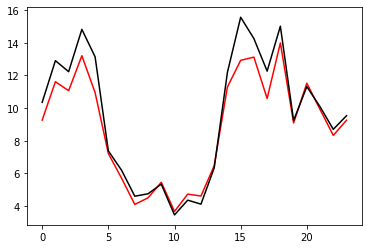

In [14]:
plt.plot(msemin,'r')
plt.plot(mseb24,'k')
plt.show()


In [33]:
mean_absolute_error(Train.target, Train.ii)

17.168758923668314

In [64]:
mean_absolute_error(yhat,y_test)

6.157568327515989

In [66]:
plt.plot()

[6.537032967032967]

In [ ]:
def build_model(hp):
  model = keras.Sequential()
  model.add(keras.layers.Dense(
      hp.Choice('units', [8, 16, 32]),
      activation='relu'))
      hp.Choice('units', [8, 16, 32]),
      activation='relu'))
  model.add(keras.layers.Dense(1, activation='linear'))
  model.compile(loss='mae')
  return model
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',
    max_trials=5)
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',
    max_trials=5)

In [42]:
pip install nbeats-keras

Defaulting to user installation because normal site-packages is not writeable
  Using cached flatbuffers-1.12-py2.py3-none-any.whl (15 kB)
  Using cached h5py-3.1.0-cp38-cp38-manylinux1_x86_64.whl (4.4 MB)
  Using cached gast-0.4.0-py3-none-any.whl (9.8 kB)
  Using cached grpcio-1.44.0-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (4.3 MB)
Note: you may need to restart the kernel to use updated packages.


In [ ]:
from tensorflow.keras import Input
from tensorflow.keras.layers import Dense, LSTM
from tensorflow.keras.models import load_model, Model

from attention import Attention

MSE24 = []
np.random.seed(17)
mseb24 = []
import keras_tuner as kt
from nbeats_keras.model import NBeatsNet
for t in range(0,1):
  def create_dataset(X,X1,y, time_steps=1):
      Xs, ys, Ds = [], [], []
      for i in range(0,len(X)-56,24):
          D = X1.iloc[i + time_steps+t+16]
          v = X.iloc[i:(i + time_steps)].values
          Xs.append(v)
          Ds.append(D)
          ys.append(y.iloc[i + time_steps+t+16])
      return np.array(Xs), np.array(ys),np.array(Ds)
  time_steps = 24

  X_train, y_train,D1 = create_dataset(train1,train0, train1.target, time_steps)
  X_test, y_test,D2 = create_dataset(test1,test0, test1.target, time_steps)
  X_val, y_val, D3 = create_dataset(val1,val0, val1.target, time_steps)


  X_train1  = X_train.reshape(X_train.shape[0], (X_train.shape[1]* X_train.shape[2]))
  X_test1   = X_test.reshape(X_test.shape[0], (X_test.shape[1]* X_test.shape[2]))
  X_val1    = X_val.reshape(X_val.shape[0], (X_val.shape[1]* X_val.shape[2]))
    
  DA24     = mean_absolute_error(D2, y_test)
  mseb24.append(DA24)
  strategy = tf.distribute.MirroredStrategy()
  with strategy.scope():
        model1 = Sequential()
        model1.add(Dense(9, input_dim=X_train1.shape[1],activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
        model1.add(Dense(20,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
        model1.add(Dense(1,activation = 'linear'))
        model1.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
        print('model1')


# Train the model on all available devices.
  model1.fit(X_train1, y_train, epochs=1000, validation_split = 0.2, batch_size= 32, verbose  = 0)

  
  MSE24.append(mean_absolute_error(y_test, m.predict(X_test).reshape(-1,1)))
  
  print('************************************************************', t ,'******************************************************')

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1', '/job:localhost/replica:0/task:0/device:GPU:2', '/job:localhost/replica:0/task:0/device:GPU:3', '/job:localhost/replica:0/task:0/device:GPU:4', '/job:localhost/replica:0/task:0/device:GPU:5', '/job:localhost/replica:0/task:0/device:GPU:6', '/job:localhost/replica:0/task:0/device:GPU:7')
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
mod

2022-04-08 23:15:00.357595: W tensorflow/core/grappler/optimizers/data/auto_shard.cc:695] AUTO sharding policy will apply DATA sharding policy as it failed to apply FILE sharding policy because of the following reason: Did not find a shardable source, walked to a node which is not a dataset: name: "FlatMapDataset/_9"
op: "FlatMapDataset"
input: "PrefetchDataset/_8"
attr {
  key: "Targuments"
  value {
    list {
    }
  }
}
attr {
  key: "f"
  value {
    func {
      name: "__inference_Dataset_flat_map_slice_batch_indices_1236"
    }
  }
}
attr {
  key: "output_shapes"
  value {
    list {
      shape {
        dim {
          size: -1
        }
      }
    }
  }
}
attr {
  key: "output_types"
  value {
    list {
      type: DT_INT64
    }
  }
}
. Consider either turning off auto-sharding or switching the auto_shard_policy to DATA to shard this dataset. You can do this by creating a new `tf.data.Options()` object then setting `options.experimental_distribute.auto_shard_policy = AutoS

INFO:tensorflow:batch_all_reduce: 6 all-reduces with algorithm = nccl, num_packs = 1
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:batch_all_reduce: 6 all-reduces with algorithm = nccl, num_packs = 1


2022-04-08 23:15:15.252068: I tensorflow/stream_executor/cuda/cuda_blas.cc:1760] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


In [21]:
strategy = tf.distribute.MirroredStrategy()
with strategy.scope():
  # Everything that creates variables should be under the strategy scope.
  # In general this is only model construction & `compile()`.
  model1 = Sequential()
  model1.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model1.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model1.add(Dense(1,activation = 'linear'))
  model1.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  print('model1')


# Train the model on all available devices.
model1.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32, verbose  = 0)


2022-04-08 23:08:14.913820: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE3 SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-04-08 23:08:18.307747: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1510] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 46760 MB memory:  -> device: 0, name: NVIDIA RTX A6000, pci bus id: 0000:39:00.0, compute capability: 8.6
2022-04-08 23:08:18.311026: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1510] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 46760 MB memory:  -> device: 1, name: NVIDIA RTX A6000, pci bus id: 0000:3c:00.0, compute capability: 8.6
2022-04-08 23:08:18.314124: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1510] Created device /job:localhost/replica:

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1', '/job:localhost/replica:0/task:0/device:GPU:2', '/job:localhost/replica:0/task:0/device:GPU:3', '/job:localhost/replica:0/task:0/device:GPU:4', '/job:localhost/replica:0/task:0/device:GPU:5', '/job:localhost/replica:0/task:0/device:GPU:6', '/job:localhost/replica:0/task:0/device:GPU:7')
Number of devices: 8


In [37]:
test.head()

,MISO Wind,MISO Wind Lower,MISO Wind Upper,PJM Load,MISO Load,AP,AEP,COMED,DAYTON,DOMINION,...,w52,w53,w54,w55,w56,w57,w58,w59,w60,w61
index,,,,,,,,,,,,,,,,,,,,,
2020-07-01 00:00:00,0.422547,0.300218,0.403572,0.420894,0.408055,0.338288,0.347804,0.452574,0.507299,0.387823,...,0.505976,0.238468,0.478994,0.484735,0.335169,0.472238,0.4837,0.277801,0.555618,0.52619
2020-07-01 01:00:00,0.398050,0.283627,0.374607,0.349666,0.355065,0.277383,0.286626,0.416393,0.420164,0.315606,...,0.505976,0.238468,0.478994,0.484735,0.335169,0.472238,0.4837,0.277801,0.555618,0.52619
2020-07-01 02:00:00,0.361060,0.260617,0.337209,0.294101,0.309133,0.231826,0.236019,0.350742,0.357208,0.268309,...,0.505976,0.238468,0.478994,0.484735,0.335169,0.472238,0.4837,0.277801,0.555618,0.52619
2020-07-01 03:00:00,0.326935,0.239451,0.308297,0.255412,0.279230,0.201454,0.201301,0.300463,0.309307,0.238957,...,0.505976,0.238468,0.478994,0.484735,0.335169,0.472238,0.4837,0.277801,0.555618,0.52619
2020-07-01 04:00:00,0.295795,0.217602,0.283993,0.232275,0.265625,0.186268,0.181096,0.263812,0.281022,0.221665,...,0.505976,0.238468,0.478994,0.484735,0.335169,0.472238,0.4837,0.277801,0.555618,0.52619


In [960]:
MSE24.append(mean_absolute_error(y_test,m.predict(X_test).reshape(-1,1)))


In [961]:
MSE24

[5.1732476810879175]

In [ ]:
plt.plot(MSE241,'r', label =['Ensemble'])
plt.plot(MSE24,'k', label =['Ensemble'])
plt.plot(mseb24[:24], 'k', label =['dayahead'])
plt.legend()
plt.show()

In [ ]:
a1 = mseb24[:24]
a2 = mseb24[24:]

In [ ]:
len(a1),len(a2)

In [ ]:
from keras.layers.core import Dropout, Activation
from keras.layers.pooling import GlobalAveragePooling2D
from keras.models import Model
from tcn import TCN

In [ ]:
train1.target

In [607]:
MSE24 = []
np.random.seed(17)
mseb24 = []

from sklearn.linear_model import HuberRegressor
from sklearn import linear_model
from tcn import TCN, tcn_full_summary

for t in range(0,1):
  def create_dataset(X,X1,y, time_steps=1):
      Xs, ys, Ds = [], [], []
      for i in range(0,len(X)-56,24):
          D = X1.iloc[i + time_steps+t+16]
          v = X.iloc[i:(i + time_steps)].values
          Xs.append(v)
          Ds.append(D)
          ys.append(y.iloc[i + time_steps+t+16])
      return np.array(Xs), np.array(ys),np.array(Ds)
  time_steps = 24

  X_train, y_train,D1 = create_dataset(train1,train0, train1.target, time_steps)
  X_test, y_test,D2 = create_dataset(test1,test0, test1.target, time_steps)
  X_val, y_val, D3 = create_dataset(val1,val0, val1.target, time_steps)


  X_train1  = X_train.reshape(X_train.shape[0], (X_train.shape[1]* X_train.shape[2]))
  X_test1   = X_test.reshape(X_test.shape[0], (X_test.shape[1]* X_test.shape[2]))
  X_val1    = X_val.reshape(X_val.shape[0], (X_val.shape[1]* X_val.shape[2]))

  data_train_wide = X_train.reshape((X_train.shape[0], X_train.shape[1], X_train.shape[2], 1))
  data_test_wide = X_test.reshape((X_test.shape[0], X_test.shape[1], X_test.shape[2], 1))
  data_val_wide = X_val.reshape((X_val.shape[0], X_val.shape[1], X_val.shape[2], 1))
    
  DA24     = mean_absolute_error(D2, y_test)
  mseb24.append(DA24)
    
  

  model1 = Sequential()
  model1.add(Dense(150, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1(0.01)))
  model1.add(Dense(1,activation = 'linear'))
  model1.compile(loss='mae', optimizer='adam',metrics=['mse'])
  model1.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model1')

  model2 = Sequential()
  model2.add(Dense(150, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model2.add(Dense(100, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model2.add(Dense(100, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model2.add(Dense(1,activation = 'linear'))
  model2.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model2.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32, verbose  = 0)
  print('model2')


  model3 = Sequential()
  model3.add(Dense(256, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model3.add(Dense(128, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model3.add(Dense(128, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model3.add(Dense(1,activation = 'linear'))
  model3.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model3.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model3')


  model4 = Sequential()
  model4.add(Dense(90, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model4.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model4.add(Dense(64, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model4.add(Dense(1,activation = 'linear'))
  model4.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model4.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model4')
    
    
  model5 = Sequential()
  model5.add(Dense(150, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model5.add(Dense(256, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model5.add(Dense(256, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model5.add(Dense(1,activation = 'linear'))
  model5.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model5.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model5')
    
  model6 = Sequential()
  model6.add(Dense(128, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model6.add(Dense(256, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model6.add(Dense(256, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model6.add(Dense(1,activation = 'linear'))
  model6.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model6.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model6')
    
  model7 = Sequential()
  model7.add(Dense(90, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model7.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model7.add(Dense(1,activation = 'linear'))
  model7.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model7.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model7')
    
  model8 = Sequential()
  model8.add(Dense(256, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model8.add(Dense(1,activation = 'linear'))
  model8.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model8.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr],validation_split = 0.2, batch_size= 32)
  print('model8')

  model9 = Sequential()
  model9.add(Dense(99, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model9.add(Dense(120, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model9.add(Dense(64, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model9.add(Dense(1,activation = 'linear'))
  model9.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model9.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model9')


  model10 = Sequential()
  model10.add(Dense(9, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model10.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model10.add(Dense(1,activation = 'linear'))
  model10.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model10.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32)
  print('model10')

  model11 = keras.Sequential()
  model11.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model11.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model11.add(tf.keras.layers.AveragePooling2D())
  model11.add(tf.keras.layers.Flatten())
  model11.add(tf.keras.layers.Dense(256, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model11.add(tf.keras.layers.Dense(512, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model11.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model11.compile(optimizer='RMSprop', loss='mae')
  model11.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)
  print('model11')


  model12 = keras.Sequential()
  model12.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model12.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model12.add(tf.keras.layers.AveragePooling2D())
  model12.add(tf.keras.layers.Flatten())
  model12.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model12.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model12.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model12.compile(optimizer='RMSprop', loss='mae')
  model12.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model13 = keras.Sequential()
  model13.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model13.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model13.add(tf.keras.layers.AveragePooling2D())
  model13.add(tf.keras.layers.Flatten())
  model13.add(tf.keras.layers.Dense(320, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model13.add(tf.keras.layers.Dense(256, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model13.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model13.compile(optimizer='RMSprop', loss='mae')
  model13.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model14 = keras.Sequential()
  model14.add(tf.keras.layers.Conv2D(5, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model14.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model14.add(tf.keras.layers.AveragePooling2D())
  model14.add(tf.keras.layers.Flatten())
  model14.add(tf.keras.layers.Dense(128, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model14.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model14.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model14.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model14.compile(optimizer='RMSprop', loss='mae')
  model14.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model15 = keras.Sequential()
  model15.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model15.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model15.add(tf.keras.layers.AveragePooling2D())
  model15.add(tf.keras.layers.Flatten())
  model15.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model15.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model15.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model15.compile(optimizer='RMSprop', loss='mae')
  model15.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model16 = keras.Sequential()
  model16.add(tf.keras.layers.Conv2D(3, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model16.add(tf.keras.layers.Conv2D(3, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model16.add(tf.keras.layers.AveragePooling2D())
  model16.add(tf.keras.layers.Flatten())
  model16.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model16.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model16.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model16.compile(optimizer='RMSprop', loss='mae')
  model16.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr], validation_split = 0.2)

  model17 = keras.Sequential()
  model17.add(tf.keras.layers.Conv2D(5, (1,3), padding= 'same', activation='relu', input_shape=(24, data_train_wide.shape[2], 1),kernel_regularizer=keras.regularizers.l1(0.1)))
  model17.add(tf.keras.layers.Conv2D(5, (24, 1), padding='same', activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model17.add(tf.keras.layers.AveragePooling2D())
  model17.add(tf.keras.layers.Flatten())
  model17.add(tf.keras.layers.Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model17.add(tf.keras.layers.Dense(32, activation='relu',kernel_regularizer=keras.regularizers.l1(0.1)))
  model17.add(tf.keras.layers.Dense(1, activation = 'linear'))
  model17.compile(optimizer='RMSprop', loss='mae')
  model17.fit(data_train_wide ,y_train, epochs=1000, shuffle=True, batch_size=32, verbose=1,  callbacks = [es,rlr],validation_split = 0.2)


  model21 = Sequential([
    TCN(input_shape=(24, X_train.shape[2]),
        kernel_size=4,
        use_skip_connections=True,
        use_batch_norm=False,
        use_weight_norm=True,
        use_layer_norm=False,
        nb_stacks=1,
        dilations=[2 ** i for i in range(12)],
        ),
    Dense(1, activation='linear')
  ])
  model21.compile(optimizer='adam', loss='mae')
  model21.fit(X_train, y_train, epochs=100,validation_data=(X_val, y_val), callbacks = [es,rlr])

   
  model22 = Sequential([
    TCN(input_shape=(24, X_train.shape[2]),
        kernel_size=4,
        use_skip_connections=True,
        use_batch_norm=False,
        use_weight_norm=True,
        use_layer_norm=False,
        nb_stacks=1,
        dilations=[2 ** i for i in range(12)],
        ),
    Dense(1, activation='linear')
  ])
  model22.compile(optimizer='adam', loss='mae')
  model22.fit(X_train, y_train, epochs=100,validation_data=(X_val, y_val), callbacks = [es,rlr])

  
  model23 = Sequential([
    TCN(input_shape=(24, X_train.shape[2]),
        kernel_size=4,
        use_skip_connections=True,
        use_batch_norm=False,
        use_weight_norm=True,
        use_layer_norm=False,
        nb_stacks=1,
        dilations=[2 ** i for i in range(12)],
        ),
    Dense(1, activation='linear')
  ])
  model23.compile(optimizer='adam', loss='mae')
  model23.fit(X_train, y_train, epochs=100,validation_data=(X_val, y_val), callbacks = [es,rlr])

  
  model24 = Sequential([
    TCN(input_shape=(24, X_train.shape[2]),
        kernel_size=4,
        use_skip_connections=True,
        use_batch_norm=False,
        use_weight_norm=True,
        use_layer_norm=False,
        nb_stacks=1,
        dilations=[2 ** i for i in range(12)],
        ),
    Dense(1, activation='linear')
  ])
  model24.compile(optimizer='adam', loss='mae')
  model24.fit(X_train, y_train, epochs=100,validation_data=(X_val, y_val), callbacks = [es,rlr])


  pred1 = model1.predict(X_test1).flatten()
  pred2 = model2.predict(X_test1).flatten()
  pred3 = model3.predict(X_test1).flatten()
  pred4 = model4.predict(X_test1).flatten()
  pred5 = model5.predict(X_test1).flatten()
  pred6 = model6.predict(X_test1).flatten()
  pred7 = model7.predict(X_test1).flatten()
  pred8 = model8.predict(X_test1).flatten()
  pred9 = model9.predict(X_test1).flatten()
  pred10 = model10.predict(X_test1).flatten()
  pred11 = model11.predict(data_test_wide).flatten()
  pred12 = model12.predict(data_test_wide).flatten()
  pred13 = model13.predict(data_test_wide).flatten()
  pred14 = model14.predict(data_test_wide).flatten()
  pred15 = model15.predict(data_test_wide).flatten()
  pred16 = model16.predict(data_test_wide).flatten()
  pred17 = model17.predict(data_test_wide).flatten()
  pred21 = model21.predict(X_test).flatten()
  pred22 = model22.predict(X_test).flatten()
  pred23 = model23.predict(X_test).flatten()
  pred24 = model24.predict(X_test).flatten()



  a = np.average(np.vstack((pred1, pred2,pred3,pred4,pred5,pred6,pred7,pred8,pred9,pred10,pred11, pred12,pred13,pred14,pred15,
                           pred16,pred17,pred21,pred22,pred23,pred24)), axis=0)
 
  MSE24.append(mean_absolute_error(y_test, a))
  
  print('************************************************************', t ,'******************************************************')

Epoch 1/1000
19/19 [==============================] - 0s 11ms/step - loss: 91.8519 - mse: 1148.1821 - val_loss: 52.3964 - val_mse: 3744.9050 - lr: 0.0010
Epoch 2/1000
19/19 [==============================] - 0s 6ms/step - loss: 35.7216 - mse: 797.8864 - val_loss: 24.7341 - val_mse: 3724.3347 - lr: 0.0010
Epoch 3/1000
19/19 [==============================] - 0s 5ms/step - loss: 19.3350 - mse: 729.0100 - val_loss: 18.4971 - val_mse: 3711.7405 - lr: 0.0010
Epoch 4/1000
19/19 [==============================] - 0s 6ms/step - loss: 15.7212 - mse: 703.8581 - val_loss: 16.7847 - val_mse: 3703.0068 - lr: 0.0010
Epoch 5/1000
19/19 [==============================] - 0s 6ms/step - loss: 14.9647 - mse: 692.4942 - val_loss: 16.3484 - val_mse: 3701.6194 - lr: 0.0010
Epoch 6/1000
19/19 [==============================] - 0s 6ms/step - loss: 14.6066 - mse: 711.2018 - val_loss: 16.6201 - val_mse: 3711.4597 - lr: 0.0010
Epoch 7/1000
19/19 [==============================] - 0s 6ms/step - loss: 14.4024 - ms

In [104]:
y1 = model1.predict(X_test1).flatten()
y2 = model2.predict(X_test1).flatten()
y3 = model19.predict(X_test).flatten()
y4 = model20.predict(X_test).flatten()
y5 = model21.predict(X_test).flatten()
y6 = model22.predict(X_test).flatten()
y7 = model11.predict(data_test_wide).flatten()
y8 = model12.predict(data_test_wide).flatten()



In [110]:
  a = np.average(np.vstack((pred17,pred21,pred22,pred23,pred24)), axis=0)

In [112]:
(mean_absolute_error(y_test, a))


5.664104811909434

In [113]:

df = pd.DataFrame(data=[pred17,pred18,pred19,pred20,pred21,pred22,pred23,pred24]).T

In [114]:
df.corr()[0]

0    1.000000
1    0.675392
2    0.298707
3    0.584296
4    0.717038
5    0.367543
6    0.547336
7    0.470609
Name: 0, dtype: float64

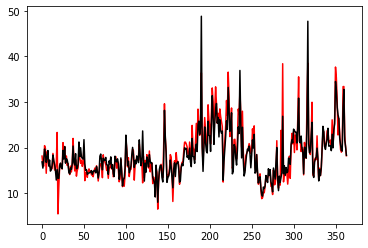

In [80]:
plt.plot(y1, 'r')
plt.plot(y7, 'k')
plt.show()

In [ ]:
from sklearn.linear_model import HuberRegressor
from sklearn import linear_model
from tcn import TCN, tcn_full_summary

for t in range(0,24):
  def create_dataset(X,X1,y, time_steps=1):
      Xs, ys, Ds = [], [], []
      for i in range(0,len(X)-56,24):
          D = X1.iloc[i + time_steps+t+16]
          v = X.iloc[i:(i + time_steps)].values
          Xs.append(v)
          Ds.append(D)
          ys.append(y.iloc[i + time_steps+t+16])
      return np.array(Xs), np.array(ys),np.array(Ds)
  time_steps = 24

  X_train, y_train,D1 = create_dataset(train1,train0, train1.target, time_steps)
  X_test, y_test,D2 = create_dataset(test1,test0, test1.target, time_steps)
  X_val, y_val, D3 = create_dataset(val1,val0, val1.target, time_steps)


  X_train1  = X_train.reshape(X_train.shape[0], (X_train.shape[1]* X_train.shape[2]))
  X_test1   = X_test.reshape(X_test.shape[0], (X_test.shape[1]* X_test.shape[2]))
  X_val1    = X_val.reshape(X_val.shape[0], (X_val.shape[1]* X_val.shape[2]))

  data_train_wide = X_train.reshape((X_train.shape[0], X_train.shape[1], X_train.shape[2], 1))
  data_test_wide = X_test.reshape((X_test.shape[0], X_test.shape[1], X_test.shape[2], 1))
  data_val_wide = X_val.reshape((X_val.shape[0], X_val.shape[1], X_val.shape[2], 1))
    
  DA24     = mean_absolute_error(D2, y_test)
  mseb24.append(DA24)
  

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1', '/job:localhost/replica:0/task:0/device:GPU:2', '/job:localhost/replica:0/task:0/device:GPU:3', '/job:localhost/replica:0/task:0/device:GPU:4', '/job:localhost/replica:0/task:0/device:GPU:5', '/job:localhost/replica:0/task:0/device:GPU:6', '/job:localhost/replica:0/task:0/device:GPU:7')
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).


2022-03-21 15:50:05.588777: W tensorflow/core/grappler/optimizers/data/auto_shard.cc:695] AUTO sharding policy will apply DATA sharding policy as it failed to apply FILE sharding policy because of the following reason: Did not find a shardable source, walked to a node which is not a dataset: name: "FlatMapDataset/_9"
op: "FlatMapDataset"
input: "PrefetchDataset/_8"
attr {
  key: "Targuments"
  value {
    list {
    }
  }
}
attr {
  key: "f"
  value {
    func {
      name: "__inference_Dataset_flat_map_slice_batch_indices_4121110"
    }
  }
}
attr {
  key: "output_shapes"
  value {
    list {
      shape {
        dim {
          size: -1
        }
      }
    }
  }
}
attr {
  key: "output_types"
  value {
    list {
      type: DT_INT64
    }
  }
}
. Consider either turning off auto-sharding or switching the auto_shard_policy to DATA to shard this dataset. You can do this by creating a new `tf.data.Options()` object then setting `options.experimental_distribute.auto_shard_policy = Au

Epoch 1/1000
INFO:tensorflow:batch_all_reduce: 4 all-reduces with algorithm = nccl, num_packs = 1
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:batch_all_reduce: 4 all-reduces with algorithm = nccl, num_packs = 1


In [123]:
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import VotingRegressor,GradientBoostingRegressor,HistGradientBoostingRegressor,StackingRegressor
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error,accuracy_score


import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.layers import Dense,Dropout
from tensorflow.keras.models import Sequential
from keras.metrics import RootMeanSquaredError

In [20]:

def stacked_dataset(members, inputX):
	stackX = None
	for model in members:
		# make prediction
		yhat = model.predict(inputX, verbose=0)
		# stack predictions into [rows, members, probabilities]
		if stackX is None:
			stackX = yhat #
		else:
			stackX = dstack((stackX, yhat))
	# flatten predictions to [rows, members x probabilities]
	stackX = stackX.reshape((stackX.shape[0], stackX.shape[1]*stackX.shape[2]))
	return stackX

In [605]:
MSE24 = []
np.random.seed(17)
mseb24 = []

from sklearn.linear_model import HuberRegressor
from sklearn import linear_model
from tcn import TCN, tcn_full_summary
from keras_self_attention import SeqSelfAttention

for t in range(0,24):
  def create_dataset(X,X1,y, time_steps=1):
      Xs, ys, Ds = [], [], []
      for i in range(0,len(X)-56,24):
          D = X1.iloc[i + time_steps+t+16]
          v = X.iloc[i:(i + time_steps)].values
          Xs.append(v)
          Ds.append(D)
          ys.append(y.iloc[i + time_steps+t+16])
      return np.array(Xs), np.array(ys),np.array(Ds)
  time_steps = 24

  X_train, y_train,D1 = create_dataset(train1,train0, train1.target, time_steps)
  X_test, y_test,D2 = create_dataset(test1,test0, test1.target, time_steps)
  X_val, y_val, D3 = create_dataset(val1,val0, val1.target, time_steps)


  X_train1  = X_train.reshape(X_train.shape[0], (X_train.shape[1]* X_train.shape[2]))
  X_test1   = X_test.reshape(X_test.shape[0], (X_test.shape[1]* X_test.shape[2]))
  X_val1    = X_val.reshape(X_val.shape[0], (X_val.shape[1]* X_val.shape[2]))

  data_train_wide = X_train.reshape((X_train.shape[0], X_train.shape[1], X_train.shape[2], 1))
  data_test_wide = X_test.reshape((X_test.shape[0], X_test.shape[1], X_test.shape[2], 1))
  data_val_wide = X_val.reshape((X_val.shape[0], X_val.shape[1], X_val.shape[2], 1))
    
  DA24     = mean_absolute_error(D2, y_test)
  model = ltb.LGBMRegressor(max_depth=10)
  model.fit(X_train1, y_train)
  a = model.predict(X_test1)
  MSE24.append(mean_absolute_error(y_test, a))
  
  print('************************************************************', t ,'******************************************************')

************************************************************ 0 ******************************************************
************************************************************ 1 ******************************************************
************************************************************ 2 ******************************************************
************************************************************ 3 ******************************************************
************************************************************ 4 ******************************************************
************************************************************ 5 ******************************************************
************************************************************ 6 ******************************************************
************************************************************ 7 ******************************************************
********************************************************

In [37]:
MSE241 = []
MSE24 = []
mseb24 = []
np.random.seed(17)
mseb24 = []
from sklearn.linear_model import HuberRegressor
from sklearn import linear_model
from tcn import TCN, tcn_full_summary
from keras.utils.multi_gpu_utils import multi_gpu_model
import tensorflow
KERAS_BACKEND=tensorflow
from tensorflow.keras import backend as K
from keras.models import load_model
for t in range(0,1):
  def create_dataset(X,X1,y, time_steps=1):
      Xs, ys, Ds = [], [], []
      for i in range(0,len(X)-64):
          D = X1.iloc[i + time_steps+t+16]
          v = X.iloc[i:(i + time_steps)].values
          Xs.append(v)
          Ds.append(D)
          ys.append(y.iloc[i + time_steps+t+16])
      return np.array(Xs), np.array(ys),np.array(Ds)
  time_steps = 24

  X_train, y_train,D1 = create_dataset(train1,train0, train1.target, time_steps)
  X_test, y_test,D2 = create_dataset(test1,test0, test1.target, time_steps)
  mseb24.append(mean_absolute_error(y_test, D2))
  X_train1  = X_train.reshape(X_train.shape[0], (X_train.shape[1]* X_train.shape[2]))
  X_test1   = X_test.reshape(X_test.shape[0], (X_test.shape[1]* X_test.shape[2]))
  scalers = {}
  for i in range(X_train.shape[1]):
    scalers[i] = StandardScaler()
    X_train[:, i, :] = scalers[i].fit_transform(X_train[:, i, :]) 

  for i in range(X_test.shape[1]):
    X_test[:, i, :] = scalers[i].transform(X_test[:, i, :]) 

  X_train1  = X_train.reshape(X_train.shape[0], (X_train.shape[1]* X_train.shape[2]))
  X_test1   = X_test.reshape(X_test.shape[0], (X_test.shape[1]* X_test.shape[2]))


  data_train_wide = X_train.reshape((X_train.shape[0], X_train.shape[1], X_train.shape[2], 1))
  data_test_wide = X_test.reshape((X_test.shape[0], X_test.shape[1], X_test.shape[2], 1))

    
  y = y_train.reshape(-1, 1)
  scaler_y = MinMaxScaler(feature_range=(0, 1))
  scaler_y.fit(y)
  y_train = scaler_y.transform(y)

  model1 = Sequential()
  model1.add(Dense(50, input_dim=X_train1.shape[1], kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model1.add(Dense(100, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model1.add(Dense(100, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model1.add(Dense(1,activation = 'linear'))
  model1.compile(loss='mean_absolute_error', optimizer='RMSprop',metrics=['mse'])
  model1.fit(X_train1, y_train, epochs=1000, callbacks = [es,rlr], validation_split = 0.2, batch_size= 32, )
  a = model1.predict(X_test1)
  MSE24.append(mean_absolute_error(y_test, a))

  print('model1')
  
  print('************************************************************', t ,'******************************************************')

Epoch 1/1000
727/727 [==============================] - 3s 4ms/step - loss: 5.8869 - mse: 0.0212 - val_loss: 1.1330 - val_mse: 4.1300e-04
Epoch 2/1000
727/727 [==============================] - 2s 3ms/step - loss: 1.1353 - mse: 4.7696e-04 - val_loss: 1.1366 - val_mse: 3.1402e-04
Epoch 3/1000
727/727 [==============================] - 2s 3ms/step - loss: 1.1352 - mse: 4.7278e-04 - val_loss: 1.1364 - val_mse: 2.9775e-04
Epoch 4/1000
727/727 [==============================] - 2s 3ms/step - loss: 1.1351 - mse: 4.7131e-04 - val_loss: 1.1397 - val_mse: 4.8957e-04
Epoch 5/1000
727/727 [==============================] - 3s 4ms/step - loss: 1.1351 - mse: 4.7354e-04 - val_loss: 1.1361 - val_mse: 2.9534e-04
Epoch 6/1000
727/727 [==============================] - 3s 4ms/step - loss: 0.7967 - mse: 4.6102e-04 - val_loss: 0.6701 - val_mse: 3.9178e-04
Epoch 7/1000
727/727 [==============================] - 3s 4ms/step - loss: 0.7963 - mse: 4.5993e-04 - val_loss: 0.8475 - val_mse: 3.6574e-04
Epoch 8/10

In [31]:
train1.target

index
2018-01-02 00:00:00    109.80
2018-01-02 00:00:00    115.15
2018-01-02 00:00:00    203.98
2018-01-02 00:00:00    117.69
2018-01-02 00:00:00     98.54
                        ...  
2021-10-28 19:00:00     75.96
2021-10-28 20:00:00     86.09
2021-10-28 21:00:00     58.31
2021-10-28 22:00:00     60.25
2021-10-28 23:00:00     53.82
Name: target, Length: 29136, dtype: float64

In [74]:
import tensorflow as tf
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.0001,patience=6, verbose=1, mode='min',restore_best_weights=True)
rlr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.7, patience=4, min_lr=0.00001, verbose=0)
initializer = tf.keras.initializers.HeNormal()
modelo = []

Number of different IMFs:  11


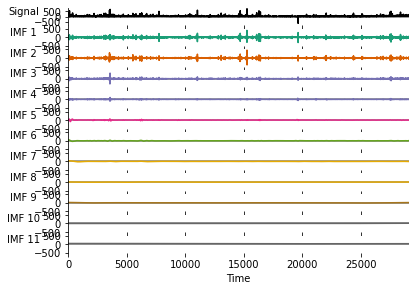

In [34]:
import emd
imf = emd.sift.sift(train1['target'].values)

dfn_emd = train1.copy(deep=True)

for i in range(imf.shape[1]):
    dfn_emd['IMF%s'%(i+1)] = imf[:,i]
    
dfn_emd.drop("target", axis=1).apply(lambda x: x.corr(dfn_emd.target))[-11:].sort_values(ascending = False)


IMF3     0.350871
IMF2     0.350207
IMF9     0.238925
IMF5     0.236833
IMF7     0.230343
IMF1     0.227274
IMF11    0.221801
IMF6     0.211395
IMF10    0.208978
IMF4     0.199477
IMF8     0.172918
dtype: float64

In [82]:
dfn_emd['IMFs'] = imf[:,0] + imf[:,1] +  imf[:,2]+  imf[:,8]+  imf[:,4] +  imf[:,10] +  imf[:,9]+  imf[:,6]+  imf[:,5] +  imf[:,3]
dfn_emd.IMFs, train1.target

(index
 2018-01-02 00:00:00    102.251362
 2018-01-02 00:00:00    107.597190
 2018-01-02 00:00:00    196.423063
 2018-01-02 00:00:00    110.128983
 2018-01-02 00:00:00     90.974949
                           ...    
 2021-10-28 19:00:00     71.006863
 2021-10-28 20:00:00     81.138551
 2021-10-28 21:00:00     53.360247
 2021-10-28 22:00:00     55.301952
 2021-10-28 23:00:00     48.873665
 Name: IMFs, Length: 29136, dtype: float64,
 index
 2018-01-02 00:00:00    100.631577
 2018-01-02 00:00:00    105.726967
 2018-01-02 00:00:00    194.430978
 2018-01-02 00:00:00    108.159042
 2018-01-02 00:00:00     89.180285
                           ...    
 2021-10-28 19:00:00     70.101743
 2021-10-28 20:00:00     80.271690
 2021-10-28 21:00:00     52.575969
 2021-10-28 22:00:00     54.639063
 2021-10-28 23:00:00     48.365454
 Name: target, Length: 29136, dtype: float64)

In [25]:
zz

2022-04-28 21:28:18.394254: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE3 SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-04-28 21:28:20.619348: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1510] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 46760 MB memory:  -> device: 0, name: NVIDIA RTX A6000, pci bus id: 0000:39:00.0, compute capability: 8.6
2022-04-28 21:28:20.622231: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1510] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 46760 MB memory:  -> device: 1, name: NVIDIA RTX A6000, pci bus id: 0000:3c:00.0, compute capability: 8.6
2022-04-28 21:28:20.624990: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1510] Created device /job:localhost/replica:

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1', '/job:localhost/replica:0/task:0/device:GPU:2', '/job:localhost/replica:0/task:0/device:GPU:3', '/job:localhost/replica:0/task:0/device:GPU:4')


2022-04-28 21:28:24.204632: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-04-28 21:28:24.945461: I tensorflow/stream_executor/cuda/cuda_blas.cc:1760] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


Restoring model weights from the end of the best epoch.
Epoch 00265: early stopping
model1
Restoring model weights from the end of the best epoch.
Epoch 00089: early stopping
model2
Restoring model weights from the end of the best epoch.
Epoch 00133: early stopping
model3
Restoring model weights from the end of the best epoch.
Epoch 00264: early stopping
model4
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 21.0575 - mse: 830.2220 - val_loss: 18.3561 - val_mse: 1407.9493
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.6767 - mse: 541.6731 - val_loss: 16.7219 - val_mse: 1283.0736
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.0236 - mse: 522.4404 - val_loss: 16.2898 - val_mse: 1203.4270
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.7675 - mse: 513.3605 - val_loss: 16.1940 - val_mse: 1175.2493
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.54

2022-04-28 21:32:08.143366: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8101


1/1 [==============================] - 4s 4s/step - loss: 278.4372 - val_loss: 247.5564
Epoch 2/1000
1/1 [==============================] - 0s 108ms/step - loss: 248.0343 - val_loss: 226.2016
Epoch 3/1000
1/1 [==============================] - 0s 104ms/step - loss: 226.6772 - val_loss: 208.9939
Epoch 4/1000
1/1 [==============================] - 0s 95ms/step - loss: 209.4654 - val_loss: 193.7247
Epoch 5/1000
1/1 [==============================] - 0s 97ms/step - loss: 194.2078 - val_loss: 179.9343
Epoch 6/1000
1/1 [==============================] - 0s 101ms/step - loss: 180.4438 - val_loss: 166.7471
Epoch 7/1000
1/1 [==============================] - 0s 104ms/step - loss: 167.3115 - val_loss: 154.2512
Epoch 8/1000
1/1 [==============================] - 0s 98ms/step - loss: 154.8902 - val_loss: 141.9692
Epoch 9/1000
1/1 [==============================] - 0s 106ms/step - loss: 142.6434 - val_loss: 130.4580
Epoch 10/1000
1/1 [==============================] - 0s 99ms/step - loss: 131.3006 

1/1 [==============================] - 0s 103ms/step - loss: 24.1748 - val_loss: 23.8026
Epoch 160/1000
1/1 [==============================] - 0s 107ms/step - loss: 24.0319 - val_loss: 23.5267
Epoch 161/1000
1/1 [==============================] - 0s 104ms/step - loss: 24.0310 - val_loss: 23.6646
Epoch 162/1000
1/1 [==============================] - 0s 104ms/step - loss: 23.8896 - val_loss: 23.3880
Epoch 163/1000
1/1 [==============================] - 0s 100ms/step - loss: 23.8913 - val_loss: 23.5397
Epoch 164/1000
1/1 [==============================] - 0s 105ms/step - loss: 23.7587 - val_loss: 23.2410
Epoch 165/1000
1/1 [==============================] - 0s 112ms/step - loss: 23.7407 - val_loss: 23.3512
Epoch 166/1000
1/1 [==============================] - 0s 105ms/step - loss: 23.5838 - val_loss: 23.0778
Epoch 167/1000
1/1 [==============================] - 0s 104ms/step - loss: 23.5713 - val_loss: 23.1251
Epoch 168/1000
1/1 [==============================] - 0s 112ms/step - loss: 23.

Epoch 238/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.4419 - val_loss: 20.0114
Epoch 239/1000
1/1 [==============================] - 0s 111ms/step - loss: 20.5181 - val_loss: 20.2002
Epoch 240/1000
1/1 [==============================] - 0s 108ms/step - loss: 20.4309 - val_loss: 19.9764
Epoch 241/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.4811 - val_loss: 20.1464
Epoch 242/1000
1/1 [==============================] - 0s 108ms/step - loss: 20.3855 - val_loss: 19.9314
Epoch 243/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.4326 - val_loss: 20.0956
Epoch 244/1000
1/1 [==============================] - 0s 107ms/step - loss: 20.3422 - val_loss: 19.9032
Epoch 245/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.4084 - val_loss: 20.0975
Epoch 246/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.3326 - val_loss: 19.8827
Epoch 247/1000
1/1 [==============================] - 0s 102ms/s

Epoch 317/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.8514 - val_loss: 16.5390
Epoch 318/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.9402 - val_loss: 16.4269
Epoch 319/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.8426 - val_loss: 16.5265
Epoch 320/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.9279 - val_loss: 16.4160
Epoch 321/1000
1/1 [==============================] - 0s 120ms/step - loss: 16.8334 - val_loss: 16.5301
Epoch 322/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.9193 - val_loss: 16.4026
Epoch 323/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.8254 - val_loss: 16.5409
Epoch 324/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.9145 - val_loss: 16.3858
Epoch 325/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.8332 - val_loss: 16.6103
Epoch 326/1000
1/1 [==============================] - 0s 101ms/step

Epoch 396/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.5337 - val_loss: 16.0209
Epoch 397/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.4759 - val_loss: 16.1891
Epoch 398/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.5245 - val_loss: 16.0124
Epoch 399/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.4662 - val_loss: 16.1790
Epoch 400/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.5143 - val_loss: 16.0028
Epoch 401/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.4564 - val_loss: 16.1670
Epoch 402/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.5040 - val_loss: 15.9925
Epoch 403/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.4459 - val_loss: 16.1612
Epoch 404/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.4971 - val_loss: 15.9845
Epoch 405/1000
1/1 [==============================] - 0s 110ms/s

Epoch 475/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.1622 - val_loss: 15.8743
Epoch 476/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.2152 - val_loss: 15.6920
Epoch 477/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.1523 - val_loss: 15.8571
Epoch 478/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.2029 - val_loss: 15.6829
Epoch 479/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.1436 - val_loss: 15.8471
Epoch 480/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.1946 - val_loss: 15.6764
Epoch 481/1000
1/1 [==============================] - 0s 96ms/step - loss: 16.1328 - val_loss: 15.8317
Epoch 482/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.1837 - val_loss: 15.6705
Epoch 483/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.1237 - val_loss: 15.8246
Epoch 484/1000
1/1 [==============================] - 0s 106ms/st

Epoch 554/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.9543 - val_loss: 15.4289
Epoch 555/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.8983 - val_loss: 15.6042
Epoch 556/1000
1/1 [==============================] - 0s 122ms/step - loss: 15.9514 - val_loss: 15.4233
Epoch 557/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.8899 - val_loss: 15.5807
Epoch 558/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.9363 - val_loss: 15.4166
Epoch 559/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.8786 - val_loss: 15.5650
Epoch 560/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.9253 - val_loss: 15.4113
Epoch 561/1000
1/1 [==============================] - 0s 96ms/step - loss: 15.8699 - val_loss: 15.5520
Epoch 562/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.9157 - val_loss: 15.4065
Epoch 563/1000
1/1 [==============================] - 0s 107ms/ste

Epoch 633/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.7020 - val_loss: 15.4296
Epoch 634/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.7629 - val_loss: 15.2188
Epoch 635/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.6867 - val_loss: 15.3825
Epoch 636/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.7350 - val_loss: 15.2132
Epoch 637/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.6802 - val_loss: 15.3671
Epoch 638/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.7251 - val_loss: 15.2084
Epoch 639/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.6759 - val_loss: 15.3630
Epoch 640/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.7208 - val_loss: 15.2049
Epoch 641/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.6745 - val_loss: 15.3610
Epoch 642/1000
1/1 [==============================] - 0s 107ms/step

Epoch 712/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.5861 - val_loss: 15.0766
Epoch 713/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.5392 - val_loss: 15.2380
Epoch 714/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.5881 - val_loss: 15.0727
Epoch 715/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.5345 - val_loss: 15.2339
Epoch 716/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.5855 - val_loss: 15.0683
Epoch 717/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.5316 - val_loss: 15.2314
Epoch 718/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.5826 - val_loss: 15.0654
Epoch 719/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.5272 - val_loss: 15.2289
Epoch 720/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.5806 - val_loss: 15.0627
Epoch 721/1000
1/1 [==============================] - 0s 104ms/s

Epoch 791/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.4271 - val_loss: 15.1289
Epoch 792/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.4817 - val_loss: 14.9640
Epoch 793/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.4268 - val_loss: 15.1343
Epoch 794/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.4832 - val_loss: 14.9629
Epoch 795/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.4243 - val_loss: 15.1307
Epoch 796/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.4800 - val_loss: 14.9600
Epoch 797/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.4215 - val_loss: 15.1253
Epoch 798/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.4759 - val_loss: 14.9576
Epoch 799/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.4201 - val_loss: 15.1236
Epoch 800/1000
1/1 [==============================] - 0s 115ms/s

1/1 [==============================] - 0s 100ms/step - loss: 15.3875 - val_loss: 14.8737
Epoch 871/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.3394 - val_loss: 15.0286
Epoch 872/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.3833 - val_loss: 14.8711
Epoch 873/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.3345 - val_loss: 15.0253
Epoch 874/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.3809 - val_loss: 14.8682
Epoch 875/1000
1/1 [==============================] - 0s 96ms/step - loss: 15.3333 - val_loss: 15.0262
Epoch 876/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.3803 - val_loss: 14.8664
Epoch 877/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.3305 - val_loss: 15.0217
Epoch 878/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.3770 - val_loss: 14.8636
Epoch 879/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.329

1/1 [==============================] - 0s 99ms/step - loss: 47.2069 - val_loss: 44.8161
Epoch 29/1000
1/1 [==============================] - 0s 105ms/step - loss: 45.3094 - val_loss: 43.2746
Epoch 30/1000
1/1 [==============================] - 0s 105ms/step - loss: 43.7804 - val_loss: 41.8624
Epoch 31/1000
1/1 [==============================] - 0s 102ms/step - loss: 42.3606 - val_loss: 40.8126
Epoch 32/1000
1/1 [==============================] - 0s 105ms/step - loss: 41.3203 - val_loss: 39.8921
Epoch 33/1000
1/1 [==============================] - 0s 110ms/step - loss: 40.3731 - val_loss: 39.2816
Epoch 34/1000
1/1 [==============================] - 0s 102ms/step - loss: 39.8000 - val_loss: 38.8720
Epoch 35/1000
1/1 [==============================] - 0s 116ms/step - loss: 39.3403 - val_loss: 38.7229
Epoch 36/1000
1/1 [==============================] - 0s 101ms/step - loss: 39.2644 - val_loss: 38.7329
Epoch 37/1000
1/1 [==============================] - 0s 99ms/step - loss: 39.1012 - val_

Epoch 108/1000
1/1 [==============================] - 0s 107ms/step - loss: 28.9652 - val_loss: 28.2498
Epoch 109/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.6040 - val_loss: 28.1809
Epoch 110/1000
1/1 [==============================] - 0s 109ms/step - loss: 28.7274 - val_loss: 28.0185
Epoch 111/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.3743 - val_loss: 27.9582
Epoch 112/1000
1/1 [==============================] - 0s 102ms/step - loss: 28.5058 - val_loss: 27.8090
Epoch 113/1000
1/1 [==============================] - 0s 104ms/step - loss: 28.1633 - val_loss: 27.7449
Epoch 114/1000
1/1 [==============================] - 0s 101ms/step - loss: 28.2909 - val_loss: 27.5956
Epoch 115/1000
1/1 [==============================] - 0s 101ms/step - loss: 27.9458 - val_loss: 27.5325
Epoch 116/1000
1/1 [==============================] - 0s 100ms/step - loss: 28.0819 - val_loss: 27.3872
Epoch 117/1000
1/1 [==============================] - 0s 107ms/ste

Epoch 187/1000
1/1 [==============================] - 0s 107ms/step - loss: 22.1889 - val_loss: 21.7869
Epoch 188/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.3314 - val_loss: 21.7210
Epoch 189/1000
1/1 [==============================] - 0s 101ms/step - loss: 22.0329 - val_loss: 21.6491
Epoch 190/1000
1/1 [==============================] - 0s 99ms/step - loss: 22.1826 - val_loss: 21.6026
Epoch 191/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.9193 - val_loss: 21.5300
Epoch 192/1000
1/1 [==============================] - 0s 106ms/step - loss: 22.0560 - val_loss: 21.4376
Epoch 193/1000
1/1 [==============================] - 0s 134ms/step - loss: 21.7800 - val_loss: 21.4120
Epoch 194/1000
1/1 [==============================] - 0s 114ms/step - loss: 21.9310 - val_loss: 21.3443
Epoch 195/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.6846 - val_loss: 21.3232
Epoch 196/1000
1/1 [==============================] - 0s 107ms/st

Epoch 266/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.0916 - val_loss: 19.5450
Epoch 267/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.8625 - val_loss: 19.5131
Epoch 268/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.0348 - val_loss: 19.5009
Epoch 269/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.8263 - val_loss: 19.4860
Epoch 270/1000
1/1 [==============================] - 0s 111ms/step - loss: 20.0058 - val_loss: 19.4940
Epoch 271/1000
1/1 [==============================] - 0s 110ms/step - loss: 19.8126 - val_loss: 19.4732
Epoch 272/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.9982 - val_loss: 19.5028
Epoch 273/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.8098 - val_loss: 19.4760
Epoch 274/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.0130 - val_loss: 19.4936
Epoch 275/1000
1/1 [==============================] - 0s 99ms/ste

Epoch 345/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.4410 - val_loss: 15.0391
Epoch 346/1000
1/1 [==============================] - 0s 114ms/step - loss: 15.5074 - val_loss: 15.0429
Epoch 347/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.4465 - val_loss: 14.5078
Epoch 348/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.9670 - val_loss: 14.7848
Epoch 349/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.2279 - val_loss: 14.5170
Epoch 350/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.9591 - val_loss: 14.7760
Epoch 351/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.2202 - val_loss: 14.5184
Epoch 352/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.9554 - val_loss: 14.3665
Epoch 353/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.8090 - val_loss: 14.4072
Epoch 354/1000
1/1 [==============================] - 0s 106ms/st

Epoch 424/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.3116 - val_loss: 13.9273
Epoch 425/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.3641 - val_loss: 13.8709
Epoch 426/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.3099 - val_loss: 13.9254
Epoch 427/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3622 - val_loss: 13.8684
Epoch 428/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.3080 - val_loss: 13.9234
Epoch 429/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3604 - val_loss: 13.8666
Epoch 430/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.3062 - val_loss: 13.9211
Epoch 431/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3587 - val_loss: 13.8641
Epoch 432/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.3043 - val_loss: 13.9207
Epoch 433/1000
1/1 [==============================] - 0s 105ms/st

Epoch 503/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2151 - val_loss: 13.7858
Epoch 504/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2260 - val_loss: 13.7743
Epoch 505/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.2140 - val_loss: 13.7830
Epoch 506/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2247 - val_loss: 13.7726
Epoch 507/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2126 - val_loss: 13.7840
Epoch 508/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2234 - val_loss: 13.7715
Epoch 509/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.2114 - val_loss: 13.7817
Epoch 510/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.2220 - val_loss: 13.7709
Epoch 511/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.2102 - val_loss: 13.7797
Epoch 512/1000
1/1 [==============================] - 0s 101ms/st

Epoch 582/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.1140 - val_loss: 13.7038
Epoch 583/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.1428 - val_loss: 13.6756
Epoch 584/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.1135 - val_loss: 13.7032
Epoch 585/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.1417 - val_loss: 13.6743
Epoch 586/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.1129 - val_loss: 13.7012
Epoch 587/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.1405 - val_loss: 13.6740
Epoch 588/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.1121 - val_loss: 13.7007
Epoch 589/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.1393 - val_loss: 13.6737
Epoch 590/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.1116 - val_loss: 13.6997
Epoch 591/1000
1/1 [==============================] - 0s 103ms/ste

1/1 [==============================] - 0s 104ms/step - loss: 14.1060 - val_loss: 13.6430
Epoch 662/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.0820 - val_loss: 13.6680
Epoch 663/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.1052 - val_loss: 13.6439
Epoch 664/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0813 - val_loss: 13.6665
Epoch 665/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.1043 - val_loss: 13.6435
Epoch 666/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.0802 - val_loss: 13.6205
Epoch 667/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.0575 - val_loss: 13.6281
Epoch 668/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.0656 - val_loss: 13.6211
Epoch 669/1000
1/1 [==============================] - 0s 116ms/step - loss: 14.0573 - val_loss: 13.6268
Epoch 670/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.

1/1 [==============================] - 0s 109ms/step - loss: 26.4046 - val_loss: 25.9367
Epoch 124/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.2207 - val_loss: 25.7179
Epoch 125/1000
1/1 [==============================] - 0s 104ms/step - loss: 26.1873 - val_loss: 25.6975
Epoch 126/1000
1/1 [==============================] - 0s 116ms/step - loss: 25.9876 - val_loss: 25.4998
Epoch 127/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.9694 - val_loss: 25.4817
Epoch 128/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.7747 - val_loss: 25.2917
Epoch 129/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.7616 - val_loss: 25.2661
Epoch 130/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.5599 - val_loss: 25.0909
Epoch 131/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.5607 - val_loss: 25.0829
Epoch 132/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.3

1/1 [==============================] - 0s 104ms/step - loss: 20.3270 - val_loss: 19.8858
Epoch 203/1000
1/1 [==============================] - 0s 113ms/step - loss: 20.3641 - val_loss: 20.0001
Epoch 204/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.2567 - val_loss: 19.8035
Epoch 205/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.2809 - val_loss: 19.8984
Epoch 206/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.1641 - val_loss: 19.7138
Epoch 207/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.1848 - val_loss: 19.7946
Epoch 208/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.0724 - val_loss: 19.6253
Epoch 209/1000
1/1 [==============================] - 0s 108ms/step - loss: 20.0859 - val_loss: 19.6962
Epoch 210/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.9849 - val_loss: 19.5637
Epoch 211/1000
1/1 [==============================] - 0s 111ms/step - loss: 20.

1/1 [==============================] - 0s 104ms/step - loss: 16.4523 - val_loss: 16.1769
Epoch 282/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.5076 - val_loss: 15.9948
Epoch 283/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.4328 - val_loss: 16.1300
Epoch 284/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.4816 - val_loss: 15.9867
Epoch 285/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.4175 - val_loss: 16.1200
Epoch 286/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.4707 - val_loss: 15.9757
Epoch 287/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.4096 - val_loss: 16.1244
Epoch 288/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.4667 - val_loss: 15.9637
Epoch 289/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.4016 - val_loss: 16.1247
Epoch 290/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.4

1/1 [==============================] - 0s 102ms/step - loss: 16.1581 - val_loss: 15.6681
Epoch 361/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.1010 - val_loss: 15.7984
Epoch 362/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.1445 - val_loss: 15.6605
Epoch 363/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.0987 - val_loss: 15.8097
Epoch 364/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.1448 - val_loss: 15.6537
Epoch 365/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.0925 - val_loss: 15.8104
Epoch 366/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.1408 - val_loss: 15.6452
Epoch 367/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.0913 - val_loss: 15.8011
Epoch 368/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.1328 - val_loss: 15.6376
Epoch 369/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.

1/1 [==============================] - 0s 109ms/step - loss: 15.8490 - val_loss: 15.5606
Epoch 440/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.8999 - val_loss: 15.4018
Epoch 441/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.8505 - val_loss: 15.5623
Epoch 442/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.8977 - val_loss: 15.3960
Epoch 443/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.8486 - val_loss: 15.5599
Epoch 444/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.8938 - val_loss: 15.3883
Epoch 445/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.8442 - val_loss: 15.5517
Epoch 446/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.8874 - val_loss: 15.3841
Epoch 447/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.8308 - val_loss: 15.5356
Epoch 448/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.8

1/1 [==============================] - 0s 108ms/step - loss: 15.7010 - val_loss: 15.1854
Epoch 519/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.6597 - val_loss: 15.4060
Epoch 520/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.7183 - val_loss: 15.1827
Epoch 521/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.6528 - val_loss: 15.3706
Epoch 522/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.6982 - val_loss: 15.1800
Epoch 523/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.6350 - val_loss: 15.3192
Epoch 524/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.6728 - val_loss: 15.1801
Epoch 525/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.6181 - val_loss: 15.3084
Epoch 526/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.6657 - val_loss: 15.1746
Epoch 527/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.617

1/1 [==============================] - 0s 109ms/step - loss: 15.4925 - val_loss: 15.1925
Epoch 598/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.5392 - val_loss: 15.0291
Epoch 599/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.4907 - val_loss: 15.1971
Epoch 600/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.5391 - val_loss: 15.0252
Epoch 601/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.4946 - val_loss: 15.2086
Epoch 602/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.5430 - val_loss: 15.0229
Epoch 603/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.4898 - val_loss: 15.2019
Epoch 604/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.5379 - val_loss: 15.0182
Epoch 605/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.4844 - val_loss: 15.1851
Epoch 606/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.5

1/1 [==============================] - 0s 102ms/step - loss: 15.4227 - val_loss: 14.9001
Epoch 677/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.3726 - val_loss: 15.0910
Epoch 678/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.4329 - val_loss: 14.8966
Epoch 679/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.3823 - val_loss: 15.0955
Epoch 680/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.4338 - val_loss: 14.8946
Epoch 681/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.3720 - val_loss: 15.0710
Epoch 682/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.4204 - val_loss: 14.8923
Epoch 683/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.3638 - val_loss: 15.0468
Epoch 684/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.4079 - val_loss: 14.8919
Epoch 685/1000
1/1 [==============================] - 0s 132ms/step - loss: 15.3

1/1 [==============================] - 0s 109ms/step - loss: 15.2748 - val_loss: 14.9600
Epoch 756/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.3231 - val_loss: 14.7929
Epoch 757/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.2719 - val_loss: 14.9657
Epoch 758/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.3254 - val_loss: 14.7896
Epoch 759/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.2711 - val_loss: 14.9728
Epoch 760/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.3274 - val_loss: 14.7882
Epoch 761/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.2677 - val_loss: 14.9490
Epoch 762/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.3159 - val_loss: 14.7860
Epoch 763/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.2591 - val_loss: 14.9358
Epoch 764/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.3

1/1 [==============================] - 0s 108ms/step - loss: 15.2438 - val_loss: 14.7073
Epoch 835/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.1944 - val_loss: 14.8668
Epoch 836/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.2411 - val_loss: 14.7062
Epoch 837/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.1901 - val_loss: 14.8462
Epoch 838/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.2306 - val_loss: 14.7022
Epoch 839/1000
1/1 [==============================] - 0s 114ms/step - loss: 15.1886 - val_loss: 14.8549
Epoch 840/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.2333 - val_loss: 14.7005
Epoch 841/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.1881 - val_loss: 14.8592
Epoch 842/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.2339 - val_loss: 14.6997
Epoch 843/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1

1/1 [==============================] - 0s 105ms/step - loss: 15.1185 - val_loss: 14.7930
Epoch 914/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1737 - val_loss: 14.6203
Epoch 915/1000
1/1 [==============================] - 0s 115ms/step - loss: 15.1162 - val_loss: 14.7874
Epoch 916/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.1708 - val_loss: 14.6186
Epoch 917/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.1096 - val_loss: 14.7623
Epoch 918/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1592 - val_loss: 14.6152
Epoch 919/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.1092 - val_loss: 14.7765
Epoch 920/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1648 - val_loss: 14.6121
Epoch 921/1000
1/1 [==============================] - 0s 86ms/step - loss: 15.1100 - val_loss: 14.7817
Epoch 922/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1

1/1 [==============================] - 0s 106ms/step - loss: 12.8927 - val_loss: 12.4223
Epoch 993/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8749 - val_loss: 12.3111
Epoch 994/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7650 - val_loss: 12.3734
Epoch 995/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.8263 - val_loss: 12.3108
Epoch 996/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.7649 - val_loss: 12.3721
Epoch 997/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.8255 - val_loss: 12.3106
Epoch 998/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7650 - val_loss: 12.3700
Epoch 999/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8247 - val_loss: 12.3129
Epoch 1000/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7648 - val_loss: 12.3693
Epoch 1/1000
1/1 [==============================] - 1s 923ms/step - loss: 277.

1/1 [==============================] - 0s 98ms/step - loss: 24.3292 - val_loss: 23.6998
Epoch 151/1000
1/1 [==============================] - 0s 107ms/step - loss: 24.0265 - val_loss: 23.6335
Epoch 152/1000
1/1 [==============================] - 0s 105ms/step - loss: 24.1290 - val_loss: 23.4687
Epoch 153/1000
1/1 [==============================] - 0s 109ms/step - loss: 23.8201 - val_loss: 23.4643
Epoch 154/1000
1/1 [==============================] - 0s 108ms/step - loss: 23.9579 - val_loss: 23.3571
Epoch 155/1000
1/1 [==============================] - 0s 98ms/step - loss: 23.6933 - val_loss: 23.3506
Epoch 156/1000
1/1 [==============================] - 0s 103ms/step - loss: 23.8667 - val_loss: 23.3907
Epoch 157/1000
1/1 [==============================] - 0s 98ms/step - loss: 23.6652 - val_loss: 23.2289
Epoch 158/1000
1/1 [==============================] - 0s 98ms/step - loss: 23.7482 - val_loss: 23.2298
Epoch 159/1000
1/1 [==============================] - 0s 101ms/step - loss: 23.5062

1/1 [==============================] - 0s 102ms/step - loss: 19.9742 - val_loss: 19.6140
Epoch 230/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.1181 - val_loss: 19.6185
Epoch 231/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.9380 - val_loss: 19.5878
Epoch 232/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.1036 - val_loss: 19.6266
Epoch 233/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.9309 - val_loss: 19.5871
Epoch 234/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.1131 - val_loss: 19.7131
Epoch 235/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.9775 - val_loss: 19.5514
Epoch 236/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.0757 - val_loss: 19.6384
Epoch 237/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.9174 - val_loss: 19.5182
Epoch 238/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.042

1/1 [==============================] - 0s 103ms/step - loss: 16.6732 - val_loss: 16.2928
Epoch 309/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.6797 - val_loss: 16.1805
Epoch 310/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.6559 - val_loss: 16.2547
Epoch 311/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.6538 - val_loss: 16.1719
Epoch 312/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.6450 - val_loss: 16.2440
Epoch 313/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.6423 - val_loss: 16.1636
Epoch 314/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.6409 - val_loss: 16.2432
Epoch 315/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.6362 - val_loss: 16.1551
Epoch 316/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.6358 - val_loss: 16.2633
Epoch 317/1000
1/1 [==============================] - 0s 96ms/step - loss: 16.641

1/1 [==============================] - 0s 96ms/step - loss: 16.0472 - val_loss: 15.6659
Epoch 467/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.0591 - val_loss: 15.5505
Epoch 468/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.0400 - val_loss: 15.6658
Epoch 469/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.0560 - val_loss: 15.5443
Epoch 470/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.0345 - val_loss: 15.6578
Epoch 471/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.0483 - val_loss: 15.5391
Epoch 472/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.0293 - val_loss: 15.6556
Epoch 473/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.0444 - val_loss: 15.5322
Epoch 474/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.0229 - val_loss: 15.6535
Epoch 475/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.0409 - 

1/1 [==============================] - 0s 101ms/step - loss: 15.6366 - val_loss: 15.2664
Epoch 625/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.6511 - val_loss: 15.1354
Epoch 626/1000
1/1 [==============================] - 0s 94ms/step - loss: 15.6334 - val_loss: 15.2639
Epoch 627/1000
1/1 [==============================] - 0s 93ms/step - loss: 15.6479 - val_loss: 15.1302
Epoch 628/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.6279 - val_loss: 15.2530
Epoch 629/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.6409 - val_loss: 15.1254
Epoch 630/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.6255 - val_loss: 15.2582
Epoch 631/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.6417 - val_loss: 15.1200
Epoch 632/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.6181 - val_loss: 15.2509
Epoch 633/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.6355 -

1/1 [==============================] - 0s 95ms/step - loss: 13.0135 - val_loss: 12.5289
Epoch 783/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.9884 - val_loss: 12.5439
Epoch 784/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.0034 - val_loss: 12.5294
Epoch 785/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.9883 - val_loss: 12.5436
Epoch 786/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.0031 - val_loss: 12.5290
Epoch 787/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.9884 - val_loss: 12.5430
Epoch 788/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.0028 - val_loss: 12.5291
Restoring model weights from the end of the best epoch.
Epoch 00788: early stopping
Epoch 1/1000
1/1 [==============================] - 1s 967ms/step - loss: 279.0114 - val_loss: 248.0352
Epoch 2/1000
1/1 [==============================] - 0s 104ms/step - loss: 248.5500 - val_loss: 227.0732


Epoch 73/1000
1/1 [==============================] - 0s 103ms/step - loss: 31.9891 - val_loss: 31.4676
Epoch 74/1000
1/1 [==============================] - 0s 101ms/step - loss: 32.0187 - val_loss: 31.3505
Epoch 75/1000
1/1 [==============================] - 0s 102ms/step - loss: 31.6648 - val_loss: 31.1266
Epoch 76/1000
1/1 [==============================] - 0s 102ms/step - loss: 31.6578 - val_loss: 30.9253
Epoch 77/1000
1/1 [==============================] - 0s 109ms/step - loss: 31.2909 - val_loss: 30.8184
Epoch 78/1000
1/1 [==============================] - 0s 107ms/step - loss: 31.3301 - val_loss: 30.6320
Epoch 79/1000
1/1 [==============================] - 0s 103ms/step - loss: 31.0064 - val_loss: 30.5381
Epoch 80/1000
1/1 [==============================] - 0s 114ms/step - loss: 31.0457 - val_loss: 30.3324
Epoch 81/1000
1/1 [==============================] - 0s 106ms/step - loss: 30.7116 - val_loss: 30.2648
Epoch 82/1000
1/1 [==============================] - 0s 103ms/step - loss

Epoch 231/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.5762 - val_loss: 19.2352
Epoch 232/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.7287 - val_loss: 19.2824
Epoch 233/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.5439 - val_loss: 19.2003
Epoch 234/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.6883 - val_loss: 19.2474
Epoch 235/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.5129 - val_loss: 19.1760
Epoch 236/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.6633 - val_loss: 19.2450
Epoch 237/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.5036 - val_loss: 19.1711
Epoch 238/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.6674 - val_loss: 19.2305
Epoch 239/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.4876 - val_loss: 19.1463
Epoch 240/1000
1/1 [==============================] - 0s 107ms/s

Epoch 310/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.1815 - val_loss: 18.7306
Epoch 311/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.0027 - val_loss: 18.6738
Epoch 312/1000
1/1 [==============================] - 0s 113ms/step - loss: 19.1702 - val_loss: 18.7301
Epoch 313/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.9984 - val_loss: 18.6658
Epoch 314/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.1652 - val_loss: 18.7440
Epoch 315/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.0015 - val_loss: 18.6611
Epoch 316/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.1665 - val_loss: 18.7409
Epoch 317/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.9958 - val_loss: 18.6518
Epoch 318/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.1531 - val_loss: 18.6972
Epoch 319/1000
1/1 [==============================] - 0s 101ms/st

Epoch 389/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.6705 - val_loss: 18.3480
Epoch 390/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.8481 - val_loss: 18.3990
Epoch 391/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.6662 - val_loss: 18.3424
Epoch 392/1000
1/1 [==============================] - 0s 97ms/step - loss: 18.8453 - val_loss: 18.3980
Epoch 393/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.6637 - val_loss: 18.3332
Epoch 394/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.8352 - val_loss: 18.3914
Epoch 395/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.6573 - val_loss: 18.3316
Epoch 396/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.8378 - val_loss: 18.4172
Epoch 397/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.6711 - val_loss: 18.3419
Epoch 398/1000
1/1 [==============================] - 0s 109ms/ste

Epoch 468/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.9250 - val_loss: 15.6188
Epoch 469/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.9416 - val_loss: 15.4855
Epoch 470/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.9127 - val_loss: 15.5959
Epoch 471/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.9284 - val_loss: 15.4844
Epoch 472/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.9026 - val_loss: 15.5842
Epoch 473/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.9216 - val_loss: 15.4769
Epoch 474/1000
1/1 [==============================] - 0s 122ms/step - loss: 15.9018 - val_loss: 15.5987
Epoch 475/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.9258 - val_loss: 15.4706
Epoch 476/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.9049 - val_loss: 15.6028
Epoch 477/1000
1/1 [==============================] - 0s 101ms/ste

Epoch 547/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.8003 - val_loss: 15.3453
Epoch 548/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.7779 - val_loss: 15.4685
Epoch 549/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.7967 - val_loss: 15.3416
Epoch 550/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.7740 - val_loss: 15.4662
Epoch 551/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.7938 - val_loss: 15.3395
Epoch 552/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.7731 - val_loss: 15.4730
Epoch 553/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.7954 - val_loss: 15.3376
Epoch 554/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.7647 - val_loss: 15.4601
Epoch 555/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.7879 - val_loss: 15.3328
Epoch 556/1000
1/1 [==============================] - 0s 106ms/ste

Epoch 626/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.6677 - val_loss: 15.3718
Epoch 627/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.6922 - val_loss: 15.2353
Epoch 628/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.6660 - val_loss: 15.3685
Epoch 629/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.6894 - val_loss: 15.2322
Epoch 630/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.6641 - val_loss: 15.3669
Epoch 631/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.6875 - val_loss: 15.2289
Epoch 632/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.6614 - val_loss: 15.3642
Epoch 633/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.6856 - val_loss: 15.2251
Epoch 634/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.6583 - val_loss: 15.3675
Epoch 635/1000
1/1 [==============================] - 0s 101ms/step 

Epoch 705/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.4097 - val_loss: 13.0152
Epoch 706/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3924 - val_loss: 13.0342
Epoch 707/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.4081 - val_loss: 13.0147
Epoch 708/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.3920 - val_loss: 13.0334
Epoch 709/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4067 - val_loss: 13.0143
Epoch 710/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.3915 - val_loss: 13.0325
Epoch 711/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4054 - val_loss: 13.0138
Epoch 712/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3909 - val_loss: 13.0315
Epoch 713/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4042 - val_loss: 13.0133
Epoch 714/1000
1/1 [==============================] - 0s 104ms/s

Epoch 784/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1977 - val_loss: 12.7942
Epoch 785/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1696 - val_loss: 12.8211
Epoch 786/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1970 - val_loss: 12.7953
Epoch 787/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1693 - val_loss: 12.7752
Epoch 788/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1499 - val_loss: 12.7808
Epoch 789/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1558 - val_loss: 12.7746
Epoch 790/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1497 - val_loss: 12.7799
Epoch 791/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.1553 - val_loss: 12.7738
Epoch 792/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1497 - val_loss: 12.7801
Epoch 793/1000
1/1 [==============================] - 0s 106ms/step

Epoch 863/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1186 - val_loss: 12.7568
Epoch 864/1000
1/1 [==============================] - 0s 121ms/step - loss: 13.1321 - val_loss: 12.7429
Epoch 865/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1184 - val_loss: 12.7570
Epoch 866/1000
1/1 [==============================] - 0s 122ms/step - loss: 13.1319 - val_loss: 12.7428
Epoch 867/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.1182 - val_loss: 12.7566
Epoch 868/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1317 - val_loss: 12.7428
Epoch 869/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.1179 - val_loss: 12.7566
Epoch 870/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1314 - val_loss: 12.7426
Epoch 871/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1177 - val_loss: 12.7565
Epoch 872/1000
1/1 [==============================] - 0s 100ms/st

1/1 [==============================] - 0s 104ms/step - loss: 25.3747 - val_loss: 24.8544
Epoch 145/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.0963 - val_loss: 24.7221
Epoch 146/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.2034 - val_loss: 24.6958
Epoch 147/1000
1/1 [==============================] - 0s 134ms/step - loss: 24.9341 - val_loss: 24.5573
Epoch 148/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.0417 - val_loss: 24.5377
Epoch 149/1000
1/1 [==============================] - 0s 105ms/step - loss: 24.7705 - val_loss: 24.3868
Epoch 150/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.8706 - val_loss: 24.3665
Epoch 151/1000
1/1 [==============================] - 0s 106ms/step - loss: 24.6034 - val_loss: 24.2232
Epoch 152/1000
1/1 [==============================] - 0s 101ms/step - loss: 24.7068 - val_loss: 24.2029
Epoch 153/1000
1/1 [==============================] - 0s 107ms/step - loss: 24.

1/1 [==============================] - 0s 107ms/step - loss: 20.5060 - val_loss: 20.1593
Epoch 224/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.6327 - val_loss: 20.2059
Epoch 225/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.4455 - val_loss: 20.0960
Epoch 226/1000
1/1 [==============================] - 0s 97ms/step - loss: 20.5655 - val_loss: 20.1481
Epoch 227/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.3885 - val_loss: 20.0346
Epoch 228/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.5008 - val_loss: 20.0888
Epoch 229/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.3295 - val_loss: 19.9864
Epoch 230/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.4575 - val_loss: 20.0337
Epoch 231/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.2767 - val_loss: 19.9306
Epoch 232/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.3980

1/1 [==============================] - 0s 105ms/step - loss: 19.4405 - val_loss: 19.0092
Epoch 303/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.2620 - val_loss: 18.9472
Epoch 304/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.4088 - val_loss: 19.0188
Epoch 305/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.2602 - val_loss: 18.9362
Epoch 306/1000
1/1 [==============================] - 0s 112ms/step - loss: 19.4016 - val_loss: 18.9766
Epoch 307/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.2258 - val_loss: 18.9102
Epoch 308/1000
1/1 [==============================] - 0s 136ms/step - loss: 19.3694 - val_loss: 18.9548
Epoch 309/1000
1/1 [==============================] - 0s 97ms/step - loss: 19.2057 - val_loss: 18.8973
Epoch 310/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.3577 - val_loss: 18.9527
Epoch 311/1000
1/1 [==============================] - 0s 117ms/step - loss: 19.1

1/1 [==============================] - 0s 102ms/step - loss: 16.0624 - val_loss: 15.8222
Epoch 382/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.1984 - val_loss: 15.6691
Epoch 383/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.0554 - val_loss: 15.8186
Epoch 384/1000
1/1 [==============================] - 0s 94ms/step - loss: 16.1922 - val_loss: 15.6609
Epoch 385/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.0488 - val_loss: 15.8120
Epoch 386/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.1848 - val_loss: 15.6529
Epoch 387/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.0419 - val_loss: 15.8035
Epoch 388/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.1760 - val_loss: 15.6460
Epoch 389/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.0353 - val_loss: 15.7980
Epoch 390/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.166

1/1 [==============================] - 0s 112ms/step - loss: 15.8873 - val_loss: 15.3955
Epoch 461/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.8166 - val_loss: 15.5608
Epoch 462/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.8811 - val_loss: 15.3910
Epoch 463/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.8066 - val_loss: 15.5445
Epoch 464/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.8708 - val_loss: 15.3860
Epoch 465/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.7966 - val_loss: 15.5352
Epoch 466/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.8638 - val_loss: 15.3788
Epoch 467/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.7923 - val_loss: 15.5419
Epoch 468/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.8630 - val_loss: 15.3726
Epoch 469/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.

Epoch 539/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.5936 - val_loss: 15.3467
Epoch 540/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.6642 - val_loss: 15.1735
Epoch 541/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.5837 - val_loss: 15.3222
Epoch 542/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.6518 - val_loss: 15.1700
Epoch 543/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.5728 - val_loss: 15.3095
Epoch 544/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.6443 - val_loss: 15.1645
Epoch 545/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.5674 - val_loss: 15.3205
Epoch 546/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.6450 - val_loss: 15.1523
Epoch 547/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.5736 - val_loss: 15.3445
Epoch 548/1000
1/1 [==============================] - 0s 103ms/s

Epoch 618/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.6671 - val_loss: 13.5467
Epoch 619/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.9355 - val_loss: 13.2815
Epoch 620/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.6664 - val_loss: 13.5420
Epoch 621/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.9302 - val_loss: 13.2781
Epoch 622/1000
1/1 [==============================] - 0s 131ms/step - loss: 13.6653 - val_loss: 13.5359
Epoch 623/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.9251 - val_loss: 13.2770
Epoch 624/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.6641 - val_loss: 13.5302
Epoch 625/1000
1/1 [==============================] - 0s 137ms/step - loss: 13.9197 - val_loss: 13.2757
Epoch 626/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.6628 - val_loss: 13.5243
Epoch 627/1000
1/1 [==============================] - 0s 99ms/step

Epoch 697/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3020 - val_loss: 12.8001
Epoch 698/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1884 - val_loss: 12.9203
Epoch 699/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.3000 - val_loss: 12.7974
Epoch 700/1000
1/1 [==============================] - 0s 116ms/step - loss: 13.1868 - val_loss: 12.9181
Epoch 701/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2980 - val_loss: 12.7957
Epoch 702/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1852 - val_loss: 12.9154
Epoch 703/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.2964 - val_loss: 12.7931
Epoch 704/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.1836 - val_loss: 12.9129
Epoch 705/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2944 - val_loss: 12.7927
Epoch 706/1000
1/1 [==============================] - 0s 107ms/s

Epoch 776/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0706 - val_loss: 12.6697
Epoch 777/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.0517 - val_loss: 12.6871
Epoch 778/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.0693 - val_loss: 12.6693
Epoch 779/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.0507 - val_loss: 12.6867
Epoch 780/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.0681 - val_loss: 12.6655
Epoch 781/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.0495 - val_loss: 12.6831
Epoch 782/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.0668 - val_loss: 12.6654
Epoch 783/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.0483 - val_loss: 12.6831
Epoch 784/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.0656 - val_loss: 12.6665
Epoch 785/1000
1/1 [==============================] - 0s 98ms/ste

1/1 [==============================] - 0s 98ms/step - loss: 30.7894 - val_loss: 30.3148
Epoch 85/1000
1/1 [==============================] - 0s 102ms/step - loss: 30.7803 - val_loss: 30.2100
Epoch 86/1000
1/1 [==============================] - 0s 102ms/step - loss: 30.5261 - val_loss: 30.0448
Epoch 87/1000
1/1 [==============================] - 0s 117ms/step - loss: 30.5084 - val_loss: 29.9445
Epoch 88/1000
1/1 [==============================] - 0s 101ms/step - loss: 30.2565 - val_loss: 29.7976
Epoch 89/1000
1/1 [==============================] - 0s 110ms/step - loss: 30.2632 - val_loss: 29.7178
Epoch 90/1000
1/1 [==============================] - 0s 99ms/step - loss: 30.0197 - val_loss: 29.5474
Epoch 91/1000
1/1 [==============================] - 0s 104ms/step - loss: 30.0169 - val_loss: 29.4884
Epoch 92/1000
1/1 [==============================] - 0s 100ms/step - loss: 29.7780 - val_loss: 29.2964
Epoch 93/1000
1/1 [==============================] - 0s 106ms/step - loss: 29.7667 - val_

Epoch 242/1000
1/1 [==============================] - 0s 114ms/step - loss: 19.5631 - val_loss: 19.1092
Epoch 243/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.5977 - val_loss: 19.2181
Epoch 244/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.5066 - val_loss: 19.0666
Epoch 245/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.5450 - val_loss: 19.1797
Epoch 246/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.4743 - val_loss: 19.0495
Epoch 247/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.5280 - val_loss: 19.1813
Epoch 248/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.4675 - val_loss: 19.0351
Epoch 249/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.5172 - val_loss: 19.1666
Epoch 250/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.4506 - val_loss: 19.0179
Epoch 251/1000
1/1 [==============================] - 0s 105ms/st

Epoch 321/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.9693 - val_loss: 18.6363
Epoch 322/1000
1/1 [==============================] - 0s 112ms/step - loss: 18.9232 - val_loss: 18.4711
Epoch 323/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.9575 - val_loss: 18.6024
Epoch 324/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.8978 - val_loss: 18.4596
Epoch 325/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.9450 - val_loss: 18.5986
Epoch 326/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.8906 - val_loss: 18.4492
Epoch 327/1000
1/1 [==============================] - 0s 95ms/step - loss: 18.9358 - val_loss: 18.5827
Epoch 328/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.8767 - val_loss: 18.4405
Epoch 329/1000
1/1 [==============================] - 0s 110ms/step - loss: 18.9276 - val_loss: 18.5645
Epoch 330/1000
1/1 [==============================] - 0s 102ms/st

Epoch 400/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.5238 - val_loss: 18.0529
Epoch 401/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.5441 - val_loss: 18.2142
Epoch 402/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.5161 - val_loss: 18.0441
Epoch 403/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.5356 - val_loss: 18.2074
Epoch 404/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.5093 - val_loss: 18.0334
Epoch 405/1000
1/1 [==============================] - 0s 85ms/step - loss: 18.5246 - val_loss: 18.1961
Epoch 406/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.4995 - val_loss: 18.0226
Epoch 407/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.5129 - val_loss: 18.1811
Epoch 408/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.4868 - val_loss: 18.0161
Epoch 409/1000
1/1 [==============================] - 0s 107ms/st

Epoch 479/1000
1/1 [==============================] - 0s 97ms/step - loss: 18.2164 - val_loss: 17.9010
Epoch 480/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.2119 - val_loss: 17.7208
Epoch 481/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.2117 - val_loss: 17.8882
Epoch 482/1000
1/1 [==============================] - 0s 93ms/step - loss: 18.2015 - val_loss: 17.7163
Epoch 483/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.2072 - val_loss: 17.8794
Epoch 484/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.1932 - val_loss: 17.7096
Epoch 485/1000
1/1 [==============================] - 0s 130ms/step - loss: 18.1976 - val_loss: 17.8654
Epoch 486/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.1823 - val_loss: 17.7045
Epoch 487/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.1944 - val_loss: 17.8683
Epoch 488/1000
1/1 [==============================] - 0s 109ms/step -

Epoch 558/1000
1/1 [==============================] - 0s 96ms/step - loss: 17.9839 - val_loss: 17.5003
Epoch 559/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.9900 - val_loss: 17.6643
Epoch 560/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.9822 - val_loss: 17.4972
Epoch 561/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.9867 - val_loss: 17.6597
Epoch 562/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.9772 - val_loss: 17.4928
Epoch 563/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.9828 - val_loss: 17.6571
Epoch 564/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.9741 - val_loss: 17.4878
Epoch 565/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.9799 - val_loss: 17.6534
Epoch 566/1000
1/1 [==============================] - 0s 115ms/step - loss: 17.9698 - val_loss: 17.4835
Epoch 567/1000
1/1 [==============================] - 0s 97ms/step

Epoch 637/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.8162 - val_loss: 17.4740
Epoch 638/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.8024 - val_loss: 17.3296
Epoch 639/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.8293 - val_loss: 17.5137
Epoch 640/1000
1/1 [==============================] - 0s 96ms/step - loss: 17.8223 - val_loss: 17.3315
Epoch 641/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.8449 - val_loss: 15.4014
Epoch 642/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.7680 - val_loss: 16.3028
Epoch 643/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.7447 - val_loss: 15.3484
Epoch 644/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.7479 - val_loss: 16.2999
Epoch 645/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.7351 - val_loss: 15.3500
Epoch 646/1000
1/1 [==============================] - 0s 100ms/step 

Epoch 716/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2457 - val_loss: 12.7984
Epoch 717/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2199 - val_loss: 12.8295
Epoch 718/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2437 - val_loss: 12.7958
Epoch 719/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2180 - val_loss: 12.8327
Epoch 720/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2425 - val_loss: 12.7945
Epoch 721/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2160 - val_loss: 12.8272
Epoch 722/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2405 - val_loss: 12.7927
Epoch 723/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.2140 - val_loss: 12.8248
Epoch 724/1000
1/1 [==============================] - 0s 95ms/step - loss: 13.2387 - val_loss: 12.7898
Epoch 725/1000
1/1 [==============================] - 0s 101ms/ste

Epoch 795/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7273 - val_loss: 12.3175
Epoch 796/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.7364 - val_loss: 12.3082
Epoch 797/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7267 - val_loss: 12.3171
Epoch 798/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7358 - val_loss: 12.3073
Epoch 799/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7263 - val_loss: 12.3165
Epoch 800/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7352 - val_loss: 12.3070
Epoch 801/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7259 - val_loss: 12.3160
Epoch 802/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.7349 - val_loss: 12.3061
Epoch 803/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7253 - val_loss: 12.3153
Epoch 804/1000
1/1 [==============================] - 0s 101ms/ste

Epoch 874/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7165 - val_loss: 12.2904
Epoch 875/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7070 - val_loss: 12.2999
Epoch 876/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7158 - val_loss: 12.2904
Epoch 877/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7064 - val_loss: 12.2350
Epoch 878/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6528 - val_loss: 12.2655
Epoch 879/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.6831 - val_loss: 12.2356
Epoch 880/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.6526 - val_loss: 12.2656
Epoch 881/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.6825 - val_loss: 12.2358
Epoch 882/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.6525 - val_loss: 12.2182
Epoch 883/1000
1/1 [==============================] - 0s 112ms/ste

Restoring model weights from the end of the best epoch.
Epoch 00089: early stopping
model7
Epoch 1/1000
31/31 [==============================] - 1s 9ms/step - loss: 19.3270 - mse: 865.4234 - val_loss: 19.6087 - val_mse: 1922.7448
Epoch 2/1000
31/31 [==============================] - 0s 4ms/step - loss: 12.4214 - mse: 633.7979 - val_loss: 18.5011 - val_mse: 1798.2933
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 12.0029 - mse: 614.0398 - val_loss: 18.4803 - val_mse: 1835.6482
Epoch 4/1000
31/31 [==============================] - 0s 4ms/step - loss: 11.9120 - mse: 617.0088 - val_loss: 18.5057 - val_mse: 1843.7150
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.7621 - mse: 611.9739 - val_loss: 18.2655 - val_mse: 1813.8064
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 11.7536 - mse: 610.5867 - val_loss: 17.9065 - val_mse: 1745.9805
Epoch 7/1000
31/31 [==============================] - 0s 4ms/step - loss: 1

Epoch 61/1000
1/1 [==============================] - 0s 100ms/step - loss: 35.2503 - val_loss: 37.0979
Epoch 62/1000
1/1 [==============================] - 0s 102ms/step - loss: 35.0855 - val_loss: 36.6512
Epoch 63/1000
1/1 [==============================] - 0s 104ms/step - loss: 34.9490 - val_loss: 36.7826
Epoch 64/1000
1/1 [==============================] - 0s 101ms/step - loss: 34.7740 - val_loss: 36.3602
Epoch 65/1000
1/1 [==============================] - 0s 99ms/step - loss: 34.6842 - val_loss: 36.4933
Epoch 66/1000
1/1 [==============================] - 0s 107ms/step - loss: 34.4825 - val_loss: 36.0477
Epoch 67/1000
1/1 [==============================] - 0s 97ms/step - loss: 34.3277 - val_loss: 36.1101
Epoch 68/1000
1/1 [==============================] - 0s 107ms/step - loss: 34.1235 - val_loss: 35.7433
Epoch 69/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.0312 - val_loss: 35.8214
Epoch 70/1000
1/1 [==============================] - 0s 101ms/step - loss: 

1/1 [==============================] - 0s 100ms/step - loss: 20.8995 - val_loss: 22.7541
Epoch 220/1000
1/1 [==============================] - 0s 120ms/step - loss: 20.8237 - val_loss: 22.6071
Epoch 221/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.9343 - val_loss: 23.0891
Epoch 222/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.0032 - val_loss: 22.6218
Epoch 223/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.9961 - val_loss: 22.9489
Epoch 224/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.8918 - val_loss: 22.4937
Epoch 225/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.7961 - val_loss: 22.6719
Epoch 226/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.7099 - val_loss: 22.4314
Epoch 227/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.7224 - val_loss: 22.5800
Epoch 228/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.639

1/1 [==============================] - 0s 100ms/step - loss: 16.2150 - val_loss: 17.9697
Epoch 299/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.1526 - val_loss: 17.9831
Epoch 300/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.2036 - val_loss: 17.9541
Epoch 301/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.1430 - val_loss: 17.9791
Epoch 302/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.1930 - val_loss: 17.9411
Epoch 303/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.1341 - val_loss: 17.9774
Epoch 304/1000
1/1 [==============================] - 0s 113ms/step - loss: 16.1818 - val_loss: 17.9387
Epoch 305/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.1263 - val_loss: 17.9504
Epoch 306/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.1734 - val_loss: 17.9348
Epoch 307/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.11

1/1 [==============================] - 0s 104ms/step - loss: 15.8241 - val_loss: 17.6380
Epoch 378/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.8828 - val_loss: 17.6481
Epoch 379/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.8239 - val_loss: 17.6204
Epoch 380/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.8852 - val_loss: 17.6376
Epoch 381/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.8159 - val_loss: 17.6163
Epoch 382/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.8725 - val_loss: 17.6125
Epoch 383/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.8036 - val_loss: 17.6212
Epoch 384/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.8581 - val_loss: 17.6024
Epoch 385/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.7954 - val_loss: 17.6129
Epoch 386/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.852

1/1 [==============================] - 0s 102ms/step - loss: 15.1069 - val_loss: 17.1511
Epoch 457/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.3622 - val_loss: 16.8891
Epoch 458/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1007 - val_loss: 17.1399
Epoch 459/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.3552 - val_loss: 16.8920
Epoch 460/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.0993 - val_loss: 16.7286
Epoch 461/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.9504 - val_loss: 16.7752
Epoch 462/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.9872 - val_loss: 16.7320
Epoch 463/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.9463 - val_loss: 16.7737
Epoch 464/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.9840 - val_loss: 16.7260
Epoch 465/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.94

1/1 [==============================] - 0s 108ms/step - loss: 14.5271 - val_loss: 16.2513
Epoch 536/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.4649 - val_loss: 16.3106
Epoch 537/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.5250 - val_loss: 16.2523
Epoch 538/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.4641 - val_loss: 16.3063
Epoch 539/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.5231 - val_loss: 16.2503
Epoch 540/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.4632 - val_loss: 16.3027
Epoch 541/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.5211 - val_loss: 16.2486
Epoch 542/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.4625 - val_loss: 16.3037
Epoch 543/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.5188 - val_loss: 16.2498
Epoch 544/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.4

1/1 [==============================] - 0s 101ms/step - loss: 14.4184 - val_loss: 16.2490
Epoch 615/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.4620 - val_loss: 16.2022
Epoch 616/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.4170 - val_loss: 16.2471
Epoch 617/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.4604 - val_loss: 16.1996
Epoch 618/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.4153 - val_loss: 16.2482
Epoch 619/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.4593 - val_loss: 16.1960
Epoch 620/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.4141 - val_loss: 16.2445
Epoch 621/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.4579 - val_loss: 16.1973
Epoch 622/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.4125 - val_loss: 16.2446
Epoch 623/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.45

1/1 [==============================] - 0s 98ms/step - loss: 14.4099 - val_loss: 16.1468
Epoch 694/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.3635 - val_loss: 16.1948
Epoch 695/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.4088 - val_loss: 16.1469
Epoch 696/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.3622 - val_loss: 16.1916
Epoch 697/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.4073 - val_loss: 16.1481
Epoch 698/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.3609 - val_loss: 16.0966
Epoch 699/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.3120 - val_loss: 16.1157
Epoch 700/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.3316 - val_loss: 16.0973
Epoch 701/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.3114 - val_loss: 16.1151
Epoch 702/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.3

1/1 [==============================] - 0s 98ms/step - loss: 14.2314 - val_loss: 16.0111
Epoch 773/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.2271 - val_loss: 16.0160
Epoch 774/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.2308 - val_loss: 16.0116
Epoch 775/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.2266 - val_loss: 16.0151
Epoch 776/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.2304 - val_loss: 16.0108
Epoch 777/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.2262 - val_loss: 16.0145
Epoch 778/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.2299 - val_loss: 16.0100
Epoch 779/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.2257 - val_loss: 16.0150
Epoch 780/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.2293 - val_loss: 16.0106
Epoch 781/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.2253

1/1 [==============================] - 0s 94ms/step - loss: 26.5693 - val_loss: 28.1665
Epoch 129/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.5405 - val_loss: 28.2044
Epoch 130/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.3658 - val_loss: 27.9523
Epoch 131/1000
1/1 [==============================] - 0s 109ms/step - loss: 26.3196 - val_loss: 27.9805
Epoch 132/1000
1/1 [==============================] - 0s 106ms/step - loss: 26.1494 - val_loss: 27.7384
Epoch 133/1000
1/1 [==============================] - 0s 98ms/step - loss: 26.1066 - val_loss: 27.7617
Epoch 134/1000
1/1 [==============================] - 0s 97ms/step - loss: 25.9369 - val_loss: 27.5273
Epoch 135/1000
1/1 [==============================] - 0s 96ms/step - loss: 25.8891 - val_loss: 27.5528
Epoch 136/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.7299 - val_loss: 27.3233
Epoch 137/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.6893

1/1 [==============================] - 0s 97ms/step - loss: 20.9018 - val_loss: 22.6442
Epoch 208/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.8100 - val_loss: 22.4487
Epoch 209/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.8276 - val_loss: 22.5762
Epoch 210/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.7412 - val_loss: 22.3805
Epoch 211/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.7549 - val_loss: 22.4855
Epoch 212/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.6613 - val_loss: 22.3031
Epoch 213/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.6708 - val_loss: 22.3991
Epoch 214/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.5851 - val_loss: 22.2433
Epoch 215/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.6216 - val_loss: 22.3990
Epoch 216/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.5

1/1 [==============================] - 0s 104ms/step - loss: 19.7019 - val_loss: 21.3723
Epoch 287/1000
1/1 [==============================] - 0s 97ms/step - loss: 19.7538 - val_loss: 21.5309
Epoch 288/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.6928 - val_loss: 21.3629
Epoch 289/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.7517 - val_loss: 21.5387
Epoch 290/1000
1/1 [==============================] - 0s 111ms/step - loss: 19.6919 - val_loss: 21.3545
Epoch 291/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.7397 - val_loss: 21.5101
Epoch 292/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.6719 - val_loss: 21.3417
Epoch 293/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.7281 - val_loss: 21.5071
Epoch 294/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.6660 - val_loss: 21.3340
Epoch 295/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.721

1/1 [==============================] - 0s 100ms/step - loss: 19.4443 - val_loss: 21.2656
Epoch 366/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.3956 - val_loss: 21.0436
Epoch 367/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.4359 - val_loss: 21.2364
Epoch 368/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.3766 - val_loss: 21.0272
Epoch 369/1000
1/1 [==============================] - 0s 97ms/step - loss: 19.4101 - val_loss: 21.1914
Epoch 370/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.3503 - val_loss: 21.0101
Epoch 371/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.3755 - val_loss: 21.1239
Epoch 372/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.3141 - val_loss: 21.0006
Epoch 373/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.3601 - val_loss: 21.1472
Epoch 374/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.32

1/1 [==============================] - 0s 99ms/step - loss: 16.6597 - val_loss: 18.2722
Epoch 445/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.5891 - val_loss: 18.4465
Epoch 446/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.6584 - val_loss: 18.2671
Epoch 447/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.5863 - val_loss: 18.4370
Epoch 448/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.6522 - val_loss: 18.2633
Epoch 449/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.5813 - val_loss: 18.4372
Epoch 450/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.6502 - val_loss: 18.2595
Epoch 451/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.5799 - val_loss: 18.4284
Epoch 452/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.6440 - val_loss: 18.2571
Epoch 453/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.5

1/1 [==============================] - 0s 114ms/step - loss: 16.4716 - val_loss: 18.3219
Epoch 524/1000
1/1 [==============================] - 0s 116ms/step - loss: 16.5348 - val_loss: 18.1514
Epoch 525/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.4677 - val_loss: 18.3171
Epoch 526/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.5306 - val_loss: 18.1497
Epoch 527/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.4674 - val_loss: 18.3197
Epoch 528/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.5306 - val_loss: 18.1478
Epoch 529/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.4654 - val_loss: 18.3131
Epoch 530/1000
1/1 [==============================] - 0s 96ms/step - loss: 16.5259 - val_loss: 18.1462
Epoch 531/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.4641 - val_loss: 18.3145
Epoch 532/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.5

Epoch 602/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.4501 - val_loss: 18.0579
Epoch 603/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.3834 - val_loss: 18.2327
Epoch 604/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.4453 - val_loss: 18.0559
Epoch 605/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.3765 - val_loss: 18.2213
Epoch 606/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.4388 - val_loss: 18.0576
Epoch 607/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.3683 - val_loss: 18.2183
Epoch 608/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.4356 - val_loss: 18.0546
Epoch 609/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.3666 - val_loss: 18.2269
Epoch 610/1000
1/1 [==============================] - 0s 95ms/step - loss: 16.4388 - val_loss: 18.0480
Epoch 611/1000
1/1 [==============================] - 0s 99ms/ste

Epoch 681/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.4433 - val_loss: 15.9610
Epoch 682/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2216 - val_loss: 16.0879
Epoch 683/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.3483 - val_loss: 15.9623
Epoch 684/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.2213 - val_loss: 16.0886
Epoch 685/1000
1/1 [==============================] - 0s 110ms/step - loss: 14.3474 - val_loss: 15.9635
Epoch 686/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.2210 - val_loss: 15.8888
Epoch 687/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.1484 - val_loss: 15.9111
Epoch 688/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.1707 - val_loss: 15.8901
Epoch 689/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.1483 - val_loss: 15.9103
Epoch 690/1000
1/1 [==============================] - 0s 103ms/ste

Epoch 116/1000
1/1 [==============================] - 0s 107ms/step - loss: 28.4161 - val_loss: 30.0248
Epoch 117/1000
1/1 [==============================] - 0s 100ms/step - loss: 28.0915 - val_loss: 29.8935
Epoch 118/1000
1/1 [==============================] - 0s 106ms/step - loss: 28.2108 - val_loss: 29.8755
Epoch 119/1000
1/1 [==============================] - 0s 107ms/step - loss: 27.9121 - val_loss: 29.6924
Epoch 120/1000
1/1 [==============================] - 0s 100ms/step - loss: 28.0132 - val_loss: 29.7022
Epoch 121/1000
1/1 [==============================] - 0s 94ms/step - loss: 27.7215 - val_loss: 29.4695
Epoch 122/1000
1/1 [==============================] - 0s 95ms/step - loss: 27.7833 - val_loss: 29.4030
Epoch 123/1000
1/1 [==============================] - 0s 105ms/step - loss: 27.4563 - val_loss: 29.2524
Epoch 124/1000
1/1 [==============================] - 0s 97ms/step - loss: 27.5640 - val_loss: 29.1864
Epoch 125/1000
1/1 [==============================] - 0s 97ms/step 

1/1 [==============================] - 0s 103ms/step - loss: 22.0543 - val_loss: 23.8842
Epoch 196/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.1817 - val_loss: 23.9352
Epoch 197/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.9484 - val_loss: 23.7934
Epoch 198/1000
1/1 [==============================] - 0s 99ms/step - loss: 22.0942 - val_loss: 23.8416
Epoch 199/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.8557 - val_loss: 23.7034
Epoch 200/1000
1/1 [==============================] - 0s 110ms/step - loss: 22.0032 - val_loss: 23.7548
Epoch 201/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.7664 - val_loss: 23.6190
Epoch 202/1000
1/1 [==============================] - 0s 109ms/step - loss: 21.9188 - val_loss: 23.6760
Epoch 203/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.6852 - val_loss: 23.5304
Epoch 204/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.8

1/1 [==============================] - 0s 98ms/step - loss: 20.4288 - val_loss: 22.2069
Epoch 275/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.2339 - val_loss: 22.1383
Epoch 276/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.4285 - val_loss: 22.2022
Epoch 277/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.2217 - val_loss: 22.1211
Epoch 278/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.4158 - val_loss: 22.2162
Epoch 279/1000
1/1 [==============================] - 0s 97ms/step - loss: 20.2197 - val_loss: 22.1092
Epoch 280/1000
1/1 [==============================] - 0s 96ms/step - loss: 20.4039 - val_loss: 22.1989
Epoch 281/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.2026 - val_loss: 22.0876
Epoch 282/1000
1/1 [==============================] - 0s 113ms/step - loss: 20.3793 - val_loss: 22.1412
Epoch 283/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.1653 -

1/1 [==============================] - 0s 101ms/step - loss: 16.7994 - val_loss: 18.6869
Epoch 433/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.8453 - val_loss: 18.5908
Epoch 434/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.7909 - val_loss: 18.6931
Epoch 435/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.8440 - val_loss: 18.5835
Epoch 436/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.7891 - val_loss: 18.6943
Epoch 437/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.8396 - val_loss: 18.5743
Epoch 438/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.7873 - val_loss: 18.6856
Epoch 439/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.8331 - val_loss: 18.5702
Epoch 440/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.7844 - val_loss: 18.6840
Epoch 441/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.827

1/1 [==============================] - 0s 104ms/step - loss: 14.5370 - val_loss: 16.3416
Epoch 512/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.5269 - val_loss: 16.3612
Epoch 513/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.5359 - val_loss: 16.3415
Epoch 514/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.5254 - val_loss: 16.3605
Epoch 515/1000
1/1 [==============================] - 0s 112ms/step - loss: 14.5341 - val_loss: 16.3376
Epoch 516/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.5243 - val_loss: 16.3570
Epoch 517/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.5325 - val_loss: 16.3377
Epoch 518/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.5227 - val_loss: 16.3566
Epoch 519/1000
1/1 [==============================] - 0s 113ms/step - loss: 14.5311 - val_loss: 16.3377
Epoch 520/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.521

1/1 [==============================] - 0s 102ms/step - loss: 14.2265 - val_loss: 16.0617
Epoch 670/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.2402 - val_loss: 16.0478
Epoch 671/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2262 - val_loss: 16.0613
Epoch 672/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2399 - val_loss: 16.0472
Epoch 673/1000
1/1 [==============================] - 0s 94ms/step - loss: 14.2260 - val_loss: 16.0600
Epoch 674/1000
1/1 [==============================] - 0s 95ms/step - loss: 14.2396 - val_loss: 16.0468
Epoch 675/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.2258 - val_loss: 16.0604
Epoch 676/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.2393 - val_loss: 16.0456
Epoch 677/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.2256 - val_loss: 16.0607
Epoch 678/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.2389 -

1/1 [==============================] - 0s 99ms/step - loss: 25.9464 - val_loss: 27.6426
Epoch 145/1000
1/1 [==============================] - 0s 94ms/step - loss: 25.9087 - val_loss: 27.7581
Epoch 146/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.7609 - val_loss: 27.4706
Epoch 147/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.7545 - val_loss: 27.6468
Epoch 148/1000
1/1 [==============================] - 0s 113ms/step - loss: 25.6217 - val_loss: 27.3232
Epoch 149/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.6016 - val_loss: 27.5065
Epoch 150/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.4724 - val_loss: 27.1524
Epoch 151/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.4373 - val_loss: 27.3143
Epoch 152/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.2876 - val_loss: 26.9954
Epoch 153/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.27

1/1 [==============================] - 0s 94ms/step - loss: 21.5112 - val_loss: 23.4283
Epoch 224/1000
1/1 [==============================] - 0s 98ms/step - loss: 21.3985 - val_loss: 23.1428
Epoch 225/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.4345 - val_loss: 23.3280
Epoch 226/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.3192 - val_loss: 23.0827
Epoch 227/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.3714 - val_loss: 23.2499
Epoch 228/1000
1/1 [==============================] - 0s 107ms/step - loss: 21.2553 - val_loss: 23.0311
Epoch 229/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.3206 - val_loss: 23.2030
Epoch 230/1000
1/1 [==============================] - 0s 95ms/step - loss: 21.2082 - val_loss: 22.9953
Epoch 231/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.2876 - val_loss: 23.1835
Epoch 232/1000
1/1 [==============================] - 0s 110ms/step - loss: 21.1769

1/1 [==============================] - 0s 107ms/step - loss: 20.4009 - val_loss: 22.1688
Epoch 303/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.4638 - val_loss: 22.3548
Epoch 304/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.3797 - val_loss: 22.1698
Epoch 305/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.4810 - val_loss: 22.4622
Epoch 306/1000
1/1 [==============================] - 0s 97ms/step - loss: 20.4332 - val_loss: 22.1627
Epoch 307/1000
1/1 [==============================] - 0s 115ms/step - loss: 20.4754 - val_loss: 22.4362
Epoch 308/1000
1/1 [==============================] - 0s 111ms/step - loss: 20.4110 - val_loss: 22.1341
Epoch 309/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.4391 - val_loss: 22.3188
Epoch 310/1000
1/1 [==============================] - 0s 108ms/step - loss: 20.3403 - val_loss: 22.1008
Epoch 311/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.3

1/1 [==============================] - 0s 98ms/step - loss: 17.3661 - val_loss: 19.2963
Epoch 382/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.4125 - val_loss: 19.1019
Epoch 383/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.3569 - val_loss: 19.2751
Epoch 384/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.3981 - val_loss: 19.0927
Epoch 385/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.3490 - val_loss: 19.2712
Epoch 386/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.3917 - val_loss: 19.0847
Epoch 387/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.3421 - val_loss: 19.2671
Epoch 388/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.3857 - val_loss: 19.0762
Epoch 389/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.3362 - val_loss: 19.2764
Epoch 390/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.3

1/1 [==============================] - 0s 109ms/step - loss: 17.1422 - val_loss: 18.8265
Epoch 461/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.0957 - val_loss: 19.0094
Epoch 462/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.1351 - val_loss: 18.8198
Epoch 463/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.0903 - val_loss: 19.0090
Epoch 464/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.1318 - val_loss: 18.8132
Epoch 465/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.0900 - val_loss: 18.9993
Epoch 466/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.1248 - val_loss: 18.8054
Epoch 467/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.0799 - val_loss: 18.9909
Epoch 468/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.1183 - val_loss: 18.8007
Epoch 469/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.

Epoch 539/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.8957 - val_loss: 18.8028
Epoch 540/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.9340 - val_loss: 18.6046
Epoch 541/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.8893 - val_loss: 18.7845
Epoch 542/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.9237 - val_loss: 18.5994
Epoch 543/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.8893 - val_loss: 18.7901
Epoch 544/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.9234 - val_loss: 18.5961
Epoch 545/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.8801 - val_loss: 18.7758
Epoch 546/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.9147 - val_loss: 18.5903
Epoch 547/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.8796 - val_loss: 18.7814
Epoch 548/1000
1/1 [==============================] - 0s 100ms/st

Epoch 618/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.7761 - val_loss: 18.4427
Epoch 619/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.7378 - val_loss: 18.6364
Epoch 620/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.7734 - val_loss: 18.4387
Epoch 621/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.7343 - val_loss: 18.6313
Epoch 622/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.7692 - val_loss: 18.4348
Epoch 623/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.7288 - val_loss: 18.6272
Epoch 624/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.7660 - val_loss: 18.4305
Epoch 625/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.7249 - val_loss: 18.6240
Epoch 626/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.7628 - val_loss: 18.4257
Epoch 627/1000
1/1 [==============================] - 0s 106ms/step

Epoch 697/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.6095 - val_loss: 18.5074
Epoch 698/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.6473 - val_loss: 18.3071
Epoch 699/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.6035 - val_loss: 18.5037
Epoch 700/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.6435 - val_loss: 18.3046
Epoch 701/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.6018 - val_loss: 18.5055
Epoch 702/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.6423 - val_loss: 18.3012
Epoch 703/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.5995 - val_loss: 18.4981
Epoch 704/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.6374 - val_loss: 18.2989
Epoch 705/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.5962 - val_loss: 18.4986
Epoch 706/1000
1/1 [==============================] - 0s 105ms/st

Epoch 776/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.5287 - val_loss: 18.1785
Epoch 777/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.4903 - val_loss: 18.3850
Epoch 778/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.5247 - val_loss: 18.1776
Epoch 779/1000
1/1 [==============================] - 0s 112ms/step - loss: 16.4786 - val_loss: 18.3729
Epoch 780/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.5190 - val_loss: 18.1722
Epoch 781/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.4785 - val_loss: 18.3790
Epoch 782/1000
1/1 [==============================] - 0s 113ms/step - loss: 16.5185 - val_loss: 18.1694
Epoch 783/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.4761 - val_loss: 18.3776
Epoch 784/1000
1/1 [==============================] - 0s 112ms/step - loss: 16.5162 - val_loss: 18.1662
Epoch 785/1000
1/1 [==============================] - 0s 116ms/st

Epoch 855/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.3767 - val_loss: 18.2745
Epoch 856/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.4145 - val_loss: 18.0582
Epoch 857/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.3719 - val_loss: 18.2607
Epoch 858/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.4071 - val_loss: 18.0584
Epoch 859/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.3647 - val_loss: 18.2440
Epoch 860/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.4004 - val_loss: 18.0557
Epoch 861/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.3590 - val_loss: 18.2412
Epoch 862/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.3979 - val_loss: 18.0513
Epoch 863/1000
1/1 [==============================] - 0s 112ms/step - loss: 16.3569 - val_loss: 18.2447
Epoch 864/1000
1/1 [==============================] - 0s 100ms/s

Epoch 934/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.9713 - val_loss: 15.7368
Epoch 935/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.9599 - val_loss: 15.7467
Epoch 936/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.9707 - val_loss: 15.7397
Epoch 937/1000
1/1 [==============================] - 0s 116ms/step - loss: 13.9597 - val_loss: 15.7483
Epoch 938/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.9701 - val_loss: 15.7376
Epoch 939/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.9594 - val_loss: 15.6843
Epoch 940/1000
1/1 [==============================] - 0s 133ms/step - loss: 13.9066 - val_loss: 15.7134
Epoch 941/1000
1/1 [==============================] - 0s 94ms/step - loss: 13.9364 - val_loss: 15.6863
Epoch 942/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.9065 - val_loss: 15.7146
Epoch 943/1000
1/1 [==============================] - 0s 103ms/st

1/1 [==============================] - 0s 99ms/step - loss: 26.8271 - val_loss: 28.5077
Epoch 125/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.5806 - val_loss: 28.3392
Epoch 126/1000
1/1 [==============================] - 0s 108ms/step - loss: 26.6235 - val_loss: 28.3009
Epoch 127/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.3750 - val_loss: 28.1349
Epoch 128/1000
1/1 [==============================] - 0s 98ms/step - loss: 26.4216 - val_loss: 28.1139
Epoch 129/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.1818 - val_loss: 27.9402
Epoch 130/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.2326 - val_loss: 27.9136
Epoch 131/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.9827 - val_loss: 27.7420
Epoch 132/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.0374 - val_loss: 27.7453
Epoch 133/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.803

1/1 [==============================] - 0s 108ms/step - loss: 21.0071 - val_loss: 22.8092
Epoch 204/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.1014 - val_loss: 22.8586
Epoch 205/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.9332 - val_loss: 22.7297
Epoch 206/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.0236 - val_loss: 22.7909
Epoch 207/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.8635 - val_loss: 22.6609
Epoch 208/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.9600 - val_loss: 22.7395
Epoch 209/1000
1/1 [==============================] - 0s 95ms/step - loss: 20.8039 - val_loss: 22.5985
Epoch 210/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.9043 - val_loss: 22.7167
Epoch 211/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.7612 - val_loss: 22.5304
Epoch 212/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.8

1/1 [==============================] - 0s 101ms/step - loss: 19.8333 - val_loss: 21.6169
Epoch 283/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.7198 - val_loss: 21.5190
Epoch 284/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.8214 - val_loss: 21.6016
Epoch 285/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.7062 - val_loss: 21.5084
Epoch 286/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.8112 - val_loss: 21.5953
Epoch 287/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.6966 - val_loss: 21.5001
Epoch 288/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.8075 - val_loss: 21.5826
Epoch 289/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.6838 - val_loss: 21.4910
Epoch 290/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.7998 - val_loss: 21.5743
Epoch 291/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.6730 

1/1 [==============================] - 0s 98ms/step - loss: 19.2943 - val_loss: 21.0935
Epoch 362/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.4022 - val_loss: 21.1760
Epoch 363/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.2866 - val_loss: 21.0834
Epoch 364/1000
1/1 [==============================] - 0s 111ms/step - loss: 19.3922 - val_loss: 21.1725
Epoch 365/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.2805 - val_loss: 21.0754
Epoch 366/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.3829 - val_loss: 21.1672
Epoch 367/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.2727 - val_loss: 21.0645
Epoch 368/1000
1/1 [==============================] - 0s 117ms/step - loss: 19.3667 - val_loss: 21.1453
Epoch 369/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.2570 - val_loss: 21.0571
Epoch 370/1000
1/1 [==============================] - 0s 115ms/step - loss: 19.36

1/1 [==============================] - 0s 104ms/step - loss: 19.0583 - val_loss: 20.8530
Epoch 441/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.9681 - val_loss: 20.7628
Epoch 442/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.0607 - val_loss: 20.8534
Epoch 443/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.9651 - val_loss: 20.7541
Epoch 444/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.0542 - val_loss: 20.8471
Epoch 445/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.9591 - val_loss: 20.7461
Epoch 446/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.0468 - val_loss: 20.8379
Epoch 447/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.9508 - val_loss: 20.7385
Epoch 448/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.0404 - val_loss: 20.8331
Epoch 449/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.

1/1 [==============================] - 0s 102ms/step - loss: 18.7006 - val_loss: 20.4920
Epoch 520/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.7952 - val_loss: 20.5882
Epoch 521/1000
1/1 [==============================] - 0s 111ms/step - loss: 18.6999 - val_loss: 20.4883
Epoch 522/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.8008 - val_loss: 20.5884
Epoch 523/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.6968 - val_loss: 20.4808
Epoch 524/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.7954 - val_loss: 20.5780
Epoch 525/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.6896 - val_loss: 20.4737
Epoch 526/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.7877 - val_loss: 20.5714
Epoch 527/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.6838 - val_loss: 20.4656
Epoch 528/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.

Epoch 598/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.5874 - val_loss: 20.4061
Epoch 599/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.5091 - val_loss: 20.2711
Epoch 600/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.5862 - val_loss: 20.3888
Epoch 601/1000
1/1 [==============================] - 0s 116ms/step - loss: 18.4990 - val_loss: 20.2647
Epoch 602/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.5734 - val_loss: 20.3697
Epoch 603/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.4884 - val_loss: 20.2641
Epoch 604/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.5596 - val_loss: 20.3600
Epoch 605/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.4820 - val_loss: 20.2604
Epoch 606/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.5561 - val_loss: 20.3670
Epoch 607/1000
1/1 [==============================] - 0s 102ms/st

Epoch 677/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0632 - val_loss: 16.1126
Epoch 678/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.3324 - val_loss: 15.8475
Epoch 679/1000
1/1 [==============================] - 0s 112ms/step - loss: 14.0618 - val_loss: 16.1130
Epoch 680/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.3302 - val_loss: 15.8488
Epoch 681/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0604 - val_loss: 16.1097
Epoch 682/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.3281 - val_loss: 15.8451
Epoch 683/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.0591 - val_loss: 16.1051
Epoch 684/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.3261 - val_loss: 15.8551
Epoch 685/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.0581 - val_loss: 16.1038
Epoch 686/1000
1/1 [==============================] - 0s 115ms/st

Epoch 756/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.3821 - val_loss: 15.1741
Epoch 757/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.3866 - val_loss: 15.1684
Epoch 758/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.3820 - val_loss: 15.1735
Epoch 759/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3865 - val_loss: 15.1682
Epoch 760/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3818 - val_loss: 15.1730
Epoch 761/1000
1/1 [==============================] - 0s 134ms/step - loss: 13.3863 - val_loss: 15.1679
Epoch 762/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.3817 - val_loss: 15.1726
Epoch 763/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.3861 - val_loss: 15.1671
Epoch 764/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3815 - val_loss: 15.1720
Epoch 765/1000
1/1 [==============================] - 0s 96ms/st

1/1 [==============================] - 0s 102ms/step - loss: 25.4197 - val_loss: 27.1478
Epoch 138/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.2772 - val_loss: 26.9941
Epoch 139/1000
1/1 [==============================] - 0s 97ms/step - loss: 25.2361 - val_loss: 26.9864
Epoch 140/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.1033 - val_loss: 26.8019
Epoch 141/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.0669 - val_loss: 26.8552
Epoch 142/1000
1/1 [==============================] - 0s 106ms/step - loss: 24.9483 - val_loss: 26.6291
Epoch 143/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.9221 - val_loss: 26.8912
Epoch 144/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.8946 - val_loss: 26.4836
Epoch 145/1000
1/1 [==============================] - 0s 98ms/step - loss: 24.8155 - val_loss: 26.7678
Epoch 146/1000
1/1 [==============================] - 0s 108ms/step - loss: 24.753

1/1 [==============================] - 0s 97ms/step - loss: 20.3677 - val_loss: 22.1465
Epoch 217/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.4018 - val_loss: 22.1334
Epoch 218/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.3085 - val_loss: 22.0856
Epoch 219/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.3495 - val_loss: 22.1056
Epoch 220/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.2671 - val_loss: 22.0236
Epoch 221/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.3065 - val_loss: 22.1201
Epoch 222/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.2461 - val_loss: 21.9837
Epoch 223/1000
1/1 [==============================] - 0s 108ms/step - loss: 20.2946 - val_loss: 22.2426
Epoch 224/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.2894 - val_loss: 21.9658
Epoch 225/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.2996

Epoch 374/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.4549 - val_loss: 16.2816
Epoch 375/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.5108 - val_loss: 16.2259
Epoch 376/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.4543 - val_loss: 16.2798
Epoch 377/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.5090 - val_loss: 16.2251
Epoch 378/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.4538 - val_loss: 16.2785
Epoch 379/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.5075 - val_loss: 16.2246
Epoch 380/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.4530 - val_loss: 16.2772
Epoch 381/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.5060 - val_loss: 16.2236
Epoch 382/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.4522 - val_loss: 16.2760
Epoch 383/1000
1/1 [==============================] - 0s 104ms/ste

Epoch 453/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.4626 - val_loss: 16.1835
Epoch 454/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.4129 - val_loss: 16.2294
Epoch 455/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.4615 - val_loss: 16.1824
Epoch 456/1000
1/1 [==============================] - 0s 110ms/step - loss: 14.4118 - val_loss: 16.1337
Epoch 457/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.3662 - val_loss: 16.1535
Epoch 458/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.3843 - val_loss: 16.1349
Epoch 459/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3657 - val_loss: 16.1518
Epoch 460/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3829 - val_loss: 16.1348
Epoch 461/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.3657 - val_loss: 16.0866
Epoch 462/1000
1/1 [==============================] - 0s 108ms/st

Epoch 532/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.2655 - val_loss: 16.0453
Epoch 533/1000
1/1 [==============================] - 0s 113ms/step - loss: 14.2773 - val_loss: 16.0336
Epoch 534/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.2652 - val_loss: 16.0452
Epoch 535/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.2770 - val_loss: 16.0334
Epoch 536/1000
1/1 [==============================] - 0s 95ms/step - loss: 14.2649 - val_loss: 16.0448
Epoch 537/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2767 - val_loss: 16.0331
Epoch 538/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.2645 - val_loss: 16.0444
Epoch 539/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.2765 - val_loss: 16.0327
Epoch 540/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.2644 - val_loss: 16.0445
Epoch 541/1000
1/1 [==============================] - 0s 99ms/step

1/1 [==============================] - 0s 104ms/step - loss: 149.5944 - val_loss: 140.8141
Epoch 10/1000
1/1 [==============================] - 0s 103ms/step - loss: 139.8940 - val_loss: 131.3874
Epoch 11/1000
1/1 [==============================] - 0s 110ms/step - loss: 130.5077 - val_loss: 122.4061
Epoch 12/1000
1/1 [==============================] - 0s 106ms/step - loss: 121.5875 - val_loss: 113.7244
Epoch 13/1000
1/1 [==============================] - 0s 102ms/step - loss: 112.9022 - val_loss: 105.6238
Epoch 14/1000
1/1 [==============================] - 0s 109ms/step - loss: 104.7897 - val_loss: 98.1011
Epoch 15/1000
1/1 [==============================] - 0s 101ms/step - loss: 97.0453 - val_loss: 91.4315
Epoch 16/1000
1/1 [==============================] - 0s 107ms/step - loss: 90.1366 - val_loss: 85.5854
Epoch 17/1000
1/1 [==============================] - 0s 100ms/step - loss: 84.1133 - val_loss: 80.6440
Epoch 18/1000
1/1 [==============================] - 0s 98ms/step - loss: 79

1/1 [==============================] - 0s 110ms/step - loss: 22.4143 - val_loss: 24.1732
Epoch 168/1000
1/1 [==============================] - 0s 101ms/step - loss: 22.4150 - val_loss: 24.1609
Epoch 169/1000
1/1 [==============================] - 0s 99ms/step - loss: 22.1996 - val_loss: 24.0356
Epoch 170/1000
1/1 [==============================] - 0s 99ms/step - loss: 22.2450 - val_loss: 23.9312
Epoch 171/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.0302 - val_loss: 23.9194
Epoch 172/1000
1/1 [==============================] - 0s 100ms/step - loss: 22.1049 - val_loss: 23.7829
Epoch 173/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.9017 - val_loss: 23.8066
Epoch 174/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.9863 - val_loss: 23.6652
Epoch 175/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.7891 - val_loss: 23.6909
Epoch 176/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.870

1/1 [==============================] - 0s 99ms/step - loss: 15.0148 - val_loss: 16.8872
Epoch 326/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.0410 - val_loss: 16.8657
Epoch 327/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.0109 - val_loss: 16.8876
Epoch 328/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.0375 - val_loss: 16.8596
Epoch 329/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.0071 - val_loss: 16.8841
Epoch 330/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.0336 - val_loss: 16.8558
Epoch 331/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.0037 - val_loss: 16.8809
Epoch 332/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.0293 - val_loss: 16.8509
Epoch 333/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.0005 - val_loss: 16.8743
Epoch 334/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.02

1/1 [==============================] - 0s 103ms/step - loss: 14.4438 - val_loss: 16.3278
Epoch 405/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.4732 - val_loss: 16.2999
Epoch 406/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.4437 - val_loss: 16.3264
Epoch 407/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.4721 - val_loss: 16.3002
Epoch 408/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.4435 - val_loss: 16.2795
Epoch 409/1000
1/1 [==============================] - 0s 135ms/step - loss: 14.4241 - val_loss: 16.2863
Epoch 410/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.4303 - val_loss: 16.2792
Epoch 411/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.4236 - val_loss: 16.2856
Epoch 412/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.4297 - val_loss: 16.2792
Epoch 413/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.

Epoch 62/1000
1/1 [==============================] - 0s 99ms/step - loss: 33.7982 - val_loss: 34.2489
Epoch 63/1000
1/1 [==============================] - 0s 104ms/step - loss: 33.4262 - val_loss: 34.3942
Epoch 64/1000
1/1 [==============================] - 0s 103ms/step - loss: 33.4819 - val_loss: 33.9489
Epoch 65/1000
1/1 [==============================] - 0s 105ms/step - loss: 33.1261 - val_loss: 34.1213
Epoch 66/1000
1/1 [==============================] - 0s 99ms/step - loss: 33.2036 - val_loss: 33.6833
Epoch 67/1000
1/1 [==============================] - 0s 104ms/step - loss: 32.8765 - val_loss: 33.9021
Epoch 68/1000
1/1 [==============================] - 0s 106ms/step - loss: 32.9714 - val_loss: 33.4540
Epoch 69/1000
1/1 [==============================] - 0s 98ms/step - loss: 32.6709 - val_loss: 33.7059
Epoch 70/1000
1/1 [==============================] - 0s 101ms/step - loss: 32.7695 - val_loss: 33.1860
Epoch 71/1000
1/1 [==============================] - 0s 112ms/step - loss: 3

1/1 [==============================] - 0s 102ms/step - loss: 19.6106 - val_loss: 20.1716
Epoch 221/1000
1/1 [==============================] - 0s 97ms/step - loss: 19.3195 - val_loss: 20.4150
Epoch 222/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.5022 - val_loss: 20.1187
Epoch 223/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.2702 - val_loss: 20.4107
Epoch 224/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.4877 - val_loss: 20.0894
Epoch 225/1000
1/1 [==============================] - 0s 110ms/step - loss: 19.2541 - val_loss: 20.4100
Epoch 226/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.4803 - val_loss: 20.1045
Epoch 227/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.3009 - val_loss: 20.4841
Epoch 228/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.5569 - val_loss: 20.1232
Epoch 229/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.34

1/1 [==============================] - 0s 108ms/step - loss: 15.3327 - val_loss: 15.8283
Epoch 300/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.9675 - val_loss: 16.2092
Epoch 301/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.3138 - val_loss: 15.8125
Epoch 302/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.9508 - val_loss: 16.1947
Epoch 303/1000
1/1 [==============================] - 0s 96ms/step - loss: 15.2993 - val_loss: 15.7985
Epoch 304/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.9366 - val_loss: 16.1796
Epoch 305/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.2845 - val_loss: 15.7838
Epoch 306/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.9222 - val_loss: 16.1647
Epoch 307/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.2697 - val_loss: 15.7707
Epoch 308/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.908

1/1 [==============================] - 0s 105ms/step - loss: 14.4609 - val_loss: 15.6791
Epoch 379/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.7876 - val_loss: 15.3053
Epoch 380/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.4444 - val_loss: 15.6645
Epoch 381/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.7744 - val_loss: 15.2810
Epoch 382/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.4140 - val_loss: 15.6412
Epoch 383/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.7547 - val_loss: 15.2619
Epoch 384/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.3924 - val_loss: 15.6222
Epoch 385/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.7391 - val_loss: 15.2489
Epoch 386/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3768 - val_loss: 15.6061
Epoch 387/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.72

1/1 [==============================] - 0s 101ms/step - loss: 13.4404 - val_loss: 14.1458
Epoch 458/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2671 - val_loss: 14.3214
Epoch 459/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4328 - val_loss: 14.1405
Epoch 460/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2617 - val_loss: 14.3134
Epoch 461/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4251 - val_loss: 14.1353
Epoch 462/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2548 - val_loss: 14.3061
Epoch 463/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.4175 - val_loss: 14.1298
Epoch 464/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.2485 - val_loss: 14.2997
Epoch 465/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.4107 - val_loss: 14.1242
Epoch 466/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.2

1/1 [==============================] - 0s 98ms/step - loss: 13.0278 - val_loss: 14.0808
Epoch 537/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1865 - val_loss: 13.9073
Epoch 538/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0220 - val_loss: 14.0756
Epoch 539/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1810 - val_loss: 13.9018
Epoch 540/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.0164 - val_loss: 14.0709
Epoch 541/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1757 - val_loss: 13.8960
Epoch 542/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.0129 - val_loss: 14.0709
Epoch 543/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1749 - val_loss: 13.8906
Epoch 544/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.0101 - val_loss: 14.0640
Epoch 545/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1685

1/1 [==============================] - 0s 99ms/step - loss: 12.9869 - val_loss: 13.7085
Epoch 616/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8201 - val_loss: 13.8775
Epoch 617/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.9793 - val_loss: 13.7030
Epoch 618/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8136 - val_loss: 13.8736
Epoch 619/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.9752 - val_loss: 13.6979
Epoch 620/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8103 - val_loss: 13.8714
Epoch 621/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.9729 - val_loss: 13.6935
Epoch 622/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8063 - val_loss: 13.8675
Epoch 623/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.9689 - val_loss: 13.6886
Epoch 624/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8022 

1/1 [==============================] - 0s 104ms/step - loss: 12.6396 - val_loss: 13.7071
Epoch 695/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8055 - val_loss: 13.5262
Epoch 696/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.6347 - val_loss: 13.7060
Epoch 697/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.8042 - val_loss: 13.5226
Epoch 698/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6301 - val_loss: 13.6984
Epoch 699/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7967 - val_loss: 13.5184
Epoch 700/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.6271 - val_loss: 13.6965
Epoch 701/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7949 - val_loss: 13.5149
Epoch 702/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6222 - val_loss: 13.6889
Epoch 703/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.787

1/1 [==============================] - 0s 101ms/step - loss: 12.6397 - val_loss: 13.3679
Epoch 774/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.4719 - val_loss: 13.5400
Epoch 775/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.6349 - val_loss: 13.3638
Epoch 776/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.4648 - val_loss: 13.5343
Epoch 777/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6289 - val_loss: 13.3596
Epoch 778/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.4593 - val_loss: 13.5306
Epoch 779/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6250 - val_loss: 13.3556
Epoch 780/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4553 - val_loss: 13.5265
Epoch 781/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.6211 - val_loss: 13.3516
Epoch 782/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.45

1/1 [==============================] - 0s 99ms/step - loss: 12.3152 - val_loss: 13.3935
Epoch 853/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4838 - val_loss: 13.2154
Epoch 854/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3103 - val_loss: 13.3891
Epoch 855/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4792 - val_loss: 13.2117
Epoch 856/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3056 - val_loss: 13.3846
Epoch 857/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4745 - val_loss: 13.2080
Epoch 858/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.3026 - val_loss: 13.3829
Epoch 859/1000
1/1 [==============================] - 0s 133ms/step - loss: 12.4727 - val_loss: 13.2048
Epoch 860/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.3000 - val_loss: 13.3810
Epoch 861/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.470

1/1 [==============================] - 0s 103ms/step - loss: 12.3466 - val_loss: 13.0939
Epoch 932/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.1844 - val_loss: 13.2587
Epoch 933/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.3432 - val_loss: 13.0906
Epoch 934/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.1803 - val_loss: 13.2561
Epoch 935/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3404 - val_loss: 13.0879
Epoch 936/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1773 - val_loss: 13.2530
Epoch 937/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.3372 - val_loss: 13.0846
Epoch 938/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.1737 - val_loss: 13.2504
Epoch 939/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.3343 - val_loss: 13.0810
Epoch 940/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.170

1/1 [==============================] - 0s 104ms/step - loss: 142.1578 - val_loss: 133.5149
Epoch 11/1000
1/1 [==============================] - 0s 113ms/step - loss: 132.9678 - val_loss: 124.7766
Epoch 12/1000
1/1 [==============================] - 0s 103ms/step - loss: 124.2624 - val_loss: 116.2030
Epoch 13/1000
1/1 [==============================] - 0s 102ms/step - loss: 115.6904 - val_loss: 107.9891
Epoch 14/1000
1/1 [==============================] - 0s 99ms/step - loss: 107.4529 - val_loss: 99.8883
Epoch 15/1000
1/1 [==============================] - 0s 101ms/step - loss: 99.3329 - val_loss: 92.3857
Epoch 16/1000
1/1 [==============================] - 0s 102ms/step - loss: 91.8030 - val_loss: 85.6334
Epoch 17/1000
1/1 [==============================] - 0s 104ms/step - loss: 84.8509 - val_loss: 80.0005
Epoch 18/1000
1/1 [==============================] - 0s 100ms/step - loss: 79.0161 - val_loss: 75.0549
Epoch 19/1000
1/1 [==============================] - 0s 103ms/step - loss: 74.0

1/1 [==============================] - 0s 109ms/step - loss: 20.8232 - val_loss: 21.4171
Epoch 169/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.5578 - val_loss: 21.6458
Epoch 170/1000
1/1 [==============================] - 0s 109ms/step - loss: 20.6884 - val_loss: 21.2847
Epoch 171/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.4241 - val_loss: 21.5144
Epoch 172/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.5565 - val_loss: 21.1526
Epoch 173/1000
1/1 [==============================] - 0s 114ms/step - loss: 20.2919 - val_loss: 21.3844
Epoch 174/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.4250 - val_loss: 21.0185
Epoch 175/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.1563 - val_loss: 21.2610
Epoch 176/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.3001 - val_loss: 20.8989
Epoch 177/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.

Epoch 247/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.5493 - val_loss: 18.7135
Epoch 248/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.7381 - val_loss: 18.4330
Epoch 249/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.5417 - val_loss: 18.7055
Epoch 250/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.7257 - val_loss: 18.4309
Epoch 251/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.5414 - val_loss: 18.7087
Epoch 252/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.7249 - val_loss: 18.4420
Epoch 253/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.5563 - val_loss: 18.7025
Epoch 254/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.7193 - val_loss: 18.4086
Epoch 255/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.5201 - val_loss: 18.6772
Epoch 256/1000
1/1 [==============================] - 0s 101ms/st

Epoch 326/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.2565 - val_loss: 15.3576
Epoch 327/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3876 - val_loss: 15.5739
Epoch 328/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.6167 - val_loss: 15.3605
Epoch 329/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.3971 - val_loss: 15.5553
Epoch 330/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.5897 - val_loss: 15.3823
Epoch 331/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.4350 - val_loss: 14.4706
Epoch 332/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.5033 - val_loss: 14.9837
Epoch 333/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.0250 - val_loss: 14.4674
Epoch 334/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.5038 - val_loss: 14.9733
Epoch 335/1000
1/1 [==============================] - 0s 100ms/ste

1/1 [==============================] - 0s 102ms/step - loss: 225.7552 - val_loss: 209.1318
Epoch 4/1000
1/1 [==============================] - 0s 99ms/step - loss: 208.4865 - val_loss: 193.9230
Epoch 5/1000
1/1 [==============================] - 0s 98ms/step - loss: 193.3025 - val_loss: 180.2549
Epoch 6/1000
1/1 [==============================] - 0s 99ms/step - loss: 179.6721 - val_loss: 167.2673
Epoch 7/1000
1/1 [==============================] - 0s 103ms/step - loss: 166.7292 - val_loss: 155.0313
Epoch 8/1000
1/1 [==============================] - 0s 109ms/step - loss: 154.5244 - val_loss: 143.0257
Epoch 9/1000
1/1 [==============================] - 0s 111ms/step - loss: 142.4842 - val_loss: 131.5714
Epoch 10/1000
1/1 [==============================] - 0s 100ms/step - loss: 131.0709 - val_loss: 121.0536
Epoch 11/1000
1/1 [==============================] - 0s 113ms/step - loss: 120.4430 - val_loss: 112.5419
Epoch 12/1000
1/1 [==============================] - 0s 108ms/step - loss: 111

1/1 [==============================] - 0s 98ms/step - loss: 21.9108 - val_loss: 22.8792
Epoch 162/1000
1/1 [==============================] - 0s 105ms/step - loss: 22.0021 - val_loss: 22.5578
Epoch 163/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.7587 - val_loss: 22.7062
Epoch 164/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.8315 - val_loss: 22.4262
Epoch 165/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.6272 - val_loss: 22.5884
Epoch 166/1000
1/1 [==============================] - 0s 97ms/step - loss: 21.7118 - val_loss: 22.2789
Epoch 167/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.4782 - val_loss: 22.4349
Epoch 168/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.5598 - val_loss: 22.1524
Epoch 169/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.3499 - val_loss: 22.3287
Epoch 170/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.450

1/1 [==============================] - 0s 105ms/step - loss: 18.6489 - val_loss: 19.3317
Epoch 241/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.5004 - val_loss: 19.4970
Epoch 242/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.6187 - val_loss: 19.3030
Epoch 243/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.4705 - val_loss: 19.4650
Epoch 244/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.5864 - val_loss: 19.2698
Epoch 245/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.4359 - val_loss: 19.4399
Epoch 246/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.5612 - val_loss: 19.2495
Epoch 247/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.4146 - val_loss: 19.4159
Epoch 248/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.5366 - val_loss: 19.2296
Epoch 249/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.3

Epoch 319/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.6468 - val_loss: 18.6565
Epoch 320/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.7717 - val_loss: 18.5014
Epoch 321/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.6455 - val_loss: 18.6568
Epoch 322/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.7719 - val_loss: 18.4968
Epoch 323/1000
1/1 [==============================] - 0s 113ms/step - loss: 17.6403 - val_loss: 18.6750
Epoch 324/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.7896 - val_loss: 18.5259
Epoch 325/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.6801 - val_loss: 18.6964
Epoch 326/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.8089 - val_loss: 18.4904
Epoch 327/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.6379 - val_loss: 18.6577
Epoch 328/1000
1/1 [==============================] - 0s 105ms/s

Epoch 398/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4540 - val_loss: 14.2704
Epoch 399/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.3722 - val_loss: 14.3459
Epoch 400/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.4447 - val_loss: 14.2668
Epoch 401/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3683 - val_loss: 14.3361
Epoch 402/1000
1/1 [==============================] - 0s 115ms/step - loss: 13.4341 - val_loss: 14.2632
Epoch 403/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3642 - val_loss: 14.3263
Epoch 404/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.4238 - val_loss: 14.2590
Epoch 405/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.3602 - val_loss: 14.3195
Epoch 406/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4159 - val_loss: 14.2560
Epoch 407/1000
1/1 [==============================] - 0s 102ms/st

Epoch 477/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1189 - val_loss: 14.0883
Epoch 478/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1691 - val_loss: 14.0295
Epoch 479/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1238 - val_loss: 14.0921
Epoch 480/1000
1/1 [==============================] - 0s 118ms/step - loss: 13.1754 - val_loss: 14.0236
Epoch 481/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1164 - val_loss: 14.0807
Epoch 482/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1614 - val_loss: 14.0150
Epoch 483/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1061 - val_loss: 14.0722
Epoch 484/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1521 - val_loss: 14.0068
Epoch 485/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.0936 - val_loss: 14.0626
Epoch 486/1000
1/1 [==============================] - 0s 100ms/step

Epoch 556/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9529 - val_loss: 13.8194
Epoch 557/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.8977 - val_loss: 13.8775
Epoch 558/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.9481 - val_loss: 13.8149
Epoch 559/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8938 - val_loss: 13.8733
Epoch 560/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.9436 - val_loss: 13.8101
Epoch 561/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8882 - val_loss: 13.8686
Epoch 562/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.9388 - val_loss: 13.8060
Epoch 563/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8831 - val_loss: 13.8626
Epoch 564/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.9324 - val_loss: 13.8020
Epoch 565/1000
1/1 [==============================] - 0s 103ms/ste

Epoch 635/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7295 - val_loss: 13.7152
Epoch 636/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7772 - val_loss: 13.6586
Epoch 637/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7248 - val_loss: 13.7102
Epoch 638/1000
1/1 [==============================] - 0s 94ms/step - loss: 12.7718 - val_loss: 13.6550
Epoch 639/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7215 - val_loss: 13.7078
Epoch 640/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7692 - val_loss: 13.6511
Epoch 641/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7168 - val_loss: 13.7018
Epoch 642/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7626 - val_loss: 13.6471
Epoch 643/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.7112 - val_loss: 13.6982
Epoch 644/1000
1/1 [==============================] - 0s 102ms/st

Epoch 714/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6307 - val_loss: 13.5229
Epoch 715/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5777 - val_loss: 13.5760
Epoch 716/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.6272 - val_loss: 13.5193
Epoch 717/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5732 - val_loss: 13.5733
Epoch 718/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.6241 - val_loss: 13.5162
Epoch 719/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.5697 - val_loss: 13.5690
Epoch 720/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.6193 - val_loss: 13.5138
Epoch 721/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5674 - val_loss: 13.5656
Epoch 722/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6157 - val_loss: 13.5099
Epoch 723/1000
1/1 [==============================] - 0s 101ms/step

Epoch 793/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4546 - val_loss: 13.4664
Epoch 794/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.5052 - val_loss: 13.4097
Epoch 795/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4508 - val_loss: 13.4642
Epoch 796/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5027 - val_loss: 13.4069
Epoch 797/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4473 - val_loss: 13.4622
Epoch 798/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.5001 - val_loss: 13.4039
Epoch 799/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4439 - val_loss: 13.4603
Epoch 800/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4984 - val_loss: 13.4023
Epoch 801/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.4427 - val_loss: 13.4576
Epoch 802/1000
1/1 [==============================] - 0s 100ms/s

Epoch 872/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.3968 - val_loss: 13.3167
Epoch 873/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3443 - val_loss: 13.3690
Epoch 874/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.3933 - val_loss: 13.3136
Epoch 875/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3397 - val_loss: 13.3684
Epoch 876/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.3930 - val_loss: 13.3132
Epoch 877/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.3409 - val_loss: 13.3657
Epoch 878/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.3894 - val_loss: 13.3086
Epoch 879/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.3347 - val_loss: 13.3640
Epoch 880/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.3876 - val_loss: 13.3075
Epoch 881/1000
1/1 [==============================] - 0s 106ms/step

Epoch 951/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.2530 - val_loss: 13.2830
Epoch 952/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.2958 - val_loss: 13.2339
Epoch 953/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.2504 - val_loss: 13.2812
Epoch 954/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.2936 - val_loss: 13.2302
Epoch 955/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.2458 - val_loss: 13.2796
Epoch 956/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.2919 - val_loss: 13.2285
Epoch 957/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.2440 - val_loss: 13.2777
Epoch 958/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.2900 - val_loss: 13.2270
Epoch 959/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.2427 - val_loss: 13.2761
Epoch 960/1000
1/1 [==============================] - 0s 104ms/st

Epoch 30/1000
1/1 [==============================] - 0s 102ms/step - loss: 41.7466 - val_loss: 41.2025
Epoch 31/1000
1/1 [==============================] - 0s 106ms/step - loss: 40.3561 - val_loss: 40.1527
Epoch 32/1000
1/1 [==============================] - 0s 106ms/step - loss: 39.3046 - val_loss: 39.2495
Epoch 33/1000
1/1 [==============================] - 0s 102ms/step - loss: 38.3996 - val_loss: 38.6673
Epoch 34/1000
1/1 [==============================] - 0s 99ms/step - loss: 37.8141 - val_loss: 38.2432
Epoch 35/1000
1/1 [==============================] - 0s 98ms/step - loss: 37.3842 - val_loss: 38.0995
Epoch 36/1000
1/1 [==============================] - 0s 100ms/step - loss: 37.2517 - val_loss: 37.8645
Epoch 37/1000
1/1 [==============================] - 0s 103ms/step - loss: 36.9858 - val_loss: 37.7043
Epoch 38/1000
1/1 [==============================] - 0s 109ms/step - loss: 36.8653 - val_loss: 37.5362
Epoch 39/1000
1/1 [==============================] - 0s 108ms/step - loss: 

Epoch 188/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.8656 - val_loss: 20.8749
Epoch 189/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.9285 - val_loss: 20.5682
Epoch 190/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.7335 - val_loss: 20.7419
Epoch 191/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.8008 - val_loss: 20.4585
Epoch 192/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.6187 - val_loss: 20.6405
Epoch 193/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.6981 - val_loss: 20.3783
Epoch 194/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.5453 - val_loss: 20.5628
Epoch 195/1000
1/1 [==============================] - 0s 110ms/step - loss: 19.6168 - val_loss: 20.3042
Epoch 196/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.4787 - val_loss: 20.5236
Epoch 197/1000
1/1 [==============================] - 0s 109ms/st

Epoch 267/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.3995 - val_loss: 16.1804
Epoch 268/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.2752 - val_loss: 16.2849
Epoch 269/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.3745 - val_loss: 16.1789
Epoch 270/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.2923 - val_loss: 15.2114
Epoch 271/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.3007 - val_loss: 15.7472
Epoch 272/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.8485 - val_loss: 15.2041
Epoch 273/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.2958 - val_loss: 15.7273
Epoch 274/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.8272 - val_loss: 15.2062
Epoch 275/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.2981 - val_loss: 15.7063
Epoch 276/1000
1/1 [==============================] - 0s 107ms/st

Epoch 346/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.7377 - val_loss: 14.6915
Epoch 347/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.7715 - val_loss: 14.6234
Epoch 348/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.7351 - val_loss: 14.6835
Epoch 349/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.7637 - val_loss: 14.6154
Epoch 350/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.7257 - val_loss: 14.6725
Epoch 351/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.7537 - val_loss: 14.6073
Epoch 352/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.7138 - val_loss: 14.6613
Epoch 353/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.7440 - val_loss: 14.6019
Epoch 354/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.7017 - val_loss: 14.6524
Epoch 355/1000
1/1 [==============================] - 0s 100ms/st

Epoch 425/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4783 - val_loss: 14.3294
Epoch 426/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4363 - val_loss: 14.3936
Epoch 427/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4707 - val_loss: 14.3229
Epoch 428/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.4253 - val_loss: 14.3820
Epoch 429/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.4611 - val_loss: 14.3179
Epoch 430/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4169 - val_loss: 14.3761
Epoch 431/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.4541 - val_loss: 14.3104
Epoch 432/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4118 - val_loss: 14.3661
Epoch 433/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4455 - val_loss: 14.3044
Epoch 434/1000
1/1 [==============================] - 0s 98ms/st

Epoch 504/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1846 - val_loss: 14.1428
Epoch 505/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2210 - val_loss: 14.0798
Epoch 506/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.1772 - val_loss: 14.1354
Epoch 507/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2144 - val_loss: 14.0759
Epoch 508/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1695 - val_loss: 14.1286
Epoch 509/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.2080 - val_loss: 14.0704
Epoch 510/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1671 - val_loss: 14.1237
Epoch 511/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.2015 - val_loss: 14.0652
Epoch 512/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1654 - val_loss: 14.1208
Epoch 513/1000
1/1 [==============================] - 0s 105ms/ste

Epoch 583/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.0085 - val_loss: 13.8759
Epoch 584/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.9714 - val_loss: 13.9244
Epoch 585/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.0042 - val_loss: 13.8707
Epoch 586/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.9659 - val_loss: 13.9186
Epoch 587/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.9991 - val_loss: 13.8656
Epoch 588/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.9611 - val_loss: 13.9147
Epoch 589/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.9950 - val_loss: 13.8595
Epoch 590/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.9538 - val_loss: 13.9111
Epoch 591/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.9912 - val_loss: 13.8546
Epoch 592/1000
1/1 [==============================] - 0s 103ms/s

Epoch 662/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.8082 - val_loss: 13.7593
Epoch 663/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.8387 - val_loss: 13.7118
Epoch 664/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.8039 - val_loss: 13.7572
Epoch 665/1000
1/1 [==============================] - 0s 93ms/step - loss: 12.8360 - val_loss: 13.7084
Epoch 666/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8023 - val_loss: 13.7515
Epoch 667/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8309 - val_loss: 13.7038
Epoch 668/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7934 - val_loss: 13.7469
Epoch 669/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8266 - val_loss: 13.7001
Epoch 670/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7897 - val_loss: 13.7441
Epoch 671/1000
1/1 [==============================] - 0s 110ms/ste

Epoch 741/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6992 - val_loss: 13.5741
Epoch 742/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.6595 - val_loss: 13.6220
Epoch 743/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.6963 - val_loss: 13.5705
Epoch 744/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6561 - val_loss: 13.6195
Epoch 745/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6938 - val_loss: 13.5671
Epoch 746/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6531 - val_loss: 13.6152
Epoch 747/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6899 - val_loss: 13.5645
Epoch 748/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6497 - val_loss: 13.6123
Epoch 749/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.6866 - val_loss: 13.5622
Epoch 750/1000
1/1 [==============================] - 0s 104ms/s

Epoch 820/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.5372 - val_loss: 13.5023
Epoch 821/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5726 - val_loss: 13.4539
Epoch 822/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5330 - val_loss: 13.5016
Epoch 823/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5708 - val_loss: 13.4510
Epoch 824/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.5310 - val_loss: 13.5004
Epoch 825/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5692 - val_loss: 13.4479
Epoch 826/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.5302 - val_loss: 13.4967
Epoch 827/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5662 - val_loss: 13.4452
Epoch 828/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5245 - val_loss: 13.4929
Epoch 829/1000
1/1 [==============================] - 0s 99ms/step

Epoch 899/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4614 - val_loss: 13.3493
Epoch 900/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.4277 - val_loss: 13.3946
Epoch 901/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.4594 - val_loss: 13.3465
Epoch 902/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4235 - val_loss: 13.3883
Epoch 903/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4545 - val_loss: 13.3431
Epoch 904/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4147 - val_loss: 13.3873
Epoch 905/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4519 - val_loss: 13.3414
Epoch 906/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4157 - val_loss: 13.3888
Epoch 907/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4520 - val_loss: 13.3398
Epoch 908/1000
1/1 [==============================] - 0s 109ms/st

Epoch 978/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3274 - val_loss: 13.3024
Epoch 979/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.3616 - val_loss: 13.2539
Epoch 980/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3247 - val_loss: 13.3012
Epoch 981/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.3596 - val_loss: 13.2520
Epoch 982/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3235 - val_loss: 13.2978
Epoch 983/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3565 - val_loss: 13.2498
Epoch 984/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3213 - val_loss: 13.2952
Epoch 985/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.3539 - val_loss: 13.2479
Epoch 986/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.3187 - val_loss: 13.2941
Epoch 987/1000
1/1 [==============================] - 0s 110ms/ste

1/1 [==============================] - 0s 106ms/step - loss: 24.1545 - val_loss: 24.6727
Epoch 137/1000
1/1 [==============================] - 0s 100ms/step - loss: 23.8142 - val_loss: 24.9039
Epoch 138/1000
1/1 [==============================] - 0s 102ms/step - loss: 23.9558 - val_loss: 24.4884
Epoch 139/1000
1/1 [==============================] - 0s 102ms/step - loss: 23.6313 - val_loss: 24.7211
Epoch 140/1000
1/1 [==============================] - 0s 105ms/step - loss: 23.7724 - val_loss: 24.3075
Epoch 141/1000
1/1 [==============================] - 0s 101ms/step - loss: 23.4510 - val_loss: 24.5356
Epoch 142/1000
1/1 [==============================] - 0s 97ms/step - loss: 23.5865 - val_loss: 24.1165
Epoch 143/1000
1/1 [==============================] - 0s 104ms/step - loss: 23.2593 - val_loss: 24.3459
Epoch 144/1000
1/1 [==============================] - 0s 103ms/step - loss: 23.3973 - val_loss: 23.9365
Epoch 145/1000
1/1 [==============================] - 0s 106ms/step - loss: 23.0

1/1 [==============================] - 0s 104ms/step - loss: 18.7328 - val_loss: 19.8430
Epoch 216/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.8757 - val_loss: 19.5008
Epoch 217/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.6300 - val_loss: 19.7653
Epoch 218/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.7989 - val_loss: 19.4244
Epoch 219/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.5488 - val_loss: 19.7126
Epoch 220/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.7434 - val_loss: 19.3901
Epoch 221/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.5206 - val_loss: 19.6479
Epoch 222/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.6792 - val_loss: 19.3184
Epoch 223/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.4463 - val_loss: 19.5999
Epoch 224/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.6

1/1 [==============================] - 0s 108ms/step - loss: 15.1126 - val_loss: 15.8597
Epoch 295/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.9308 - val_loss: 16.0299
Epoch 296/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.0912 - val_loss: 15.8631
Epoch 297/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.9350 - val_loss: 14.9427
Epoch 298/1000
1/1 [==============================] - 0s 115ms/step - loss: 14.0051 - val_loss: 15.4413
Epoch 299/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.5080 - val_loss: 14.9343
Epoch 300/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.0012 - val_loss: 15.4263
Epoch 301/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.4916 - val_loss: 14.9355
Epoch 302/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0047 - val_loss: 15.4125
Epoch 303/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.

1/1 [==============================] - 0s 108ms/step - loss: 13.4155 - val_loss: 14.4056
Epoch 374/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4565 - val_loss: 14.3441
Epoch 375/1000
1/1 [==============================] - 0s 94ms/step - loss: 13.4088 - val_loss: 14.3984
Epoch 376/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4487 - val_loss: 14.3370
Epoch 377/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4021 - val_loss: 14.3996
Epoch 378/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4454 - val_loss: 14.3304
Epoch 379/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.3948 - val_loss: 14.3830
Epoch 380/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.4327 - val_loss: 14.3232
Epoch 381/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.3859 - val_loss: 14.3725
Epoch 382/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.4

1/1 [==============================] - 0s 103ms/step - loss: 13.1850 - val_loss: 14.0939
Epoch 453/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1465 - val_loss: 14.1339
Epoch 454/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1782 - val_loss: 14.0884
Epoch 455/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1406 - val_loss: 14.1282
Epoch 456/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1719 - val_loss: 14.0830
Epoch 457/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1341 - val_loss: 14.1199
Epoch 458/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1637 - val_loss: 14.0773
Epoch 459/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1279 - val_loss: 14.1144
Epoch 460/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1582 - val_loss: 14.0735
Epoch 461/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1

1/1 [==============================] - 0s 104ms/step - loss: 12.9345 - val_loss: 13.9319
Epoch 532/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.9676 - val_loss: 13.8920
Epoch 533/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9308 - val_loss: 13.9315
Epoch 534/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.9662 - val_loss: 13.8904
Epoch 535/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.9328 - val_loss: 13.9258
Epoch 536/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.9608 - val_loss: 13.8820
Epoch 537/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.9215 - val_loss: 13.9229
Epoch 538/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.9575 - val_loss: 13.8769
Epoch 539/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.9157 - val_loss: 13.9184
Epoch 540/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.

Epoch 610/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8108 - val_loss: 13.7353
Epoch 611/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.7614 - val_loss: 13.7815
Epoch 612/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8063 - val_loss: 13.7319
Epoch 613/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7589 - val_loss: 13.7818
Epoch 614/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8052 - val_loss: 13.7304
Epoch 615/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7584 - val_loss: 13.7795
Epoch 616/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8025 - val_loss: 13.7259
Epoch 617/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7526 - val_loss: 13.7746
Epoch 618/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7979 - val_loss: 13.7215
Epoch 619/1000
1/1 [==============================] - 0s 105ms/ste

Epoch 689/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6292 - val_loss: 13.6594
Epoch 690/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6724 - val_loss: 13.6099
Epoch 691/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.6263 - val_loss: 13.6577
Epoch 692/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6701 - val_loss: 13.6066
Epoch 693/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6226 - val_loss: 13.6530
Epoch 694/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6655 - val_loss: 13.6032
Epoch 695/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6186 - val_loss: 13.6512
Epoch 696/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6634 - val_loss: 13.6009
Epoch 697/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6164 - val_loss: 13.6473
Epoch 698/1000
1/1 [==============================] - 0s 108ms/s

Epoch 768/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5666 - val_loss: 13.5167
Epoch 769/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5221 - val_loss: 13.5619
Epoch 770/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5638 - val_loss: 13.5157
Epoch 771/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.5206 - val_loss: 13.5591
Epoch 772/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5608 - val_loss: 13.5131
Epoch 773/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.5177 - val_loss: 13.5556
Epoch 774/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.5572 - val_loss: 13.5099
Epoch 775/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5144 - val_loss: 13.5527
Epoch 776/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5542 - val_loss: 13.5088
Epoch 777/1000
1/1 [==============================] - 0s 103ms/ste

Epoch 847/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4422 - val_loss: 13.4786
Epoch 848/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4699 - val_loss: 13.4364
Epoch 849/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.4290 - val_loss: 13.4729
Epoch 850/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4655 - val_loss: 13.4337
Epoch 851/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4261 - val_loss: 13.4726
Epoch 852/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.4643 - val_loss: 13.4328
Epoch 853/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4250 - val_loss: 13.4720
Epoch 854/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4632 - val_loss: 13.4335
Epoch 855/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4264 - val_loss: 13.4774
Epoch 856/1000
1/1 [==============================] - 0s 108ms/st

1/1 [==============================] - 0s 97ms/step - loss: 201.0964 - val_loss: 182.8510
Epoch 5/1000
1/1 [==============================] - 0s 103ms/step - loss: 182.4028 - val_loss: 166.5458
Epoch 6/1000
1/1 [==============================] - 0s 100ms/step - loss: 166.0306 - val_loss: 153.9704
Epoch 7/1000
1/1 [==============================] - 0s 104ms/step - loss: 153.2789 - val_loss: 144.1693
Epoch 8/1000
1/1 [==============================] - 0s 101ms/step - loss: 143.4781 - val_loss: 135.0642
Epoch 9/1000
1/1 [==============================] - 0s 114ms/step - loss: 134.3715 - val_loss: 126.8563
Epoch 10/1000
1/1 [==============================] - 0s 107ms/step - loss: 126.1585 - val_loss: 119.0943
Epoch 11/1000
1/1 [==============================] - 0s 107ms/step - loss: 118.3931 - val_loss: 112.0108
Epoch 12/1000
1/1 [==============================] - 0s 109ms/step - loss: 111.3100 - val_loss: 105.2334
Epoch 13/1000
1/1 [==============================] - 0s 99ms/step - loss: 1

1/1 [==============================] - 0s 110ms/step - loss: 22.3177 - val_loss: 22.7087
Epoch 163/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.0135 - val_loss: 22.9151
Epoch 164/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.0970 - val_loss: 22.5381
Epoch 165/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.8273 - val_loss: 22.7569
Epoch 166/1000
1/1 [==============================] - 0s 109ms/step - loss: 21.9430 - val_loss: 22.4072
Epoch 167/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.7002 - val_loss: 22.6443
Epoch 168/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.8297 - val_loss: 22.2992
Epoch 169/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.6043 - val_loss: 22.5997
Epoch 170/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.7775 - val_loss: 22.2700
Epoch 171/1000
1/1 [==============================] - 0s 109ms/step - loss: 21.6

Epoch 241/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.8048 - val_loss: 17.8475
Epoch 242/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.1405 - val_loss: 18.7890
Epoch 243/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.9738 - val_loss: 17.9039
Epoch 244/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.2238 - val_loss: 17.0059
Epoch 245/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.1944 - val_loss: 17.1451
Epoch 246/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.3737 - val_loss: 16.9215
Epoch 247/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.1429 - val_loss: 17.1274
Epoch 248/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.3463 - val_loss: 16.9075
Epoch 249/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.1319 - val_loss: 17.1045
Epoch 250/1000
1/1 [==============================] - 0s 101ms/st

Epoch 320/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.7571 - val_loss: 15.9662
Epoch 321/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1611 - val_loss: 15.5415
Epoch 322/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.7425 - val_loss: 15.9512
Epoch 323/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1464 - val_loss: 15.5306
Epoch 324/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.7330 - val_loss: 15.9420
Epoch 325/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.1335 - val_loss: 15.5215
Epoch 326/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.7233 - val_loss: 15.9279
Epoch 327/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.1180 - val_loss: 15.5103
Epoch 328/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.7113 - val_loss: 15.9147
Epoch 329/1000
1/1 [==============================] - 0s 103ms/st

Epoch 399/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.9991 - val_loss: 14.8659
Epoch 400/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.0381 - val_loss: 14.8155
Epoch 401/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.9892 - val_loss: 14.8572
Epoch 402/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.0286 - val_loss: 14.8077
Epoch 403/1000
1/1 [==============================] - 0s 94ms/step - loss: 13.9810 - val_loss: 14.8523
Epoch 404/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.0217 - val_loss: 14.7988
Epoch 405/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.9727 - val_loss: 14.8494
Epoch 406/1000
1/1 [==============================] - 0s 112ms/step - loss: 14.0149 - val_loss: 14.7898
Epoch 407/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.9641 - val_loss: 14.8397
Epoch 408/1000
1/1 [==============================] - 0s 110ms/step 

Epoch 478/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.7039 - val_loss: 14.4983
Epoch 479/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.6476 - val_loss: 14.5444
Epoch 480/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.6898 - val_loss: 14.4900
Epoch 481/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.6370 - val_loss: 14.5393
Epoch 482/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.6839 - val_loss: 14.4836
Epoch 483/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6311 - val_loss: 14.5320
Epoch 484/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.6759 - val_loss: 14.4767
Epoch 485/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.6238 - val_loss: 14.5254
Epoch 486/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.6684 - val_loss: 14.4694
Epoch 487/1000
1/1 [==============================] - 0s 100ms/ste

Epoch 557/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3803 - val_loss: 14.3017
Epoch 558/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.4258 - val_loss: 14.2372
Epoch 559/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3721 - val_loss: 14.2969
Epoch 560/1000
1/1 [==============================] - 0s 95ms/step - loss: 13.4206 - val_loss: 14.2313
Epoch 561/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3645 - val_loss: 14.2915
Epoch 562/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4147 - val_loss: 14.2252
Epoch 563/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.3576 - val_loss: 14.2857
Epoch 564/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.4083 - val_loss: 14.2199
Epoch 565/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3516 - val_loss: 14.2803
Epoch 566/1000
1/1 [==============================] - 0s 98ms/step

1/1 [==============================] - 0s 98ms/step - loss: 13.2008 - val_loss: 14.0387
Epoch 637/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1525 - val_loss: 14.0885
Epoch 638/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1940 - val_loss: 14.0334
Epoch 639/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1479 - val_loss: 14.0839
Epoch 640/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1888 - val_loss: 14.0290
Epoch 641/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1424 - val_loss: 14.0801
Epoch 642/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1842 - val_loss: 14.0234
Epoch 643/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1364 - val_loss: 14.0755
Epoch 644/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1793 - val_loss: 14.0189
Epoch 645/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1

1/1 [==============================] - 0s 96ms/step - loss: 12.8489 - val_loss: 13.7084
Epoch 795/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7930 - val_loss: 13.7658
Epoch 796/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.8454 - val_loss: 13.7028
Epoch 797/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.7848 - val_loss: 13.7634
Epoch 798/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8432 - val_loss: 13.7004
Epoch 799/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7838 - val_loss: 13.7594
Epoch 800/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8385 - val_loss: 13.6963
Epoch 801/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.7761 - val_loss: 13.7577
Epoch 802/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8375 - val_loss: 13.6965
Epoch 803/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7813 

1/1 [==============================] - 0s 103ms/step - loss: 11.9815 - val_loss: 12.8909
Epoch 953/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9509 - val_loss: 12.9208
Epoch 954/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9801 - val_loss: 12.8892
Epoch 955/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9502 - val_loss: 12.9191
Epoch 956/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9788 - val_loss: 12.8877
Epoch 957/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9479 - val_loss: 12.9176
Epoch 958/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9768 - val_loss: 12.8858
Epoch 959/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.9458 - val_loss: 12.9157
Epoch 960/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9745 - val_loss: 12.8838
Epoch 961/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.

1/1 [==============================] - 0s 103ms/step - loss: 40.7051 - val_loss: 40.3473
Epoch 32/1000
1/1 [==============================] - 0s 97ms/step - loss: 39.7124 - val_loss: 39.6869
Epoch 33/1000
1/1 [==============================] - 0s 112ms/step - loss: 38.8451 - val_loss: 38.7370
Epoch 34/1000
1/1 [==============================] - 0s 99ms/step - loss: 38.0648 - val_loss: 38.4422
Epoch 35/1000
1/1 [==============================] - 0s 103ms/step - loss: 37.6086 - val_loss: 38.0689
Epoch 36/1000
1/1 [==============================] - 0s 103ms/step - loss: 37.3686 - val_loss: 37.9781
Epoch 37/1000
1/1 [==============================] - 0s 105ms/step - loss: 37.1449 - val_loss: 37.6557
Epoch 38/1000
1/1 [==============================] - 0s 105ms/step - loss: 36.9686 - val_loss: 37.5798
Epoch 39/1000
1/1 [==============================] - 0s 99ms/step - loss: 36.7446 - val_loss: 37.2216
Epoch 40/1000
1/1 [==============================] - 0s 102ms/step - loss: 36.5315 - val_l

1/1 [==============================] - 0s 106ms/step - loss: 20.1605 - val_loss: 20.7160
Epoch 190/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.9929 - val_loss: 20.9600
Epoch 191/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.0622 - val_loss: 20.6098
Epoch 192/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.8800 - val_loss: 20.8516
Epoch 193/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.9548 - val_loss: 20.5367
Epoch 194/1000
1/1 [==============================] - 0s 95ms/step - loss: 19.8125 - val_loss: 20.7866
Epoch 195/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.8887 - val_loss: 20.4272
Epoch 196/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.6917 - val_loss: 20.6382
Epoch 197/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.7447 - val_loss: 20.3419
Epoch 198/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.6

Epoch 268/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.3055 - val_loss: 19.3164
Epoch 269/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.4079 - val_loss: 19.0375
Epoch 270/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.2962 - val_loss: 19.3319
Epoch 271/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.4210 - val_loss: 19.0224
Epoch 272/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.2796 - val_loss: 19.3174
Epoch 273/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.4056 - val_loss: 19.0060
Epoch 274/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.2614 - val_loss: 19.2678
Epoch 275/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.3588 - val_loss: 18.9843
Epoch 276/1000
1/1 [==============================] - 0s 96ms/step - loss: 18.2364 - val_loss: 19.2525
Epoch 277/1000
1/1 [==============================] - 0s 100ms/st

Epoch 347/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.4975 - val_loss: 14.5782
Epoch 348/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.7263 - val_loss: 14.3415
Epoch 349/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4969 - val_loss: 14.5710
Epoch 350/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.7181 - val_loss: 14.3366
Epoch 351/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.4958 - val_loss: 14.5720
Epoch 352/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.7138 - val_loss: 14.3312
Epoch 353/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4943 - val_loss: 14.5666
Epoch 354/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.7075 - val_loss: 14.3281
Epoch 355/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.4907 - val_loss: 14.5608
Epoch 356/1000
1/1 [==============================] - 0s 105ms/st

Epoch 426/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.5192 - val_loss: 14.1412
Epoch 427/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3007 - val_loss: 14.3811
Epoch 428/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.5127 - val_loss: 14.1371
Epoch 429/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.2947 - val_loss: 14.3715
Epoch 430/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.5059 - val_loss: 14.1321
Epoch 431/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.2890 - val_loss: 14.3675
Epoch 432/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.5013 - val_loss: 14.1268
Epoch 433/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2838 - val_loss: 14.3625
Epoch 434/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.4959 - val_loss: 14.1215
Epoch 435/1000
1/1 [==============================] - 0s 106ms/step 

Epoch 505/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.0980 - val_loss: 14.1912
Epoch 506/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.3187 - val_loss: 13.9458
Epoch 507/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.0936 - val_loss: 14.1860
Epoch 508/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.3134 - val_loss: 13.9411
Epoch 509/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.0895 - val_loss: 14.1827
Epoch 510/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.3084 - val_loss: 13.9361
Epoch 511/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.0855 - val_loss: 14.1824
Epoch 512/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3049 - val_loss: 13.9287
Epoch 513/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.0815 - val_loss: 14.1904
Epoch 514/1000
1/1 [==============================] - 0s 110ms/st

Epoch 584/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1417 - val_loss: 13.7773
Epoch 585/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.9183 - val_loss: 14.0161
Epoch 586/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1347 - val_loss: 13.7734
Epoch 587/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9123 - val_loss: 14.0083
Epoch 588/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1293 - val_loss: 13.7726
Epoch 589/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.9068 - val_loss: 13.9970
Epoch 590/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1232 - val_loss: 13.7684
Epoch 591/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9026 - val_loss: 13.9931
Epoch 592/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.1185 - val_loss: 13.7638
Epoch 593/1000
1/1 [==============================] - 0s 111ms/ste

Epoch 663/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7515 - val_loss: 13.8707
Epoch 664/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.9719 - val_loss: 13.6076
Epoch 665/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.7469 - val_loss: 13.8566
Epoch 666/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.9632 - val_loss: 13.6039
Epoch 667/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7415 - val_loss: 13.8518
Epoch 668/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.9590 - val_loss: 13.6002
Epoch 669/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.7354 - val_loss: 13.8418
Epoch 670/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.9527 - val_loss: 13.5990
Epoch 671/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.7294 - val_loss: 13.8305
Epoch 672/1000
1/1 [==============================] - 0s 106ms/s

Epoch 742/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.8011 - val_loss: 13.4567
Epoch 743/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5758 - val_loss: 13.6912
Epoch 744/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7971 - val_loss: 13.4526
Epoch 745/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.5733 - val_loss: 13.6856
Epoch 746/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7920 - val_loss: 13.4506
Epoch 747/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.5697 - val_loss: 13.6832
Epoch 748/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7875 - val_loss: 13.4459
Epoch 749/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5672 - val_loss: 13.6787
Epoch 750/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7829 - val_loss: 13.4422
Epoch 751/1000
1/1 [==============================] - 0s 101ms/s

Epoch 821/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.4314 - val_loss: 13.5499
Epoch 822/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.6453 - val_loss: 13.3101
Epoch 823/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4260 - val_loss: 13.5443
Epoch 824/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.6403 - val_loss: 13.3071
Epoch 825/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4231 - val_loss: 13.5410
Epoch 826/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.6368 - val_loss: 13.3045
Epoch 827/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4199 - val_loss: 13.5373
Epoch 828/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.6327 - val_loss: 13.3008
Epoch 829/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4166 - val_loss: 13.5339
Epoch 830/1000
1/1 [==============================] - 0s 106ms/s

Epoch 900/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.5151 - val_loss: 13.1793
Epoch 901/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.2911 - val_loss: 13.4238
Epoch 902/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5095 - val_loss: 13.1771
Epoch 903/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.2868 - val_loss: 13.4134
Epoch 904/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5031 - val_loss: 13.1753
Epoch 905/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.2822 - val_loss: 13.4081
Epoch 906/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4989 - val_loss: 13.1711
Epoch 907/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.2795 - val_loss: 13.4062
Epoch 908/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4963 - val_loss: 13.1677
Epoch 909/1000
1/1 [==============================] - 0s 106ms/s

Epoch 979/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.1694 - val_loss: 13.3048
Epoch 980/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.3875 - val_loss: 13.0656
Epoch 981/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.1665 - val_loss: 13.3039
Epoch 982/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3855 - val_loss: 13.0624
Epoch 983/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.1635 - val_loss: 13.3016
Epoch 984/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.3830 - val_loss: 13.0600
Epoch 985/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.1602 - val_loss: 13.2969
Epoch 986/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3794 - val_loss: 13.0570
Epoch 987/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1575 - val_loss: 13.2957
Epoch 988/1000
1/1 [==============================] - 0s 112ms/ste

1/1 [==============================] - 1s 936ms/step - loss: 275.1135 - val_loss: 244.1831
Epoch 2/1000
1/1 [==============================] - 0s 106ms/step - loss: 244.1606 - val_loss: 221.9797
Epoch 3/1000
1/1 [==============================] - 0s 114ms/step - loss: 221.9192 - val_loss: 204.0529
Epoch 4/1000
1/1 [==============================] - 0s 101ms/step - loss: 203.9420 - val_loss: 188.0856
Epoch 5/1000
1/1 [==============================] - 0s 110ms/step - loss: 187.9200 - val_loss: 173.6787
Epoch 6/1000
1/1 [==============================] - 0s 101ms/step - loss: 173.4954 - val_loss: 160.0700
Epoch 7/1000
1/1 [==============================] - 0s 106ms/step - loss: 159.8679 - val_loss: 147.5529
Epoch 8/1000
1/1 [==============================] - 0s 104ms/step - loss: 147.3509 - val_loss: 136.1297
Epoch 9/1000
1/1 [==============================] - 0s 102ms/step - loss: 135.9464 - val_loss: 126.6973
Epoch 10/1000
1/1 [==============================] - 0s 110ms/step - loss: 12

1/1 [==============================] - 0s 108ms/step - loss: 20.8058 - val_loss: 21.0508
Epoch 160/1000
1/1 [==============================] - 0s 107ms/step - loss: 20.8766 - val_loss: 20.5408
Epoch 161/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.6409 - val_loss: 20.9151
Epoch 162/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.7393 - val_loss: 20.3869
Epoch 163/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.4824 - val_loss: 20.7484
Epoch 164/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.5752 - val_loss: 20.2494
Epoch 165/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.3448 - val_loss: 20.5878
Epoch 166/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.4183 - val_loss: 20.0950
Epoch 167/1000
1/1 [==============================] - 0s 108ms/step - loss: 20.1868 - val_loss: 20.4344
Epoch 168/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.26

1/1 [==============================] - 0s 99ms/step - loss: 15.4233 - val_loss: 16.3327
Epoch 239/1000
1/1 [==============================] - 0s 96ms/step - loss: 16.1795 - val_loss: 15.3395
Epoch 240/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.3909 - val_loss: 16.3209
Epoch 241/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.1630 - val_loss: 15.3148
Epoch 242/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.3685 - val_loss: 16.3007
Epoch 243/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.1416 - val_loss: 15.2829
Epoch 244/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.3340 - val_loss: 16.2730
Epoch 245/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.1160 - val_loss: 15.2588
Epoch 246/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.3104 - val_loss: 16.2580
Epoch 247/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.098

1/1 [==============================] - 0s 100ms/step - loss: 15.5324 - val_loss: 14.6792
Epoch 318/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.7160 - val_loss: 15.6904
Epoch 319/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.5191 - val_loss: 14.6616
Epoch 320/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.6949 - val_loss: 15.6739
Epoch 321/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.5046 - val_loss: 14.6507
Epoch 322/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.6860 - val_loss: 15.6574
Epoch 323/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.4895 - val_loss: 14.6371
Epoch 324/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.6721 - val_loss: 15.6458
Epoch 325/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.4787 - val_loss: 14.6270
Epoch 326/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.6

1/1 [==============================] - 0s 104ms/step - loss: 14.3384 - val_loss: 13.5580
Epoch 397/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4384 - val_loss: 13.7051
Epoch 398/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.6209 - val_loss: 13.5254
Epoch 399/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4332 - val_loss: 13.7021
Epoch 400/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.5985 - val_loss: 13.5215
Epoch 401/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4477 - val_loss: 13.7074
Epoch 402/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.5895 - val_loss: 13.5196
Epoch 403/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4515 - val_loss: 13.7026
Epoch 404/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.5800 - val_loss: 13.5166
Epoch 405/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.

1/1 [==============================] - 0s 106ms/step - loss: 13.2125 - val_loss: 13.5446
Epoch 476/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.3714 - val_loss: 13.2585
Epoch 477/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.2145 - val_loss: 13.5320
Epoch 478/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.3615 - val_loss: 13.2513
Epoch 479/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2000 - val_loss: 13.5308
Epoch 480/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3583 - val_loss: 13.2471
Epoch 481/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1948 - val_loss: 13.5249
Epoch 482/1000
1/1 [==============================] - 0s 122ms/step - loss: 13.3517 - val_loss: 13.2422
Epoch 483/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1888 - val_loss: 13.5206
Epoch 484/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.3463

1/1 [==============================] - 0s 102ms/step - loss: 13.1627 - val_loss: 13.0569
Epoch 555/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.9984 - val_loss: 13.3324
Epoch 556/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.1518 - val_loss: 13.0510
Epoch 557/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.9905 - val_loss: 13.3260
Epoch 558/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.1459 - val_loss: 13.0484
Epoch 559/1000
1/1 [==============================] - 0s 117ms/step - loss: 12.9907 - val_loss: 13.3312
Epoch 560/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1476 - val_loss: 13.0454
Epoch 561/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.9860 - val_loss: 13.3132
Epoch 562/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1330 - val_loss: 13.0411
Epoch 563/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.9810 

1/1 [==============================] - 0s 108ms/step - loss: 12.8333 - val_loss: 13.1643
Epoch 634/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.9816 - val_loss: 12.8909
Epoch 635/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8288 - val_loss: 13.1623
Epoch 636/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9791 - val_loss: 12.8860
Epoch 637/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8217 - val_loss: 13.1559
Epoch 638/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.9736 - val_loss: 12.8852
Epoch 639/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.8234 - val_loss: 13.1530
Epoch 640/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9696 - val_loss: 12.8825
Epoch 641/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.8204 - val_loss: 13.1472
Epoch 642/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9

1/1 [==============================] - 0s 102ms/step - loss: 12.8334 - val_loss: 12.7562
Epoch 713/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6840 - val_loss: 13.0231
Epoch 714/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.8325 - val_loss: 12.7510
Epoch 715/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.6756 - val_loss: 13.0104
Epoch 716/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8226 - val_loss: 12.7480
Epoch 717/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.6731 - val_loss: 13.0214
Epoch 718/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.8295 - val_loss: 12.7458
Epoch 719/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6774 - val_loss: 13.0179
Epoch 720/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8267 - val_loss: 12.7421
Epoch 721/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.

1/1 [==============================] - 0s 99ms/step - loss: 10.6095 - val_loss: 10.6681
Epoch 792/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4998 - val_loss: 10.7765
Epoch 793/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6079 - val_loss: 10.6674
Epoch 794/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4991 - val_loss: 10.7738
Epoch 795/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6042 - val_loss: 10.6675
Epoch 796/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4999 - val_loss: 10.7712
Epoch 797/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.6003 - val_loss: 10.6671
Epoch 798/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5003 - val_loss: 10.7692
Epoch 799/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.5973 - val_loss: 10.6640
Epoch 800/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.4

Epoch 870/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4341 - val_loss: 10.7130
Epoch 871/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5336 - val_loss: 10.6043
Epoch 872/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4320 - val_loss: 10.7073
Epoch 873/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5314 - val_loss: 10.6043
Epoch 874/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4301 - val_loss: 10.7061
Epoch 875/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.5297 - val_loss: 10.6033
Epoch 876/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4284 - val_loss: 10.7054
Epoch 877/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5277 - val_loss: 10.6012
Epoch 878/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.4267 - val_loss: 10.7030
Epoch 879/1000
1/1 [==============================] - 0s 98ms/st

Epoch 949/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.0874 - val_loss: 10.2705
Epoch 950/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.0927 - val_loss: 10.2650
Epoch 951/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.0874 - val_loss: 10.2407
Epoch 952/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0632 - val_loss: 10.2548
Epoch 953/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0772 - val_loss: 10.2405
Epoch 954/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.0632 - val_loss: 10.2542
Epoch 955/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0766 - val_loss: 10.2405
Epoch 956/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0633 - val_loss: 10.2540
Epoch 957/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.0761 - val_loss: 10.2407
Epoch 958/1000
1/1 [==============================] - 0s 104ms/st

1/1 [==============================] - 0s 107ms/step - loss: 22.7917 - val_loss: 23.0557
Epoch 148/1000
1/1 [==============================] - 0s 100ms/step - loss: 22.9531 - val_loss: 22.4947
Epoch 149/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.6409 - val_loss: 22.8957
Epoch 150/1000
1/1 [==============================] - 0s 106ms/step - loss: 22.7938 - val_loss: 22.3520
Epoch 151/1000
1/1 [==============================] - 0s 99ms/step - loss: 22.4966 - val_loss: 22.7214
Epoch 152/1000
1/1 [==============================] - 0s 105ms/step - loss: 22.6182 - val_loss: 22.1623
Epoch 153/1000
1/1 [==============================] - 0s 101ms/step - loss: 22.3041 - val_loss: 22.5673
Epoch 154/1000
1/1 [==============================] - 0s 102ms/step - loss: 22.4632 - val_loss: 22.0345
Epoch 155/1000
1/1 [==============================] - 0s 112ms/step - loss: 22.1778 - val_loss: 22.3871
Epoch 156/1000
1/1 [==============================] - 0s 118ms/step - loss: 22.28

1/1 [==============================] - 0s 102ms/step - loss: 18.4632 - val_loss: 18.1048
Epoch 227/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.1839 - val_loss: 18.5018
Epoch 228/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.3565 - val_loss: 18.0370
Epoch 229/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.1123 - val_loss: 18.4328
Epoch 230/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.2930 - val_loss: 17.9948
Epoch 231/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.0697 - val_loss: 18.4175
Epoch 232/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.2686 - val_loss: 17.9702
Epoch 233/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.0562 - val_loss: 18.3609
Epoch 234/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.2167 - val_loss: 17.9101
Epoch 235/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.98

1/1 [==============================] - 0s 103ms/step - loss: 14.0349 - val_loss: 13.6747
Epoch 306/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.6469 - val_loss: 14.1120
Epoch 307/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.0200 - val_loss: 13.6609
Epoch 308/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.6329 - val_loss: 14.1021
Epoch 309/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.0064 - val_loss: 13.6490
Epoch 310/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.6220 - val_loss: 14.0884
Epoch 311/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.9912 - val_loss: 13.6360
Epoch 312/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6087 - val_loss: 14.0706
Epoch 313/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.9741 - val_loss: 13.6235
Epoch 314/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.59

1/1 [==============================] - 0s 109ms/step - loss: 13.1523 - val_loss: 13.6105
Epoch 385/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5030 - val_loss: 13.1858
Epoch 386/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1320 - val_loss: 13.5925
Epoch 387/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4867 - val_loss: 13.1764
Epoch 388/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1218 - val_loss: 13.5864
Epoch 389/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4784 - val_loss: 13.1668
Epoch 390/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.1176 - val_loss: 13.5797
Epoch 391/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.4695 - val_loss: 13.1559
Epoch 392/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1114 - val_loss: 13.5758
Epoch 393/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.4

1/1 [==============================] - 0s 108ms/step - loss: 13.1396 - val_loss: 12.8395
Epoch 464/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.7661 - val_loss: 13.2531
Epoch 465/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.1281 - val_loss: 12.8326
Epoch 466/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7566 - val_loss: 13.2476
Epoch 467/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1212 - val_loss: 12.8250
Epoch 468/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7540 - val_loss: 13.2499
Epoch 469/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.1185 - val_loss: 12.8196
Epoch 470/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.7639 - val_loss: 13.2467
Epoch 471/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1142 - val_loss: 12.8122
Epoch 472/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.75

Epoch 542/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4882 - val_loss: 13.0102
Epoch 543/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8584 - val_loss: 12.5595
Epoch 544/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4896 - val_loss: 12.9934
Epoch 545/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8462 - val_loss: 12.5499
Epoch 546/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4659 - val_loss: 12.9768
Epoch 547/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.8336 - val_loss: 12.5434
Epoch 548/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4487 - val_loss: 12.9585
Epoch 549/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8194 - val_loss: 12.5392
Epoch 550/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4445 - val_loss: 12.9517
Epoch 551/1000
1/1 [==============================] - 0s 99ms/st

Epoch 621/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5982 - val_loss: 12.3285
Epoch 622/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2350 - val_loss: 12.7573
Epoch 623/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5968 - val_loss: 12.3215
Epoch 624/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.2282 - val_loss: 12.7493
Epoch 625/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5902 - val_loss: 12.3156
Epoch 626/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2195 - val_loss: 12.7428
Epoch 627/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5839 - val_loss: 12.3115
Epoch 628/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.2160 - val_loss: 12.7381
Epoch 629/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5779 - val_loss: 12.3067
Epoch 630/1000
1/1 [==============================] - 0s 116ms/s

Epoch 700/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0141 - val_loss: 12.5391
Epoch 701/1000
1/1 [==============================] - 0s 118ms/step - loss: 12.3756 - val_loss: 12.1135
Epoch 702/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0089 - val_loss: 12.5338
Epoch 703/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3701 - val_loss: 12.1095
Epoch 704/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0038 - val_loss: 12.5296
Epoch 705/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3651 - val_loss: 12.1044
Epoch 706/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9983 - val_loss: 12.5249
Epoch 707/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3603 - val_loss: 12.0995
Epoch 708/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9930 - val_loss: 12.5243
Epoch 709/1000
1/1 [==============================] - 0s 99ms/st

Epoch 779/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1945 - val_loss: 11.9374
Epoch 780/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.8230 - val_loss: 12.3513
Epoch 781/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1810 - val_loss: 11.9328
Epoch 782/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.8134 - val_loss: 12.3363
Epoch 783/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1692 - val_loss: 11.9288
Epoch 784/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.8097 - val_loss: 12.3350
Epoch 785/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1661 - val_loss: 11.9268
Epoch 786/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.8081 - val_loss: 12.3370
Epoch 787/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.1651 - val_loss: 11.9249
Epoch 788/1000
1/1 [==============================] - 0s 133ms/ste

Epoch 858/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.6722 - val_loss: 12.1948
Epoch 859/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.0157 - val_loss: 11.7982
Epoch 860/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.6664 - val_loss: 12.1923
Epoch 861/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0123 - val_loss: 11.7940
Epoch 862/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.6613 - val_loss: 12.1906
Epoch 863/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.0104 - val_loss: 11.7904
Epoch 864/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.6587 - val_loss: 12.1884
Epoch 865/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0077 - val_loss: 11.7871
Epoch 866/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.6553 - val_loss: 12.1881
Epoch 867/1000
1/1 [==============================] - 0s 111ms/step

Epoch 937/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.8866 - val_loss: 11.6768
Epoch 938/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.5277 - val_loss: 12.0768
Epoch 939/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.8819 - val_loss: 11.6717
Epoch 940/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.5222 - val_loss: 12.0738
Epoch 941/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.8788 - val_loss: 11.6692
Epoch 942/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.5185 - val_loss: 12.0721
Epoch 943/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8764 - val_loss: 11.6689
Epoch 944/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.5231 - val_loss: 12.0776
Epoch 945/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.8798 - val_loss: 11.6681
Epoch 946/1000
1/1 [==============================] - 0s 105ms/st

Epoch 16/1000
1/1 [==============================] - 0s 106ms/step - loss: 86.2504 - val_loss: 80.9589
Epoch 17/1000
1/1 [==============================] - 0s 102ms/step - loss: 81.0594 - val_loss: 76.1432
Epoch 18/1000
1/1 [==============================] - 0s 103ms/step - loss: 76.2529 - val_loss: 71.6134
Epoch 19/1000
1/1 [==============================] - 0s 106ms/step - loss: 71.7232 - val_loss: 67.4289
Epoch 20/1000
1/1 [==============================] - 0s 99ms/step - loss: 67.5443 - val_loss: 63.5043
Epoch 21/1000
1/1 [==============================] - 0s 95ms/step - loss: 63.6106 - val_loss: 59.8900
Epoch 22/1000
1/1 [==============================] - 0s 105ms/step - loss: 60.0193 - val_loss: 56.5315
Epoch 23/1000
1/1 [==============================] - 0s 104ms/step - loss: 56.6364 - val_loss: 53.4360
Epoch 24/1000
1/1 [==============================] - 0s 118ms/step - loss: 53.5819 - val_loss: 50.6482
Epoch 25/1000
1/1 [==============================] - 0s 101ms/step - loss: 

Epoch 174/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.0029 - val_loss: 20.0161
Epoch 175/1000
1/1 [==============================] - 0s 107ms/step - loss: 20.0380 - val_loss: 19.6608
Epoch 176/1000
1/1 [==============================] - 0s 116ms/step - loss: 19.8660 - val_loss: 19.8845
Epoch 177/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.9039 - val_loss: 19.5225
Epoch 178/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.7265 - val_loss: 19.7528
Epoch 179/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.7775 - val_loss: 19.4197
Epoch 180/1000
1/1 [==============================] - 0s 119ms/step - loss: 19.6212 - val_loss: 19.6463
Epoch 181/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.6641 - val_loss: 19.3283
Epoch 182/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.5444 - val_loss: 19.5952
Epoch 183/1000
1/1 [==============================] - 0s 102ms/s

Epoch 253/1000
1/1 [==============================] - 0s 120ms/step - loss: 17.4557 - val_loss: 17.1442
Epoch 254/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.3476 - val_loss: 17.3963
Epoch 255/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.4100 - val_loss: 17.0953
Epoch 256/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.2851 - val_loss: 17.3374
Epoch 257/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.3548 - val_loss: 17.0713
Epoch 258/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.2625 - val_loss: 17.3227
Epoch 259/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.3392 - val_loss: 17.0607
Epoch 260/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.2517 - val_loss: 17.2935
Epoch 261/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.3096 - val_loss: 17.0432
Epoch 262/1000
1/1 [==============================] - 0s 107ms/st

Epoch 332/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.5904 - val_loss: 13.0643
Epoch 333/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1741 - val_loss: 13.5205
Epoch 334/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.5776 - val_loss: 13.0530
Epoch 335/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1622 - val_loss: 13.5090
Epoch 336/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.5657 - val_loss: 13.0411
Epoch 337/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1513 - val_loss: 13.5034
Epoch 338/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.5566 - val_loss: 13.0274
Epoch 339/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1396 - val_loss: 13.4966
Epoch 340/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.5475 - val_loss: 13.0161
Epoch 341/1000
1/1 [==============================] - 0s 99ms/st

Epoch 411/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7371 - val_loss: 13.1201
Epoch 412/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1531 - val_loss: 12.6427
Epoch 413/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7285 - val_loss: 13.1071
Epoch 414/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1411 - val_loss: 12.6335
Epoch 415/1000
1/1 [==============================] - 0s 120ms/step - loss: 12.7176 - val_loss: 13.1005
Epoch 416/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1325 - val_loss: 12.6234
Epoch 417/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.7082 - val_loss: 13.0884
Epoch 418/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1216 - val_loss: 12.6122
Epoch 419/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.6957 - val_loss: 13.0825
Epoch 420/1000
1/1 [==============================] - 0s 106ms/ste

Epoch 490/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.7634 - val_loss: 12.3004
Epoch 491/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3400 - val_loss: 12.7343
Epoch 492/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.7531 - val_loss: 12.2952
Epoch 493/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.3353 - val_loss: 12.7260
Epoch 494/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7432 - val_loss: 12.2885
Epoch 495/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3281 - val_loss: 12.7202
Epoch 496/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7345 - val_loss: 12.2793
Epoch 497/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3224 - val_loss: 12.7258
Epoch 498/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.7313 - val_loss: 12.2699
Epoch 499/1000
1/1 [==============================] - 0s 100ms/ste

Epoch 569/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.0653 - val_loss: 12.5058
Epoch 570/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4909 - val_loss: 12.0342
Epoch 571/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0571 - val_loss: 12.4987
Epoch 572/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4840 - val_loss: 12.0287
Epoch 573/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.0519 - val_loss: 12.4962
Epoch 574/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4801 - val_loss: 12.0227
Epoch 575/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0448 - val_loss: 12.4830
Epoch 576/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4695 - val_loss: 12.0181
Epoch 577/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.0383 - val_loss: 12.4792
Epoch 578/1000
1/1 [==============================] - 0s 104ms/s

Epoch 648/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2938 - val_loss: 11.8575
Epoch 649/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.8636 - val_loss: 12.3197
Epoch 650/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.2894 - val_loss: 11.8528
Epoch 651/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8572 - val_loss: 12.3111
Epoch 652/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.2822 - val_loss: 11.8487
Epoch 653/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.8540 - val_loss: 12.3132
Epoch 654/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2820 - val_loss: 11.8446
Epoch 655/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.8486 - val_loss: 12.3137
Epoch 656/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.2807 - val_loss: 11.8401
Epoch 657/1000
1/1 [==============================] - 0s 101ms/st

Epoch 727/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6946 - val_loss: 12.1670
Epoch 728/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.1218 - val_loss: 11.7105
Epoch 729/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.6919 - val_loss: 12.1724
Epoch 730/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.1222 - val_loss: 11.7077
Epoch 731/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6907 - val_loss: 12.1718
Epoch 732/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1201 - val_loss: 11.7046
Epoch 733/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.6898 - val_loss: 12.1755
Epoch 734/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1215 - val_loss: 11.7034
Epoch 735/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.6862 - val_loss: 12.1737
Epoch 736/1000
1/1 [==============================] - 0s 108ms/st

Epoch 806/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5077 - val_loss: 10.4412
Epoch 807/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3961 - val_loss: 10.5478
Epoch 808/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5030 - val_loss: 10.4427
Epoch 809/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3976 - val_loss: 10.3528
Epoch 810/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3077 - val_loss: 10.3842
Epoch 811/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3392 - val_loss: 10.3541
Epoch 812/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3089 - val_loss: 10.3807
Epoch 813/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.3356 - val_loss: 10.3553
Epoch 814/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3098 - val_loss: 10.2521
Epoch 815/1000
1/1 [==============================] - 0s 110ms/s

1/1 [==============================] - 0s 105ms/step - loss: 24.3898 - val_loss: 23.9647
Epoch 124/1000
1/1 [==============================] - 0s 113ms/step - loss: 24.1889 - val_loss: 24.2269
Epoch 125/1000
1/1 [==============================] - 0s 110ms/step - loss: 24.1911 - val_loss: 23.7603
Epoch 126/1000
1/1 [==============================] - 0s 110ms/step - loss: 23.9884 - val_loss: 24.0283
Epoch 127/1000
1/1 [==============================] - 0s 113ms/step - loss: 23.9918 - val_loss: 23.5590
Epoch 128/1000
1/1 [==============================] - 0s 112ms/step - loss: 23.7862 - val_loss: 23.8594
Epoch 129/1000
1/1 [==============================] - 0s 108ms/step - loss: 23.8136 - val_loss: 23.3674
Epoch 130/1000
1/1 [==============================] - 0s 106ms/step - loss: 23.5960 - val_loss: 23.6685
Epoch 131/1000
1/1 [==============================] - 0s 107ms/step - loss: 23.6241 - val_loss: 23.1534
Epoch 132/1000
1/1 [==============================] - 0s 107ms/step - loss: 23.

Epoch 202/1000
1/1 [==============================] - 0s 122ms/step - loss: 18.4132 - val_loss: 18.5749
Epoch 203/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.5050 - val_loss: 18.1717
Epoch 204/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.3365 - val_loss: 18.5058
Epoch 205/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.4345 - val_loss: 18.0988
Epoch 206/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.2649 - val_loss: 18.4202
Epoch 207/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.3493 - val_loss: 18.0194
Epoch 208/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.1809 - val_loss: 18.3171
Epoch 209/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.2520 - val_loss: 17.9360
Epoch 210/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.0952 - val_loss: 18.2368
Epoch 211/1000
1/1 [==============================] - 0s 102ms/st

Epoch 281/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.9111 - val_loss: 16.6783
Epoch 282/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.8087 - val_loss: 16.9666
Epoch 283/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.8909 - val_loss: 16.6499
Epoch 284/1000
1/1 [==============================] - 0s 96ms/step - loss: 16.7769 - val_loss: 16.9321
Epoch 285/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.8584 - val_loss: 16.6251
Epoch 286/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.7494 - val_loss: 16.9162
Epoch 287/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.8413 - val_loss: 16.6126
Epoch 288/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.7368 - val_loss: 16.9002
Epoch 289/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.8237 - val_loss: 16.6048
Epoch 290/1000
1/1 [==============================] - 0s 109ms/step

Epoch 360/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.1772 - val_loss: 16.3442
Epoch 361/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.2584 - val_loss: 16.0622
Epoch 362/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.1613 - val_loss: 16.3355
Epoch 363/1000
1/1 [==============================] - 0s 113ms/step - loss: 16.2488 - val_loss: 16.0572
Epoch 364/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.1581 - val_loss: 16.3102
Epoch 365/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.2268 - val_loss: 16.0278
Epoch 366/1000
1/1 [==============================] - 0s 115ms/step - loss: 16.1218 - val_loss: 16.2778
Epoch 367/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.1970 - val_loss: 16.0102
Epoch 368/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.1009 - val_loss: 16.2770
Epoch 369/1000
1/1 [==============================] - 0s 107ms/s

Epoch 439/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.7976 - val_loss: 15.6308
Epoch 440/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.6998 - val_loss: 15.8765
Epoch 441/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.7868 - val_loss: 15.6200
Epoch 442/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.6884 - val_loss: 15.8733
Epoch 443/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.7832 - val_loss: 15.6194
Epoch 444/1000
1/1 [==============================] - 0s 117ms/step - loss: 15.6899 - val_loss: 15.8676
Epoch 445/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.7768 - val_loss: 15.6124
Epoch 446/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.6847 - val_loss: 15.8775
Epoch 447/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.7828 - val_loss: 15.6123
Epoch 448/1000
1/1 [==============================] - 0s 110ms/s

Epoch 518/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8589 - val_loss: 10.7520
Epoch 519/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.7252 - val_loss: 10.8833
Epoch 520/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8546 - val_loss: 10.7522
Epoch 521/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.7251 - val_loss: 10.8805
Epoch 522/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8503 - val_loss: 10.7527
Epoch 523/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7243 - val_loss: 10.6793
Epoch 524/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6510 - val_loss: 10.6989
Epoch 525/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6698 - val_loss: 10.6785
Epoch 526/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6503 - val_loss: 10.6970
Epoch 527/1000
1/1 [==============================] - 0s 107ms/s

Epoch 597/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4916 - val_loss: 10.5905
Epoch 598/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5503 - val_loss: 10.5330
Epoch 599/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4903 - val_loss: 10.5899
Epoch 600/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5487 - val_loss: 10.5328
Epoch 601/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4888 - val_loss: 10.4938
Epoch 602/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4511 - val_loss: 10.5040
Epoch 603/1000
1/1 [==============================] - 0s 115ms/step - loss: 10.4616 - val_loss: 10.4926
Epoch 604/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4507 - val_loss: 10.5039
Epoch 605/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4601 - val_loss: 10.4928
Epoch 606/1000
1/1 [==============================] - 0s 104ms/s

Epoch 676/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4166 - val_loss: 10.4716
Epoch 677/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.4226 - val_loss: 10.4654
Epoch 678/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4156 - val_loss: 10.4710
Epoch 679/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4217 - val_loss: 10.4646
Epoch 680/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4145 - val_loss: 10.4700
Epoch 681/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4205 - val_loss: 10.4635
Epoch 682/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4136 - val_loss: 10.4688
Epoch 683/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4195 - val_loss: 10.4629
Epoch 684/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.4127 - val_loss: 10.4690
Epoch 685/1000
1/1 [==============================] - 0s 109ms/st

Epoch 755/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3838 - val_loss: 10.4371
Epoch 756/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3781 - val_loss: 10.4419
Epoch 757/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3827 - val_loss: 10.4363
Epoch 758/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3772 - val_loss: 10.4412
Epoch 759/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3817 - val_loss: 10.4348
Epoch 760/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.3764 - val_loss: 10.4410
Epoch 761/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3808 - val_loss: 10.4347
Epoch 762/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.3753 - val_loss: 10.4402
Epoch 763/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3799 - val_loss: 10.4335
Epoch 764/1000
1/1 [==============================] - 0s 107ms/st

Epoch 834/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3170 - val_loss: 10.3534
Epoch 835/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.2859 - val_loss: 10.3846
Epoch 836/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.3160 - val_loss: 10.3535
Epoch 837/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.2856 - val_loss: 10.3839
Epoch 838/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3151 - val_loss: 10.3534
Epoch 839/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2850 - val_loss: 10.3356
Epoch 840/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2672 - val_loss: 10.3410
Epoch 841/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2719 - val_loss: 10.3353
Epoch 842/1000
1/1 [==============================] - 0s 115ms/step - loss: 10.2672 - val_loss: 10.3400
Epoch 843/1000
1/1 [==============================] - 0s 109ms/st

1/1 [==============================] - 0s 107ms/step - loss: 67.4244 - val_loss: 63.3985
Epoch 21/1000
1/1 [==============================] - 0s 110ms/step - loss: 63.4853 - val_loss: 59.8643
Epoch 22/1000
1/1 [==============================] - 0s 105ms/step - loss: 59.9400 - val_loss: 56.4652
Epoch 23/1000
1/1 [==============================] - 0s 100ms/step - loss: 56.5523 - val_loss: 53.4621
Epoch 24/1000
1/1 [==============================] - 0s 102ms/step - loss: 53.5352 - val_loss: 50.6029
Epoch 25/1000
1/1 [==============================] - 0s 100ms/step - loss: 50.6837 - val_loss: 48.1072
Epoch 26/1000
1/1 [==============================] - 0s 102ms/step - loss: 48.1838 - val_loss: 45.7641
Epoch 27/1000
1/1 [==============================] - 0s 101ms/step - loss: 45.8387 - val_loss: 43.7699
Epoch 28/1000
1/1 [==============================] - 0s 104ms/step - loss: 43.8417 - val_loss: 41.9258
Epoch 29/1000
1/1 [==============================] - 0s 102ms/step - loss: 41.9893 - va

1/1 [==============================] - 0s 112ms/step - loss: 19.4906 - val_loss: 19.0878
Epoch 179/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.2857 - val_loss: 19.4174
Epoch 180/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.3496 - val_loss: 18.9417
Epoch 181/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.1087 - val_loss: 19.2492
Epoch 182/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.1992 - val_loss: 18.8258
Epoch 183/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.9871 - val_loss: 19.1380
Epoch 184/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.0856 - val_loss: 18.7265
Epoch 185/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.8907 - val_loss: 19.0559
Epoch 186/1000
1/1 [==============================] - 0s 110ms/step - loss: 18.9906 - val_loss: 18.6442
Epoch 187/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.

Epoch 257/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.8836 - val_loss: 14.9182
Epoch 258/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.0677 - val_loss: 15.9478
Epoch 259/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.8881 - val_loss: 14.9069
Epoch 260/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.0651 - val_loss: 15.9240
Epoch 261/1000
1/1 [==============================] - 0s 95ms/step - loss: 15.8677 - val_loss: 14.8909
Epoch 262/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.0474 - val_loss: 15.8858
Epoch 263/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.8333 - val_loss: 14.8663
Epoch 264/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.0082 - val_loss: 15.8468
Epoch 265/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.7987 - val_loss: 14.8553
Epoch 266/1000
1/1 [==============================] - 0s 112ms/step 

Epoch 336/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.4908 - val_loss: 15.2745
Epoch 337/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.2108 - val_loss: 14.3437
Epoch 338/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.4734 - val_loss: 15.2507
Epoch 339/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1911 - val_loss: 14.3327
Epoch 340/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.4615 - val_loss: 15.2276
Epoch 341/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.1702 - val_loss: 14.3200
Epoch 342/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.4445 - val_loss: 15.2147
Epoch 343/1000
1/1 [==============================] - 0s 96ms/step - loss: 15.1574 - val_loss: 14.3115
Epoch 344/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.4376 - val_loss: 15.2082
Epoch 345/1000
1/1 [==============================] - 0s 100ms/step - 

Epoch 415/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2437 - val_loss: 13.4800
Epoch 416/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4516 - val_loss: 13.1810
Epoch 417/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.2446 - val_loss: 13.5168
Epoch 418/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.4651 - val_loss: 13.1630
Epoch 419/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.2617 - val_loss: 13.5656
Epoch 420/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4912 - val_loss: 13.1574
Epoch 421/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.2642 - val_loss: 13.5526
Epoch 422/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4817 - val_loss: 13.1476
Epoch 423/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.2384 - val_loss: 13.4992
Epoch 424/1000
1/1 [==============================] - 0s 104ms/ste

Epoch 494/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1863 - val_loss: 12.9388
Epoch 495/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.9799 - val_loss: 13.2523
Epoch 496/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1814 - val_loss: 12.9338
Epoch 497/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.9803 - val_loss: 13.2486
Epoch 498/1000
1/1 [==============================] - 0s 95ms/step - loss: 13.1756 - val_loss: 12.9289
Epoch 499/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9769 - val_loss: 13.2465
Epoch 500/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1716 - val_loss: 12.9237
Epoch 501/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9732 - val_loss: 13.2439
Epoch 502/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1671 - val_loss: 12.9190
Epoch 503/1000
1/1 [==============================] - 0s 99ms/step

Epoch 573/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.7901 - val_loss: 13.0969
Epoch 574/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.9904 - val_loss: 12.7482
Epoch 575/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7741 - val_loss: 13.0881
Epoch 576/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.9809 - val_loss: 12.7416
Epoch 577/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.7602 - val_loss: 13.0570
Epoch 578/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.9608 - val_loss: 12.7355
Epoch 579/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.7501 - val_loss: 13.0464
Epoch 580/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.9534 - val_loss: 12.7309
Epoch 581/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.7456 - val_loss: 13.0461
Epoch 582/1000
1/1 [==============================] - 0s 115ms/st

Epoch 652/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8150 - val_loss: 12.5977
Epoch 653/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5950 - val_loss: 12.9228
Epoch 654/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.8085 - val_loss: 12.5950
Epoch 655/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5966 - val_loss: 12.9273
Epoch 656/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8087 - val_loss: 12.5933
Epoch 657/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5979 - val_loss: 12.9246
Epoch 658/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.8056 - val_loss: 12.5903
Epoch 659/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5910 - val_loss: 12.9147
Epoch 660/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7967 - val_loss: 12.5886
Epoch 661/1000
1/1 [==============================] - 0s 118ms/st

Epoch 731/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.4733 - val_loss: 12.8054
Epoch 732/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6727 - val_loss: 12.4793
Epoch 733/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4610 - val_loss: 12.7947
Epoch 734/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6631 - val_loss: 12.4780
Epoch 735/1000
1/1 [==============================] - 0s 116ms/step - loss: 12.4553 - val_loss: 12.7946
Epoch 736/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6623 - val_loss: 12.4738
Epoch 737/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.4540 - val_loss: 12.7935
Epoch 738/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.6598 - val_loss: 12.4715
Epoch 739/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4565 - val_loss: 12.7913
Epoch 740/1000
1/1 [==============================] - 0s 104ms/ste

Epoch 810/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5501 - val_loss: 12.3741
Epoch 811/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.3453 - val_loss: 12.6896
Epoch 812/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5447 - val_loss: 12.3732
Epoch 813/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.3433 - val_loss: 12.6840
Epoch 814/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5390 - val_loss: 12.3715
Epoch 815/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.3400 - val_loss: 12.6777
Epoch 816/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5334 - val_loss: 12.3678
Epoch 817/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.3361 - val_loss: 12.6764
Epoch 818/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5314 - val_loss: 12.3630
Epoch 819/1000
1/1 [==============================] - 0s 105ms/s

Epoch 889/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0880 - val_loss: 10.1534
Epoch 890/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.0374 - val_loss: 10.1092
Epoch 891/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.9925 - val_loss: 10.1261
Epoch 892/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0084 - val_loss: 10.1099
Epoch 893/1000
1/1 [==============================] - 0s 124ms/step - loss: 9.9936 - val_loss: 10.1239
Epoch 894/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.0063 - val_loss: 10.1104
Epoch 895/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.9940 - val_loss: 10.0602
Epoch 896/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.9431 - val_loss: 10.0877
Epoch 897/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.9698 - val_loss: 10.0605
Epoch 898/1000
1/1 [==============================] - 0s 101ms/step - 

1/1 [==============================] - 0s 103ms/step - loss: 21.3072 - val_loss: 21.3581
Epoch 134/1000
1/1 [==============================] - 0s 92ms/step - loss: 21.3573 - val_loss: 20.9306
Epoch 135/1000
1/1 [==============================] - 0s 109ms/step - loss: 21.1190 - val_loss: 21.1808
Epoch 136/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.1725 - val_loss: 20.7459
Epoch 137/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.9372 - val_loss: 21.0048
Epoch 138/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.9964 - val_loss: 20.5645
Epoch 139/1000
1/1 [==============================] - 0s 97ms/step - loss: 20.7529 - val_loss: 20.8492
Epoch 140/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.8272 - val_loss: 20.3946
Epoch 141/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.5851 - val_loss: 20.6807
Epoch 142/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.65

1/1 [==============================] - 0s 101ms/step - loss: 16.5609 - val_loss: 16.2289
Epoch 213/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.3877 - val_loss: 16.5718
Epoch 214/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.5010 - val_loss: 16.1782
Epoch 215/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.3393 - val_loss: 16.5176
Epoch 216/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.4494 - val_loss: 16.1202
Epoch 217/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.2732 - val_loss: 16.4656
Epoch 218/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.3960 - val_loss: 16.0808
Epoch 219/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.2379 - val_loss: 16.4314
Epoch 220/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.3583 - val_loss: 16.0478
Epoch 221/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.20

1/1 [==============================] - 0s 107ms/step - loss: 15.6481 - val_loss: 15.8989
Epoch 292/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.7975 - val_loss: 15.5191
Epoch 293/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.6453 - val_loss: 15.8863
Epoch 294/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.7840 - val_loss: 15.5154
Epoch 295/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.6435 - val_loss: 15.8789
Epoch 296/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.7758 - val_loss: 15.4993
Epoch 297/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.6182 - val_loss: 15.8647
Epoch 298/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.7615 - val_loss: 15.4872
Epoch 299/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.6047 - val_loss: 15.8601
Epoch 300/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.

Epoch 370/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.4992 - val_loss: 15.2710
Epoch 371/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.3436 - val_loss: 15.6240
Epoch 372/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.4913 - val_loss: 15.2710
Epoch 373/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.3459 - val_loss: 15.6322
Epoch 374/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.4943 - val_loss: 15.2724
Epoch 375/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.3524 - val_loss: 13.5095
Epoch 376/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4258 - val_loss: 14.3183
Epoch 377/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.2927 - val_loss: 13.5614
Epoch 378/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.5122 - val_loss: 14.3349
Epoch 379/1000
1/1 [==============================] - 0s 109ms/st

Epoch 449/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2438 - val_loss: 11.8108
Epoch 450/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7770 - val_loss: 12.3375
Epoch 451/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.2395 - val_loss: 11.8067
Epoch 452/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.7737 - val_loss: 12.3348
Epoch 453/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.2351 - val_loss: 11.8045
Epoch 454/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.7696 - val_loss: 12.3263
Epoch 455/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.2288 - val_loss: 11.8026
Epoch 456/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7636 - val_loss: 12.3207
Epoch 457/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.2225 - val_loss: 11.8015
Epoch 458/1000
1/1 [==============================] - 0s 104ms/s

Epoch 528/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.5931 - val_loss: 12.1822
Epoch 529/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0630 - val_loss: 11.6697
Epoch 530/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5904 - val_loss: 12.1803
Epoch 531/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0587 - val_loss: 11.6656
Epoch 532/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.5867 - val_loss: 12.1763
Epoch 533/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0540 - val_loss: 11.6619
Epoch 534/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5819 - val_loss: 12.1720
Epoch 535/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.0492 - val_loss: 11.6596
Epoch 536/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5766 - val_loss: 12.1689
Epoch 537/1000
1/1 [==============================] - 0s 99ms/ste

Epoch 607/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.8981 - val_loss: 11.5286
Epoch 608/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.4192 - val_loss: 12.0510
Epoch 609/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.8951 - val_loss: 11.5246
Epoch 610/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.4182 - val_loss: 12.0563
Epoch 611/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.8947 - val_loss: 11.5221
Epoch 612/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.4164 - val_loss: 12.0538
Epoch 613/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.8909 - val_loss: 11.5184
Epoch 614/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.4137 - val_loss: 12.0448
Epoch 615/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.8842 - val_loss: 11.5176
Epoch 616/1000
1/1 [==============================] - 0s 104ms/st

Epoch 686/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.2799 - val_loss: 11.9379
Epoch 687/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.7606 - val_loss: 11.4061
Epoch 688/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.2825 - val_loss: 11.9324
Epoch 689/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.7554 - val_loss: 11.4044
Epoch 690/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.2786 - val_loss: 11.9263
Epoch 691/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.7504 - val_loss: 11.4026
Epoch 692/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.2698 - val_loss: 11.9244
Epoch 693/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.7474 - val_loss: 11.4002
Epoch 694/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2648 - val_loss: 11.9192
Epoch 695/1000
1/1 [==============================] - 0s 98ms/ste

Epoch 765/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8594 - val_loss: 11.1250
Epoch 766/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.9369 - val_loss: 11.0243
Epoch 767/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.8572 - val_loss: 11.1217
Epoch 768/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.9334 - val_loss: 11.0224
Epoch 769/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8562 - val_loss: 11.1257
Epoch 770/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.9317 - val_loss: 11.0180
Epoch 771/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8568 - val_loss: 11.1214
Epoch 772/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9276 - val_loss: 11.0168
Epoch 773/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8547 - val_loss: 11.1187
Epoch 774/1000
1/1 [==============================] - 0s 108ms/st

Epoch 844/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.2252 - val_loss: 10.3916
Epoch 845/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1861 - val_loss: 10.4199
Epoch 846/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2232 - val_loss: 10.3910
Epoch 847/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1845 - val_loss: 10.4163
Epoch 848/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2214 - val_loss: 10.3900
Epoch 849/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1829 - val_loss: 10.4166
Epoch 850/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.2188 - val_loss: 10.3862
Epoch 851/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1813 - val_loss: 10.4212
Epoch 852/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2162 - val_loss: 10.3858
Epoch 853/1000
1/1 [==============================] - 0s 108ms/ste

Epoch 923/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.1262 - val_loss: 10.3744
Epoch 924/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1564 - val_loss: 10.3323
Epoch 925/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.1251 - val_loss: 10.3736
Epoch 926/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1548 - val_loss: 10.3311
Epoch 927/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.1240 - val_loss: 10.3722
Epoch 928/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1532 - val_loss: 10.3303
Epoch 929/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.1229 - val_loss: 10.3710
Epoch 930/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.1516 - val_loss: 10.3299
Epoch 931/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.1216 - val_loss: 10.3694
Epoch 932/1000
1/1 [==============================] - 0s 103ms/step 

Epoch 2/1000
1/1 [==============================] - 0s 117ms/step - loss: 244.3834 - val_loss: 222.7908
Epoch 3/1000
1/1 [==============================] - 0s 110ms/step - loss: 222.7851 - val_loss: 205.5657
Epoch 4/1000
1/1 [==============================] - 0s 98ms/step - loss: 205.5296 - val_loss: 190.4062
Epoch 5/1000
1/1 [==============================] - 0s 102ms/step - loss: 190.3387 - val_loss: 176.8767
Epoch 6/1000
1/1 [==============================] - 0s 104ms/step - loss: 176.7579 - val_loss: 164.1567
Epoch 7/1000
1/1 [==============================] - 0s 103ms/step - loss: 164.0050 - val_loss: 152.2814
Epoch 8/1000
1/1 [==============================] - 0s 103ms/step - loss: 152.1185 - val_loss: 140.7438
Epoch 9/1000
1/1 [==============================] - 0s 99ms/step - loss: 140.5997 - val_loss: 129.9206
Epoch 10/1000
1/1 [==============================] - 0s 107ms/step - loss: 129.8224 - val_loss: 119.7150
Epoch 11/1000
1/1 [==============================] - 0s 103ms/ste

1/1 [==============================] - 0s 100ms/step - loss: 20.8302 - val_loss: 20.4094
Epoch 161/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.5547 - val_loss: 20.9556
Epoch 162/1000
1/1 [==============================] - 0s 97ms/step - loss: 20.7997 - val_loss: 20.3287
Epoch 163/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.4823 - val_loss: 20.7616
Epoch 164/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.6119 - val_loss: 20.1240
Epoch 165/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.2635 - val_loss: 20.5738
Epoch 166/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.4293 - val_loss: 19.9544
Epoch 167/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.0827 - val_loss: 20.4348
Epoch 168/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.2882 - val_loss: 19.8221
Epoch 169/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.9

1/1 [==============================] - 0s 109ms/step - loss: 17.1852 - val_loss: 17.5823
Epoch 240/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.4112 - val_loss: 17.1306
Epoch 241/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.2034 - val_loss: 17.6515
Epoch 242/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.4638 - val_loss: 17.1878
Epoch 243/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.2748 - val_loss: 15.3032
Epoch 244/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.1843 - val_loss: 16.0825
Epoch 245/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.0228 - val_loss: 15.2581
Epoch 246/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.1821 - val_loss: 16.1745
Epoch 247/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.0923 - val_loss: 15.2946
Epoch 248/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.2

Epoch 318/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9869 - val_loss: 12.0562
Epoch 319/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.9697 - val_loss: 12.0729
Epoch 320/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.9833 - val_loss: 12.0566
Epoch 321/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9696 - val_loss: 12.0687
Epoch 322/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.9795 - val_loss: 12.0563
Epoch 323/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9694 - val_loss: 12.0049
Epoch 324/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9157 - val_loss: 12.0325
Epoch 325/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9440 - val_loss: 12.0032
Epoch 326/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.9154 - val_loss: 12.0289
Epoch 327/1000
1/1 [==============================] - 0s 106ms/s

Epoch 42/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.6263 - mse: 133.5183 - val_loss: 8.3342 - val_mse: 225.7346
Epoch 43/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.5962 - mse: 132.9085 - val_loss: 8.2887 - val_mse: 229.8561
Epoch 44/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.5708 - mse: 132.3866 - val_loss: 8.3098 - val_mse: 231.6026
Epoch 45/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.5818 - mse: 133.5813 - val_loss: 8.3240 - val_mse: 234.2515
Epoch 46/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.5632 - mse: 132.7922 - val_loss: 8.3073 - val_mse: 231.2137
Epoch 47/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.5657 - mse: 132.9104 - val_loss: 8.3259 - val_mse: 233.7206
Epoch 48/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.5409 - mse: 132.8042 - val_loss: 8.2666 - val_mse: 230.9957
Epoch 49/1000
31/31 [====================

1/1 [==============================] - 0s 102ms/step - loss: 24.2758 - val_loss: 23.9409
Epoch 107/1000
1/1 [==============================] - 0s 100ms/step - loss: 24.0136 - val_loss: 23.9457
Epoch 108/1000
1/1 [==============================] - 0s 100ms/step - loss: 24.0435 - val_loss: 23.7709
Epoch 109/1000
1/1 [==============================] - 0s 105ms/step - loss: 23.8396 - val_loss: 23.7353
Epoch 110/1000
1/1 [==============================] - 0s 109ms/step - loss: 23.8472 - val_loss: 23.5045
Epoch 111/1000
1/1 [==============================] - 0s 107ms/step - loss: 23.5721 - val_loss: 23.4847
Epoch 112/1000
1/1 [==============================] - 0s 105ms/step - loss: 23.5832 - val_loss: 23.2236
Epoch 113/1000
1/1 [==============================] - 0s 103ms/step - loss: 23.2928 - val_loss: 23.2255
Epoch 114/1000
1/1 [==============================] - 0s 103ms/step - loss: 23.3122 - val_loss: 22.9555
Epoch 115/1000
1/1 [==============================] - 0s 109ms/step - loss: 23.

Epoch 185/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.3205 - val_loss: 17.3507
Epoch 186/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.4489 - val_loss: 17.2509
Epoch 187/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.2936 - val_loss: 17.2787
Epoch 188/1000
1/1 [==============================] - 0s 92ms/step - loss: 17.3884 - val_loss: 17.1184
Epoch 189/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.1600 - val_loss: 17.1072
Epoch 190/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.1887 - val_loss: 16.8948
Epoch 191/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.9313 - val_loss: 16.9431
Epoch 192/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.9949 - val_loss: 16.7474
Epoch 193/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.7820 - val_loss: 16.8308
Epoch 194/1000
1/1 [==============================] - 0s 99ms/step 

Epoch 264/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6902 - val_loss: 12.1517
Epoch 265/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1749 - val_loss: 11.6657
Epoch 266/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.6881 - val_loss: 12.1339
Epoch 267/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1574 - val_loss: 11.6627
Epoch 268/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.6861 - val_loss: 12.1191
Epoch 269/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.1459 - val_loss: 11.6675
Epoch 270/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.6936 - val_loss: 12.1064
Epoch 271/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.1354 - val_loss: 11.6594
Epoch 272/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6849 - val_loss: 12.0931
Epoch 273/1000
1/1 [==============================] - 0s 100ms/st

Epoch 343/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7101 - val_loss: 11.2768
Epoch 344/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.2900 - val_loss: 11.6823
Epoch 345/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.6964 - val_loss: 11.2607
Epoch 346/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.2734 - val_loss: 11.6720
Epoch 347/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.6869 - val_loss: 11.2562
Epoch 348/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.2691 - val_loss: 11.6624
Epoch 349/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6775 - val_loss: 11.2499
Epoch 350/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.2621 - val_loss: 11.6544
Epoch 351/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.6727 - val_loss: 11.2437
Epoch 352/1000
1/1 [==============================] - 0s 108ms/st

Epoch 422/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.2499 - val_loss: 10.4381
Epoch 423/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.4471 - val_loss: 10.2386
Epoch 424/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2446 - val_loss: 10.4325
Epoch 425/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4413 - val_loss: 10.2339
Epoch 426/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2394 - val_loss: 10.4275
Epoch 427/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4354 - val_loss: 10.2271
Epoch 428/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2326 - val_loss: 10.4225
Epoch 429/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4302 - val_loss: 10.2216
Epoch 430/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2265 - val_loss: 10.4171
Epoch 431/1000
1/1 [==============================] - 0s 105ms/st

Epoch 501/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.2415 - val_loss: 10.0340
Epoch 502/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.0299 - val_loss: 10.2364
Epoch 503/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2370 - val_loss: 10.0293
Epoch 504/1000
1/1 [==============================] - 0s 95ms/step - loss: 10.0252 - val_loss: 10.2313
Epoch 505/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2312 - val_loss: 10.0239
Epoch 506/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.0197 - val_loss: 10.2270
Epoch 507/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.2267 - val_loss: 10.0201
Epoch 508/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.0157 - val_loss: 10.2231
Epoch 509/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2230 - val_loss: 10.0156
Epoch 510/1000
1/1 [==============================] - 0s 100ms/ste

1/1 [==============================] - 0s 108ms/step - loss: 9.7406 - val_loss: 9.9538
Epoch 661/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.9478 - val_loss: 9.7493
Epoch 662/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.7373 - val_loss: 9.9508
Epoch 663/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.9448 - val_loss: 9.7466
Epoch 664/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.7346 - val_loss: 9.9474
Epoch 665/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.9428 - val_loss: 9.7441
Epoch 666/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7322 - val_loss: 9.9440
Epoch 667/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.9406 - val_loss: 9.7417
Epoch 668/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.7300 - val_loss: 9.9416
Epoch 669/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9403 - val_loss: 9.7

1/1 [==============================] - 0s 102ms/step - loss: 9.5375 - val_loss: 9.7581
Epoch 821/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.7457 - val_loss: 9.5547
Epoch 822/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.5347 - val_loss: 9.7557
Epoch 823/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.7428 - val_loss: 9.5528
Epoch 824/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.5325 - val_loss: 9.7533
Epoch 825/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.7404 - val_loss: 9.5505
Epoch 826/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.5301 - val_loss: 9.7512
Epoch 827/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.7382 - val_loss: 9.5485
Epoch 828/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.5280 - val_loss: 9.7488
Epoch 829/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.7355 - val_loss: 9.5

1/1 [==============================] - 0s 111ms/step - loss: 9.0133 - val_loss: 9.1307
Epoch 981/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.1074 - val_loss: 9.0335
Epoch 982/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.0120 - val_loss: 9.1283
Epoch 983/1000
1/1 [==============================] - 0s 114ms/step - loss: 9.1055 - val_loss: 9.0325
Epoch 984/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.0106 - val_loss: 9.1260
Epoch 985/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.1036 - val_loss: 9.0315
Epoch 986/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.0096 - val_loss: 9.1257
Epoch 987/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.1026 - val_loss: 9.0302
Epoch 988/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.0084 - val_loss: 9.1242
Epoch 989/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.1012 - val_loss: 9.

1/1 [==============================] - 0s 103ms/step - loss: 20.9874 - val_loss: 20.4804
Epoch 139/1000
1/1 [==============================] - 0s 107ms/step - loss: 20.7101 - val_loss: 20.5554
Epoch 140/1000
1/1 [==============================] - 0s 111ms/step - loss: 20.8193 - val_loss: 20.3100
Epoch 141/1000
1/1 [==============================] - 0s 108ms/step - loss: 20.5357 - val_loss: 20.3881
Epoch 142/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.6499 - val_loss: 20.1672
Epoch 143/1000
1/1 [==============================] - 0s 109ms/step - loss: 20.3894 - val_loss: 20.2094
Epoch 144/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.4694 - val_loss: 19.9502
Epoch 145/1000
1/1 [==============================] - 0s 96ms/step - loss: 20.1754 - val_loss: 20.0318
Epoch 146/1000
1/1 [==============================] - 0s 101ms/step - loss: 20.2860 - val_loss: 19.8174
Epoch 147/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.03

1/1 [==============================] - 0s 102ms/step - loss: 16.2321 - val_loss: 16.1599
Epoch 218/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.3578 - val_loss: 15.9635
Epoch 219/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.1264 - val_loss: 16.0933
Epoch 220/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.2894 - val_loss: 15.8701
Epoch 221/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.0362 - val_loss: 16.0320
Epoch 222/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.2280 - val_loss: 15.8006
Epoch 223/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.9656 - val_loss: 15.9523
Epoch 224/1000
1/1 [==============================] - 0s 112ms/step - loss: 16.1442 - val_loss: 15.7371
Epoch 225/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.9017 - val_loss: 15.9131
Epoch 226/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.1056

1/1 [==============================] - 0s 104ms/step - loss: 11.1287 - val_loss: 11.2003
Epoch 297/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3323 - val_loss: 10.9929
Epoch 298/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.1197 - val_loss: 11.1926
Epoch 299/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.3235 - val_loss: 10.9849
Epoch 300/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.1107 - val_loss: 11.1854
Epoch 301/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3151 - val_loss: 10.9770
Epoch 302/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1020 - val_loss: 11.1778
Epoch 303/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.3070 - val_loss: 10.9703
Epoch 304/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0945 - val_loss: 11.1695
Epoch 305/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.2

1/1 [==============================] - 0s 104ms/step - loss: 11.0057 - val_loss: 10.7097
Epoch 376/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7997 - val_loss: 10.9043
Epoch 377/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.9970 - val_loss: 10.7020
Epoch 378/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.7911 - val_loss: 10.8973
Epoch 379/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.9890 - val_loss: 10.6964
Epoch 380/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7848 - val_loss: 10.8916
Epoch 381/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9826 - val_loss: 10.6890
Epoch 382/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7761 - val_loss: 10.8841
Epoch 383/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9736 - val_loss: 10.6820
Epoch 384/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.76

1/1 [==============================] - 0s 113ms/step - loss: 10.5252 - val_loss: 10.6642
Epoch 455/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7285 - val_loss: 10.4570
Epoch 456/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5188 - val_loss: 10.6573
Epoch 457/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7206 - val_loss: 10.4515
Epoch 458/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.5129 - val_loss: 10.6513
Epoch 459/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7143 - val_loss: 10.4460
Epoch 460/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.5067 - val_loss: 10.6457
Epoch 461/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7083 - val_loss: 10.4415
Epoch 462/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5016 - val_loss: 10.6403
Epoch 463/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.

Epoch 533/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.5073 - val_loss: 10.2550
Epoch 534/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3000 - val_loss: 10.4544
Epoch 535/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.5009 - val_loss: 10.2500
Epoch 536/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2947 - val_loss: 10.4496
Epoch 537/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.4958 - val_loss: 10.2449
Epoch 538/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2890 - val_loss: 10.4442
Epoch 539/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4898 - val_loss: 10.2400
Epoch 540/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.2835 - val_loss: 10.4386
Epoch 541/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4841 - val_loss: 10.2368
Epoch 542/1000
1/1 [==============================] - 0s 103ms/ste

Epoch 612/1000
1/1 [==============================] - 0s 118ms/step - loss: 10.1114 - val_loss: 10.2880
Epoch 613/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3169 - val_loss: 10.0778
Epoch 614/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1074 - val_loss: 10.2837
Epoch 615/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.3120 - val_loss: 10.0735
Epoch 616/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.1026 - val_loss: 10.2800
Epoch 617/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.3079 - val_loss: 10.0717
Epoch 618/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1002 - val_loss: 10.2792
Epoch 619/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3069 - val_loss: 10.0667
Epoch 620/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.0955 - val_loss: 10.2722
Epoch 621/1000
1/1 [==============================] - 0s 104ms/ste

1/1 [==============================] - 0s 98ms/step - loss: 9.2385 - val_loss: 9.2431
Epoch 772/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.2539 - val_loss: 9.2277
Epoch 773/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.2384 - val_loss: 9.2420
Epoch 774/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.2525 - val_loss: 9.2276
Epoch 775/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.2379 - val_loss: 9.2409
Epoch 776/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.2514 - val_loss: 9.2271
Epoch 777/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.2374 - val_loss: 9.2402
Epoch 778/1000
1/1 [==============================] - 0s 125ms/step - loss: 9.2503 - val_loss: 9.2263
Epoch 779/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.2363 - val_loss: 9.2395
Epoch 780/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.2495 - val_loss: 9.2255

1/1 [==============================] - 0s 105ms/step - loss: 9.1734 - val_loss: 9.1783
Epoch 932/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.1829 - val_loss: 9.1678
Epoch 933/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.1726 - val_loss: 9.1774
Epoch 934/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.1821 - val_loss: 9.1671
Epoch 935/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.1716 - val_loss: 9.1767
Epoch 936/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.1812 - val_loss: 9.1664
Epoch 937/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.1708 - val_loss: 9.1760
Epoch 938/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.1805 - val_loss: 9.1655
Epoch 939/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.1700 - val_loss: 9.1752
Epoch 940/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.1797 - val_loss: 9.1

Epoch 91/1000
1/1 [==============================] - 0s 106ms/step - loss: 27.3487 - val_loss: 26.8683
Epoch 92/1000
1/1 [==============================] - 0s 102ms/step - loss: 27.1063 - val_loss: 26.8876
Epoch 93/1000
1/1 [==============================] - 0s 107ms/step - loss: 27.1245 - val_loss: 26.6198
Epoch 94/1000
1/1 [==============================] - 0s 104ms/step - loss: 26.8575 - val_loss: 26.6323
Epoch 95/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.8676 - val_loss: 26.3650
Epoch 96/1000
1/1 [==============================] - 0s 106ms/step - loss: 26.6010 - val_loss: 26.4142
Epoch 97/1000
1/1 [==============================] - 0s 106ms/step - loss: 26.6454 - val_loss: 26.1505
Epoch 98/1000
1/1 [==============================] - 0s 112ms/step - loss: 26.3855 - val_loss: 26.1615
Epoch 99/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.3934 - val_loss: 25.8830
Epoch 100/1000
1/1 [==============================] - 0s 106ms/step - los

Epoch 170/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.0462 - val_loss: 19.9890
Epoch 171/1000
1/1 [==============================] - 0s 108ms/step - loss: 20.1544 - val_loss: 19.7361
Epoch 172/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.9069 - val_loss: 19.8396
Epoch 173/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.0060 - val_loss: 19.5718
Epoch 174/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.7427 - val_loss: 19.6845
Epoch 175/1000
1/1 [==============================] - 0s 97ms/step - loss: 19.8500 - val_loss: 19.4128
Epoch 176/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.5833 - val_loss: 19.5296
Epoch 177/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.6984 - val_loss: 19.2867
Epoch 178/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.4565 - val_loss: 19.4193
Epoch 179/1000
1/1 [==============================] - 0s 104ms/st

Epoch 249/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.5633 - val_loss: 13.3838
Epoch 250/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.5195 - val_loss: 13.3816
Epoch 251/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.5411 - val_loss: 13.3613
Epoch 252/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.4965 - val_loss: 13.3600
Epoch 253/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.5180 - val_loss: 13.3442
Epoch 254/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4775 - val_loss: 13.3487
Epoch 255/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.5072 - val_loss: 13.3231
Epoch 256/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4563 - val_loss: 13.3224
Epoch 257/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.4784 - val_loss: 13.3040
Epoch 258/1000
1/1 [==============================] - 0s 112ms/s

Epoch 328/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8697 - val_loss: 12.7899
Epoch 329/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.9178 - val_loss: 12.7602
Epoch 330/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8577 - val_loss: 12.7767
Epoch 331/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.9044 - val_loss: 12.7484
Epoch 332/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8453 - val_loss: 12.7648
Epoch 333/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8920 - val_loss: 12.7380
Epoch 334/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8341 - val_loss: 12.7530
Epoch 335/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8794 - val_loss: 12.7207
Epoch 336/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8166 - val_loss: 12.7415
Epoch 337/1000
1/1 [==============================] - 0s 107ms/st

Epoch 407/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4661 - val_loss: 12.3306
Epoch 408/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4042 - val_loss: 12.3440
Epoch 409/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4509 - val_loss: 12.3179
Epoch 410/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.3916 - val_loss: 12.3347
Epoch 411/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4420 - val_loss: 12.3123
Epoch 412/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3847 - val_loss: 12.3250
Epoch 413/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4322 - val_loss: 12.3006
Epoch 414/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.3729 - val_loss: 12.3127
Epoch 415/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4195 - val_loss: 12.2917
Epoch 416/1000
1/1 [==============================] - 0s 106ms/s

Epoch 486/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0025 - val_loss: 11.9598
Epoch 487/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.0464 - val_loss: 11.9462
Epoch 488/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9991 - val_loss: 11.9519
Epoch 489/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.0386 - val_loss: 11.9333
Epoch 490/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9870 - val_loss: 11.9390
Epoch 491/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0249 - val_loss: 11.9243
Epoch 492/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9775 - val_loss: 11.9287
Epoch 493/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0136 - val_loss: 11.9151
Epoch 494/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.9678 - val_loss: 11.9181
Epoch 495/1000
1/1 [==============================] - 0s 102ms/st

Epoch 565/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.6740 - val_loss: 11.5802
Epoch 566/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6257 - val_loss: 11.5966
Epoch 567/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.6624 - val_loss: 11.5735
Epoch 568/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.6183 - val_loss: 11.5885
Epoch 569/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6548 - val_loss: 11.5693
Epoch 570/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6123 - val_loss: 11.5813
Epoch 571/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6478 - val_loss: 11.5606
Epoch 572/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.6035 - val_loss: 11.5727
Epoch 573/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6385 - val_loss: 11.5506
Epoch 574/1000
1/1 [==============================] - 0s 102ms/s

Epoch 644/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.3083 - val_loss: 11.2965
Epoch 645/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.3510 - val_loss: 11.2737
Epoch 646/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3008 - val_loss: 11.2886
Epoch 647/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3427 - val_loss: 11.2617
Epoch 648/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.2905 - val_loss: 11.2802
Epoch 649/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3336 - val_loss: 11.2547
Epoch 650/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2831 - val_loss: 11.2728
Epoch 651/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3260 - val_loss: 11.2479
Epoch 652/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.2755 - val_loss: 11.2655
Epoch 653/1000
1/1 [==============================] - 0s 108ms/st

Epoch 723/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.0111 - val_loss: 9.9651
Epoch 724/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.9980 - val_loss: 9.9757
Epoch 725/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.0087 - val_loss: 9.9654
Epoch 726/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.9978 - val_loss: 9.9119
Epoch 727/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.9449 - val_loss: 9.9404
Epoch 728/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9734 - val_loss: 9.9123
Epoch 729/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.9447 - val_loss: 9.9386
Epoch 730/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.9715 - val_loss: 9.9124
Epoch 731/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.9446 - val_loss: 9.8911
Epoch 732/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.9238

1/1 [==============================] - 0s 107ms/step - loss: 9.8632 - val_loss: 9.8438
Epoch 884/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.8729 - val_loss: 9.8337
Epoch 885/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8628 - val_loss: 9.8435
Epoch 886/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.8725 - val_loss: 9.8333
Epoch 887/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.8623 - val_loss: 9.8430
Epoch 888/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.8720 - val_loss: 9.8325
Epoch 889/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.8618 - val_loss: 9.8424
Epoch 890/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.8714 - val_loss: 9.8321
Epoch 891/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.8611 - val_loss: 9.8420
Epoch 892/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.8709 - val_loss: 9.8

Epoch 43/1000
1/1 [==============================] - 0s 101ms/step - loss: 33.3366 - val_loss: 33.0223
Epoch 44/1000
1/1 [==============================] - 0s 108ms/step - loss: 33.2580 - val_loss: 32.6573
Epoch 45/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.8842 - val_loss: 32.6578
Epoch 46/1000
1/1 [==============================] - 0s 107ms/step - loss: 32.8835 - val_loss: 32.2999
Epoch 47/1000
1/1 [==============================] - 0s 105ms/step - loss: 32.5241 - val_loss: 32.3092
Epoch 48/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.5350 - val_loss: 31.9261
Epoch 49/1000
1/1 [==============================] - 0s 99ms/step - loss: 32.1423 - val_loss: 31.9675
Epoch 50/1000
1/1 [==============================] - 0s 110ms/step - loss: 32.1886 - val_loss: 31.5883
Epoch 51/1000
1/1 [==============================] - 0s 106ms/step - loss: 31.7999 - val_loss: 31.6389
Epoch 52/1000
1/1 [==============================] - 0s 104ms/step - loss:

1/1 [==============================] - 0s 106ms/step - loss: 16.9059 - val_loss: 16.9636
Epoch 202/1000
1/1 [==============================] - 0s 113ms/step - loss: 17.1074 - val_loss: 16.7195
Epoch 203/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.8328 - val_loss: 16.8601
Epoch 204/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.9990 - val_loss: 16.5702
Epoch 205/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.6770 - val_loss: 16.7433
Epoch 206/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.8770 - val_loss: 16.4537
Epoch 207/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.5559 - val_loss: 16.6668
Epoch 208/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.7998 - val_loss: 16.3856
Epoch 209/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.4880 - val_loss: 16.6154
Epoch 210/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.749

1/1 [==============================] - 0s 116ms/step - loss: 13.4134 - val_loss: 14.2758
Epoch 281/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.3610 - val_loss: 13.3388
Epoch 282/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.4212 - val_loss: 12.6219
Epoch 283/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7053 - val_loss: 12.8165
Epoch 284/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8982 - val_loss: 12.6121
Epoch 285/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.6931 - val_loss: 12.7955
Epoch 286/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8763 - val_loss: 12.6113
Epoch 287/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.6917 - val_loss: 12.7737
Epoch 288/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8541 - val_loss: 12.6134
Epoch 289/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.693

1/1 [==============================] - 0s 101ms/step - loss: 11.1654 - val_loss: 11.1102
Epoch 360/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.1748 - val_loss: 11.0950
Epoch 361/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.1564 - val_loss: 11.1034
Epoch 362/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1687 - val_loss: 11.0849
Epoch 363/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1464 - val_loss: 11.0944
Epoch 364/1000
1/1 [==============================] - 0s 115ms/step - loss: 11.1593 - val_loss: 11.0743
Epoch 365/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.1352 - val_loss: 11.0837
Epoch 366/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1469 - val_loss: 11.0631
Epoch 367/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1239 - val_loss: 11.0762
Epoch 368/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.1

1/1 [==============================] - 0s 100ms/step - loss: 10.8704 - val_loss: 10.7798
Epoch 439/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.8422 - val_loss: 10.7932
Epoch 440/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8578 - val_loss: 10.7670
Epoch 441/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8276 - val_loss: 10.7815
Epoch 442/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8434 - val_loss: 10.7565
Epoch 443/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8167 - val_loss: 10.7731
Epoch 444/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8354 - val_loss: 10.7497
Epoch 445/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.8098 - val_loss: 10.7669
Epoch 446/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8292 - val_loss: 10.7449
Epoch 447/1000
1/1 [==============================] - 0s 123ms/step - loss: 10.80

1/1 [==============================] - 0s 110ms/step - loss: 10.5889 - val_loss: 10.5416
Epoch 518/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.6124 - val_loss: 10.5193
Epoch 519/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5901 - val_loss: 10.5397
Epoch 520/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6118 - val_loss: 10.5163
Epoch 521/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.5873 - val_loss: 10.5319
Epoch 522/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6038 - val_loss: 10.5051
Epoch 523/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.5767 - val_loss: 10.5244
Epoch 524/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.5961 - val_loss: 10.4954
Epoch 525/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.5678 - val_loss: 10.5186
Epoch 526/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.

Epoch 596/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4089 - val_loss: 10.3044
Epoch 597/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.3823 - val_loss: 10.3257
Epoch 598/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4038 - val_loss: 10.3009
Epoch 599/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3787 - val_loss: 10.3214
Epoch 600/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3998 - val_loss: 10.2981
Epoch 601/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3764 - val_loss: 10.3162
Epoch 602/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.3946 - val_loss: 10.2899
Epoch 603/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.3681 - val_loss: 10.3121
Epoch 604/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.3908 - val_loss: 10.2885
Epoch 605/1000
1/1 [==============================] - 0s 105ms/s

Epoch 675/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2119 - val_loss: 10.1549
Epoch 676/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2360 - val_loss: 10.1248
Epoch 677/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.2084 - val_loss: 10.1487
Epoch 678/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.2300 - val_loss: 10.1207
Epoch 679/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2042 - val_loss: 10.1435
Epoch 680/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2248 - val_loss: 10.1143
Epoch 681/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.1977 - val_loss: 10.1404
Epoch 682/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2219 - val_loss: 10.1117
Epoch 683/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1954 - val_loss: 10.1353
Epoch 684/1000
1/1 [==============================] - 0s 105ms/st

1/1 [==============================] - 0s 107ms/step - loss: 10.0763 - val_loss: 9.9656
Epoch 755/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.0510 - val_loss: 9.9894
Epoch 756/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0713 - val_loss: 9.9615
Epoch 757/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.0467 - val_loss: 9.9847
Epoch 758/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.0665 - val_loss: 9.9571
Epoch 759/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0416 - val_loss: 9.9790
Epoch 760/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.0605 - val_loss: 9.9508
Epoch 761/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.0350 - val_loss: 9.9752
Epoch 762/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.0569 - val_loss: 9.9487
Epoch 763/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.0332 - va

1/1 [==============================] - 0s 104ms/step - loss: 9.1737 - val_loss: 9.0801
Epoch 915/1000
1/1 [==============================] - 0s 113ms/step - loss: 9.1541 - val_loss: 9.0969
Epoch 916/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.1724 - val_loss: 9.0787
Epoch 917/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.1524 - val_loss: 9.0947
Epoch 918/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.1699 - val_loss: 9.0768
Epoch 919/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.1503 - val_loss: 9.0927
Epoch 920/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.1678 - val_loss: 9.0743
Epoch 921/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.1477 - val_loss: 9.0902
Epoch 922/1000
1/1 [==============================] - 0s 114ms/step - loss: 9.1652 - val_loss: 9.0722
Epoch 923/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.1460 - val_loss: 9.08

1/1 [==============================] - 0s 109ms/step - loss: 28.9169 - val_loss: 28.5164
Epoch 74/1000
1/1 [==============================] - 0s 96ms/step - loss: 28.8834 - val_loss: 28.1903
Epoch 75/1000
1/1 [==============================] - 0s 107ms/step - loss: 28.5490 - val_loss: 28.1905
Epoch 76/1000
1/1 [==============================] - 0s 103ms/step - loss: 28.5556 - val_loss: 27.8854
Epoch 77/1000
1/1 [==============================] - 0s 105ms/step - loss: 28.2437 - val_loss: 27.8940
Epoch 78/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.2561 - val_loss: 27.5984
Epoch 79/1000
1/1 [==============================] - 0s 106ms/step - loss: 27.9538 - val_loss: 27.6182
Epoch 80/1000
1/1 [==============================] - 0s 105ms/step - loss: 27.9769 - val_loss: 27.3328
Epoch 81/1000
1/1 [==============================] - 0s 97ms/step - loss: 27.6785 - val_loss: 27.3603
Epoch 82/1000
1/1 [==============================] - 0s 98ms/step - loss: 27.7205 - val_lo

1/1 [==============================] - 0s 102ms/step - loss: 15.3224 - val_loss: 15.1706
Epoch 232/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.4925 - val_loss: 14.9661
Epoch 233/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.2783 - val_loss: 15.1487
Epoch 234/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.4691 - val_loss: 14.9680
Epoch 235/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.2783 - val_loss: 15.1285
Epoch 236/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.4494 - val_loss: 14.9469
Epoch 237/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.2572 - val_loss: 15.1162
Epoch 238/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.4360 - val_loss: 14.9383
Epoch 239/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.2483 - val_loss: 15.0899
Epoch 240/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.

1/1 [==============================] - 0s 101ms/step - loss: 10.2849 - val_loss: 9.9379
Epoch 311/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2601 - val_loss: 9.9566
Epoch 312/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.2789 - val_loss: 9.9386
Epoch 313/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.2607 - val_loss: 9.8331
Epoch 314/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.1550 - val_loss: 9.8897
Epoch 315/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2120 - val_loss: 9.8342
Epoch 316/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1562 - val_loss: 9.8855
Epoch 317/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.2075 - val_loss: 9.8348
Epoch 318/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1568 - val_loss: 9.7925
Epoch 319/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1144 - va

Epoch 390/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.0091 - val_loss: 9.6997
Epoch 391/1000
1/1 [==============================] - 0s 116ms/step - loss: 10.0201 - val_loss: 9.6884
Epoch 392/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0087 - val_loss: 9.6993
Epoch 393/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.0198 - val_loss: 9.6877
Epoch 394/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.0083 - val_loss: 9.6989
Epoch 395/1000
1/1 [==============================] - 0s 115ms/step - loss: 10.0193 - val_loss: 9.6874
Epoch 396/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.0077 - val_loss: 9.6985
Epoch 397/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0188 - val_loss: 9.6870
Epoch 398/1000
1/1 [==============================] - 0s 94ms/step - loss: 10.0072 - val_loss: 9.6979
Epoch 399/1000
1/1 [==============================] - 0s 106ms/step - loss

Epoch 470/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.9903 - val_loss: 9.6832
Epoch 471/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0016 - val_loss: 9.6713
Epoch 472/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.9898 - val_loss: 9.6827
Epoch 473/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.0013 - val_loss: 9.6710
Epoch 474/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.9894 - val_loss: 9.6823
Epoch 475/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0007 - val_loss: 9.6706
Epoch 476/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.9890 - val_loss: 9.6819
Epoch 477/1000
1/1 [==============================] - 0s 116ms/step - loss: 10.0003 - val_loss: 9.6701
Epoch 478/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.9885 - val_loss: 9.6814
Epoch 479/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.9

1/1 [==============================] - 0s 102ms/step - loss: 9.9538 - val_loss: 9.6503
Epoch 631/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.9650 - val_loss: 9.6386
Epoch 632/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.9533 - val_loss: 9.6500
Epoch 633/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.9646 - val_loss: 9.6386
Epoch 634/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9529 - val_loss: 9.6498
Epoch 635/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.9641 - val_loss: 9.6381
Epoch 636/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.9524 - val_loss: 9.6492
Epoch 637/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.9637 - val_loss: 9.6373
Epoch 638/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.9520 - val_loss: 9.6486
Epoch 639/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9632 - val_loss: 9.

1/1 [==============================] - 0s 105ms/step - loss: 9.9174 - val_loss: 9.6180
Epoch 791/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.9287 - val_loss: 9.6064
Epoch 792/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.9168 - val_loss: 9.6177
Epoch 793/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.9281 - val_loss: 9.6060
Epoch 794/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.9164 - val_loss: 9.6174
Epoch 795/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9276 - val_loss: 9.6056
Epoch 796/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9160 - val_loss: 9.6168
Epoch 797/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.9272 - val_loss: 9.6051
Epoch 798/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.9155 - val_loss: 9.6164
Epoch 799/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.9268 - val_loss: 9.

1/1 [==============================] - 0s 111ms/step - loss: 9.8812 - val_loss: 9.5863
Epoch 951/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8924 - val_loss: 9.5746
Epoch 952/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.8807 - val_loss: 9.5858
Epoch 953/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.8920 - val_loss: 9.5741
Epoch 954/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8802 - val_loss: 9.5855
Epoch 955/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.8915 - val_loss: 9.5738
Epoch 956/1000
1/1 [==============================] - 0s 118ms/step - loss: 9.8799 - val_loss: 9.5850
Epoch 957/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8911 - val_loss: 9.5735
Epoch 958/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.8794 - val_loss: 9.5847
Epoch 959/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.8906 - val_loss: 9.5

1/1 [==============================] - 0s 104ms/step - loss: 24.9286 - val_loss: 24.8552
Epoch 110/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.0881 - val_loss: 24.4695
Epoch 111/1000
1/1 [==============================] - 0s 105ms/step - loss: 24.6874 - val_loss: 24.5819
Epoch 112/1000
1/1 [==============================] - 0s 103ms/step - loss: 24.8209 - val_loss: 24.1962
Epoch 113/1000
1/1 [==============================] - 0s 103ms/step - loss: 24.4183 - val_loss: 24.3268
Epoch 114/1000
1/1 [==============================] - 0s 111ms/step - loss: 24.5678 - val_loss: 23.9450
Epoch 115/1000
1/1 [==============================] - 0s 106ms/step - loss: 24.1715 - val_loss: 24.0874
Epoch 116/1000
1/1 [==============================] - 0s 110ms/step - loss: 24.3299 - val_loss: 23.7032
Epoch 117/1000
1/1 [==============================] - 0s 100ms/step - loss: 23.9333 - val_loss: 23.8959
Epoch 118/1000
1/1 [==============================] - 0s 111ms/step - loss: 24.

1/1 [==============================] - 0s 98ms/step - loss: 18.9045 - val_loss: 18.2987
Epoch 189/1000
1/1 [==============================] - 0s 96ms/step - loss: 18.4778 - val_loss: 18.4481
Epoch 190/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.6460 - val_loss: 18.0628
Epoch 191/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.2538 - val_loss: 18.2868
Epoch 192/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.4860 - val_loss: 17.9601
Epoch 193/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.1507 - val_loss: 18.2115
Epoch 194/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.4072 - val_loss: 17.9472
Epoch 195/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.1238 - val_loss: 18.1791
Epoch 196/1000
1/1 [==============================] - 0s 110ms/step - loss: 18.3680 - val_loss: 17.9194
Epoch 197/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.09

1/1 [==============================] - 0s 105ms/step - loss: 12.5082 - val_loss: 12.0777
Epoch 268/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.2564 - val_loss: 12.3154
Epoch 269/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4905 - val_loss: 12.0765
Epoch 270/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.2538 - val_loss: 12.2980
Epoch 271/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.4728 - val_loss: 12.0748
Epoch 272/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.2516 - val_loss: 12.2814
Epoch 273/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.4550 - val_loss: 12.0720
Epoch 274/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2488 - val_loss: 12.2667
Epoch 275/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.4388 - val_loss: 12.0678
Epoch 276/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.24

1/1 [==============================] - 0s 97ms/step - loss: 11.9300 - val_loss: 11.9444
Epoch 347/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0906 - val_loss: 11.7593
Epoch 348/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9190 - val_loss: 11.9385
Epoch 349/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0833 - val_loss: 11.7519
Epoch 350/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9130 - val_loss: 11.9285
Epoch 351/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.0736 - val_loss: 11.7441
Epoch 352/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.9043 - val_loss: 11.9203
Epoch 353/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.0649 - val_loss: 11.7352
Epoch 354/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.8946 - val_loss: 11.9134
Epoch 355/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.0

1/1 [==============================] - 0s 103ms/step - loss: 11.7607 - val_loss: 11.4472
Epoch 426/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5909 - val_loss: 11.6305
Epoch 427/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.7546 - val_loss: 11.4396
Epoch 428/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5836 - val_loss: 11.6249
Epoch 429/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.7480 - val_loss: 11.4324
Epoch 430/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.5765 - val_loss: 11.6167
Epoch 431/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.7397 - val_loss: 11.4237
Epoch 432/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5662 - val_loss: 11.6099
Epoch 433/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.7324 - val_loss: 11.4159
Epoch 434/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.5

1/1 [==============================] - 0s 104ms/step - loss: 11.2937 - val_loss: 11.3572
Epoch 505/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.4628 - val_loss: 11.1618
Epoch 506/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.2926 - val_loss: 11.3485
Epoch 507/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.4545 - val_loss: 11.1520
Epoch 508/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.2813 - val_loss: 11.3409
Epoch 509/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.4468 - val_loss: 11.1459
Epoch 510/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.2740 - val_loss: 11.3348
Epoch 511/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.4401 - val_loss: 11.1412
Epoch 512/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.2700 - val_loss: 11.3278
Epoch 513/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.43

1/1 [==============================] - 0s 100ms/step - loss: 11.2035 - val_loss: 10.9143
Epoch 584/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.0285 - val_loss: 11.1028
Epoch 585/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.1971 - val_loss: 10.9079
Epoch 586/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.0207 - val_loss: 11.0968
Epoch 587/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.1911 - val_loss: 10.9016
Epoch 588/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.0146 - val_loss: 11.0928
Epoch 589/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.1858 - val_loss: 10.8961
Epoch 590/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0099 - val_loss: 11.0835
Epoch 591/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.1777 - val_loss: 10.8897
Epoch 592/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.002

1/1 [==============================] - 0s 111ms/step - loss: 10.7874 - val_loss: 10.8736
Epoch 663/1000
1/1 [==============================] - 0s 115ms/step - loss: 10.9531 - val_loss: 10.6844
Epoch 664/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.7792 - val_loss: 10.8681
Epoch 665/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9475 - val_loss: 10.6782
Epoch 666/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7736 - val_loss: 10.8638
Epoch 667/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9428 - val_loss: 10.6718
Epoch 668/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.7658 - val_loss: 10.8578
Epoch 669/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9366 - val_loss: 10.6658
Epoch 670/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7590 - val_loss: 10.8532
Epoch 671/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.93

1/1 [==============================] - 0s 106ms/step - loss: 10.7231 - val_loss: 10.4686
Epoch 742/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5478 - val_loss: 10.6497
Epoch 743/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.7180 - val_loss: 10.4633
Epoch 744/1000
1/1 [==============================] - 0s 115ms/step - loss: 10.5420 - val_loss: 10.6442
Epoch 745/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7121 - val_loss: 10.4576
Epoch 746/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.5363 - val_loss: 10.6456
Epoch 747/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7094 - val_loss: 10.4539
Epoch 748/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5337 - val_loss: 10.6392
Epoch 749/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7026 - val_loss: 10.4492
Epoch 750/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.

1/1 [==============================] - 0s 104ms/step - loss: 10.3325 - val_loss: 10.4448
Epoch 821/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4998 - val_loss: 10.2618
Epoch 822/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.3262 - val_loss: 10.4401
Epoch 823/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.4948 - val_loss: 10.2566
Epoch 824/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3203 - val_loss: 10.4338
Epoch 825/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4885 - val_loss: 10.2517
Epoch 826/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3155 - val_loss: 10.4294
Epoch 827/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.4833 - val_loss: 10.2467
Epoch 828/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3102 - val_loss: 10.4252
Epoch 829/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4

1/1 [==============================] - 0s 101ms/step - loss: 10.3157 - val_loss: 10.0896
Epoch 900/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.1387 - val_loss: 10.2675
Epoch 901/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.3106 - val_loss: 10.0855
Epoch 902/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1354 - val_loss: 10.2662
Epoch 903/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3081 - val_loss: 10.0813
Epoch 904/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.1306 - val_loss: 10.2625
Epoch 905/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3045 - val_loss: 10.0763
Epoch 906/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.1255 - val_loss: 10.2637
Epoch 907/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.3034 - val_loss: 10.0731
Epoch 908/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1

1/1 [==============================] - 0s 106ms/step - loss: 32.4021 - val_loss: 31.9924
Epoch 58/1000
1/1 [==============================] - 0s 109ms/step - loss: 32.2844 - val_loss: 31.5534
Epoch 59/1000
1/1 [==============================] - 0s 109ms/step - loss: 31.8213 - val_loss: 31.5714
Epoch 60/1000
1/1 [==============================] - 0s 108ms/step - loss: 31.8703 - val_loss: 31.1238
Epoch 61/1000
1/1 [==============================] - 0s 111ms/step - loss: 31.3926 - val_loss: 31.1447
Epoch 62/1000
1/1 [==============================] - 0s 97ms/step - loss: 31.4663 - val_loss: 30.7604
Epoch 63/1000
1/1 [==============================] - 0s 100ms/step - loss: 31.0317 - val_loss: 30.7780
Epoch 64/1000
1/1 [==============================] - 0s 104ms/step - loss: 31.0980 - val_loss: 30.4174
Epoch 65/1000
1/1 [==============================] - 0s 112ms/step - loss: 30.6948 - val_loss: 30.4608
Epoch 66/1000
1/1 [==============================] - 0s 98ms/step - loss: 30.7756 - val_

Epoch 215/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.8804 - val_loss: 16.9472
Epoch 216/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.1250 - val_loss: 16.6634
Epoch 217/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.8396 - val_loss: 16.8820
Epoch 218/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.0596 - val_loss: 16.6118
Epoch 219/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.7869 - val_loss: 16.8289
Epoch 220/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.0043 - val_loss: 16.5704
Epoch 221/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.7433 - val_loss: 16.7720
Epoch 222/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.9466 - val_loss: 16.5236
Epoch 223/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.6952 - val_loss: 16.7086
Epoch 224/1000
1/1 [==============================] - 0s 111ms/st

Epoch 294/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.2050 - val_loss: 11.1260
Epoch 295/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3143 - val_loss: 11.0187
Epoch 296/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.2049 - val_loss: 10.9291
Epoch 297/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.1165 - val_loss: 10.9566
Epoch 298/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.1447 - val_loss: 10.9297
Epoch 299/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.1162 - val_loss: 10.9506
Epoch 300/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.1383 - val_loss: 10.9297
Epoch 301/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.1161 - val_loss: 10.8211
Epoch 302/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0079 - val_loss: 10.8778
Epoch 303/1000
1/1 [==============================] - 0s 101ms/st

Epoch 373/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8938 - val_loss: 10.6910
Epoch 374/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8725 - val_loss: 10.7110
Epoch 375/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8923 - val_loss: 10.6898
Epoch 376/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.8710 - val_loss: 10.7098
Epoch 377/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8909 - val_loss: 10.6884
Epoch 378/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8696 - val_loss: 10.7084
Epoch 379/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8895 - val_loss: 10.6875
Epoch 380/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.8684 - val_loss: 10.7074
Epoch 381/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8881 - val_loss: 10.6860
Epoch 382/1000
1/1 [==============================] - 0s 100ms/step

Epoch 452/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8190 - val_loss: 10.6646
Epoch 453/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8383 - val_loss: 10.6440
Epoch 454/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8177 - val_loss: 10.6634
Epoch 455/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8369 - val_loss: 10.6428
Epoch 456/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8163 - val_loss: 10.6623
Epoch 457/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8357 - val_loss: 10.6415
Epoch 458/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8149 - val_loss: 10.6612
Epoch 459/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8343 - val_loss: 10.6403
Epoch 460/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8135 - val_loss: 10.6600
Epoch 461/1000
1/1 [==============================] - 0s 102ms/ste

Epoch 531/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7855 - val_loss: 10.5991
Epoch 532/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7654 - val_loss: 10.6181
Epoch 533/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7842 - val_loss: 10.5979
Epoch 534/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.7642 - val_loss: 10.6170
Epoch 535/1000
1/1 [==============================] - 0s 122ms/step - loss: 10.7827 - val_loss: 10.5970
Epoch 536/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7627 - val_loss: 10.6160
Epoch 537/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7815 - val_loss: 10.5958
Epoch 538/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7615 - val_loss: 10.6146
Epoch 539/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7803 - val_loss: 10.5945
Epoch 540/1000
1/1 [==============================] - 0s 107ms/s

Epoch 610/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.7130 - val_loss: 10.5741
Epoch 611/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7325 - val_loss: 10.5536
Epoch 612/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7116 - val_loss: 10.5729
Epoch 613/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.7310 - val_loss: 10.5522
Epoch 614/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7103 - val_loss: 10.5720
Epoch 615/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7298 - val_loss: 10.5512
Epoch 616/1000
1/1 [==============================] - 0s 94ms/step - loss: 10.7090 - val_loss: 10.5708
Epoch 617/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7284 - val_loss: 10.5501
Epoch 618/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7077 - val_loss: 10.5695
Epoch 619/1000
1/1 [==============================] - 0s 100ms/ste

Epoch 689/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6806 - val_loss: 10.5095
Epoch 690/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6600 - val_loss: 10.5290
Epoch 691/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6794 - val_loss: 10.5085
Epoch 692/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6587 - val_loss: 10.5279
Epoch 693/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6779 - val_loss: 10.5073
Epoch 694/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6575 - val_loss: 10.5266
Epoch 695/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.6767 - val_loss: 10.5063
Epoch 696/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6562 - val_loss: 10.5256
Epoch 697/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6753 - val_loss: 10.5051
Epoch 698/1000
1/1 [==============================] - 0s 109ms/s

Epoch 768/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6103 - val_loss: 10.4861
Epoch 769/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6296 - val_loss: 10.4656
Epoch 770/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6091 - val_loss: 10.4851
Epoch 771/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6282 - val_loss: 10.4646
Epoch 772/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6078 - val_loss: 10.4838
Epoch 773/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6270 - val_loss: 10.4632
Epoch 774/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6065 - val_loss: 10.4830
Epoch 775/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.6259 - val_loss: 10.4622
Epoch 776/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6053 - val_loss: 10.4818
Epoch 777/1000
1/1 [==============================] - 0s 101ms/s

Epoch 847/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.5806 - val_loss: 10.4224
Epoch 848/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.5601 - val_loss: 10.4416
Epoch 849/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.5792 - val_loss: 10.4213
Epoch 850/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.5588 - val_loss: 10.4406
Epoch 851/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5781 - val_loss: 10.4203
Epoch 852/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.5575 - val_loss: 10.4396
Epoch 853/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.5769 - val_loss: 10.4190
Epoch 854/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.5562 - val_loss: 10.4386
Epoch 855/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.5757 - val_loss: 10.4182
Epoch 856/1000
1/1 [==============================] - 0s 105ms/ste

Epoch 926/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5119 - val_loss: 10.4006
Epoch 927/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5315 - val_loss: 10.3800
Epoch 928/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.5107 - val_loss: 10.3997
Epoch 929/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.5304 - val_loss: 10.3788
Epoch 930/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.5094 - val_loss: 10.3987
Epoch 931/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.5293 - val_loss: 10.3776
Epoch 932/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.5081 - val_loss: 10.3977
Epoch 933/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5280 - val_loss: 10.3766
Epoch 934/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5068 - val_loss: 10.3967
Epoch 935/1000
1/1 [==============================] - 0s 105ms/st

31/31 [==============================] - 1s 10ms/step - loss: 11.7640 - mse: 148.1532 - val_loss: 10.0617 - val_mse: 148.1064
Epoch 2/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.9517 - mse: 103.3143 - val_loss: 10.2717 - val_mse: 170.8629
Epoch 3/1000
31/31 [==============================] - 0s 6ms/step - loss: 7.3352 - mse: 96.2456 - val_loss: 9.5992 - val_mse: 156.9760
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.1763 - mse: 95.3996 - val_loss: 8.8303 - val_mse: 134.5339
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.0337 - mse: 93.0869 - val_loss: 8.7366 - val_mse: 129.8902
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.9188 - mse: 92.1740 - val_loss: 9.1455 - val_mse: 137.8009
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.7490 - mse: 88.3291 - val_loss: 8.6665 - val_mse: 141.1769
Epoch 8/1000
31/31 [==============================] - 0s 5ms/s

1/1 [==============================] - 0s 100ms/step - loss: 37.5371 - val_loss: 35.8125
Epoch 31/1000
1/1 [==============================] - 0s 106ms/step - loss: 36.1640 - val_loss: 34.8194
Epoch 32/1000
1/1 [==============================] - 0s 99ms/step - loss: 35.1683 - val_loss: 33.9076
Epoch 33/1000
1/1 [==============================] - 0s 100ms/step - loss: 34.2596 - val_loss: 33.3783
Epoch 34/1000
1/1 [==============================] - 0s 105ms/step - loss: 33.7223 - val_loss: 32.9192
Epoch 35/1000
1/1 [==============================] - 0s 101ms/step - loss: 33.2662 - val_loss: 32.8435
Epoch 36/1000
1/1 [==============================] - 0s 101ms/step - loss: 33.1878 - val_loss: 32.5498
Epoch 37/1000
1/1 [==============================] - 0s 105ms/step - loss: 32.9034 - val_loss: 32.4989
Epoch 38/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.8349 - val_loss: 32.1675
Epoch 39/1000
1/1 [==============================] - 0s 105ms/step - loss: 32.5209 - val

Epoch 188/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.5485 - val_loss: 15.3766
Epoch 189/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.6349 - val_loss: 15.3482
Epoch 190/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.4439 - val_loss: 15.2869
Epoch 191/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.5441 - val_loss: 15.2575
Epoch 192/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.3509 - val_loss: 15.2009
Epoch 193/1000
1/1 [==============================] - 0s 115ms/step - loss: 15.4587 - val_loss: 15.1986
Epoch 194/1000
1/1 [==============================] - 0s 118ms/step - loss: 15.2838 - val_loss: 15.1557
Epoch 195/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.4249 - val_loss: 15.1215
Epoch 196/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.2035 - val_loss: 15.0640
Epoch 197/1000
1/1 [==============================] - 0s 106ms/st

Epoch 267/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8400 - val_loss: 11.7338
Epoch 268/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.8326 - val_loss: 12.6932
Epoch 269/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8262 - val_loss: 11.7755
Epoch 270/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.8635 - val_loss: 12.6408
Epoch 271/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7875 - val_loss: 11.8245
Epoch 272/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.9001 - val_loss: 11.0906
Epoch 273/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2203 - val_loss: 11.2233
Epoch 274/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.3328 - val_loss: 11.1091
Epoch 275/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.2201 - val_loss: 11.1949
Epoch 276/1000
1/1 [==============================] - 0s 110ms/step

Epoch 13/1000
1/1 [==============================] - 0s 96ms/step - loss: 101.6045 - val_loss: 95.0727
Epoch 14/1000
1/1 [==============================] - 0s 104ms/step - loss: 95.4150 - val_loss: 89.2024
Epoch 15/1000
1/1 [==============================] - 0s 103ms/step - loss: 89.5408 - val_loss: 83.7801
Epoch 16/1000
1/1 [==============================] - 0s 113ms/step - loss: 84.1186 - val_loss: 78.6072
Epoch 17/1000
1/1 [==============================] - 0s 106ms/step - loss: 78.9436 - val_loss: 73.8554
Epoch 18/1000
1/1 [==============================] - 0s 106ms/step - loss: 74.1966 - val_loss: 69.3257
Epoch 19/1000
1/1 [==============================] - 0s 111ms/step - loss: 69.6559 - val_loss: 65.1834
Epoch 20/1000
1/1 [==============================] - 0s 105ms/step - loss: 65.5213 - val_loss: 61.2405
Epoch 21/1000
1/1 [==============================] - 0s 100ms/step - loss: 61.5674 - val_loss: 57.6652
Epoch 22/1000
1/1 [==============================] - 0s 106ms/step - loss

1/1 [==============================] - 0s 101ms/step - loss: 18.1292 - val_loss: 17.9468
Epoch 172/1000
1/1 [==============================] - 0s 111ms/step - loss: 18.2920 - val_loss: 17.8173
Epoch 173/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.9558 - val_loss: 17.8009
Epoch 174/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.1418 - val_loss: 17.7058
Epoch 175/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.8421 - val_loss: 17.6754
Epoch 176/1000
1/1 [==============================] - 0s 116ms/step - loss: 18.0158 - val_loss: 17.5811
Epoch 177/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.7154 - val_loss: 17.5595
Epoch 178/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.9041 - val_loss: 17.4988
Epoch 179/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.6286 - val_loss: 17.4541
Epoch 180/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.8

Epoch 250/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.4493 - val_loss: 15.1392
Epoch 251/1000
1/1 [==============================] - 0s 115ms/step - loss: 15.2342 - val_loss: 15.1238
Epoch 252/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.4337 - val_loss: 15.1173
Epoch 253/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.2107 - val_loss: 15.1055
Epoch 254/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.4162 - val_loss: 15.0885
Epoch 255/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.1821 - val_loss: 15.0787
Epoch 256/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.3866 - val_loss: 15.0578
Epoch 257/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.1504 - val_loss: 15.0526
Epoch 258/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.3583 - val_loss: 15.0398
Epoch 259/1000
1/1 [==============================] - 0s 98ms/st

Epoch 329/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.4580 - val_loss: 12.2678
Epoch 330/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4677 - val_loss: 13.1383
Epoch 331/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2532 - val_loss: 12.3124
Epoch 332/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.4520 - val_loss: 13.0997
Epoch 333/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.2266 - val_loss: 12.3146
Epoch 334/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4426 - val_loss: 11.5220
Epoch 335/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.6558 - val_loss: 11.7453
Epoch 336/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.8724 - val_loss: 11.5312
Epoch 337/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.6545 - val_loss: 11.7164
Epoch 338/1000
1/1 [==============================] - 0s 118ms/s

Epoch 409/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.6280 - val_loss: 9.5463
Epoch 410/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6508 - val_loss: 9.5242
Epoch 411/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.6211 - val_loss: 9.5445
Epoch 412/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.6428 - val_loss: 9.5195
Epoch 413/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.6140 - val_loss: 9.5357
Epoch 414/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6357 - val_loss: 9.5119
Epoch 415/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.6066 - val_loss: 9.5325
Epoch 416/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6282 - val_loss: 9.5080
Epoch 417/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.5992 - val_loss: 9.5173
Epoch 418/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6220 - v

1/1 [==============================] - 0s 107ms/step - loss: 9.1165 - val_loss: 9.0829
Epoch 570/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.1395 - val_loss: 9.0870
Epoch 571/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.1135 - val_loss: 8.8288
Epoch 572/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.8746 - val_loss: 8.9606
Epoch 573/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.0035 - val_loss: 8.8303
Epoch 574/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.8727 - val_loss: 8.9527
Epoch 575/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.9974 - val_loss: 8.8316
Epoch 576/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.8713 - val_loss: 8.7513
Epoch 577/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.7949 - val_loss: 8.7737
Epoch 578/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.8167 - val_loss: 8.

1/1 [==============================] - 0s 115ms/step - loss: 8.5706 - val_loss: 8.5684
Epoch 730/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.5813 - val_loss: 8.5497
Epoch 731/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.5675 - val_loss: 8.5660
Epoch 732/1000
1/1 [==============================] - 0s 112ms/step - loss: 8.5785 - val_loss: 8.5476
Epoch 733/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.5645 - val_loss: 8.5601
Epoch 734/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.5753 - val_loss: 8.5450
Epoch 735/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.5617 - val_loss: 8.5566
Epoch 736/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.5722 - val_loss: 8.5428
Epoch 737/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.5588 - val_loss: 8.5545
Epoch 738/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.5693 - val_loss: 8.5

1/1 [==============================] - 0s 102ms/step - loss: 8.3490 - val_loss: 8.3694
Epoch 890/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.3615 - val_loss: 8.3642
Epoch 891/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.3464 - val_loss: 8.3685
Epoch 892/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.3589 - val_loss: 8.3597
Epoch 893/1000
1/1 [==============================] - 0s 136ms/step - loss: 8.3434 - val_loss: 8.3675
Epoch 894/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.3564 - val_loss: 8.3557
Epoch 895/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.3410 - val_loss: 8.3648
Epoch 896/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.3537 - val_loss: 8.3539
Epoch 897/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.3388 - val_loss: 8.3620
Epoch 898/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.3513 - val_loss: 8.354

Epoch 49/1000
1/1 [==============================] - 0s 101ms/step - loss: 31.4194 - val_loss: 30.8753
Epoch 50/1000
1/1 [==============================] - 0s 108ms/step - loss: 31.1114 - val_loss: 30.7513
Epoch 51/1000
1/1 [==============================] - 0s 109ms/step - loss: 31.0943 - val_loss: 30.5356
Epoch 52/1000
1/1 [==============================] - 0s 106ms/step - loss: 30.7677 - val_loss: 30.4238
Epoch 53/1000
1/1 [==============================] - 0s 99ms/step - loss: 30.7544 - val_loss: 30.2260
Epoch 54/1000
1/1 [==============================] - 0s 111ms/step - loss: 30.4563 - val_loss: 30.1235
Epoch 55/1000
1/1 [==============================] - 0s 103ms/step - loss: 30.4694 - val_loss: 29.9276
Epoch 56/1000
1/1 [==============================] - 0s 112ms/step - loss: 30.1484 - val_loss: 29.8217
Epoch 57/1000
1/1 [==============================] - 0s 107ms/step - loss: 30.1596 - val_loss: 29.6159
Epoch 58/1000
1/1 [==============================] - 0s 103ms/step - loss:

1/1 [==============================] - 0s 97ms/step - loss: 16.0081 - val_loss: 15.7457
Epoch 208/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.7895 - val_loss: 15.7357
Epoch 209/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.9443 - val_loss: 15.6511
Epoch 210/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.6951 - val_loss: 15.6542
Epoch 211/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.8569 - val_loss: 15.5680
Epoch 212/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.6126 - val_loss: 15.5978
Epoch 213/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.8000 - val_loss: 15.5235
Epoch 214/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.5650 - val_loss: 15.5327
Epoch 215/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.7349 - val_loss: 15.4769
Epoch 216/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.5

1/1 [==============================] - 0s 102ms/step - loss: 10.0523 - val_loss: 9.8801
Epoch 287/1000
1/1 [==============================] - 0s 94ms/step - loss: 9.9370 - val_loss: 9.7920
Epoch 288/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.8520 - val_loss: 9.8189
Epoch 289/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.8790 - val_loss: 9.7922
Epoch 290/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.8509 - val_loss: 9.8128
Epoch 291/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8730 - val_loss: 9.7933
Epoch 292/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.8505 - val_loss: 9.6826
Epoch 293/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.7417 - val_loss: 9.7409
Epoch 294/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.8004 - val_loss: 9.6831
Epoch 295/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.7408 - val_loss: 9.73

1/1 [==============================] - 0s 102ms/step - loss: 9.5552 - val_loss: 9.4949
Epoch 447/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.5435 - val_loss: 9.5055
Epoch 448/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.5543 - val_loss: 9.4940
Epoch 449/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.5427 - val_loss: 9.5050
Epoch 450/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.5535 - val_loss: 9.4930
Epoch 451/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.5419 - val_loss: 9.5043
Epoch 452/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.5528 - val_loss: 9.4927
Epoch 453/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.5410 - val_loss: 9.5035
Epoch 454/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.5519 - val_loss: 9.4920
Epoch 455/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.5402 - val_loss: 9.5

1/1 [==============================] - 0s 107ms/step - loss: 9.4913 - val_loss: 9.4417
Epoch 607/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.4798 - val_loss: 9.4527
Epoch 608/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.4905 - val_loss: 9.4412
Epoch 609/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.4789 - val_loss: 9.4520
Epoch 610/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.4896 - val_loss: 9.4407
Epoch 611/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4781 - val_loss: 9.4513
Epoch 612/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.4887 - val_loss: 9.4398
Epoch 613/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.4774 - val_loss: 9.4506
Epoch 614/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.4880 - val_loss: 9.4391
Epoch 615/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.4766 - val_loss: 9.45

1/1 [==============================] - 0s 100ms/step - loss: 9.4283 - val_loss: 9.3903
Epoch 767/1000
1/1 [==============================] - 0s 114ms/step - loss: 9.4171 - val_loss: 9.4007
Epoch 768/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.4276 - val_loss: 9.3894
Epoch 769/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.4164 - val_loss: 9.3998
Epoch 770/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.4268 - val_loss: 9.3887
Epoch 771/1000
1/1 [==============================] - 0s 93ms/step - loss: 9.4155 - val_loss: 9.3993
Epoch 772/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4260 - val_loss: 9.3882
Epoch 773/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.4150 - val_loss: 9.3986
Epoch 774/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.4252 - val_loss: 9.3875
Epoch 775/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4141 - val_loss: 9.3

1/1 [==============================] - 0s 100ms/step - loss: 9.3675 - val_loss: 9.3409
Epoch 927/1000
1/1 [==============================] - 0s 126ms/step - loss: 9.3561 - val_loss: 9.3518
Epoch 928/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.3667 - val_loss: 9.3399
Epoch 929/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.3552 - val_loss: 9.3509
Epoch 930/1000
1/1 [==============================] - 0s 135ms/step - loss: 9.3659 - val_loss: 9.3396
Epoch 931/1000
1/1 [==============================] - 0s 113ms/step - loss: 9.3545 - val_loss: 9.3503
Epoch 932/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.3652 - val_loss: 9.3388
Epoch 933/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.3538 - val_loss: 9.3498
Epoch 934/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.3643 - val_loss: 9.3387
Epoch 935/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.3530 - val_loss: 9.34

Epoch 86/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.2796 - val_loss: 24.7730
Epoch 87/1000
1/1 [==============================] - 0s 114ms/step - loss: 24.8846 - val_loss: 24.7135
Epoch 88/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.9765 - val_loss: 24.5000
Epoch 89/1000
1/1 [==============================] - 0s 99ms/step - loss: 24.6114 - val_loss: 24.4410
Epoch 90/1000
1/1 [==============================] - 0s 97ms/step - loss: 24.6945 - val_loss: 24.2272
Epoch 91/1000
1/1 [==============================] - 0s 105ms/step - loss: 24.3354 - val_loss: 24.1854
Epoch 92/1000
1/1 [==============================] - 0s 104ms/step - loss: 24.4356 - val_loss: 23.9857
Epoch 93/1000
1/1 [==============================] - 0s 98ms/step - loss: 24.0872 - val_loss: 23.9421
Epoch 94/1000
1/1 [==============================] - 0s 104ms/step - loss: 24.1929 - val_loss: 23.7540
Epoch 95/1000
1/1 [==============================] - 0s 111ms/step - loss: 2

1/1 [==============================] - 0s 109ms/step - loss: 17.1367 - val_loss: 17.1159
Epoch 166/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.2737 - val_loss: 17.0206
Epoch 167/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.0082 - val_loss: 17.0095
Epoch 168/1000
1/1 [==============================] - 0s 93ms/step - loss: 17.1760 - val_loss: 16.9295
Epoch 169/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.9119 - val_loss: 16.8889
Epoch 170/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.0600 - val_loss: 16.7891
Epoch 171/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.7702 - val_loss: 16.7524
Epoch 172/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.9092 - val_loss: 16.6631
Epoch 173/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.6439 - val_loss: 16.6414
Epoch 174/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.8035

1/1 [==============================] - 0s 103ms/step - loss: 14.4665 - val_loss: 14.3451
Epoch 245/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.2637 - val_loss: 14.3579
Epoch 246/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.4621 - val_loss: 14.3308
Epoch 247/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.2464 - val_loss: 14.3409
Epoch 248/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.4432 - val_loss: 14.3095
Epoch 249/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2255 - val_loss: 14.3105
Epoch 250/1000
1/1 [==============================] - 0s 140ms/step - loss: 14.4067 - val_loss: 14.2700
Epoch 251/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.1854 - val_loss: 14.2878
Epoch 252/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.3785 - val_loss: 14.2651
Epoch 253/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.178

1/1 [==============================] - 0s 115ms/step - loss: 8.8183 - val_loss: 8.9104
Epoch 404/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.8299 - val_loss: 8.9003
Epoch 405/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.8150 - val_loss: 8.9097
Epoch 406/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.8264 - val_loss: 8.8961
Epoch 407/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.8117 - val_loss: 8.9083
Epoch 408/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.8231 - val_loss: 8.8943
Epoch 409/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.8083 - val_loss: 8.9073
Epoch 410/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.8200 - val_loss: 8.8909
Epoch 411/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.8052 - val_loss: 8.9038
Epoch 412/1000
1/1 [==============================] - 0s 111ms/step - loss: 8.8167 - val_loss: 8.

1/1 [==============================] - 0s 111ms/step - loss: 8.5774 - val_loss: 8.7370
Epoch 564/1000
1/1 [==============================] - 0s 111ms/step - loss: 8.5908 - val_loss: 8.7176
Epoch 565/1000
1/1 [==============================] - 0s 114ms/step - loss: 8.5747 - val_loss: 8.7351
Epoch 566/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.5883 - val_loss: 8.7154
Epoch 567/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.5720 - val_loss: 8.7333
Epoch 568/1000
1/1 [==============================] - 0s 93ms/step - loss: 8.5858 - val_loss: 8.7135
Epoch 569/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.5696 - val_loss: 8.7310
Epoch 570/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.5830 - val_loss: 8.7125
Epoch 571/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.5669 - val_loss: 8.7262
Epoch 572/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.5802 - val_loss: 8.71

1/1 [==============================] - 0s 104ms/step - loss: 8.3797 - val_loss: 8.5780
Epoch 724/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.3917 - val_loss: 8.5612
Epoch 725/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.3775 - val_loss: 8.5754
Epoch 726/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.3895 - val_loss: 8.5593
Epoch 727/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.3752 - val_loss: 8.5738
Epoch 728/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.3875 - val_loss: 8.5582
Epoch 729/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.3726 - val_loss: 8.5720
Epoch 730/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.3851 - val_loss: 8.5560
Epoch 731/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.3701 - val_loss: 8.5704
Epoch 732/1000
1/1 [==============================] - 0s 111ms/step - loss: 8.3829 - val_loss: 8.

1/1 [==============================] - 0s 101ms/step - loss: 184.7917 - val_loss: 169.1979
Epoch 6/1000
1/1 [==============================] - 0s 105ms/step - loss: 169.6483 - val_loss: 154.5307
Epoch 7/1000
1/1 [==============================] - 0s 104ms/step - loss: 155.1854 - val_loss: 141.2285
Epoch 8/1000
1/1 [==============================] - 0s 102ms/step - loss: 141.9516 - val_loss: 130.8731
Epoch 9/1000
1/1 [==============================] - 0s 106ms/step - loss: 131.2565 - val_loss: 122.6078
Epoch 10/1000
1/1 [==============================] - 0s 98ms/step - loss: 122.9843 - val_loss: 114.8260
Epoch 11/1000
1/1 [==============================] - 0s 98ms/step - loss: 115.2126 - val_loss: 107.7487
Epoch 12/1000
1/1 [==============================] - 0s 125ms/step - loss: 108.1139 - val_loss: 100.9840
Epoch 13/1000
1/1 [==============================] - 0s 97ms/step - loss: 101.3611 - val_loss: 94.8295
Epoch 14/1000
1/1 [==============================] - 0s 101ms/step - loss: 95

Epoch 85/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.5415 - val_loss: 26.0816
Epoch 86/1000
1/1 [==============================] - 0s 98ms/step - loss: 26.2603 - val_loss: 25.9238
Epoch 87/1000
1/1 [==============================] - 0s 102ms/step - loss: 26.2764 - val_loss: 25.9057
Epoch 88/1000
1/1 [==============================] - 0s 112ms/step - loss: 26.0757 - val_loss: 25.6570
Epoch 89/1000
1/1 [==============================] - 0s 102ms/step - loss: 26.0081 - val_loss: 25.4885
Epoch 90/1000
1/1 [==============================] - 0s 109ms/step - loss: 25.6721 - val_loss: 25.3464
Epoch 91/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.6638 - val_loss: 25.3081
Epoch 92/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.4857 - val_loss: 25.1133
Epoch 93/1000
1/1 [==============================] - 0s 109ms/step - loss: 25.4492 - val_loss: 24.9831
Epoch 94/1000
1/1 [==============================] - 0s 109ms/step - loss:

1/1 [==============================] - 0s 98ms/step - loss: 18.3350 - val_loss: 18.1414
Epoch 165/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.4203 - val_loss: 18.1239
Epoch 166/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.2182 - val_loss: 18.0576
Epoch 167/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.3562 - val_loss: 18.0769
Epoch 168/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.1638 - val_loss: 17.9032
Epoch 169/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.1894 - val_loss: 17.8436
Epoch 170/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.9368 - val_loss: 17.7356
Epoch 171/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.0064 - val_loss: 17.6689
Epoch 172/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.7637 - val_loss: 17.5810
Epoch 173/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.83

1/1 [==============================] - 0s 106ms/step - loss: 15.2848 - val_loss: 15.0739
Epoch 244/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.1082 - val_loss: 15.0169
Epoch 245/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.2441 - val_loss: 15.0146
Epoch 246/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.0480 - val_loss: 14.9898
Epoch 247/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.2096 - val_loss: 15.0177
Epoch 248/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.0494 - val_loss: 14.9670
Epoch 249/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.1894 - val_loss: 15.0037
Epoch 250/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.0311 - val_loss: 14.9524
Epoch 251/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.1757 - val_loss: 14.9826
Epoch 252/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.01

1/1 [==============================] - 0s 108ms/step - loss: 12.2461 - val_loss: 13.3239
Epoch 323/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.3903 - val_loss: 12.2293
Epoch 324/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2583 - val_loss: 13.2894
Epoch 325/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3647 - val_loss: 12.2695
Epoch 326/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2877 - val_loss: 11.6276
Epoch 327/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6891 - val_loss: 11.7492
Epoch 328/1000
1/1 [==============================] - 0s 94ms/step - loss: 11.7821 - val_loss: 11.6262
Epoch 329/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.6748 - val_loss: 11.7302
Epoch 330/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.7629 - val_loss: 11.6250
Epoch 331/1000
1/1 [==============================] - 0s 125ms/step - loss: 11.67

1/1 [==============================] - 0s 99ms/step - loss: 10.1402 - val_loss: 10.1994
Epoch 402/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.1588 - val_loss: 10.1352
Epoch 403/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1589 - val_loss: 10.1988
Epoch 404/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.1545 - val_loss: 10.1273
Epoch 405/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1393 - val_loss: 10.1705
Epoch 406/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.1341 - val_loss: 10.1274
Epoch 407/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1128 - val_loss: 10.1462
Epoch 408/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.1196 - val_loss: 10.1225
Epoch 409/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1038 - val_loss: 10.1403
Epoch 410/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.112

Epoch 481/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.8097 - val_loss: 9.9140
Epoch 482/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.8315 - val_loss: 9.8877
Epoch 483/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.8036 - val_loss: 9.9066
Epoch 484/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.8224 - val_loss: 9.8837
Epoch 485/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.7979 - val_loss: 9.8988
Epoch 486/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.8129 - val_loss: 9.8795
Epoch 487/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.7912 - val_loss: 9.8912
Epoch 488/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8041 - val_loss: 9.8722
Epoch 489/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.7829 - val_loss: 9.8846
Epoch 490/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.7956

1/1 [==============================] - 0s 98ms/step - loss: 30.3100 - val_loss: 29.8336
Epoch 56/1000
1/1 [==============================] - 0s 101ms/step - loss: 30.1115 - val_loss: 29.6532
Epoch 57/1000
1/1 [==============================] - 0s 99ms/step - loss: 30.0179 - val_loss: 29.5925
Epoch 58/1000
1/1 [==============================] - 0s 102ms/step - loss: 29.8557 - val_loss: 29.3407
Epoch 59/1000
1/1 [==============================] - 0s 103ms/step - loss: 29.7055 - val_loss: 29.2181
Epoch 60/1000
1/1 [==============================] - 0s 100ms/step - loss: 29.4878 - val_loss: 29.0463
Epoch 61/1000
1/1 [==============================] - 0s 101ms/step - loss: 29.4105 - val_loss: 28.9798
Epoch 62/1000
1/1 [==============================] - 0s 98ms/step - loss: 29.2422 - val_loss: 28.7306
Epoch 63/1000
1/1 [==============================] - 0s 98ms/step - loss: 29.0924 - val_loss: 28.6202
Epoch 64/1000
1/1 [==============================] - 0s 97ms/step - loss: 28.8870 - val_los

1/1 [==============================] - 0s 105ms/step - loss: 15.8135 - val_loss: 15.5617
Epoch 214/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.6812 - val_loss: 15.4641
Epoch 215/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.7665 - val_loss: 15.5079
Epoch 216/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.6258 - val_loss: 15.4040
Epoch 217/1000
1/1 [==============================] - 0s 96ms/step - loss: 15.7070 - val_loss: 15.4583
Epoch 218/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.5729 - val_loss: 15.3574
Epoch 219/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.6630 - val_loss: 15.4122
Epoch 220/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.5248 - val_loss: 15.2978
Epoch 221/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.6008 - val_loss: 15.3465
Epoch 222/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.45

1/1 [==============================] - 0s 103ms/step - loss: 9.3875 - val_loss: 9.2663
Epoch 373/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.3830 - val_loss: 9.2700
Epoch 374/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.3864 - val_loss: 9.2661
Epoch 375/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.3820 - val_loss: 9.2685
Epoch 376/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.3853 - val_loss: 9.2649
Epoch 377/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.3810 - val_loss: 9.2675
Epoch 378/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.3843 - val_loss: 9.2639
Epoch 379/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.3800 - val_loss: 9.2674
Epoch 380/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.3833 - val_loss: 9.2634
Epoch 381/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.3790 - val_loss: 9.2658

Epoch 453/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.3424 - val_loss: 9.2366
Epoch 454/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.3455 - val_loss: 9.2326
Epoch 455/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.3415 - val_loss: 9.2355
Epoch 456/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.3444 - val_loss: 9.2319
Epoch 457/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.3405 - val_loss: 9.2347
Epoch 458/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.3433 - val_loss: 9.2309
Epoch 459/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.3395 - val_loss: 9.2336
Epoch 460/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.3424 - val_loss: 9.2296
Epoch 461/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.3385 - val_loss: 9.2334
Epoch 462/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.3414 

1/1 [==============================] - 0s 105ms/step - loss: 9.2618 - val_loss: 9.1693
Epoch 614/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.2647 - val_loss: 9.1656
Epoch 615/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.2608 - val_loss: 9.1686
Epoch 616/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.2636 - val_loss: 9.1647
Epoch 617/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.2598 - val_loss: 9.1680
Epoch 618/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.2628 - val_loss: 9.1636
Epoch 619/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.2587 - val_loss: 9.1669
Epoch 620/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.2618 - val_loss: 9.1631
Epoch 621/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.2577 - val_loss: 9.1661
Epoch 622/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.2607 - val_loss: 9.1625

Epoch 694/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.2249 - val_loss: 9.1343
Epoch 695/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.2207 - val_loss: 9.1372
Epoch 696/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.2238 - val_loss: 9.1337
Epoch 697/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.2197 - val_loss: 9.1365
Epoch 698/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.2228 - val_loss: 9.1324
Epoch 699/1000
1/1 [==============================] - 0s 113ms/step - loss: 9.2187 - val_loss: 9.1361
Epoch 700/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.2218 - val_loss: 9.1317
Epoch 701/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.2177 - val_loss: 9.1355
Epoch 702/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.2208 - val_loss: 9.1310
Epoch 703/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.2167 -

Epoch 74/1000
1/1 [==============================] - 0s 103ms/step - loss: 27.5566 - val_loss: 27.1104
Epoch 75/1000
1/1 [==============================] - 0s 98ms/step - loss: 27.4942 - val_loss: 26.9571
Epoch 76/1000
1/1 [==============================] - 0s 100ms/step - loss: 27.2512 - val_loss: 26.8173
Epoch 77/1000
1/1 [==============================] - 0s 100ms/step - loss: 27.1936 - val_loss: 26.7006
Epoch 78/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.9926 - val_loss: 26.5445
Epoch 79/1000
1/1 [==============================] - 0s 108ms/step - loss: 26.9223 - val_loss: 26.4020
Epoch 80/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.6940 - val_loss: 26.2575
Epoch 81/1000
1/1 [==============================] - 0s 111ms/step - loss: 26.6282 - val_loss: 26.1460
Epoch 82/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.4358 - val_loss: 26.0047
Epoch 83/1000
1/1 [==============================] - 0s 101ms/step - loss:

1/1 [==============================] - 0s 101ms/step - loss: 18.8906 - val_loss: 18.4725
Epoch 154/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.7109 - val_loss: 18.3702
Epoch 155/1000
1/1 [==============================] - 0s 140ms/step - loss: 18.7182 - val_loss: 18.2890
Epoch 156/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.5275 - val_loss: 18.2172
Epoch 157/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.5651 - val_loss: 18.1622
Epoch 158/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.3971 - val_loss: 18.0731
Epoch 159/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.4218 - val_loss: 17.9985
Epoch 160/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.2338 - val_loss: 17.9329
Epoch 161/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.2818 - val_loss: 17.8546
Epoch 162/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.

Epoch 232/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.8505 - val_loss: 14.5976
Epoch 233/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.9222 - val_loss: 14.6027
Epoch 234/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.7974 - val_loss: 14.5558
Epoch 235/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.8787 - val_loss: 14.5886
Epoch 236/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.7806 - val_loss: 14.5371
Epoch 237/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.8661 - val_loss: 14.5625
Epoch 238/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.7529 - val_loss: 14.5082
Epoch 239/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.8378 - val_loss: 14.5450
Epoch 240/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.7336 - val_loss: 14.4715
Epoch 241/1000
1/1 [==============================] - 0s 104ms/st

Epoch 311/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.1161 - val_loss: 13.8534
Epoch 312/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.0064 - val_loss: 13.8047
Epoch 313/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.1156 - val_loss: 13.8419
Epoch 314/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.9934 - val_loss: 13.7921
Epoch 315/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.1038 - val_loss: 13.8456
Epoch 316/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.9971 - val_loss: 13.7660
Epoch 317/1000
1/1 [==============================] - 0s 126ms/step - loss: 14.0757 - val_loss: 13.8269
Epoch 318/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.9767 - val_loss: 13.7439
Epoch 319/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.0484 - val_loss: 13.8036
Epoch 320/1000
1/1 [==============================] - 0s 111ms/ste

31/31 [==============================] - 0s 5ms/step - loss: 4.8505 - mse: 55.9046 - val_loss: 7.0543 - val_mse: 87.5264
Epoch 25/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7878 - mse: 56.2366 - val_loss: 7.0493 - val_mse: 85.8726
Epoch 26/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7566 - mse: 55.2172 - val_loss: 7.6406 - val_mse: 106.0985
Epoch 27/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7226 - mse: 54.6390 - val_loss: 7.1214 - val_mse: 88.1577
Epoch 28/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7809 - mse: 55.6267 - val_loss: 7.1219 - val_mse: 89.4927
Epoch 29/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7227 - mse: 54.8186 - val_loss: 7.1687 - val_mse: 91.3531
Epoch 30/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.6194 - mse: 54.2669 - val_loss: 7.0831 - val_mse: 88.7859
Epoch 31/1000
31/31 [==============================] - 0s 5ms/step -

1/1 [==============================] - 0s 121ms/step - loss: 31.2452 - val_loss: 30.4733
Epoch 46/1000
1/1 [==============================] - 0s 106ms/step - loss: 31.0265 - val_loss: 30.2324
Epoch 47/1000
1/1 [==============================] - 0s 105ms/step - loss: 30.9655 - val_loss: 30.1868
Epoch 48/1000
1/1 [==============================] - 0s 102ms/step - loss: 30.7330 - val_loss: 29.8962
Epoch 49/1000
1/1 [==============================] - 0s 102ms/step - loss: 30.6112 - val_loss: 29.7928
Epoch 50/1000
1/1 [==============================] - 0s 104ms/step - loss: 30.3422 - val_loss: 29.6040
Epoch 51/1000
1/1 [==============================] - 0s 127ms/step - loss: 30.3366 - val_loss: 29.5148
Epoch 52/1000
1/1 [==============================] - 0s 108ms/step - loss: 30.0576 - val_loss: 29.3370
Epoch 53/1000
1/1 [==============================] - 0s 102ms/step - loss: 30.0906 - val_loss: 29.2057
Epoch 54/1000
1/1 [==============================] - 0s 102ms/step - loss: 29.7472 - va

1/1 [==============================] - 0s 104ms/step - loss: 15.4757 - val_loss: 14.8210
Epoch 204/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.2712 - val_loss: 14.7290
Epoch 205/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.3768 - val_loss: 14.7255
Epoch 206/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.1770 - val_loss: 14.6648
Epoch 207/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.3207 - val_loss: 14.6934
Epoch 208/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.1356 - val_loss: 14.6001
Epoch 209/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.2590 - val_loss: 14.6079
Epoch 210/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.0512 - val_loss: 14.5067
Epoch 211/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.1548 - val_loss: 14.5423
Epoch 212/1000
1/1 [==============================] - 0s 114ms/step - loss: 14.9

1/1 [==============================] - 0s 103ms/step - loss: 13.8707 - val_loss: 13.3749
Epoch 283/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.0054 - val_loss: 13.4227
Epoch 284/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.8341 - val_loss: 13.3489
Epoch 285/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.9713 - val_loss: 13.3826
Epoch 286/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.7979 - val_loss: 13.3222
Epoch 287/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.9367 - val_loss: 13.3664
Epoch 288/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.7809 - val_loss: 13.3126
Epoch 289/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.9321 - val_loss: 13.3844
Epoch 290/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.7919 - val_loss: 13.3139
Epoch 291/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.9467

1/1 [==============================] - 0s 98ms/step - loss: 8.4022 - val_loss: 7.8871
Epoch 441/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.3700 - val_loss: 7.9075
Epoch 442/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.3949 - val_loss: 7.8878
Epoch 443/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.3700 - val_loss: 7.6503
Epoch 444/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.1353 - val_loss: 7.7793
Epoch 445/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.2661 - val_loss: 7.6523
Epoch 446/1000
1/1 [==============================] - 0s 95ms/step - loss: 8.1359 - val_loss: 7.7738
Epoch 447/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.2603 - val_loss: 7.6524
Epoch 448/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.1356 - val_loss: 7.5764
Epoch 449/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.0615 - val_loss: 7.593

1/1 [==============================] - 0s 97ms/step - loss: 7.8108 - val_loss: 7.3295
Epoch 601/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.8043 - val_loss: 7.3353
Epoch 602/1000
1/1 [==============================] - 0s 115ms/step - loss: 7.8092 - val_loss: 7.3272
Epoch 603/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.8027 - val_loss: 7.3344
Epoch 604/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.8077 - val_loss: 7.3258
Epoch 605/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.8013 - val_loss: 7.3331
Epoch 606/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.8063 - val_loss: 7.3244
Epoch 607/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.7999 - val_loss: 7.3318
Epoch 608/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.8047 - val_loss: 7.3232
Epoch 609/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.7984 - val_loss: 7.3303

1/1 [==============================] - 0s 101ms/step - loss: 7.6927 - val_loss: 7.2243
Epoch 761/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.6864 - val_loss: 7.2288
Epoch 762/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6913 - val_loss: 7.2253
Epoch 763/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.6850 - val_loss: 7.2281
Epoch 764/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.6901 - val_loss: 7.2246
Epoch 765/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.6836 - val_loss: 7.1666
Epoch 766/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.6273 - val_loss: 7.1958
Epoch 767/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.6584 - val_loss: 7.1673
Epoch 768/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.6270 - val_loss: 7.1949
Epoch 769/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.6566 - val_loss: 7.166

Epoch 841/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.6195 - val_loss: 7.1344
Epoch 842/1000
1/1 [==============================] - 0s 95ms/step - loss: 7.5926 - val_loss: 7.1621
Epoch 843/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.6184 - val_loss: 7.1341
Epoch 844/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.5916 - val_loss: 7.1597
Epoch 845/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.6175 - val_loss: 7.1346
Epoch 846/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.5906 - val_loss: 7.1592
Epoch 847/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.6164 - val_loss: 7.1320
Epoch 848/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.5896 - val_loss: 7.1596
Epoch 849/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.6154 - val_loss: 7.1317
Epoch 850/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.5886 -

1/1 [==============================] - 1s 918ms/step - loss: 267.0092 - val_loss: 235.9166
Epoch 2/1000
1/1 [==============================] - 0s 95ms/step - loss: 236.6117 - val_loss: 214.3154
Epoch 3/1000
1/1 [==============================] - 0s 116ms/step - loss: 214.9904 - val_loss: 197.0524
Epoch 4/1000
1/1 [==============================] - 0s 97ms/step - loss: 197.7104 - val_loss: 181.8222
Epoch 5/1000
1/1 [==============================] - 0s 99ms/step - loss: 182.4829 - val_loss: 168.1553
Epoch 6/1000
1/1 [==============================] - 0s 106ms/step - loss: 168.8396 - val_loss: 155.2165
Epoch 7/1000
1/1 [==============================] - 0s 98ms/step - loss: 155.9392 - val_loss: 143.1220
Epoch 8/1000
1/1 [==============================] - 0s 105ms/step - loss: 143.9230 - val_loss: 131.5593
Epoch 9/1000
1/1 [==============================] - 0s 101ms/step - loss: 132.4708 - val_loss: 121.2054
Epoch 10/1000
1/1 [==============================] - 0s 99ms/step - loss: 122.213

1/1 [==============================] - 0s 102ms/step - loss: 17.0088 - val_loss: 16.3196
Epoch 160/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.7523 - val_loss: 16.2454
Epoch 161/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.8895 - val_loss: 16.2003
Epoch 162/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.6293 - val_loss: 16.1180
Epoch 163/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.7609 - val_loss: 16.0771
Epoch 164/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.5039 - val_loss: 15.9856
Epoch 165/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.6261 - val_loss: 15.9384
Epoch 166/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.3651 - val_loss: 15.8584
Epoch 167/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.4985 - val_loss: 15.8277
Epoch 168/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.

Epoch 238/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.5656 - val_loss: 13.0990
Epoch 239/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.6956 - val_loss: 13.1634
Epoch 240/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.5504 - val_loss: 13.0793
Epoch 241/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.6755 - val_loss: 13.1550
Epoch 242/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.5376 - val_loss: 13.0729
Epoch 243/1000
1/1 [==============================] - 0s 122ms/step - loss: 13.6748 - val_loss: 13.1743
Epoch 244/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.5478 - val_loss: 13.0739
Epoch 245/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6827 - val_loss: 13.1277
Epoch 246/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5060 - val_loss: 13.0281
Epoch 247/1000
1/1 [==============================] - 0s 107ms/s

1/1 [==============================] - 0s 103ms/step - loss: 10.3052 - val_loss: 9.9048
Epoch 318/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.4208 - val_loss: 10.0467
Epoch 319/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4181 - val_loss: 8.8184
Epoch 320/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.2849 - val_loss: 9.3541
Epoch 321/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.7888 - val_loss: 8.8294
Epoch 322/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.2675 - val_loss: 9.3189
Epoch 323/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.7607 - val_loss: 8.8392
Epoch 324/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.2737 - val_loss: 8.4996
Epoch 325/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.9403 - val_loss: 8.5972
Epoch 326/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.0369 - val_loss: 8

1/1 [==============================] - 0s 99ms/step - loss: 7.7618 - val_loss: 7.3237
Epoch 478/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7431 - val_loss: 7.3413
Epoch 479/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.7606 - val_loss: 7.3224
Epoch 480/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.7418 - val_loss: 7.3403
Epoch 481/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.7594 - val_loss: 7.3218
Epoch 482/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.7405 - val_loss: 7.3390
Epoch 483/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.7581 - val_loss: 7.3210
Epoch 484/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.7394 - val_loss: 7.3382
Epoch 485/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.7570 - val_loss: 7.3200
Epoch 486/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.7382 - val_loss: 7.33

1/1 [==============================] - 0s 107ms/step - loss: 7.6678 - val_loss: 7.2470
Epoch 638/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.6494 - val_loss: 7.2644
Epoch 639/1000
1/1 [==============================] - 0s 117ms/step - loss: 7.6667 - val_loss: 7.2459
Epoch 640/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.6483 - val_loss: 7.2638
Epoch 641/1000
1/1 [==============================] - 0s 95ms/step - loss: 7.6657 - val_loss: 7.2451
Epoch 642/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.6471 - val_loss: 7.2627
Epoch 643/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6646 - val_loss: 7.2439
Epoch 644/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6459 - val_loss: 7.2616
Epoch 645/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.6634 - val_loss: 7.2429
Epoch 646/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.6448 - val_loss: 7.260

1/1 [==============================] - 0s 100ms/step - loss: 7.5791 - val_loss: 7.1732
Epoch 798/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.5599 - val_loss: 7.1920
Epoch 799/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.5777 - val_loss: 7.1727
Epoch 800/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.5587 - val_loss: 7.1904
Epoch 801/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.5767 - val_loss: 7.1719
Epoch 802/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5577 - val_loss: 7.1894
Epoch 803/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5756 - val_loss: 7.1712
Epoch 804/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5566 - val_loss: 7.1886
Epoch 805/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5745 - val_loss: 7.1702
Epoch 806/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5555 - val_loss: 7.187

1/1 [==============================] - 0s 97ms/step - loss: 7.4917 - val_loss: 7.0986
Epoch 958/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.4723 - val_loss: 7.1171
Epoch 959/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.4907 - val_loss: 7.0976
Epoch 960/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.4712 - val_loss: 7.1163
Epoch 961/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.4896 - val_loss: 7.0966
Epoch 962/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.4700 - val_loss: 7.1154
Epoch 963/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.4886 - val_loss: 7.0958
Epoch 964/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.4689 - val_loss: 7.1143
Epoch 965/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.4875 - val_loss: 7.0948
Epoch 966/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.4679 - val_loss: 7.11

1/1 [==============================] - 0s 105ms/step - loss: 33.2574 - val_loss: 32.5200
Epoch 38/1000
1/1 [==============================] - 0s 104ms/step - loss: 33.2093 - val_loss: 32.4107
Epoch 39/1000
1/1 [==============================] - 0s 100ms/step - loss: 32.9552 - val_loss: 32.2369
Epoch 40/1000
1/1 [==============================] - 0s 106ms/step - loss: 32.9778 - val_loss: 31.9517
Epoch 41/1000
1/1 [==============================] - 0s 104ms/step - loss: 32.5016 - val_loss: 31.7790
Epoch 42/1000
1/1 [==============================] - 0s 102ms/step - loss: 32.4338 - val_loss: 31.4708
Epoch 43/1000
1/1 [==============================] - 0s 97ms/step - loss: 32.0175 - val_loss: 31.4174
Epoch 44/1000
1/1 [==============================] - 0s 104ms/step - loss: 32.0698 - val_loss: 31.1556
Epoch 45/1000
1/1 [==============================] - 0s 110ms/step - loss: 31.7032 - val_loss: 31.0909
Epoch 46/1000
1/1 [==============================] - 0s 100ms/step - loss: 31.7527 - val

1/1 [==============================] - 0s 104ms/step - loss: 15.3008 - val_loss: 14.7998
Epoch 196/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.4425 - val_loss: 14.6882
Epoch 197/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.1832 - val_loss: 14.7014
Epoch 198/1000
1/1 [==============================] - 0s 93ms/step - loss: 15.3438 - val_loss: 14.6061
Epoch 199/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.0998 - val_loss: 14.6122
Epoch 200/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.2576 - val_loss: 14.5160
Epoch 201/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.0087 - val_loss: 14.5263
Epoch 202/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1767 - val_loss: 14.4296
Epoch 203/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.9220 - val_loss: 14.4246
Epoch 204/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.0723 -

1/1 [==============================] - 0s 100ms/step - loss: 13.4046 - val_loss: 12.7156
Epoch 275/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1900 - val_loss: 12.7439
Epoch 276/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3596 - val_loss: 12.6768
Epoch 277/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1517 - val_loss: 12.7081
Epoch 278/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3138 - val_loss: 12.6434
Epoch 279/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1184 - val_loss: 12.6999
Epoch 280/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.3119 - val_loss: 12.6480
Epoch 281/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1200 - val_loss: 12.6861
Epoch 282/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.3055 - val_loss: 12.6283
Epoch 283/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.0

1/1 [==============================] - 0s 106ms/step - loss: 7.4583 - val_loss: 6.9541
Epoch 434/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.4465 - val_loss: 6.9652
Epoch 435/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.4577 - val_loss: 6.9533
Epoch 436/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.4460 - val_loss: 6.9648
Epoch 437/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.4572 - val_loss: 6.9528
Epoch 438/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.4454 - val_loss: 6.9642
Epoch 439/1000
1/1 [==============================] - 0s 94ms/step - loss: 7.4567 - val_loss: 6.9528
Epoch 440/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.4450 - val_loss: 6.9638
Epoch 441/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.4562 - val_loss: 6.9521
Epoch 442/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.4444 - val_loss: 6.9634
E

1/1 [==============================] - 0s 99ms/step - loss: 7.4167 - val_loss: 6.9187
Epoch 594/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.4058 - val_loss: 6.9291
Epoch 595/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.4162 - val_loss: 6.9182
Epoch 596/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.4053 - val_loss: 6.9286
Epoch 597/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.4157 - val_loss: 6.9177
Epoch 598/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.4048 - val_loss: 6.9280
Epoch 599/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.4151 - val_loss: 6.9171
Epoch 600/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.4043 - val_loss: 6.9276
Epoch 601/1000
1/1 [==============================] - 0s 94ms/step - loss: 7.4147 - val_loss: 6.9168
Epoch 602/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.4039 - val_loss: 6.9271


1/1 [==============================] - 0s 101ms/step - loss: 7.3763 - val_loss: 6.8842
Epoch 754/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.3657 - val_loss: 6.8942
Epoch 755/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.3758 - val_loss: 6.8839
Epoch 756/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.3653 - val_loss: 6.8941
Epoch 757/1000
1/1 [==============================] - 0s 95ms/step - loss: 7.3754 - val_loss: 6.8837
Epoch 758/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.3648 - val_loss: 6.8939
Epoch 759/1000
1/1 [==============================] - 0s 131ms/step - loss: 7.3748 - val_loss: 6.8832
Epoch 760/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.3643 - val_loss: 6.8932
Epoch 761/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.3742 - val_loss: 6.8828
Epoch 762/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.3639 - val_loss: 6.8928

1/1 [==============================] - 0s 102ms/step - loss: 7.3369 - val_loss: 6.8507
Epoch 914/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.3264 - val_loss: 6.8605
Epoch 915/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.3365 - val_loss: 6.8502
Epoch 916/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.3260 - val_loss: 6.8602
Epoch 917/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.3359 - val_loss: 6.8499
Epoch 918/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.3255 - val_loss: 6.8598
Epoch 919/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.3353 - val_loss: 6.8493
Epoch 920/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.3250 - val_loss: 6.8591
Epoch 921/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.3349 - val_loss: 6.8490
Epoch 922/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.3245 - val_loss: 6.85

1/1 [==============================] - 0s 101ms/step - loss: 26.7818 - val_loss: 25.8817
Epoch 73/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.3963 - val_loss: 25.7747
Epoch 74/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.4961 - val_loss: 25.5834
Epoch 75/1000
1/1 [==============================] - 0s 113ms/step - loss: 26.0973 - val_loss: 25.4859
Epoch 76/1000
1/1 [==============================] - 0s 108ms/step - loss: 26.2025 - val_loss: 25.2727
Epoch 77/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.7846 - val_loss: 25.1983
Epoch 78/1000
1/1 [==============================] - 0s 109ms/step - loss: 25.9061 - val_loss: 24.9908
Epoch 79/1000
1/1 [==============================] - 0s 107ms/step - loss: 25.5011 - val_loss: 24.9234
Epoch 80/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.6345 - val_loss: 24.7473
Epoch 81/1000
1/1 [==============================] - 0s 123ms/step - loss: 25.2582 - va

1/1 [==============================] - 0s 106ms/step - loss: 13.7211 - val_loss: 13.0257
Epoch 231/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4893 - val_loss: 13.0459
Epoch 232/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6975 - val_loss: 12.9979
Epoch 233/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4609 - val_loss: 12.9977
Epoch 234/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.6379 - val_loss: 12.9248
Epoch 235/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3897 - val_loss: 12.9589
Epoch 236/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5925 - val_loss: 12.9241
Epoch 237/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.3869 - val_loss: 12.9563
Epoch 238/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.6042 - val_loss: 12.9209
Epoch 239/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.

1/1 [==============================] - 0s 101ms/step - loss: 10.1405 - val_loss: 9.7672
Epoch 310/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2943 - val_loss: 9.7167
Epoch 311/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1809 - val_loss: 8.6939
Epoch 312/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.1980 - val_loss: 9.2138
Epoch 313/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7112 - val_loss: 8.7174
Epoch 314/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.2084 - val_loss: 9.1851
Epoch 315/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6880 - val_loss: 8.7282
Epoch 316/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.2169 - val_loss: 8.3827
Epoch 317/1000
1/1 [==============================] - 0s 93ms/step - loss: 8.8804 - val_loss: 8.4719
Epoch 318/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.9712 - val_loss: 8

Epoch 101/1000
1/1 [==============================] - 0s 111ms/step - loss: 22.5108 - val_loss: 21.8094
Epoch 102/1000
1/1 [==============================] - 0s 105ms/step - loss: 22.5112 - val_loss: 21.7302
Epoch 103/1000
1/1 [==============================] - 0s 109ms/step - loss: 22.2562 - val_loss: 21.5725
Epoch 104/1000
1/1 [==============================] - 0s 102ms/step - loss: 22.2737 - val_loss: 21.4827
Epoch 105/1000
1/1 [==============================] - 0s 108ms/step - loss: 22.0097 - val_loss: 21.3337
Epoch 106/1000
1/1 [==============================] - 0s 107ms/step - loss: 22.0328 - val_loss: 21.2372
Epoch 107/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.7620 - val_loss: 21.1068
Epoch 108/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.8053 - val_loss: 21.0113
Epoch 109/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.5351 - val_loss: 20.8795
Epoch 110/1000
1/1 [==============================] - 0s 113ms/s

Epoch 180/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.6138 - val_loss: 14.9422
Epoch 181/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.4359 - val_loss: 14.8576
Epoch 182/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.5037 - val_loss: 14.8680
Epoch 183/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.3489 - val_loss: 14.7893
Epoch 184/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.4682 - val_loss: 14.8312
Epoch 185/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.2965 - val_loss: 14.7194
Epoch 186/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.4173 - val_loss: 14.7291
Epoch 187/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1923 - val_loss: 14.6232
Epoch 188/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.3157 - val_loss: 14.6007
Epoch 189/1000
1/1 [==============================] - 0s 108ms/st

Epoch 259/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1743 - val_loss: 12.6641
Epoch 260/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3070 - val_loss: 12.6984
Epoch 261/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1508 - val_loss: 12.6373
Epoch 262/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.2750 - val_loss: 12.6653
Epoch 263/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1198 - val_loss: 12.6212
Epoch 264/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.2605 - val_loss: 12.6461
Epoch 265/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.0994 - val_loss: 12.6012
Epoch 266/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.2394 - val_loss: 12.6362
Epoch 267/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.0854 - val_loss: 12.5838
Epoch 268/1000
1/1 [==============================] - 0s 100ms/st

Epoch 338/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6476 - val_loss: 12.0579
Epoch 339/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.4919 - val_loss: 12.0205
Epoch 340/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6323 - val_loss: 12.0381
Epoch 341/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4730 - val_loss: 11.9999
Epoch 342/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6067 - val_loss: 12.0210
Epoch 343/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4558 - val_loss: 11.9870
Epoch 344/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.5926 - val_loss: 12.0145
Epoch 345/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.4471 - val_loss: 11.9836
Epoch 346/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.5922 - val_loss: 12.0064
Epoch 347/1000
1/1 [==============================] - 0s 99ms/step

1/1 [==============================] - 0s 96ms/step - loss: 7.1680 - val_loss: 6.6616
Epoch 498/1000
1/1 [==============================] - 0s 93ms/step - loss: 7.1549 - val_loss: 6.6740
Epoch 499/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.1676 - val_loss: 6.6609
Epoch 500/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1546 - val_loss: 6.6738
Epoch 501/1000
1/1 [==============================] - 0s 95ms/step - loss: 7.1673 - val_loss: 6.6609
Epoch 502/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.1542 - val_loss: 6.6734
Epoch 503/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.1668 - val_loss: 6.6607
Epoch 504/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.1537 - val_loss: 6.6731
Epoch 505/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.1663 - val_loss: 6.6598
Epoch 506/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1533 - val_loss: 6.6723
E

1/1 [==============================] - 0s 101ms/step - loss: 7.1321 - val_loss: 6.6296
Epoch 658/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.1193 - val_loss: 6.6422
Epoch 659/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.1318 - val_loss: 6.6292
Epoch 660/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.1187 - val_loss: 6.6420
Epoch 661/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.1313 - val_loss: 6.6290
Epoch 662/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.1182 - val_loss: 6.6415
Epoch 663/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1308 - val_loss: 6.6285
Epoch 664/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1178 - val_loss: 6.6410
Epoch 665/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.1303 - val_loss: 6.6283
Epoch 666/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.1174 - val_loss: 6.640

1/1 [==============================] - 0s 107ms/step - loss: 7.0971 - val_loss: 6.5986
Epoch 818/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.0840 - val_loss: 6.6111
Epoch 819/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0965 - val_loss: 6.5981
Epoch 820/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0836 - val_loss: 6.6106
Epoch 821/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.0962 - val_loss: 6.5976
Epoch 822/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0833 - val_loss: 6.6104
Epoch 823/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0959 - val_loss: 6.5974
Epoch 824/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.0827 - val_loss: 6.6100
Epoch 825/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.0954 - val_loss: 6.5969
Epoch 826/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0823 - val_loss: 6.6

1/1 [==============================] - 0s 100ms/step - loss: 7.0625 - val_loss: 6.5679
Epoch 978/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.0494 - val_loss: 6.5804
Epoch 979/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0620 - val_loss: 6.5673
Epoch 980/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0491 - val_loss: 6.5799
Epoch 981/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.0616 - val_loss: 6.5671
Epoch 982/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0485 - val_loss: 6.5797
Epoch 983/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0609 - val_loss: 6.5666
Epoch 984/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.0480 - val_loss: 6.5790
Epoch 985/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0605 - val_loss: 6.5660
Epoch 986/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0476 - val_loss: 6.578

Epoch 57/1000
1/1 [==============================] - 0s 98ms/step - loss: 29.0558 - val_loss: 28.5158
Epoch 58/1000
1/1 [==============================] - 0s 99ms/step - loss: 29.1017 - val_loss: 28.3213
Epoch 59/1000
1/1 [==============================] - 0s 98ms/step - loss: 28.7286 - val_loss: 28.2323
Epoch 60/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.8276 - val_loss: 28.0431
Epoch 61/1000
1/1 [==============================] - 0s 98ms/step - loss: 28.4470 - val_loss: 27.9235
Epoch 62/1000
1/1 [==============================] - 0s 108ms/step - loss: 28.5071 - val_loss: 27.7252
Epoch 63/1000
1/1 [==============================] - 0s 103ms/step - loss: 28.1284 - val_loss: 27.6216
Epoch 64/1000
1/1 [==============================] - 0s 101ms/step - loss: 28.2008 - val_loss: 27.4440
Epoch 65/1000
1/1 [==============================] - 0s 112ms/step - loss: 27.8447 - val_loss: 27.3408
Epoch 66/1000
1/1 [==============================] - 0s 103ms/step - loss: 27.

1/1 [==============================] - 0s 113ms/step - loss: 14.8149 - val_loss: 14.5036
Epoch 216/1000
1/1 [==============================] - 0s 117ms/step - loss: 14.9808 - val_loss: 14.4686
Epoch 217/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.7568 - val_loss: 14.4573
Epoch 218/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.9456 - val_loss: 14.4202
Epoch 219/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.7054 - val_loss: 14.4061
Epoch 220/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.9002 - val_loss: 14.3653
Epoch 221/1000
1/1 [==============================] - 0s 112ms/step - loss: 14.6493 - val_loss: 14.3424
Epoch 222/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.8343 - val_loss: 14.3033
Epoch 223/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.5886 - val_loss: 14.2809
Epoch 224/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.77

1/1 [==============================] - 0s 103ms/step - loss: 13.6329 - val_loss: 13.1351
Epoch 295/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4160 - val_loss: 13.1404
Epoch 296/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.6023 - val_loss: 13.1309
Epoch 297/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.4084 - val_loss: 13.1295
Epoch 298/1000
1/1 [==============================] - 0s 118ms/step - loss: 13.6002 - val_loss: 13.1377
Epoch 299/1000
1/1 [==============================] - 0s 94ms/step - loss: 13.4098 - val_loss: 13.1055
Epoch 300/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.5754 - val_loss: 13.1054
Epoch 301/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3793 - val_loss: 13.0769
Epoch 302/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.5453 - val_loss: 13.0751
Epoch 303/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.350

1/1 [==============================] - 0s 103ms/step - loss: 12.7057 - val_loss: 12.4103
Epoch 374/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.8681 - val_loss: 12.4078
Epoch 375/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.6811 - val_loss: 12.3819
Epoch 376/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8316 - val_loss: 12.3753
Epoch 377/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6539 - val_loss: 12.3617
Epoch 378/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8083 - val_loss: 12.3639
Epoch 379/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6406 - val_loss: 12.3496
Epoch 380/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7974 - val_loss: 12.3506
Epoch 381/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6267 - val_loss: 12.3387
Epoch 382/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.

1/1 [==============================] - 0s 110ms/step - loss: 7.9292 - val_loss: 7.5741
Epoch 454/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.9105 - val_loss: 7.5932
Epoch 455/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.9230 - val_loss: 7.5690
Epoch 456/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.9057 - val_loss: 7.5892
Epoch 457/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.9172 - val_loss: 7.5654
Epoch 458/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.9006 - val_loss: 7.5827
Epoch 459/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.9112 - val_loss: 7.5597
Epoch 460/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.8956 - val_loss: 7.5777
Epoch 461/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.9056 - val_loss: 7.5550
Epoch 462/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.8904 - val_loss: 7.574

1/1 [==============================] - 0s 104ms/step - loss: 102.1383 - val_loss: 94.3535
Epoch 15/1000
1/1 [==============================] - 0s 103ms/step - loss: 95.0538 - val_loss: 87.6616
Epoch 16/1000
1/1 [==============================] - 0s 111ms/step - loss: 88.3543 - val_loss: 81.1226
Epoch 17/1000
1/1 [==============================] - 0s 101ms/step - loss: 81.8082 - val_loss: 74.9701
Epoch 18/1000
1/1 [==============================] - 0s 99ms/step - loss: 75.6930 - val_loss: 69.0840
Epoch 19/1000
1/1 [==============================] - 0s 107ms/step - loss: 69.8604 - val_loss: 63.9706
Epoch 20/1000
1/1 [==============================] - 0s 98ms/step - loss: 64.7517 - val_loss: 59.4700
Epoch 21/1000
1/1 [==============================] - 0s 103ms/step - loss: 60.1749 - val_loss: 55.7729
Epoch 22/1000
1/1 [==============================] - 0s 107ms/step - loss: 56.4221 - val_loss: 52.3057
Epoch 23/1000
1/1 [==============================] - 0s 110ms/step - loss: 52.9256 - val

Epoch 94/1000
1/1 [==============================] - 0s 98ms/step - loss: 23.5115 - val_loss: 22.6703
Epoch 95/1000
1/1 [==============================] - 0s 99ms/step - loss: 23.1846 - val_loss: 22.5744
Epoch 96/1000
1/1 [==============================] - 0s 107ms/step - loss: 23.2540 - val_loss: 22.4263
Epoch 97/1000
1/1 [==============================] - 0s 97ms/step - loss: 22.9394 - val_loss: 22.3277
Epoch 98/1000
1/1 [==============================] - 0s 103ms/step - loss: 23.0105 - val_loss: 22.1861
Epoch 99/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.6972 - val_loss: 22.0800
Epoch 100/1000
1/1 [==============================] - 0s 99ms/step - loss: 22.7619 - val_loss: 21.9431
Epoch 101/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.4540 - val_loss: 21.8231
Epoch 102/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.5011 - val_loss: 21.6987
Epoch 103/1000
1/1 [==============================] - 0s 102ms/step - loss: 

Epoch 173/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.9050 - val_loss: 15.3579
Epoch 174/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.0140 - val_loss: 15.2993
Epoch 175/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.7815 - val_loss: 15.2479
Epoch 176/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.9074 - val_loss: 15.1838
Epoch 177/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.6651 - val_loss: 15.1269
Epoch 178/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.7856 - val_loss: 15.0787
Epoch 179/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.5576 - val_loss: 15.0206
Epoch 180/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.6836 - val_loss: 14.9732
Epoch 181/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.4509 - val_loss: 14.9007
Epoch 182/1000
1/1 [==============================] - 0s 104ms/s

Epoch 252/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.5013 - val_loss: 12.8436
Epoch 253/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.3061 - val_loss: 12.8358
Epoch 254/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4771 - val_loss: 12.8265
Epoch 255/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.2888 - val_loss: 12.8095
Epoch 256/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4461 - val_loss: 12.7934
Epoch 257/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.2579 - val_loss: 12.7797
Epoch 258/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.4074 - val_loss: 12.7720
Epoch 259/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2358 - val_loss: 12.7678
Epoch 260/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3956 - val_loss: 12.7671
Epoch 261/1000
1/1 [==============================] - 0s 110ms/st

Epoch 331/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.6220 - val_loss: 10.3371
Epoch 332/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8377 - val_loss: 9.5921
Epoch 333/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.0943 - val_loss: 9.7592
Epoch 334/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.2713 - val_loss: 9.6464
Epoch 335/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.1327 - val_loss: 9.7205
Epoch 336/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.2421 - val_loss: 9.6772
Epoch 337/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.1596 - val_loss: 8.6778
Epoch 338/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.1869 - val_loss: 9.2038
Epoch 339/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.7073 - val_loss: 8.7120
Epoch 340/1000
1/1 [==============================] - 0s 100ms/step - loss: 

Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.0042 - mse: 51.2956 - val_loss: 6.9954 - val_mse: 101.2579
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.9603 - mse: 52.3041 - val_loss: 7.8163 - val_mse: 118.4981
Epoch 12/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.9525 - mse: 52.1523 - val_loss: 7.0572 - val_mse: 103.7084
Epoch 13/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7147 - mse: 49.9860 - val_loss: 7.4361 - val_mse: 113.3786
Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.7120 - mse: 50.4484 - val_loss: 6.6275 - val_mse: 99.2967
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.6561 - mse: 49.7547 - val_loss: 6.6639 - val_mse: 98.1347
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.6766 - mse: 50.5035 - val_loss: 6.9022 - val_mse: 104.0373
Epoch 17/1000
31/31 [=============================

Epoch 93/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.3576 - val_loss: 24.2503
Epoch 94/1000
1/1 [==============================] - 0s 113ms/step - loss: 24.4873 - val_loss: 24.2361
Epoch 95/1000
1/1 [==============================] - 0s 130ms/step - loss: 24.1894 - val_loss: 24.0252
Epoch 96/1000
1/1 [==============================] - 0s 106ms/step - loss: 24.2866 - val_loss: 23.9977
Epoch 97/1000
1/1 [==============================] - 0s 99ms/step - loss: 23.9439 - val_loss: 23.7982
Epoch 98/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.0495 - val_loss: 23.8412
Epoch 99/1000
1/1 [==============================] - 0s 99ms/step - loss: 23.7781 - val_loss: 23.5936
Epoch 100/1000
1/1 [==============================] - 0s 98ms/step - loss: 23.8843 - val_loss: 23.6085
Epoch 101/1000
1/1 [==============================] - 0s 111ms/step - loss: 23.5425 - val_loss: 23.3338
Epoch 102/1000
1/1 [==============================] - 0s 103ms/step - loss

Epoch 172/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.3297 - val_loss: 17.1668
Epoch 173/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.0969 - val_loss: 16.9707
Epoch 174/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.1964 - val_loss: 17.0404
Epoch 175/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.9707 - val_loss: 16.8523
Epoch 176/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.0856 - val_loss: 16.9471
Epoch 177/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.8725 - val_loss: 16.7454
Epoch 178/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.9838 - val_loss: 16.8301
Epoch 179/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.7539 - val_loss: 16.6265
Epoch 180/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.8664 - val_loss: 16.7190
Epoch 181/1000
1/1 [==============================] - 0s 111ms/s

Epoch 251/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2393 - val_loss: 14.0851
Epoch 252/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3035 - val_loss: 14.2551
Epoch 253/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.1813 - val_loss: 14.0552
Epoch 254/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.2785 - val_loss: 14.2648
Epoch 255/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.1789 - val_loss: 14.0333
Epoch 256/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2664 - val_loss: 14.2114
Epoch 257/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.1309 - val_loss: 13.9870
Epoch 258/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.2086 - val_loss: 14.1697
Epoch 259/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.0921 - val_loss: 13.9530
Epoch 260/1000
1/1 [==============================] - 0s 106ms/st

Epoch 330/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1696 - val_loss: 13.1029
Epoch 331/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.0380 - val_loss: 12.9018
Epoch 332/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1195 - val_loss: 13.1236
Epoch 333/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.0452 - val_loss: 12.8822
Epoch 334/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1024 - val_loss: 13.0626
Epoch 335/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9954 - val_loss: 12.8582
Epoch 336/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.0835 - val_loss: 13.0558
Epoch 337/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.9831 - val_loss: 12.8295
Epoch 338/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.0493 - val_loss: 13.0239
Epoch 339/1000
1/1 [==============================] - 0s 115ms/s

Epoch 409/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3370 - val_loss: 12.2069
Epoch 410/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4078 - val_loss: 12.3797
Epoch 411/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3068 - val_loss: 12.1957
Epoch 412/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.3980 - val_loss: 12.3966
Epoch 413/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3159 - val_loss: 12.1845
Epoch 414/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.3841 - val_loss: 12.3671
Epoch 415/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2905 - val_loss: 12.1754
Epoch 416/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.3786 - val_loss: 12.3694
Epoch 417/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.2891 - val_loss: 12.1644
Epoch 418/1000
1/1 [==============================] - 0s 100ms/s

Epoch 488/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.0061 - val_loss: 12.0195
Epoch 489/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.9307 - val_loss: 11.8245
Epoch 490/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0091 - val_loss: 11.9968
Epoch 491/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9119 - val_loss: 11.8120
Epoch 492/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9959 - val_loss: 12.0078
Epoch 493/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.9181 - val_loss: 11.8153
Epoch 494/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0057 - val_loss: 12.0059
Epoch 495/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9131 - val_loss: 11.8005
Epoch 496/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9883 - val_loss: 11.9817
Epoch 497/1000
1/1 [==============================] - 0s 101ms/st

Epoch 567/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.6483 - val_loss: 11.5678
Epoch 568/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.7296 - val_loss: 11.7404
Epoch 569/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.6533 - val_loss: 11.5664
Epoch 570/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.7270 - val_loss: 11.7310
Epoch 571/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.6437 - val_loss: 11.5667
Epoch 572/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.7305 - val_loss: 11.7498
Epoch 573/1000
1/1 [==============================] - 0s 115ms/step - loss: 11.6566 - val_loss: 11.5683
Epoch 574/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7380 - val_loss: 9.5694
Epoch 575/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.5592 - val_loss: 10.5140
Epoch 576/1000
1/1 [==============================] - 0s 101ms/step

1/1 [==============================] - 0s 100ms/step - loss: 24.2240 - val_loss: 24.0448
Epoch 84/1000
1/1 [==============================] - 0s 105ms/step - loss: 24.3004 - val_loss: 23.9692
Epoch 85/1000
1/1 [==============================] - 0s 104ms/step - loss: 23.9581 - val_loss: 23.7692
Epoch 86/1000
1/1 [==============================] - 0s 103ms/step - loss: 24.0179 - val_loss: 23.6926
Epoch 87/1000
1/1 [==============================] - 0s 102ms/step - loss: 23.6838 - val_loss: 23.5086
Epoch 88/1000
1/1 [==============================] - 0s 100ms/step - loss: 23.7612 - val_loss: 23.4521
Epoch 89/1000
1/1 [==============================] - 0s 102ms/step - loss: 23.4363 - val_loss: 23.2456
Epoch 90/1000
1/1 [==============================] - 0s 110ms/step - loss: 23.4941 - val_loss: 23.1866
Epoch 91/1000
1/1 [==============================] - 0s 107ms/step - loss: 23.1718 - val_loss: 22.9890
Epoch 92/1000
1/1 [==============================] - 0s 101ms/step - loss: 23.2333 - va

1/1 [==============================] - 0s 103ms/step - loss: 12.7935 - val_loss: 12.7815
Epoch 242/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.9969 - val_loss: 12.8423
Epoch 243/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.7802 - val_loss: 12.7578
Epoch 244/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.9705 - val_loss: 12.8233
Epoch 245/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.7606 - val_loss: 12.7320
Epoch 246/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.9384 - val_loss: 12.7782
Epoch 247/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7210 - val_loss: 12.7096
Epoch 248/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9122 - val_loss: 12.7505
Epoch 249/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.6951 - val_loss: 12.6941
Epoch 250/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8

1/1 [==============================] - 0s 97ms/step - loss: 12.2648 - val_loss: 12.1799
Epoch 321/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0890 - val_loss: 12.0615
Epoch 322/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.2424 - val_loss: 12.1310
Epoch 323/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0477 - val_loss: 12.0258
Epoch 324/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1920 - val_loss: 12.0998
Epoch 325/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0222 - val_loss: 11.9945
Epoch 326/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1484 - val_loss: 12.0784
Epoch 327/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.0015 - val_loss: 11.9778
Epoch 328/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1324 - val_loss: 12.1019
Epoch 329/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.0

Epoch 399/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.5290 - val_loss: 11.5247
Epoch 400/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.6767 - val_loss: 11.6236
Epoch 401/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.5286 - val_loss: 11.5178
Epoch 402/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.6714 - val_loss: 11.6127
Epoch 403/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5183 - val_loss: 11.5024
Epoch 404/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.6567 - val_loss: 11.6161
Epoch 405/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.5175 - val_loss: 11.4894
Epoch 406/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.6405 - val_loss: 11.5825
Epoch 407/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.4921 - val_loss: 11.4716
Epoch 408/1000
1/1 [==============================] - 0s 99ms/ste

1/1 [==============================] - 0s 102ms/step - loss: 6.3086 - val_loss: 6.2878
Epoch 560/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.3224 - val_loss: 6.2740
Restoring model weights from the end of the best epoch.
Epoch 00560: early stopping
Epoch 1/1000
1/1 [==============================] - 1s 941ms/step - loss: 265.6624 - val_loss: 235.3343
Epoch 2/1000
1/1 [==============================] - 0s 105ms/step - loss: 235.8071 - val_loss: 214.4650
Epoch 3/1000
1/1 [==============================] - 0s 117ms/step - loss: 214.9377 - val_loss: 198.0628
Epoch 4/1000
1/1 [==============================] - 0s 108ms/step - loss: 198.5349 - val_loss: 184.0392
Epoch 5/1000
1/1 [==============================] - 0s 98ms/step - loss: 184.5111 - val_loss: 171.9078
Epoch 6/1000
1/1 [==============================] - 0s 99ms/step - loss: 172.3797 - val_loss: 160.9121
Epoch 7/1000
1/1 [==============================] - 0s 107ms/step - loss: 161.3839 - val_loss: 151.0930
E

Epoch 78/1000
1/1 [==============================] - 0s 100ms/step - loss: 24.8620 - val_loss: 24.5291
Epoch 79/1000
1/1 [==============================] - 0s 103ms/step - loss: 24.5762 - val_loss: 24.3024
Epoch 80/1000
1/1 [==============================] - 0s 98ms/step - loss: 24.5759 - val_loss: 24.2513
Epoch 81/1000
1/1 [==============================] - 0s 100ms/step - loss: 24.2969 - val_loss: 24.0232
Epoch 82/1000
1/1 [==============================] - 0s 101ms/step - loss: 24.3000 - val_loss: 23.9587
Epoch 83/1000
1/1 [==============================] - 0s 130ms/step - loss: 24.0062 - val_loss: 23.7390
Epoch 84/1000
1/1 [==============================] - 0s 109ms/step - loss: 24.0084 - val_loss: 23.6831
Epoch 85/1000
1/1 [==============================] - 0s 108ms/step - loss: 23.7287 - val_loss: 23.4688
Epoch 86/1000
1/1 [==============================] - 0s 104ms/step - loss: 23.7408 - val_loss: 23.4129
Epoch 87/1000
1/1 [==============================] - 0s 98ms/step - loss: 

1/1 [==============================] - 0s 95ms/step - loss: 12.9499 - val_loss: 12.7693
Epoch 237/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7703 - val_loss: 12.6164
Epoch 238/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.9137 - val_loss: 12.7191
Epoch 239/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.7251 - val_loss: 12.5896
Epoch 240/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8770 - val_loss: 12.6707
Epoch 241/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6821 - val_loss: 12.5683
Epoch 242/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8540 - val_loss: 12.6734
Epoch 243/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.6815 - val_loss: 12.5597
Epoch 244/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8522 - val_loss: 12.6760
Epoch 245/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.681

1/1 [==============================] - 0s 107ms/step - loss: 12.3061 - val_loss: 12.1996
Epoch 316/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.4788 - val_loss: 12.2927
Epoch 317/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.2982 - val_loss: 12.1952
Epoch 318/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.4768 - val_loss: 12.2910
Epoch 319/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.2959 - val_loss: 12.1905
Epoch 320/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4762 - val_loss: 12.2919
Epoch 321/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2955 - val_loss: 12.1762
Epoch 322/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4582 - val_loss: 12.2696
Epoch 323/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.2758 - val_loss: 12.1639
Epoch 324/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.44

1/1 [==============================] - 0s 98ms/step - loss: 46.5841 - val_loss: 43.9453
Epoch 26/1000
1/1 [==============================] - 0s 101ms/step - loss: 44.0425 - val_loss: 41.4024
Epoch 27/1000
1/1 [==============================] - 0s 98ms/step - loss: 41.7900 - val_loss: 39.6094
Epoch 28/1000
1/1 [==============================] - 0s 99ms/step - loss: 39.7073 - val_loss: 37.5758
Epoch 29/1000
1/1 [==============================] - 0s 104ms/step - loss: 37.9489 - val_loss: 36.2567
Epoch 30/1000
1/1 [==============================] - 0s 102ms/step - loss: 36.3502 - val_loss: 34.7161
Epoch 31/1000
1/1 [==============================] - 0s 103ms/step - loss: 35.0823 - val_loss: 33.9147
Epoch 32/1000
1/1 [==============================] - 0s 106ms/step - loss: 33.9955 - val_loss: 32.8222
Epoch 33/1000
1/1 [==============================] - 0s 103ms/step - loss: 33.2188 - val_loss: 32.4802
Epoch 34/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.5549 - val_l

Epoch 105/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.0100 - val_loss: 21.7620
Epoch 106/1000
1/1 [==============================] - 0s 107ms/step - loss: 21.7543 - val_loss: 21.5102
Epoch 107/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.7818 - val_loss: 21.5645
Epoch 108/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.5510 - val_loss: 21.2585
Epoch 109/1000
1/1 [==============================] - 0s 94ms/step - loss: 21.5317 - val_loss: 21.3000
Epoch 110/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.2876 - val_loss: 21.0045
Epoch 111/1000
1/1 [==============================] - 0s 107ms/step - loss: 21.2632 - val_loss: 21.0858
Epoch 112/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.0739 - val_loss: 20.7600
Epoch 113/1000
1/1 [==============================] - 0s 115ms/step - loss: 21.0221 - val_loss: 20.8409
Epoch 114/1000
1/1 [==============================] - 0s 100ms/st

1/1 [==============================] - 0s 106ms/step - loss: 15.1743 - val_loss: 14.9706
Epoch 185/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.1909 - val_loss: 15.1227
Epoch 186/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.0677 - val_loss: 14.8639
Epoch 187/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.0800 - val_loss: 15.0034
Epoch 188/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.9515 - val_loss: 14.7528
Epoch 189/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.9570 - val_loss: 14.8991
Epoch 190/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.8482 - val_loss: 14.6515
Epoch 191/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.8526 - val_loss: 14.8169
Epoch 192/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.7602 - val_loss: 14.5741
Epoch 193/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.7891

1/1 [==============================] - 0s 98ms/step - loss: 13.1150 - val_loss: 13.1021
Epoch 264/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.0122 - val_loss: 12.8851
Epoch 265/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0746 - val_loss: 13.0543
Epoch 266/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.9710 - val_loss: 12.8613
Epoch 267/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.0493 - val_loss: 13.0583
Epoch 268/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9682 - val_loss: 12.8576
Epoch 269/1000
1/1 [==============================] - 0s 116ms/step - loss: 13.0571 - val_loss: 13.0412
Epoch 270/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9505 - val_loss: 12.8324
Epoch 271/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.0230 - val_loss: 13.0100
Epoch 272/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.921

1/1 [==============================] - 0s 99ms/step - loss: 7.7046 - val_loss: 7.7776
Epoch 423/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.8053 - val_loss: 7.6771
Epoch 424/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.7003 - val_loss: 7.7739
Epoch 425/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.8003 - val_loss: 7.6719
Epoch 426/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.6961 - val_loss: 7.7704
Epoch 427/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.7953 - val_loss: 7.6674
Epoch 428/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6918 - val_loss: 7.7652
Epoch 429/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.7903 - val_loss: 7.6652
Epoch 430/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.6877 - val_loss: 7.7601
Epoch 431/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.7854 - val_loss: 7.660

1/1 [==============================] - 0s 116ms/step - loss: 7.3853 - val_loss: 7.4941
Epoch 583/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.4855 - val_loss: 7.3762
Epoch 584/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.3818 - val_loss: 7.4915
Epoch 585/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.4821 - val_loss: 7.3735
Epoch 586/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.3780 - val_loss: 7.4863
Epoch 587/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.4780 - val_loss: 7.3722
Epoch 588/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.3745 - val_loss: 7.4855
Epoch 589/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.4749 - val_loss: 7.3667
Epoch 590/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.3716 - val_loss: 7.4802
Epoch 591/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.4710 - val_loss: 7.

1/1 [==============================] - 0s 106ms/step - loss: 7.1148 - val_loss: 7.2367
Epoch 743/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2143 - val_loss: 7.1215
Epoch 744/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.1113 - val_loss: 7.2340
Epoch 745/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.2113 - val_loss: 7.1173
Epoch 746/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1082 - val_loss: 7.2309
Epoch 747/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.2083 - val_loss: 7.1143
Epoch 748/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.1050 - val_loss: 7.2275
Epoch 749/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.2050 - val_loss: 7.1113
Epoch 750/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.1018 - val_loss: 7.2245
Epoch 751/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.2018 - val_loss: 7.1

1/1 [==============================] - 0s 101ms/step - loss: 30.7180 - val_loss: 30.3698
Epoch 45/1000
1/1 [==============================] - 0s 102ms/step - loss: 30.6841 - val_loss: 30.2903
Epoch 46/1000
1/1 [==============================] - 0s 108ms/step - loss: 30.3696 - val_loss: 30.0384
Epoch 47/1000
1/1 [==============================] - 0s 103ms/step - loss: 30.3858 - val_loss: 29.9963
Epoch 48/1000
1/1 [==============================] - 0s 108ms/step - loss: 30.0642 - val_loss: 29.6816
Epoch 49/1000
1/1 [==============================] - 0s 109ms/step - loss: 30.0326 - val_loss: 29.6053
Epoch 50/1000
1/1 [==============================] - 0s 110ms/step - loss: 29.6795 - val_loss: 29.3209
Epoch 51/1000
1/1 [==============================] - 0s 102ms/step - loss: 29.6611 - val_loss: 29.2318
Epoch 52/1000
1/1 [==============================] - 0s 104ms/step - loss: 29.3102 - val_loss: 28.9722
Epoch 53/1000
1/1 [==============================] - 0s 101ms/step - loss: 29.2929 - va

1/1 [==============================] - 0s 144ms/step - loss: 14.0109 - val_loss: 13.8636
Epoch 203/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.1284 - val_loss: 13.9189
Epoch 204/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.9384 - val_loss: 13.7824
Epoch 205/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.0435 - val_loss: 13.8312
Epoch 206/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.8509 - val_loss: 13.7065
Epoch 207/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.9678 - val_loss: 13.8017
Epoch 208/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.8172 - val_loss: 13.6397
Epoch 209/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.9004 - val_loss: 13.6778
Epoch 210/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.7006 - val_loss: 13.5552
Epoch 211/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.79

Epoch 281/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.7955 - val_loss: 12.6354
Epoch 282/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.6434 - val_loss: 12.5241
Epoch 283/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7692 - val_loss: 12.6047
Epoch 284/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.6151 - val_loss: 12.5202
Epoch 285/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.7752 - val_loss: 12.6301
Epoch 286/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6339 - val_loss: 12.4977
Epoch 287/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7405 - val_loss: 12.5570
Epoch 288/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5690 - val_loss: 12.4712
Epoch 289/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7054 - val_loss: 12.5675
Epoch 290/1000
1/1 [==============================] - 0s 106ms/s

1/1 [==============================] - 0s 98ms/step - loss: 11.8490 - val_loss: 11.7454
Epoch 440/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.7473 - val_loss: 11.6324
Epoch 441/1000
1/1 [==============================] - 0s 95ms/step - loss: 11.8393 - val_loss: 11.7289
Epoch 442/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.7324 - val_loss: 11.6227
Epoch 443/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.8293 - val_loss: 11.7190
Epoch 444/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.7228 - val_loss: 11.6157
Epoch 445/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8215 - val_loss: 11.7018
Epoch 446/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7061 - val_loss: 11.6145
Epoch 447/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.8228 - val_loss: 11.7112
Epoch 448/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.71

1/1 [==============================] - 0s 103ms/step - loss: 11.4682 - val_loss: 11.3849
Epoch 519/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.5839 - val_loss: 11.4622
Epoch 520/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.4628 - val_loss: 11.3793
Epoch 521/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5782 - val_loss: 11.4506
Epoch 522/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.4524 - val_loss: 11.3698
Epoch 523/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5637 - val_loss: 11.4437
Epoch 524/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.4455 - val_loss: 11.3629
Epoch 525/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.5560 - val_loss: 11.4187
Epoch 526/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.4239 - val_loss: 11.3599
Epoch 527/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.5

1/1 [==============================] - 0s 101ms/step - loss: 6.3718 - val_loss: 6.2611
Epoch 599/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.3532 - val_loss: 6.2660
Epoch 600/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.3583 - val_loss: 6.2614
Epoch 601/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.3534 - val_loss: 6.2650
Epoch 602/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.3572 - val_loss: 6.2617
Epoch 603/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.3538 - val_loss: 6.2358
Epoch 604/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.3281 - val_loss: 6.2510
Epoch 605/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.3433 - val_loss: 6.2362
Epoch 606/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.3283 - val_loss: 6.2500
Epoch 607/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.3425 - val_loss: 6.23

Epoch 68/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.8711 - val_loss: 25.5756
Epoch 69/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.8359 - val_loss: 25.5597
Epoch 70/1000
1/1 [==============================] - 0s 109ms/step - loss: 25.5777 - val_loss: 25.2906
Epoch 71/1000
1/1 [==============================] - 0s 107ms/step - loss: 25.5536 - val_loss: 25.3078
Epoch 72/1000
1/1 [==============================] - 0s 110ms/step - loss: 25.3211 - val_loss: 25.0234
Epoch 73/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.2863 - val_loss: 25.0296
Epoch 74/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.0371 - val_loss: 24.7430
Epoch 75/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.9984 - val_loss: 24.7349
Epoch 76/1000
1/1 [==============================] - 0s 109ms/step - loss: 24.7453 - val_loss: 24.4589
Epoch 77/1000
1/1 [==============================] - 0s 107ms/step - loss:

1/1 [==============================] - 0s 107ms/step - loss: 13.0852 - val_loss: 13.0216
Epoch 227/1000
1/1 [==============================] - 0s 117ms/step - loss: 13.2064 - val_loss: 13.0875
Epoch 228/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.0336 - val_loss: 12.9929
Epoch 229/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1816 - val_loss: 13.0636
Epoch 230/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0072 - val_loss: 12.9518
Epoch 231/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.1361 - val_loss: 13.0382
Epoch 232/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.9790 - val_loss: 12.9209
Epoch 233/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.1076 - val_loss: 13.0084
Epoch 234/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9494 - val_loss: 12.8814
Epoch 235/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.06

1/1 [==============================] - 0s 95ms/step - loss: 12.5179 - val_loss: 12.4798
Epoch 306/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.3961 - val_loss: 12.3444
Epoch 307/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.5188 - val_loss: 12.4718
Epoch 308/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.3878 - val_loss: 12.3401
Epoch 309/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5146 - val_loss: 12.4543
Epoch 310/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3723 - val_loss: 12.3063
Epoch 311/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.4657 - val_loss: 12.4345
Epoch 312/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.3545 - val_loss: 12.2961
Epoch 313/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4529 - val_loss: 12.4201
Epoch 314/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.3410

1/1 [==============================] - 0s 104ms/step - loss: 11.9938 - val_loss: 11.9752
Epoch 385/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.1263 - val_loss: 12.0646
Epoch 386/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.9750 - val_loss: 11.9578
Epoch 387/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.1034 - val_loss: 12.0557
Epoch 388/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9662 - val_loss: 11.9475
Epoch 389/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0924 - val_loss: 12.0574
Epoch 390/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.9651 - val_loss: 11.9380
Epoch 391/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.0823 - val_loss: 12.0466
Epoch 392/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9545 - val_loss: 11.9282
Epoch 393/1000
1/1 [==============================] - 0s 115ms/step - loss: 12.0

1/1 [==============================] - 0s 100ms/step - loss: 11.7798 - val_loss: 11.7405
Epoch 464/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.6411 - val_loss: 11.6497
Epoch 465/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.7716 - val_loss: 11.7369
Epoch 466/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.6360 - val_loss: 11.6425
Epoch 467/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.7640 - val_loss: 11.7232
Epoch 468/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.6245 - val_loss: 11.6457
Epoch 469/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7701 - val_loss: 11.7383
Epoch 470/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6341 - val_loss: 11.6351
Epoch 471/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.7584 - val_loss: 11.7228
Epoch 472/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.

1/1 [==============================] - 0s 101ms/step - loss: 6.5209 - val_loss: 6.4764
Epoch 544/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.4941 - val_loss: 6.5019
Epoch 545/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.5199 - val_loss: 6.4758
Epoch 546/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.4934 - val_loss: 6.5014
Epoch 547/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.5190 - val_loss: 6.4751
Epoch 548/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.4928 - val_loss: 6.5005
Epoch 549/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.5183 - val_loss: 6.4745
Epoch 550/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.4920 - val_loss: 6.4999
Epoch 551/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.5174 - val_loss: 6.4738
Epoch 552/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.4913 - val_loss: 6.499

1/1 [==============================] - 0s 98ms/step - loss: 6.4562 - val_loss: 6.4191
Epoch 704/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.4306 - val_loss: 6.4438
Epoch 705/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.4553 - val_loss: 6.4184
Epoch 706/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.4298 - val_loss: 6.4434
Epoch 707/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.4545 - val_loss: 6.4180
Epoch 708/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.4290 - val_loss: 6.4428
Epoch 709/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.4537 - val_loss: 6.4168
Epoch 710/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.4283 - val_loss: 6.4416
Epoch 711/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.4529 - val_loss: 6.4163
Epoch 712/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.4274 - val_loss: 6.4413

1/1 [==============================] - 0s 103ms/step - loss: 6.3945 - val_loss: 6.3603
Epoch 864/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.3692 - val_loss: 6.3844
Epoch 865/1000
1/1 [==============================] - 0s 96ms/step - loss: 6.3938 - val_loss: 6.3592
Epoch 866/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.3684 - val_loss: 6.3839
Epoch 867/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.3931 - val_loss: 6.3586
Epoch 868/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.3677 - val_loss: 6.3835
Epoch 869/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.3923 - val_loss: 6.3573
Epoch 870/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.3668 - val_loss: 6.3835
Epoch 871/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.3917 - val_loss: 6.3572
Epoch 872/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.3661 - val_loss: 6.38

1/1 [==============================] - 0s 89ms/step - loss: 6.3392 - val_loss: 6.3572
Epoch 945/1000
1/1 [==============================] - 0s 86ms/step - loss: 6.3638 - val_loss: 6.3308
Epoch 946/1000
1/1 [==============================] - 0s 85ms/step - loss: 6.3382 - val_loss: 6.3560
Epoch 947/1000
1/1 [==============================] - 0s 91ms/step - loss: 6.3632 - val_loss: 6.3302
Epoch 948/1000
1/1 [==============================] - 0s 86ms/step - loss: 6.3375 - val_loss: 6.3555
Epoch 949/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.3625 - val_loss: 6.3295
Epoch 950/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.3368 - val_loss: 6.3551
Epoch 951/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.3618 - val_loss: 6.3279
Epoch 952/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.3360 - val_loss: 6.3536
Epoch 953/1000
1/1 [==============================] - 0s 92ms/step - loss: 6.3610 - val_loss: 6.3285
Epo

1/1 [==============================] - 0s 104ms/step - loss: 23.0934 - val_loss: 22.7490
Epoch 104/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.7242 - val_loss: 22.5837
Epoch 105/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.8466 - val_loss: 22.5709
Epoch 106/1000
1/1 [==============================] - 0s 111ms/step - loss: 22.5366 - val_loss: 22.3692
Epoch 107/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.6603 - val_loss: 22.4109
Epoch 108/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.3645 - val_loss: 22.1622
Epoch 109/1000
1/1 [==============================] - 0s 101ms/step - loss: 22.4490 - val_loss: 22.1615
Epoch 110/1000
1/1 [==============================] - 0s 107ms/step - loss: 22.1187 - val_loss: 21.9188
Epoch 111/1000
1/1 [==============================] - 0s 101ms/step - loss: 22.1929 - val_loss: 21.8894
Epoch 112/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.

1/1 [==============================] - 0s 99ms/step - loss: 15.9946 - val_loss: 15.8752
Epoch 183/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.1091 - val_loss: 15.9626
Epoch 184/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.8828 - val_loss: 15.7528
Epoch 185/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.9770 - val_loss: 15.8060
Epoch 186/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.7333 - val_loss: 15.6384
Epoch 187/1000
1/1 [==============================] - 0s 114ms/step - loss: 15.8588 - val_loss: 15.7141
Epoch 188/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.6376 - val_loss: 15.5362
Epoch 189/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.7583 - val_loss: 15.6111
Epoch 190/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.5331 - val_loss: 15.4314
Epoch 191/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.6565

1/1 [==============================] - 0s 104ms/step - loss: 13.6764 - val_loss: 13.6133
Epoch 262/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.5118 - val_loss: 13.4685
Epoch 263/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6541 - val_loss: 13.6132
Epoch 264/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.5036 - val_loss: 13.4556
Epoch 265/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6418 - val_loss: 13.6043
Epoch 266/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4898 - val_loss: 13.4384
Epoch 267/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.6286 - val_loss: 13.6051
Epoch 268/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.4841 - val_loss: 13.4306
Epoch 269/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.6294 - val_loss: 13.5962
Epoch 270/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.47

1/1 [==============================] - 0s 98ms/step - loss: 12.7856 - val_loss: 12.7548
Epoch 341/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.9320 - val_loss: 12.9179
Epoch 342/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7745 - val_loss: 12.7394
Epoch 343/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.9164 - val_loss: 12.8953
Epoch 344/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7538 - val_loss: 12.7169
Epoch 345/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8879 - val_loss: 12.8927
Epoch 346/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7470 - val_loss: 12.7107
Epoch 347/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8860 - val_loss: 12.8774
Epoch 348/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.7318 - val_loss: 12.6842
Epoch 349/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.854

1/1 [==============================] - 0s 96ms/step - loss: 12.3834 - val_loss: 12.3979
Epoch 420/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.2488 - val_loss: 12.2258
Epoch 421/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.3889 - val_loss: 12.4125
Epoch 422/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2583 - val_loss: 12.2112
Epoch 423/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3736 - val_loss: 12.3946
Epoch 424/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.2421 - val_loss: 12.1907
Epoch 425/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.3447 - val_loss: 12.3610
Epoch 426/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.2134 - val_loss: 12.1806
Epoch 427/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3317 - val_loss: 12.3577
Epoch 428/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2

1/1 [==============================] - 0s 99ms/step - loss: 6.8730 - val_loss: 6.8958
Epoch 579/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.8857 - val_loss: 6.8827
Epoch 580/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.8726 - val_loss: 6.8956
Epoch 581/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.8853 - val_loss: 6.8826
Epoch 582/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.8721 - val_loss: 6.8949
Epoch 583/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.8849 - val_loss: 6.8817
Epoch 584/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8717 - val_loss: 6.8946
Epoch 585/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.8844 - val_loss: 6.8815
Epoch 586/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.8712 - val_loss: 6.8945
Epoch 587/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.8840 - val_loss: 6.880

1/1 [==============================] - 0s 102ms/step - loss: 6.8375 - val_loss: 6.8656
Epoch 739/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8501 - val_loss: 6.8526
Epoch 740/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.8370 - val_loss: 6.8653
Epoch 741/1000
1/1 [==============================] - 0s 117ms/step - loss: 6.8496 - val_loss: 6.8524
Epoch 742/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.8366 - val_loss: 6.8650
Epoch 743/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.8491 - val_loss: 6.8519
Epoch 744/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8361 - val_loss: 6.8646
Epoch 745/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.8487 - val_loss: 6.8515
Epoch 746/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.8357 - val_loss: 6.8641
Epoch 747/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.8483 - val_loss: 6.85

31/31 [==============================] - 0s 5ms/step - loss: 4.6807 - mse: 87.4428 - val_loss: 6.7348 - val_mse: 172.9189
Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.6915 - mse: 89.5335 - val_loss: 6.8043 - val_mse: 173.2237
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.6314 - mse: 83.8883 - val_loss: 6.8919 - val_mse: 173.2586
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.6075 - mse: 85.2159 - val_loss: 8.1104 - val_mse: 197.4386
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.4681 - mse: 83.7872 - val_loss: 6.3112 - val_mse: 167.7858
Epoch 18/1000
31/31 [==============================] - 0s 6ms/step - loss: 4.4650 - mse: 82.6579 - val_loss: 6.5816 - val_mse: 170.5782
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.4128 - mse: 82.4220 - val_loss: 7.0709 - val_mse: 178.8520
Epoch 20/1000
31/31 [==============================] - 0s 5ms/

1/1 [==============================] - 0s 107ms/step - loss: 18.0762 - val_loss: 17.4878
Epoch 143/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.8030 - val_loss: 17.5073
Epoch 144/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.9151 - val_loss: 17.3406
Epoch 145/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.6533 - val_loss: 17.3684
Epoch 146/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.7765 - val_loss: 17.1807
Epoch 147/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.4920 - val_loss: 17.2095
Epoch 148/1000
1/1 [==============================] - 0s 112ms/step - loss: 17.6159 - val_loss: 17.0032
Epoch 149/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.3151 - val_loss: 17.0303
Epoch 150/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.4348 - val_loss: 16.8193
Epoch 151/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.

Epoch 221/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.5978 - val_loss: 13.4059
Epoch 222/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.7730 - val_loss: 13.2885
Epoch 223/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.5743 - val_loss: 13.4125
Epoch 224/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.7824 - val_loss: 13.2343
Epoch 225/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.5205 - val_loss: 13.3494
Epoch 226/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.7170 - val_loss: 13.1710
Epoch 227/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4583 - val_loss: 13.2746
Epoch 228/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.6380 - val_loss: 13.1082
Epoch 229/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.3966 - val_loss: 13.2359
Epoch 230/1000
1/1 [==============================] - 0s 103ms/step

Epoch 60/1000
1/1 [==============================] - 0s 107ms/step - loss: 27.9378 - val_loss: 27.1695
Epoch 61/1000
1/1 [==============================] - 0s 102ms/step - loss: 27.5714 - val_loss: 27.0992
Epoch 62/1000
1/1 [==============================] - 0s 105ms/step - loss: 27.6262 - val_loss: 26.8606
Epoch 63/1000
1/1 [==============================] - 0s 105ms/step - loss: 27.2601 - val_loss: 26.8349
Epoch 64/1000
1/1 [==============================] - 0s 132ms/step - loss: 27.3582 - val_loss: 26.5686
Epoch 65/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.9663 - val_loss: 26.4908
Epoch 66/1000
1/1 [==============================] - 0s 106ms/step - loss: 27.0141 - val_loss: 26.2432
Epoch 67/1000
1/1 [==============================] - 0s 109ms/step - loss: 26.6409 - val_loss: 26.1759
Epoch 68/1000
1/1 [==============================] - 0s 104ms/step - loss: 26.6955 - val_loss: 25.9557
Epoch 69/1000
1/1 [==============================] - 0s 110ms/step - loss

Epoch 218/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.8362 - val_loss: 13.2776
Epoch 219/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.5658 - val_loss: 13.3437
Epoch 220/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.7618 - val_loss: 13.2243
Epoch 221/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.5124 - val_loss: 13.3008
Epoch 222/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.7187 - val_loss: 13.1788
Epoch 223/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4650 - val_loss: 13.2661
Epoch 224/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.6843 - val_loss: 13.1950
Epoch 225/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4684 - val_loss: 13.2939
Epoch 226/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.7165 - val_loss: 13.2349
Epoch 227/1000
1/1 [==============================] - 0s 110ms/s

1/1 [==============================] - 0s 106ms/step - loss: 8.1883 - val_loss: 7.8490
Epoch 299/1000
1/1 [==============================] - 0s 96ms/step - loss: 8.1848 - val_loss: 7.8518
Epoch 300/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.1873 - val_loss: 7.8483
Epoch 301/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.1839 - val_loss: 7.8507
Epoch 302/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.1863 - val_loss: 7.8474
Epoch 303/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.1828 - val_loss: 7.8501
Epoch 304/1000
1/1 [==============================] - 0s 96ms/step - loss: 8.1855 - val_loss: 7.8466
Epoch 305/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.1819 - val_loss: 7.8495
Epoch 306/1000
1/1 [==============================] - 0s 97ms/step - loss: 8.1846 - val_loss: 7.8460
Epoch 307/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.1810 - val_loss: 7.8485

1/1 [==============================] - 0s 111ms/step - loss: 8.1137 - val_loss: 7.7852
Epoch 459/1000
1/1 [==============================] - 0s 93ms/step - loss: 8.1104 - val_loss: 7.7886
Epoch 460/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.1129 - val_loss: 7.7847
Epoch 461/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.1094 - val_loss: 7.7869
Epoch 462/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.1120 - val_loss: 7.7842
Epoch 463/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.1085 - val_loss: 7.7862
Epoch 464/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.1110 - val_loss: 7.7834
Epoch 465/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.1076 - val_loss: 7.7856
Epoch 466/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.1101 - val_loss: 7.7825
Epoch 467/1000
1/1 [==============================] - 0s 118ms/step - loss: 8.1067 - val_loss: 7.78

1/1 [==============================] - 0s 102ms/step - loss: 8.0437 - val_loss: 7.7250
Epoch 619/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.0406 - val_loss: 7.7278
Epoch 620/1000
1/1 [==============================] - 0s 113ms/step - loss: 8.0428 - val_loss: 7.7252
Epoch 621/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.0396 - val_loss: 7.7265
Epoch 622/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.0420 - val_loss: 7.7237
Epoch 623/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.0388 - val_loss: 7.7261
Epoch 624/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.0411 - val_loss: 7.7231
Epoch 625/1000
1/1 [==============================] - 0s 90ms/step - loss: 8.0379 - val_loss: 7.7259
Epoch 626/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.0401 - val_loss: 7.7215
Epoch 627/1000
1/1 [==============================] - 0s 97ms/step - loss: 8.0371 - val_loss: 7.72

1/1 [==============================] - 0s 100ms/step - loss: 7.9747 - val_loss: 7.6667
Epoch 779/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.9718 - val_loss: 7.6690
Epoch 780/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.9738 - val_loss: 7.6661
Epoch 781/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.9708 - val_loss: 7.6684
Epoch 782/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.9731 - val_loss: 7.6651
Epoch 783/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.9700 - val_loss: 7.6675
Epoch 784/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.9722 - val_loss: 7.6644
Epoch 785/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.9691 - val_loss: 7.6664
Epoch 786/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.9714 - val_loss: 7.6635
Epoch 787/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.9681 - val_loss: 7.6

1/1 [==============================] - 0s 100ms/step - loss: 7.9072 - val_loss: 7.6053
Epoch 939/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.9040 - val_loss: 7.6085
Epoch 940/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.9063 - val_loss: 7.6052
Epoch 941/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.9032 - val_loss: 7.6073
Epoch 942/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.9053 - val_loss: 7.6039
Epoch 943/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.9023 - val_loss: 7.6069
Epoch 944/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.9047 - val_loss: 7.6033
Epoch 945/1000
1/1 [==============================] - 0s 115ms/step - loss: 7.9015 - val_loss: 7.6056
Epoch 946/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.9039 - val_loss: 7.6032
Epoch 947/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.9005 - val_loss: 7.60

Epoch 98/1000
1/1 [==============================] - 0s 109ms/step - loss: 22.4027 - val_loss: 21.7542
Epoch 99/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.0339 - val_loss: 21.7240
Epoch 100/1000
1/1 [==============================] - 0s 100ms/step - loss: 22.1450 - val_loss: 21.5339
Epoch 101/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.8082 - val_loss: 21.4576
Epoch 102/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.8723 - val_loss: 21.2547
Epoch 103/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.5285 - val_loss: 21.2125
Epoch 104/1000
1/1 [==============================] - 0s 107ms/step - loss: 21.6272 - val_loss: 21.0230
Epoch 105/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.2944 - val_loss: 20.9649
Epoch 106/1000
1/1 [==============================] - 0s 120ms/step - loss: 21.3752 - val_loss: 20.7577
Epoch 107/1000
1/1 [==============================] - 0s 104ms/step 

Epoch 177/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.6636 - val_loss: 14.4122
Epoch 178/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.7840 - val_loss: 14.2846
Epoch 179/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.5123 - val_loss: 14.2682
Epoch 180/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.6257 - val_loss: 14.1902
Epoch 181/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.4120 - val_loss: 14.1760
Epoch 182/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.5444 - val_loss: 14.1055
Epoch 183/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3207 - val_loss: 14.0915
Epoch 184/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.4658 - val_loss: 14.0126
Epoch 185/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.2246 - val_loss: 14.0145
Epoch 186/1000
1/1 [==============================] - 0s 100ms/ste

Epoch 256/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.7994 - val_loss: 9.0660
Epoch 257/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.3398 - val_loss: 8.5109
Epoch 258/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.7926 - val_loss: 9.0387
Epoch 259/1000
1/1 [==============================] - 0s 113ms/step - loss: 9.3263 - val_loss: 8.5244
Epoch 260/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.7916 - val_loss: 8.2103
Epoch 261/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.4937 - val_loss: 8.2904
Epoch 262/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.5691 - val_loss: 8.2085
Epoch 263/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.4908 - val_loss: 8.2785
Epoch 264/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.5588 - val_loss: 8.2043
Epoch 265/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.4884 -

1/1 [==============================] - 0s 106ms/step - loss: 8.0591 - val_loss: 7.7303
Epoch 417/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.0096 - val_loss: 7.8174
Epoch 418/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.0533 - val_loss: 7.7250
Epoch 419/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.0041 - val_loss: 7.8118
Epoch 420/1000
1/1 [==============================] - 0s 113ms/step - loss: 8.0477 - val_loss: 7.7203
Epoch 421/1000
1/1 [==============================] - 0s 112ms/step - loss: 7.9981 - val_loss: 7.8037
Epoch 422/1000
1/1 [==============================] - 0s 95ms/step - loss: 8.0417 - val_loss: 7.7142
Epoch 423/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.9925 - val_loss: 7.8011
Epoch 424/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.0374 - val_loss: 7.7089
Epoch 425/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.9872 - val_loss: 7.795

1/1 [==============================] - 0s 106ms/step - loss: 7.6877 - val_loss: 7.3826
Epoch 577/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.6413 - val_loss: 7.4300
Epoch 578/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.6841 - val_loss: 7.3816
Epoch 579/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.6361 - val_loss: 7.4312
Epoch 580/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.6806 - val_loss: 7.3707
Epoch 581/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.6317 - val_loss: 7.4364
Epoch 582/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.6774 - val_loss: 7.3660
Epoch 583/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.6295 - val_loss: 7.4541
Epoch 584/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.6774 - val_loss: 7.3655
Epoch 585/1000
1/1 [==============================] - 0s 112ms/step - loss: 7.6384 - val_loss: 7.4

1/1 [==============================] - 0s 102ms/step - loss: 6.3004 - val_loss: 6.0396
Epoch 737/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.2824 - val_loss: 6.0451
Epoch 738/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.2874 - val_loss: 6.0401
Epoch 739/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.2824 - val_loss: 6.0441
Epoch 740/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.2869 - val_loss: 6.0404
Epoch 741/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.2824 - val_loss: 6.0153
Epoch 742/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.2576 - val_loss: 6.0298
Epoch 743/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.2722 - val_loss: 6.0154
Epoch 744/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.2575 - val_loss: 6.0294
Epoch 745/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.2718 - val_loss: 6.0

Epoch 68/1000
1/1 [==============================] - 0s 110ms/step - loss: 27.0082 - val_loss: 26.2909
Epoch 69/1000
1/1 [==============================] - 0s 106ms/step - loss: 26.6995 - val_loss: 26.1805
Epoch 70/1000
1/1 [==============================] - 0s 97ms/step - loss: 26.6977 - val_loss: 25.9106
Epoch 71/1000
1/1 [==============================] - 0s 102ms/step - loss: 26.3243 - val_loss: 25.8622
Epoch 72/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.3682 - val_loss: 25.6197
Epoch 73/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.0308 - val_loss: 25.5609
Epoch 74/1000
1/1 [==============================] - 0s 115ms/step - loss: 26.0673 - val_loss: 25.3351
Epoch 75/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.7432 - val_loss: 25.2720
Epoch 76/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.7842 - val_loss: 25.0734
Epoch 77/1000
1/1 [==============================] - 0s 104ms/step - loss:

1/1 [==============================] - 0s 103ms/step - loss: 12.9594 - val_loss: 12.3680
Epoch 227/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.7539 - val_loss: 12.4465
Epoch 228/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.9252 - val_loss: 12.3235
Epoch 229/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7100 - val_loss: 12.3973
Epoch 230/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.8749 - val_loss: 12.2861
Epoch 231/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6720 - val_loss: 12.3709
Epoch 232/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8485 - val_loss: 12.2528
Epoch 233/1000
1/1 [==============================] - 0s 117ms/step - loss: 12.6384 - val_loss: 12.3445
Epoch 234/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8225 - val_loss: 12.2246
Epoch 235/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.60

1/1 [==============================] - 0s 101ms/step - loss: 7.1413 - val_loss: 6.7222
Epoch 386/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1300 - val_loss: 6.7330
Epoch 387/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.1409 - val_loss: 6.7218
Epoch 388/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.1295 - val_loss: 6.7325
Epoch 389/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.1403 - val_loss: 6.7214
Epoch 390/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.1292 - val_loss: 6.7322
Epoch 391/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.1399 - val_loss: 6.7210
Epoch 392/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1288 - val_loss: 6.7318
Epoch 393/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1395 - val_loss: 6.7206
Epoch 394/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.1283 - val_loss: 6.73

1/1 [==============================] - 0s 103ms/step - loss: 7.1085 - val_loss: 6.6919
Epoch 546/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0976 - val_loss: 6.7022
Epoch 547/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1080 - val_loss: 6.6914
Epoch 548/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0972 - val_loss: 6.7018
Epoch 549/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.1076 - val_loss: 6.6909
Epoch 550/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.0969 - val_loss: 6.7014
Epoch 551/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.1072 - val_loss: 6.6906
Epoch 552/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.0964 - val_loss: 6.7011
Epoch 553/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.1069 - val_loss: 6.6901
Epoch 554/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0960 - val_loss: 6.7

1/1 [==============================] - 0s 91ms/step - loss: 7.0656 - val_loss: 6.6725
Epoch 707/1000
1/1 [==============================] - 0s 87ms/step - loss: 7.0763 - val_loss: 6.6615
Epoch 708/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0652 - val_loss: 6.6722
Epoch 709/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0758 - val_loss: 6.6611
Epoch 710/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.0648 - val_loss: 6.6717
Epoch 711/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.0754 - val_loss: 6.6607
Epoch 712/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0644 - val_loss: 6.6715
Epoch 713/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0750 - val_loss: 6.6605
Epoch 714/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0641 - val_loss: 6.6712
Epoch 715/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.0746 - val_loss: 6.6600

1/1 [==============================] - 0s 105ms/step - loss: 7.0343 - val_loss: 6.6436
Epoch 867/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0449 - val_loss: 6.6327
Epoch 868/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.0339 - val_loss: 6.6432
Epoch 869/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0445 - val_loss: 6.6323
Epoch 870/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0335 - val_loss: 6.6428
Epoch 871/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.0441 - val_loss: 6.6317
Epoch 872/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.0331 - val_loss: 6.6423
Epoch 873/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0437 - val_loss: 6.6313
Epoch 874/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0327 - val_loss: 6.6418
Epoch 875/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0433 - val_loss: 6.630

1/1 [==============================] - 0s 105ms/step - loss: 44.0440 - val_loss: 41.4681
Epoch 27/1000
1/1 [==============================] - 0s 108ms/step - loss: 41.8762 - val_loss: 39.4670
Epoch 28/1000
1/1 [==============================] - 0s 104ms/step - loss: 39.7627 - val_loss: 37.7497
Epoch 29/1000
1/1 [==============================] - 0s 114ms/step - loss: 38.1448 - val_loss: 36.1702
Epoch 30/1000
1/1 [==============================] - 0s 98ms/step - loss: 36.4626 - val_loss: 34.9533
Epoch 31/1000
1/1 [==============================] - 0s 96ms/step - loss: 35.3375 - val_loss: 33.7551
Epoch 32/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.0401 - val_loss: 33.0061
Epoch 33/1000
1/1 [==============================] - 0s 104ms/step - loss: 33.3914 - val_loss: 32.3430
Epoch 34/1000
1/1 [==============================] - 0s 102ms/step - loss: 32.6258 - val_loss: 32.1190
Epoch 35/1000
1/1 [==============================] - 0s 106ms/step - loss: 32.4877 - val_

1/1 [==============================] - 0s 103ms/step - loss: 16.3252 - val_loss: 16.2392
Epoch 185/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.4983 - val_loss: 16.1534
Epoch 186/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.2325 - val_loss: 16.1743
Epoch 187/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.4350 - val_loss: 16.1114
Epoch 188/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.1920 - val_loss: 16.1959
Epoch 189/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.4684 - val_loss: 16.0723
Epoch 190/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.1529 - val_loss: 16.0481
Epoch 191/1000
1/1 [==============================] - 0s 96ms/step - loss: 16.3155 - val_loss: 15.8975
Epoch 192/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.9752 - val_loss: 15.8693
Epoch 193/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.1299

1/1 [==============================] - 0s 102ms/step - loss: 10.5171 - val_loss: 10.8845
Epoch 264/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.0321 - val_loss: 10.4093
Epoch 265/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5126 - val_loss: 10.8614
Epoch 266/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.0180 - val_loss: 10.4392
Epoch 267/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.5199 - val_loss: 10.0376
Epoch 268/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.1844 - val_loss: 10.1340
Epoch 269/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2557 - val_loss: 10.0277
Epoch 270/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1690 - val_loss: 10.1186
Epoch 271/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.2398 - val_loss: 10.0168
Epoch 272/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.

1/1 [==============================] - 0s 107ms/step - loss: 9.7861 - val_loss: 9.5981
Epoch 344/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.7557 - val_loss: 9.6868
Epoch 345/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.7732 - val_loss: 9.5870
Epoch 346/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.7417 - val_loss: 9.6705
Epoch 347/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.7600 - val_loss: 9.5753
Epoch 348/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.7310 - val_loss: 9.6586
Epoch 349/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.7485 - val_loss: 9.5652
Epoch 350/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.7220 - val_loss: 9.6557
Epoch 351/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.7410 - val_loss: 9.5552
Epoch 352/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7138 - val_loss: 9.6

1/1 [==============================] - 0s 102ms/step - loss: 9.1017 - val_loss: 8.9126
Epoch 504/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.0795 - val_loss: 9.0032
Epoch 505/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.0944 - val_loss: 8.9055
Epoch 506/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.0727 - val_loss: 8.9986
Epoch 507/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.0886 - val_loss: 8.8981
Epoch 508/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.0656 - val_loss: 8.9894
Epoch 509/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.0806 - val_loss: 8.8912
Epoch 510/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.0583 - val_loss: 8.9827
Epoch 511/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.0735 - val_loss: 8.8844
Epoch 512/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.0508 - val_loss: 8.9

1/1 [==============================] - 0s 97ms/step - loss: 8.6306 - val_loss: 8.4464
Epoch 664/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.6218 - val_loss: 8.5392
Epoch 665/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.6350 - val_loss: 8.4411
Epoch 666/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.6222 - val_loss: 8.5455
Epoch 667/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.6370 - val_loss: 8.4354
Epoch 668/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.6158 - val_loss: 8.5344
Epoch 669/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.6285 - val_loss: 8.4301
Epoch 670/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.6100 - val_loss: 8.5259
Epoch 671/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.6217 - val_loss: 8.4249
Epoch 672/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.5997 - val_loss: 8.501

1/1 [==============================] - 0s 97ms/step - loss: 8.2818 - val_loss: 8.0789
Epoch 824/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.2677 - val_loss: 8.1825
Epoch 825/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.2811 - val_loss: 8.0739
Epoch 826/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.2611 - val_loss: 8.1606
Epoch 827/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.2670 - val_loss: 8.0690
Epoch 828/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.2521 - val_loss: 8.1416
Epoch 829/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.2553 - val_loss: 8.0636
Epoch 830/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.2443 - val_loss: 8.1262
Epoch 831/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.2463 - val_loss: 8.0604
Epoch 832/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.2333 - val_loss: 8.119

1/1 [==============================] - 0s 107ms/step - loss: 7.9809 - val_loss: 7.7816
Epoch 984/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.9645 - val_loss: 7.8399
Epoch 985/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.9638 - val_loss: 7.7789
Epoch 986/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.9524 - val_loss: 7.8320
Epoch 987/1000
1/1 [==============================] - 0s 114ms/step - loss: 7.9589 - val_loss: 7.7766
Epoch 988/1000
1/1 [==============================] - 0s 118ms/step - loss: 7.9453 - val_loss: 7.8302
Epoch 989/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.9565 - val_loss: 7.7720
Epoch 990/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.9436 - val_loss: 7.8369
Epoch 991/1000
1/1 [==============================] - 0s 112ms/step - loss: 7.9574 - val_loss: 7.7680
Epoch 992/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.9555 - val_loss: 7.8

Epoch 63/1000
1/1 [==============================] - 0s 104ms/step - loss: 28.3331 - val_loss: 27.7122
Epoch 64/1000
1/1 [==============================] - 0s 104ms/step - loss: 28.0150 - val_loss: 27.6013
Epoch 65/1000
1/1 [==============================] - 0s 102ms/step - loss: 28.0460 - val_loss: 27.4305
Epoch 66/1000
1/1 [==============================] - 0s 105ms/step - loss: 27.7286 - val_loss: 27.2792
Epoch 67/1000
1/1 [==============================] - 0s 107ms/step - loss: 27.7107 - val_loss: 27.1109
Epoch 68/1000
1/1 [==============================] - 0s 107ms/step - loss: 27.4072 - val_loss: 27.0033
Epoch 69/1000
1/1 [==============================] - 0s 134ms/step - loss: 27.4345 - val_loss: 26.8369
Epoch 70/1000
1/1 [==============================] - 0s 108ms/step - loss: 27.1323 - val_loss: 26.6937
Epoch 71/1000
1/1 [==============================] - 0s 116ms/step - loss: 27.1175 - val_loss: 26.5053
Epoch 72/1000
1/1 [==============================] - 0s 110ms/step - loss

Epoch 221/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.0900 - val_loss: 13.7289
Epoch 222/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.9143 - val_loss: 13.6906
Epoch 223/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.0114 - val_loss: 13.6602
Epoch 224/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.8463 - val_loss: 13.6406
Epoch 225/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.9628 - val_loss: 13.6299
Epoch 226/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.8135 - val_loss: 13.6048
Epoch 227/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.9349 - val_loss: 13.5991
Epoch 228/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.7772 - val_loss: 13.5601
Epoch 229/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.8874 - val_loss: 13.5730
Epoch 230/1000
1/1 [==============================] - 0s 101ms/st

Epoch 300/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8773 - val_loss: 10.5886
Epoch 301/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8550 - val_loss: 11.5584
Epoch 302/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7687 - val_loss: 10.5778
Epoch 303/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8141 - val_loss: 11.5233
Epoch 304/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.7379 - val_loss: 10.5892
Epoch 305/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8161 - val_loss: 11.4840
Epoch 306/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.7047 - val_loss: 10.6010
Epoch 307/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8160 - val_loss: 9.8756
Epoch 308/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.1034 - val_loss: 10.0710
Epoch 309/1000
1/1 [==============================] - 0s 103ms/ste

1/1 [==============================] - 0s 102ms/step - loss: 7.8748 - val_loss: 7.6976
Epoch 461/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.8872 - val_loss: 7.6910
Epoch 462/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.8701 - val_loss: 7.6942
Epoch 463/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.8823 - val_loss: 7.6866
Epoch 464/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.8651 - val_loss: 7.6894
Epoch 465/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.8784 - val_loss: 7.6817
Epoch 466/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.8602 - val_loss: 7.6857
Epoch 467/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.8736 - val_loss: 7.6772
Epoch 468/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.8554 - val_loss: 7.6816
Epoch 469/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.8698 - val_loss: 7.

1/1 [==============================] - 0s 112ms/step - loss: 7.5415 - val_loss: 7.3971
Epoch 621/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.5583 - val_loss: 7.3876
Epoch 622/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.5374 - val_loss: 7.3944
Epoch 623/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5548 - val_loss: 7.3823
Epoch 624/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.5329 - val_loss: 7.3916
Epoch 625/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.5515 - val_loss: 7.3796
Epoch 626/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5293 - val_loss: 7.3890
Epoch 627/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.5481 - val_loss: 7.3764
Epoch 628/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.5255 - val_loss: 7.3857
Epoch 629/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.5447 - val_loss: 7.3

1/1 [==============================] - 0s 107ms/step - loss: 6.8817 - val_loss: 6.7257
Epoch 781/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.8696 - val_loss: 6.7375
Epoch 782/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.8813 - val_loss: 6.7253
Epoch 783/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.8693 - val_loss: 6.7370
Epoch 784/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.8810 - val_loss: 6.7249
Epoch 785/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.8690 - val_loss: 6.7367
Epoch 786/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.8806 - val_loss: 6.7247
Epoch 787/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.8687 - val_loss: 6.7363
Epoch 788/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.8802 - val_loss: 6.7241
Epoch 789/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8683 - val_loss: 6.7

1/1 [==============================] - 0s 102ms/step - loss: 6.8515 - val_loss: 6.6989
Epoch 941/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.8401 - val_loss: 6.7099
Epoch 942/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.8511 - val_loss: 6.6987
Epoch 943/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8397 - val_loss: 6.7095
Epoch 944/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.8508 - val_loss: 6.6982
Epoch 945/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.8392 - val_loss: 6.7092
Epoch 946/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.8504 - val_loss: 6.6980
Epoch 947/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.8389 - val_loss: 6.7088
Epoch 948/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.8501 - val_loss: 6.6977
Epoch 949/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.8385 - val_loss: 6.7

Epoch 100/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.8409 - val_loss: 21.3934
Epoch 101/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.8665 - val_loss: 21.2232
Epoch 102/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.5807 - val_loss: 21.1356
Epoch 103/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.6022 - val_loss: 20.9587
Epoch 104/1000
1/1 [==============================] - 0s 116ms/step - loss: 21.3204 - val_loss: 20.8892
Epoch 105/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.3517 - val_loss: 20.7167
Epoch 106/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.0769 - val_loss: 20.6526
Epoch 107/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.1149 - val_loss: 20.4983
Epoch 108/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.8507 - val_loss: 20.4229
Epoch 109/1000
1/1 [==============================] - 0s 106ms/st

Epoch 179/1000
1/1 [==============================] - 0s 112ms/step - loss: 14.7020 - val_loss: 14.1870
Epoch 180/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.4766 - val_loss: 14.1423
Epoch 181/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.5606 - val_loss: 14.0907
Epoch 182/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.3736 - val_loss: 14.0510
Epoch 183/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.4684 - val_loss: 13.9809
Epoch 184/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.2640 - val_loss: 13.9352
Epoch 185/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.3519 - val_loss: 13.8549
Epoch 186/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.1409 - val_loss: 13.8190
Epoch 187/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.2331 - val_loss: 13.7599
Epoch 188/1000
1/1 [==============================] - 0s 103ms/s

Epoch 258/1000
1/1 [==============================] - 0s 115ms/step - loss: 12.2450 - val_loss: 11.9901
Epoch 259/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3727 - val_loss: 12.0407
Epoch 260/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.2906 - val_loss: 9.8765
Epoch 261/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.2504 - val_loss: 10.9061
Epoch 262/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.2291 - val_loss: 9.8707
Epoch 263/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2009 - val_loss: 10.8638
Epoch 264/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.2030 - val_loss: 9.8876
Epoch 265/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2051 - val_loss: 10.8462
Epoch 266/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1909 - val_loss: 9.8828
Epoch 267/1000
1/1 [==============================] - 0s 107ms/step -

Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.5619 - mse: 58.3122 - val_loss: 7.6563 - val_mse: 120.5190
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4094 - mse: 59.8106 - val_loss: 7.0088 - val_mse: 104.8107
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.3194 - mse: 57.5944 - val_loss: 7.8149 - val_mse: 127.3200
Epoch 7/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.2859 - mse: 56.1553 - val_loss: 6.9069 - val_mse: 109.8434
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.1837 - mse: 57.7150 - val_loss: 6.6650 - val_mse: 105.7159
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.1197 - mse: 57.9705 - val_loss: 6.7668 - val_mse: 109.6341
Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.0811 - mse: 56.8801 - val_loss: 7.1924 - val_mse: 118.7643
Epoch 11/1000
31/31 [==============================] -

1/1 [==============================] - 0s 112ms/step - loss: 25.1906 - val_loss: 24.4925
Epoch 85/1000
1/1 [==============================] - 0s 109ms/step - loss: 24.9224 - val_loss: 24.5655
Epoch 86/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.0682 - val_loss: 24.4931
Epoch 87/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.8721 - val_loss: 24.5858
Epoch 88/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.0616 - val_loss: 24.1471
Epoch 89/1000
1/1 [==============================] - 0s 96ms/step - loss: 24.5393 - val_loss: 24.0099
Epoch 90/1000
1/1 [==============================] - 0s 110ms/step - loss: 24.5198 - val_loss: 23.6237
Epoch 91/1000
1/1 [==============================] - 0s 106ms/step - loss: 24.0583 - val_loss: 23.6223
Epoch 92/1000
1/1 [==============================] - 0s 99ms/step - loss: 24.1452 - val_loss: 23.2956
Epoch 93/1000
1/1 [==============================] - 0s 101ms/step - loss: 23.7452 - val_l

1/1 [==============================] - 0s 111ms/step - loss: 9.9845 - val_loss: 10.0807
Epoch 243/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4672 - val_loss: 9.6021
Epoch 244/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.9793 - val_loss: 10.0495
Epoch 245/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.4362 - val_loss: 9.5978
Epoch 246/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.9725 - val_loss: 9.2381
Epoch 247/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6221 - val_loss: 9.3329
Epoch 248/1000
1/1 [==============================] - 0s 115ms/step - loss: 9.7167 - val_loss: 9.2421
Epoch 249/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.6191 - val_loss: 9.3089
Epoch 250/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.6936 - val_loss: 9.2378
Epoch 251/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.6129 - val_loss

1/1 [==============================] - 0s 108ms/step - loss: 8.5620 - val_loss: 8.2324
Epoch 403/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.5389 - val_loss: 8.2284
Epoch 404/1000
1/1 [==============================] - 0s 114ms/step - loss: 8.5509 - val_loss: 8.2307
Epoch 405/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.5294 - val_loss: 8.2087
Epoch 406/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.5444 - val_loss: 8.2415
Epoch 407/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.5268 - val_loss: 8.2020
Epoch 408/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.5494 - val_loss: 8.2552
Epoch 409/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.5301 - val_loss: 8.1970
Epoch 410/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.5459 - val_loss: 8.2183
Epoch 411/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.5036 - val_loss: 8.1

1/1 [==============================] - 0s 97ms/step - loss: 7.8210 - val_loss: 7.4999
Epoch 563/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.8021 - val_loss: 7.5257
Epoch 564/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.8149 - val_loss: 7.4976
Epoch 565/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.7950 - val_loss: 7.5185
Epoch 566/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.8081 - val_loss: 7.4917
Epoch 567/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.7881 - val_loss: 7.5138
Epoch 568/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.8019 - val_loss: 7.4822
Epoch 569/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.7805 - val_loss: 7.5161
Epoch 570/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.7977 - val_loss: 7.4676
Epoch 571/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.7768 - val_loss: 7.52

1/1 [==============================] - 0s 105ms/step - loss: 7.3898 - val_loss: 7.0646
Epoch 723/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.3734 - val_loss: 7.1101
Epoch 724/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.3841 - val_loss: 7.0620
Epoch 725/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.3708 - val_loss: 7.1092
Epoch 726/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.3813 - val_loss: 7.0590
Epoch 727/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.3703 - val_loss: 7.1180
Epoch 728/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.3846 - val_loss: 7.0567
Epoch 729/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.3713 - val_loss: 7.1116
Epoch 730/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.3795 - val_loss: 7.0515
Epoch 731/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.3633 - val_loss: 7.1011


1/1 [==============================] - 0s 97ms/step - loss: 7.1408 - val_loss: 6.8147
Epoch 883/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1208 - val_loss: 6.8671
Epoch 884/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.1372 - val_loss: 6.8125
Epoch 885/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.1188 - val_loss: 6.8637
Epoch 886/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.1339 - val_loss: 6.8098
Epoch 887/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1147 - val_loss: 6.8566
Epoch 888/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.1291 - val_loss: 6.8065
Epoch 889/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1097 - val_loss: 6.8535
Epoch 890/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.1261 - val_loss: 6.8040
Epoch 891/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1057 - val_loss: 6.84

Epoch 42/1000
1/1 [==============================] - 0s 106ms/step - loss: 30.7105 - val_loss: 29.8693
Epoch 43/1000
1/1 [==============================] - 0s 105ms/step - loss: 30.3554 - val_loss: 29.3637
Epoch 44/1000
1/1 [==============================] - 0s 103ms/step - loss: 29.8737 - val_loss: 29.1306
Epoch 45/1000
1/1 [==============================] - 0s 109ms/step - loss: 29.6485 - val_loss: 28.9076
Epoch 46/1000
1/1 [==============================] - 0s 102ms/step - loss: 29.4188 - val_loss: 28.7301
Epoch 47/1000
1/1 [==============================] - 0s 98ms/step - loss: 29.2522 - val_loss: 28.5165
Epoch 48/1000
1/1 [==============================] - 0s 96ms/step - loss: 29.0242 - val_loss: 28.2980
Epoch 49/1000
1/1 [==============================] - 0s 105ms/step - loss: 28.8348 - val_loss: 28.1262
Epoch 50/1000
1/1 [==============================] - 0s 108ms/step - loss: 28.6373 - val_loss: 27.9323
Epoch 51/1000
1/1 [==============================] - 0s 110ms/step - loss: 

1/1 [==============================] - 0s 101ms/step - loss: 13.9412 - val_loss: 13.4779
Epoch 201/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.9598 - val_loss: 13.4852
Epoch 202/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.8717 - val_loss: 13.4056
Epoch 203/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.8867 - val_loss: 13.4003
Epoch 204/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.7875 - val_loss: 13.3139
Epoch 205/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.7962 - val_loss: 13.3472
Epoch 206/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.7313 - val_loss: 13.2659
Epoch 207/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.7470 - val_loss: 13.2807
Epoch 208/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.6637 - val_loss: 13.1934
Epoch 209/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.6

1/1 [==============================] - 0s 100ms/step - loss: 12.7127 - val_loss: 12.3183
Epoch 280/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6722 - val_loss: 12.2346
Epoch 281/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.6990 - val_loss: 12.3007
Epoch 282/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.6538 - val_loss: 12.2287
Epoch 283/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.6928 - val_loss: 12.2859
Epoch 284/1000
1/1 [==============================] - 0s 94ms/step - loss: 12.6382 - val_loss: 12.2173
Epoch 285/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6800 - val_loss: 12.2779
Epoch 286/1000
1/1 [==============================] - 0s 94ms/step - loss: 12.6290 - val_loss: 12.2018
Epoch 287/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.6644 - val_loss: 12.2692
Epoch 288/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.6189

1/1 [==============================] - 0s 107ms/step - loss: 7.0779 - val_loss: 6.7302
Epoch 439/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.1063 - val_loss: 6.7017
Epoch 440/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0774 - val_loss: 6.7298
Epoch 441/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.1054 - val_loss: 6.7013
Epoch 442/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0769 - val_loss: 6.7293
Epoch 443/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1046 - val_loss: 6.7002
Epoch 444/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0762 - val_loss: 6.7282
Epoch 445/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.1039 - val_loss: 6.6999
Epoch 446/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.0755 - val_loss: 6.7281
Epoch 447/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.1032 - val_loss: 6.

1/1 [==============================] - 0s 101ms/step - loss: 7.0225 - val_loss: 6.6802
Epoch 599/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0500 - val_loss: 6.6529
Epoch 600/1000
1/1 [==============================] - 0s 114ms/step - loss: 7.0218 - val_loss: 6.6796
Epoch 601/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.0493 - val_loss: 6.6524
Epoch 602/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.0212 - val_loss: 6.6791
Epoch 603/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0486 - val_loss: 6.6517
Epoch 604/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.0205 - val_loss: 6.6785
Epoch 605/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0480 - val_loss: 6.6511
Epoch 606/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0197 - val_loss: 6.6778
Epoch 607/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0473 - val_loss: 6.

1/1 [==============================] - 0s 111ms/step - loss: 6.9695 - val_loss: 6.6314
Epoch 759/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.9966 - val_loss: 6.6040
Epoch 760/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.9690 - val_loss: 6.6311
Epoch 761/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.9960 - val_loss: 6.6032
Epoch 762/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.9682 - val_loss: 6.6304
Epoch 763/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.9953 - val_loss: 6.6029
Epoch 764/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.9676 - val_loss: 6.6295
Epoch 765/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.9946 - val_loss: 6.6022
Epoch 766/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.9669 - val_loss: 6.6291
Epoch 767/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.9939 - val_loss: 6.6015

1/1 [==============================] - 0s 106ms/step - loss: 6.9176 - val_loss: 6.5839
Epoch 919/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.9450 - val_loss: 6.5569
Epoch 920/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.9170 - val_loss: 6.5833
Epoch 921/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9444 - val_loss: 6.5563
Epoch 922/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.9165 - val_loss: 6.5830
Epoch 923/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9436 - val_loss: 6.5555
Epoch 924/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.9159 - val_loss: 6.5826
Epoch 925/1000
1/1 [==============================] - 0s 115ms/step - loss: 6.9430 - val_loss: 6.5546
Epoch 926/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9152 - val_loss: 6.5818
Epoch 927/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.9423 - val_loss: 6.5

1/1 [==============================] - 0s 99ms/step - loss: 26.0752 - val_loss: 25.4496
Epoch 78/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.7627 - val_loss: 25.4488
Epoch 79/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.8751 - val_loss: 25.1952
Epoch 80/1000
1/1 [==============================] - 0s 109ms/step - loss: 25.4991 - val_loss: 25.1508
Epoch 81/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.5781 - val_loss: 24.8841
Epoch 82/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.2025 - val_loss: 24.8551
Epoch 83/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.2855 - val_loss: 24.6328
Epoch 84/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.9358 - val_loss: 24.6444
Epoch 85/1000
1/1 [==============================] - 0s 107ms/step - loss: 25.0691 - val_loss: 24.4106
Epoch 86/1000
1/1 [==============================] - 0s 108ms/step - loss: 24.7051 - val_

Epoch 235/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4091 - val_loss: 13.0346
Epoch 236/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.2022 - val_loss: 12.9864
Epoch 237/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.3569 - val_loss: 12.9702
Epoch 238/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1441 - val_loss: 12.9474
Epoch 239/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3147 - val_loss: 12.9437
Epoch 240/1000
1/1 [==============================] - 0s 119ms/step - loss: 13.1174 - val_loss: 12.9120
Epoch 241/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2788 - val_loss: 12.8877
Epoch 242/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.0668 - val_loss: 12.8591
Epoch 243/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.2188 - val_loss: 12.8332
Epoch 244/1000
1/1 [==============================] - 0s 98ms/st

1/1 [==============================] - 0s 109ms/step - loss: 7.8472 - val_loss: 7.5648
Epoch 395/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.8310 - val_loss: 7.5915
Epoch 396/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.8421 - val_loss: 7.5604
Epoch 397/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.8260 - val_loss: 7.5877
Epoch 398/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.8373 - val_loss: 7.5561
Epoch 399/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.8215 - val_loss: 7.5824
Epoch 400/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.8321 - val_loss: 7.5520
Epoch 401/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.8167 - val_loss: 7.5784
Epoch 402/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.8273 - val_loss: 7.5474
Epoch 403/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.8119 - val_loss: 7.5

1/1 [==============================] - 0s 106ms/step - loss: 7.4831 - val_loss: 7.2144
Epoch 555/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.4675 - val_loss: 7.2431
Epoch 556/1000
1/1 [==============================] - 0s 112ms/step - loss: 7.4793 - val_loss: 7.2103
Epoch 557/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.4638 - val_loss: 7.2392
Epoch 558/1000
1/1 [==============================] - 0s 114ms/step - loss: 7.4751 - val_loss: 7.2063
Epoch 559/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.4595 - val_loss: 7.2351
Epoch 560/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.4711 - val_loss: 7.2020
Epoch 561/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.4552 - val_loss: 7.2314
Epoch 562/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.4672 - val_loss: 7.1975
Epoch 563/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.4509 - val_loss: 7.229

1/1 [==============================] - 0s 107ms/step - loss: 6.8957 - val_loss: 6.6536
Epoch 715/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.8842 - val_loss: 6.6647
Epoch 716/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.8936 - val_loss: 6.6520
Epoch 717/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.8822 - val_loss: 6.6605
Epoch 718/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.8915 - val_loss: 6.6534
Epoch 719/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8802 - val_loss: 6.6570
Epoch 720/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.8898 - val_loss: 6.6571
Epoch 721/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.8789 - val_loss: 6.5313
Epoch 722/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.7621 - val_loss: 6.5972
Epoch 723/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8275 - val_loss: 6.5314

1/1 [==============================] - 0s 105ms/step - loss: 6.5972 - val_loss: 6.3813
Epoch 875/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.6096 - val_loss: 6.3696
Epoch 876/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.5969 - val_loss: 6.3809
Epoch 877/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.6092 - val_loss: 6.3682
Epoch 878/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.5965 - val_loss: 6.3812
Epoch 879/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.6089 - val_loss: 6.3680
Epoch 880/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.5961 - val_loss: 6.3802
Epoch 881/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.6085 - val_loss: 6.3681
Epoch 882/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.5958 - val_loss: 6.3802
Epoch 883/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.6082 - val_loss: 6.3672

1/1 [==============================] - 0s 100ms/step - loss: 32.4113 - val_loss: 31.2539
Epoch 35/1000
1/1 [==============================] - 0s 138ms/step - loss: 31.8913 - val_loss: 31.2455
Epoch 36/1000
1/1 [==============================] - 0s 97ms/step - loss: 31.8686 - val_loss: 30.8726
Epoch 37/1000
1/1 [==============================] - 0s 101ms/step - loss: 31.5001 - val_loss: 30.8888
Epoch 38/1000
1/1 [==============================] - 0s 111ms/step - loss: 31.5004 - val_loss: 30.5500
Epoch 39/1000
1/1 [==============================] - 0s 97ms/step - loss: 31.1597 - val_loss: 30.5731
Epoch 40/1000
1/1 [==============================] - 0s 98ms/step - loss: 31.1706 - val_loss: 30.1926
Epoch 41/1000
1/1 [==============================] - 0s 101ms/step - loss: 30.7934 - val_loss: 30.2303
Epoch 42/1000
1/1 [==============================] - 0s 103ms/step - loss: 30.8188 - val_loss: 29.8495
Epoch 43/1000
1/1 [==============================] - 0s 105ms/step - loss: 30.4407 - val_l

Epoch 114/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.8849 - val_loss: 20.1201
Epoch 115/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.5064 - val_loss: 20.2020
Epoch 116/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.6475 - val_loss: 19.8881
Epoch 117/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.2737 - val_loss: 19.9984
Epoch 118/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.4389 - val_loss: 19.7273
Epoch 119/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.1033 - val_loss: 19.7927
Epoch 120/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.2320 - val_loss: 19.5013
Epoch 121/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.8776 - val_loss: 19.5699
Epoch 122/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.0082 - val_loss: 19.2889
Epoch 123/1000
1/1 [==============================] - 0s 113ms/st

Epoch 193/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.5121 - val_loss: 14.2861
Epoch 194/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.6767 - val_loss: 14.1068
Epoch 195/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.4112 - val_loss: 14.1914
Epoch 196/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.5815 - val_loss: 14.0280
Epoch 197/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.3295 - val_loss: 14.1064
Epoch 198/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.4954 - val_loss: 13.9555
Epoch 199/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.2536 - val_loss: 14.0181
Epoch 200/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.4057 - val_loss: 13.8656
Epoch 201/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.1632 - val_loss: 13.9311
Epoch 202/1000
1/1 [==============================] - 0s 110ms/ste

Epoch 272/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8127 - val_loss: 12.3502
Epoch 273/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6106 - val_loss: 12.4289
Epoch 274/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.7871 - val_loss: 12.3196
Epoch 275/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5805 - val_loss: 12.3947
Epoch 276/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7505 - val_loss: 12.2994
Epoch 277/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.5599 - val_loss: 12.3733
Epoch 278/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.7289 - val_loss: 12.2787
Epoch 279/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5381 - val_loss: 12.3486
Epoch 280/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.7036 - val_loss: 12.2633
Epoch 281/1000
1/1 [==============================] - 0s 100ms/step 

1/1 [==============================] - 0s 100ms/step - loss: 11.9396 - val_loss: 11.7619
Epoch 352/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.1007 - val_loss: 11.6826
Epoch 353/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9213 - val_loss: 11.7475
Epoch 354/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0863 - val_loss: 11.6759
Epoch 355/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9137 - val_loss: 11.7402
Epoch 356/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0786 - val_loss: 11.6651
Epoch 357/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.9023 - val_loss: 11.7267
Epoch 358/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.0652 - val_loss: 11.6626
Epoch 359/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.8976 - val_loss: 11.7175
Epoch 360/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.055

Epoch 431/1000
1/1 [==============================] - 0s 88ms/step - loss: 7.6362 - val_loss: 7.0893
Epoch 432/1000
1/1 [==============================] - 0s 88ms/step - loss: 7.3899 - val_loss: 7.3295
Epoch 433/1000
1/1 [==============================] - 0s 90ms/step - loss: 7.6306 - val_loss: 7.0839
Epoch 434/1000
1/1 [==============================] - 0s 89ms/step - loss: 7.3849 - val_loss: 7.3248
Epoch 435/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6250 - val_loss: 7.0793
Epoch 436/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.3806 - val_loss: 7.3189
Epoch 437/1000
1/1 [==============================] - 0s 87ms/step - loss: 7.6190 - val_loss: 7.0777
Epoch 438/1000
1/1 [==============================] - 0s 88ms/step - loss: 7.3758 - val_loss: 7.3128
Epoch 439/1000
1/1 [==============================] - 0s 92ms/step - loss: 7.6130 - val_loss: 7.0721
Epoch 440/1000
1/1 [==============================] - 0s 93ms/step - loss: 7.3703 - val_los

Epoch 512/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.8926 - val_loss: 6.7170
Epoch 513/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0003 - val_loss: 6.6010
Epoch 514/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.8896 - val_loss: 6.7143
Epoch 515/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.9973 - val_loss: 6.5979
Epoch 516/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.8865 - val_loss: 6.7116
Epoch 517/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.9945 - val_loss: 6.5955
Epoch 518/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.8832 - val_loss: 6.7078
Epoch 519/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.9916 - val_loss: 6.5949
Epoch 520/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.8798 - val_loss: 6.7063
Epoch 521/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9886 -

1/1 [==============================] - 0s 109ms/step - loss: 6.6743 - val_loss: 6.5080
Epoch 673/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.7797 - val_loss: 6.3925
Epoch 674/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.6719 - val_loss: 6.5056
Epoch 675/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.7774 - val_loss: 6.3908
Epoch 676/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.6695 - val_loss: 6.5031
Epoch 677/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.7746 - val_loss: 6.3884
Epoch 678/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.6673 - val_loss: 6.5003
Epoch 679/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.7720 - val_loss: 6.3888
Epoch 680/1000
1/1 [==============================] - 0s 96ms/step - loss: 6.6644 - val_loss: 6.4967
Epoch 681/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.7697 - val_loss: 6.388

1/1 [==============================] - 0s 101ms/step - loss: 6.3872 - val_loss: 6.1680
Epoch 833/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.4384 - val_loss: 6.1139
Epoch 834/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.3861 - val_loss: 6.1681
Epoch 835/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.4371 - val_loss: 6.1136
Epoch 836/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.3850 - val_loss: 6.1661
Epoch 837/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.4358 - val_loss: 6.1119
Epoch 838/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.3839 - val_loss: 6.1656
Epoch 839/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.4348 - val_loss: 6.1117
Epoch 840/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.3825 - val_loss: 6.1633
Epoch 841/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.4334 - val_loss: 6.

1/1 [==============================] - 0s 103ms/step - loss: 6.2291 - val_loss: 5.9560
Epoch 993/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.2258 - val_loss: 5.9590
Epoch 994/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.2288 - val_loss: 5.9554
Epoch 995/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.2254 - val_loss: 5.9585
Epoch 996/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.2283 - val_loss: 5.9560
Epoch 997/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.2250 - val_loss: 5.9580
Epoch 998/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.2279 - val_loss: 5.9557
Epoch 999/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.2246 - val_loss: 5.9304
Epoch 1000/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.1999 - val_loss: 5.9448
Epoch 1/1000
1/1 [==============================] - 2s 2s/step - loss: 265.3626 - val_loss: 235.

1/1 [==============================] - 0s 102ms/step - loss: 16.3258 - val_loss: 15.5922
Epoch 151/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.1039 - val_loss: 15.6388
Epoch 152/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.1669 - val_loss: 15.4414
Epoch 153/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.9494 - val_loss: 15.5122
Epoch 154/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.0301 - val_loss: 15.3233
Epoch 155/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.8238 - val_loss: 15.4026
Epoch 156/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.9106 - val_loss: 15.1698
Epoch 157/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.6674 - val_loss: 15.2298
Epoch 158/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.7404 - val_loss: 15.0058
Epoch 159/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.5

Epoch 229/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3120 - val_loss: 11.9695
Epoch 230/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4392 - val_loss: 11.8512
Epoch 231/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.2931 - val_loss: 11.9377
Epoch 232/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.4068 - val_loss: 11.8200
Epoch 233/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2609 - val_loss: 11.9061
Epoch 234/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3753 - val_loss: 11.7885
Epoch 235/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.2295 - val_loss: 11.8985
Epoch 236/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.3657 - val_loss: 11.7838
Epoch 237/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.2194 - val_loss: 11.8840
Epoch 238/1000
1/1 [==============================] - 0s 100ms/st

1/1 [==============================] - 0s 103ms/step - loss: 7.8984 - val_loss: 7.4383
Epoch 389/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.8504 - val_loss: 7.5038
Epoch 390/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.8915 - val_loss: 7.4333
Epoch 391/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.8433 - val_loss: 7.5009
Epoch 392/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.8871 - val_loss: 7.4288
Epoch 393/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.8360 - val_loss: 7.4937
Epoch 394/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.8807 - val_loss: 7.4257
Epoch 395/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.8289 - val_loss: 7.4865
Epoch 396/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.8744 - val_loss: 7.4268
Epoch 397/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.8218 - val_loss: 7.47

1/1 [==============================] - 0s 110ms/step - loss: 7.4718 - val_loss: 7.0838
Epoch 549/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.4246 - val_loss: 7.1655
Epoch 550/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.4681 - val_loss: 7.0798
Epoch 551/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.4198 - val_loss: 7.1621
Epoch 552/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.4639 - val_loss: 7.0767
Epoch 553/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.4162 - val_loss: 7.1627
Epoch 554/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.4610 - val_loss: 7.0735
Epoch 555/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.4145 - val_loss: 7.1644
Epoch 556/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.4589 - val_loss: 7.0715
Epoch 557/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.4087 - val_loss: 7.1

1/1 [==============================] - 0s 100ms/step - loss: 7.2172 - val_loss: 6.8614
Epoch 709/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.1672 - val_loss: 6.9493
Epoch 710/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.2127 - val_loss: 6.8602
Epoch 711/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1628 - val_loss: 6.9431
Epoch 712/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.2081 - val_loss: 6.8586
Epoch 713/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.1615 - val_loss: 6.9449
Epoch 714/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.2070 - val_loss: 6.8554
Epoch 715/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.1596 - val_loss: 6.9426
Epoch 716/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.2044 - val_loss: 6.8532
Epoch 717/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1569 - val_loss: 6.9

1/1 [==============================] - 0s 100ms/step - loss: 7.0194 - val_loss: 6.6888
Epoch 869/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.9738 - val_loss: 6.7738
Epoch 870/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0163 - val_loss: 6.6859
Epoch 871/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.9728 - val_loss: 6.7760
Epoch 872/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0160 - val_loss: 6.6829
Epoch 873/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.9719 - val_loss: 6.7745
Epoch 874/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.0142 - val_loss: 6.6811
Epoch 875/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.9701 - val_loss: 6.7720
Epoch 876/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.0116 - val_loss: 6.6797
Epoch 877/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9682 - val_loss: 6.770

1/1 [==============================] - 0s 107ms/step - loss: 39.2997 - val_loss: 36.8319
Epoch 29/1000
1/1 [==============================] - 0s 113ms/step - loss: 37.4398 - val_loss: 35.3044
Epoch 30/1000
1/1 [==============================] - 0s 104ms/step - loss: 35.9016 - val_loss: 33.9808
Epoch 31/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.5766 - val_loss: 33.0074
Epoch 32/1000
1/1 [==============================] - 0s 103ms/step - loss: 33.5832 - val_loss: 32.1460
Epoch 33/1000
1/1 [==============================] - 0s 113ms/step - loss: 32.7221 - val_loss: 31.5544
Epoch 34/1000
1/1 [==============================] - 0s 110ms/step - loss: 32.1253 - val_loss: 31.1694
Epoch 35/1000
1/1 [==============================] - 0s 102ms/step - loss: 31.7495 - val_loss: 30.9447
Epoch 36/1000
1/1 [==============================] - 0s 121ms/step - loss: 31.5271 - val_loss: 30.6617
Epoch 37/1000
1/1 [==============================] - 0s 98ms/step - loss: 31.2623 - val

1/1 [==============================] - 0s 101ms/step - loss: 14.6165 - val_loss: 14.2249
Epoch 187/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.6912 - val_loss: 14.1801
Epoch 188/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.5229 - val_loss: 14.1167
Epoch 189/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.5825 - val_loss: 14.0894
Epoch 190/1000
1/1 [==============================] - 0s 115ms/step - loss: 14.4291 - val_loss: 14.0349
Epoch 191/1000
1/1 [==============================] - 0s 110ms/step - loss: 14.4991 - val_loss: 14.0173
Epoch 192/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.3513 - val_loss: 13.9622
Epoch 193/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.4224 - val_loss: 13.9185
Epoch 194/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.2533 - val_loss: 13.8598
Epoch 195/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.3

Epoch 265/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7948 - val_loss: 12.3639
Epoch 266/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6708 - val_loss: 12.3172
Epoch 267/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7648 - val_loss: 12.3457
Epoch 268/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.6517 - val_loss: 12.3049
Epoch 269/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7530 - val_loss: 12.3294
Epoch 270/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.6353 - val_loss: 12.2970
Epoch 271/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.7439 - val_loss: 12.3271
Epoch 272/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6297 - val_loss: 12.2845
Epoch 273/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7315 - val_loss: 12.3054
Epoch 274/1000
1/1 [==============================] - 0s 100ms/step

Epoch 344/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.1771 - val_loss: 11.8188
Epoch 345/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.2514 - val_loss: 11.8683
Epoch 346/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1560 - val_loss: 11.8133
Epoch 347/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.2449 - val_loss: 11.8757
Epoch 348/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.1584 - val_loss: 11.8110
Epoch 349/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.2434 - val_loss: 11.8562
Epoch 350/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1412 - val_loss: 11.7909
Epoch 351/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2225 - val_loss: 11.8612
Epoch 352/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.1423 - val_loss: 11.7873
Epoch 353/1000
1/1 [==============================] - 0s 101ms/st

1/1 [==============================] - 0s 105ms/step - loss: 6.9312 - val_loss: 6.5764
Epoch 425/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.9447 - val_loss: 6.5639
Epoch 426/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9315 - val_loss: 6.5753
Epoch 427/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.9434 - val_loss: 6.5639
Epoch 428/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9316 - val_loss: 6.5751
Epoch 429/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.9428 - val_loss: 6.5634
Restoring model weights from the end of the best epoch.
Epoch 00429: early stopping
Epoch 1/1000
1/1 [==============================] - 1s 916ms/step - loss: 263.7465 - val_loss: 232.5027
Epoch 2/1000
1/1 [==============================] - 0s 107ms/step - loss: 232.8653 - val_loss: 210.3658
Epoch 3/1000
1/1 [==============================] - 0s 108ms/step - loss: 210.7547 - val_loss: 192.2433
Epoch 4

Epoch 74/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.6520 - val_loss: 24.8754
Epoch 75/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.3144 - val_loss: 24.8165
Epoch 76/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.3402 - val_loss: 24.6037
Epoch 77/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.0324 - val_loss: 24.5637
Epoch 78/1000
1/1 [==============================] - 0s 110ms/step - loss: 25.0888 - val_loss: 24.3953
Epoch 79/1000
1/1 [==============================] - 0s 107ms/step - loss: 24.8097 - val_loss: 24.4056
Epoch 80/1000
1/1 [==============================] - 0s 99ms/step - loss: 24.9202 - val_loss: 24.3026
Epoch 81/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.6977 - val_loss: 24.2710
Epoch 82/1000
1/1 [==============================] - 0s 106ms/step - loss: 24.7819 - val_loss: 23.9979
Epoch 83/1000
1/1 [==============================] - 0s 98ms/step - loss: 2

Epoch 232/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4730 - val_loss: 12.9666
Epoch 233/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2634 - val_loss: 12.9339
Epoch 234/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4150 - val_loss: 12.9379
Epoch 235/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2326 - val_loss: 12.9130
Epoch 236/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.3963 - val_loss: 12.8895
Epoch 237/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1845 - val_loss: 12.8676
Epoch 238/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.3486 - val_loss: 12.8585
Epoch 239/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1533 - val_loss: 12.8474
Epoch 240/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.3297 - val_loss: 12.8489
Epoch 241/1000
1/1 [==============================] - 0s 108ms/ste

Epoch 311/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4328 - val_loss: 12.0973
Epoch 312/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5539 - val_loss: 12.1611
Epoch 313/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4322 - val_loss: 12.1194
Epoch 314/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5861 - val_loss: 12.1401
Epoch 315/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4125 - val_loss: 12.0821
Epoch 316/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.5412 - val_loss: 12.1094
Epoch 317/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3847 - val_loss: 12.0733
Epoch 318/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.5320 - val_loss: 12.1180
Epoch 319/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.3882 - val_loss: 12.0729
Epoch 320/1000
1/1 [==============================] - 0s 105ms/s

Epoch 391/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.1637 - val_loss: 6.8370
Epoch 392/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.1913 - val_loss: 6.8102
Epoch 393/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.1635 - val_loss: 6.7897
Epoch 394/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.1436 - val_loss: 6.7957
Epoch 395/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.1495 - val_loss: 6.7898
Epoch 396/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1434 - val_loss: 6.7942
Epoch 397/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.1484 - val_loss: 6.7897
Epoch 398/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.1431 - val_loss: 6.7649
Epoch 399/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.1189 - val_loss: 6.7788
Epoch 400/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1327

1/1 [==============================] - 0s 103ms/step - loss: 7.0830 - val_loss: 6.7471
Epoch 552/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.0937 - val_loss: 6.7357
Epoch 553/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0825 - val_loss: 6.7467
Epoch 554/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0931 - val_loss: 6.7353
Epoch 555/1000
1/1 [==============================] - 0s 116ms/step - loss: 7.0820 - val_loss: 6.7460
Epoch 556/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.0926 - val_loss: 6.7354
Epoch 557/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0815 - val_loss: 6.7457
Epoch 558/1000
1/1 [==============================] - 0s 112ms/step - loss: 7.0920 - val_loss: 6.7345
Epoch 559/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0810 - val_loss: 6.7451
Epoch 560/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0916 - val_loss: 6.

1/1 [==============================] - 0s 96ms/step - loss: 7.0444 - val_loss: 6.7118
Epoch 712/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0546 - val_loss: 6.7016
Epoch 713/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.0440 - val_loss: 6.7114
Epoch 714/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.0540 - val_loss: 6.7014
Epoch 715/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0435 - val_loss: 6.7110
Epoch 716/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.0535 - val_loss: 6.7008
Epoch 717/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0431 - val_loss: 6.7106
Epoch 718/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.0531 - val_loss: 6.7004
Epoch 719/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.0426 - val_loss: 6.7100
Epoch 720/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.0527 - val_loss: 6.700

1/1 [==============================] - 0s 101ms/step - loss: 7.0064 - val_loss: 6.6791
Epoch 872/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0166 - val_loss: 6.6689
Epoch 873/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0059 - val_loss: 6.6791
Epoch 874/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0162 - val_loss: 6.6683
Epoch 875/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.0054 - val_loss: 6.6785
Epoch 876/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.0156 - val_loss: 6.6681
Epoch 877/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.0049 - val_loss: 6.6782
Epoch 878/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.0152 - val_loss: 6.6673
Epoch 879/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0046 - val_loss: 6.6782
Epoch 880/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.0147 - val_loss: 6.66

31/31 [==============================] - 0s 5ms/step - loss: 4.7097 - mse: 58.9279 - val_loss: 6.2878 - val_mse: 48.5256
Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.5200 - mse: 56.5154 - val_loss: 6.2078 - val_mse: 48.3999
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.4989 - mse: 56.7525 - val_loss: 4.5692 - val_mse: 33.5355
Epoch 12/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.4512 - mse: 57.2231 - val_loss: 5.9241 - val_mse: 44.8090
Epoch 13/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.5209 - mse: 56.8016 - val_loss: 5.4014 - val_mse: 38.9461
Epoch 14/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.4057 - mse: 55.5528 - val_loss: 5.3240 - val_mse: 45.5968
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.4310 - mse: 57.0929 - val_loss: 5.1672 - val_mse: 36.2119
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 18.4709 - val_loss: 18.3500
Epoch 134/1000
1/1 [==============================] - 0s 96ms/step - loss: 18.6331 - val_loss: 18.1346
Epoch 135/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.3134 - val_loss: 18.1923
Epoch 136/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.4747 - val_loss: 17.9323
Epoch 137/1000
1/1 [==============================] - 0s 116ms/step - loss: 18.1165 - val_loss: 18.0004
Epoch 138/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.2821 - val_loss: 17.7584
Epoch 139/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.9406 - val_loss: 17.8141
Epoch 140/1000
1/1 [==============================] - 0s 96ms/step - loss: 18.0937 - val_loss: 17.5618
Epoch 141/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.7467 - val_loss: 17.6229
Epoch 142/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.901

1/1 [==============================] - 0s 111ms/step - loss: 13.6332 - val_loss: 13.1832
Epoch 213/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.3454 - val_loss: 13.3155
Epoch 214/1000
1/1 [==============================] - 0s 96ms/step - loss: 13.5700 - val_loss: 13.1148
Epoch 215/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.2770 - val_loss: 13.2517
Epoch 216/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5053 - val_loss: 13.0540
Epoch 217/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2129 - val_loss: 13.1823
Epoch 218/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.4356 - val_loss: 12.9601
Epoch 219/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1251 - val_loss: 13.1085
Epoch 220/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3611 - val_loss: 12.9087
Epoch 221/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.06

1/1 [==============================] - 0s 106ms/step - loss: 7.8048 - val_loss: 7.3820
Epoch 372/1000
1/1 [==============================] - 0s 124ms/step - loss: 7.5914 - val_loss: 7.5892
Epoch 373/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7989 - val_loss: 7.3753
Epoch 374/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.5845 - val_loss: 7.5832
Epoch 375/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.7927 - val_loss: 7.3694
Epoch 376/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5773 - val_loss: 7.5768
Epoch 377/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.7865 - val_loss: 7.3624
Epoch 378/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.5704 - val_loss: 7.5697
Epoch 379/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.7794 - val_loss: 7.3582
Epoch 380/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5642 - val_loss: 7.5

1/1 [==============================] - 0s 103ms/step - loss: 7.0243 - val_loss: 6.7283
Epoch 532/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.9192 - val_loss: 6.8306
Epoch 533/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0212 - val_loss: 6.7252
Epoch 534/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.9159 - val_loss: 6.8275
Epoch 535/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0179 - val_loss: 6.7224
Epoch 536/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.9130 - val_loss: 6.8244
Epoch 537/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.0148 - val_loss: 6.7209
Epoch 538/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.9108 - val_loss: 6.8215
Epoch 539/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0114 - val_loss: 6.7179
Epoch 540/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.9076 - val_loss: 6.8

Epoch 692/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.6896 - val_loss: 6.6105
Epoch 693/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.7907 - val_loss: 6.5057
Epoch 694/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.6872 - val_loss: 6.6082
Epoch 695/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.7882 - val_loss: 6.5034
Epoch 696/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.6849 - val_loss: 6.6062
Epoch 697/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.7861 - val_loss: 6.5008
Epoch 698/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.6821 - val_loss: 6.6030
Epoch 699/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.7832 - val_loss: 6.4980
Epoch 700/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.6791 - val_loss: 6.5998
Epoch 701/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.7803 

1/1 [==============================] - 0s 108ms/step - loss: 6.4998 - val_loss: 6.4255
Epoch 853/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.6001 - val_loss: 6.3228
Epoch 854/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.4977 - val_loss: 6.4229
Epoch 855/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.5976 - val_loss: 6.3211
Epoch 856/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.4956 - val_loss: 6.4205
Epoch 857/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.5952 - val_loss: 6.3189
Epoch 858/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.4934 - val_loss: 6.4180
Epoch 859/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.5931 - val_loss: 6.3173
Epoch 860/1000
1/1 [==============================] - 0s 96ms/step - loss: 6.4918 - val_loss: 6.4173
Epoch 861/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.5934 - val_loss: 6.317

1/1 [==============================] - 0s 102ms/step - loss: 109.5667 - val_loss: 100.8229
Epoch 13/1000
1/1 [==============================] - 0s 100ms/step - loss: 101.1144 - val_loss: 93.1820
Epoch 14/1000
1/1 [==============================] - 0s 106ms/step - loss: 93.5445 - val_loss: 86.6192
Epoch 15/1000
1/1 [==============================] - 0s 99ms/step - loss: 87.0876 - val_loss: 81.1339
Epoch 16/1000
1/1 [==============================] - 0s 99ms/step - loss: 81.6270 - val_loss: 75.9487
Epoch 17/1000
1/1 [==============================] - 0s 104ms/step - loss: 76.4394 - val_loss: 71.2079
Epoch 18/1000
1/1 [==============================] - 0s 101ms/step - loss: 71.6936 - val_loss: 66.6786
Epoch 19/1000
1/1 [==============================] - 0s 106ms/step - loss: 67.1615 - val_loss: 62.5505
Epoch 20/1000
1/1 [==============================] - 0s 109ms/step - loss: 63.0285 - val_loss: 58.6145
Epoch 21/1000
1/1 [==============================] - 0s 115ms/step - loss: 59.0873 - v

Epoch 92/1000
1/1 [==============================] - 0s 104ms/step - loss: 23.0322 - val_loss: 22.7384
Epoch 93/1000
1/1 [==============================] - 0s 102ms/step - loss: 23.0444 - val_loss: 22.5141
Epoch 94/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.7815 - val_loss: 22.4613
Epoch 95/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.7679 - val_loss: 22.2537
Epoch 96/1000
1/1 [==============================] - 0s 108ms/step - loss: 22.5198 - val_loss: 22.2166
Epoch 97/1000
1/1 [==============================] - 0s 110ms/step - loss: 22.5207 - val_loss: 22.0578
Epoch 98/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.3139 - val_loss: 21.9979
Epoch 99/1000
1/1 [==============================] - 0s 119ms/step - loss: 22.2971 - val_loss: 21.7757
Epoch 100/1000
1/1 [==============================] - 0s 105ms/step - loss: 22.0364 - val_loss: 21.7256
Epoch 101/1000
1/1 [==============================] - 0s 99ms/step - loss

Epoch 171/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.7328 - val_loss: 15.2898
Epoch 172/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.4903 - val_loss: 15.3529
Epoch 173/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.5898 - val_loss: 15.1603
Epoch 174/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.3617 - val_loss: 15.2441
Epoch 175/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.4801 - val_loss: 15.0589
Epoch 176/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.2555 - val_loss: 15.1397
Epoch 177/1000
1/1 [==============================] - 0s 95ms/step - loss: 15.3741 - val_loss: 14.9471
Epoch 178/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1427 - val_loss: 15.0300
Epoch 179/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.2630 - val_loss: 14.8356
Epoch 180/1000
1/1 [==============================] - 0s 103ms/st

Epoch 250/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8924 - val_loss: 12.8588
Epoch 251/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.0619 - val_loss: 12.7111
Epoch 252/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.8702 - val_loss: 12.8490
Epoch 253/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.0511 - val_loss: 12.7070
Epoch 254/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.8616 - val_loss: 12.8439
Epoch 255/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.0441 - val_loss: 12.6837
Epoch 256/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.8393 - val_loss: 12.8152
Epoch 257/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0153 - val_loss: 12.6667
Epoch 258/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8217 - val_loss: 12.7933
Epoch 259/1000
1/1 [==============================] - 0s 100ms/st

Epoch 329/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4240 - val_loss: 12.1291
Epoch 330/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.2534 - val_loss: 12.2356
Epoch 331/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.4130 - val_loss: 12.1208
Epoch 332/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2432 - val_loss: 12.2142
Epoch 333/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.3909 - val_loss: 12.0901
Epoch 334/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.2152 - val_loss: 12.1722
Epoch 335/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3506 - val_loss: 12.0678
Epoch 336/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.1939 - val_loss: 12.1705
Epoch 337/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.3474 - val_loss: 12.0633
Epoch 338/1000
1/1 [==============================] - 0s 102ms/ste

1/1 [==============================] - 0s 104ms/step - loss: 7.2308 - val_loss: 7.1034
Epoch 489/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.2449 - val_loss: 7.0813
Epoch 490/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.2281 - val_loss: 7.1001
Epoch 491/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2413 - val_loss: 7.0778
Epoch 492/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2238 - val_loss: 7.0964
Epoch 493/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.2371 - val_loss: 7.0740
Epoch 494/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.2192 - val_loss: 7.0934
Epoch 495/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.2339 - val_loss: 7.0703
Epoch 496/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.2154 - val_loss: 7.0903
Epoch 497/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.2303 - val_loss: 7.0

1/1 [==============================] - 0s 101ms/step - loss: 6.9484 - val_loss: 6.8427
Epoch 649/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.9626 - val_loss: 6.8162
Epoch 650/1000
1/1 [==============================] - 0s 96ms/step - loss: 6.9445 - val_loss: 6.8403
Epoch 651/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.9599 - val_loss: 6.8130
Epoch 652/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.9414 - val_loss: 6.8371
Epoch 653/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.9567 - val_loss: 6.8100
Epoch 654/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.9379 - val_loss: 6.8337
Epoch 655/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.9534 - val_loss: 6.8080
Epoch 656/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.9342 - val_loss: 6.8290
Epoch 657/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9492 - val_loss: 6.8

1/1 [==============================] - 0s 104ms/step - loss: 6.7344 - val_loss: 6.6345
Epoch 809/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.7463 - val_loss: 6.6107
Epoch 810/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.7317 - val_loss: 6.6321
Epoch 811/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.7439 - val_loss: 6.6083
Epoch 812/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.7287 - val_loss: 6.6296
Epoch 813/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.7416 - val_loss: 6.6055
Epoch 814/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.7262 - val_loss: 6.6280
Epoch 815/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.7397 - val_loss: 6.6029
Epoch 816/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.7238 - val_loss: 6.6255
Epoch 817/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.7372 - val_loss: 6.6

1/1 [==============================] - 0s 101ms/step - loss: 6.5338 - val_loss: 6.4436
Epoch 969/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.5477 - val_loss: 6.4199
Epoch 970/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.5314 - val_loss: 6.4426
Epoch 971/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.5463 - val_loss: 6.4180
Epoch 972/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.5283 - val_loss: 6.4391
Epoch 973/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.5431 - val_loss: 6.4152
Epoch 974/1000
1/1 [==============================] - 0s 114ms/step - loss: 6.5257 - val_loss: 6.4370
Epoch 975/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.5410 - val_loss: 6.4128
Epoch 976/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.5234 - val_loss: 6.4350
Epoch 977/1000
1/1 [==============================] - 0s 95ms/step - loss: 6.5388 - val_loss: 6.41

Epoch 48/1000
1/1 [==============================] - 0s 107ms/step - loss: 29.6086 - val_loss: 29.1590
Epoch 49/1000
1/1 [==============================] - 0s 99ms/step - loss: 29.5324 - val_loss: 28.9458
Epoch 50/1000
1/1 [==============================] - 0s 101ms/step - loss: 29.2926 - val_loss: 28.8776
Epoch 51/1000
1/1 [==============================] - 0s 104ms/step - loss: 29.2436 - val_loss: 28.6990
Epoch 52/1000
1/1 [==============================] - 0s 109ms/step - loss: 29.0331 - val_loss: 28.6694
Epoch 53/1000
1/1 [==============================] - 0s 106ms/step - loss: 29.0368 - val_loss: 28.3982
Epoch 54/1000
1/1 [==============================] - 0s 105ms/step - loss: 28.7247 - val_loss: 28.3496
Epoch 55/1000
1/1 [==============================] - 0s 97ms/step - loss: 28.7121 - val_loss: 28.0582
Epoch 56/1000
1/1 [==============================] - 0s 114ms/step - loss: 28.3870 - val_loss: 27.9377
Epoch 57/1000
1/1 [==============================] - 0s 105ms/step - loss: 

1/1 [==============================] - 0s 97ms/step - loss: 13.4648 - val_loss: 13.2647
Epoch 207/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5839 - val_loss: 13.1509
Epoch 208/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3713 - val_loss: 13.1808
Epoch 209/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.4994 - val_loss: 13.0861
Epoch 210/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.3043 - val_loss: 13.1125
Epoch 211/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.4307 - val_loss: 13.0119
Epoch 212/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2300 - val_loss: 13.0333
Epoch 213/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.3503 - val_loss: 12.9389
Epoch 214/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1574 - val_loss: 12.9780
Epoch 215/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.294

1/1 [==============================] - 0s 106ms/step - loss: 12.1798 - val_loss: 11.8402
Epoch 286/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.0469 - val_loss: 11.8648
Epoch 287/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.1640 - val_loss: 11.8256
Epoch 288/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.0314 - val_loss: 11.8460
Epoch 289/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1450 - val_loss: 11.8163
Epoch 290/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.0208 - val_loss: 11.8460
Epoch 291/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.1454 - val_loss: 11.8027
Epoch 292/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.0064 - val_loss: 11.8291
Epoch 293/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1277 - val_loss: 11.7721
Epoch 294/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.97

1/1 [==============================] - 0s 110ms/step - loss: 11.4560 - val_loss: 11.2760
Epoch 365/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.5584 - val_loss: 11.2523
Epoch 366/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.4508 - val_loss: 11.2689
Epoch 367/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.5514 - val_loss: 11.2481
Epoch 368/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.4447 - val_loss: 11.2707
Epoch 369/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5546 - val_loss: 11.2425
Epoch 370/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.4381 - val_loss: 11.2548
Epoch 371/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5381 - val_loss: 11.2239
Epoch 372/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.4207 - val_loss: 11.2458
Epoch 373/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5

1/1 [==============================] - 0s 105ms/step - loss: 11.2050 - val_loss: 10.9141
Epoch 444/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.1025 - val_loss: 10.9225
Epoch 445/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.1936 - val_loss: 10.8986
Epoch 446/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.0894 - val_loss: 10.9077
Epoch 447/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1774 - val_loss: 10.8793
Epoch 448/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.0723 - val_loss: 10.8950
Epoch 449/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.1637 - val_loss: 10.8708
Epoch 450/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.0638 - val_loss: 10.8933
Epoch 451/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.1625 - val_loss: 10.8678
Epoch 452/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.0602 

1/1 [==============================] - 0s 106ms/step - loss: 5.8781 - val_loss: 5.6338
Epoch 603/1000
1/1 [==============================] - 0s 99ms/step - loss: 5.8644 - val_loss: 5.6474
Epoch 604/1000
1/1 [==============================] - 0s 103ms/step - loss: 5.8779 - val_loss: 5.6336
Epoch 605/1000
1/1 [==============================] - 0s 106ms/step - loss: 5.8641 - val_loss: 5.6473
Epoch 606/1000
1/1 [==============================] - 0s 107ms/step - loss: 5.8777 - val_loss: 5.6334
Epoch 607/1000
1/1 [==============================] - 0s 99ms/step - loss: 5.8638 - val_loss: 5.6472
Epoch 608/1000
1/1 [==============================] - 0s 106ms/step - loss: 5.8775 - val_loss: 5.6330
Epoch 609/1000
1/1 [==============================] - 0s 105ms/step - loss: 5.8636 - val_loss: 5.6468
Epoch 610/1000
1/1 [==============================] - 0s 105ms/step - loss: 5.8772 - val_loss: 5.6329
Epoch 611/1000
1/1 [==============================] - 0s 104ms/step - loss: 5.8633 - val_loss: 5.64

1/1 [==============================] - 0s 107ms/step - loss: 19.9093 - val_loss: 19.7436
Epoch 121/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.9414 - val_loss: 19.5475
Epoch 122/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.6761 - val_loss: 19.4523
Epoch 123/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.6509 - val_loss: 19.2686
Epoch 124/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.4142 - val_loss: 19.2002
Epoch 125/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.4012 - val_loss: 19.0477
Epoch 126/1000
1/1 [==============================] - 0s 95ms/step - loss: 19.1917 - val_loss: 19.0479
Epoch 127/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.2440 - val_loss: 18.9319
Epoch 128/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.0607 - val_loss: 18.8875
Epoch 129/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.081

1/1 [==============================] - 0s 113ms/step - loss: 14.2262 - val_loss: 14.0115
Epoch 200/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.1028 - val_loss: 14.0162
Epoch 201/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.1817 - val_loss: 13.9499
Epoch 202/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0396 - val_loss: 13.9719
Epoch 203/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.1388 - val_loss: 13.8972
Epoch 204/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.9783 - val_loss: 13.9349
Epoch 205/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.0994 - val_loss: 13.7935
Epoch 206/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.8837 - val_loss: 13.7835
Epoch 207/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.9493 - val_loss: 13.6677
Epoch 208/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.76

Epoch 359/1000
1/1 [==============================] - 0s 90ms/step - loss: 8.4919 - val_loss: 8.3140
Epoch 360/1000
1/1 [==============================] - 0s 83ms/step - loss: 8.4452 - val_loss: 8.3388
Epoch 361/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.4813 - val_loss: 8.3068
Epoch 362/1000
1/1 [==============================] - 0s 85ms/step - loss: 8.4368 - val_loss: 8.3335
Epoch 363/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.4755 - val_loss: 8.2996
Epoch 364/1000
1/1 [==============================] - 0s 93ms/step - loss: 8.4288 - val_loss: 8.3262
Epoch 365/1000
1/1 [==============================] - 0s 86ms/step - loss: 8.4680 - val_loss: 8.2923
Epoch 366/1000
1/1 [==============================] - 0s 93ms/step - loss: 8.4208 - val_loss: 8.3170
Epoch 367/1000
1/1 [==============================] - 0s 86ms/step - loss: 8.4589 - val_loss: 8.2788
Epoch 368/1000
1/1 [==============================] - 0s 94ms/step - loss: 8.4090 - val_los

1/1 [==============================] - 0s 97ms/step - loss: 7.4323 - val_loss: 7.5112
Epoch 520/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.6461 - val_loss: 7.2943
Epoch 521/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.4262 - val_loss: 7.5053
Epoch 522/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.6399 - val_loss: 7.2884
Epoch 523/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.4203 - val_loss: 7.4994
Epoch 524/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.6340 - val_loss: 7.2833
Epoch 525/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.4146 - val_loss: 7.4952
Epoch 526/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.6298 - val_loss: 7.2860
Epoch 527/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.4130 - val_loss: 7.4924
Epoch 528/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.6274 - val_loss: 7.2

1/1 [==============================] - 0s 103ms/step - loss: 6.9426 - val_loss: 6.7941
Epoch 680/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.9235 - val_loss: 6.8072
Epoch 681/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.9384 - val_loss: 6.7904
Epoch 682/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.9195 - val_loss: 6.8032
Epoch 683/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.9341 - val_loss: 6.7852
Epoch 684/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9146 - val_loss: 6.7991
Epoch 685/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.9301 - val_loss: 6.7806
Epoch 686/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.9102 - val_loss: 6.7959
Epoch 687/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.9266 - val_loss: 6.7779
Epoch 688/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9070 - val_loss: 6.7

1/1 [==============================] - 0s 111ms/step - loss: 6.6672 - val_loss: 6.5153
Epoch 840/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.6425 - val_loss: 6.5357
Epoch 841/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.6643 - val_loss: 6.5121
Epoch 842/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.6392 - val_loss: 6.5336
Epoch 843/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.6618 - val_loss: 6.5100
Epoch 844/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.6364 - val_loss: 6.5304
Epoch 845/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.6591 - val_loss: 6.5064
Epoch 846/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.6331 - val_loss: 6.5279
Epoch 847/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.6564 - val_loss: 6.5032
Epoch 848/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.6300 - val_loss: 6.5

1/1 [==============================] - 0s 111ms/step - loss: 6.4572 - val_loss: 6.3199
Epoch 1000/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.4377 - val_loss: 6.3325
Epoch 1/1000
1/1 [==============================] - 1s 950ms/step - loss: 264.3168 - val_loss: 234.1873
Epoch 2/1000
1/1 [==============================] - 0s 113ms/step - loss: 234.2227 - val_loss: 213.1590
Epoch 3/1000
1/1 [==============================] - 0s 101ms/step - loss: 213.1974 - val_loss: 196.5908
Epoch 4/1000
1/1 [==============================] - 0s 134ms/step - loss: 196.6316 - val_loss: 182.2207
Epoch 5/1000
1/1 [==============================] - 0s 103ms/step - loss: 182.2723 - val_loss: 169.6705
Epoch 6/1000
1/1 [==============================] - 0s 100ms/step - loss: 169.7327 - val_loss: 158.0683
Epoch 7/1000
1/1 [==============================] - 0s 103ms/step - loss: 158.1438 - val_loss: 147.5272
Epoch 8/1000
1/1 [==============================] - 0s 108ms/step - loss: 147.6132 

1/1 [==============================] - 0s 104ms/step - loss: 15.4597 - val_loss: 15.2693
Epoch 158/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.5757 - val_loss: 15.0747
Epoch 159/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.2897 - val_loss: 15.1173
Epoch 160/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.4226 - val_loss: 14.8965
Epoch 161/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.1183 - val_loss: 14.9427
Epoch 162/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.2446 - val_loss: 14.7610
Epoch 163/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.9800 - val_loss: 14.8284
Epoch 164/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1314 - val_loss: 14.6368
Epoch 165/1000
1/1 [==============================] - 0s 95ms/step - loss: 14.8516 - val_loss: 14.6862
Epoch 166/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.9

1/1 [==============================] - 0s 104ms/step - loss: 12.2282 - val_loss: 11.8118
Epoch 237/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9900 - val_loss: 11.9347
Epoch 238/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.2063 - val_loss: 11.8009
Epoch 239/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9747 - val_loss: 11.8978
Epoch 240/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1678 - val_loss: 11.7596
Epoch 241/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9354 - val_loss: 11.8721
Epoch 242/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1404 - val_loss: 11.7524
Epoch 243/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9233 - val_loss: 11.8548
Epoch 244/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1227 - val_loss: 11.7225
Epoch 245/1000
1/1 [==============================] - 0s 139ms/step - loss: 11.8

1/1 [==============================] - 0s 101ms/step - loss: 11.3597 - val_loss: 11.3119
Epoch 316/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.5640 - val_loss: 11.1857
Epoch 317/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3486 - val_loss: 11.2976
Epoch 318/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.5494 - val_loss: 11.1739
Epoch 319/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3367 - val_loss: 11.2905
Epoch 320/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.5420 - val_loss: 11.1641
Epoch 321/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.3265 - val_loss: 11.2789
Epoch 322/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5304 - val_loss: 11.1575
Epoch 323/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.3192 - val_loss: 11.2690
Epoch 324/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.

1/1 [==============================] - 0s 96ms/step - loss: 6.4371 - val_loss: 6.2106
Epoch 475/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.4163 - val_loss: 6.2277
Epoch 476/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.4354 - val_loss: 6.2086
Epoch 477/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.4144 - val_loss: 6.2267
Epoch 478/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.4336 - val_loss: 6.2063
Epoch 479/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.4127 - val_loss: 6.2256
Epoch 480/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.4318 - val_loss: 6.2048
Epoch 481/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.4107 - val_loss: 6.2243
Epoch 482/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.4300 - val_loss: 6.2037
Epoch 483/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.4091 - val_loss: 6.2

1/1 [==============================] - 0s 114ms/step - loss: 6.2938 - val_loss: 6.0833
Epoch 635/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.2735 - val_loss: 6.1006
Epoch 636/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.2921 - val_loss: 6.0817
Epoch 637/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.2718 - val_loss: 6.0992
Epoch 638/1000
1/1 [==============================] - 0s 92ms/step - loss: 6.2906 - val_loss: 6.0802
Epoch 639/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.2701 - val_loss: 6.0981
Epoch 640/1000
1/1 [==============================] - 0s 112ms/step - loss: 6.2889 - val_loss: 6.0788
Epoch 641/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.2683 - val_loss: 6.0966
Epoch 642/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.2874 - val_loss: 6.0775
Epoch 643/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.2667 - val_loss: 6.0

1/1 [==============================] - 0s 102ms/step - loss: 6.1621 - val_loss: 5.9710
Epoch 795/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.1423 - val_loss: 5.9883
Epoch 796/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.1607 - val_loss: 5.9694
Epoch 797/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.1408 - val_loss: 5.9870
Epoch 798/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.1589 - val_loss: 5.9683
Epoch 799/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.1392 - val_loss: 5.9859
Epoch 800/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.1576 - val_loss: 5.9667
Epoch 801/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.1377 - val_loss: 5.9846
Epoch 802/1000
1/1 [==============================] - 0s 129ms/step - loss: 6.1562 - val_loss: 5.9652
Epoch 803/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.1361 - val_loss: 5.983

1/1 [==============================] - 0s 101ms/step - loss: 6.0485 - val_loss: 5.8715
Epoch 955/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.0292 - val_loss: 5.8893
Epoch 956/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.0471 - val_loss: 5.8700
Epoch 957/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.0277 - val_loss: 5.8882
Epoch 958/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.0456 - val_loss: 5.8687
Epoch 959/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.0263 - val_loss: 5.8867
Epoch 960/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.0441 - val_loss: 5.8675
Epoch 961/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.0249 - val_loss: 5.8856
Epoch 962/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.0428 - val_loss: 5.8660
Epoch 963/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.0233 - val_loss: 5.884

1/1 [==============================] - 0s 103ms/step - loss: 19.6827 - val_loss: 19.4207
Epoch 114/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.7242 - val_loss: 19.2327
Epoch 115/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.4728 - val_loss: 19.1944
Epoch 116/1000
1/1 [==============================] - 0s 97ms/step - loss: 19.4969 - val_loss: 19.0090
Epoch 117/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.2487 - val_loss: 18.9693
Epoch 118/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.2712 - val_loss: 18.7933
Epoch 119/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.0359 - val_loss: 18.7779
Epoch 120/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.0776 - val_loss: 18.6081
Epoch 121/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.8418 - val_loss: 18.5775
Epoch 122/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.87

1/1 [==============================] - 0s 101ms/step - loss: 13.8712 - val_loss: 13.4322
Epoch 193/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.6174 - val_loss: 13.5186
Epoch 194/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.7771 - val_loss: 13.3505
Epoch 195/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.5340 - val_loss: 13.4475
Epoch 196/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.7038 - val_loss: 13.2718
Epoch 197/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.4549 - val_loss: 13.3640
Epoch 198/1000
1/1 [==============================] - 0s 94ms/step - loss: 13.6199 - val_loss: 13.1933
Epoch 199/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3759 - val_loss: 13.2966
Epoch 200/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.5507 - val_loss: 13.1347
Epoch 201/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3136

1/1 [==============================] - 0s 105ms/step - loss: 8.8228 - val_loss: 8.1776
Epoch 352/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.4027 - val_loss: 8.6467
Epoch 353/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.8278 - val_loss: 8.1943
Epoch 354/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.4184 - val_loss: 8.6551
Epoch 355/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.8313 - val_loss: 8.1815
Epoch 356/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.4059 - val_loss: 7.8056
Epoch 357/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.0044 - val_loss: 7.9191
Epoch 358/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.1324 - val_loss: 7.7955
Epoch 359/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.9988 - val_loss: 7.9077
Epoch 360/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.1199 - val_loss: 7.8

1/1 [==============================] - 0s 102ms/step - loss: 6.9345 - val_loss: 6.6813
Epoch 512/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.8820 - val_loss: 6.7332
Epoch 513/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.9327 - val_loss: 6.6800
Epoch 514/1000
1/1 [==============================] - 0s 96ms/step - loss: 6.8802 - val_loss: 6.7305
Epoch 515/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.9308 - val_loss: 6.6788
Epoch 516/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.8786 - val_loss: 6.7284
Epoch 517/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9290 - val_loss: 6.6774
Epoch 518/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.8768 - val_loss: 6.7268
Epoch 519/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.9270 - val_loss: 6.6757
Epoch 520/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8750 - val_loss: 6.725

1/1 [==============================] - 0s 109ms/step - loss: 6.7909 - val_loss: 6.5447
Epoch 672/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.7389 - val_loss: 6.5969
Epoch 673/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.7892 - val_loss: 6.5435
Epoch 674/1000
1/1 [==============================] - 0s 112ms/step - loss: 6.7372 - val_loss: 6.5957
Epoch 675/1000
1/1 [==============================] - 0s 96ms/step - loss: 6.7875 - val_loss: 6.5417
Epoch 676/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.7357 - val_loss: 6.5937
Epoch 677/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.7858 - val_loss: 6.5404
Epoch 678/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.7340 - val_loss: 6.5920
Epoch 679/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.7842 - val_loss: 6.5387
Epoch 680/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.7323 - val_loss: 6.5912

1/1 [==============================] - 0s 101ms/step - loss: 6.6566 - val_loss: 6.4196
Epoch 832/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.6048 - val_loss: 6.4708
Epoch 833/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.6550 - val_loss: 6.4183
Epoch 834/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.6032 - val_loss: 6.4685
Epoch 835/1000
1/1 [==============================] - 0s 116ms/step - loss: 6.6531 - val_loss: 6.4173
Epoch 836/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.6016 - val_loss: 6.4667
Epoch 837/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.6516 - val_loss: 6.4161
Epoch 838/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.6000 - val_loss: 6.4652
Epoch 839/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.6499 - val_loss: 6.4147
Epoch 840/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.5983 - val_loss: 6.46

1/1 [==============================] - 0s 104ms/step - loss: 6.5317 - val_loss: 6.3044
Epoch 992/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.4796 - val_loss: 6.3544
Epoch 993/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.5302 - val_loss: 6.3029
Epoch 994/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.4781 - val_loss: 6.3534
Epoch 995/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.5285 - val_loss: 6.3017
Epoch 996/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.4767 - val_loss: 6.3522
Epoch 997/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.5268 - val_loss: 6.3001
Epoch 998/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.4753 - val_loss: 6.3505
Epoch 999/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.5253 - val_loss: 6.2983
Epoch 1000/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.4737 - val_loss: 6.3

Epoch 71/1000
1/1 [==============================] - 0s 97ms/step - loss: 24.3441 - val_loss: 23.9800
Epoch 72/1000
1/1 [==============================] - 0s 104ms/step - loss: 24.3644 - val_loss: 23.6812
Epoch 73/1000
1/1 [==============================] - 0s 105ms/step - loss: 24.0491 - val_loss: 23.6850
Epoch 74/1000
1/1 [==============================] - 0s 101ms/step - loss: 24.0649 - val_loss: 23.3855
Epoch 75/1000
1/1 [==============================] - 0s 100ms/step - loss: 23.7489 - val_loss: 23.3982
Epoch 76/1000
1/1 [==============================] - 0s 106ms/step - loss: 23.7726 - val_loss: 23.1220
Epoch 77/1000
1/1 [==============================] - 0s 111ms/step - loss: 23.4767 - val_loss: 23.1115
Epoch 78/1000
1/1 [==============================] - 0s 99ms/step - loss: 23.4807 - val_loss: 22.8309
Epoch 79/1000
1/1 [==============================] - 0s 99ms/step - loss: 23.1821 - val_loss: 22.8329
Epoch 80/1000
1/1 [==============================] - 0s 105ms/step - loss: 2

1/1 [==============================] - 0s 99ms/step - loss: 11.6343 - val_loss: 11.6118
Epoch 230/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8020 - val_loss: 11.4227
Epoch 231/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.5949 - val_loss: 11.5657
Epoch 232/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7574 - val_loss: 11.3922
Epoch 233/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5645 - val_loss: 11.5348
Epoch 234/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7269 - val_loss: 11.3599
Epoch 235/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.5352 - val_loss: 11.4932
Epoch 236/1000
1/1 [==============================] - 0s 119ms/step - loss: 11.6887 - val_loss: 11.3210
Epoch 237/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5011 - val_loss: 11.4591
Epoch 238/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.655

Restoring model weights from the end of the best epoch.
Epoch 00239: early stopping
model1
Restoring model weights from the end of the best epoch.
Epoch 00259: early stopping
model2
Restoring model weights from the end of the best epoch.
Epoch 00680: early stopping
model3
Restoring model weights from the end of the best epoch.
Epoch 00197: early stopping
model4
Epoch 1/1000
31/31 [==============================] - 1s 11ms/step - loss: 11.2816 - mse: 113.7706 - val_loss: 6.5240 - val_mse: 44.7677
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.0810 - mse: 62.5274 - val_loss: 6.5101 - val_mse: 41.6576
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.6315 - mse: 59.4593 - val_loss: 5.6442 - val_mse: 40.5842
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.5358 - mse: 60.7777 - val_loss: 5.7821 - val_mse: 36.7713
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.3529 - mse: 58.0209 -

31/31 [==============================] - 0s 4ms/step - loss: 4.5756 - mse: 58.1977 - val_loss: 4.8308 - val_mse: 41.6402
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.5340 - mse: 56.7428 - val_loss: 4.7304 - val_mse: 34.5499
Epoch 10/1000
31/31 [==============================] - 0s 4ms/step - loss: 4.4758 - mse: 56.8171 - val_loss: 5.3662 - val_mse: 50.0112
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 4.5535 - mse: 57.3364 - val_loss: 4.5903 - val_mse: 35.2988
Epoch 12/1000
31/31 [==============================] - 0s 4ms/step - loss: 4.3690 - mse: 55.7249 - val_loss: 4.7780 - val_mse: 35.1339
Epoch 13/1000
31/31 [==============================] - 0s 4ms/step - loss: 4.2983 - mse: 54.6881 - val_loss: 4.4144 - val_mse: 35.1753
Epoch 14/1000
31/31 [==============================] - 0s 4ms/step - loss: 4.2476 - mse: 55.1053 - val_loss: 5.3406 - val_mse: 39.9982
Epoch 15/1000
31/31 [==============================] - 0s 4ms/step - l

Epoch 44/1000
1/1 [==============================] - 0s 101ms/step - loss: 30.3150 - val_loss: 29.4529
Epoch 45/1000
1/1 [==============================] - 0s 104ms/step - loss: 30.0265 - val_loss: 29.4151
Epoch 46/1000
1/1 [==============================] - 0s 110ms/step - loss: 29.9767 - val_loss: 29.1179
Epoch 47/1000
1/1 [==============================] - 0s 110ms/step - loss: 29.6818 - val_loss: 29.1092
Epoch 48/1000
1/1 [==============================] - 0s 107ms/step - loss: 29.6582 - val_loss: 28.8693
Epoch 49/1000
1/1 [==============================] - 0s 107ms/step - loss: 29.3995 - val_loss: 28.8081
Epoch 50/1000
1/1 [==============================] - 0s 102ms/step - loss: 29.3511 - val_loss: 28.5159
Epoch 51/1000
1/1 [==============================] - 0s 100ms/step - loss: 29.0440 - val_loss: 28.4779
Epoch 52/1000
1/1 [==============================] - 0s 102ms/step - loss: 29.0173 - val_loss: 28.1923
Epoch 53/1000
1/1 [==============================] - 0s 101ms/step - loss

1/1 [==============================] - 0s 106ms/step - loss: 14.0954 - val_loss: 13.5465
Epoch 203/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.8250 - val_loss: 13.6329
Epoch 204/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.0280 - val_loss: 13.4721
Epoch 205/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.7449 - val_loss: 13.5752
Epoch 206/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.9663 - val_loss: 13.4211
Epoch 207/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.6830 - val_loss: 13.4792
Epoch 208/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.8717 - val_loss: 13.3097
Epoch 209/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.5815 - val_loss: 13.3743
Epoch 210/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.7685 - val_loss: 13.1988
Epoch 211/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.479

1/1 [==============================] - 0s 98ms/step - loss: 12.3438 - val_loss: 12.2016
Epoch 282/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.5612 - val_loss: 12.1066
Epoch 283/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.3313 - val_loss: 12.1706
Epoch 284/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5289 - val_loss: 12.0812
Epoch 285/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3073 - val_loss: 12.1730
Epoch 286/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5304 - val_loss: 12.0849
Epoch 287/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3066 - val_loss: 12.1410
Epoch 288/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4984 - val_loss: 12.0494
Epoch 289/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.2744 - val_loss: 12.1314
Epoch 290/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4

Epoch 361/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.8042 - val_loss: 7.3148
Epoch 362/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.5983 - val_loss: 7.5329
Epoch 363/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.7987 - val_loss: 7.3105
Epoch 364/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.5937 - val_loss: 7.5301
Epoch 365/1000
1/1 [==============================] - 0s 119ms/step - loss: 7.7944 - val_loss: 7.3059
Epoch 366/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.5885 - val_loss: 7.5257
Epoch 367/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7893 - val_loss: 7.3019
Epoch 368/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.5840 - val_loss: 7.5213
Epoch 369/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.7841 - val_loss: 7.2976
Epoch 370/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.5787 - 

1/1 [==============================] - 0s 104ms/step - loss: 7.4180 - val_loss: 6.9722
Epoch 522/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.2319 - val_loss: 7.1673
Epoch 523/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.4138 - val_loss: 6.9678
Epoch 524/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.2275 - val_loss: 7.1637
Epoch 525/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.4100 - val_loss: 6.9639
Epoch 526/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.2232 - val_loss: 7.1606
Epoch 527/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.4062 - val_loss: 6.9601
Epoch 528/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2198 - val_loss: 7.1566
Epoch 529/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.4021 - val_loss: 6.9554
Epoch 530/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2150 - val_loss: 7.1

1/1 [==============================] - 0s 95ms/step - loss: 7.1105 - val_loss: 6.6786
Epoch 682/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9290 - val_loss: 6.8744
Epoch 683/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.1096 - val_loss: 6.6758
Epoch 684/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9272 - val_loss: 6.8698
Epoch 685/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.1056 - val_loss: 6.6721
Epoch 686/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9224 - val_loss: 6.8664
Epoch 687/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.1023 - val_loss: 6.6692
Epoch 688/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9197 - val_loss: 6.8629
Epoch 689/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0987 - val_loss: 6.6659
Epoch 690/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.9160 - val_loss: 6.85

1/1 [==============================] - 0s 105ms/step - loss: 6.8888 - val_loss: 6.4624
Epoch 842/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.7028 - val_loss: 6.6587
Epoch 843/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8853 - val_loss: 6.4602
Epoch 844/1000
1/1 [==============================] - 0s 114ms/step - loss: 6.6991 - val_loss: 6.6535
Epoch 845/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.8814 - val_loss: 6.4578
Epoch 846/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.6951 - val_loss: 6.6516
Epoch 847/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.8791 - val_loss: 6.4554
Epoch 848/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.6931 - val_loss: 6.6506
Epoch 849/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.8772 - val_loss: 6.4539
Epoch 850/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.6928 - val_loss: 6.6488

1/1 [==============================] - 1s 982ms/step - loss: 261.1035 - val_loss: 230.8995
Epoch 2/1000
1/1 [==============================] - 0s 103ms/step - loss: 230.9668 - val_loss: 209.5754
Epoch 3/1000
1/1 [==============================] - 0s 113ms/step - loss: 209.6676 - val_loss: 192.5724
Epoch 4/1000
1/1 [==============================] - 0s 108ms/step - loss: 192.6839 - val_loss: 177.7523
Epoch 5/1000
1/1 [==============================] - 0s 103ms/step - loss: 177.8875 - val_loss: 164.6556
Epoch 6/1000
1/1 [==============================] - 0s 108ms/step - loss: 164.8376 - val_loss: 152.4901
Epoch 7/1000
1/1 [==============================] - 0s 102ms/step - loss: 152.7212 - val_loss: 141.3065
Epoch 8/1000
1/1 [==============================] - 0s 99ms/step - loss: 141.5819 - val_loss: 130.5531
Epoch 9/1000
1/1 [==============================] - 0s 110ms/step - loss: 130.9245 - val_loss: 120.6922
Epoch 10/1000
1/1 [==============================] - 0s 103ms/step - loss: 121

1/1 [==============================] - 0s 98ms/step - loss: 15.6244 - val_loss: 15.4361
Epoch 160/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.7917 - val_loss: 15.2673
Epoch 161/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.4864 - val_loss: 15.2847
Epoch 162/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.6368 - val_loss: 15.0976
Epoch 163/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.3240 - val_loss: 15.1211
Epoch 164/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.4695 - val_loss: 14.9563
Epoch 165/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1844 - val_loss: 14.9798
Epoch 166/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.3236 - val_loss: 14.8280
Epoch 167/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.0529 - val_loss: 14.8619
Epoch 168/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.2074

1/1 [==============================] - 0s 103ms/step - loss: 12.4180 - val_loss: 12.0245
Epoch 239/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.2193 - val_loss: 12.0751
Epoch 240/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3845 - val_loss: 11.9933
Epoch 241/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1901 - val_loss: 12.0456
Epoch 242/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.3542 - val_loss: 11.9635
Epoch 243/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.1606 - val_loss: 12.0189
Epoch 244/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.3257 - val_loss: 11.9215
Epoch 245/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.1242 - val_loss: 11.9905
Epoch 246/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2965 - val_loss: 11.9206
Epoch 247/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.1

1/1 [==============================] - 0s 117ms/step - loss: 11.4645 - val_loss: 11.3347
Epoch 318/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6354 - val_loss: 11.2455
Epoch 319/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.4513 - val_loss: 11.3214
Epoch 320/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.6222 - val_loss: 11.2280
Epoch 321/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.4340 - val_loss: 11.3080
Epoch 322/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6095 - val_loss: 11.2193
Epoch 323/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.4247 - val_loss: 11.2932
Epoch 324/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5948 - val_loss: 11.2045
Epoch 325/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.4091 - val_loss: 11.2826
Epoch 326/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.

1/1 [==============================] - 0s 101ms/step - loss: 9.0038 - val_loss: 9.7339
Epoch 397/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.9795 - val_loss: 8.7594
Epoch 398/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.0045 - val_loss: 8.1183
Epoch 399/1000
1/1 [==============================] - 0s 96ms/step - loss: 8.3645 - val_loss: 8.2246
Epoch 400/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.4708 - val_loss: 8.1187
Epoch 401/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.3621 - val_loss: 8.2114
Epoch 402/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.4625 - val_loss: 8.1249
Epoch 403/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.3641 - val_loss: 7.1400
Epoch 404/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.3888 - val_loss: 7.6929
Epoch 405/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.9377 - val_loss: 7.142

1/1 [==============================] - 0s 104ms/step - loss: 6.3157 - val_loss: 6.0751
Epoch 557/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.2956 - val_loss: 6.0974
Epoch 558/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.3129 - val_loss: 6.0731
Epoch 559/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.2936 - val_loss: 6.0949
Epoch 560/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.3101 - val_loss: 6.0713
Epoch 561/1000
1/1 [==============================] - 0s 114ms/step - loss: 6.2912 - val_loss: 6.0924
Epoch 562/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.3076 - val_loss: 6.0690
Epoch 563/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.2892 - val_loss: 6.0902
Epoch 564/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.3051 - val_loss: 6.0671
Epoch 565/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.2862 - val_loss: 6.

1/1 [==============================] - 0s 102ms/step - loss: 6.1412 - val_loss: 5.9099
Epoch 717/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.1237 - val_loss: 5.9323
Epoch 718/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.1394 - val_loss: 5.9074
Epoch 719/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.1227 - val_loss: 5.9302
Epoch 720/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.1374 - val_loss: 5.9054
Epoch 721/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.1204 - val_loss: 5.9280
Epoch 722/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.1356 - val_loss: 5.9032
Epoch 723/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.1180 - val_loss: 5.9271
Epoch 724/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.1342 - val_loss: 5.9009
Epoch 725/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.1159 - val_loss: 5.

1/1 [==============================] - 0s 101ms/step - loss: 5.7054 - val_loss: 5.4876
Epoch 877/1000
1/1 [==============================] - 0s 106ms/step - loss: 5.6932 - val_loss: 5.4975
Epoch 878/1000
1/1 [==============================] - 0s 107ms/step - loss: 5.7044 - val_loss: 5.4882
Epoch 879/1000
1/1 [==============================] - 0s 99ms/step - loss: 5.6924 - val_loss: 5.4962
Epoch 880/1000
1/1 [==============================] - 0s 101ms/step - loss: 5.7035 - val_loss: 5.4865
Epoch 881/1000
1/1 [==============================] - 0s 103ms/step - loss: 5.6913 - val_loss: 5.4962
Epoch 882/1000
1/1 [==============================] - 0s 102ms/step - loss: 5.7024 - val_loss: 5.4855
Epoch 883/1000
1/1 [==============================] - 0s 111ms/step - loss: 5.6903 - val_loss: 5.4954
Epoch 884/1000
1/1 [==============================] - 0s 98ms/step - loss: 5.7015 - val_loss: 5.4843
Epoch 885/1000
1/1 [==============================] - 0s 101ms/step - loss: 5.6892 - val_loss: 5.49

1/1 [==============================] - 0s 111ms/step - loss: 32.1167 - val_loss: 31.2386
Epoch 37/1000
1/1 [==============================] - 0s 100ms/step - loss: 31.7316 - val_loss: 31.1943
Epoch 38/1000
1/1 [==============================] - 0s 102ms/step - loss: 31.7221 - val_loss: 30.9054
Epoch 39/1000
1/1 [==============================] - 0s 108ms/step - loss: 31.3870 - val_loss: 30.8260
Epoch 40/1000
1/1 [==============================] - 0s 106ms/step - loss: 31.3509 - val_loss: 30.4967
Epoch 41/1000
1/1 [==============================] - 0s 103ms/step - loss: 30.9809 - val_loss: 30.4329
Epoch 42/1000
1/1 [==============================] - 0s 100ms/step - loss: 30.9588 - val_loss: 30.1190
Epoch 43/1000
1/1 [==============================] - 0s 102ms/step - loss: 30.6043 - val_loss: 30.0667
Epoch 44/1000
1/1 [==============================] - 0s 100ms/step - loss: 30.5901 - val_loss: 29.7696
Epoch 45/1000
1/1 [==============================] - 0s 104ms/step - loss: 30.2484 - va

1/1 [==============================] - 0s 107ms/step - loss: 14.2537 - val_loss: 13.6681
Epoch 195/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.9928 - val_loss: 13.7214
Epoch 196/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.1280 - val_loss: 13.5819
Epoch 197/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.9030 - val_loss: 13.6385
Epoch 198/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.0435 - val_loss: 13.4743
Epoch 199/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.7977 - val_loss: 13.5287
Epoch 200/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.9338 - val_loss: 13.3820
Epoch 201/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.7031 - val_loss: 13.4322
Epoch 202/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.8358 - val_loss: 13.2947
Epoch 203/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.

1/1 [==============================] - 0s 106ms/step - loss: 7.8576 - val_loss: 7.5704
Epoch 354/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.8961 - val_loss: 7.5277
Epoch 355/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.8488 - val_loss: 7.5617
Epoch 356/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.8866 - val_loss: 7.5185
Epoch 357/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.8392 - val_loss: 7.5536
Epoch 358/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.8773 - val_loss: 7.5103
Epoch 359/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.8296 - val_loss: 7.5451
Epoch 360/1000
1/1 [==============================] - 0s 118ms/step - loss: 7.8683 - val_loss: 7.5024
Epoch 361/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.8200 - val_loss: 7.5360
Epoch 362/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.8586 - val_loss: 7.49

1/1 [==============================] - 0s 101ms/step - loss: 6.8454 - val_loss: 6.5940
Epoch 514/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.8611 - val_loss: 6.5681
Epoch 515/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.8410 - val_loss: 6.5875
Epoch 516/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.8567 - val_loss: 6.5652
Epoch 517/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.8363 - val_loss: 6.5833
Epoch 518/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.8529 - val_loss: 6.5614
Epoch 519/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.8318 - val_loss: 6.5804
Epoch 520/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.8491 - val_loss: 6.5565
Epoch 521/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.8276 - val_loss: 6.5778
Epoch 522/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.8453 - val_loss: 6.55

1/1 [==============================] - 0s 77ms/step - loss: 6.5729 - val_loss: 6.3015
Epoch 675/1000
1/1 [==============================] - 0s 87ms/step - loss: 6.5501 - val_loss: 6.3279
Epoch 676/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.5700 - val_loss: 6.2988
Epoch 677/1000
1/1 [==============================] - 0s 91ms/step - loss: 6.5465 - val_loss: 6.3227
Epoch 678/1000
1/1 [==============================] - 0s 82ms/step - loss: 6.5663 - val_loss: 6.2972
Epoch 679/1000
1/1 [==============================] - 0s 85ms/step - loss: 6.5430 - val_loss: 6.3206
Epoch 680/1000
1/1 [==============================] - 0s 81ms/step - loss: 6.5633 - val_loss: 6.2943
Epoch 681/1000
1/1 [==============================] - 0s 93ms/step - loss: 6.5401 - val_loss: 6.3181
Epoch 682/1000
1/1 [==============================] - 0s 93ms/step - loss: 6.5603 - val_loss: 6.2911
Epoch 683/1000
1/1 [==============================] - 0s 88ms/step - loss: 6.5368 - val_loss: 6.3156
Epoc

1/1 [==============================] - 0s 102ms/step - loss: 6.3321 - val_loss: 6.0800
Epoch 835/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.3097 - val_loss: 6.1053
Epoch 836/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.3295 - val_loss: 6.0772
Epoch 837/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.3072 - val_loss: 6.1031
Epoch 838/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.3267 - val_loss: 6.0742
Epoch 839/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.3049 - val_loss: 6.1008
Epoch 840/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.3241 - val_loss: 6.0716
Epoch 841/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.3023 - val_loss: 6.0976
Epoch 842/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.3212 - val_loss: 6.0696
Epoch 843/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.2994 - val_loss: 6.09

1/1 [==============================] - 0s 103ms/step - loss: 5.6616 - val_loss: 5.4345
Epoch 995/1000
1/1 [==============================] - 0s 100ms/step - loss: 5.6567 - val_loss: 5.4394
Epoch 996/1000
1/1 [==============================] - 0s 110ms/step - loss: 5.6613 - val_loss: 5.4342
Epoch 997/1000
1/1 [==============================] - 0s 100ms/step - loss: 5.6565 - val_loss: 5.4391
Epoch 998/1000
1/1 [==============================] - 0s 102ms/step - loss: 5.6609 - val_loss: 5.4339
Epoch 999/1000
1/1 [==============================] - 0s 101ms/step - loss: 5.6562 - val_loss: 5.4388
Epoch 1000/1000
1/1 [==============================] - 0s 99ms/step - loss: 5.6606 - val_loss: 5.4335
Epoch 1/1000
1/1 [==============================] - 1s 934ms/step - loss: 262.6758 - val_loss: 232.8046
Epoch 2/1000
1/1 [==============================] - 0s 109ms/step - loss: 232.8437 - val_loss: 211.9141
Epoch 3/1000
1/1 [==============================] - 0s 107ms/step - loss: 211.9532 - val_loss

1/1 [==============================] - 0s 95ms/step - loss: 15.7690 - val_loss: 15.1896
Epoch 153/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.5178 - val_loss: 15.2058
Epoch 154/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.6169 - val_loss: 15.0455
Epoch 155/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.3687 - val_loss: 15.0469
Epoch 156/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.4554 - val_loss: 14.8825
Epoch 157/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.2063 - val_loss: 14.8899
Epoch 158/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.2957 - val_loss: 14.7475
Epoch 159/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.0674 - val_loss: 14.7478
Epoch 160/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.1515 - val_loss: 14.6118
Epoch 161/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.9273

1/1 [==============================] - 0s 106ms/step - loss: 11.8440 - val_loss: 11.6394
Epoch 232/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9897 - val_loss: 11.5454
Epoch 233/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8074 - val_loss: 11.6113
Epoch 234/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9606 - val_loss: 11.5153
Epoch 235/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7769 - val_loss: 11.5920
Epoch 236/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9423 - val_loss: 11.5046
Epoch 237/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.7599 - val_loss: 11.5806
Epoch 238/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.9304 - val_loss: 11.4922
Epoch 239/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.7416 - val_loss: 11.5570
Epoch 240/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.9

1/1 [==============================] - 0s 97ms/step - loss: 11.3696 - val_loss: 10.9626
Epoch 311/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.2001 - val_loss: 11.0393
Epoch 312/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3617 - val_loss: 10.9559
Epoch 313/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1912 - val_loss: 11.0306
Epoch 314/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3513 - val_loss: 10.9582
Epoch 315/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1913 - val_loss: 11.0155
Epoch 316/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3366 - val_loss: 10.9333
Epoch 317/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.1687 - val_loss: 11.0041
Epoch 318/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.3232 - val_loss: 10.9283
Epoch 319/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.16

1/1 [==============================] - 0s 100ms/step - loss: 6.3092 - val_loss: 6.0427
Epoch 471/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.3009 - val_loss: 6.0509
Epoch 472/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.3081 - val_loss: 6.0420
Epoch 473/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.2999 - val_loss: 6.0497
Epoch 474/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.3074 - val_loss: 6.0408
Epoch 475/1000
1/1 [==============================] - 0s 95ms/step - loss: 6.2988 - val_loss: 6.0498
Epoch 476/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.3065 - val_loss: 6.0404
Epoch 477/1000
1/1 [==============================] - 0s 96ms/step - loss: 6.2978 - val_loss: 6.0480
Epoch 478/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.3057 - val_loss: 6.0398
Epoch 479/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.2967 - val_loss: 6.0473

1/1 [==============================] - 0s 104ms/step - loss: 6.2353 - val_loss: 5.9810
Epoch 631/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.2269 - val_loss: 5.9888
Epoch 632/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.2344 - val_loss: 5.9804
Epoch 633/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.2261 - val_loss: 5.9880
Epoch 634/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.2335 - val_loss: 5.9795
Epoch 635/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.2250 - val_loss: 5.9876
Epoch 636/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.2326 - val_loss: 5.9785
Epoch 637/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.2243 - val_loss: 5.9868
Epoch 638/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.2316 - val_loss: 5.9779
Epoch 639/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.2233 - val_loss: 5.

1/1 [==============================] - 0s 99ms/step - loss: 6.1652 - val_loss: 5.9205
Epoch 791/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.1572 - val_loss: 5.9268
Epoch 792/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.1645 - val_loss: 5.9192
Epoch 793/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.1562 - val_loss: 5.9267
Epoch 794/1000
1/1 [==============================] - 0s 108ms/step - loss: 6.1636 - val_loss: 5.9185
Epoch 795/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.1554 - val_loss: 5.9260
Epoch 796/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.1627 - val_loss: 5.9176
Epoch 797/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.1546 - val_loss: 5.9251
Epoch 798/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.1618 - val_loss: 5.9169
Epoch 799/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.1537 - val_loss: 5.9249

1/1 [==============================] - 0s 101ms/step - loss: 6.1000 - val_loss: 5.8633
Epoch 951/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.0920 - val_loss: 5.8702
Epoch 952/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.0993 - val_loss: 5.8621
Epoch 953/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.0913 - val_loss: 5.8697
Epoch 954/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.0985 - val_loss: 5.8616
Epoch 955/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.0905 - val_loss: 5.8687
Epoch 956/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.0977 - val_loss: 5.8607
Epoch 957/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.0896 - val_loss: 5.8676
Epoch 958/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.0970 - val_loss: 5.8605
Epoch 959/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.0888 - val_loss: 5.8

1/1 [==============================] - 0s 106ms/step - loss: 21.5105 - val_loss: 20.9818
Epoch 110/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.2780 - val_loss: 20.9413
Epoch 111/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.3270 - val_loss: 20.8813
Epoch 112/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.1575 - val_loss: 20.7631
Epoch 113/1000
1/1 [==============================] - 0s 113ms/step - loss: 21.1482 - val_loss: 20.6051
Epoch 114/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.8880 - val_loss: 20.4850
Epoch 115/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.8731 - val_loss: 20.3082
Epoch 116/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.6048 - val_loss: 20.2463
Epoch 117/1000
1/1 [==============================] - 0s 135ms/step - loss: 20.6322 - val_loss: 20.0945
Epoch 118/1000
1/1 [==============================] - 0s 107ms/step - loss: 20.3

1/1 [==============================] - 0s 96ms/step - loss: 14.9103 - val_loss: 14.5764
Epoch 189/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.9026 - val_loss: 14.5923
Epoch 190/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.7911 - val_loss: 14.4704
Epoch 191/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.7947 - val_loss: 14.4887
Epoch 192/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.6852 - val_loss: 14.3718
Epoch 193/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.6945 - val_loss: 14.3864
Epoch 194/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.5803 - val_loss: 14.2618
Epoch 195/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.5827 - val_loss: 14.2807
Epoch 196/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.4738 - val_loss: 14.1580
Epoch 197/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.47

1/1 [==============================] - 0s 106ms/step - loss: 10.2351 - val_loss: 10.1641
Epoch 268/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.3352 - val_loss: 9.9948
Epoch 269/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.2632 - val_loss: 8.9209
Epoch 270/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.1473 - val_loss: 9.4590
Epoch 271/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.7166 - val_loss: 8.8988
Epoch 272/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.1304 - val_loss: 9.4450
Epoch 273/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.6982 - val_loss: 8.8887
Epoch 274/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.1219 - val_loss: 9.4288
Epoch 275/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.6805 - val_loss: 8.8868
Epoch 276/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.1180 - val_loss:

1/1 [==============================] - 0s 104ms/step - loss: 7.7850 - val_loss: 7.5818
Epoch 428/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.8039 - val_loss: 7.5752
Epoch 429/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.7832 - val_loss: 7.5759
Epoch 430/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.8008 - val_loss: 7.5676
Epoch 431/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.7764 - val_loss: 7.5724
Epoch 432/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.7943 - val_loss: 7.5620
Epoch 433/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.7710 - val_loss: 7.5680
Epoch 434/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.7891 - val_loss: 7.5573
Epoch 435/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.7660 - val_loss: 7.5632
Epoch 436/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7845 - val_loss: 7.5

1/1 [==============================] - 0s 103ms/step - loss: 7.4319 - val_loss: 7.2429
Epoch 588/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.4559 - val_loss: 7.2295
Epoch 589/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.4294 - val_loss: 7.2393
Epoch 590/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.4515 - val_loss: 7.2242
Epoch 591/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.4246 - val_loss: 7.2358
Epoch 592/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.4476 - val_loss: 7.2192
Epoch 593/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.4200 - val_loss: 7.2315
Epoch 594/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.4443 - val_loss: 7.2186
Epoch 595/1000
1/1 [==============================] - 0s 112ms/step - loss: 7.4181 - val_loss: 7.2280
Epoch 596/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.4397 - val_loss: 7.

1/1 [==============================] - 0s 105ms/step - loss: 6.8939 - val_loss: 6.7070
Epoch 748/1000
1/1 [==============================] - 0s 96ms/step - loss: 6.9068 - val_loss: 6.6952
Epoch 749/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.8916 - val_loss: 6.7047
Epoch 750/1000
1/1 [==============================] - 0s 96ms/step - loss: 6.9048 - val_loss: 6.6941
Epoch 751/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.8900 - val_loss: 6.7018
Epoch 752/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.9031 - val_loss: 6.6925
Epoch 753/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.8879 - val_loss: 6.6999
Epoch 754/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.9006 - val_loss: 6.6896
Epoch 755/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.8855 - val_loss: 6.6985
Epoch 756/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.8981 - val_loss: 6.6878
E

1/1 [==============================] - 0s 102ms/step - loss: 6.5981 - val_loss: 6.4113
Epoch 908/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.6055 - val_loss: 6.4036
Epoch 909/1000
1/1 [==============================] - 0s 110ms/step - loss: 6.5968 - val_loss: 6.4102
Epoch 910/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.6042 - val_loss: 6.4024
Epoch 911/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.5957 - val_loss: 6.4091
Epoch 912/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.6031 - val_loss: 6.4022
Epoch 913/1000
1/1 [==============================] - 0s 112ms/step - loss: 6.5948 - val_loss: 6.4078
Epoch 914/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.6020 - val_loss: 6.4008
Epoch 915/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.5936 - val_loss: 6.4068
Epoch 916/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.6007 - val_loss: 6.

Epoch 67/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.1414 - val_loss: 25.7048
Epoch 68/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.1968 - val_loss: 25.3845
Epoch 69/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.7866 - val_loss: 25.3964
Epoch 70/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.8906 - val_loss: 25.1503
Epoch 71/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.5359 - val_loss: 25.1395
Epoch 72/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.6234 - val_loss: 24.8589
Epoch 73/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.2470 - val_loss: 24.8535
Epoch 74/1000
1/1 [==============================] - 0s 107ms/step - loss: 25.3377 - val_loss: 24.5897
Epoch 75/1000
1/1 [==============================] - 0s 98ms/step - loss: 24.9693 - val_loss: 24.5808
Epoch 76/1000
1/1 [==============================] - 0s 94ms/step - loss: 

1/1 [==============================] - 0s 110ms/step - loss: 13.3816 - val_loss: 13.1839
Epoch 226/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.5710 - val_loss: 13.1036
Epoch 227/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3372 - val_loss: 13.1382
Epoch 228/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.5246 - val_loss: 13.0591
Epoch 229/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2918 - val_loss: 13.0966
Epoch 230/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.4807 - val_loss: 13.0368
Epoch 231/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2645 - val_loss: 13.0861
Epoch 232/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4680 - val_loss: 13.0139
Epoch 233/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.2358 - val_loss: 13.0651
Epoch 234/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4

1/1 [==============================] - 0s 101ms/step - loss: 12.7428 - val_loss: 12.3108
Epoch 305/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5202 - val_loss: 12.3964
Epoch 306/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7497 - val_loss: 12.3212
Epoch 307/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5239 - val_loss: 12.3951
Epoch 308/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.7479 - val_loss: 12.3285
Epoch 309/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5255 - val_loss: 10.1471
Epoch 310/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4934 - val_loss: 11.0946
Epoch 311/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3891 - val_loss: 10.1353
Epoch 312/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.4568 - val_loss: 11.0740
Epoch 313/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.381

1/1 [==============================] - 0s 100ms/step - loss: 8.3439 - val_loss: 8.5518
Epoch 465/1000
1/1 [==============================] - 0s 111ms/step - loss: 8.7643 - val_loss: 8.0638
Epoch 466/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.3409 - val_loss: 8.5514
Epoch 467/1000
1/1 [==============================] - 0s 113ms/step - loss: 8.7614 - val_loss: 8.0611
Epoch 468/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.3396 - val_loss: 8.5393
Epoch 469/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.7507 - val_loss: 8.0535
Epoch 470/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.3280 - val_loss: 8.5336
Epoch 471/1000
1/1 [==============================] - 0s 111ms/step - loss: 8.7443 - val_loss: 8.0487
Epoch 472/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.3232 - val_loss: 8.5303
Epoch 473/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.7398 - val_loss: 8.0

1/1 [==============================] - 0s 101ms/step - loss: 7.9700 - val_loss: 8.2045
Epoch 625/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.3828 - val_loss: 7.7156
Epoch 626/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.9630 - val_loss: 8.2023
Epoch 627/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.3797 - val_loss: 7.7138
Epoch 628/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.9629 - val_loss: 8.1979
Epoch 629/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.3753 - val_loss: 7.7100
Epoch 630/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.9585 - val_loss: 8.1915
Epoch 631/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.3695 - val_loss: 7.7057
Epoch 632/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.9540 - val_loss: 8.1884
Epoch 633/1000
1/1 [==============================] - 0s 96ms/step - loss: 8.3659 - val_loss: 7.702

1/1 [==============================] - 0s 97ms/step - loss: 6.2592 - val_loss: 6.0861
Epoch 785/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.2867 - val_loss: 6.0599
Epoch 786/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.2593 - val_loss: 6.0391
Epoch 787/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.2392 - val_loss: 6.0454
Epoch 788/1000
1/1 [==============================] - 0s 100ms/step - loss: 6.2458 - val_loss: 6.0390
Epoch 789/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.2391 - val_loss: 6.0447
Epoch 790/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.2451 - val_loss: 6.0392
Epoch 791/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.2391 - val_loss: 6.0153
Epoch 792/1000
1/1 [==============================] - 0s 95ms/step - loss: 6.2155 - val_loss: 6.0287
Epoch 793/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.2291 - val_loss: 6.0154


Epoch 66/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.4657 - val_loss: 24.7799
Epoch 67/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.1945 - val_loss: 24.6460
Epoch 68/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.1517 - val_loss: 24.3252
Epoch 69/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.7819 - val_loss: 24.3199
Epoch 70/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.8174 - val_loss: 24.0822
Epoch 71/1000
1/1 [==============================] - 0s 101ms/step - loss: 24.5233 - val_loss: 24.0374
Epoch 72/1000
1/1 [==============================] - 0s 103ms/step - loss: 24.5294 - val_loss: 23.7783
Epoch 73/1000
1/1 [==============================] - 0s 112ms/step - loss: 24.2149 - val_loss: 23.7666
Epoch 74/1000
1/1 [==============================] - 0s 110ms/step - loss: 24.2511 - val_loss: 23.5405
Epoch 75/1000
1/1 [==============================] - 0s 105ms/step - loss

1/1 [==============================] - 0s 109ms/step - loss: 12.3088 - val_loss: 11.9057
Epoch 225/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0777 - val_loss: 12.0015
Epoch 226/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2860 - val_loss: 11.9101
Epoch 227/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.0725 - val_loss: 11.9622
Epoch 228/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.2437 - val_loss: 11.8547
Epoch 229/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0213 - val_loss: 11.9044
Epoch 230/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1808 - val_loss: 11.7712
Epoch 231/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9485 - val_loss: 11.8555
Epoch 232/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1244 - val_loss: 11.7364
Epoch 233/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.914

1/1 [==============================] - 0s 102ms/step - loss: 7.6297 - val_loss: 7.3711
Epoch 385/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.5765 - val_loss: 7.4817
Epoch 386/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.6541 - val_loss: 7.3639
Epoch 387/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.5661 - val_loss: 7.4252
Epoch 388/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.6168 - val_loss: 7.3506
Epoch 389/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.5499 - val_loss: 7.4061
Epoch 390/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.6038 - val_loss: 7.3447
Epoch 391/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.5433 - val_loss: 7.4005
Epoch 392/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.5985 - val_loss: 7.3387
Epoch 393/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5371 - val_loss: 7.396

1/1 [==============================] - 0s 101ms/step - loss: 6.7219 - val_loss: 6.7901
Epoch 545/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.9583 - val_loss: 6.5500
Epoch 546/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.7182 - val_loss: 6.7872
Epoch 547/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9552 - val_loss: 6.5471
Epoch 548/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.7150 - val_loss: 6.7838
Epoch 549/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.9517 - val_loss: 6.5440
Epoch 550/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.7116 - val_loss: 6.7807
Epoch 551/1000
1/1 [==============================] - 0s 115ms/step - loss: 6.9483 - val_loss: 6.5404
Epoch 552/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.7081 - val_loss: 6.7766
Epoch 553/1000
1/1 [==============================] - 0s 113ms/step - loss: 6.9443 - val_loss: 6.

1/1 [==============================] - 0s 106ms/step - loss: 6.1723 - val_loss: 6.1297
Epoch 705/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.2885 - val_loss: 6.0107
Epoch 706/1000
1/1 [==============================] - 0s 105ms/step - loss: 6.1704 - val_loss: 6.1276
Epoch 707/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.2866 - val_loss: 6.0091
Epoch 708/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.1687 - val_loss: 6.1256
Epoch 709/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.2848 - val_loss: 6.0076
Epoch 710/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.1671 - val_loss: 6.1239
Epoch 711/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.2831 - val_loss: 6.0060
Epoch 712/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.1656 - val_loss: 6.1224
Epoch 713/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.2813 - val_loss: 6.0043

Epoch 785/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.2273 - val_loss: 5.9542
Epoch 786/1000
1/1 [==============================] - 0s 92ms/step - loss: 6.1111 - val_loss: 6.0714
Epoch 787/1000
1/1 [==============================] - 0s 106ms/step - loss: 6.2258 - val_loss: 5.9531
Epoch 788/1000
1/1 [==============================] - 0s 94ms/step - loss: 6.1098 - val_loss: 6.0700
Epoch 789/1000
1/1 [==============================] - 0s 90ms/step - loss: 6.2244 - val_loss: 5.9517
Epoch 790/1000
1/1 [==============================] - 0s 97ms/step - loss: 6.1085 - val_loss: 6.0687
Epoch 791/1000
1/1 [==============================] - 0s 98ms/step - loss: 6.2231 - val_loss: 5.9503
Epoch 792/1000
1/1 [==============================] - 0s 88ms/step - loss: 6.1070 - val_loss: 6.0686
Epoch 793/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.2222 - val_loss: 5.9489
Epoch 794/1000
1/1 [==============================] - 0s 91ms/step - loss: 6.1061 - val_l

1/1 [==============================] - 0s 107ms/step - loss: 5.8240 - val_loss: 5.6807
Epoch 946/1000
1/1 [==============================] - 0s 101ms/step - loss: 5.8350 - val_loss: 5.6679
Epoch 947/1000
1/1 [==============================] - 0s 108ms/step - loss: 5.8235 - val_loss: 5.6800
Epoch 948/1000
1/1 [==============================] - 0s 110ms/step - loss: 5.8345 - val_loss: 5.6673
Epoch 949/1000
1/1 [==============================] - 0s 109ms/step - loss: 5.8230 - val_loss: 5.6797
Epoch 950/1000
1/1 [==============================] - 0s 105ms/step - loss: 5.8341 - val_loss: 5.6668
Epoch 951/1000
1/1 [==============================] - 0s 104ms/step - loss: 5.8225 - val_loss: 5.6794
Epoch 952/1000
1/1 [==============================] - 0s 100ms/step - loss: 5.8336 - val_loss: 5.6664
Epoch 953/1000
1/1 [==============================] - 0s 103ms/step - loss: 5.8220 - val_loss: 5.6787
Epoch 954/1000
1/1 [==============================] - 0s 105ms/step - loss: 5.8331 - val_loss: 5.

Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7454 - mse: 179.5583 - val_loss: 5.8092 - val_mse: 72.9104
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7569 - mse: 179.4453 - val_loss: 5.9983 - val_mse: 76.3393
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7161 - mse: 177.1414 - val_loss: 6.0562 - val_mse: 76.3552
Epoch 19/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.7016 - mse: 181.7736 - val_loss: 6.0454 - val_mse: 74.8285
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4917 - mse: 175.3284 - val_loss: 5.7727 - val_mse: 75.0592
Epoch 21/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4812 - mse: 175.1553 - val_loss: 5.7115 - val_mse: 75.2480
Epoch 22/1000
31/31 [==============================] - 0s 5ms/step - loss: 5.4710 - mse: 177.9832 - val_loss: 5.8836 - val_mse: 75.4278
Epoch 23/1000
31/31 [===========================

1/1 [==============================] - 0s 97ms/step - loss: 25.4426 - val_loss: 24.8232
Epoch 77/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.1670 - val_loss: 24.7863
Epoch 78/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.1830 - val_loss: 24.5368
Epoch 79/1000
1/1 [==============================] - 0s 100ms/step - loss: 24.8784 - val_loss: 24.4911
Epoch 80/1000
1/1 [==============================] - 0s 98ms/step - loss: 24.8799 - val_loss: 24.2814
Epoch 81/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.6147 - val_loss: 24.2017
Epoch 82/1000
1/1 [==============================] - 0s 96ms/step - loss: 24.5872 - val_loss: 23.9375
Epoch 83/1000
1/1 [==============================] - 0s 105ms/step - loss: 24.2745 - val_loss: 23.9217
Epoch 84/1000
1/1 [==============================] - 0s 107ms/step - loss: 24.3000 - val_loss: 23.7075
Epoch 85/1000
1/1 [==============================] - 0s 107ms/step - loss: 24.0356 - val_lo

1/1 [==============================] - 0s 102ms/step - loss: 11.0509 - val_loss: 11.7151
Epoch 235/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9932 - val_loss: 10.7930
Epoch 236/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0715 - val_loss: 11.5858
Epoch 237/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.8637 - val_loss: 10.7694
Epoch 238/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.0419 - val_loss: 10.0134
Epoch 239/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2892 - val_loss: 10.1817
Epoch 240/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.4570 - val_loss: 10.0014
Epoch 241/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.2733 - val_loss: 10.1717
Epoch 242/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.4453 - val_loss: 9.9925
Epoch 243/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.2621 

1/1 [==============================] - 0s 109ms/step - loss: 8.5438 - val_loss: 8.2034
Epoch 395/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.4721 - val_loss: 8.2555
Epoch 396/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.5368 - val_loss: 8.1988
Epoch 397/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.4672 - val_loss: 8.2502
Epoch 398/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.5340 - val_loss: 8.1960
Epoch 399/1000
1/1 [==============================] - 0s 97ms/step - loss: 8.4635 - val_loss: 8.2442
Epoch 400/1000
1/1 [==============================] - 0s 113ms/step - loss: 8.5282 - val_loss: 8.1899
Epoch 401/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.4575 - val_loss: 8.2371
Epoch 402/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.5203 - val_loss: 8.1836
Epoch 403/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.4518 - val_loss: 8.2

1/1 [==============================] - 0s 105ms/step - loss: 8.1552 - val_loss: 7.8168
Epoch 555/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.0880 - val_loss: 7.8677
Epoch 556/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.1531 - val_loss: 7.8146
Epoch 557/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.0852 - val_loss: 7.8630
Epoch 558/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.1476 - val_loss: 7.8085
Epoch 559/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.0798 - val_loss: 7.8589
Epoch 560/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.1423 - val_loss: 7.8036
Epoch 561/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.0753 - val_loss: 7.8551
Epoch 562/1000
1/1 [==============================] - 0s 97ms/step - loss: 8.1391 - val_loss: 7.8001
Epoch 563/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.0719 - val_loss: 7.85

1/1 [==============================] - 0s 102ms/step - loss: 7.0536 - val_loss: 6.8884
Epoch 715/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.1629 - val_loss: 6.7754
Epoch 716/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.0512 - val_loss: 6.8856
Epoch 717/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1607 - val_loss: 6.7738
Epoch 718/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0490 - val_loss: 6.8837
Epoch 719/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.1590 - val_loss: 6.7714
Epoch 720/1000
1/1 [==============================] - 0s 112ms/step - loss: 7.0470 - val_loss: 6.8814
Epoch 721/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1571 - val_loss: 6.7694
Epoch 722/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.0451 - val_loss: 6.8791
Epoch 723/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.1553 - val_loss: 6.76

1/1 [==============================] - 0s 98ms/step - loss: 6.9229 - val_loss: 6.7523
Epoch 875/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0277 - val_loss: 6.6442
Epoch 876/1000
1/1 [==============================] - 0s 101ms/step - loss: 6.9216 - val_loss: 6.7517
Epoch 877/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.0269 - val_loss: 6.6423
Epoch 878/1000
1/1 [==============================] - 0s 107ms/step - loss: 6.9201 - val_loss: 6.7504
Epoch 879/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0256 - val_loss: 6.6404
Epoch 880/1000
1/1 [==============================] - 0s 111ms/step - loss: 6.9202 - val_loss: 6.7495
Epoch 881/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0244 - val_loss: 6.6389
Epoch 882/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.9170 - val_loss: 6.7478
Epoch 883/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.0228 - val_loss: 6.63

Epoch 34/1000
1/1 [==============================] - 0s 119ms/step - loss: 32.3735 - val_loss: 31.0776
Epoch 35/1000
1/1 [==============================] - 0s 106ms/step - loss: 31.7609 - val_loss: 30.8980
Epoch 36/1000
1/1 [==============================] - 0s 100ms/step - loss: 31.5862 - val_loss: 30.6046
Epoch 37/1000
1/1 [==============================] - 0s 107ms/step - loss: 31.2965 - val_loss: 30.5007
Epoch 38/1000
1/1 [==============================] - 0s 100ms/step - loss: 31.1944 - val_loss: 30.2215
Epoch 39/1000
1/1 [==============================] - 0s 100ms/step - loss: 30.9132 - val_loss: 30.1295
Epoch 40/1000
1/1 [==============================] - 0s 100ms/step - loss: 30.8255 - val_loss: 29.8525
Epoch 41/1000
1/1 [==============================] - 0s 97ms/step - loss: 30.5420 - val_loss: 29.7615
Epoch 42/1000
1/1 [==============================] - 0s 107ms/step - loss: 30.4550 - val_loss: 29.4907
Epoch 43/1000
1/1 [==============================] - 0s 102ms/step - loss:

1/1 [==============================] - 0s 102ms/step - loss: 13.3144 - val_loss: 12.8555
Epoch 193/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.3242 - val_loss: 12.8776
Epoch 194/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.2621 - val_loss: 12.9199
Epoch 195/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3871 - val_loss: 12.8035
Epoch 196/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.1849 - val_loss: 12.7313
Epoch 197/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1970 - val_loss: 12.6941
Epoch 198/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.0770 - val_loss: 12.6368
Epoch 199/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1004 - val_loss: 12.6142
Epoch 200/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.9941 - val_loss: 12.5606
Epoch 201/1000
1/1 [==============================] - 0s 96ms/step - loss: 13.0246 

Epoch 352/1000
1/1 [==============================] - 0s 94ms/step - loss: 7.1831 - val_loss: 6.8232
Epoch 353/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.1963 - val_loss: 6.8098
Epoch 354/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.1827 - val_loss: 6.8230
Epoch 355/1000
1/1 [==============================] - 0s 90ms/step - loss: 7.1959 - val_loss: 6.8094
Epoch 356/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.1824 - val_loss: 6.8229
Epoch 357/1000
1/1 [==============================] - 0s 95ms/step - loss: 7.1957 - val_loss: 6.8091
Epoch 358/1000
1/1 [==============================] - 0s 92ms/step - loss: 7.1819 - val_loss: 6.8225
Epoch 359/1000
1/1 [==============================] - 0s 84ms/step - loss: 7.1953 - val_loss: 6.8088
Epoch 360/1000
1/1 [==============================] - 0s 89ms/step - loss: 7.1815 - val_loss: 6.8224
Epoch 361/1000
1/1 [==============================] - 0s 93ms/step - loss: 7.1949 - val_los

1/1 [==============================] - 0s 106ms/step - loss: 7.1539 - val_loss: 6.8015
Epoch 513/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.1671 - val_loss: 6.7880
Epoch 514/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1536 - val_loss: 6.8011
Epoch 515/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1667 - val_loss: 6.7878
Epoch 516/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1532 - val_loss: 6.8008
Epoch 517/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.1664 - val_loss: 6.7876
Epoch 518/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.1528 - val_loss: 6.8008
Epoch 519/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.1660 - val_loss: 6.7872
Epoch 520/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.1525 - val_loss: 6.8004
Epoch 521/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1656 - val_loss: 6.78

1/1 [==============================] - 0s 99ms/step - loss: 7.1250 - val_loss: 6.7795
Epoch 673/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.1380 - val_loss: 6.7660
Epoch 674/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1246 - val_loss: 6.7793
Epoch 675/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1378 - val_loss: 6.7659
Epoch 676/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1244 - val_loss: 6.7789
Epoch 677/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.1375 - val_loss: 6.7653
Epoch 678/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.1240 - val_loss: 6.7787
Epoch 679/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1370 - val_loss: 6.7652
Epoch 680/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.1236 - val_loss: 6.7783
Epoch 681/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1366 - val_loss: 6.76

1/1 [==============================] - 0s 103ms/step - loss: 7.0970 - val_loss: 6.7570
Epoch 833/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.1101 - val_loss: 6.7436
Epoch 834/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0966 - val_loss: 6.7566
Epoch 835/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.1096 - val_loss: 6.7434
Epoch 836/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0963 - val_loss: 6.7563
Epoch 837/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.1092 - val_loss: 6.7431
Epoch 838/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0960 - val_loss: 6.7563
Epoch 839/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.1090 - val_loss: 6.7429
Epoch 840/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.0956 - val_loss: 6.7560
Epoch 841/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.1086 - val_loss: 6.7428

1/1 [==============================] - 0s 97ms/step - loss: 7.0696 - val_loss: 6.7365
Epoch 993/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0824 - val_loss: 6.7233
Epoch 994/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0692 - val_loss: 6.7363
Epoch 995/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.0822 - val_loss: 6.7231
Epoch 996/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0689 - val_loss: 6.7358
Epoch 997/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0819 - val_loss: 6.7227
Epoch 998/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.0685 - val_loss: 6.7358
Epoch 999/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0815 - val_loss: 6.7225
Epoch 1000/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.0681 - val_loss: 6.7355
Epoch 1/1000
1/1 [==============================] - 1s 930ms/step - loss: 263.5963 - val_loss: 233.

1/1 [==============================] - 0s 103ms/step - loss: 17.6099 - val_loss: 16.8597
Epoch 151/1000
1/1 [==============================] - 0s 111ms/step - loss: 17.3629 - val_loss: 16.9080
Epoch 152/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.4344 - val_loss: 16.6855
Epoch 153/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.1880 - val_loss: 16.7530
Epoch 154/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.2769 - val_loss: 16.5283
Epoch 155/1000
1/1 [==============================] - 0s 95ms/step - loss: 17.0285 - val_loss: 16.5823
Epoch 156/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.1057 - val_loss: 16.3624
Epoch 157/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.8616 - val_loss: 16.4278
Epoch 158/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.9496 - val_loss: 16.2139
Epoch 159/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.71

1/1 [==============================] - 0s 102ms/step - loss: 13.3174 - val_loss: 12.9670
Epoch 230/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.4516 - val_loss: 12.8446
Epoch 231/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.2862 - val_loss: 12.9119
Epoch 232/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.3971 - val_loss: 12.7933
Epoch 233/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.2384 - val_loss: 12.8755
Epoch 234/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.3607 - val_loss: 12.7727
Epoch 235/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.2153 - val_loss: 12.8419
Epoch 236/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.3265 - val_loss: 12.7365
Epoch 237/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1795 - val_loss: 12.8241
Epoch 238/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.3

1/1 [==============================] - 0s 101ms/step - loss: 10.5758 - val_loss: 11.0401
Epoch 309/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.4958 - val_loss: 10.1128
Epoch 310/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.5601 - val_loss: 11.0308
Epoch 311/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.4871 - val_loss: 10.1123
Epoch 312/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5495 - val_loss: 11.0384
Epoch 313/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.4931 - val_loss: 10.1645
Epoch 314/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.5783 - val_loss: 11.1069
Epoch 315/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.5639 - val_loss: 10.2858
Epoch 316/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6712 - val_loss: 9.4287
Epoch 317/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8842

1/1 [==============================] - 0s 101ms/step - loss: 7.2556 - val_loss: 6.8517
Epoch 469/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.2415 - val_loss: 6.8644
Epoch 470/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.2544 - val_loss: 6.8502
Epoch 471/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2397 - val_loss: 6.8630
Epoch 472/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.2529 - val_loss: 6.8488
Epoch 473/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2382 - val_loss: 6.8611
Epoch 474/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.2514 - val_loss: 6.8473
Epoch 475/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.2366 - val_loss: 6.8606
Epoch 476/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2497 - val_loss: 6.8453
Epoch 477/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.2352 - val_loss: 6.85

1/1 [==============================] - 0s 100ms/step - loss: 7.1287 - val_loss: 6.7331
Epoch 629/1000
1/1 [==============================] - 0s 94ms/step - loss: 7.1146 - val_loss: 6.7452
Epoch 630/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.1273 - val_loss: 6.7317
Epoch 631/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1131 - val_loss: 6.7437
Epoch 632/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1257 - val_loss: 6.7303
Epoch 633/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.1117 - val_loss: 6.7421
Epoch 634/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.1240 - val_loss: 6.7292
Epoch 635/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.1102 - val_loss: 6.7403
Epoch 636/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.1226 - val_loss: 6.7274
Epoch 637/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1088 - val_loss: 6.73

1/1 [==============================] - 0s 102ms/step - loss: 7.0155 - val_loss: 6.6279
Epoch 789/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0030 - val_loss: 6.6386
Epoch 790/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.0138 - val_loss: 6.6270
Epoch 791/1000
1/1 [==============================] - 0s 111ms/step - loss: 7.0017 - val_loss: 6.6373
Epoch 792/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.0125 - val_loss: 6.6256
Epoch 793/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0003 - val_loss: 6.6361
Epoch 794/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.0111 - val_loss: 6.6243
Epoch 795/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.9989 - val_loss: 6.6345
Epoch 796/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0096 - val_loss: 6.6231
Epoch 797/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9977 - val_loss: 6.633

1/1 [==============================] - 0s 112ms/step - loss: 6.9080 - val_loss: 6.5254
Epoch 949/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.8948 - val_loss: 6.5381
Epoch 950/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9068 - val_loss: 6.5242
Epoch 951/1000
1/1 [==============================] - 0s 104ms/step - loss: 6.8934 - val_loss: 6.5363
Epoch 952/1000
1/1 [==============================] - 0s 99ms/step - loss: 6.9054 - val_loss: 6.5229
Epoch 953/1000
1/1 [==============================] - 0s 109ms/step - loss: 6.8920 - val_loss: 6.5350
Epoch 954/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.9039 - val_loss: 6.5217
Epoch 955/1000
1/1 [==============================] - 0s 113ms/step - loss: 6.8908 - val_loss: 6.5335
Epoch 956/1000
1/1 [==============================] - 0s 102ms/step - loss: 6.9025 - val_loss: 6.5204
Epoch 957/1000
1/1 [==============================] - 0s 103ms/step - loss: 6.8894 - val_loss: 6.5

1/1 [==============================] - 0s 101ms/step - loss: 21.9970 - val_loss: 21.4279
Epoch 108/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.8024 - val_loss: 21.2790
Epoch 109/1000
1/1 [==============================] - 0s 112ms/step - loss: 21.7511 - val_loss: 21.1625
Epoch 110/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.5392 - val_loss: 20.9917
Epoch 111/1000
1/1 [==============================] - 0s 98ms/step - loss: 21.4595 - val_loss: 20.9446
Epoch 112/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.3200 - val_loss: 20.7857
Epoch 113/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.2537 - val_loss: 20.7370
Epoch 114/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.1088 - val_loss: 20.6116
Epoch 115/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.0785 - val_loss: 20.5496
Epoch 116/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.91

1/1 [==============================] - 0s 113ms/step - loss: 15.3339 - val_loss: 14.8978
Epoch 187/1000
1/1 [==============================] - 0s 116ms/step - loss: 15.3080 - val_loss: 14.8919
Epoch 188/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.2015 - val_loss: 14.7804
Epoch 189/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.1868 - val_loss: 14.7806
Epoch 190/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.0910 - val_loss: 14.6973
Epoch 191/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.1031 - val_loss: 14.7319
Epoch 192/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.0330 - val_loss: 14.6094
Epoch 193/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.0164 - val_loss: 14.6415
Epoch 194/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.9418 - val_loss: 14.5156
Epoch 195/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.9

1/1 [==============================] - 0s 103ms/step - loss: 13.3578 - val_loss: 13.0378
Epoch 266/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.3143 - val_loss: 12.9795
Epoch 267/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.3506 - val_loss: 13.0563
Epoch 268/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.3258 - val_loss: 12.9614
Epoch 269/1000
1/1 [==============================] - 0s 96ms/step - loss: 13.3326 - val_loss: 13.0250
Epoch 270/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.2964 - val_loss: 12.9386
Epoch 271/1000
1/1 [==============================] - 0s 118ms/step - loss: 13.3067 - val_loss: 12.9964
Epoch 272/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.2696 - val_loss: 12.9253
Epoch 273/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2942 - val_loss: 12.9914
Epoch 274/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2617

1/1 [==============================] - 0s 106ms/step - loss: 12.7709 - val_loss: 12.4369
Epoch 345/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.7975 - val_loss: 12.4845
Epoch 346/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7571 - val_loss: 12.4125
Epoch 347/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7698 - val_loss: 12.4549
Epoch 348/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.7300 - val_loss: 12.3977
Epoch 349/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7537 - val_loss: 12.4509
Epoch 350/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7247 - val_loss: 12.3948
Epoch 351/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.7523 - val_loss: 12.4362
Epoch 352/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.7105 - val_loss: 12.3827
Epoch 353/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.

1/1 [==============================] - 0s 111ms/step - loss: 8.5778 - val_loss: 8.2229
Epoch 425/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.5400 - val_loss: 8.2779
Epoch 426/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.5743 - val_loss: 8.2166
Epoch 427/1000
1/1 [==============================] - 0s 96ms/step - loss: 8.5328 - val_loss: 8.2703
Epoch 428/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.5673 - val_loss: 8.2108
Epoch 429/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.5266 - val_loss: 8.2616
Epoch 430/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.5596 - val_loss: 8.2048
Epoch 431/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.5195 - val_loss: 8.2579
Epoch 432/1000
1/1 [==============================] - 0s 97ms/step - loss: 8.5551 - val_loss: 8.1992
Epoch 433/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.5135 - val_loss: 8.251

1/1 [==============================] - 0s 105ms/step - loss: 8.1787 - val_loss: 7.8394
Epoch 585/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.1387 - val_loss: 7.8834
Epoch 586/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.1742 - val_loss: 7.8355
Epoch 587/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.1338 - val_loss: 7.8791
Epoch 588/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.1701 - val_loss: 7.8299
Epoch 589/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.1299 - val_loss: 7.8781
Epoch 590/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.1673 - val_loss: 7.8259
Epoch 591/1000
1/1 [==============================] - 0s 96ms/step - loss: 8.1302 - val_loss: 7.8813
Epoch 592/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.1674 - val_loss: 7.8259
Epoch 593/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.1334 - val_loss: 7.8

1/1 [==============================] - 0s 99ms/step - loss: 7.8770 - val_loss: 7.5431
Epoch 745/1000
1/1 [==============================] - 0s 96ms/step - loss: 7.8411 - val_loss: 7.5967
Epoch 746/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.8792 - val_loss: 7.5395
Epoch 747/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.8373 - val_loss: 7.5893
Epoch 748/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.8734 - val_loss: 7.5359
Epoch 749/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.8331 - val_loss: 7.5805
Epoch 750/1000
1/1 [==============================] - 0s 95ms/step - loss: 7.8671 - val_loss: 7.5319
Epoch 751/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.8291 - val_loss: 7.5796
Epoch 752/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.8655 - val_loss: 7.5313
Epoch 753/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.8296 - val_loss: 7.5881

1/1 [==============================] - 0s 106ms/step - loss: 7.0676 - val_loss: 6.7502
Epoch 905/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.0412 - val_loss: 6.7773
Epoch 906/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0660 - val_loss: 6.7490
Epoch 907/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.0398 - val_loss: 6.7758
Epoch 908/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0644 - val_loss: 6.7482
Epoch 909/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0395 - val_loss: 6.7740
Epoch 910/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0627 - val_loss: 6.7466
Epoch 911/1000
1/1 [==============================] - 0s 132ms/step - loss: 7.0379 - val_loss: 6.7729
Epoch 912/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0609 - val_loss: 6.7446
Epoch 913/1000
1/1 [==============================] - 0s 112ms/step - loss: 7.0352 - val_loss: 6.7

Epoch 64/1000
1/1 [==============================] - 0s 95ms/step - loss: 26.5824 - val_loss: 25.5938
Epoch 65/1000
1/1 [==============================] - 0s 102ms/step - loss: 26.2972 - val_loss: 25.6135
Epoch 66/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.2766 - val_loss: 25.3173
Epoch 67/1000
1/1 [==============================] - 0s 102ms/step - loss: 26.0160 - val_loss: 25.3002
Epoch 68/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.9592 - val_loss: 25.0019
Epoch 69/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.6944 - val_loss: 25.0264
Epoch 70/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.6805 - val_loss: 24.7369
Epoch 71/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.4249 - val_loss: 24.7359
Epoch 72/1000
1/1 [==============================] - 0s 107ms/step - loss: 25.3865 - val_loss: 24.4293
Epoch 73/1000
1/1 [==============================] - 0s 99ms/step - loss: 2

1/1 [==============================] - 0s 104ms/step - loss: 12.9158 - val_loss: 12.2403
Epoch 223/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7050 - val_loss: 12.3475
Epoch 224/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8600 - val_loss: 12.1846
Epoch 225/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.6495 - val_loss: 12.2861
Epoch 226/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7963 - val_loss: 12.1517
Epoch 227/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6152 - val_loss: 12.2748
Epoch 228/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7863 - val_loss: 12.1418
Epoch 229/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.6020 - val_loss: 12.2683
Epoch 230/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.7820 - val_loss: 12.1217
Epoch 231/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5

Epoch 302/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7469 - val_loss: 7.2614
Epoch 303/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.7303 - val_loss: 7.2769
Epoch 304/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7452 - val_loss: 7.2593
Epoch 305/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7276 - val_loss: 7.2747
Epoch 306/1000
1/1 [==============================] - 0s 95ms/step - loss: 7.7429 - val_loss: 7.2575
Epoch 307/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7255 - val_loss: 7.2730
Epoch 308/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.7405 - val_loss: 7.2560
Epoch 309/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.7234 - val_loss: 7.2706
Epoch 310/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.7376 - val_loss: 7.2549
Epoch 311/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.7215 

1/1 [==============================] - 0s 105ms/step - loss: 7.5671 - val_loss: 7.1155
Epoch 463/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.5520 - val_loss: 7.1289
Epoch 464/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.5649 - val_loss: 7.1137
Epoch 465/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.5498 - val_loss: 7.1269
Epoch 466/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.5627 - val_loss: 7.1121
Epoch 467/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.5477 - val_loss: 7.1252
Epoch 468/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.5605 - val_loss: 7.1104
Epoch 469/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.5454 - val_loss: 7.1238
Epoch 470/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.5582 - val_loss: 7.1087
Epoch 471/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.5433 - val_loss: 7.1

1/1 [==============================] - 0s 101ms/step - loss: 7.4009 - val_loss: 6.9794
Epoch 623/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.3879 - val_loss: 6.9917
Epoch 624/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.3991 - val_loss: 6.9774
Epoch 625/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.3857 - val_loss: 6.9905
Epoch 626/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.3976 - val_loss: 6.9753
Epoch 627/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.3836 - val_loss: 6.9886
Epoch 628/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.3957 - val_loss: 6.9737
Epoch 629/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.3815 - val_loss: 6.9870
Epoch 630/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.3938 - val_loss: 6.9723
Epoch 631/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.3795 - val_loss: 6.985

1/1 [==============================] - 0s 104ms/step - loss: 7.2521 - val_loss: 6.8529
Epoch 783/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2374 - val_loss: 6.8663
Epoch 784/1000
1/1 [==============================] - 0s 112ms/step - loss: 7.2503 - val_loss: 6.8516
Epoch 785/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.2358 - val_loss: 6.8648
Epoch 786/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.2484 - val_loss: 6.8502
Epoch 787/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.2342 - val_loss: 6.8629
Epoch 788/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.2464 - val_loss: 6.8491
Epoch 789/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.2328 - val_loss: 6.8617
Epoch 790/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.2446 - val_loss: 6.8475
Epoch 791/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.2310 - val_loss: 6.8

1/1 [==============================] - 0s 104ms/step - loss: 7.1195 - val_loss: 6.7387
Epoch 943/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.1055 - val_loss: 6.7517
Epoch 944/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1181 - val_loss: 6.7372
Epoch 945/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1040 - val_loss: 6.7502
Epoch 946/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.1166 - val_loss: 6.7360
Epoch 947/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.1025 - val_loss: 6.7488
Epoch 948/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.1147 - val_loss: 6.7348
Epoch 949/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.1012 - val_loss: 6.7470
Epoch 950/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.1130 - val_loss: 6.7337
Epoch 951/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.0997 - val_loss: 6.

Epoch 102/1000
1/1 [==============================] - 0s 101ms/step - loss: 22.3531 - val_loss: 21.7341
Epoch 103/1000
1/1 [==============================] - 0s 101ms/step - loss: 22.3317 - val_loss: 21.5311
Epoch 104/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.1008 - val_loss: 21.5008
Epoch 105/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.0943 - val_loss: 21.3035
Epoch 106/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.8682 - val_loss: 21.2881
Epoch 107/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.8776 - val_loss: 21.0901
Epoch 108/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.6507 - val_loss: 21.0618
Epoch 109/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.6510 - val_loss: 20.8401
Epoch 110/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.3978 - val_loss: 20.8148
Epoch 111/1000
1/1 [==============================] - 0s 108ms/st

Epoch 181/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.2192 - val_loss: 14.5702
Epoch 182/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.0258 - val_loss: 14.5664
Epoch 183/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.0984 - val_loss: 14.4622
Epoch 184/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.9151 - val_loss: 14.4641
Epoch 185/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.9948 - val_loss: 14.3630
Epoch 186/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.8133 - val_loss: 14.3619
Epoch 187/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.8914 - val_loss: 14.2643
Epoch 188/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.7112 - val_loss: 14.2690
Epoch 189/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.7968 - val_loss: 14.1769
Epoch 190/1000
1/1 [==============================] - 0s 99ms/ste

1/1 [==============================] - 0s 100ms/step - loss: 7.7042 - val_loss: 7.3001
Epoch 341/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.7192 - val_loss: 7.2858
Epoch 342/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.7034 - val_loss: 7.2977
Epoch 343/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.7160 - val_loss: 7.2837
Epoch 344/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.7020 - val_loss: 7.2950
Epoch 345/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.7132 - val_loss: 7.2828
Epoch 346/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.7002 - val_loss: 7.2925
Epoch 347/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7106 - val_loss: 7.2809
Epoch 348/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.6981 - val_loss: 7.2903
Epoch 349/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.7081 - val_loss: 7.2

1/1 [==============================] - 0s 100ms/step - loss: 7.5075 - val_loss: 7.1316
Epoch 501/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.5160 - val_loss: 7.1183
Epoch 502/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.5051 - val_loss: 7.1313
Epoch 503/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.5139 - val_loss: 7.1171
Epoch 504/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.5025 - val_loss: 7.1275
Epoch 505/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.5114 - val_loss: 7.1161
Epoch 506/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.5001 - val_loss: 7.1249
Epoch 507/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.5092 - val_loss: 7.1147
Epoch 508/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.4978 - val_loss: 7.1227
Epoch 509/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.5069 - val_loss: 7.1

1/1 [==============================] - 0s 101ms/step - loss: 34.6469 - val_loss: 33.5142
Epoch 34/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.1435 - val_loss: 33.0671
Epoch 35/1000
1/1 [==============================] - 0s 107ms/step - loss: 33.7141 - val_loss: 33.0865
Epoch 36/1000
1/1 [==============================] - 0s 104ms/step - loss: 33.6917 - val_loss: 32.5673
Epoch 37/1000
1/1 [==============================] - 0s 106ms/step - loss: 33.2171 - val_loss: 32.5727
Epoch 38/1000
1/1 [==============================] - 0s 107ms/step - loss: 33.1925 - val_loss: 32.1155
Epoch 39/1000
1/1 [==============================] - 0s 97ms/step - loss: 32.7677 - val_loss: 32.1796
Epoch 40/1000
1/1 [==============================] - 0s 99ms/step - loss: 32.8019 - val_loss: 31.7450
Epoch 41/1000
1/1 [==============================] - 0s 101ms/step - loss: 32.3919 - val_loss: 31.7860
Epoch 42/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.4093 - val_

1/1 [==============================] - 0s 104ms/step - loss: 15.9110 - val_loss: 15.5003
Epoch 192/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.0185 - val_loss: 15.3005
Epoch 193/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.7587 - val_loss: 15.3791
Epoch 194/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.8973 - val_loss: 15.1733
Epoch 195/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.6331 - val_loss: 15.3023
Epoch 196/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.8189 - val_loss: 15.1475
Epoch 197/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.5958 - val_loss: 15.2170
Epoch 198/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.7322 - val_loss: 15.0356
Epoch 199/1000
1/1 [==============================] - 0s 115ms/step - loss: 15.4852 - val_loss: 15.1095
Epoch 200/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.

1/1 [==============================] - 0s 107ms/step - loss: 8.9177 - val_loss: 8.7298
Epoch 351/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.1183 - val_loss: 8.5374
Epoch 352/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.9098 - val_loss: 8.7224
Epoch 353/1000
1/1 [==============================] - 0s 116ms/step - loss: 9.1100 - val_loss: 8.5302
Epoch 354/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.9017 - val_loss: 8.7153
Epoch 355/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.1022 - val_loss: 8.5238
Epoch 356/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.8938 - val_loss: 8.7088
Epoch 357/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.0941 - val_loss: 8.5193
Epoch 358/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.8871 - val_loss: 8.7015
Epoch 359/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.0866 - val_loss: 8.

1/1 [==============================] - 0s 94ms/step - loss: 8.4225 - val_loss: 8.2862
Epoch 511/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.6242 - val_loss: 8.1017
Epoch 512/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.4172 - val_loss: 8.2816
Epoch 513/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.6193 - val_loss: 8.0967
Epoch 514/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.4120 - val_loss: 8.2767
Epoch 515/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.6140 - val_loss: 8.0924
Epoch 516/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.4072 - val_loss: 8.2719
Epoch 517/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.6088 - val_loss: 8.0868
Epoch 518/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.4015 - val_loss: 8.2678
Epoch 519/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.6042 - val_loss: 8.0

1/1 [==============================] - 0s 101ms/step - loss: 8.0532 - val_loss: 7.9375
Epoch 671/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.2523 - val_loss: 7.7544
Epoch 672/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.0480 - val_loss: 7.9344
Epoch 673/1000
1/1 [==============================] - 0s 93ms/step - loss: 8.2452 - val_loss: 7.7453
Epoch 674/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.0409 - val_loss: 7.9302
Epoch 675/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.2409 - val_loss: 7.7421
Epoch 676/1000
1/1 [==============================] - 0s 96ms/step - loss: 8.0371 - val_loss: 7.9263
Epoch 677/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.2378 - val_loss: 7.7418
Epoch 678/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.0347 - val_loss: 7.9230
Epoch 679/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.2337 - val_loss: 7.7341

1/1 [==============================] - 0s 105ms/step - loss: 7.7296 - val_loss: 7.6365
Epoch 831/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.9305 - val_loss: 7.4448
Epoch 832/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.7240 - val_loss: 7.6328
Epoch 833/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.9256 - val_loss: 7.4419
Epoch 834/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.7207 - val_loss: 7.6289
Epoch 835/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.9223 - val_loss: 7.4386
Epoch 836/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.7173 - val_loss: 7.6255
Epoch 837/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.9196 - val_loss: 7.4400
Epoch 838/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.7161 - val_loss: 7.6229
Epoch 839/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.9165 - val_loss: 7.433

1/1 [==============================] - 0s 100ms/step - loss: 7.0269 - val_loss: 6.8006
Epoch 991/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.0728 - val_loss: 6.7517
Epoch 992/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.0258 - val_loss: 6.7996
Epoch 993/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0715 - val_loss: 6.7505
Epoch 994/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.0247 - val_loss: 6.7994
Epoch 995/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.0705 - val_loss: 6.7494
Epoch 996/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.0235 - val_loss: 6.7982
Epoch 997/1000
1/1 [==============================] - 0s 134ms/step - loss: 7.0694 - val_loss: 6.7483
Epoch 998/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.0224 - val_loss: 6.7970
Epoch 999/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.0683 - val_loss: 6.7

1/1 [==============================] - 0s 108ms/step - loss: 33.9410 - val_loss: 32.7416
Epoch 35/1000
1/1 [==============================] - 0s 106ms/step - loss: 33.4176 - val_loss: 32.6288
Epoch 36/1000
1/1 [==============================] - 0s 108ms/step - loss: 33.3690 - val_loss: 32.3010
Epoch 37/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.9819 - val_loss: 32.1972
Epoch 38/1000
1/1 [==============================] - 0s 107ms/step - loss: 32.9282 - val_loss: 31.9105
Epoch 39/1000
1/1 [==============================] - 0s 107ms/step - loss: 32.5885 - val_loss: 31.8522
Epoch 40/1000
1/1 [==============================] - 0s 101ms/step - loss: 32.5809 - val_loss: 31.5837
Epoch 41/1000
1/1 [==============================] - 0s 101ms/step - loss: 32.2528 - val_loss: 31.4740
Epoch 42/1000
1/1 [==============================] - 0s 102ms/step - loss: 32.2036 - val_loss: 31.1529
Epoch 43/1000
1/1 [==============================] - 0s 102ms/step - loss: 31.8259 - va

1/1 [==============================] - 0s 105ms/step - loss: 15.8865 - val_loss: 15.1583
Epoch 193/1000
1/1 [==============================] - 0s 95ms/step - loss: 15.6841 - val_loss: 15.1667
Epoch 194/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.8012 - val_loss: 15.0675
Epoch 195/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.5894 - val_loss: 15.0642
Epoch 196/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.6937 - val_loss: 14.9366
Epoch 197/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.4648 - val_loss: 14.9443
Epoch 198/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.5662 - val_loss: 14.8193
Epoch 199/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.3473 - val_loss: 14.8483
Epoch 200/1000
1/1 [==============================] - 0s 115ms/step - loss: 15.4653 - val_loss: 14.7476
Epoch 201/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.2

Epoch 271/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.9476 - val_loss: 13.4844
Epoch 272/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.0920 - val_loss: 13.4261
Epoch 273/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.9265 - val_loss: 13.4602
Epoch 274/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.0660 - val_loss: 13.3929
Epoch 275/1000
1/1 [==============================] - 0s 96ms/step - loss: 13.8923 - val_loss: 13.4293
Epoch 276/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.0304 - val_loss: 13.3632
Epoch 277/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.8660 - val_loss: 13.4229
Epoch 278/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.0266 - val_loss: 13.3653
Epoch 279/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.8631 - val_loss: 13.4153
Epoch 280/1000
1/1 [==============================] - 0s 113ms/st

1/1 [==============================] - 0s 101ms/step - loss: 8.9530 - val_loss: 8.4157
Epoch 431/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.9217 - val_loss: 8.4299
Epoch 432/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.9496 - val_loss: 8.4114
Epoch 433/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.9170 - val_loss: 8.4268
Epoch 434/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.9442 - val_loss: 8.4061
Epoch 435/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.9123 - val_loss: 8.4248
Epoch 436/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.9393 - val_loss: 8.3986
Epoch 437/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.9071 - val_loss: 8.4198
Epoch 438/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.9353 - val_loss: 8.3956
Epoch 439/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.9029 - val_loss: 8.41

1/1 [==============================] - 0s 105ms/step - loss: 8.6235 - val_loss: 8.1022
Epoch 591/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.5927 - val_loss: 8.1195
Epoch 592/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.6197 - val_loss: 8.0957
Epoch 593/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.5877 - val_loss: 8.1160
Epoch 594/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.6163 - val_loss: 8.0934
Epoch 595/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.5845 - val_loss: 8.1116
Epoch 596/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.6129 - val_loss: 8.0901
Epoch 597/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.5811 - val_loss: 8.1085
Epoch 598/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.6092 - val_loss: 8.0854
Epoch 599/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.5769 - val_loss: 8.1

1/1 [==============================] - 0s 106ms/step - loss: 8.3626 - val_loss: 7.8485
Epoch 751/1000
1/1 [==============================] - 0s 97ms/step - loss: 8.3313 - val_loss: 7.8674
Epoch 752/1000
1/1 [==============================] - 0s 114ms/step - loss: 8.3593 - val_loss: 7.8433
Epoch 753/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.3277 - val_loss: 7.8664
Epoch 754/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.3558 - val_loss: 7.8391
Epoch 755/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.3245 - val_loss: 7.8625
Epoch 756/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.3526 - val_loss: 7.8382
Epoch 757/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.3219 - val_loss: 7.8581
Epoch 758/1000
1/1 [==============================] - 0s 118ms/step - loss: 8.3498 - val_loss: 7.8355
Epoch 759/1000
1/1 [==============================] - 0s 97ms/step - loss: 8.3187 - val_loss: 7.855

Epoch 831/1000
1/1 [==============================] - 0s 92ms/step - loss: 7.7971 - val_loss: 7.3248
Epoch 832/1000
1/1 [==============================] - 0s 89ms/step - loss: 7.8070 - val_loss: 7.3160
Epoch 833/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.7963 - val_loss: 7.3238
Epoch 834/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.8062 - val_loss: 7.3150
Epoch 835/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.7954 - val_loss: 7.3233
Epoch 836/1000
1/1 [==============================] - 0s 91ms/step - loss: 7.8054 - val_loss: 7.3144
Epoch 837/1000
1/1 [==============================] - 0s 89ms/step - loss: 7.7946 - val_loss: 7.3226
Epoch 838/1000
1/1 [==============================] - 0s 86ms/step - loss: 7.8045 - val_loss: 7.3134
Epoch 839/1000
1/1 [==============================] - 0s 88ms/step - loss: 7.7938 - val_loss: 7.3216
Epoch 840/1000
1/1 [==============================] - 0s 89ms/step - loss: 7.8036 - val_lo

Epoch 912/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.7739 - val_loss: 7.2855
Epoch 913/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.7640 - val_loss: 7.2944
Epoch 914/1000
1/1 [==============================] - 0s 110ms/step - loss: 7.7730 - val_loss: 7.2845
Epoch 915/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.7631 - val_loss: 7.2936
Epoch 916/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.7722 - val_loss: 7.2836
Epoch 917/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.7622 - val_loss: 7.2927
Epoch 918/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.7716 - val_loss: 7.2825
Epoch 919/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.7613 - val_loss: 7.2926
Epoch 920/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.7707 - val_loss: 7.2825
Epoch 921/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.7606 - v

1/1 [==============================] - 0s 102ms/step - loss: 26.6742 - val_loss: 26.0164
Epoch 72/1000
1/1 [==============================] - 0s 98ms/step - loss: 26.6839 - val_loss: 25.6934
Epoch 73/1000
1/1 [==============================] - 0s 103ms/step - loss: 26.3683 - val_loss: 25.7399
Epoch 74/1000
1/1 [==============================] - 0s 110ms/step - loss: 26.4007 - val_loss: 25.4513
Epoch 75/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.1160 - val_loss: 25.4687
Epoch 76/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.1280 - val_loss: 25.1841
Epoch 77/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.8430 - val_loss: 25.2017
Epoch 78/1000
1/1 [==============================] - 0s 98ms/step - loss: 25.8568 - val_loss: 24.8999
Epoch 79/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.5522 - val_loss: 24.9544
Epoch 80/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.6001 - val_l

1/1 [==============================] - 0s 105ms/step - loss: 14.1708 - val_loss: 13.8368
Epoch 230/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.3446 - val_loss: 13.6397
Epoch 231/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.1393 - val_loss: 13.7792
Epoch 232/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.2871 - val_loss: 13.5851
Epoch 233/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0783 - val_loss: 13.7264
Epoch 234/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.2313 - val_loss: 13.5600
Epoch 235/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.0546 - val_loss: 13.6965
Epoch 236/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2027 - val_loss: 13.5293
Epoch 237/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.0209 - val_loss: 13.6570
Epoch 238/1000
1/1 [==============================] - 0s 115ms/step - loss: 14.1

1/1 [==============================] - 0s 111ms/step - loss: 9.0933 - val_loss: 8.5718
Epoch 389/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.0666 - val_loss: 8.5939
Epoch 390/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.0881 - val_loss: 8.5681
Epoch 391/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.0630 - val_loss: 8.5893
Epoch 392/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.0836 - val_loss: 8.5635
Epoch 393/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.0584 - val_loss: 8.5849
Epoch 394/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.0791 - val_loss: 8.5592
Epoch 395/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.0544 - val_loss: 8.5802
Epoch 396/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.0748 - val_loss: 8.5543
Epoch 397/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.0497 - val_loss: 8.57

1/1 [==============================] - 0s 103ms/step - loss: 8.7517 - val_loss: 8.2204
Epoch 549/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.7206 - val_loss: 8.2472
Epoch 550/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.7482 - val_loss: 8.2170
Epoch 551/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.7171 - val_loss: 8.2432
Epoch 552/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.7445 - val_loss: 8.2131
Epoch 553/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.7133 - val_loss: 8.2396
Epoch 554/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.7410 - val_loss: 8.2096
Epoch 555/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.7100 - val_loss: 8.2353
Epoch 556/1000
1/1 [==============================] - 0s 116ms/step - loss: 8.7366 - val_loss: 8.2063
Epoch 557/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.7067 - val_loss: 8.2

1/1 [==============================] - 0s 99ms/step - loss: 8.4765 - val_loss: 7.9489
Epoch 709/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.4480 - val_loss: 7.9730
Epoch 710/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.4705 - val_loss: 7.9453
Epoch 711/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.4458 - val_loss: 7.9738
Epoch 712/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.4695 - val_loss: 7.9420
Epoch 713/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.4421 - val_loss: 7.9715
Epoch 714/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.4669 - val_loss: 7.9388
Epoch 715/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.4385 - val_loss: 7.9667
Epoch 716/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.4628 - val_loss: 7.9350
Epoch 717/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.4362 - val_loss: 7.969

1/1 [==============================] - 0s 105ms/step - loss: 8.2557 - val_loss: 7.7410
Epoch 869/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.2277 - val_loss: 7.7613
Epoch 870/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.2526 - val_loss: 7.7356
Epoch 871/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.2234 - val_loss: 7.7591
Epoch 872/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.2497 - val_loss: 7.7315
Epoch 873/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.2203 - val_loss: 7.7573
Epoch 874/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.2471 - val_loss: 7.7288
Epoch 875/1000
1/1 [==============================] - 0s 112ms/step - loss: 8.2177 - val_loss: 7.7548
Epoch 876/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.2445 - val_loss: 7.7272
Epoch 877/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.2155 - val_loss: 7.75

1/1 [==============================] - 0s 102ms/step - loss: 40.1815 - val_loss: 37.5229
Epoch 29/1000
1/1 [==============================] - 0s 103ms/step - loss: 38.3543 - val_loss: 35.9964
Epoch 30/1000
1/1 [==============================] - 0s 107ms/step - loss: 36.8271 - val_loss: 34.6546
Epoch 31/1000
1/1 [==============================] - 0s 96ms/step - loss: 35.4788 - val_loss: 33.5971
Epoch 32/1000
1/1 [==============================] - 0s 105ms/step - loss: 34.4187 - val_loss: 32.7331
Epoch 33/1000
1/1 [==============================] - 0s 102ms/step - loss: 33.5530 - val_loss: 32.1347
Epoch 34/1000
1/1 [==============================] - 0s 102ms/step - loss: 32.9472 - val_loss: 31.7418
Epoch 35/1000
1/1 [==============================] - 0s 104ms/step - loss: 32.5484 - val_loss: 31.5914
Epoch 36/1000
1/1 [==============================] - 0s 99ms/step - loss: 32.3933 - val_loss: 31.3468
Epoch 37/1000
1/1 [==============================] - 0s 98ms/step - loss: 32.1387 - val_l

1/1 [==============================] - 0s 101ms/step - loss: 15.0443 - val_loss: 14.5588
Epoch 187/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.0932 - val_loss: 14.4785
Epoch 188/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.9523 - val_loss: 14.4783
Epoch 189/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.0125 - val_loss: 14.4023
Epoch 190/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.8748 - val_loss: 14.3916
Epoch 191/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.9241 - val_loss: 14.3144
Epoch 192/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.7856 - val_loss: 14.3059
Epoch 193/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.8372 - val_loss: 14.2255
Epoch 194/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.6964 - val_loss: 14.2260
Epoch 195/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.

1/1 [==============================] - 0s 99ms/step - loss: 11.4642 - val_loss: 10.2734
Epoch 266/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7417 - val_loss: 10.4453
Epoch 267/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9131 - val_loss: 10.2705
Epoch 268/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7376 - val_loss: 10.4280
Epoch 269/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8962 - val_loss: 10.2701
Epoch 270/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7364 - val_loss: 10.4125
Epoch 271/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8804 - val_loss: 10.2695
Epoch 272/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7352 - val_loss: 10.3976
Epoch 273/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8662 - val_loss: 10.2704
Epoch 274/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.73

1/1 [==============================] - 0s 108ms/step - loss: 9.0589 - val_loss: 8.5861
Epoch 426/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.0300 - val_loss: 8.6275
Epoch 427/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.0559 - val_loss: 8.5801
Epoch 428/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.0200 - val_loss: 8.6023
Epoch 429/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.0382 - val_loss: 8.5714
Epoch 430/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.0101 - val_loss: 8.5914
Epoch 431/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.0303 - val_loss: 8.5656
Epoch 432/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.0045 - val_loss: 8.5854
Epoch 433/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.0241 - val_loss: 8.5600
Epoch 434/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.9987 - val_loss: 8.57

1/1 [==============================] - 0s 99ms/step - loss: 8.6014 - val_loss: 8.1372
Epoch 586/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.5701 - val_loss: 8.1665
Epoch 587/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.5965 - val_loss: 8.1329
Epoch 588/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.5655 - val_loss: 8.1608
Epoch 589/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.5914 - val_loss: 8.1276
Epoch 590/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.5611 - val_loss: 8.1593
Epoch 591/1000
1/1 [==============================] - 0s 95ms/step - loss: 8.5871 - val_loss: 8.1234
Epoch 592/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.5567 - val_loss: 8.1558
Epoch 593/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.5821 - val_loss: 8.1200
Epoch 594/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.5544 - val_loss: 8.1575

1/1 [==============================] - 0s 103ms/step - loss: 7.6832 - val_loss: 7.2530
Epoch 746/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.6675 - val_loss: 7.2648
Epoch 747/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.6813 - val_loss: 7.2510
Epoch 748/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.6656 - val_loss: 7.2627
Epoch 749/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.6795 - val_loss: 7.2496
Epoch 750/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.6642 - val_loss: 7.2604
Epoch 751/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.6774 - val_loss: 7.2483
Epoch 752/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.6628 - val_loss: 7.2582
Epoch 753/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.6754 - val_loss: 7.2466
Epoch 754/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.6614 - val_loss: 7.256

1/1 [==============================] - 0s 107ms/step - loss: 7.3002 - val_loss: 7.0239
Epoch 906/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.4395 - val_loss: 6.8857
Epoch 907/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.2993 - val_loss: 7.0233
Epoch 908/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.4379 - val_loss: 6.8846
Epoch 909/1000
1/1 [==============================] - 0s 105ms/step - loss: 7.2987 - val_loss: 7.0227
Epoch 910/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.4365 - val_loss: 6.8831
Epoch 911/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.2980 - val_loss: 7.0212
Epoch 912/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.4351 - val_loss: 6.8840
Epoch 913/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.2972 - val_loss: 7.0181
Epoch 914/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.4347 - val_loss: 6.

Epoch 65/1000
1/1 [==============================] - 0s 102ms/step - loss: 27.9959 - val_loss: 27.0527
Epoch 66/1000
1/1 [==============================] - 0s 105ms/step - loss: 27.7929 - val_loss: 26.9198
Epoch 67/1000
1/1 [==============================] - 0s 100ms/step - loss: 27.6706 - val_loss: 26.7777
Epoch 68/1000
1/1 [==============================] - 0s 110ms/step - loss: 27.5032 - val_loss: 26.6180
Epoch 69/1000
1/1 [==============================] - 0s 101ms/step - loss: 27.3668 - val_loss: 26.4324
Epoch 70/1000
1/1 [==============================] - 0s 101ms/step - loss: 27.1625 - val_loss: 26.3156
Epoch 71/1000
1/1 [==============================] - 0s 101ms/step - loss: 27.0601 - val_loss: 26.1890
Epoch 72/1000
1/1 [==============================] - 0s 99ms/step - loss: 26.9024 - val_loss: 26.0198
Epoch 73/1000
1/1 [==============================] - 0s 97ms/step - loss: 26.7628 - val_loss: 25.8324
Epoch 74/1000
1/1 [==============================] - 0s 108ms/step - loss: 

Epoch 223/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.9657 - val_loss: 13.2593
Epoch 224/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.8298 - val_loss: 13.3085
Epoch 225/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.9457 - val_loss: 13.2080
Epoch 226/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.7785 - val_loss: 13.2422
Epoch 227/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.8728 - val_loss: 13.1579
Epoch 228/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.7294 - val_loss: 13.2067
Epoch 229/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.8383 - val_loss: 13.1380
Epoch 230/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.7067 - val_loss: 13.1782
Epoch 231/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.8093 - val_loss: 13.1025
Epoch 232/1000
1/1 [==============================] - 0s 97ms/st

Epoch 302/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6541 - val_loss: 10.1181
Epoch 303/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7016 - val_loss: 10.0931
Epoch 304/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6513 - val_loss: 10.1120
Epoch 305/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6977 - val_loss: 10.0950
Epoch 306/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6485 - val_loss: 9.0595
Epoch 307/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.6414 - val_loss: 9.6092
Epoch 308/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1802 - val_loss: 9.0564
Epoch 309/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6327 - val_loss: 9.5929
Epoch 310/1000
1/1 [==============================] - 0s 115ms/step - loss: 10.1666 - val_loss: 9.0567
Epoch 311/1000
1/1 [==============================] - 0s 99ms/step - los

1/1 [==============================] - 0s 104ms/step - loss: 8.4504 - val_loss: 7.9444
Epoch 463/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.4674 - val_loss: 7.9183
Epoch 464/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.4470 - val_loss: 7.9412
Epoch 465/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.4638 - val_loss: 7.9152
Epoch 466/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.4436 - val_loss: 7.9385
Epoch 467/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.4602 - val_loss: 7.9136
Epoch 468/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.4403 - val_loss: 7.9334
Epoch 469/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.4561 - val_loss: 7.9107
Epoch 470/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.4368 - val_loss: 7.9328
Epoch 471/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.4529 - val_loss: 7.9

1/1 [==============================] - 0s 113ms/step - loss: 8.2243 - val_loss: 7.7502
Epoch 623/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.2398 - val_loss: 7.7294
Epoch 624/1000
1/1 [==============================] - 0s 115ms/step - loss: 8.2222 - val_loss: 7.7485
Epoch 625/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.2374 - val_loss: 7.7272
Epoch 626/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.2196 - val_loss: 7.7465
Epoch 627/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.2350 - val_loss: 7.7250
Epoch 628/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.2169 - val_loss: 7.7445
Epoch 629/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.2326 - val_loss: 7.7230
Epoch 630/1000
1/1 [==============================] - 0s 111ms/step - loss: 8.2145 - val_loss: 7.7426
Epoch 631/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.2302 - val_loss: 7.7

1/1 [==============================] - 0s 104ms/step - loss: 8.0388 - val_loss: 7.5914
Epoch 783/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.0540 - val_loss: 7.5689
Epoch 784/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.0362 - val_loss: 7.5896
Epoch 785/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.0518 - val_loss: 7.5667
Epoch 786/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.0343 - val_loss: 7.5875
Epoch 787/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.0493 - val_loss: 7.5651
Epoch 788/1000
1/1 [==============================] - 0s 112ms/step - loss: 8.0317 - val_loss: 7.5858
Epoch 789/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.0472 - val_loss: 7.5626
Epoch 790/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.0299 - val_loss: 7.5829
Epoch 791/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.0446 - val_loss: 7.56

1/1 [==============================] - 0s 101ms/step - loss: 69.2237 - val_loss: 64.1450
Epoch 20/1000
1/1 [==============================] - 0s 107ms/step - loss: 65.0159 - val_loss: 60.1622
Epoch 21/1000
1/1 [==============================] - 0s 103ms/step - loss: 61.0298 - val_loss: 56.5233
Epoch 22/1000
1/1 [==============================] - 0s 98ms/step - loss: 57.3872 - val_loss: 53.1038
Epoch 23/1000
1/1 [==============================] - 0s 96ms/step - loss: 53.9639 - val_loss: 50.0101
Epoch 24/1000
1/1 [==============================] - 0s 101ms/step - loss: 50.8659 - val_loss: 47.1162
Epoch 25/1000
1/1 [==============================] - 0s 99ms/step - loss: 47.9682 - val_loss: 44.5370
Epoch 26/1000
1/1 [==============================] - 0s 101ms/step - loss: 45.3850 - val_loss: 42.1571
Epoch 27/1000
1/1 [==============================] - 0s 98ms/step - loss: 43.0008 - val_loss: 40.0808
Epoch 28/1000
1/1 [==============================] - 0s 103ms/step - loss: 40.9210 - val_lo

Epoch 99/1000
1/1 [==============================] - 0s 99ms/step - loss: 23.2864 - val_loss: 22.5760
Epoch 100/1000
1/1 [==============================] - 0s 102ms/step - loss: 23.3276 - val_loss: 22.3925
Epoch 101/1000
1/1 [==============================] - 0s 101ms/step - loss: 23.0658 - val_loss: 22.3081
Epoch 102/1000
1/1 [==============================] - 0s 99ms/step - loss: 23.0557 - val_loss: 22.0820
Epoch 103/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.7598 - val_loss: 21.9911
Epoch 104/1000
1/1 [==============================] - 0s 113ms/step - loss: 22.7302 - val_loss: 21.7553
Epoch 105/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.4423 - val_loss: 21.6991
Epoch 106/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.4291 - val_loss: 21.4429
Epoch 107/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.1328 - val_loss: 21.4522
Epoch 108/1000
1/1 [==============================] - 0s 108ms/step -

Epoch 178/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.3592 - val_loss: 15.5167
Epoch 179/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.1502 - val_loss: 15.5942
Epoch 180/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.2662 - val_loss: 15.4488
Epoch 181/1000
1/1 [==============================] - 0s 112ms/step - loss: 16.0724 - val_loss: 15.5323
Epoch 182/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.2002 - val_loss: 15.3787
Epoch 183/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.9968 - val_loss: 15.4563
Epoch 184/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.1249 - val_loss: 15.2970
Epoch 185/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.9094 - val_loss: 15.4010
Epoch 186/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.0718 - val_loss: 15.1918
Epoch 187/1000
1/1 [==============================] - 0s 110ms/st

Epoch 257/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.9315 - val_loss: 13.5306
Epoch 258/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.1499 - val_loss: 13.3380
Epoch 259/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.9138 - val_loss: 13.5103
Epoch 260/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.1280 - val_loss: 13.3113
Epoch 261/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.8870 - val_loss: 13.4850
Epoch 262/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.1006 - val_loss: 13.2905
Epoch 263/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.8653 - val_loss: 13.4738
Epoch 264/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.0884 - val_loss: 13.2791
Epoch 265/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.8517 - val_loss: 13.4648
Epoch 266/1000
1/1 [==============================] - 0s 105ms/st

1/1 [==============================] - 0s 103ms/step - loss: 8.9586 - val_loss: 8.3876
Epoch 417/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.9341 - val_loss: 8.4015
Epoch 418/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.9534 - val_loss: 8.3841
Epoch 419/1000
1/1 [==============================] - 0s 111ms/step - loss: 8.9300 - val_loss: 8.3971
Epoch 420/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.9486 - val_loss: 8.3788
Epoch 421/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.9249 - val_loss: 8.3934
Epoch 422/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.9430 - val_loss: 8.3738
Epoch 423/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.9200 - val_loss: 8.3894
Epoch 424/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.9377 - val_loss: 8.3696
Epoch 425/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.9153 - val_loss: 8.

1/1 [==============================] - 0s 107ms/step - loss: 8.6171 - val_loss: 8.0854
Epoch 577/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.5991 - val_loss: 8.0992
Epoch 578/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.6128 - val_loss: 8.0814
Epoch 579/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.5949 - val_loss: 8.0959
Epoch 580/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.6088 - val_loss: 8.0778
Epoch 581/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.5906 - val_loss: 8.0922
Epoch 582/1000
1/1 [==============================] - 0s 109ms/step - loss: 8.6048 - val_loss: 8.0739
Epoch 583/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.5863 - val_loss: 8.0886
Epoch 584/1000
1/1 [==============================] - 0s 112ms/step - loss: 8.6007 - val_loss: 8.0703
Epoch 585/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.5821 - val_loss: 8.

1/1 [==============================] - 0s 109ms/step - loss: 8.3325 - val_loss: 7.8228
Epoch 737/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.3181 - val_loss: 7.8309
Epoch 738/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.3298 - val_loss: 7.8196
Epoch 739/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.3145 - val_loss: 7.8279
Epoch 740/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.3271 - val_loss: 7.8157
Epoch 741/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.3109 - val_loss: 7.8259
Epoch 742/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.3231 - val_loss: 7.8128
Epoch 743/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.3075 - val_loss: 7.8229
Epoch 744/1000
1/1 [==============================] - 0s 111ms/step - loss: 8.3202 - val_loss: 7.8096
Epoch 745/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.3042 - val_loss: 7.

1/1 [==============================] - 0s 106ms/step - loss: 8.0772 - val_loss: 7.6003
Epoch 898/1000
1/1 [==============================] - 0s 113ms/step - loss: 8.0933 - val_loss: 7.5850
Epoch 899/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.0750 - val_loss: 7.5981
Epoch 900/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.0912 - val_loss: 7.5838
Epoch 901/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.0732 - val_loss: 7.5958
Epoch 902/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.0887 - val_loss: 7.5817
Epoch 903/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.0710 - val_loss: 7.5936
Epoch 904/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.0861 - val_loss: 7.5777
Epoch 905/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.0679 - val_loss: 7.5909
Epoch 906/1000
1/1 [==============================] - 0s 107ms/step - loss: 8.0838 - val_loss: 7.

Epoch 57/1000
1/1 [==============================] - 0s 107ms/step - loss: 29.9167 - val_loss: 29.2598
Epoch 58/1000
1/1 [==============================] - 0s 102ms/step - loss: 29.9037 - val_loss: 28.9184
Epoch 59/1000
1/1 [==============================] - 0s 109ms/step - loss: 29.5292 - val_loss: 28.9741
Epoch 60/1000
1/1 [==============================] - 0s 100ms/step - loss: 29.6106 - val_loss: 28.7238
Epoch 61/1000
1/1 [==============================] - 0s 98ms/step - loss: 29.3170 - val_loss: 28.6950
Epoch 62/1000
1/1 [==============================] - 0s 100ms/step - loss: 29.3359 - val_loss: 28.3649
Epoch 63/1000
1/1 [==============================] - 0s 101ms/step - loss: 28.9599 - val_loss: 28.3348
Epoch 64/1000
1/1 [==============================] - 0s 107ms/step - loss: 28.9623 - val_loss: 28.0211
Epoch 65/1000
1/1 [==============================] - 0s 108ms/step - loss: 28.6137 - val_loss: 28.0589
Epoch 66/1000
1/1 [==============================] - 0s 102ms/step - loss:

1/1 [==============================] - 0s 99ms/step - loss: 14.5683 - val_loss: 14.2191
Epoch 216/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.6739 - val_loss: 14.0999
Epoch 217/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.5068 - val_loss: 14.1626
Epoch 218/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.6175 - val_loss: 14.0508
Epoch 219/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.4579 - val_loss: 14.1156
Epoch 220/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.5713 - val_loss: 14.0192
Epoch 221/1000
1/1 [==============================] - 0s 88ms/step - loss: 14.4246 - val_loss: 14.0592
Epoch 222/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.5155 - val_loss: 13.9555
Epoch 223/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3616 - val_loss: 13.9929
Epoch 224/1000
1/1 [==============================] - 0s 114ms/step - loss: 14.446

1/1 [==============================] - 0s 106ms/step - loss: 13.5331 - val_loss: 13.0082
Epoch 295/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.3914 - val_loss: 13.0709
Epoch 296/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.5135 - val_loss: 12.9863
Epoch 297/1000
1/1 [==============================] - 0s 96ms/step - loss: 13.3689 - val_loss: 13.0620
Epoch 298/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.5066 - val_loss: 12.9834
Epoch 299/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.3657 - val_loss: 13.0550
Epoch 300/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.5006 - val_loss: 12.9657
Epoch 301/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.3469 - val_loss: 13.0207
Epoch 302/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4633 - val_loss: 12.9339
Epoch 303/1000
1/1 [==============================] - 0s 95ms/step - loss: 13.31

1/1 [==============================] - 0s 95ms/step - loss: 12.8527 - val_loss: 12.5405
Epoch 374/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.9766 - val_loss: 12.4679
Epoch 375/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8337 - val_loss: 12.5228
Epoch 376/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.9570 - val_loss: 12.4472
Epoch 377/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.8131 - val_loss: 12.5121
Epoch 378/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.9452 - val_loss: 12.4431
Epoch 379/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.8089 - val_loss: 12.5082
Epoch 380/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9431 - val_loss: 12.4385
Epoch 381/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8026 - val_loss: 12.4977
Epoch 382/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.9320 

1/1 [==============================] - 0s 95ms/step - loss: 8.0563 - val_loss: 7.6471
Epoch 533/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.0299 - val_loss: 7.6733
Epoch 534/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.0537 - val_loss: 7.6453
Epoch 535/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.0276 - val_loss: 7.4115
Epoch 536/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.7940 - val_loss: 7.5448
Epoch 537/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.9281 - val_loss: 7.4121
Epoch 538/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.7932 - val_loss: 7.5413
Epoch 539/1000
1/1 [==============================] - 0s 109ms/step - loss: 7.9261 - val_loss: 7.4110
Epoch 540/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.7920 - val_loss: 7.5400
Epoch 541/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.9233 - val_loss: 7.4085

1/1 [==============================] - 0s 95ms/step - loss: 7.6179 - val_loss: 7.2055
Epoch 693/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.6007 - val_loss: 7.2173
Epoch 694/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.6169 - val_loss: 7.2034
Epoch 695/1000
1/1 [==============================] - 0s 103ms/step - loss: 7.5993 - val_loss: 7.2185
Epoch 696/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6151 - val_loss: 7.2029
Epoch 697/1000
1/1 [==============================] - 0s 108ms/step - loss: 7.5981 - val_loss: 7.2169
Epoch 698/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.6139 - val_loss: 7.2018
Epoch 699/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.5969 - val_loss: 7.2138
Epoch 700/1000
1/1 [==============================] - 0s 107ms/step - loss: 7.6129 - val_loss: 7.2002
Epoch 701/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.5956 - val_loss: 7.21

1/1 [==============================] - 0s 106ms/step - loss: 7.3366 - val_loss: 6.9157
Epoch 853/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.3189 - val_loss: 6.9207
Epoch 854/1000
1/1 [==============================] - 0s 104ms/step - loss: 7.3237 - val_loss: 6.9157
Epoch 855/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.3185 - val_loss: 6.9203
Epoch 856/1000
1/1 [==============================] - 0s 113ms/step - loss: 7.3233 - val_loss: 6.9154
Epoch 857/1000
1/1 [==============================] - 0s 97ms/step - loss: 7.3183 - val_loss: 6.9202
Epoch 858/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.3230 - val_loss: 6.9156
Epoch 859/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.3180 - val_loss: 6.9196
Epoch 860/1000
1/1 [==============================] - 0s 106ms/step - loss: 7.3226 - val_loss: 6.9153
Epoch 861/1000
1/1 [==============================] - 0s 102ms/step - loss: 7.3179 - val_loss: 6.890

Epoch 92/1000
1/1 [==============================] - 0s 114ms/step - loss: 24.7108 - val_loss: 24.0481
Epoch 93/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.7044 - val_loss: 23.9039
Epoch 94/1000
1/1 [==============================] - 0s 98ms/step - loss: 24.5130 - val_loss: 23.7864
Epoch 95/1000
1/1 [==============================] - 0s 103ms/step - loss: 24.4396 - val_loss: 23.6105
Epoch 96/1000
1/1 [==============================] - 0s 99ms/step - loss: 24.2196 - val_loss: 23.5857
Epoch 97/1000
1/1 [==============================] - 0s 104ms/step - loss: 24.2385 - val_loss: 23.4445
Epoch 98/1000
1/1 [==============================] - 0s 107ms/step - loss: 24.0433 - val_loss: 23.3085
Epoch 99/1000
1/1 [==============================] - 0s 105ms/step - loss: 23.9586 - val_loss: 23.1261
Epoch 100/1000
1/1 [==============================] - 0s 105ms/step - loss: 23.7317 - val_loss: 23.0783
Epoch 101/1000
1/1 [==============================] - 0s 100ms/step - loss

Epoch 171/1000
1/1 [==============================] - 0s 112ms/step - loss: 17.2000 - val_loss: 16.5087
Epoch 172/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.0504 - val_loss: 16.4916
Epoch 173/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.0728 - val_loss: 16.3838
Epoch 174/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.9250 - val_loss: 16.3704
Epoch 175/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.9489 - val_loss: 16.2775
Epoch 176/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.8143 - val_loss: 16.2574
Epoch 177/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.8376 - val_loss: 16.1704
Epoch 178/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.7056 - val_loss: 16.1304
Epoch 179/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.7087 - val_loss: 16.0521
Epoch 180/1000
1/1 [==============================] - 0s 109ms/st

Epoch 250/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2724 - val_loss: 13.7689
Epoch 251/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.3110 - val_loss: 13.7075
Epoch 252/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.2208 - val_loss: 13.7422
Epoch 253/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.2829 - val_loss: 13.7016
Epoch 254/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2143 - val_loss: 13.7196
Epoch 255/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2592 - val_loss: 13.6810
Epoch 256/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.1924 - val_loss: 13.8800
Epoch 257/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.4201 - val_loss: 13.7184
Epoch 258/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.2303 - val_loss: 13.7386
Epoch 259/1000
1/1 [==============================] - 0s 108ms/st

Epoch 329/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.7102 - val_loss: 13.1416
Epoch 330/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.6470 - val_loss: 13.1653
Epoch 331/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6901 - val_loss: 13.1161
Epoch 332/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.6193 - val_loss: 13.1399
Epoch 333/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.6633 - val_loss: 13.1109
Epoch 334/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6172 - val_loss: 13.1247
Epoch 335/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.6485 - val_loss: 13.0925
Epoch 336/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.5950 - val_loss: 13.1138
Epoch 337/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.6368 - val_loss: 13.0906
Epoch 338/1000
1/1 [==============================] - 0s 99ms/ste

1/1 [==============================] - 0s 103ms/step - loss: 9.0050 - val_loss: 8.2853
Epoch 489/1000
1/1 [==============================] - 0s 97ms/step - loss: 8.7752 - val_loss: 8.5083
Epoch 490/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.0000 - val_loss: 8.2835
Epoch 491/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.7718 - val_loss: 8.5034
Epoch 492/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.9951 - val_loss: 8.2815
Epoch 493/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.7685 - val_loss: 8.4995
Epoch 494/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.9907 - val_loss: 8.2771
Epoch 495/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.7638 - val_loss: 8.4948
Epoch 496/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.9857 - val_loss: 8.2734
Epoch 497/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.7593 - val_loss: 8.49

1/1 [==============================] - 0s 100ms/step - loss: 8.6727 - val_loss: 7.9853
Epoch 649/1000
1/1 [==============================] - 0s 108ms/step - loss: 8.4490 - val_loss: 8.2064
Epoch 650/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.6689 - val_loss: 7.9823
Epoch 651/1000
1/1 [==============================] - 0s 106ms/step - loss: 8.4453 - val_loss: 8.2021
Epoch 652/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.6651 - val_loss: 7.9786
Epoch 653/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.4415 - val_loss: 8.1989
Epoch 654/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.6612 - val_loss: 7.9751
Epoch 655/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.4375 - val_loss: 8.1953
Epoch 656/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.6575 - val_loss: 7.9711
Epoch 657/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.4334 - val_loss: 8.1

1/1 [==============================] - 0s 103ms/step - loss: 8.4112 - val_loss: 7.7682
Epoch 809/1000
1/1 [==============================] - 0s 100ms/step - loss: 8.1950 - val_loss: 7.9729
Epoch 810/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.4141 - val_loss: 7.7614
Epoch 811/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.1893 - val_loss: 7.5748
Epoch 812/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.0106 - val_loss: 7.6308
Epoch 813/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.0662 - val_loss: 7.5751
Epoch 814/1000
1/1 [==============================] - 0s 94ms/step - loss: 8.0100 - val_loss: 7.6274
Epoch 815/1000
1/1 [==============================] - 0s 94ms/step - loss: 8.0628 - val_loss: 7.5760
Epoch 816/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.0101 - val_loss: 7.3636
Epoch 817/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.7989 - val_loss: 7.47

1/1 [==============================] - 0s 102ms/step - loss: 7.6467 - val_loss: 7.2355
Epoch 969/1000
1/1 [==============================] - 0s 95ms/step - loss: 7.6647 - val_loss: 7.2126
Epoch 970/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6457 - val_loss: 7.2344
Epoch 971/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6637 - val_loss: 7.2123
Epoch 972/1000
1/1 [==============================] - 0s 101ms/step - loss: 7.6446 - val_loss: 7.2339
Epoch 973/1000
1/1 [==============================] - 0s 95ms/step - loss: 7.6630 - val_loss: 7.2111
Epoch 974/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6445 - val_loss: 7.2332
Epoch 975/1000
1/1 [==============================] - 0s 99ms/step - loss: 7.6622 - val_loss: 7.2100
Epoch 976/1000
1/1 [==============================] - 0s 98ms/step - loss: 7.6434 - val_loss: 7.2319
Epoch 977/1000
1/1 [==============================] - 0s 100ms/step - loss: 7.6613 - val_loss: 7.2104
Ep

Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.2888 - mse: 451.1192 - val_loss: 8.1598 - val_mse: 158.4664
Epoch 6/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.2076 - mse: 446.0893 - val_loss: 8.1575 - val_mse: 160.7052
Epoch 7/1000
31/31 [==============================] - 0s 4ms/step - loss: 9.1469 - mse: 443.9416 - val_loss: 8.4583 - val_mse: 169.4450
Epoch 8/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.1602 - mse: 443.2220 - val_loss: 8.0949 - val_mse: 157.0771
Epoch 9/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.0930 - mse: 439.6325 - val_loss: 9.6963 - val_mse: 202.3648
Epoch 10/1000
31/31 [==============================] - 0s 4ms/step - loss: 9.1616 - mse: 442.0526 - val_loss: 8.2852 - val_mse: 165.8694
Epoch 11/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.0942 - mse: 441.4432 - val_loss: 8.0328 - val_mse: 157.5191
Epoch 12/1000
31/31 [=========================

1/1 [==============================] - 0s 100ms/step - loss: 22.8608 - val_loss: 23.7569
Epoch 124/1000
1/1 [==============================] - 0s 100ms/step - loss: 22.9660 - val_loss: 23.4587
Epoch 125/1000
1/1 [==============================] - 0s 96ms/step - loss: 22.6356 - val_loss: 23.4809
Epoch 126/1000
1/1 [==============================] - 0s 101ms/step - loss: 22.7017 - val_loss: 23.2118
Epoch 127/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.3899 - val_loss: 23.2366
Epoch 128/1000
1/1 [==============================] - 0s 105ms/step - loss: 22.4581 - val_loss: 22.9784
Epoch 129/1000
1/1 [==============================] - 0s 102ms/step - loss: 22.1581 - val_loss: 23.0041
Epoch 130/1000
1/1 [==============================] - 0s 105ms/step - loss: 22.2245 - val_loss: 22.7564
Epoch 131/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.9390 - val_loss: 22.7793
Epoch 132/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.9

1/1 [==============================] - 0s 101ms/step - loss: 17.3845 - val_loss: 17.9585
Epoch 203/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.0981 - val_loss: 18.0640
Epoch 204/1000
1/1 [==============================] - 0s 96ms/step - loss: 17.2423 - val_loss: 17.8689
Epoch 205/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.0099 - val_loss: 17.9804
Epoch 206/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.1623 - val_loss: 17.8120
Epoch 207/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.9496 - val_loss: 17.9375
Epoch 208/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.1102 - val_loss: 17.7691
Epoch 209/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.9022 - val_loss: 17.8757
Epoch 210/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.0446 - val_loss: 17.7163
Epoch 211/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.8472

1/1 [==============================] - 0s 99ms/step - loss: 15.8865 - val_loss: 16.9776
Epoch 282/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.0907 - val_loss: 16.7982
Epoch 283/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.8965 - val_loss: 14.8761
Epoch 284/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.0147 - val_loss: 15.7759
Epoch 285/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.9084 - val_loss: 14.8713
Epoch 286/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.0039 - val_loss: 15.9094
Epoch 287/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.0458 - val_loss: 14.9350
Epoch 288/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.0661 - val_loss: 15.7737
Epoch 289/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.9088 - val_loss: 14.9368
Epoch 290/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.066

1/1 [==============================] - 0s 101ms/step - loss: 11.0638 - val_loss: 11.9360
Epoch 361/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0612 - val_loss: 11.9381
Epoch 362/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.0633 - val_loss: 11.9358
Epoch 363/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.0607 - val_loss: 11.9379
Epoch 364/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.0628 - val_loss: 11.9354
Epoch 365/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.0602 - val_loss: 11.9375
Epoch 366/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.0623 - val_loss: 11.9351
Epoch 367/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.0598 - val_loss: 11.9370
Epoch 368/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.0618 - val_loss: 11.9345
Epoch 369/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.059

1/1 [==============================] - 0s 99ms/step - loss: 11.0420 - val_loss: 11.9207
Epoch 440/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.0441 - val_loss: 11.9180
Epoch 441/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.0414 - val_loss: 11.9203
Epoch 442/1000
1/1 [==============================] - 0s 138ms/step - loss: 11.0436 - val_loss: 11.9175
Epoch 443/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0410 - val_loss: 11.9198
Epoch 444/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0431 - val_loss: 11.9171
Epoch 445/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.0405 - val_loss: 11.9197
Epoch 446/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.0426 - val_loss: 11.9169
Epoch 447/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.0400 - val_loss: 11.9191
Epoch 448/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.04

1/1 [==============================] - 0s 98ms/step - loss: 11.0031 - val_loss: 11.8846
Epoch 598/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0053 - val_loss: 11.8820
Epoch 599/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0027 - val_loss: 11.8841
Epoch 600/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0048 - val_loss: 11.8815
Epoch 601/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.0023 - val_loss: 11.8836
Epoch 602/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.0043 - val_loss: 11.8812
Epoch 603/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0019 - val_loss: 11.8829
Epoch 604/1000
1/1 [==============================] - 0s 117ms/step - loss: 11.0038 - val_loss: 11.8807
Epoch 605/1000
1/1 [==============================] - 0s 95ms/step - loss: 11.0014 - val_loss: 11.8824
Epoch 606/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.003

1/1 [==============================] - 0s 101ms/step - loss: 10.9645 - val_loss: 11.8490
Epoch 756/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9668 - val_loss: 11.8464
Epoch 757/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.9642 - val_loss: 11.8486
Epoch 758/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9664 - val_loss: 11.8460
Epoch 759/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9635 - val_loss: 11.8485
Epoch 760/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9659 - val_loss: 11.8458
Epoch 761/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9631 - val_loss: 11.8481
Epoch 762/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9654 - val_loss: 11.8453
Epoch 763/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.9626 - val_loss: 11.8476
Epoch 764/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.96

1/1 [==============================] - 0s 99ms/step - loss: 10.9267 - val_loss: 11.8141
Epoch 914/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.9286 - val_loss: 11.8118
Epoch 915/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9262 - val_loss: 11.8136
Epoch 916/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9280 - val_loss: 11.8112
Epoch 917/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9258 - val_loss: 11.8130
Epoch 918/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.9275 - val_loss: 11.8109
Epoch 919/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.9253 - val_loss: 11.8126
Epoch 920/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9269 - val_loss: 11.8105
Epoch 921/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9248 - val_loss: 11.8121
Epoch 922/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9266 

1/1 [==============================] - 0s 99ms/step - loss: 29.5489 - val_loss: 30.3845
Epoch 72/1000
1/1 [==============================] - 0s 104ms/step - loss: 29.5621 - val_loss: 30.0817
Epoch 73/1000
1/1 [==============================] - 0s 101ms/step - loss: 29.2268 - val_loss: 30.1027
Epoch 74/1000
1/1 [==============================] - 0s 104ms/step - loss: 29.2757 - val_loss: 29.8338
Epoch 75/1000
1/1 [==============================] - 0s 103ms/step - loss: 28.9651 - val_loss: 29.9451
Epoch 76/1000
1/1 [==============================] - 0s 104ms/step - loss: 29.0942 - val_loss: 29.7291
Epoch 77/1000
1/1 [==============================] - 0s 110ms/step - loss: 28.8421 - val_loss: 29.8889
Epoch 78/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.9981 - val_loss: 29.4745
Epoch 79/1000
1/1 [==============================] - 0s 111ms/step - loss: 28.5876 - val_loss: 29.4480
Epoch 80/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.5894 - val_l

1/1 [==============================] - 0s 102ms/step - loss: 16.6716 - val_loss: 17.7900
Epoch 230/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.8542 - val_loss: 17.5713
Epoch 231/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.6092 - val_loss: 17.7544
Epoch 232/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.8193 - val_loss: 17.5449
Epoch 233/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.5796 - val_loss: 17.7394
Epoch 234/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.7981 - val_loss: 17.5446
Epoch 235/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.5721 - val_loss: 17.7266
Epoch 236/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.7837 - val_loss: 17.5202
Epoch 237/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.5451 - val_loss: 17.7172
Epoch 238/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.

1/1 [==============================] - 0s 103ms/step - loss: 13.9748 - val_loss: 15.8957
Epoch 309/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.9588 - val_loss: 14.9448
Epoch 310/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.0002 - val_loss: 15.8230
Epoch 311/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.8894 - val_loss: 14.9623
Epoch 312/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0094 - val_loss: 14.2243
Epoch 313/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2961 - val_loss: 14.4073
Epoch 314/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4618 - val_loss: 14.2180
Epoch 315/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.2814 - val_loss: 14.3967
Epoch 316/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4498 - val_loss: 14.2187
Epoch 317/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2

1/1 [==============================] - 0s 102ms/step - loss: 11.6364 - val_loss: 12.3826
Epoch 388/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.4208 - val_loss: 12.5882
Epoch 389/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.6295 - val_loss: 12.3755
Epoch 390/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.4142 - val_loss: 12.5827
Epoch 391/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.6234 - val_loss: 12.3717
Epoch 392/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.4101 - val_loss: 12.5773
Epoch 393/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.6177 - val_loss: 12.3676
Epoch 394/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.4057 - val_loss: 12.5715
Epoch 395/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6132 - val_loss: 12.3658
Epoch 396/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.

1/1 [==============================] - 0s 99ms/step - loss: 11.2529 - val_loss: 12.4192
Epoch 467/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.4610 - val_loss: 12.2140
Epoch 468/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2492 - val_loss: 12.4157
Epoch 469/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.4584 - val_loss: 12.2103
Epoch 470/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.2454 - val_loss: 12.4108
Epoch 471/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.4520 - val_loss: 12.2067
Epoch 472/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.2421 - val_loss: 12.4066
Epoch 473/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.4480 - val_loss: 12.2030
Epoch 474/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.2385 - val_loss: 12.4033
Epoch 475/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.44

Epoch 545/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.2944 - val_loss: 12.0485
Epoch 546/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.0930 - val_loss: 12.2548
Epoch 547/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2902 - val_loss: 12.0453
Epoch 548/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0901 - val_loss: 12.2500
Epoch 549/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2854 - val_loss: 12.0416
Epoch 550/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0844 - val_loss: 12.2448
Epoch 551/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.2806 - val_loss: 12.0374
Epoch 552/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.0805 - val_loss: 12.2413
Epoch 553/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.2770 - val_loss: 12.0339
Epoch 554/1000
1/1 [==============================] - 0s 104ms/s

Epoch 624/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9404 - val_loss: 12.1024
Epoch 625/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.1383 - val_loss: 11.8958
Epoch 626/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.9373 - val_loss: 12.0996
Epoch 627/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.1350 - val_loss: 11.8926
Epoch 628/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.9335 - val_loss: 12.0957
Epoch 629/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.1312 - val_loss: 11.8889
Epoch 630/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9300 - val_loss: 12.0932
Epoch 631/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1279 - val_loss: 11.8849
Epoch 632/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9269 - val_loss: 12.0906
Epoch 633/1000
1/1 [==============================] - 0s 102ms/ste

1/1 [==============================] - 0s 106ms/step - loss: 11.0042 - val_loss: 11.7676
Epoch 704/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8073 - val_loss: 11.9681
Epoch 705/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0009 - val_loss: 11.7653
Epoch 706/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8047 - val_loss: 11.9654
Epoch 707/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.9981 - val_loss: 11.7631
Epoch 708/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.8036 - val_loss: 11.9625
Epoch 709/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9953 - val_loss: 11.7592
Epoch 710/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7986 - val_loss: 11.9608
Epoch 711/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9934 - val_loss: 11.7576
Epoch 712/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.798

1/1 [==============================] - 0s 98ms/step - loss: 10.6976 - val_loss: 11.8641
Epoch 783/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8950 - val_loss: 11.6614
Epoch 784/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6962 - val_loss: 11.8612
Epoch 785/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8920 - val_loss: 11.6582
Epoch 786/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6923 - val_loss: 11.8585
Epoch 787/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8889 - val_loss: 11.6558
Epoch 788/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6897 - val_loss: 11.8554
Epoch 789/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8858 - val_loss: 11.6530
Epoch 790/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6866 - val_loss: 11.8530
Epoch 791/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8

1/1 [==============================] - 0s 102ms/step - loss: 10.4296 - val_loss: 11.4557
Epoch 862/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4821 - val_loss: 11.4014
Epoch 863/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.4294 - val_loss: 11.4568
Epoch 864/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.4831 - val_loss: 11.3995
Epoch 865/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4278 - val_loss: 11.4522
Epoch 866/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4786 - val_loss: 11.3972
Epoch 867/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4252 - val_loss: 11.4489
Epoch 868/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4753 - val_loss: 11.3959
Epoch 869/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4229 - val_loss: 11.4463
Epoch 870/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.47

1/1 [==============================] - 0s 109ms/step - loss: 10.4054 - val_loss: 11.3402
Epoch 941/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.3627 - val_loss: 11.3812
Epoch 942/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.4034 - val_loss: 11.3383
Epoch 943/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.3612 - val_loss: 11.3803
Epoch 944/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4017 - val_loss: 11.3375
Epoch 945/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3596 - val_loss: 11.3782
Epoch 946/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3999 - val_loss: 11.3358
Epoch 947/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3578 - val_loss: 11.3781
Epoch 948/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3989 - val_loss: 11.3341
Epoch 949/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.35

1/1 [==============================] - 0s 106ms/step - loss: 71.7529 - val_loss: 68.3512
Epoch 20/1000
1/1 [==============================] - 0s 109ms/step - loss: 67.6358 - val_loss: 64.3948
Epoch 21/1000
1/1 [==============================] - 0s 101ms/step - loss: 63.6614 - val_loss: 60.8130
Epoch 22/1000
1/1 [==============================] - 0s 101ms/step - loss: 60.0966 - val_loss: 57.4141
Epoch 23/1000
1/1 [==============================] - 0s 100ms/step - loss: 56.6734 - val_loss: 54.3676
Epoch 24/1000
1/1 [==============================] - 0s 98ms/step - loss: 53.6481 - val_loss: 51.5205
Epoch 25/1000
1/1 [==============================] - 0s 101ms/step - loss: 50.7700 - val_loss: 49.0097
Epoch 26/1000
1/1 [==============================] - 0s 109ms/step - loss: 48.2816 - val_loss: 46.6731
Epoch 27/1000
1/1 [==============================] - 0s 106ms/step - loss: 45.9184 - val_loss: 44.6793
Epoch 28/1000
1/1 [==============================] - 0s 102ms/step - loss: 43.9422 - val

1/1 [==============================] - 0s 103ms/step - loss: 19.0756 - val_loss: 20.1261
Epoch 178/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.2221 - val_loss: 19.8505
Epoch 179/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.9215 - val_loss: 19.9454
Epoch 180/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.0460 - val_loss: 19.6641
Epoch 181/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.7493 - val_loss: 19.7750
Epoch 182/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.8806 - val_loss: 19.5103
Epoch 183/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.6058 - val_loss: 19.6509
Epoch 184/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.7569 - val_loss: 19.4068
Epoch 185/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.4989 - val_loss: 19.5657
Epoch 186/1000
1/1 [==============================] - 0s 96ms/step - loss: 18.6653

1/1 [==============================] - 0s 100ms/step - loss: 16.6911 - val_loss: 17.4176
Epoch 257/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.4715 - val_loss: 17.5996
Epoch 258/1000
1/1 [==============================] - 0s 133ms/step - loss: 16.6677 - val_loss: 17.4084
Epoch 259/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.4613 - val_loss: 17.5800
Epoch 260/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.6476 - val_loss: 17.3920
Epoch 261/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.4428 - val_loss: 17.5671
Epoch 262/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.6331 - val_loss: 17.3714
Epoch 263/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.4222 - val_loss: 17.5350
Epoch 264/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.6023 - val_loss: 17.3595
Epoch 265/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.

Epoch 335/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.8994 - val_loss: 17.0403
Epoch 336/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.0862 - val_loss: 16.8650
Epoch 337/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.8917 - val_loss: 17.0368
Epoch 338/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.0812 - val_loss: 16.8650
Epoch 339/1000
1/1 [==============================] - 0s 114ms/step - loss: 15.8886 - val_loss: 17.0272
Epoch 340/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.0711 - val_loss: 16.8540
Epoch 341/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.8773 - val_loss: 17.0205
Epoch 342/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.0627 - val_loss: 16.8511
Epoch 343/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.8724 - val_loss: 17.0053
Epoch 344/1000
1/1 [==============================] - 0s 96ms/st

Epoch 414/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.3522 - val_loss: 12.5615
Epoch 415/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.5996 - val_loss: 12.3134
Epoch 416/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.3492 - val_loss: 12.5573
Epoch 417/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5939 - val_loss: 12.3118
Epoch 418/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.3464 - val_loss: 12.5533
Epoch 419/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.5884 - val_loss: 12.3102
Epoch 420/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3433 - val_loss: 12.5496
Epoch 421/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.5832 - val_loss: 12.3074
Epoch 422/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.3395 - val_loss: 12.5463
Epoch 423/1000
1/1 [==============================] - 0s 104ms/st

Epoch 493/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.0519 - val_loss: 11.8291
Epoch 494/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8378 - val_loss: 11.9477
Epoch 495/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9568 - val_loss: 11.8276
Epoch 496/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8363 - val_loss: 11.9455
Epoch 497/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9545 - val_loss: 11.8276
Epoch 498/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8350 - val_loss: 11.9439
Epoch 499/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.9520 - val_loss: 11.8257
Epoch 500/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8333 - val_loss: 11.9417
Epoch 501/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9497 - val_loss: 11.8255
Epoch 502/1000
1/1 [==============================] - 0s 106ms/ste

Epoch 572/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.7131 - val_loss: 11.6968
Epoch 573/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6962 - val_loss: 11.5842
Epoch 574/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.5844 - val_loss: 11.6485
Epoch 575/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.6477 - val_loss: 11.5842
Epoch 576/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5839 - val_loss: 11.6464
Epoch 577/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6461 - val_loss: 11.5835
Epoch 578/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.5834 - val_loss: 11.6454
Epoch 579/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6446 - val_loss: 11.5835
Epoch 580/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.5830 - val_loss: 11.6435
Epoch 581/1000
1/1 [==============================] - 0s 102ms/ste

Epoch 651/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4499 - val_loss: 11.4404
Epoch 652/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.4371 - val_loss: 11.4526
Epoch 653/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.4496 - val_loss: 11.4402
Epoch 654/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4368 - val_loss: 11.4521
Epoch 655/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4493 - val_loss: 11.4400
Epoch 656/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4365 - val_loss: 11.4520
Epoch 657/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.4490 - val_loss: 11.4395
Epoch 658/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.4363 - val_loss: 11.4516
Epoch 659/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4488 - val_loss: 11.4394
Epoch 660/1000
1/1 [==============================] - 0s 108ms/step

Epoch 730/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4270 - val_loss: 11.4438
Epoch 731/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.4392 - val_loss: 11.4312
Epoch 732/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4267 - val_loss: 11.4436
Epoch 733/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4390 - val_loss: 11.4310
Restoring model weights from the end of the best epoch.
Epoch 00733: early stopping
Epoch 1/1000
1/1 [==============================] - 1s 918ms/step - loss: 266.9903 - val_loss: 238.4864
Epoch 2/1000
1/1 [==============================] - 0s 110ms/step - loss: 237.1290 - val_loss: 217.5117
Epoch 3/1000
1/1 [==============================] - 0s 102ms/step - loss: 216.1467 - val_loss: 200.9279
Epoch 4/1000
1/1 [==============================] - 0s 104ms/step - loss: 199.5577 - val_loss: 186.6221
Epoch 5/1000
1/1 [==============================] - 0s 111ms/step - loss: 185.2504 -

1/1 [==============================] - 0s 109ms/step - loss: 20.0296 - val_loss: 20.7157
Epoch 155/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.7383 - val_loss: 20.7977
Epoch 156/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.8711 - val_loss: 20.5548
Epoch 157/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.5787 - val_loss: 20.6343
Epoch 158/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.7091 - val_loss: 20.3900
Epoch 159/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.4150 - val_loss: 20.4728
Epoch 160/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.5463 - val_loss: 20.2407
Epoch 161/1000
1/1 [==============================] - 0s 111ms/step - loss: 19.2657 - val_loss: 20.3254
Epoch 162/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.3989 - val_loss: 20.1144
Epoch 163/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.

Epoch 233/1000
1/1 [==============================] - 0s 113ms/step - loss: 16.1667 - val_loss: 17.3499
Epoch 234/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.3680 - val_loss: 17.2002
Epoch 235/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.1491 - val_loss: 17.3131
Epoch 236/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.3342 - val_loss: 17.1526
Epoch 237/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.1039 - val_loss: 17.2594
Epoch 238/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.2839 - val_loss: 17.1239
Epoch 239/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.0776 - val_loss: 17.2427
Epoch 240/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.2672 - val_loss: 17.1210
Epoch 241/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.0670 - val_loss: 17.2422
Epoch 242/1000
1/1 [==============================] - 0s 114ms/ste

Epoch 312/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.2072 - val_loss: 13.6894
Epoch 313/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.6802 - val_loss: 13.2292
Epoch 314/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.1983 - val_loss: 13.6798
Epoch 315/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.6714 - val_loss: 13.2813
Epoch 316/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.2158 - val_loss: 13.7009
Epoch 317/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.7127 - val_loss: 13.2798
Epoch 318/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.2123 - val_loss: 12.8645
Epoch 319/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.8514 - val_loss: 12.9654
Epoch 320/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9497 - val_loss: 12.8668
Epoch 321/1000
1/1 [==============================] - 0s 100ms/st

Epoch 391/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.0548 - val_loss: 11.9787
Epoch 392/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.9422 - val_loss: 12.0971
Epoch 393/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0525 - val_loss: 11.9774
Epoch 394/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9402 - val_loss: 12.0959
Epoch 395/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.0500 - val_loss: 11.9759
Epoch 396/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9378 - val_loss: 12.0894
Epoch 397/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0471 - val_loss: 11.9741
Epoch 398/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.9354 - val_loss: 12.0872
Epoch 399/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.0445 - val_loss: 11.9722
Epoch 400/1000
1/1 [==============================] - 0s 99ms/step -

Epoch 470/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6043 - val_loss: 11.6827
Epoch 471/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6300 - val_loss: 11.6560
Epoch 472/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6036 - val_loss: 11.6817
Epoch 473/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6292 - val_loss: 11.6560
Epoch 474/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.6031 - val_loss: 11.6809
Epoch 475/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.6287 - val_loss: 11.6554
Epoch 476/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.6026 - val_loss: 11.6810
Epoch 477/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6279 - val_loss: 11.6553
Epoch 478/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6021 - val_loss: 11.6808
Epoch 479/1000
1/1 [==============================] - 0s 102ms/st

1/1 [==============================] - 0s 110ms/step - loss: 22.3710 - val_loss: 23.1963
Epoch 123/1000
1/1 [==============================] - 0s 106ms/step - loss: 22.2841 - val_loss: 23.1282
Epoch 124/1000
1/1 [==============================] - 0s 102ms/step - loss: 22.1543 - val_loss: 22.9864
Epoch 125/1000
1/1 [==============================] - 0s 114ms/step - loss: 22.0728 - val_loss: 22.9427
Epoch 126/1000
1/1 [==============================] - 0s 112ms/step - loss: 21.9563 - val_loss: 22.8009
Epoch 127/1000
1/1 [==============================] - 0s 98ms/step - loss: 21.8828 - val_loss: 22.7335
Epoch 128/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.7464 - val_loss: 22.5802
Epoch 129/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.6632 - val_loss: 22.5246
Epoch 130/1000
1/1 [==============================] - 0s 110ms/step - loss: 21.5396 - val_loss: 22.3802
Epoch 131/1000
1/1 [==============================] - 0s 98ms/step - loss: 21.46

1/1 [==============================] - 0s 103ms/step - loss: 16.7167 - val_loss: 17.6759
Epoch 202/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.6100 - val_loss: 17.5866
Epoch 203/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.6266 - val_loss: 17.6011
Epoch 204/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.5351 - val_loss: 17.5083
Epoch 205/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.5482 - val_loss: 17.5188
Epoch 206/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.4545 - val_loss: 17.4334
Epoch 207/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.4736 - val_loss: 17.4508
Epoch 208/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.3863 - val_loss: 17.3700
Epoch 209/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.4085 - val_loss: 17.3964
Epoch 210/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.3275

1/1 [==============================] - 0s 102ms/step - loss: 12.0151 - val_loss: 13.5637
Epoch 281/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.5537 - val_loss: 13.0109
Epoch 282/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0140 - val_loss: 12.7285
Epoch 283/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.7228 - val_loss: 12.8047
Epoch 284/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.8055 - val_loss: 12.7255
Epoch 285/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7177 - val_loss: 12.7996
Epoch 286/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7998 - val_loss: 12.7241
Epoch 287/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7144 - val_loss: 12.7897
Epoch 288/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7948 - val_loss: 12.7235
Epoch 289/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.

1/1 [==============================] - 0s 99ms/step - loss: 10.6809 - val_loss: 11.6274
Epoch 360/1000
1/1 [==============================] - 0s 141ms/step - loss: 10.6254 - val_loss: 11.6849
Epoch 361/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6798 - val_loss: 11.6261
Epoch 362/1000
1/1 [==============================] - 0s 129ms/step - loss: 10.6245 - val_loss: 11.6832
Epoch 363/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6786 - val_loss: 11.6250
Epoch 364/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6235 - val_loss: 11.6820
Epoch 365/1000
1/1 [==============================] - 0s 95ms/step - loss: 10.6773 - val_loss: 11.6264
Epoch 366/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6224 - val_loss: 11.6800
Epoch 367/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6761 - val_loss: 11.6261
Epoch 368/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.621

1/1 [==============================] - 0s 104ms/step - loss: 10.4768 - val_loss: 11.4896
Epoch 439/1000
1/1 [==============================] - 0s 95ms/step - loss: 10.4887 - val_loss: 11.4773
Epoch 440/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4765 - val_loss: 11.4894
Epoch 441/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4883 - val_loss: 11.4771
Epoch 442/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4763 - val_loss: 11.4893
Epoch 443/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4880 - val_loss: 11.4770
Epoch 444/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4760 - val_loss: 11.4888
Epoch 445/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.4877 - val_loss: 11.4770
Epoch 446/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4757 - val_loss: 11.4887
Epoch 447/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.487

1/1 [==============================] - 0s 107ms/step - loss: 10.4773 - val_loss: 11.4649
Epoch 518/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4651 - val_loss: 11.4769
Epoch 519/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.4770 - val_loss: 11.4643
Epoch 520/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4648 - val_loss: 11.4764
Epoch 521/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4765 - val_loss: 11.4640
Epoch 522/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4643 - val_loss: 11.4759
Epoch 523/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4764 - val_loss: 11.4636
Epoch 524/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4641 - val_loss: 11.4755
Epoch 525/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4761 - val_loss: 11.4631
Epoch 526/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.4

1/1 [==============================] - 0s 102ms/step - loss: 10.4538 - val_loss: 11.4638
Epoch 597/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4654 - val_loss: 11.4516
Epoch 598/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.4535 - val_loss: 11.4633
Epoch 599/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.4652 - val_loss: 11.4513
Epoch 600/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4533 - val_loss: 11.4629
Epoch 601/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4649 - val_loss: 11.4509
Epoch 602/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4530 - val_loss: 11.4628
Epoch 603/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4645 - val_loss: 11.4507
Epoch 604/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.4526 - val_loss: 11.4623
Epoch 605/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.

1/1 [==============================] - 0s 104ms/step - loss: 10.4542 - val_loss: 11.4395
Epoch 676/1000
1/1 [==============================] - 0s 94ms/step - loss: 10.4422 - val_loss: 11.4511
Epoch 677/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4539 - val_loss: 11.4399
Epoch 678/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4419 - val_loss: 11.4513
Epoch 679/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.4535 - val_loss: 11.4391
Epoch 680/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4416 - val_loss: 11.4507
Epoch 681/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4532 - val_loss: 11.4386
Epoch 682/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.4413 - val_loss: 11.4512
Epoch 683/1000
1/1 [==============================] - 0s 94ms/step - loss: 10.4531 - val_loss: 11.4390
Epoch 684/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.4411 

1/1 [==============================] - 0s 101ms/step - loss: 10.4313 - val_loss: 11.4414
Epoch 755/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4432 - val_loss: 11.4289
Epoch 756/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4311 - val_loss: 11.4413
Epoch 757/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4428 - val_loss: 11.4288
Epoch 758/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.4308 - val_loss: 11.4408
Epoch 759/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4426 - val_loss: 11.4284
Epoch 760/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.4306 - val_loss: 11.4401
Epoch 761/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4423 - val_loss: 11.4285
Epoch 762/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4304 - val_loss: 11.4397
Epoch 763/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.4420

1/1 [==============================] - 0s 102ms/step - loss: 10.4328 - val_loss: 11.4180
Epoch 834/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4208 - val_loss: 11.4301
Epoch 835/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4325 - val_loss: 11.4175
Epoch 836/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.4205 - val_loss: 11.4300
Epoch 837/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.4323 - val_loss: 11.4175
Epoch 838/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.4202 - val_loss: 11.4299
Epoch 839/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.4320 - val_loss: 11.4173
Epoch 840/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.4200 - val_loss: 11.4294
Epoch 841/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4318 - val_loss: 11.4170
Epoch 842/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.419

Epoch 96/1000
1/1 [==============================] - 0s 116ms/step - loss: 26.3318 - val_loss: 27.1198
Epoch 97/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.2437 - val_loss: 27.0155
Epoch 98/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.0859 - val_loss: 26.9121
Epoch 99/1000
1/1 [==============================] - 0s 103ms/step - loss: 26.0245 - val_loss: 26.8095
Epoch 100/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.8617 - val_loss: 26.6853
Epoch 101/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.7962 - val_loss: 26.5351
Epoch 102/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.5947 - val_loss: 26.4557
Epoch 103/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.5604 - val_loss: 26.3133
Epoch 104/1000
1/1 [==============================] - 0s 99ms/step - loss: 25.3671 - val_loss: 26.1796
Epoch 105/1000
1/1 [==============================] - 0s 101ms/step - 

Epoch 175/1000
1/1 [==============================] - 0s 113ms/step - loss: 19.1177 - val_loss: 20.0501
Epoch 176/1000
1/1 [==============================] - 0s 106ms/step - loss: 19.0207 - val_loss: 19.9671
Epoch 177/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.0039 - val_loss: 19.9278
Epoch 178/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.9001 - val_loss: 19.8495
Epoch 179/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.8846 - val_loss: 19.8086
Epoch 180/1000
1/1 [==============================] - 0s 111ms/step - loss: 18.7826 - val_loss: 19.7250
Epoch 181/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.7602 - val_loss: 19.6945
Epoch 182/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.6688 - val_loss: 19.6167
Epoch 183/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.6495 - val_loss: 19.5907
Epoch 184/1000
1/1 [==============================] - 0s 104ms/s

1/1 [==============================] - 0s 92ms/step - loss: 14.6091 - val_loss: 16.4900
Epoch 255/1000
1/1 [==============================] - 0s 92ms/step - loss: 15.4828 - val_loss: 15.6301
Epoch 256/1000
1/1 [==============================] - 0s 85ms/step - loss: 14.6043 - val_loss: 16.4655
Epoch 257/1000
1/1 [==============================] - 0s 92ms/step - loss: 15.4617 - val_loss: 15.6355
Epoch 258/1000
1/1 [==============================] - 0s 88ms/step - loss: 14.6036 - val_loss: 14.9283
Epoch 259/1000
1/1 [==============================] - 0s 95ms/step - loss: 13.9229 - val_loss: 15.0546
Epoch 260/1000
1/1 [==============================] - 0s 86ms/step - loss: 14.0317 - val_loss: 14.9210
Epoch 261/1000
1/1 [==============================] - 0s 85ms/step - loss: 13.9112 - val_loss: 15.0448
Epoch 262/1000
1/1 [==============================] - 0s 88ms/step - loss: 14.0196 - val_loss: 14.9131
Epoch 263/1000
1/1 [==============================] - 0s 83ms/step - loss: 13.9007 - val

1/1 [==============================] - 0s 110ms/step - loss: 11.2504 - val_loss: 12.3509
Epoch 413/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.3056 - val_loss: 12.2975
Epoch 414/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.2485 - val_loss: 12.3489
Epoch 415/1000
1/1 [==============================] - 0s 94ms/step - loss: 11.3040 - val_loss: 12.2956
Epoch 416/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.2470 - val_loss: 12.3466
Epoch 417/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.3018 - val_loss: 12.2939
Epoch 418/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.2452 - val_loss: 12.3465
Epoch 419/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.2998 - val_loss: 12.2937
Epoch 420/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.2437 - val_loss: 12.3435
Epoch 421/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.2981

1/1 [==============================] - 0s 99ms/step - loss: 11.2365 - val_loss: 12.2324
Epoch 492/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.1820 - val_loss: 12.2801
Epoch 493/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2349 - val_loss: 12.2301
Epoch 494/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1803 - val_loss: 12.2798
Epoch 495/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.2332 - val_loss: 12.2272
Epoch 496/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.1784 - val_loss: 12.2776
Epoch 497/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.2317 - val_loss: 12.2272
Epoch 498/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.1767 - val_loss: 12.2756
Epoch 499/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2302 - val_loss: 12.2248
Epoch 500/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.175

1/1 [==============================] - 0s 104ms/step - loss: 11.1185 - val_loss: 12.2153
Epoch 571/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.1716 - val_loss: 12.1655
Epoch 572/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1170 - val_loss: 12.2142
Epoch 573/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.1698 - val_loss: 12.1642
Epoch 574/1000
1/1 [==============================] - 0s 95ms/step - loss: 11.1155 - val_loss: 12.2114
Epoch 575/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.1683 - val_loss: 12.1617
Epoch 576/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.1139 - val_loss: 12.2101
Epoch 577/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.1667 - val_loss: 12.1600
Epoch 578/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1122 - val_loss: 12.2087
Epoch 579/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1652

1/1 [==============================] - 0s 100ms/step - loss: 10.9297 - val_loss: 11.9972
Epoch 729/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9543 - val_loss: 11.9733
Epoch 730/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9289 - val_loss: 11.9969
Epoch 731/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9532 - val_loss: 11.9730
Epoch 732/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9281 - val_loss: 11.9957
Epoch 733/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.9525 - val_loss: 11.9718
Epoch 734/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9273 - val_loss: 11.9954
Epoch 735/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9516 - val_loss: 11.9713
Epoch 736/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9265 - val_loss: 11.9939
Epoch 737/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.9

1/1 [==============================] - 0s 102ms/step - loss: 10.8795 - val_loss: 11.9279
Epoch 808/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.8848 - val_loss: 11.9238
Epoch 809/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8791 - val_loss: 11.9001
Epoch 810/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8561 - val_loss: 11.9130
Epoch 811/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8687 - val_loss: 11.8997
Epoch 812/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8558 - val_loss: 11.9126
Epoch 813/1000
1/1 [==============================] - 0s 118ms/step - loss: 10.8683 - val_loss: 11.8995
Epoch 814/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8554 - val_loss: 11.9121
Epoch 815/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8679 - val_loss: 11.8992
Epoch 816/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8

1/1 [==============================] - 0s 96ms/step - loss: 10.8385 - val_loss: 11.8697
Epoch 966/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8262 - val_loss: 11.8826
Epoch 967/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8381 - val_loss: 11.8693
Epoch 968/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8258 - val_loss: 11.8820
Epoch 969/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8377 - val_loss: 11.8704
Epoch 970/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8254 - val_loss: 11.8808
Epoch 971/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8374 - val_loss: 11.8698
Epoch 972/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8251 - val_loss: 11.8807
Epoch 973/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8370 - val_loss: 11.8691
Epoch 974/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.824

1/1 [==============================] - 0s 109ms/step - loss: 23.7740 - val_loss: 24.5357
Epoch 124/1000
1/1 [==============================] - 0s 106ms/step - loss: 23.5720 - val_loss: 24.5038
Epoch 125/1000
1/1 [==============================] - 0s 108ms/step - loss: 23.5828 - val_loss: 24.3434
Epoch 126/1000
1/1 [==============================] - 0s 102ms/step - loss: 23.3716 - val_loss: 24.3212
Epoch 127/1000
1/1 [==============================] - 0s 100ms/step - loss: 23.3931 - val_loss: 24.1489
Epoch 128/1000
1/1 [==============================] - 0s 106ms/step - loss: 23.1770 - val_loss: 24.1077
Epoch 129/1000
1/1 [==============================] - 0s 104ms/step - loss: 23.1831 - val_loss: 23.9333
Epoch 130/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.9610 - val_loss: 23.9088
Epoch 131/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.9801 - val_loss: 23.7407
Epoch 132/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.76

1/1 [==============================] - 0s 99ms/step - loss: 17.8844 - val_loss: 18.8998
Epoch 203/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.9211 - val_loss: 18.8259
Epoch 204/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.7950 - val_loss: 18.8114
Epoch 205/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.8330 - val_loss: 18.7425
Epoch 206/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.7111 - val_loss: 18.7427
Epoch 207/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.7605 - val_loss: 18.7216
Epoch 208/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.6688 - val_loss: 18.7805
Epoch 209/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.7715 - val_loss: 18.6884
Epoch 210/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.6246 - val_loss: 18.7249
Epoch 211/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.71

1/1 [==============================] - 0s 104ms/step - loss: 12.2232 - val_loss: 13.5088
Epoch 282/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4660 - val_loss: 13.2613
Epoch 283/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2164 - val_loss: 13.5010
Epoch 284/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.4566 - val_loss: 13.2561
Epoch 285/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2096 - val_loss: 13.4882
Epoch 286/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4469 - val_loss: 13.2503
Epoch 287/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2031 - val_loss: 13.4797
Epoch 288/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4364 - val_loss: 13.2455
Epoch 289/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.1962 - val_loss: 13.4699
Epoch 290/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.

1/1 [==============================] - 0s 98ms/step - loss: 12.1648 - val_loss: 13.0017
Epoch 361/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.9338 - val_loss: 13.2048
Epoch 362/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1588 - val_loss: 12.9949
Epoch 363/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.9275 - val_loss: 13.1987
Epoch 364/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1521 - val_loss: 12.9891
Epoch 365/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9216 - val_loss: 13.1920
Epoch 366/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1460 - val_loss: 12.9827
Epoch 367/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.9158 - val_loss: 13.1866
Epoch 368/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.1397 - val_loss: 12.9775
Epoch 369/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.9104 

1/1 [==============================] - 0s 99ms/step - loss: 11.7150 - val_loss: 12.9853
Epoch 440/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.9388 - val_loss: 12.7758
Epoch 441/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7109 - val_loss: 12.9788
Epoch 442/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.9349 - val_loss: 12.7662
Epoch 443/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.7042 - val_loss: 12.9743
Epoch 444/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.9274 - val_loss: 12.7605
Epoch 445/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6987 - val_loss: 12.9685
Epoch 446/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9216 - val_loss: 12.7572
Epoch 447/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6941 - val_loss: 12.9624
Epoch 448/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.916

1/1 [==============================] - 0s 105ms/step - loss: 11.7288 - val_loss: 12.5563
Epoch 519/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.5029 - val_loss: 12.7681
Epoch 520/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7257 - val_loss: 12.5556
Epoch 521/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.5000 - val_loss: 12.7609
Epoch 522/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7252 - val_loss: 12.5498
Epoch 523/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.4947 - val_loss: 12.7566
Epoch 524/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.7183 - val_loss: 12.5438
Epoch 525/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.4895 - val_loss: 12.7511
Epoch 526/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7128 - val_loss: 12.5388
Epoch 527/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.4

1/1 [==============================] - 0s 103ms/step - loss: 11.3219 - val_loss: 12.5801
Epoch 598/1000
1/1 [==============================] - 0s 115ms/step - loss: 11.5454 - val_loss: 12.3638
Epoch 599/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.3170 - val_loss: 12.5756
Epoch 600/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5406 - val_loss: 12.3599
Epoch 601/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.3132 - val_loss: 12.5704
Epoch 602/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.5364 - val_loss: 12.3546
Epoch 603/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3083 - val_loss: 12.5666
Epoch 604/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.5318 - val_loss: 12.3499
Epoch 605/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.3037 - val_loss: 12.5624
Epoch 606/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.527

1/1 [==============================] - 0s 98ms/step - loss: 11.3732 - val_loss: 12.1877
Epoch 677/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.1453 - val_loss: 12.3997
Epoch 678/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.3707 - val_loss: 12.1825
Epoch 679/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1404 - val_loss: 12.3963
Epoch 680/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.3651 - val_loss: 12.1799
Epoch 681/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1371 - val_loss: 12.3910
Epoch 682/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3623 - val_loss: 12.1735
Epoch 683/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.1319 - val_loss: 12.3885
Epoch 684/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.3560 - val_loss: 12.1706
Epoch 685/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1

Epoch 755/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.9889 - val_loss: 12.2429
Epoch 756/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.2102 - val_loss: 12.0272
Epoch 757/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.9847 - val_loss: 12.2388
Epoch 758/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.2066 - val_loss: 12.0233
Epoch 759/1000
1/1 [==============================] - 0s 95ms/step - loss: 10.9810 - val_loss: 12.2349
Epoch 760/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2024 - val_loss: 12.0192
Epoch 761/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9768 - val_loss: 12.2311
Epoch 762/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.1987 - val_loss: 12.0155
Epoch 763/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9729 - val_loss: 12.2267
Epoch 764/1000
1/1 [==============================] - 0s 100ms/st

Epoch 834/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.0680 - val_loss: 11.8866
Epoch 835/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.8420 - val_loss: 12.0996
Epoch 836/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0651 - val_loss: 11.8839
Epoch 837/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8394 - val_loss: 12.0954
Epoch 838/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.0623 - val_loss: 11.8829
Epoch 839/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.8376 - val_loss: 12.0926
Epoch 840/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.0599 - val_loss: 11.8788
Epoch 841/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8338 - val_loss: 12.0890
Epoch 842/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0566 - val_loss: 11.8755
Epoch 843/1000
1/1 [==============================] - 0s 99ms/st

Epoch 913/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7273 - val_loss: 11.9835
Epoch 914/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.9488 - val_loss: 11.7676
Epoch 915/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7238 - val_loss: 11.9817
Epoch 916/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.9454 - val_loss: 11.7626
Epoch 917/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7197 - val_loss: 11.9814
Epoch 918/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9418 - val_loss: 11.7586
Epoch 919/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7167 - val_loss: 11.9795
Epoch 920/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.9385 - val_loss: 11.7551
Epoch 921/1000
1/1 [==============================] - 0s 94ms/step - loss: 10.7137 - val_loss: 11.9777
Epoch 922/1000
1/1 [==============================] - 0s 99ms/step

Epoch 992/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8470 - val_loss: 11.6640
Epoch 993/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6219 - val_loss: 11.8764
Epoch 994/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8444 - val_loss: 11.6613
Epoch 995/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.6192 - val_loss: 11.8744
Epoch 996/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.8418 - val_loss: 11.6562
Epoch 997/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6157 - val_loss: 11.8722
Epoch 998/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8388 - val_loss: 11.6536
Epoch 999/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6133 - val_loss: 11.8693
Epoch 1000/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.8367 - val_loss: 11.6523
************************************************************ 14 

1/1 [==============================] - 0s 97ms/step - loss: 72.1151 - val_loss: 67.2367
Epoch 20/1000
1/1 [==============================] - 0s 104ms/step - loss: 67.9995 - val_loss: 63.3209
Epoch 21/1000
1/1 [==============================] - 0s 99ms/step - loss: 64.0793 - val_loss: 59.7940
Epoch 22/1000
1/1 [==============================] - 0s 102ms/step - loss: 60.5495 - val_loss: 56.4432
Epoch 23/1000
1/1 [==============================] - 0s 101ms/step - loss: 57.1931 - val_loss: 53.4646
Epoch 24/1000
1/1 [==============================] - 0s 105ms/step - loss: 54.2115 - val_loss: 50.6354
Epoch 25/1000
1/1 [==============================] - 0s 103ms/step - loss: 51.3778 - val_loss: 48.1733
Epoch 26/1000
1/1 [==============================] - 0s 106ms/step - loss: 48.9121 - val_loss: 45.8443
Epoch 27/1000
1/1 [==============================] - 0s 103ms/step - loss: 46.5792 - val_loss: 43.8725
Epoch 28/1000
1/1 [==============================] - 0s 101ms/step - loss: 44.6027 - val_

Epoch 99/1000
1/1 [==============================] - 0s 102ms/step - loss: 27.0516 - val_loss: 26.4231
Epoch 100/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.9195 - val_loss: 26.2823
Epoch 101/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.7767 - val_loss: 26.1176
Epoch 102/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.6085 - val_loss: 26.0028
Epoch 103/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.4971 - val_loss: 25.8782
Epoch 104/1000
1/1 [==============================] - 0s 102ms/step - loss: 26.3669 - val_loss: 25.7737
Epoch 105/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.2608 - val_loss: 25.6193
Epoch 106/1000
1/1 [==============================] - 0s 108ms/step - loss: 26.1037 - val_loss: 25.5167
Epoch 107/1000
1/1 [==============================] - 0s 111ms/step - loss: 26.0002 - val_loss: 25.3760
Epoch 108/1000
1/1 [==============================] - 0s 102ms/st

Epoch 178/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.7266 - val_loss: 19.2963
Epoch 179/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.6815 - val_loss: 19.2120
Epoch 180/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.6179 - val_loss: 19.1917
Epoch 181/1000
1/1 [==============================] - 0s 111ms/step - loss: 19.5757 - val_loss: 19.1078
Epoch 182/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.5132 - val_loss: 19.0925
Epoch 183/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.4752 - val_loss: 18.9908
Epoch 184/1000
1/1 [==============================] - 0s 111ms/step - loss: 19.3949 - val_loss: 18.9690
Epoch 185/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.3513 - val_loss: 18.8806
Epoch 186/1000
1/1 [==============================] - 0s 110ms/step - loss: 19.2846 - val_loss: 18.8721
Epoch 187/1000
1/1 [==============================] - 0s 101ms/s

Epoch 257/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.5123 - val_loss: 17.0980
Epoch 258/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.4987 - val_loss: 17.1263
Epoch 259/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.4932 - val_loss: 17.0846
Epoch 260/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.4860 - val_loss: 17.1157
Epoch 261/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.4827 - val_loss: 17.0636
Epoch 262/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.4650 - val_loss: 17.0935
Epoch 263/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.4616 - val_loss: 17.0484
Epoch 264/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.4502 - val_loss: 17.0867
Epoch 265/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.4546 - val_loss: 17.0359
Epoch 266/1000
1/1 [==============================] - 0s 104ms/ste

Epoch 336/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.0276 - val_loss: 16.6398
Epoch 337/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.0303 - val_loss: 16.5919
Epoch 338/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.0099 - val_loss: 16.6218
Epoch 339/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.0140 - val_loss: 16.5851
Epoch 340/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.0046 - val_loss: 16.6319
Epoch 341/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.0215 - val_loss: 16.5844
Epoch 342/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.0062 - val_loss: 16.6397
Epoch 343/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.0261 - val_loss: 16.5770
Epoch 344/1000
1/1 [==============================] - 0s 96ms/step - loss: 16.9997 - val_loss: 16.6271
Epoch 345/1000
1/1 [==============================] - 0s 106ms/step

Epoch 415/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.1801 - val_loss: 13.2950
Epoch 416/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.7296 - val_loss: 12.7470
Epoch 417/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1791 - val_loss: 13.2888
Epoch 418/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.7239 - val_loss: 12.7433
Epoch 419/1000
1/1 [==============================] - 0s 117ms/step - loss: 13.1754 - val_loss: 13.2824
Epoch 420/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.7185 - val_loss: 12.7384
Epoch 421/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1705 - val_loss: 13.2772
Epoch 422/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.7141 - val_loss: 12.7328
Epoch 423/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1652 - val_loss: 13.2727
Epoch 424/1000
1/1 [==============================] - 0s 112ms/st

Epoch 494/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.5304 - val_loss: 12.5528
Epoch 495/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.0092 - val_loss: 13.1140
Epoch 496/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5628 - val_loss: 12.5409
Epoch 497/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.9928 - val_loss: 13.0761
Epoch 498/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.5261 - val_loss: 12.5268
Epoch 499/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.9744 - val_loss: 13.0664
Epoch 500/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.5162 - val_loss: 12.5178
Epoch 501/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.9663 - val_loss: 13.0583
Epoch 502/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5088 - val_loss: 12.5112
Epoch 503/1000
1/1 [==============================] - 0s 103ms/s

Epoch 573/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.6419 - val_loss: 12.1236
Epoch 574/1000
1/1 [==============================] - 0s 94ms/step - loss: 12.5835 - val_loss: 12.1816
Epoch 575/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.6392 - val_loss: 12.1203
Epoch 576/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5801 - val_loss: 12.1790
Epoch 577/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.6365 - val_loss: 12.1177
Epoch 578/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5786 - val_loss: 12.1794
Epoch 579/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6372 - val_loss: 12.1151
Epoch 580/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5774 - val_loss: 12.1775
Epoch 581/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.6355 - val_loss: 12.1121
Epoch 582/1000
1/1 [==============================] - 0s 103ms/ste

Epoch 652/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4740 - val_loss: 12.0701
Epoch 653/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5289 - val_loss: 12.0104
Epoch 654/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4714 - val_loss: 12.0678
Epoch 655/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.5262 - val_loss: 12.0082
Epoch 656/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.4696 - val_loss: 12.0667
Epoch 657/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5246 - val_loss: 12.0054
Epoch 658/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.4689 - val_loss: 12.0637
Epoch 659/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5220 - val_loss: 12.0028
Epoch 660/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.4664 - val_loss: 12.0608
Epoch 661/1000
1/1 [==============================] - 0s 100ms/step

1/1 [==============================] - 0s 90ms/step - loss: 12.4246 - val_loss: 11.9066
Epoch 732/1000
1/1 [==============================] - 0s 92ms/step - loss: 12.3717 - val_loss: 11.9585
Epoch 733/1000
1/1 [==============================] - 0s 93ms/step - loss: 12.4225 - val_loss: 11.9043
Epoch 734/1000
1/1 [==============================] - 0s 87ms/step - loss: 12.3696 - val_loss: 11.9569
Epoch 735/1000
1/1 [==============================] - 0s 85ms/step - loss: 12.4202 - val_loss: 11.9019
Epoch 736/1000
1/1 [==============================] - 0s 92ms/step - loss: 12.3681 - val_loss: 11.9551
Epoch 737/1000
1/1 [==============================] - 0s 90ms/step - loss: 12.4180 - val_loss: 11.8989
Epoch 738/1000
1/1 [==============================] - 0s 86ms/step - loss: 12.3650 - val_loss: 11.9508
Epoch 739/1000
1/1 [==============================] - 0s 90ms/step - loss: 12.4147 - val_loss: 11.8962
Epoch 740/1000
1/1 [==============================] - 0s 94ms/step - loss: 12.3625 - val

1/1 [==============================] - 0s 94ms/step - loss: 12.2453 - val_loss: 11.7279
Epoch 890/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.1929 - val_loss: 11.7920
Epoch 891/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2442 - val_loss: 11.7264
Epoch 892/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1912 - val_loss: 11.7890
Epoch 893/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2414 - val_loss: 11.7243
Epoch 894/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.1885 - val_loss: 11.7854
Epoch 895/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.2386 - val_loss: 11.7228
Epoch 896/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.1855 - val_loss: 11.7803
Epoch 897/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2351 - val_loss: 11.7206
Epoch 898/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.182

1/1 [==============================] - 0s 104ms/step - loss: 34.5914 - val_loss: 33.6792
Epoch 48/1000
1/1 [==============================] - 0s 108ms/step - loss: 34.3992 - val_loss: 33.4891
Epoch 49/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.2208 - val_loss: 33.3028
Epoch 50/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.0215 - val_loss: 33.1287
Epoch 51/1000
1/1 [==============================] - 0s 102ms/step - loss: 33.8562 - val_loss: 32.9563
Epoch 52/1000
1/1 [==============================] - 0s 95ms/step - loss: 33.6689 - val_loss: 32.7833
Epoch 53/1000
1/1 [==============================] - 0s 101ms/step - loss: 33.5060 - val_loss: 32.6288
Epoch 54/1000
1/1 [==============================] - 0s 101ms/step - loss: 33.3301 - val_loss: 32.4855
Epoch 55/1000
1/1 [==============================] - 0s 105ms/step - loss: 33.2070 - val_loss: 32.3742
Epoch 56/1000
1/1 [==============================] - 0s 100ms/step - loss: 33.0627 - val

Epoch 205/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.9666 - val_loss: 17.3767
Epoch 206/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.8957 - val_loss: 17.3962
Epoch 207/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.8880 - val_loss: 17.2962
Epoch 208/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.8128 - val_loss: 17.3206
Epoch 209/1000
1/1 [==============================] - 0s 115ms/step - loss: 17.8107 - val_loss: 17.2320
Epoch 210/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.7473 - val_loss: 17.2646
Epoch 211/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.7503 - val_loss: 17.1716
Epoch 212/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.6867 - val_loss: 17.2159
Epoch 213/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.6972 - val_loss: 17.1337
Epoch 214/1000
1/1 [==============================] - 0s 107ms/st

Epoch 284/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.9392 - val_loss: 12.9867
Epoch 285/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.4491 - val_loss: 13.4866
Epoch 286/1000
1/1 [==============================] - 0s 132ms/step - loss: 13.9343 - val_loss: 12.9786
Epoch 287/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4402 - val_loss: 13.4800
Epoch 288/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.9270 - val_loss: 12.9699
Epoch 289/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.4300 - val_loss: 13.4679
Epoch 290/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.9156 - val_loss: 12.9621
Epoch 291/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4207 - val_loss: 13.4611
Epoch 292/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.9077 - val_loss: 12.9559
Epoch 293/1000
1/1 [==============================] - 0s 105ms/st

Epoch 363/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.1639 - val_loss: 13.2036
Epoch 364/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.6353 - val_loss: 12.7195
Epoch 365/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1573 - val_loss: 13.1953
Epoch 366/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.6274 - val_loss: 12.7140
Epoch 367/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1516 - val_loss: 13.1894
Epoch 368/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.6210 - val_loss: 12.7087
Epoch 369/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1465 - val_loss: 13.1849
Epoch 370/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.6150 - val_loss: 12.7103
Epoch 371/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1492 - val_loss: 13.1967
Epoch 372/1000
1/1 [==============================] - 0s 104ms/step

1/1 [==============================] - 0s 99ms/step - loss: 12.7042 - val_loss: 12.3271
Epoch 443/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7454 - val_loss: 12.2777
Epoch 444/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7036 - val_loss: 12.3251
Epoch 445/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7429 - val_loss: 12.2710
Epoch 446/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.6966 - val_loss: 12.3134
Epoch 447/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7330 - val_loss: 12.2644
Epoch 448/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.6879 - val_loss: 12.3035
Epoch 449/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7250 - val_loss: 12.2598
Epoch 450/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6819 - val_loss: 12.2991
Epoch 451/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7205 - 

1/1 [==============================] - 0s 100ms/step - loss: 12.4342 - val_loss: 12.0637
Epoch 601/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.4687 - val_loss: 12.0251
Epoch 602/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4307 - val_loss: 12.0614
Epoch 603/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4661 - val_loss: 12.0224
Epoch 604/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.4282 - val_loss: 12.0589
Epoch 605/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.4636 - val_loss: 12.0195
Epoch 606/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4248 - val_loss: 12.0562
Epoch 607/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4612 - val_loss: 12.0164
Epoch 608/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4214 - val_loss: 12.0542
Epoch 609/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4

Epoch 679/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.8707 - val_loss: 11.7243
Epoch 680/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1323 - val_loss: 11.4608
Epoch 681/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.8709 - val_loss: 11.7263
Epoch 682/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.1333 - val_loss: 11.4588
Epoch 683/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.8688 - val_loss: 11.7213
Epoch 684/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1288 - val_loss: 11.4568
Epoch 685/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.8669 - val_loss: 11.7161
Epoch 686/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.1250 - val_loss: 11.4554
Epoch 687/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.8656 - val_loss: 11.7154
Epoch 688/1000
1/1 [==============================] - 0s 108ms/ste

Epoch 758/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0607 - val_loss: 11.3923
Epoch 759/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.8052 - val_loss: 11.6437
Epoch 760/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0556 - val_loss: 11.3896
Epoch 761/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.8024 - val_loss: 11.6403
Epoch 762/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0529 - val_loss: 11.3875
Epoch 763/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.8005 - val_loss: 11.6382
Epoch 764/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0510 - val_loss: 11.3857
Epoch 765/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7989 - val_loss: 11.6363
Epoch 766/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0491 - val_loss: 11.3838
Epoch 767/1000
1/1 [==============================] - 0s 114ms/step

1/1 [==============================] - 0s 98ms/step - loss: 11.7408 - val_loss: 11.5737
Epoch 838/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.9876 - val_loss: 11.3247
Epoch 839/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.7392 - val_loss: 11.5719
Epoch 840/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9857 - val_loss: 11.3229
Epoch 841/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.7375 - val_loss: 11.5701
Epoch 842/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9839 - val_loss: 11.3227
Epoch 843/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.7379 - val_loss: 11.5751
Epoch 844/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9875 - val_loss: 11.3217
Epoch 845/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.7364 - val_loss: 11.5691
Epoch 846/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9819 

1/1 [==============================] - 0s 104ms/step - loss: 11.6220 - val_loss: 11.4664
Epoch 996/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.8673 - val_loss: 11.2193
Epoch 997/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.6215 - val_loss: 11.4652
Epoch 998/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.8657 - val_loss: 11.2178
Epoch 999/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6190 - val_loss: 11.4646
Epoch 1000/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.8650 - val_loss: 11.2169
Epoch 1/1000
1/1 [==============================] - 1s 948ms/step - loss: 271.7722 - val_loss: 241.5623
Epoch 2/1000
1/1 [==============================] - 0s 105ms/step - loss: 241.1965 - val_loss: 220.1498
Epoch 3/1000
1/1 [==============================] - 0s 101ms/step - loss: 219.7841 - val_loss: 202.9880
Epoch 4/1000
1/1 [==============================] - 0s 101ms/step - loss: 202.

1/1 [==============================] - 0s 104ms/step - loss: 21.9440 - val_loss: 21.6168
Epoch 154/1000
1/1 [==============================] - 0s 105ms/step - loss: 22.0336 - val_loss: 21.2519
Epoch 155/1000
1/1 [==============================] - 0s 107ms/step - loss: 21.7775 - val_loss: 21.4582
Epoch 156/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.8746 - val_loss: 21.0946
Epoch 157/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.6197 - val_loss: 21.3272
Epoch 158/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.7392 - val_loss: 20.9583
Epoch 159/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.4790 - val_loss: 21.1717
Epoch 160/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.5833 - val_loss: 20.8064
Epoch 161/1000
1/1 [==============================] - 0s 108ms/step - loss: 21.3268 - val_loss: 21.0156
Epoch 162/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.43

1/1 [==============================] - 0s 100ms/step - loss: 16.3387 - val_loss: 16.8125
Epoch 233/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.1752 - val_loss: 15.9279
Epoch 234/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.3529 - val_loss: 15.1498
Epoch 235/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.5374 - val_loss: 15.2745
Epoch 236/1000
1/1 [==============================] - 0s 116ms/step - loss: 15.7013 - val_loss: 15.1018
Epoch 237/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.5060 - val_loss: 15.2527
Epoch 238/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.6688 - val_loss: 15.0876
Epoch 239/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.4927 - val_loss: 15.2333
Epoch 240/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.6430 - val_loss: 15.0704
Epoch 241/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.

1/1 [==============================] - 0s 103ms/step - loss: 14.6639 - val_loss: 13.7933
Epoch 312/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.1862 - val_loss: 14.2935
Epoch 313/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.6551 - val_loss: 13.7837
Epoch 314/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.1764 - val_loss: 14.2835
Epoch 315/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.6456 - val_loss: 13.7766
Epoch 316/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.1687 - val_loss: 14.2747
Epoch 317/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.6365 - val_loss: 13.7651
Epoch 318/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.1577 - val_loss: 14.2645
Epoch 319/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.6263 - val_loss: 13.7546
Epoch 320/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.

1/1 [==============================] - 0s 107ms/step - loss: 13.8429 - val_loss: 13.9602
Epoch 391/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.3198 - val_loss: 13.4531
Epoch 392/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.8363 - val_loss: 13.9575
Epoch 393/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.3148 - val_loss: 13.4444
Epoch 394/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.8281 - val_loss: 13.9418
Epoch 395/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.3028 - val_loss: 13.4363
Epoch 396/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.8200 - val_loss: 13.9396
Epoch 397/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.2988 - val_loss: 13.4288
Epoch 398/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.8119 - val_loss: 13.9333
Epoch 399/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.

1/1 [==============================] - 0s 107ms/step - loss: 14.0483 - val_loss: 13.1892
Epoch 470/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.5673 - val_loss: 13.6851
Epoch 471/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.0432 - val_loss: 13.1849
Epoch 472/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.5628 - val_loss: 13.6791
Epoch 473/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.0367 - val_loss: 13.1801
Epoch 474/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5581 - val_loss: 13.6757
Epoch 475/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.0325 - val_loss: 13.1726
Epoch 476/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.5505 - val_loss: 13.6638
Epoch 477/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.0229 - val_loss: 13.1657
Epoch 478/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5410 

1/1 [==============================] - 0s 102ms/step - loss: 13.3477 - val_loss: 13.4653
Epoch 549/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.8268 - val_loss: 12.9640
Epoch 550/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.3428 - val_loss: 13.4603
Epoch 551/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.8223 - val_loss: 12.9595
Epoch 552/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.3376 - val_loss: 13.4548
Epoch 553/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.8168 - val_loss: 12.9535
Epoch 554/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3321 - val_loss: 13.4512
Epoch 555/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.8133 - val_loss: 12.9493
Epoch 556/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3294 - val_loss: 13.4489
Epoch 557/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.

1/1 [==============================] - 0s 109ms/step - loss: 13.6628 - val_loss: 12.7855
Epoch 628/1000
1/1 [==============================] - 0s 94ms/step - loss: 13.1768 - val_loss: 13.2958
Epoch 629/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.6637 - val_loss: 12.7799
Epoch 630/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1679 - val_loss: 13.2735
Epoch 631/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.6438 - val_loss: 12.7738
Epoch 632/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.1593 - val_loss: 13.2682
Epoch 633/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6392 - val_loss: 12.7705
Epoch 634/1000
1/1 [==============================] - 0s 116ms/step - loss: 13.1579 - val_loss: 13.2710
Epoch 635/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.6410 - val_loss: 12.7681
Epoch 636/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1

1/1 [==============================] - 0s 108ms/step - loss: 12.7933 - val_loss: 12.3248
Epoch 707/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7172 - val_loss: 12.4259
Epoch 708/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7986 - val_loss: 12.3201
Epoch 709/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7112 - val_loss: 12.4137
Epoch 710/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7865 - val_loss: 12.3144
Epoch 711/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7022 - val_loss: 12.4016
Epoch 712/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7769 - val_loss: 12.3106
Epoch 713/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6954 - val_loss: 12.3943
Epoch 714/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7718 - val_loss: 12.3095
Epoch 715/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.69

Epoch 785/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6042 - val_loss: 12.2963
Epoch 786/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6710 - val_loss: 12.1989
Epoch 787/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5912 - val_loss: 12.2783
Epoch 788/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.6549 - val_loss: 12.1909
Epoch 789/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5811 - val_loss: 12.2654
Epoch 790/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6453 - val_loss: 12.1879
Epoch 791/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.5753 - val_loss: 12.2581
Epoch 792/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6419 - val_loss: 12.1871
Epoch 793/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5713 - val_loss: 12.2546
Epoch 794/1000
1/1 [==============================] - 0s 101ms/s

Epoch 864/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.0310 - val_loss: 11.8842
Epoch 865/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.2692 - val_loss: 11.6398
Epoch 866/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0290 - val_loss: 11.8858
Epoch 867/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2684 - val_loss: 11.6380
Epoch 868/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0280 - val_loss: 11.8918
Epoch 869/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2717 - val_loss: 11.6368
Epoch 870/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0269 - val_loss: 11.8871
Epoch 871/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2674 - val_loss: 11.6334
Epoch 872/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.0229 - val_loss: 11.8777
Epoch 873/1000
1/1 [==============================] - 0s 98ms/st

Epoch 943/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1913 - val_loss: 11.5562
Epoch 944/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9469 - val_loss: 11.7996
Epoch 945/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1861 - val_loss: 11.5549
Epoch 946/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.9460 - val_loss: 11.8025
Epoch 947/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1870 - val_loss: 11.5522
Epoch 948/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.9434 - val_loss: 11.7942
Epoch 949/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.1813 - val_loss: 11.5511
Epoch 950/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9428 - val_loss: 11.7983
Epoch 951/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1831 - val_loss: 11.5487
Epoch 952/1000
1/1 [==============================] - 0s 97ms/step

Epoch 22/1000
1/1 [==============================] - 0s 103ms/step - loss: 61.5991 - val_loss: 57.4672
Epoch 23/1000
1/1 [==============================] - 0s 99ms/step - loss: 58.2280 - val_loss: 54.4195
Epoch 24/1000
1/1 [==============================] - 0s 100ms/step - loss: 55.1857 - val_loss: 51.5778
Epoch 25/1000
1/1 [==============================] - 0s 112ms/step - loss: 52.3413 - val_loss: 49.0613
Epoch 26/1000
1/1 [==============================] - 0s 111ms/step - loss: 49.8276 - val_loss: 46.7283
Epoch 27/1000
1/1 [==============================] - 0s 102ms/step - loss: 47.4907 - val_loss: 44.7197
Epoch 28/1000
1/1 [==============================] - 0s 102ms/step - loss: 45.4870 - val_loss: 42.8892
Epoch 29/1000
1/1 [==============================] - 0s 109ms/step - loss: 43.6470 - val_loss: 41.3614
Epoch 30/1000
1/1 [==============================] - 0s 105ms/step - loss: 42.1289 - val_loss: 40.0331
Epoch 31/1000
1/1 [==============================] - 0s 101ms/step - loss:

1/1 [==============================] - 0s 103ms/step - loss: 20.2544 - val_loss: 19.7135
Epoch 181/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.2693 - val_loss: 19.4839
Epoch 182/1000
1/1 [==============================] - 0s 109ms/step - loss: 20.1612 - val_loss: 19.6363
Epoch 183/1000
1/1 [==============================] - 0s 109ms/step - loss: 20.1750 - val_loss: 19.3800
Epoch 184/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.0546 - val_loss: 19.5024
Epoch 185/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.0453 - val_loss: 19.2458
Epoch 186/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.9211 - val_loss: 19.3657
Epoch 187/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.9151 - val_loss: 19.1063
Epoch 188/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.7822 - val_loss: 19.2370
Epoch 189/1000
1/1 [==============================] - 0s 96ms/step - loss: 19.79

1/1 [==============================] - 0s 98ms/step - loss: 15.3635 - val_loss: 14.5716
Epoch 260/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.1663 - val_loss: 14.7821
Epoch 261/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.3486 - val_loss: 14.5688
Epoch 262/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.1648 - val_loss: 14.7768
Epoch 263/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.3368 - val_loss: 14.5755
Epoch 264/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.1801 - val_loss: 14.7837
Epoch 265/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.3336 - val_loss: 14.5679
Epoch 266/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.1711 - val_loss: 14.7653
Epoch 267/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.3131 - val_loss: 14.5606
Epoch 268/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.1619 -

1/1 [==============================] - 0s 128ms/step - loss: 14.7782 - val_loss: 14.3501
Epoch 339/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.8552 - val_loss: 14.2332
Epoch 340/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.7652 - val_loss: 14.3357
Epoch 341/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.8406 - val_loss: 14.2185
Epoch 342/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.7491 - val_loss: 14.3286
Epoch 343/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.8321 - val_loss: 14.2156
Epoch 344/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.7442 - val_loss: 14.3161
Epoch 345/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.8188 - val_loss: 14.2088
Epoch 346/1000
1/1 [==============================] - 0s 113ms/step - loss: 14.7354 - val_loss: 14.3119
Epoch 347/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.81

1/1 [==============================] - 0s 103ms/step - loss: 13.2534 - val_loss: 12.7101
Epoch 418/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1826 - val_loss: 12.7737
Epoch 419/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2460 - val_loss: 12.7082
Epoch 420/1000
1/1 [==============================] - 0s 96ms/step - loss: 13.1801 - val_loss: 12.7673
Epoch 421/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.2384 - val_loss: 12.7065
Epoch 422/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1776 - val_loss: 12.7606
Epoch 423/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.2314 - val_loss: 12.7043
Epoch 424/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1748 - val_loss: 12.7546
Epoch 425/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2247 - val_loss: 12.7009
Epoch 426/1000
1/1 [==============================] - 0s 91ms/step - loss: 13.1707 

1/1 [==============================] - 0s 96ms/step - loss: 12.3439 - val_loss: 11.8727
Epoch 576/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.3225 - val_loss: 11.8929
Epoch 577/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.3426 - val_loss: 11.8699
Epoch 578/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3197 - val_loss: 11.8899
Epoch 579/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3396 - val_loss: 11.8669
Epoch 580/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.3165 - val_loss: 11.8867
Epoch 581/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.3356 - val_loss: 11.8638
Epoch 582/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3132 - val_loss: 11.8840
Epoch 583/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3328 - val_loss: 11.8612
Epoch 584/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3104 -

1/1 [==============================] - 0s 111ms/step - loss: 12.1297 - val_loss: 11.6590
Epoch 734/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1045 - val_loss: 11.6829
Epoch 735/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.1273 - val_loss: 11.6579
Epoch 736/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1033 - val_loss: 11.6815
Epoch 737/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.1255 - val_loss: 11.6566
Epoch 738/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1020 - val_loss: 11.6803
Epoch 739/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.1237 - val_loss: 11.6538
Epoch 740/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0988 - val_loss: 11.6763
Epoch 741/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.1199 - val_loss: 11.6508
Epoch 742/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.

1/1 [==============================] - 0s 95ms/step - loss: 12.0128 - val_loss: 11.5900
Epoch 813/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.0348 - val_loss: 11.5646
Epoch 814/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0104 - val_loss: 11.5891
Epoch 815/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0330 - val_loss: 11.5624
Epoch 816/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.0083 - val_loss: 11.5850
Epoch 817/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0298 - val_loss: 11.5602
Epoch 818/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.0065 - val_loss: 11.5868
Epoch 819/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0296 - val_loss: 11.5587
Epoch 820/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0069 - val_loss: 11.5877
Epoch 821/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.029

1/1 [==============================] - 0s 102ms/step - loss: 11.9541 - val_loss: 11.4854
Epoch 892/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9296 - val_loss: 11.5095
Epoch 893/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.9510 - val_loss: 11.4835
Epoch 894/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9270 - val_loss: 11.5069
Epoch 895/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.9485 - val_loss: 11.4812
Epoch 896/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.9253 - val_loss: 11.5046
Epoch 897/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.9466 - val_loss: 11.4792
Epoch 898/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.9224 - val_loss: 11.5017
Epoch 899/1000
1/1 [==============================] - 0s 94ms/step - loss: 11.9446 - val_loss: 11.4765
Epoch 900/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.9204 

1/1 [==============================] - 0s 105ms/step - loss: 11.7558 - val_loss: 11.1890
Epoch 971/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6325 - val_loss: 11.3146
Epoch 972/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.7553 - val_loss: 11.1875
Epoch 973/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.6323 - val_loss: 11.3134
Epoch 974/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7539 - val_loss: 11.1869
Epoch 975/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6310 - val_loss: 11.3105
Epoch 976/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.7510 - val_loss: 11.1863
Epoch 977/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.6287 - val_loss: 11.3078
Epoch 978/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.7492 - val_loss: 11.1854
Epoch 979/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.

1/1 [==============================] - 0s 101ms/step - loss: 24.9606 - val_loss: 24.6485
Epoch 129/1000
1/1 [==============================] - 0s 96ms/step - loss: 24.9912 - val_loss: 24.3814
Epoch 130/1000
1/1 [==============================] - 0s 100ms/step - loss: 24.8444 - val_loss: 24.4855
Epoch 131/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.8239 - val_loss: 24.2318
Epoch 132/1000
1/1 [==============================] - 0s 115ms/step - loss: 24.6884 - val_loss: 24.3189
Epoch 133/1000
1/1 [==============================] - 0s 113ms/step - loss: 24.6539 - val_loss: 24.0257
Epoch 134/1000
1/1 [==============================] - 0s 100ms/step - loss: 24.4854 - val_loss: 24.0793
Epoch 135/1000
1/1 [==============================] - 0s 108ms/step - loss: 24.4258 - val_loss: 23.7530
Epoch 136/1000
1/1 [==============================] - 0s 99ms/step - loss: 24.2251 - val_loss: 23.8467
Epoch 137/1000
1/1 [==============================] - 0s 108ms/step - loss: 24.20

1/1 [==============================] - 0s 99ms/step - loss: 18.1307 - val_loss: 18.4849
Epoch 208/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.8843 - val_loss: 17.6231
Epoch 209/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.0678 - val_loss: 18.4418
Epoch 210/1000
1/1 [==============================] - 0s 110ms/step - loss: 18.8312 - val_loss: 17.6138
Epoch 211/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.0569 - val_loss: 18.4769
Epoch 212/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.8375 - val_loss: 17.5764
Epoch 213/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.0184 - val_loss: 18.4136
Epoch 214/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.7724 - val_loss: 17.4670
Epoch 215/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.9132 - val_loss: 18.2599
Epoch 216/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.64

1/1 [==============================] - 0s 103ms/step - loss: 15.4001 - val_loss: 14.5203
Epoch 287/1000
1/1 [==============================] - 0s 110ms/step - loss: 14.9410 - val_loss: 14.9753
Epoch 288/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.3809 - val_loss: 14.5015
Epoch 289/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.9222 - val_loss: 14.9591
Epoch 290/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.3637 - val_loss: 14.4831
Epoch 291/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.9029 - val_loss: 14.9372
Epoch 292/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.3426 - val_loss: 14.4652
Epoch 293/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.8853 - val_loss: 14.9217
Epoch 294/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.3261 - val_loss: 14.4477
Epoch 295/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.86

1/1 [==============================] - 0s 110ms/step - loss: 14.1595 - val_loss: 13.6133
Epoch 366/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.0205 - val_loss: 13.7414
Epoch 367/1000
1/1 [==============================] - 0s 119ms/step - loss: 14.1476 - val_loss: 13.6096
Epoch 368/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.0161 - val_loss: 13.7312
Epoch 369/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.1368 - val_loss: 13.6044
Epoch 370/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.0113 - val_loss: 13.7190
Epoch 371/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.1243 - val_loss: 13.6003
Epoch 372/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.0063 - val_loss: 13.7115
Epoch 373/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.1146 - val_loss: 13.5944
Epoch 374/1000
1/1 [==============================] - 0s 117ms/step - loss: 14.

1/1 [==============================] - 0s 102ms/step - loss: 13.5601 - val_loss: 12.9471
Epoch 445/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.3538 - val_loss: 13.1421
Epoch 446/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.5505 - val_loss: 12.9404
Epoch 447/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.3471 - val_loss: 13.1387
Epoch 448/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.5460 - val_loss: 12.9353
Epoch 449/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3414 - val_loss: 13.1330
Epoch 450/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.5401 - val_loss: 12.9283
Epoch 451/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3347 - val_loss: 13.1269
Epoch 452/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.5339 - val_loss: 12.9249
Epoch 453/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3

1/1 [==============================] - 0s 109ms/step - loss: 13.0318 - val_loss: 12.5640
Epoch 524/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.9767 - val_loss: 12.6185
Epoch 525/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.0291 - val_loss: 12.5651
Epoch 526/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.9761 - val_loss: 12.6115
Epoch 527/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.0234 - val_loss: 12.5586
Epoch 528/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.9710 - val_loss: 12.6063
Epoch 529/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.0184 - val_loss: 12.5509
Epoch 530/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.9650 - val_loss: 12.6032
Epoch 531/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0151 - val_loss: 12.5512
Epoch 532/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.9

1/1 [==============================] - 0s 101ms/step - loss: 12.8220 - val_loss: 12.4534
Epoch 603/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8655 - val_loss: 12.4064
Epoch 604/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8176 - val_loss: 12.4478
Epoch 605/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8595 - val_loss: 12.4058
Epoch 606/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8151 - val_loss: 12.4484
Epoch 607/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8590 - val_loss: 12.3990
Epoch 608/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.8095 - val_loss: 12.4406
Epoch 609/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8523 - val_loss: 12.3975
Epoch 610/1000
1/1 [==============================] - 0s 118ms/step - loss: 12.8066 - val_loss: 12.4417
Epoch 611/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8

1/1 [==============================] - 0s 107ms/step - loss: 12.5462 - val_loss: 12.1900
Epoch 761/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5859 - val_loss: 12.1501
Epoch 762/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5432 - val_loss: 12.1867
Epoch 763/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5830 - val_loss: 12.1476
Epoch 764/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.5408 - val_loss: 12.1841
Epoch 765/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.5800 - val_loss: 12.1454
Epoch 766/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5381 - val_loss: 12.1808
Epoch 767/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5767 - val_loss: 12.1428
Epoch 768/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5357 - val_loss: 12.1783
Epoch 769/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.57

1/1 [==============================] - 0s 103ms/step - loss: 12.3400 - val_loss: 11.9911
Epoch 919/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.3756 - val_loss: 11.9594
Epoch 920/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3384 - val_loss: 11.9888
Epoch 921/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.3732 - val_loss: 11.9571
Epoch 922/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.3358 - val_loss: 11.9868
Epoch 923/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.3709 - val_loss: 11.9541
Epoch 924/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3323 - val_loss: 11.9846
Epoch 925/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.3684 - val_loss: 11.9522
Epoch 926/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.3303 - val_loss: 11.9828
Epoch 927/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.36

1/1 [==============================] - 0s 104ms/step - loss: 12.2804 - val_loss: 11.8770
Epoch 998/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.2455 - val_loss: 11.9065
Epoch 999/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.2781 - val_loss: 11.8752
Epoch 1000/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.2430 - val_loss: 11.9045
Epoch 1/1000
1/1 [==============================] - 1s 938ms/step - loss: 271.3108 - val_loss: 241.6160
Epoch 2/1000
1/1 [==============================] - 0s 115ms/step - loss: 241.2497 - val_loss: 220.4860
Epoch 3/1000
1/1 [==============================] - 0s 109ms/step - loss: 220.1215 - val_loss: 203.8040
Epoch 4/1000
1/1 [==============================] - 0s 104ms/step - loss: 203.4427 - val_loss: 189.3980
Epoch 5/1000
1/1 [==============================] - 0s 107ms/step - loss: 189.0376 - val_loss: 176.7869
Epoch 6/1000
1/1 [==============================] - 0s 104ms/step - loss: 176.42

1/1 [==============================] - 0s 102ms/step - loss: 22.1999 - val_loss: 21.7233
Epoch 156/1000
1/1 [==============================] - 0s 99ms/step - loss: 22.3265 - val_loss: 21.3784
Epoch 157/1000
1/1 [==============================] - 0s 109ms/step - loss: 22.0512 - val_loss: 21.5631
Epoch 158/1000
1/1 [==============================] - 0s 98ms/step - loss: 22.1684 - val_loss: 21.2111
Epoch 159/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.8817 - val_loss: 21.4163
Epoch 160/1000
1/1 [==============================] - 0s 102ms/step - loss: 22.0179 - val_loss: 21.0724
Epoch 161/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.7442 - val_loss: 21.2695
Epoch 162/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.8692 - val_loss: 20.9253
Epoch 163/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.5969 - val_loss: 21.1371
Epoch 164/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.730

1/1 [==============================] - 0s 99ms/step - loss: 18.4785 - val_loss: 17.6523
Epoch 235/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.3053 - val_loss: 17.8638
Epoch 236/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.4225 - val_loss: 17.6309
Epoch 237/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.2823 - val_loss: 17.8812
Epoch 238/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.4267 - val_loss: 17.5957
Epoch 239/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.2478 - val_loss: 17.8477
Epoch 240/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.3950 - val_loss: 17.5726
Epoch 241/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.2237 - val_loss: 17.8228
Epoch 242/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.3698 - val_loss: 17.5360
Epoch 243/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.1880

1/1 [==============================] - 0s 104ms/step - loss: 17.5290 - val_loss: 17.1054
Epoch 314/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.6522 - val_loss: 16.8942
Epoch 315/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.5077 - val_loss: 17.1037
Epoch 316/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.6482 - val_loss: 16.8883
Epoch 317/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.4989 - val_loss: 17.1091
Epoch 318/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.6478 - val_loss: 16.8832
Epoch 319/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.4927 - val_loss: 17.0912
Epoch 320/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.6317 - val_loss: 16.8582
Epoch 321/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.4676 - val_loss: 17.0689
Epoch 322/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.

1/1 [==============================] - 0s 111ms/step - loss: 13.3981 - val_loss: 12.7601
Epoch 393/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3399 - val_loss: 12.8295
Epoch 394/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3928 - val_loss: 12.7556
Epoch 395/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.3364 - val_loss: 12.8273
Epoch 396/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3890 - val_loss: 12.7496
Epoch 397/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.3295 - val_loss: 12.8187
Epoch 398/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3811 - val_loss: 12.7450
Epoch 399/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.3220 - val_loss: 12.8129
Epoch 400/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3750 - val_loss: 12.7407
Epoch 401/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.

1/1 [==============================] - 0s 99ms/step - loss: 13.1420 - val_loss: 12.6260
Epoch 472/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1802 - val_loss: 12.5671
Epoch 473/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1407 - val_loss: 12.6184
Epoch 474/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.1739 - val_loss: 12.5594
Epoch 475/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.1303 - val_loss: 12.6073
Epoch 476/1000
1/1 [==============================] - 0s 96ms/step - loss: 13.1663 - val_loss: 12.5534
Epoch 477/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1233 - val_loss: 12.6023
Epoch 478/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1614 - val_loss: 12.5487
Epoch 479/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1199 - val_loss: 12.6011
Epoch 480/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1582

1/1 [==============================] - 0s 106ms/step - loss: 12.9790 - val_loss: 12.3699
Epoch 551/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.9384 - val_loss: 12.4175
Epoch 552/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.9739 - val_loss: 12.3673
Epoch 553/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9359 - val_loss: 12.4183
Epoch 554/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9721 - val_loss: 12.3727
Epoch 555/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.9373 - val_loss: 12.4247
Epoch 556/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9746 - val_loss: 12.3728
Epoch 557/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9354 - val_loss: 11.8766
Epoch 558/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.4376 - val_loss: 12.1470
Epoch 559/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.

1/1 [==============================] - 0s 98ms/step - loss: 12.5627 - val_loss: 11.7543
Epoch 630/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.3252 - val_loss: 11.9909
Epoch 631/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5593 - val_loss: 11.7507
Epoch 632/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.3220 - val_loss: 11.9886
Epoch 633/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5564 - val_loss: 11.7496
Epoch 634/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3206 - val_loss: 11.9899
Epoch 635/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5557 - val_loss: 11.7499
Epoch 636/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.3201 - val_loss: 11.9820
Epoch 637/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.5495 - val_loss: 11.7423
Epoch 638/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.313

1/1 [==============================] - 0s 100ms/step - loss: 12.2081 - val_loss: 11.8571
Epoch 709/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4331 - val_loss: 11.6270
Epoch 710/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2040 - val_loss: 11.8533
Epoch 711/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.4296 - val_loss: 11.6235
Epoch 712/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.2009 - val_loss: 11.8511
Epoch 713/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.4275 - val_loss: 11.6224
Epoch 714/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1993 - val_loss: 11.8511
Epoch 715/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.4271 - val_loss: 11.6209
Epoch 716/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1976 - val_loss: 11.8457
Epoch 717/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4

1/1 [==============================] - 0s 106ms/step - loss: 12.3312 - val_loss: 11.5218
Epoch 788/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1037 - val_loss: 11.7469
Epoch 789/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3286 - val_loss: 11.5210
Epoch 790/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1026 - val_loss: 11.7467
Epoch 791/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3279 - val_loss: 11.5195
Epoch 792/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1009 - val_loss: 11.7425
Epoch 793/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.3236 - val_loss: 11.5151
Epoch 794/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.0966 - val_loss: 11.7387
Epoch 795/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.3203 - val_loss: 11.5115
Epoch 796/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.

1/1 [==============================] - 0s 98ms/step - loss: 12.0124 - val_loss: 11.6508
Epoch 867/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.2352 - val_loss: 11.4246
Epoch 868/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.0100 - val_loss: 11.6484
Epoch 869/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.2329 - val_loss: 11.4219
Epoch 870/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.0075 - val_loss: 11.6460
Epoch 871/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2305 - val_loss: 11.4203
Epoch 872/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0057 - val_loss: 11.6431
Epoch 873/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2278 - val_loss: 11.4181
Epoch 874/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.0036 - val_loss: 11.6414
Epoch 875/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.2258

1/1 [==============================] - 0s 106ms/step - loss: 12.1531 - val_loss: 11.3412
Epoch 946/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9287 - val_loss: 11.5684
Epoch 947/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.1508 - val_loss: 11.3388
Epoch 948/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.9262 - val_loss: 11.5657
Epoch 949/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.1484 - val_loss: 11.3365
Epoch 950/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9238 - val_loss: 11.5637
Epoch 951/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1464 - val_loss: 11.3347
Epoch 952/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.9223 - val_loss: 11.5620
Epoch 953/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1445 - val_loss: 11.3332
Epoch 954/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.92

1/1 [==============================] - 0s 105ms/step - loss: 54.6468 - val_loss: 51.0322
Epoch 25/1000
1/1 [==============================] - 0s 99ms/step - loss: 51.7650 - val_loss: 48.5288
Epoch 26/1000
1/1 [==============================] - 0s 108ms/step - loss: 49.2598 - val_loss: 46.1766
Epoch 27/1000
1/1 [==============================] - 0s 104ms/step - loss: 46.9029 - val_loss: 44.1671
Epoch 28/1000
1/1 [==============================] - 0s 107ms/step - loss: 44.8934 - val_loss: 42.3127
Epoch 29/1000
1/1 [==============================] - 0s 102ms/step - loss: 43.0339 - val_loss: 40.7899
Epoch 30/1000
1/1 [==============================] - 0s 107ms/step - loss: 41.5086 - val_loss: 39.4118
Epoch 31/1000
1/1 [==============================] - 0s 99ms/step - loss: 40.1239 - val_loss: 38.3719
Epoch 32/1000
1/1 [==============================] - 0s 99ms/step - loss: 39.0871 - val_loss: 37.4715
Epoch 33/1000
1/1 [==============================] - 0s 99ms/step - loss: 38.1762 - val_lo

Epoch 104/1000
1/1 [==============================] - 0s 103ms/step - loss: 26.6357 - val_loss: 26.0300
Epoch 105/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.5889 - val_loss: 25.8245
Epoch 106/1000
1/1 [==============================] - 0s 111ms/step - loss: 26.3723 - val_loss: 25.7763
Epoch 107/1000
1/1 [==============================] - 0s 108ms/step - loss: 26.3306 - val_loss: 25.6015
Epoch 108/1000
1/1 [==============================] - 0s 104ms/step - loss: 26.1477 - val_loss: 25.5591
Epoch 109/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.1068 - val_loss: 25.3836
Epoch 110/1000
1/1 [==============================] - 0s 120ms/step - loss: 25.9253 - val_loss: 25.2994
Epoch 111/1000
1/1 [==============================] - 0s 111ms/step - loss: 25.8441 - val_loss: 25.1509
Epoch 112/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.6908 - val_loss: 25.0795
Epoch 113/1000
1/1 [==============================] - 0s 99ms/st

Epoch 183/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.8327 - val_loss: 19.2324
Epoch 184/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.6975 - val_loss: 19.2898
Epoch 185/1000
1/1 [==============================] - 0s 110ms/step - loss: 19.7237 - val_loss: 19.1247
Epoch 186/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.5874 - val_loss: 19.1817
Epoch 187/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.6160 - val_loss: 19.0078
Epoch 188/1000
1/1 [==============================] - 0s 112ms/step - loss: 19.4689 - val_loss: 19.0797
Epoch 189/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.5118 - val_loss: 18.9077
Epoch 190/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.3680 - val_loss: 18.9802
Epoch 191/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.4119 - val_loss: 18.8213
Epoch 192/1000
1/1 [==============================] - 0s 104ms/s

Epoch 262/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.6204 - val_loss: 17.3174
Epoch 263/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.7156 - val_loss: 17.1931
Epoch 264/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.6234 - val_loss: 15.2131
Epoch 265/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.6323 - val_loss: 16.1469
Epoch 266/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.5810 - val_loss: 15.1841
Epoch 267/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.6169 - val_loss: 16.1200
Epoch 268/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.5498 - val_loss: 15.1969
Epoch 269/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.6312 - val_loss: 16.1023
Epoch 270/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.5261 - val_loss: 15.2111
Epoch 271/1000
1/1 [==============================] - 0s 96ms/ste

Epoch 341/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.8417 - val_loss: 13.8557
Epoch 342/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2768 - val_loss: 13.4027
Epoch 343/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.8333 - val_loss: 13.8490
Epoch 344/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.2700 - val_loss: 13.3941
Epoch 345/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.8244 - val_loss: 13.8414
Epoch 346/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.2625 - val_loss: 13.3849
Epoch 347/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.8151 - val_loss: 13.8282
Epoch 348/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.2509 - val_loss: 13.3753
Epoch 349/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.8045 - val_loss: 13.8236
Epoch 350/1000
1/1 [==============================] - 0s 105ms/s

Epoch 420/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.9829 - val_loss: 13.0956
Epoch 421/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.5314 - val_loss: 13.5512
Epoch 422/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.9761 - val_loss: 13.0910
Epoch 423/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.5272 - val_loss: 13.5459
Epoch 424/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.9702 - val_loss: 13.0843
Epoch 425/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.5208 - val_loss: 13.5383
Epoch 426/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.9630 - val_loss: 13.0764
Epoch 427/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.5129 - val_loss: 13.5284
Epoch 428/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.9541 - val_loss: 13.0676
Epoch 429/1000
1/1 [==============================] - 0s 112ms/step 

Epoch 499/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2826 - val_loss: 13.2762
Epoch 500/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.7245 - val_loss: 12.8151
Epoch 501/1000
1/1 [==============================] - 0s 115ms/step - loss: 13.2783 - val_loss: 13.2698
Epoch 502/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.7188 - val_loss: 12.8051
Epoch 503/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.2692 - val_loss: 13.2621
Epoch 504/1000
1/1 [==============================] - 0s 111ms/step - loss: 13.7126 - val_loss: 12.7998
Epoch 505/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.2643 - val_loss: 13.2567
Epoch 506/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.7074 - val_loss: 12.7925
Epoch 507/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.2585 - val_loss: 13.2504
Epoch 508/1000
1/1 [==============================] - 0s 109ms/st

Epoch 578/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4873 - val_loss: 12.5431
Epoch 579/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.0450 - val_loss: 12.9988
Epoch 580/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4828 - val_loss: 12.5358
Epoch 581/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.0386 - val_loss: 12.9944
Epoch 582/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.4781 - val_loss: 12.5298
Epoch 583/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.0337 - val_loss: 12.9950
Epoch 584/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4751 - val_loss: 12.5260
Epoch 585/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0309 - val_loss: 12.9838
Epoch 586/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.4670 - val_loss: 12.5183
Epoch 587/1000
1/1 [==============================] - 0s 102ms/ste

Epoch 657/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8391 - val_loss: 12.7779
Epoch 658/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.2778 - val_loss: 12.3126
Epoch 659/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8374 - val_loss: 12.7787
Epoch 660/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.2754 - val_loss: 12.3141
Epoch 661/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8370 - val_loss: 12.7736
Epoch 662/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2709 - val_loss: 12.3041
Epoch 663/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8283 - val_loss: 12.7607
Epoch 664/1000
1/1 [==============================] - 0s 118ms/step - loss: 13.2634 - val_loss: 12.2919
Epoch 665/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.8190 - val_loss: 12.7478
Epoch 666/1000
1/1 [==============================] - 0s 106ms/st

Epoch 736/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.1891 - val_loss: 11.4481
Epoch 737/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9717 - val_loss: 11.6703
Epoch 738/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1871 - val_loss: 11.4469
Epoch 739/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9728 - val_loss: 11.6735
Epoch 740/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1860 - val_loss: 11.4446
Epoch 741/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9702 - val_loss: 11.6674
Epoch 742/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.1825 - val_loss: 11.4411
Epoch 743/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9662 - val_loss: 11.6611
Epoch 744/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1791 - val_loss: 11.4382
Epoch 745/1000
1/1 [==============================] - 0s 117ms/st

Epoch 815/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.8860 - val_loss: 11.5900
Epoch 816/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.1008 - val_loss: 11.3643
Epoch 817/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.8836 - val_loss: 11.5888
Epoch 818/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0991 - val_loss: 11.3625
Epoch 819/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.8825 - val_loss: 11.5852
Epoch 820/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.0963 - val_loss: 11.3606
Epoch 821/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8803 - val_loss: 11.5837
Epoch 822/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.0945 - val_loss: 11.3586
Epoch 823/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.8778 - val_loss: 11.5809
Epoch 824/1000
1/1 [==============================] - 0s 103ms/step

Epoch 894/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0212 - val_loss: 11.2950
Epoch 895/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.8056 - val_loss: 11.5165
Epoch 896/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0184 - val_loss: 11.2937
Epoch 897/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.8032 - val_loss: 11.5142
Epoch 898/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.0162 - val_loss: 11.2917
Epoch 899/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.8007 - val_loss: 11.5132
Epoch 900/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0146 - val_loss: 11.2904
Epoch 901/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.8000 - val_loss: 11.5124
Epoch 902/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.0127 - val_loss: 11.2883
Epoch 903/1000
1/1 [==============================] - 0s 97ms/step

Epoch 973/1000
1/1 [==============================] - 0s 118ms/step - loss: 11.7372 - val_loss: 11.4536
Epoch 974/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.9499 - val_loss: 11.2304
Epoch 975/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.7348 - val_loss: 11.4509
Epoch 976/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9478 - val_loss: 11.2289
Epoch 977/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7337 - val_loss: 11.4503
Epoch 978/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9465 - val_loss: 11.2272
Epoch 979/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.7318 - val_loss: 11.4472
Epoch 980/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.9440 - val_loss: 11.2260
Epoch 981/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.7306 - val_loss: 11.4458
Epoch 982/1000
1/1 [==============================] - 0s 104ms/st

1/1 [==============================] - 1s 935ms/step - loss: 270.3936 - val_loss: 241.0629
Epoch 2/1000
1/1 [==============================] - 0s 114ms/step - loss: 240.5256 - val_loss: 220.1141
Epoch 3/1000
1/1 [==============================] - 0s 100ms/step - loss: 219.5776 - val_loss: 203.6798
Epoch 4/1000
1/1 [==============================] - 0s 104ms/step - loss: 203.1453 - val_loss: 189.5007
Epoch 5/1000
1/1 [==============================] - 0s 104ms/step - loss: 188.9684 - val_loss: 177.2341
Epoch 6/1000
1/1 [==============================] - 0s 111ms/step - loss: 176.7041 - val_loss: 166.0047
Epoch 7/1000
1/1 [==============================] - 0s 103ms/step - loss: 165.4763 - val_loss: 155.9606
Epoch 8/1000
1/1 [==============================] - 0s 105ms/step - loss: 155.4345 - val_loss: 146.4881
Epoch 9/1000
1/1 [==============================] - 0s 110ms/step - loss: 145.9648 - val_loss: 137.8447
Epoch 10/1000
1/1 [==============================] - 0s 103ms/step - loss: 13

1/1 [==============================] - 0s 105ms/step - loss: 17.4706 - val_loss: 16.5037
Epoch 160/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.5411 - val_loss: 16.2636
Epoch 161/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.3259 - val_loss: 16.3802
Epoch 162/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.4089 - val_loss: 16.1224
Epoch 163/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.1830 - val_loss: 16.2252
Epoch 164/1000
1/1 [==============================] - 0s 113ms/step - loss: 17.2561 - val_loss: 15.9770
Epoch 165/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.0360 - val_loss: 16.0841
Epoch 166/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.1137 - val_loss: 15.8411
Epoch 167/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.8994 - val_loss: 15.9823
Epoch 168/1000
1/1 [==============================] - 0s 112ms/step - loss: 16.

Epoch 238/1000
1/1 [==============================] - 0s 93ms/step - loss: 12.5400 - val_loss: 12.3974
Epoch 239/1000
1/1 [==============================] - 0s 93ms/step - loss: 13.3572 - val_loss: 11.4690
Epoch 240/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.5022 - val_loss: 12.3513
Epoch 241/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3181 - val_loss: 11.4331
Epoch 242/1000
1/1 [==============================] - 0s 92ms/step - loss: 12.4658 - val_loss: 12.3165
Epoch 243/1000
1/1 [==============================] - 0s 91ms/step - loss: 13.2881 - val_loss: 11.4017
Epoch 244/1000
1/1 [==============================] - 0s 93ms/step - loss: 12.4335 - val_loss: 12.2732
Epoch 245/1000
1/1 [==============================] - 0s 95ms/step - loss: 13.2534 - val_loss: 11.3709
Epoch 246/1000
1/1 [==============================] - 0s 94ms/step - loss: 12.3979 - val_loss: 12.2491
Epoch 247/1000
1/1 [==============================] - 0s 98ms/step - los

1/1 [==============================] - 0s 104ms/step - loss: 11.2189 - val_loss: 10.1174
Epoch 397/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.1006 - val_loss: 10.2926
Epoch 398/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2122 - val_loss: 10.1073
Epoch 399/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.0881 - val_loss: 10.2937
Epoch 400/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.2088 - val_loss: 10.1074
Epoch 401/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.0908 - val_loss: 10.2982
Epoch 402/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.2074 - val_loss: 10.1054
Epoch 403/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.0919 - val_loss: 10.2976
Epoch 404/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.2044 - val_loss: 10.1006
Epoch 405/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.

1/1 [==============================] - 0s 116ms/step - loss: 9.5350 - val_loss: 8.6899
Epoch 556/1000
1/1 [==============================] - 0s 95ms/step - loss: 9.5927 - val_loss: 8.5981
Epoch 557/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.5312 - val_loss: 8.6866
Epoch 558/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.5890 - val_loss: 8.5953
Epoch 559/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.5263 - val_loss: 8.6852
Epoch 560/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.5863 - val_loss: 8.5902
Epoch 561/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.5235 - val_loss: 8.6813
Epoch 562/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.5824 - val_loss: 8.5881
Epoch 563/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.5193 - val_loss: 8.6822
Epoch 564/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.5791 - val_loss: 8.584

1/1 [==============================] - 0s 102ms/step - loss: 8.4036 - val_loss: 7.4586
Epoch 716/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.3431 - val_loss: 7.5196
Epoch 717/1000
1/1 [==============================] - 0s 111ms/step - loss: 8.4021 - val_loss: 7.4579
Epoch 718/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.3426 - val_loss: 7.5185
Epoch 719/1000
1/1 [==============================] - 0s 105ms/step - loss: 8.4014 - val_loss: 7.4582
Epoch 720/1000
1/1 [==============================] - 0s 102ms/step - loss: 8.3417 - val_loss: 7.5186
Epoch 721/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.4005 - val_loss: 7.4570
Epoch 722/1000
1/1 [==============================] - 0s 110ms/step - loss: 8.3409 - val_loss: 7.5172
Epoch 723/1000
1/1 [==============================] - 0s 104ms/step - loss: 8.3996 - val_loss: 7.4579
Epoch 724/1000
1/1 [==============================] - 0s 99ms/step - loss: 8.3399 - val_loss: 7.51

1/1 [==============================] - 0s 113ms/step - loss: 21.9226 - val_loss: 20.7428
Epoch 117/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.8524 - val_loss: 20.5480
Epoch 118/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.6962 - val_loss: 20.4989
Epoch 119/1000
1/1 [==============================] - 0s 109ms/step - loss: 21.6161 - val_loss: 20.3341
Epoch 120/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.4804 - val_loss: 20.3016
Epoch 121/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.4084 - val_loss: 20.1328
Epoch 122/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.2769 - val_loss: 20.1425
Epoch 123/1000
1/1 [==============================] - 0s 109ms/step - loss: 21.2265 - val_loss: 19.9420
Epoch 124/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.0891 - val_loss: 20.0009
Epoch 125/1000
1/1 [==============================] - 0s 110ms/step - loss: 21.

1/1 [==============================] - 0s 104ms/step - loss: 15.9215 - val_loss: 14.7029
Epoch 196/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.7835 - val_loss: 14.8980
Epoch 197/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.8575 - val_loss: 14.6339
Epoch 198/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.7152 - val_loss: 14.8500
Epoch 199/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.7964 - val_loss: 14.5521
Epoch 200/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.6308 - val_loss: 14.7371
Epoch 201/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.6908 - val_loss: 14.4531
Epoch 202/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.5287 - val_loss: 14.5993
Epoch 203/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.5701 - val_loss: 14.3682
Epoch 204/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.4

Epoch 274/1000
1/1 [==============================] - 0s 110ms/step - loss: 14.3002 - val_loss: 11.3851
Epoch 275/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.3351 - val_loss: 12.1701
Epoch 276/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1910 - val_loss: 11.2973
Epoch 277/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.2998 - val_loss: 12.1534
Epoch 278/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1575 - val_loss: 11.3008
Epoch 279/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.3188 - val_loss: 12.1414
Epoch 280/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1279 - val_loss: 11.3082
Epoch 281/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.3357 - val_loss: 10.6297
Epoch 282/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6172 - val_loss: 10.7610
Epoch 283/1000
1/1 [==============================] - 0s 101ms/s

Epoch 354/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.2659 - val_loss: 8.2742
Epoch 355/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.2672 - val_loss: 8.2725
Epoch 356/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.2652 - val_loss: 8.2737
Epoch 357/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.2667 - val_loss: 8.2719
Epoch 358/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.2646 - val_loss: 8.2731
Epoch 359/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.2660 - val_loss: 8.2713
Epoch 360/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.2639 - val_loss: 8.2724
Epoch 361/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.2652 - val_loss: 8.2707
Epoch 362/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.2634 - val_loss: 8.2715
Epoch 363/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.2645 -

1/1 [==============================] - 0s 101ms/step - loss: 9.2148 - val_loss: 8.2292
Epoch 515/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.2163 - val_loss: 8.2275
Epoch 516/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.2142 - val_loss: 8.2287
Epoch 517/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.2157 - val_loss: 8.2265
Epoch 518/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.2134 - val_loss: 8.2280
Epoch 519/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.2149 - val_loss: 8.2258
Epoch 520/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.2128 - val_loss: 8.2274
Epoch 521/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.2141 - val_loss: 8.2255
Epoch 522/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.2122 - val_loss: 8.2272
Epoch 523/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.2136 - val_loss: 8.2

1/1 [==============================] - 0s 103ms/step - loss: 9.1645 - val_loss: 8.1889
Epoch 675/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.1658 - val_loss: 8.1876
Epoch 676/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.1639 - val_loss: 8.1889
Epoch 677/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.1651 - val_loss: 8.1871
Epoch 678/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.1632 - val_loss: 8.1884
Epoch 679/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.1644 - val_loss: 8.1866
Epoch 680/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.1625 - val_loss: 8.1878
Epoch 681/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.1638 - val_loss: 8.1860
Epoch 682/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.1619 - val_loss: 8.1875
Epoch 683/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.1631 - val_loss: 8.

1/1 [==============================] - 0s 109ms/step - loss: 9.1155 - val_loss: 8.1496
Epoch 835/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.1169 - val_loss: 8.1475
Epoch 836/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.1150 - val_loss: 8.1494
Epoch 837/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.1163 - val_loss: 8.1472
Epoch 838/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.1144 - val_loss: 8.1482
Epoch 839/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.1157 - val_loss: 8.1468
Epoch 840/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.1138 - val_loss: 8.1480
Epoch 841/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.1151 - val_loss: 8.1460
Epoch 842/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.1132 - val_loss: 8.1478
Epoch 843/1000
1/1 [==============================] - 0s 116ms/step - loss: 9.1146 - val_loss: 8.1

1/1 [==============================] - 0s 99ms/step - loss: 9.0681 - val_loss: 8.1109
Epoch 995/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.0691 - val_loss: 8.1095
Epoch 996/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.0674 - val_loss: 8.1104
Epoch 997/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.0685 - val_loss: 8.1089
Epoch 998/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.0668 - val_loss: 8.1098
Epoch 999/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.0679 - val_loss: 8.1085
Epoch 1000/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.0663 - val_loss: 8.1094
Epoch 1/1000
1/1 [==============================] - 1s 927ms/step - loss: 269.4123 - val_loss: 240.0531
Epoch 2/1000
1/1 [==============================] - 0s 118ms/step - loss: 239.5101 - val_loss: 219.1827
Epoch 3/1000
1/1 [==============================] - 0s 100ms/step - loss: 218.6378 - val_loss: 

1/1 [==============================] - 0s 103ms/step - loss: 18.9794 - val_loss: 18.0791
Epoch 153/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.0354 - val_loss: 17.7584
Epoch 154/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.8190 - val_loss: 17.9334
Epoch 155/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.8851 - val_loss: 17.6103
Epoch 156/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.6687 - val_loss: 17.7608
Epoch 157/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.7174 - val_loss: 17.4461
Epoch 158/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.5010 - val_loss: 17.5951
Epoch 159/1000
1/1 [==============================] - 0s 111ms/step - loss: 18.5547 - val_loss: 17.2944
Epoch 160/1000
1/1 [==============================] - 0s 116ms/step - loss: 18.3459 - val_loss: 17.4620
Epoch 161/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.

Epoch 231/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.2883 - val_loss: 14.1654
Epoch 232/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.1559 - val_loss: 14.3791
Epoch 233/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.2549 - val_loss: 14.1414
Epoch 234/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.1310 - val_loss: 14.3720
Epoch 235/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.2406 - val_loss: 14.1094
Epoch 236/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.0980 - val_loss: 14.3347
Epoch 237/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.2050 - val_loss: 14.0666
Epoch 238/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.0535 - val_loss: 14.3117
Epoch 239/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.1822 - val_loss: 14.0498
Epoch 240/1000
1/1 [==============================] - 0s 106ms/s

Epoch 310/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.4679 - val_loss: 13.7866
Epoch 311/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.5917 - val_loss: 13.5336
Epoch 312/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.4681 - val_loss: 13.8059
Epoch 313/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.5996 - val_loss: 13.5264
Epoch 314/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.4586 - val_loss: 13.7890
Epoch 315/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.5812 - val_loss: 13.5166
Epoch 316/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.4471 - val_loss: 13.7599
Epoch 317/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.5535 - val_loss: 13.5125
Epoch 318/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.4417 - val_loss: 13.7385
Epoch 319/1000
1/1 [==============================] - 0s 99ms/ste

Epoch 389/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.9928 - val_loss: 12.1385
Epoch 390/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.9685 - val_loss: 11.1406
Epoch 391/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.9818 - val_loss: 12.1363
Epoch 392/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.9634 - val_loss: 11.1287
Epoch 393/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9706 - val_loss: 12.1398
Epoch 394/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9584 - val_loss: 11.1151
Epoch 395/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9640 - val_loss: 12.1629
Epoch 396/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.9586 - val_loss: 11.1111
Epoch 397/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9671 - val_loss: 12.2498
Epoch 398/1000
1/1 [==============================] - 0s 107ms/ste

1/1 [==============================] - 0s 104ms/step - loss: 9.6545 - val_loss: 8.8773
Epoch 549/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.6856 - val_loss: 8.8279
Epoch 550/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6502 - val_loss: 8.8825
Epoch 551/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.6834 - val_loss: 8.8184
Epoch 552/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.6516 - val_loss: 8.8803
Epoch 553/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.6801 - val_loss: 8.8144
Epoch 554/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.6478 - val_loss: 8.8719
Epoch 555/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6745 - val_loss: 8.8123
Epoch 556/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.6391 - val_loss: 8.8666
Epoch 557/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6699 - val_loss: 8.

1/1 [==============================] - 0s 98ms/step - loss: 9.3658 - val_loss: 8.5825
Epoch 709/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.4015 - val_loss: 8.5316
Epoch 710/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.3672 - val_loss: 8.5879
Epoch 711/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4014 - val_loss: 8.5294
Epoch 712/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.3632 - val_loss: 8.5769
Epoch 713/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.3955 - val_loss: 8.5255
Epoch 714/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.3589 - val_loss: 8.5683
Epoch 715/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.3911 - val_loss: 8.5220
Epoch 716/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.3538 - val_loss: 8.5636
Epoch 717/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.3876 - val_loss: 8.51

1/1 [==============================] - 0s 101ms/step - loss: 9.1708 - val_loss: 8.3753
Epoch 869/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.2072 - val_loss: 8.3265
Epoch 870/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.1697 - val_loss: 8.3719
Epoch 871/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.2042 - val_loss: 8.3234
Epoch 872/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.1667 - val_loss: 8.3714
Epoch 873/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.2031 - val_loss: 8.3219
Epoch 874/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.1659 - val_loss: 8.3664
Epoch 875/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.1999 - val_loss: 8.3187
Epoch 876/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.1627 - val_loss: 8.3659
Epoch 877/1000
1/1 [==============================] - 0s 113ms/step - loss: 9.1985 - val_loss: 8.

1/1 [==============================] - 0s 103ms/step - loss: 42.1543 - val_loss: 38.9112
Epoch 29/1000
1/1 [==============================] - 0s 103ms/step - loss: 40.2916 - val_loss: 37.3662
Epoch 30/1000
1/1 [==============================] - 0s 102ms/step - loss: 38.7406 - val_loss: 36.0051
Epoch 31/1000
1/1 [==============================] - 0s 108ms/step - loss: 37.3715 - val_loss: 34.9270
Epoch 32/1000
1/1 [==============================] - 0s 95ms/step - loss: 36.2884 - val_loss: 34.0572
Epoch 33/1000
1/1 [==============================] - 0s 97ms/step - loss: 35.4098 - val_loss: 33.4410
Epoch 34/1000
1/1 [==============================] - 0s 103ms/step - loss: 34.7879 - val_loss: 33.0509
Epoch 35/1000
1/1 [==============================] - 0s 100ms/step - loss: 34.3919 - val_loss: 32.8749
Epoch 36/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.2100 - val_loss: 32.6306
Epoch 37/1000
1/1 [==============================] - 0s 106ms/step - loss: 33.9638 - val_

1/1 [==============================] - 0s 108ms/step - loss: 17.6300 - val_loss: 16.3268
Epoch 187/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.2801 - val_loss: 16.6257
Epoch 188/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.4953 - val_loss: 16.1878
Epoch 189/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.1419 - val_loss: 16.4794
Epoch 190/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.3574 - val_loss: 16.0710
Epoch 191/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.0258 - val_loss: 16.3667
Epoch 192/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.2454 - val_loss: 15.9604
Epoch 193/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.9162 - val_loss: 16.2592
Epoch 194/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.1375 - val_loss: 15.8872
Epoch 195/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.840

1/1 [==============================] - 0s 108ms/step - loss: 11.2438 - val_loss: 10.0842
Epoch 266/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.0137 - val_loss: 9.9130
Epoch 267/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.8420 - val_loss: 9.9601
Epoch 268/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8892 - val_loss: 9.9153
Epoch 269/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.8433 - val_loss: 9.9493
Epoch 270/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8764 - val_loss: 9.9164
Epoch 271/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.8433 - val_loss: 9.6888
Epoch 272/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6153 - val_loss: 9.8087
Epoch 273/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7351 - val_loss: 9.6908
Epoch 274/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6165 - val_l

Epoch 345/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.2679 - val_loss: 9.3437
Epoch 346/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2576 - val_loss: 9.3535
Epoch 347/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.2673 - val_loss: 9.3430
Epoch 348/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2568 - val_loss: 9.3530
Epoch 349/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2666 - val_loss: 9.3424
Epoch 350/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.2560 - val_loss: 9.3523
Epoch 351/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.2658 - val_loss: 9.3419
Epoch 352/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2552 - val_loss: 9.3518
Epoch 353/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.2651 - val_loss: 9.3413
Epoch 354/1000
1/1 [==============================] - 0s 106ms/step - loss: 

Epoch 504/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.2003 - val_loss: 9.3074
Epoch 505/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.2083 - val_loss: 9.2989
Epoch 506/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1996 - val_loss: 9.3069
Epoch 507/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.2074 - val_loss: 9.2985
Epoch 508/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1988 - val_loss: 9.3064
Epoch 509/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2067 - val_loss: 9.2978
Epoch 510/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1981 - val_loss: 9.3061
Epoch 511/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2063 - val_loss: 9.2973
Epoch 512/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.1973 - val_loss: 9.3054
Epoch 513/1000
1/1 [==============================] - 0s 109ms/step - loss:

Epoch 584/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1710 - val_loss: 9.2851
Epoch 585/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1792 - val_loss: 9.2764
Epoch 586/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1703 - val_loss: 9.2845
Epoch 587/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.1784 - val_loss: 9.2758
Epoch 588/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.1694 - val_loss: 9.2839
Epoch 589/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.1776 - val_loss: 9.2752
Epoch 590/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1687 - val_loss: 9.2833
Epoch 591/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1770 - val_loss: 9.2747
Epoch 592/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1681 - val_loss: 9.2828
Epoch 593/1000
1/1 [==============================] - 0s 108ms/step - loss

Epoch 743/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1229 - val_loss: 9.2316
Epoch 744/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1137 - val_loss: 9.2403
Epoch 745/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.1223 - val_loss: 9.2312
Epoch 746/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1130 - val_loss: 9.2399
Epoch 747/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.1215 - val_loss: 9.2309
Epoch 748/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1123 - val_loss: 9.2392
Epoch 749/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.1208 - val_loss: 9.2303
Epoch 750/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1116 - val_loss: 9.2386
Epoch 751/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1200 - val_loss: 9.2296
Epoch 752/1000
1/1 [==============================] - 0s 107ms/step - loss

Epoch 902/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.0587 - val_loss: 9.1982
Epoch 903/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0674 - val_loss: 9.1889
Epoch 904/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.0581 - val_loss: 9.1975
Epoch 905/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.0667 - val_loss: 9.1886
Epoch 906/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0575 - val_loss: 9.1970
Epoch 907/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0660 - val_loss: 9.1879
Epoch 908/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0569 - val_loss: 9.1965
Epoch 909/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.0653 - val_loss: 9.1875
Epoch 910/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.0562 - val_loss: 9.1960
Epoch 911/1000
1/1 [==============================] - 0s 113ms/step - los

1/1 [==============================] - 0s 98ms/step - loss: 29.8843 - val_loss: 28.3789
Epoch 61/1000
1/1 [==============================] - 0s 99ms/step - loss: 29.6038 - val_loss: 28.3828
Epoch 62/1000
1/1 [==============================] - 0s 103ms/step - loss: 29.5829 - val_loss: 28.1264
Epoch 63/1000
1/1 [==============================] - 0s 110ms/step - loss: 29.3301 - val_loss: 28.2239
Epoch 64/1000
1/1 [==============================] - 0s 105ms/step - loss: 29.4041 - val_loss: 28.0470
Epoch 65/1000
1/1 [==============================] - 0s 105ms/step - loss: 29.2083 - val_loss: 27.9761
Epoch 66/1000
1/1 [==============================] - 0s 102ms/step - loss: 29.1504 - val_loss: 27.5908
Epoch 67/1000
1/1 [==============================] - 0s 106ms/step - loss: 28.7688 - val_loss: 27.5327
Epoch 68/1000
1/1 [==============================] - 0s 108ms/step - loss: 28.7190 - val_loss: 27.1570
Epoch 69/1000
1/1 [==============================] - 0s 102ms/step - loss: 28.3471 - val_

Epoch 218/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.2230 - val_loss: 13.9502
Epoch 219/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.9578 - val_loss: 14.2420
Epoch 220/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.1622 - val_loss: 13.8980
Epoch 221/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.9047 - val_loss: 14.2065
Epoch 222/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.1191 - val_loss: 13.8398
Epoch 223/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.8452 - val_loss: 14.1234
Epoch 224/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.0483 - val_loss: 13.8012
Epoch 225/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.8057 - val_loss: 14.1356
Epoch 226/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.0382 - val_loss: 13.7804
Epoch 227/1000
1/1 [==============================] - 0s 101ms/step -

Epoch 297/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1864 - val_loss: 11.2901
Epoch 298/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.2415 - val_loss: 12.2672
Epoch 299/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.2340 - val_loss: 11.2761
Epoch 300/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.2306 - val_loss: 12.2330
Epoch 301/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1963 - val_loss: 11.2627
Epoch 302/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.2198 - val_loss: 12.2242
Epoch 303/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1835 - val_loss: 11.2557
Epoch 304/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.2124 - val_loss: 12.2135
Epoch 305/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1725 - val_loss: 11.2485
Epoch 306/1000
1/1 [==============================] - 0s 99ms/step -

Epoch 377/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.9315 - val_loss: 8.7415
Epoch 378/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.6819 - val_loss: 9.0011
Epoch 379/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.9279 - val_loss: 8.7379
Epoch 380/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.6773 - val_loss: 8.9981
Epoch 381/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.9245 - val_loss: 8.7338
Epoch 382/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.6728 - val_loss: 8.9955
Epoch 383/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.9214 - val_loss: 8.7301
Epoch 384/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.6683 - val_loss: 8.9928
Epoch 385/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.9180 - val_loss: 8.7262
Epoch 386/1000
1/1 [==============================] - 0s 92ms/step - loss: 9.6643 -

Epoch 458/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.5372 - val_loss: 8.8710
Epoch 459/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.7813 - val_loss: 8.6091
Epoch 460/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.5342 - val_loss: 8.8685
Epoch 461/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.7782 - val_loss: 8.6057
Epoch 462/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.5307 - val_loss: 8.8657
Epoch 463/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.7748 - val_loss: 8.6031
Epoch 464/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.5283 - val_loss: 8.8626
Epoch 465/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.7709 - val_loss: 8.6006
Epoch 466/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.5254 - val_loss: 8.8577
Epoch 467/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.7667 - val

1/1 [==============================] - 0s 103ms/step - loss: 9.2905 - val_loss: 8.6547
Epoch 619/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.5312 - val_loss: 8.3973
Epoch 620/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.2864 - val_loss: 8.6509
Epoch 621/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.5279 - val_loss: 8.3940
Epoch 622/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.2842 - val_loss: 8.6510
Epoch 623/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.5260 - val_loss: 8.3914
Epoch 624/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.2823 - val_loss: 8.6498
Epoch 625/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.5240 - val_loss: 8.3888
Epoch 626/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.2794 - val_loss: 8.6470
Epoch 627/1000
1/1 [==============================] - 0s 94ms/step - loss: 9.5211 - val_loss: 8.3867


Epoch 699/1000
1/1 [==============================] - 0s 94ms/step - loss: 9.4267 - val_loss: 8.3063
Epoch 700/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.1829 - val_loss: 8.5639
Epoch 701/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.4242 - val_loss: 8.3049
Epoch 702/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.1794 - val_loss: 8.5630
Epoch 703/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.4221 - val_loss: 8.3019
Epoch 704/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.1778 - val_loss: 8.5610
Epoch 705/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.4199 - val_loss: 8.2996
Epoch 706/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.1764 - val_loss: 8.5578
Epoch 707/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.4168 - val_loss: 8.2982
Epoch 708/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.1728 -

1/1 [==============================] - 0s 96ms/step - loss: 9.2454 - val_loss: 8.1482
Epoch 860/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.0011 - val_loss: 8.4079
Epoch 861/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.2431 - val_loss: 8.1471
Epoch 862/1000
1/1 [==============================] - 0s 96ms/step - loss: 8.9978 - val_loss: 8.4067
Epoch 863/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.2414 - val_loss: 8.1447
Epoch 864/1000
1/1 [==============================] - 0s 98ms/step - loss: 8.9960 - val_loss: 8.4040
Epoch 865/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.2390 - val_loss: 8.1432
Epoch 866/1000
1/1 [==============================] - 0s 101ms/step - loss: 8.9930 - val_loss: 8.4018
Epoch 867/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.2368 - val_loss: 8.1411
Epoch 868/1000
1/1 [==============================] - 0s 103ms/step - loss: 8.9915 - val_loss: 8.4005


1/1 [==============================] - 0s 101ms/step - loss: 70.5438 - val_loss: 65.0841
Epoch 20/1000
1/1 [==============================] - 0s 97ms/step - loss: 66.4225 - val_loss: 61.1049
Epoch 21/1000
1/1 [==============================] - 0s 116ms/step - loss: 62.4417 - val_loss: 57.5616
Epoch 22/1000
1/1 [==============================] - 0s 114ms/step - loss: 58.9072 - val_loss: 54.1278
Epoch 23/1000
1/1 [==============================] - 0s 107ms/step - loss: 55.4673 - val_loss: 51.1490
Epoch 24/1000
1/1 [==============================] - 0s 111ms/step - loss: 52.4876 - val_loss: 48.2482
Epoch 25/1000
1/1 [==============================] - 0s 100ms/step - loss: 49.5876 - val_loss: 45.7787
Epoch 26/1000
1/1 [==============================] - 0s 112ms/step - loss: 47.1150 - val_loss: 43.3950
Epoch 27/1000
1/1 [==============================] - 0s 100ms/step - loss: 44.7322 - val_loss: 41.4276
Epoch 28/1000
1/1 [==============================] - 0s 108ms/step - loss: 42.7581 - val

1/1 [==============================] - 0s 104ms/step - loss: 17.5235 - val_loss: 16.7611
Epoch 178/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.7393 - val_loss: 16.2840
Epoch 179/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.3982 - val_loss: 16.6340
Epoch 180/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.6143 - val_loss: 16.1508
Epoch 181/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.2631 - val_loss: 16.4630
Epoch 182/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.4613 - val_loss: 15.9908
Epoch 183/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.0967 - val_loss: 16.2407
Epoch 184/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.2700 - val_loss: 15.8438
Epoch 185/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.9477 - val_loss: 16.0651
Epoch 186/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.1

1/1 [==============================] - 0s 101ms/step - loss: 15.2690 - val_loss: 13.9526
Epoch 257/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.0381 - val_loss: 14.2953
Epoch 258/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.2335 - val_loss: 13.9242
Epoch 259/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.0089 - val_loss: 14.3001
Epoch 260/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.2304 - val_loss: 13.9255
Epoch 261/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.0098 - val_loss: 14.2917
Epoch 262/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.2182 - val_loss: 13.9090
Epoch 263/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.9928 - val_loss: 14.2534
Epoch 264/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.1839 - val_loss: 13.8718
Epoch 265/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.

1/1 [==============================] - 0s 102ms/step - loss: 11.9144 - val_loss: 10.9406
Epoch 336/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9605 - val_loss: 10.8869
Epoch 337/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.9053 - val_loss: 10.9273
Epoch 338/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.9533 - val_loss: 10.8797
Epoch 339/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8932 - val_loss: 10.9169
Epoch 340/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9434 - val_loss: 10.8837
Epoch 341/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.8868 - val_loss: 10.8944
Epoch 342/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9310 - val_loss: 10.8951
Epoch 343/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.8860 - val_loss: 9.8428
Epoch 344/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8

1/1 [==============================] - 0s 101ms/step - loss: 9.7367 - val_loss: 8.6225
Epoch 416/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.6179 - val_loss: 8.7522
Epoch 417/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.7335 - val_loss: 8.6180
Epoch 418/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.6149 - val_loss: 8.7472
Epoch 419/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.7301 - val_loss: 8.6175
Epoch 420/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6114 - val_loss: 8.7458
Epoch 421/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.7269 - val_loss: 8.6144
Epoch 422/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.6082 - val_loss: 8.7421
Epoch 423/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7233 - val_loss: 8.6130
Epoch 424/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6051 - val_loss: 8.

Epoch 75/1000
1/1 [==============================] - 0s 106ms/step - loss: 27.9598 - val_loss: 26.5274
Epoch 76/1000
1/1 [==============================] - 0s 107ms/step - loss: 27.6543 - val_loss: 26.4976
Epoch 77/1000
1/1 [==============================] - 0s 98ms/step - loss: 27.6116 - val_loss: 26.2181
Epoch 78/1000
1/1 [==============================] - 0s 105ms/step - loss: 27.3479 - val_loss: 26.1588
Epoch 79/1000
1/1 [==============================] - 0s 104ms/step - loss: 27.2839 - val_loss: 25.9372
Epoch 80/1000
1/1 [==============================] - 0s 106ms/step - loss: 27.0653 - val_loss: 25.9086
Epoch 81/1000
1/1 [==============================] - 0s 105ms/step - loss: 27.0217 - val_loss: 25.6812
Epoch 82/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.8027 - val_loss: 25.6674
Epoch 83/1000
1/1 [==============================] - 0s 102ms/step - loss: 26.7668 - val_loss: 25.4347
Epoch 84/1000
1/1 [==============================] - 0s 104ms/step - loss:

Epoch 233/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.2896 - val_loss: 14.1396
Epoch 234/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1612 - val_loss: 14.3672
Epoch 235/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.2507 - val_loss: 14.0978
Epoch 236/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1201 - val_loss: 14.3482
Epoch 237/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.2267 - val_loss: 14.0801
Epoch 238/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.1018 - val_loss: 14.3165
Epoch 239/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.1953 - val_loss: 14.0473
Epoch 240/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.0688 - val_loss: 14.2962
Epoch 241/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.1724 - val_loss: 14.0458
Epoch 242/1000
1/1 [==============================] - 0s 114ms/s

Epoch 312/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.4321 - val_loss: 9.9647
Epoch 313/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.9237 - val_loss: 10.4631
Epoch 314/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.4191 - val_loss: 9.9593
Epoch 315/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9172 - val_loss: 10.4505
Epoch 316/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.4067 - val_loss: 9.9503
Epoch 317/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9078 - val_loss: 10.4422
Epoch 318/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3965 - val_loss: 9.9398
Epoch 319/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8971 - val_loss: 10.4310
Epoch 320/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.3859 - val_loss: 9.9285
Epoch 321/1000
1/1 [==============================] - 0s 99ms/step - 

1/1 [==============================] - 0s 107ms/step - loss: 10.7543 - val_loss: 9.3206
Epoch 471/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2476 - val_loss: 9.8853
Epoch 472/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7493 - val_loss: 9.3153
Epoch 473/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2428 - val_loss: 9.8818
Epoch 474/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.7439 - val_loss: 9.3102
Epoch 475/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2387 - val_loss: 9.8727
Epoch 476/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7361 - val_loss: 9.3036
Epoch 477/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.2297 - val_loss: 9.8680
Epoch 478/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.7308 - val_loss: 9.2976
Epoch 479/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2239 - val_

Epoch 550/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.5283 - val_loss: 9.1151
Epoch 551/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.0175 - val_loss: 9.6738
Epoch 552/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5244 - val_loss: 9.1119
Epoch 553/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.0142 - val_loss: 9.6730
Epoch 554/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.5209 - val_loss: 9.1063
Epoch 555/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.0196 - val_loss: 9.6832
Epoch 556/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.5234 - val_loss: 9.1031
Epoch 557/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.0197 - val_loss: 9.6855
Epoch 558/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.5223 - val_loss: 9.0984
Epoch 559/1000
1/1 [==============================] - 0s 110ms/step - loss: 

1/1 [==============================] - 0s 102ms/step - loss: 10.3770 - val_loss: 8.9745
Epoch 631/1000
1/1 [==============================] - 0s 95ms/step - loss: 9.8705 - val_loss: 9.5356
Epoch 632/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3694 - val_loss: 8.9707
Epoch 633/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.8672 - val_loss: 9.5403
Epoch 634/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3701 - val_loss: 8.9684
Epoch 635/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.8647 - val_loss: 9.5399
Epoch 636/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3681 - val_loss: 8.9652
Epoch 637/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.8616 - val_loss: 9.5343
Epoch 638/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.3629 - val_loss: 8.9628
Epoch 639/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8586 - val_loss

1/1 [==============================] - 0s 98ms/step - loss: 10.1346 - val_loss: 8.7743
Epoch 791/1000
1/1 [==============================] - 0s 93ms/step - loss: 9.6336 - val_loss: 9.3176
Epoch 792/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.1320 - val_loss: 8.7730
Epoch 793/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6341 - val_loss: 9.3217
Epoch 794/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.1329 - val_loss: 8.7712
Epoch 795/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6334 - val_loss: 9.3202
Epoch 796/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1305 - val_loss: 8.7697
Epoch 797/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6314 - val_loss: 9.3217
Epoch 798/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.1301 - val_loss: 8.7665
Epoch 799/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.6277 - val_loss: 9.

1/1 [==============================] - 0s 101ms/step - loss: 9.9914 - val_loss: 8.6281
Epoch 951/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.4882 - val_loss: 8.3486
Epoch 952/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.1590 - val_loss: 8.4128
Epoch 953/1000
1/1 [==============================] - 0s 114ms/step - loss: 9.2375 - val_loss: 8.3304
Epoch 954/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.1514 - val_loss: 8.4131
Epoch 955/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.2355 - val_loss: 8.3297
Epoch 956/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.1502 - val_loss: 8.4129
Epoch 957/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.2354 - val_loss: 8.3285
Epoch 958/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.1496 - val_loss: 8.4124
Epoch 959/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.2347 - val_loss: 8.

1/1 [==============================] - 0s 110ms/step - loss: 46.5534 - val_loss: 42.9761
Epoch 27/1000
1/1 [==============================] - 0s 103ms/step - loss: 44.1494 - val_loss: 41.1205
Epoch 28/1000
1/1 [==============================] - 0s 107ms/step - loss: 42.2117 - val_loss: 39.1481
Epoch 29/1000
1/1 [==============================] - 0s 101ms/step - loss: 40.3117 - val_loss: 37.8513
Epoch 30/1000
1/1 [==============================] - 0s 97ms/step - loss: 38.9093 - val_loss: 36.2882
Epoch 31/1000
1/1 [==============================] - 0s 97ms/step - loss: 37.4445 - val_loss: 35.5139
Epoch 32/1000
1/1 [==============================] - 0s 103ms/step - loss: 36.5485 - val_loss: 34.3665
Epoch 33/1000
1/1 [==============================] - 0s 107ms/step - loss: 35.5079 - val_loss: 34.0484
Epoch 34/1000
1/1 [==============================] - 0s 96ms/step - loss: 35.0778 - val_loss: 33.3755
Epoch 35/1000
1/1 [==============================] - 0s 99ms/step - loss: 34.5022 - val_lo

Epoch 106/1000
1/1 [==============================] - 0s 96ms/step - loss: 25.0027 - val_loss: 23.6907
Epoch 107/1000
1/1 [==============================] - 0s 104ms/step - loss: 24.6420 - val_loss: 23.8898
Epoch 108/1000
1/1 [==============================] - 0s 110ms/step - loss: 24.7525 - val_loss: 23.4257
Epoch 109/1000
1/1 [==============================] - 0s 109ms/step - loss: 24.3707 - val_loss: 23.6633
Epoch 110/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.5206 - val_loss: 23.2565
Epoch 111/1000
1/1 [==============================] - 0s 113ms/step - loss: 24.2023 - val_loss: 23.4965
Epoch 112/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.3526 - val_loss: 23.0459
Epoch 113/1000
1/1 [==============================] - 0s 100ms/step - loss: 23.9894 - val_loss: 23.3426
Epoch 114/1000
1/1 [==============================] - 0s 111ms/step - loss: 24.1907 - val_loss: 22.9151
Epoch 115/1000
1/1 [==============================] - 0s 106ms/st

Epoch 185/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.5961 - val_loss: 17.9121
Epoch 186/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.7446 - val_loss: 17.5845
Epoch 187/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.5012 - val_loss: 17.8157
Epoch 188/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.6452 - val_loss: 17.4942
Epoch 189/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.4112 - val_loss: 17.7213
Epoch 190/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.5517 - val_loss: 17.3910
Epoch 191/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.3085 - val_loss: 17.6191
Epoch 192/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.4493 - val_loss: 17.2745
Epoch 193/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.1950 - val_loss: 17.4963
Epoch 194/1000
1/1 [==============================] - 0s 108ms/ste

Epoch 264/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.6601 - val_loss: 14.6661
Epoch 265/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.4888 - val_loss: 13.7600
Epoch 266/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.6546 - val_loss: 12.8986
Epoch 267/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.7320 - val_loss: 12.9967
Epoch 268/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.8578 - val_loss: 12.8600
Epoch 269/1000
1/1 [==============================] - 0s 116ms/step - loss: 13.6967 - val_loss: 12.9610
Epoch 270/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.8090 - val_loss: 12.8494
Epoch 271/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.6988 - val_loss: 12.9344
Epoch 272/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.7749 - val_loss: 12.8478
Epoch 273/1000
1/1 [==============================] - 0s 107ms/st

Epoch 343/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.0607 - val_loss: 11.2710
Epoch 344/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1058 - val_loss: 11.1939
Epoch 345/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0592 - val_loss: 11.2621
Epoch 346/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.0968 - val_loss: 11.1797
Epoch 347/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0426 - val_loss: 11.2490
Epoch 348/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.0839 - val_loss: 11.1630
Epoch 349/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0216 - val_loss: 11.2289
Epoch 350/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.0659 - val_loss: 11.1506
Epoch 351/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.0083 - val_loss: 11.2105
Epoch 352/1000
1/1 [==============================] - 0s 108ms/ste

Epoch 422/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.7348 - val_loss: 10.8033
Epoch 423/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.6760 - val_loss: 10.8796
Epoch 424/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7310 - val_loss: 10.7951
Epoch 425/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6682 - val_loss: 10.8699
Epoch 426/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7218 - val_loss: 10.7854
Epoch 427/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.6588 - val_loss: 10.8574
Epoch 428/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.7100 - val_loss: 10.7739
Epoch 429/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.6469 - val_loss: 10.8411
Epoch 430/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.6956 - val_loss: 10.7655
Epoch 431/1000
1/1 [==============================] - 0s 103ms/step

Epoch 501/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3529 - val_loss: 10.5310
Epoch 502/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3998 - val_loss: 10.4597
Epoch 503/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.3451 - val_loss: 10.5231
Epoch 504/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.3922 - val_loss: 10.4516
Epoch 505/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.3377 - val_loss: 10.5229
Epoch 506/1000
1/1 [==============================] - 0s 95ms/step - loss: 11.3907 - val_loss: 10.4436
Epoch 507/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3298 - val_loss: 10.5158
Epoch 508/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.3841 - val_loss: 10.4347
Epoch 509/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.3209 - val_loss: 10.5041
Epoch 510/1000
1/1 [==============================] - 0s 102ms/st

Epoch 580/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1354 - val_loss: 10.1859
Epoch 581/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.0814 - val_loss: 10.2652
Epoch 582/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.1378 - val_loss: 10.1757
Epoch 583/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.0706 - val_loss: 10.2336
Epoch 584/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1156 - val_loss: 10.1657
Epoch 585/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0603 - val_loss: 10.2234
Epoch 586/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.1068 - val_loss: 10.1594
Epoch 587/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0550 - val_loss: 10.2220
Epoch 588/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.1044 - val_loss: 10.1568
Epoch 589/1000
1/1 [==============================] - 0s 111ms/s

Epoch 659/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8427 - val_loss: 10.0152
Epoch 660/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.9011 - val_loss: 9.9197
Epoch 661/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8281 - val_loss: 9.9788
Epoch 662/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8766 - val_loss: 9.9136
Epoch 663/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8227 - val_loss: 9.9727
Epoch 664/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8703 - val_loss: 9.9114
Epoch 665/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.8203 - val_loss: 9.9676
Epoch 666/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8643 - val_loss: 9.9087
Epoch 667/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8181 - val_loss: 9.9676
Epoch 668/1000
1/1 [==============================] - 0s 102ms/step - los

Epoch 818/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.8965 - val_loss: 8.9385
Epoch 819/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8636 - val_loss: 8.9836
Epoch 820/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.8929 - val_loss: 8.9341
Epoch 821/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8589 - val_loss: 8.9771
Epoch 822/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.8884 - val_loss: 8.9307
Epoch 823/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.8557 - val_loss: 8.9745
Epoch 824/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.8850 - val_loss: 8.9270
Epoch 825/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.8521 - val_loss: 8.9717
Epoch 826/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.8817 - val_loss: 8.9231
Epoch 827/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.8488

1/1 [==============================] - 0s 104ms/step - loss: 9.6242 - val_loss: 8.6671
Epoch 979/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.5970 - val_loss: 8.7116
Epoch 980/1000
1/1 [==============================] - 0s 95ms/step - loss: 9.6233 - val_loss: 8.6658
Epoch 981/1000
1/1 [==============================] - 0s 114ms/step - loss: 9.5959 - val_loss: 8.7066
Epoch 982/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.6190 - val_loss: 8.6623
Epoch 983/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.5914 - val_loss: 8.7018
Epoch 984/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6150 - val_loss: 8.6587
Epoch 985/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.5872 - val_loss: 8.6976
Epoch 986/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.6117 - val_loss: 8.6556
Epoch 987/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.5821 - val_loss: 8.692

Epoch 58/1000
1/1 [==============================] - 0s 107ms/step - loss: 29.8533 - val_loss: 28.3095
Epoch 59/1000
1/1 [==============================] - 0s 106ms/step - loss: 29.6011 - val_loss: 28.3420
Epoch 60/1000
1/1 [==============================] - 0s 98ms/step - loss: 29.5070 - val_loss: 27.9150
Epoch 61/1000
1/1 [==============================] - 0s 95ms/step - loss: 29.2042 - val_loss: 27.9499
Epoch 62/1000
1/1 [==============================] - 0s 100ms/step - loss: 29.1403 - val_loss: 27.5819
Epoch 63/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.8682 - val_loss: 27.6152
Epoch 64/1000
1/1 [==============================] - 0s 106ms/step - loss: 28.8085 - val_loss: 27.2603
Epoch 65/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.5442 - val_loss: 27.3061
Epoch 66/1000
1/1 [==============================] - 0s 102ms/step - loss: 28.4959 - val_loss: 26.9500
Epoch 67/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.

1/1 [==============================] - 0s 98ms/step - loss: 15.0875 - val_loss: 13.7912
Epoch 217/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.9415 - val_loss: 13.9485
Epoch 218/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.0331 - val_loss: 13.7548
Epoch 219/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.9021 - val_loss: 13.9130
Epoch 220/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.9923 - val_loss: 13.7115
Epoch 221/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.8561 - val_loss: 13.8930
Epoch 222/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.9641 - val_loss: 13.6868
Epoch 223/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.8264 - val_loss: 13.8859
Epoch 224/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.9472 - val_loss: 13.6953
Epoch 225/1000
1/1 [==============================] - 0s 113ms/step - loss: 14.828

1/1 [==============================] - 0s 105ms/step - loss: 10.4832 - val_loss: 9.9254
Epoch 375/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9829 - val_loss: 9.4059
Epoch 376/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4784 - val_loss: 9.9212
Epoch 377/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9782 - val_loss: 9.4006
Epoch 378/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4722 - val_loss: 9.9134
Epoch 379/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9699 - val_loss: 9.3958
Epoch 380/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.4671 - val_loss: 9.9083
Epoch 381/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9641 - val_loss: 9.3912
Epoch 382/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.4617 - val_loss: 9.9025
Epoch 383/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9575 - va

Epoch 454/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2735 - val_loss: 9.7367
Epoch 455/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7730 - val_loss: 9.2132
Epoch 456/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.2642 - val_loss: 9.7293
Epoch 457/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7662 - val_loss: 9.2079
Epoch 458/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.2587 - val_loss: 9.7253
Epoch 459/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7621 - val_loss: 9.2041
Epoch 460/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2544 - val_loss: 9.7201
Epoch 461/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7569 - val_loss: 9.1999
Epoch 462/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2501 - val_loss: 9.7153
Epoch 463/1000
1/1 [==============================] - 0s 106ms/step - loss

1/1 [==============================] - 0s 99ms/step - loss: 10.4371 - val_loss: 8.8690
Epoch 614/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.9192 - val_loss: 9.4106
Epoch 615/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4318 - val_loss: 8.8656
Epoch 616/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.9159 - val_loss: 9.4061
Epoch 617/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.4276 - val_loss: 8.8604
Epoch 618/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.9098 - val_loss: 9.4045
Epoch 619/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.4249 - val_loss: 8.8571
Epoch 620/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.9069 - val_loss: 9.3985
Epoch 621/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4199 - val_loss: 8.8529
Epoch 622/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.9020 - val_loss: 9.

1/1 [==============================] - 0s 101ms/step - loss: 9.3676 - val_loss: 8.4355
Epoch 774/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.4442 - val_loss: 8.3370
Epoch 775/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.3651 - val_loss: 8.4349
Epoch 776/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.4425 - val_loss: 8.3355
Epoch 777/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.3634 - val_loss: 8.4306
Epoch 778/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.4388 - val_loss: 8.3333
Epoch 779/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.3602 - val_loss: 8.4285
Epoch 780/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.4369 - val_loss: 8.3313
Epoch 781/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.3574 - val_loss: 8.4292
Epoch 782/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.4363 - val_loss: 8.329

1/1 [==============================] - 0s 106ms/step - loss: 9.2257 - val_loss: 8.3019
Epoch 934/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.3041 - val_loss: 8.1985
Epoch 935/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.2251 - val_loss: 8.3039
Epoch 936/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.3045 - val_loss: 8.1972
Epoch 937/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.2239 - val_loss: 8.3024
Epoch 938/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.3028 - val_loss: 8.1956
Epoch 939/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.2212 - val_loss: 8.2953
Epoch 940/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.2979 - val_loss: 8.1938
Epoch 941/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.2201 - val_loss: 8.2991
Epoch 942/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.2995 - val_loss: 8.1

Epoch 93/1000
1/1 [==============================] - 0s 103ms/step - loss: 26.0962 - val_loss: 24.7453
Epoch 94/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.8993 - val_loss: 24.8212
Epoch 95/1000
1/1 [==============================] - 0s 115ms/step - loss: 25.8479 - val_loss: 24.5138
Epoch 96/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.6660 - val_loss: 24.6138
Epoch 97/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.6278 - val_loss: 24.3226
Epoch 98/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.4707 - val_loss: 24.3801
Epoch 99/1000
1/1 [==============================] - 0s 115ms/step - loss: 25.3882 - val_loss: 24.0137
Epoch 100/1000
1/1 [==============================] - 0s 98ms/step - loss: 25.1601 - val_loss: 24.1341
Epoch 101/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.1367 - val_loss: 23.7988
Epoch 102/1000
1/1 [==============================] - 0s 99ms/step - los

Epoch 172/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.3064 - val_loss: 17.3800
Epoch 173/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.3384 - val_loss: 17.1364
Epoch 174/1000
1/1 [==============================] - 0s 115ms/step - loss: 18.1876 - val_loss: 17.3018
Epoch 175/1000
1/1 [==============================] - 0s 95ms/step - loss: 18.2497 - val_loss: 17.0330
Epoch 176/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.0826 - val_loss: 17.1498
Epoch 177/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.1057 - val_loss: 16.8759
Epoch 178/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.9247 - val_loss: 16.9703
Epoch 179/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.9355 - val_loss: 16.7498
Epoch 180/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.7981 - val_loss: 16.8602
Epoch 181/1000
1/1 [==============================] - 0s 106ms/st

Epoch 251/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.5409 - val_loss: 14.4476
Epoch 252/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.4757 - val_loss: 14.6059
Epoch 253/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.5490 - val_loss: 14.4696
Epoch 254/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.4966 - val_loss: 12.5059
Epoch 255/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.4693 - val_loss: 13.2496
Epoch 256/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2527 - val_loss: 12.4409
Epoch 257/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4281 - val_loss: 13.3220
Epoch 258/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.3200 - val_loss: 12.4575
Epoch 259/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.4461 - val_loss: 13.2426
Epoch 260/1000
1/1 [==============================] - 0s 105ms/s

Epoch 330/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1138 - val_loss: 10.1967
Epoch 331/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.1670 - val_loss: 10.1143
Epoch 332/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.0970 - val_loss: 10.1763
Epoch 333/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1527 - val_loss: 10.1049
Epoch 334/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.0878 - val_loss: 10.1679
Epoch 335/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.1447 - val_loss: 10.0957
Epoch 336/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0799 - val_loss: 10.1673
Epoch 337/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.1399 - val_loss: 10.0886
Epoch 338/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.0749 - val_loss: 10.1652
Epoch 339/1000
1/1 [==============================] - 0s 99ms/ste

Epoch 489/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0849 - val_loss: 9.3182
Epoch 490/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.3021 - val_loss: 9.0829
Epoch 491/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.0798 - val_loss: 9.3140
Epoch 492/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2967 - val_loss: 9.0776
Epoch 493/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.0747 - val_loss: 9.3083
Epoch 494/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.2907 - val_loss: 9.0720
Epoch 495/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.0686 - val_loss: 9.2990
Epoch 496/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.2833 - val_loss: 9.0665
Epoch 497/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0635 - val_loss: 9.2952
Epoch 498/1000
1/1 [==============================] - 0s 109ms/step - loss: 

Epoch 569/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.8690 - val_loss: 9.1037
Epoch 570/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.0815 - val_loss: 8.8678
Epoch 571/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.8662 - val_loss: 9.1054
Epoch 572/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.0800 - val_loss: 8.8638
Epoch 573/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.8618 - val_loss: 9.0923
Epoch 574/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.0698 - val_loss: 8.8591
Epoch 575/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.8540 - val_loss: 9.0828
Epoch 576/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.0626 - val_loss: 8.8559
Epoch 577/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8480 - val_loss: 9.0732
Epoch 578/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.

1/1 [==============================] - 0s 105ms/step - loss: 9.4752 - val_loss: 8.7037
Epoch 730/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.6788 - val_loss: 8.4941
Epoch 731/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.4702 - val_loss: 8.6969
Epoch 732/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.6732 - val_loss: 8.4876
Epoch 733/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.4650 - val_loss: 8.6965
Epoch 734/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.6683 - val_loss: 8.4805
Epoch 735/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.4664 - val_loss: 8.7339
Epoch 736/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.6916 - val_loss: 8.4831
Epoch 737/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.4763 - val_loss: 8.7246
Epoch 738/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.6837 - val_loss: 8.4739


1/1 [==============================] - 0s 108ms/step - loss: 9.2006 - val_loss: 8.4456
Epoch 890/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.4025 - val_loss: 8.2180
Epoch 891/1000
1/1 [==============================] - 0s 113ms/step - loss: 9.1968 - val_loss: 8.4412
Epoch 892/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.3986 - val_loss: 8.2152
Epoch 893/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.1943 - val_loss: 8.4412
Epoch 894/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.3972 - val_loss: 8.2126
Epoch 895/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.1920 - val_loss: 8.4380
Epoch 896/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.3941 - val_loss: 8.2096
Epoch 897/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.1887 - val_loss: 8.4331
Epoch 898/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.3901 - val_loss: 8.2

Epoch 49/1000
1/1 [==============================] - 0s 106ms/step - loss: 32.5169 - val_loss: 31.6401
Epoch 50/1000
1/1 [==============================] - 0s 105ms/step - loss: 32.5833 - val_loss: 31.3062
Epoch 51/1000
1/1 [==============================] - 0s 101ms/step - loss: 32.3069 - val_loss: 31.3659
Epoch 52/1000
1/1 [==============================] - 0s 102ms/step - loss: 32.2904 - val_loss: 30.9073
Epoch 53/1000
1/1 [==============================] - 0s 118ms/step - loss: 31.9180 - val_loss: 30.8869
Epoch 54/1000
1/1 [==============================] - 0s 107ms/step - loss: 31.8384 - val_loss: 30.4414
Epoch 55/1000
1/1 [==============================] - 0s 99ms/step - loss: 31.4064 - val_loss: 30.5450
Epoch 56/1000
1/1 [==============================] - 0s 105ms/step - loss: 31.4683 - val_loss: 30.1805
Epoch 57/1000
1/1 [==============================] - 0s 103ms/step - loss: 31.1541 - val_loss: 30.2814
Epoch 58/1000
1/1 [==============================] - 0s 100ms/step - loss:

1/1 [==============================] - 0s 99ms/step - loss: 17.3406 - val_loss: 16.5340
Epoch 208/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.4661 - val_loss: 16.3330
Epoch 209/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.2717 - val_loss: 16.4407
Epoch 210/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.3697 - val_loss: 16.2586
Epoch 211/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.2021 - val_loss: 16.3627
Epoch 212/1000
1/1 [==============================] - 0s 94ms/step - loss: 17.2897 - val_loss: 16.1831
Epoch 213/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.1202 - val_loss: 16.2740
Epoch 214/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.1946 - val_loss: 16.0929
Epoch 215/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.0378 - val_loss: 16.2205
Epoch 216/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.1461

1/1 [==============================] - 0s 114ms/step - loss: 13.2125 - val_loss: 12.2323
Epoch 287/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1487 - val_loss: 12.3804
Epoch 288/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.2739 - val_loss: 12.2768
Epoch 289/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1984 - val_loss: 11.2220
Epoch 290/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1120 - val_loss: 11.7138
Epoch 291/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.6152 - val_loss: 11.1962
Epoch 292/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.0959 - val_loss: 11.6908
Epoch 293/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5871 - val_loss: 11.1949
Epoch 294/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.0980 - val_loss: 11.6709
Epoch 295/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.56

1/1 [==============================] - 0s 97ms/step - loss: 11.3155 - val_loss: 10.5006
Epoch 366/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.3954 - val_loss: 10.4120
Epoch 367/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.3135 - val_loss: 10.4961
Epoch 368/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.3863 - val_loss: 10.4093
Epoch 369/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.3145 - val_loss: 10.4939
Epoch 370/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.3796 - val_loss: 10.4041
Epoch 371/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3113 - val_loss: 10.4912
Epoch 372/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.3740 - val_loss: 10.4000
Epoch 373/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.3084 - val_loss: 10.4839
Epoch 374/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.365

1/1 [==============================] - 0s 105ms/step - loss: 11.0602 - val_loss: 10.0913
Epoch 445/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9965 - val_loss: 10.1722
Epoch 446/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0515 - val_loss: 10.0852
Epoch 447/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9906 - val_loss: 10.1621
Epoch 448/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.0418 - val_loss: 10.0731
Epoch 449/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9781 - val_loss: 10.1400
Epoch 450/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.0254 - val_loss: 10.0624
Epoch 451/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9668 - val_loss: 10.1288
Epoch 452/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.0153 - val_loss: 10.0568
Epoch 453/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.96

Epoch 603/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2808 - val_loss: 9.1591
Epoch 604/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.0675 - val_loss: 9.3885
Epoch 605/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2783 - val_loss: 9.1538
Epoch 606/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0619 - val_loss: 9.3805
Epoch 607/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.2718 - val_loss: 9.1501
Epoch 608/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0588 - val_loss: 9.3780
Epoch 609/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2683 - val_loss: 9.1459
Epoch 610/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0542 - val_loss: 9.3719
Epoch 611/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.2628 - val_loss: 9.1419
Epoch 612/1000
1/1 [==============================] - 0s 116ms/step - loss

Epoch 683/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0967 - val_loss: 8.9834
Epoch 684/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8938 - val_loss: 9.1985
Epoch 685/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.0920 - val_loss: 8.9791
Epoch 686/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.8894 - val_loss: 9.1943
Epoch 687/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.0878 - val_loss: 8.9751
Epoch 688/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.8860 - val_loss: 9.1908
Epoch 689/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.0837 - val_loss: 8.9702
Epoch 690/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.8809 - val_loss: 9.1855
Epoch 691/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0790 - val_loss: 8.9659
Epoch 692/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.

1/1 [==============================] - 0s 109ms/step - loss: 9.7989 - val_loss: 8.6861
Epoch 844/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.5931 - val_loss: 8.9025
Epoch 845/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.7951 - val_loss: 8.6820
Epoch 846/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.5877 - val_loss: 8.8995
Epoch 847/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.7921 - val_loss: 8.6792
Epoch 848/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.5861 - val_loss: 8.8963
Epoch 849/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.7889 - val_loss: 8.6760
Epoch 850/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.5830 - val_loss: 8.8925
Epoch 851/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.7854 - val_loss: 8.6724
Epoch 852/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.5778 - val_loss: 8.88

1/1 [==============================] - 0s 115ms/step - loss: 220.2570 - val_loss: 203.6579
Epoch 4/1000
1/1 [==============================] - 0s 109ms/step - loss: 203.3615 - val_loss: 188.5736
Epoch 5/1000
1/1 [==============================] - 0s 104ms/step - loss: 188.2760 - val_loss: 174.8038
Epoch 6/1000
1/1 [==============================] - 0s 103ms/step - loss: 174.5363 - val_loss: 161.4100
Epoch 7/1000
1/1 [==============================] - 0s 101ms/step - loss: 161.2142 - val_loss: 148.6599
Epoch 8/1000
1/1 [==============================] - 0s 97ms/step - loss: 148.6189 - val_loss: 135.9187
Epoch 9/1000
1/1 [==============================] - 0s 97ms/step - loss: 136.2616 - val_loss: 124.2597
Epoch 10/1000
1/1 [==============================] - 0s 110ms/step - loss: 125.2041 - val_loss: 114.8265
Epoch 11/1000
1/1 [==============================] - 0s 103ms/step - loss: 116.1536 - val_loss: 107.6665
Epoch 12/1000
1/1 [==============================] - 0s 99ms/step - loss: 109

1/1 [==============================] - 0s 101ms/step - loss: 20.1487 - val_loss: 19.4250
Epoch 162/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.3528 - val_loss: 18.9987
Epoch 163/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.0311 - val_loss: 19.3410
Epoch 164/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.2566 - val_loss: 18.8770
Epoch 165/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.9074 - val_loss: 19.1796
Epoch 166/1000
1/1 [==============================] - 0s 97ms/step - loss: 20.0976 - val_loss: 18.7273
Epoch 167/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.7538 - val_loss: 19.0346
Epoch 168/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.9512 - val_loss: 18.5920
Epoch 169/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.6162 - val_loss: 18.8625
Epoch 170/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.787

1/1 [==============================] - 0s 101ms/step - loss: 16.9076 - val_loss: 15.7265
Epoch 241/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.6748 - val_loss: 15.9746
Epoch 242/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.8563 - val_loss: 15.6806
Epoch 243/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.6264 - val_loss: 15.8996
Epoch 244/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.7873 - val_loss: 15.6475
Epoch 245/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.5903 - val_loss: 15.8961
Epoch 246/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.7778 - val_loss: 15.6695
Epoch 247/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.6137 - val_loss: 15.9407
Epoch 248/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.8162 - val_loss: 15.7477
Epoch 249/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.696

1/1 [==============================] - 0s 115ms/step - loss: 12.2089 - val_loss: 11.3468
Epoch 320/1000
1/1 [==============================] - 0s 84ms/step - loss: 12.2172 - val_loss: 11.3031
Epoch 321/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1991 - val_loss: 11.3393
Epoch 322/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.2066 - val_loss: 11.2930
Epoch 323/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.1883 - val_loss: 11.3313
Epoch 324/1000
1/1 [==============================] - 0s 93ms/step - loss: 12.1958 - val_loss: 11.2799
Epoch 325/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.1740 - val_loss: 11.3115
Epoch 326/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.1788 - val_loss: 11.2658
Epoch 327/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.1593 - val_loss: 11.2965
Epoch 328/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1648 

1/1 [==============================] - 0s 105ms/step - loss: 11.7713 - val_loss: 10.8569
Epoch 399/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7438 - val_loss: 10.8984
Epoch 400/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.7598 - val_loss: 10.8461
Epoch 401/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7332 - val_loss: 10.8882
Epoch 402/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.7496 - val_loss: 10.8349
Epoch 403/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7215 - val_loss: 10.8814
Epoch 404/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7414 - val_loss: 10.8243
Epoch 405/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.7106 - val_loss: 10.8714
Epoch 406/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.7310 - val_loss: 10.8141
Epoch 407/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.70

1/1 [==============================] - 0s 95ms/step - loss: 11.3791 - val_loss: 10.5413
Epoch 478/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.4029 - val_loss: 10.4815
Epoch 479/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3707 - val_loss: 10.5343
Epoch 480/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3960 - val_loss: 10.4753
Epoch 481/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.3653 - val_loss: 10.5292
Epoch 482/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.3910 - val_loss: 10.4675
Epoch 483/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.3572 - val_loss: 10.5175
Epoch 484/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.3795 - val_loss: 10.4584
Epoch 485/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3474 - val_loss: 10.5079
Epoch 486/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.370

1/1 [==============================] - 0s 99ms/step - loss: 11.1061 - val_loss: 10.1814
Epoch 557/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0756 - val_loss: 10.2284
Epoch 558/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0987 - val_loss: 10.1744
Epoch 559/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0695 - val_loss: 10.2225
Epoch 560/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.0934 - val_loss: 10.1691
Epoch 561/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0675 - val_loss: 10.2243
Epoch 562/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.0939 - val_loss: 10.1609
Epoch 563/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0584 - val_loss: 10.2115
Epoch 564/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.0821 - val_loss: 10.1516
Epoch 565/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.046

Epoch 715/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6030 - val_loss: 9.7342
Epoch 716/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6235 - val_loss: 9.6864
Epoch 717/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5981 - val_loss: 9.7283
Epoch 718/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.6179 - val_loss: 9.6808
Epoch 719/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.5933 - val_loss: 9.7236
Epoch 720/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6132 - val_loss: 9.6748
Epoch 721/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.5877 - val_loss: 9.7278
Epoch 722/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6159 - val_loss: 9.6710
Epoch 723/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.5852 - val_loss: 9.7240
Epoch 724/1000
1/1 [==============================] - 0s 100ms/step - loss:

Epoch 874/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.2134 - val_loss: 9.2567
Epoch 875/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.1806 - val_loss: 9.3035
Epoch 876/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.2098 - val_loss: 9.2520
Epoch 877/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1760 - val_loss: 9.2926
Epoch 878/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2012 - val_loss: 9.2473
Epoch 879/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.1714 - val_loss: 9.2876
Epoch 880/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1965 - val_loss: 9.2429
Epoch 881/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1671 - val_loss: 9.2817
Epoch 882/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1911 - val_loss: 9.2391
Epoch 883/1000
1/1 [==============================] - 0s 103ms/step - loss: 1

Epoch 954/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.0559 - val_loss: 9.0949
Epoch 955/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.0218 - val_loss: 9.1426
Epoch 956/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.0525 - val_loss: 9.0916
Epoch 957/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0185 - val_loss: 9.1383
Epoch 958/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0487 - val_loss: 9.0881
Epoch 959/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.0146 - val_loss: 9.1359
Epoch 960/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.0457 - val_loss: 9.0864
Epoch 961/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.0144 - val_loss: 9.1329
Epoch 962/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.0425 - val_loss: 9.0845
Epoch 963/1000
1/1 [==============================] - 0s 107ms/step - loss: 10

Epoch 34/1000
1/1 [==============================] - 0s 97ms/step - loss: 35.7529 - val_loss: 33.9759
Epoch 35/1000
1/1 [==============================] - 0s 101ms/step - loss: 35.2870 - val_loss: 33.8361
Epoch 36/1000
1/1 [==============================] - 0s 104ms/step - loss: 35.1417 - val_loss: 33.5249
Epoch 37/1000
1/1 [==============================] - 0s 115ms/step - loss: 34.8371 - val_loss: 33.3985
Epoch 38/1000
1/1 [==============================] - 0s 101ms/step - loss: 34.7071 - val_loss: 33.1027
Epoch 39/1000
1/1 [==============================] - 0s 104ms/step - loss: 34.4168 - val_loss: 32.9853
Epoch 40/1000
1/1 [==============================] - 0s 106ms/step - loss: 34.2934 - val_loss: 32.6878
Epoch 41/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.0047 - val_loss: 32.5896
Epoch 42/1000
1/1 [==============================] - 0s 108ms/step - loss: 33.8910 - val_loss: 32.2850
Epoch 43/1000
1/1 [==============================] - 0s 104ms/step - loss:

Epoch 192/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.8925 - val_loss: 15.4826
Epoch 193/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.6136 - val_loss: 15.8126
Epoch 194/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.8003 - val_loss: 15.4018
Epoch 195/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.5304 - val_loss: 15.6830
Epoch 196/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.6766 - val_loss: 15.2771
Epoch 197/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.4102 - val_loss: 15.5674
Epoch 198/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.5632 - val_loss: 15.1818
Epoch 199/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.3158 - val_loss: 15.4629
Epoch 200/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.4608 - val_loss: 15.0987
Epoch 201/1000
1/1 [==============================] - 0s 106ms/s

Epoch 271/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.9370 - val_loss: 14.1673
Epoch 272/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.1201 - val_loss: 13.8197
Epoch 273/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.9191 - val_loss: 14.1402
Epoch 274/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.0944 - val_loss: 13.8098
Epoch 275/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.9083 - val_loss: 14.1330
Epoch 276/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.0848 - val_loss: 13.7994
Epoch 277/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.8968 - val_loss: 14.1229
Epoch 278/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.0739 - val_loss: 13.7780
Epoch 279/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.8747 - val_loss: 14.1127
Epoch 280/1000
1/1 [==============================] - 0s 103ms/st

1/1 [==============================] - 0s 99ms/step - loss: 10.1365 - val_loss: 9.0754
Epoch 351/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1054 - val_loss: 8.8508
Epoch 352/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.8793 - val_loss: 8.9698
Epoch 353/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.9978 - val_loss: 8.8510
Epoch 354/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.8801 - val_loss: 8.9645
Epoch 355/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.9925 - val_loss: 8.8505
Epoch 356/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8795 - val_loss: 8.9593
Epoch 357/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.9867 - val_loss: 8.8518
Epoch 358/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.8805 - val_loss: 8.9527
Epoch 359/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.9795 - val_loss: 8.

1/1 [==============================] - 0s 100ms/step - loss: 9.5129 - val_loss: 8.5025
Epoch 511/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.5243 - val_loss: 8.4908
Epoch 512/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.5124 - val_loss: 8.5022
Epoch 513/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.5239 - val_loss: 8.4905
Epoch 514/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.5121 - val_loss: 8.5020
Epoch 515/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.5235 - val_loss: 8.4902
Epoch 516/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.5117 - val_loss: 8.5016
Epoch 517/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.5230 - val_loss: 8.4896
Epoch 518/1000
1/1 [==============================] - 0s 115ms/step - loss: 9.5112 - val_loss: 8.5009
Epoch 519/1000
1/1 [==============================] - 0s 132ms/step - loss: 9.5225 - val_loss: 8.4

1/1 [==============================] - 0s 101ms/step - loss: 9.4790 - val_loss: 8.4723
Epoch 671/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.4901 - val_loss: 8.4607
Epoch 672/1000
1/1 [==============================] - 0s 113ms/step - loss: 9.4785 - val_loss: 8.4720
Epoch 673/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.4898 - val_loss: 8.4604
Epoch 674/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.4781 - val_loss: 8.4718
Epoch 675/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.4894 - val_loss: 8.4599
Epoch 676/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.4777 - val_loss: 8.4715
Epoch 677/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.4890 - val_loss: 8.4596
Epoch 678/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4772 - val_loss: 8.4711
Epoch 679/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.4885 - val_loss: 8.4

1/1 [==============================] - 0s 97ms/step - loss: 9.4457 - val_loss: 8.4442
Epoch 831/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.4571 - val_loss: 8.4324
Epoch 832/1000
1/1 [==============================] - 0s 89ms/step - loss: 9.4453 - val_loss: 8.4438
Epoch 833/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.4568 - val_loss: 8.4319
Epoch 834/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.4449 - val_loss: 8.4434
Epoch 835/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4563 - val_loss: 8.4317
Epoch 836/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.4445 - val_loss: 8.4431
Epoch 837/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.4559 - val_loss: 8.4313
Epoch 838/1000
1/1 [==============================] - 0s 95ms/step - loss: 9.4440 - val_loss: 8.4427
Epoch 839/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.4555 - val_loss: 8.4307


1/1 [==============================] - 0s 100ms/step - loss: 9.4128 - val_loss: 8.4160
Epoch 991/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.4242 - val_loss: 8.4043
Epoch 992/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4124 - val_loss: 8.4157
Epoch 993/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.4238 - val_loss: 8.4039
Epoch 994/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.4120 - val_loss: 8.4153
Epoch 995/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4233 - val_loss: 8.4036
Epoch 996/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.4116 - val_loss: 8.4148
Epoch 997/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.4228 - val_loss: 8.4033
Epoch 998/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4112 - val_loss: 8.4146
Epoch 999/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.4224 - val_loss: 8.

Epoch 70/1000
1/1 [==============================] - 0s 101ms/step - loss: 28.9048 - val_loss: 27.4126
Epoch 71/1000
1/1 [==============================] - 0s 103ms/step - loss: 28.5910 - val_loss: 27.4473
Epoch 72/1000
1/1 [==============================] - 0s 104ms/step - loss: 28.5955 - val_loss: 27.1117
Epoch 73/1000
1/1 [==============================] - 0s 116ms/step - loss: 28.2845 - val_loss: 27.1534
Epoch 74/1000
1/1 [==============================] - 0s 99ms/step - loss: 28.2964 - val_loss: 26.8408
Epoch 75/1000
1/1 [==============================] - 0s 110ms/step - loss: 28.0107 - val_loss: 26.9029
Epoch 76/1000
1/1 [==============================] - 0s 105ms/step - loss: 28.0245 - val_loss: 26.5687
Epoch 77/1000
1/1 [==============================] - 0s 110ms/step - loss: 27.7361 - val_loss: 26.6934
Epoch 78/1000
1/1 [==============================] - 0s 104ms/step - loss: 27.7880 - val_loss: 26.4127
Epoch 79/1000
1/1 [==============================] - 0s 108ms/step - loss:

1/1 [==============================] - 0s 102ms/step - loss: 15.6928 - val_loss: 14.4283
Epoch 229/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.4907 - val_loss: 14.6624
Epoch 230/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.6552 - val_loss: 14.3987
Epoch 231/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.4610 - val_loss: 14.6278
Epoch 232/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.6199 - val_loss: 14.3685
Epoch 233/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.4300 - val_loss: 14.5746
Epoch 234/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.5678 - val_loss: 14.3125
Epoch 235/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.3744 - val_loss: 14.5377
Epoch 236/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.5311 - val_loss: 14.2875
Epoch 237/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.

1/1 [==============================] - 0s 106ms/step - loss: 14.7631 - val_loss: 13.9671
Epoch 308/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.9439 - val_loss: 13.7192
Epoch 309/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.7663 - val_loss: 11.6949
Epoch 310/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7166 - val_loss: 12.5893
Epoch 311/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.6356 - val_loss: 11.6825
Epoch 312/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.7297 - val_loss: 12.5555
Epoch 313/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.5962 - val_loss: 11.6985
Epoch 314/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7443 - val_loss: 12.5339
Epoch 315/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5774 - val_loss: 11.6852
Epoch 316/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.

Epoch 10/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.2120 - mse: 142.6722 - val_loss: 9.5367 - val_mse: 263.4580
Epoch 11/1000
31/31 [==============================] - 0s 4ms/step - loss: 7.1365 - mse: 143.5217 - val_loss: 9.2232 - val_mse: 247.6770
Epoch 12/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.1314 - mse: 141.8795 - val_loss: 9.2666 - val_mse: 248.4077
Epoch 13/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.1029 - mse: 144.0577 - val_loss: 10.3813 - val_mse: 296.4637
Epoch 14/1000
31/31 [==============================] - 0s 4ms/step - loss: 7.1051 - mse: 143.7042 - val_loss: 9.7147 - val_mse: 275.2621
Epoch 15/1000
31/31 [==============================] - 0s 4ms/step - loss: 7.0856 - mse: 141.8607 - val_loss: 9.6362 - val_mse: 271.3352
Epoch 16/1000
31/31 [==============================] - 0s 4ms/step - loss: 6.9768 - mse: 142.9381 - val_loss: 9.8899 - val_mse: 284.9061
Epoch 17/1000
31/31 [===================

1/1 [==============================] - 0s 99ms/step - loss: 22.1046 - val_loss: 21.0910
Epoch 147/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.7490 - val_loss: 21.2680
Epoch 148/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.9388 - val_loss: 20.9202
Epoch 149/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.5813 - val_loss: 21.1073
Epoch 150/1000
1/1 [==============================] - 0s 108ms/step - loss: 21.7836 - val_loss: 20.7602
Epoch 151/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.4161 - val_loss: 20.9348
Epoch 152/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.6050 - val_loss: 20.5943
Epoch 153/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.2491 - val_loss: 20.7910
Epoch 154/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.4633 - val_loss: 20.4726
Epoch 155/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.12

Epoch 225/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.6839 - val_loss: 17.2448
Epoch 226/1000
1/1 [==============================] - 0s 112ms/step - loss: 17.9139 - val_loss: 17.0053
Epoch 227/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.6549 - val_loss: 17.2085
Epoch 228/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.8778 - val_loss: 16.9538
Epoch 229/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.6033 - val_loss: 17.1548
Epoch 230/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.8253 - val_loss: 16.9155
Epoch 231/1000
1/1 [==============================] - 0s 114ms/step - loss: 17.5636 - val_loss: 17.1281
Epoch 232/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.7977 - val_loss: 16.8704
Epoch 233/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.5193 - val_loss: 17.0848
Epoch 234/1000
1/1 [==============================] - 0s 103ms/s

Epoch 304/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.2348 - val_loss: 13.4793
Epoch 305/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.0897 - val_loss: 12.5334
Epoch 306/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1496 - val_loss: 13.0307
Epoch 307/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.6480 - val_loss: 12.5518
Epoch 308/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1644 - val_loss: 12.9933
Epoch 309/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.6107 - val_loss: 12.5654
Epoch 310/1000
1/1 [==============================] - 0s 118ms/step - loss: 13.1774 - val_loss: 12.1899
Epoch 311/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8046 - val_loss: 12.3015
Epoch 312/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.9192 - val_loss: 12.2050
Epoch 313/1000
1/1 [==============================] - 0s 112ms/s

Epoch 21/1000
1/1 [==============================] - 0s 110ms/step - loss: 64.8934 - val_loss: 59.1625
Epoch 22/1000
1/1 [==============================] - 0s 110ms/step - loss: 59.9535 - val_loss: 54.6891
Epoch 23/1000
1/1 [==============================] - 0s 108ms/step - loss: 55.6502 - val_loss: 51.2592
Epoch 24/1000
1/1 [==============================] - 0s 103ms/step - loss: 52.2815 - val_loss: 48.2735
Epoch 25/1000
1/1 [==============================] - 0s 101ms/step - loss: 49.3015 - val_loss: 45.7621
Epoch 26/1000
1/1 [==============================] - 0s 107ms/step - loss: 46.7838 - val_loss: 43.3893
Epoch 27/1000
1/1 [==============================] - 0s 105ms/step - loss: 44.4051 - val_loss: 41.3827
Epoch 28/1000
1/1 [==============================] - 0s 114ms/step - loss: 42.3962 - val_loss: 39.5076
Epoch 29/1000
1/1 [==============================] - 0s 103ms/step - loss: 40.5178 - val_loss: 37.9944
Epoch 30/1000
1/1 [==============================] - 0s 96ms/step - loss:

1/1 [==============================] - 0s 105ms/step - loss: 17.7162 - val_loss: 16.7327
Epoch 180/1000
1/1 [==============================] - 0s 112ms/step - loss: 17.5084 - val_loss: 16.8026
Epoch 181/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.5983 - val_loss: 16.6379
Epoch 182/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.4147 - val_loss: 16.7011
Epoch 183/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.4961 - val_loss: 16.5299
Epoch 184/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.3066 - val_loss: 16.5956
Epoch 185/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.3913 - val_loss: 16.4406
Epoch 186/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.2172 - val_loss: 16.5141
Epoch 187/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.3078 - val_loss: 16.3450
Epoch 188/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.1

Epoch 258/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.4379 - val_loss: 14.7891
Epoch 259/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.5740 - val_loss: 14.6574
Epoch 260/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.4280 - val_loss: 14.7695
Epoch 261/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.5551 - val_loss: 14.6510
Epoch 262/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.4220 - val_loss: 14.7654
Epoch 263/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.5508 - val_loss: 14.6281
Epoch 264/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.3984 - val_loss: 14.7320
Epoch 265/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.5171 - val_loss: 14.6029
Epoch 266/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.3726 - val_loss: 14.6882
Epoch 267/1000
1/1 [==============================] - 0s 107ms/st

Epoch 337/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3068 - val_loss: 10.5366
Epoch 338/1000
1/1 [==============================] - 0s 116ms/step - loss: 11.2763 - val_loss: 10.5544
Epoch 339/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3027 - val_loss: 10.5218
Epoch 340/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.2624 - val_loss: 10.5452
Epoch 341/1000
1/1 [==============================] - 0s 126ms/step - loss: 11.2916 - val_loss: 10.5070
Epoch 342/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2498 - val_loss: 10.5330
Epoch 343/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.2780 - val_loss: 10.5005
Epoch 344/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2439 - val_loss: 10.5230
Epoch 345/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2673 - val_loss: 10.4967
Epoch 346/1000
1/1 [==============================] - 0s 136ms/s

Epoch 416/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9937 - val_loss: 10.2707
Epoch 417/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.0099 - val_loss: 10.2531
Epoch 418/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9891 - val_loss: 10.2655
Epoch 419/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.0048 - val_loss: 10.2467
Epoch 420/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9826 - val_loss: 10.2591
Epoch 421/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.9981 - val_loss: 10.2412
Epoch 422/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9765 - val_loss: 10.2512
Epoch 423/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9897 - val_loss: 10.2353
Epoch 424/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.9706 - val_loss: 10.2451
Epoch 425/1000
1/1 [==============================] - 0s 103ms/step

1/1 [==============================] - 0s 103ms/step - loss: 9.6750 - val_loss: 8.9511
Epoch 576/1000
1/1 [==============================] - 0s 114ms/step - loss: 9.6876 - val_loss: 8.9382
Epoch 577/1000
1/1 [==============================] - 0s 115ms/step - loss: 9.6746 - val_loss: 8.9507
Epoch 578/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6871 - val_loss: 8.9379
Epoch 579/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6742 - val_loss: 8.9504
Epoch 580/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6867 - val_loss: 8.9375
Epoch 581/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.6739 - val_loss: 8.9500
Epoch 582/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6864 - val_loss: 8.9372
Epoch 583/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.6735 - val_loss: 8.9495
Epoch 584/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.6859 - val_loss: 8.9

1/1 [==============================] - 0s 106ms/step - loss: 9.6442 - val_loss: 8.9207
Epoch 736/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6563 - val_loss: 8.9081
Epoch 737/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.6438 - val_loss: 8.9202
Epoch 738/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.6559 - val_loss: 8.9076
Epoch 739/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6433 - val_loss: 8.9201
Epoch 740/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6556 - val_loss: 8.9074
Epoch 741/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6430 - val_loss: 8.9195
Epoch 742/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.6553 - val_loss: 8.9069
Epoch 743/1000
1/1 [==============================] - 0s 121ms/step - loss: 9.6426 - val_loss: 8.9192
Epoch 744/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.6549 - val_loss: 8.

1/1 [==============================] - 0s 96ms/step - loss: 9.6135 - val_loss: 8.8906
Epoch 896/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6256 - val_loss: 8.8780
Epoch 897/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.6131 - val_loss: 8.8902
Epoch 898/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.6252 - val_loss: 8.8776
Epoch 899/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6127 - val_loss: 8.8898
Epoch 900/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.6248 - val_loss: 8.8774
Epoch 901/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.6123 - val_loss: 8.8895
Epoch 902/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.6244 - val_loss: 8.8769
Epoch 903/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.6119 - val_loss: 8.8892
Epoch 904/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6240 - val_loss: 8.87

Epoch 55/1000
1/1 [==============================] - 0s 110ms/step - loss: 31.8819 - val_loss: 31.0468
Epoch 56/1000
1/1 [==============================] - 0s 106ms/step - loss: 31.8919 - val_loss: 30.7823
Epoch 57/1000
1/1 [==============================] - 0s 103ms/step - loss: 31.5969 - val_loss: 30.7553
Epoch 58/1000
1/1 [==============================] - 0s 106ms/step - loss: 31.6042 - val_loss: 30.4516
Epoch 59/1000
1/1 [==============================] - 0s 104ms/step - loss: 31.2604 - val_loss: 30.4337
Epoch 60/1000
1/1 [==============================] - 0s 102ms/step - loss: 31.2726 - val_loss: 30.1615
Epoch 61/1000
1/1 [==============================] - 0s 110ms/step - loss: 30.9653 - val_loss: 30.1415
Epoch 62/1000
1/1 [==============================] - 0s 100ms/step - loss: 30.9767 - val_loss: 29.8681
Epoch 63/1000
1/1 [==============================] - 0s 103ms/step - loss: 30.6691 - val_loss: 29.8636
Epoch 64/1000
1/1 [==============================] - 0s 102ms/step - loss

1/1 [==============================] - 0s 101ms/step - loss: 17.4319 - val_loss: 16.9252
Epoch 214/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.6509 - val_loss: 16.6727
Epoch 215/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.3636 - val_loss: 16.8980
Epoch 216/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.6252 - val_loss: 16.6399
Epoch 217/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.3325 - val_loss: 16.8035
Epoch 218/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.5298 - val_loss: 16.5254
Epoch 219/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.2154 - val_loss: 16.7123
Epoch 220/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.4379 - val_loss: 16.4685
Epoch 221/1000
1/1 [==============================] - 0s 112ms/step - loss: 17.1580 - val_loss: 16.6633
Epoch 222/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.38

1/1 [==============================] - 0s 106ms/step - loss: 16.3341 - val_loss: 15.4199
Epoch 293/1000
1/1 [==============================] - 0s 113ms/step - loss: 16.0972 - val_loss: 15.6048
Epoch 294/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.3176 - val_loss: 15.3943
Epoch 295/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.0709 - val_loss: 15.5930
Epoch 296/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.3052 - val_loss: 15.3878
Epoch 297/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.0654 - val_loss: 15.5958
Epoch 298/1000
1/1 [==============================] - 0s 112ms/step - loss: 16.3105 - val_loss: 15.3914
Epoch 299/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.0700 - val_loss: 15.5641
Epoch 300/1000
1/1 [==============================] - 0s 116ms/step - loss: 16.2772 - val_loss: 15.3721
Epoch 301/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.

1/1 [==============================] - 0s 108ms/step - loss: 15.5211 - val_loss: 14.9955
Epoch 372/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.7065 - val_loss: 14.8372
Epoch 373/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.5140 - val_loss: 14.9867
Epoch 374/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.6979 - val_loss: 14.8360
Epoch 375/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.5126 - val_loss: 14.9581
Epoch 376/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.6684 - val_loss: 14.8049
Epoch 377/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.4816 - val_loss: 14.9441
Epoch 378/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.6552 - val_loss: 14.8087
Epoch 379/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.4852 - val_loss: 14.9430
Epoch 380/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.

1/1 [==============================] - 0s 105ms/step - loss: 13.1163 - val_loss: 13.3235
Epoch 451/1000
1/1 [==============================] - 0s 119ms/step - loss: 14.0022 - val_loss: 12.4590
Epoch 452/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1297 - val_loss: 11.7396
Epoch 453/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.4176 - val_loss: 11.9058
Epoch 454/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.5818 - val_loss: 11.7774
Epoch 455/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.4482 - val_loss: 11.8788
Epoch 456/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5594 - val_loss: 11.8063
Epoch 457/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4756 - val_loss: 10.8260
Epoch 458/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5037 - val_loss: 11.3373
Epoch 459/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.

1/1 [==============================] - 0s 108ms/step - loss: 26.7931 - val_loss: 25.9982
Epoch 95/1000
1/1 [==============================] - 0s 106ms/step - loss: 26.7626 - val_loss: 25.8527
Epoch 96/1000
1/1 [==============================] - 0s 113ms/step - loss: 26.6093 - val_loss: 25.8429
Epoch 97/1000
1/1 [==============================] - 0s 103ms/step - loss: 26.6083 - val_loss: 25.6618
Epoch 98/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.4154 - val_loss: 25.6525
Epoch 99/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.4087 - val_loss: 25.4234
Epoch 100/1000
1/1 [==============================] - 0s 106ms/step - loss: 26.1769 - val_loss: 25.3474
Epoch 101/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.1113 - val_loss: 25.1041
Epoch 102/1000
1/1 [==============================] - 0s 110ms/step - loss: 25.8534 - val_loss: 25.0706
Epoch 103/1000
1/1 [==============================] - 0s 113ms/step - loss: 25.8345 

1/1 [==============================] - 0s 104ms/step - loss: 19.7663 - val_loss: 18.8644
Epoch 174/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.5715 - val_loss: 18.9070
Epoch 175/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.6335 - val_loss: 18.7280
Epoch 176/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.4331 - val_loss: 18.7801
Epoch 177/1000
1/1 [==============================] - 0s 110ms/step - loss: 19.5063 - val_loss: 18.6204
Epoch 178/1000
1/1 [==============================] - 0s 114ms/step - loss: 19.3256 - val_loss: 18.6879
Epoch 179/1000
1/1 [==============================] - 0s 111ms/step - loss: 19.4131 - val_loss: 18.5503
Epoch 180/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.2557 - val_loss: 18.5969
Epoch 181/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.3221 - val_loss: 18.4842
Epoch 182/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.

Epoch 252/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.8949 - val_loss: 16.2954
Epoch 253/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.0081 - val_loss: 16.1658
Epoch 254/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.8532 - val_loss: 16.2342
Epoch 255/1000
1/1 [==============================] - 0s 114ms/step - loss: 16.9469 - val_loss: 16.1170
Epoch 256/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.8036 - val_loss: 16.2045
Epoch 257/1000
1/1 [==============================] - 0s 115ms/step - loss: 16.9177 - val_loss: 16.0919
Epoch 258/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.7789 - val_loss: 16.1883
Epoch 259/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.9005 - val_loss: 16.0936
Epoch 260/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.7803 - val_loss: 16.1916
Epoch 261/1000
1/1 [==============================] - 0s 108ms/s

Epoch 331/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.1324 - val_loss: 15.3555
Epoch 332/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.0418 - val_loss: 15.4069
Epoch 333/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.1158 - val_loss: 15.3263
Epoch 334/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.0126 - val_loss: 15.3758
Epoch 335/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.0844 - val_loss: 15.3009
Epoch 336/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.9869 - val_loss: 15.3612
Epoch 337/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.0706 - val_loss: 15.2934
Epoch 338/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.9800 - val_loss: 15.3416
Epoch 339/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.0505 - val_loss: 15.2741
Epoch 340/1000
1/1 [==============================] - 0s 106ms/s

Epoch 410/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.4861 - val_loss: 14.8344
Epoch 411/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.5424 - val_loss: 14.7793
Epoch 412/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.4698 - val_loss: 14.8292
Epoch 413/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.5380 - val_loss: 14.7666
Epoch 414/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.4571 - val_loss: 14.8129
Epoch 415/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.5215 - val_loss: 14.7530
Epoch 416/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.4425 - val_loss: 14.8053
Epoch 417/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.5137 - val_loss: 14.7416
Epoch 418/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.4309 - val_loss: 14.7899
Epoch 419/1000
1/1 [==============================] - 0s 102ms/st

Epoch 489/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.1702 - val_loss: 14.3953
Epoch 490/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.0920 - val_loss: 14.4490
Epoch 491/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.1571 - val_loss: 14.3892
Epoch 492/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.0861 - val_loss: 14.4409
Epoch 493/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.1489 - val_loss: 14.3707
Epoch 494/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.0661 - val_loss: 14.4351
Epoch 495/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.1435 - val_loss: 14.3694
Epoch 496/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.0657 - val_loss: 14.4344
Epoch 497/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1438 - val_loss: 14.3614
Epoch 498/1000
1/1 [==============================] - 0s 102ms/st

1/1 [==============================] - 0s 102ms/step - loss: 9.8457 - val_loss: 9.1836
Epoch 649/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.8522 - val_loss: 9.1762
Epoch 650/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.8445 - val_loss: 9.1824
Epoch 651/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8511 - val_loss: 9.1751
Epoch 652/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.8434 - val_loss: 9.1815
Epoch 653/1000
1/1 [==============================] - 0s 114ms/step - loss: 9.8499 - val_loss: 9.1739
Epoch 654/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.8422 - val_loss: 9.1806
Epoch 655/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.8489 - val_loss: 9.1733
Epoch 656/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.8410 - val_loss: 9.1797
Epoch 657/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.8479 - val_loss: 9.1

1/1 [==============================] - 0s 101ms/step - loss: 9.7608 - val_loss: 9.1082
Epoch 809/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.7675 - val_loss: 9.0999
Epoch 810/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7599 - val_loss: 9.1076
Epoch 811/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.7665 - val_loss: 9.0989
Epoch 812/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.7589 - val_loss: 9.1064
Epoch 813/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7656 - val_loss: 9.0984
Epoch 814/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.7578 - val_loss: 9.1053
Epoch 815/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7645 - val_loss: 9.0974
Epoch 816/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.7568 - val_loss: 9.1040
Epoch 817/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7634 - val_loss: 9.0

1/1 [==============================] - 0s 103ms/step - loss: 9.6774 - val_loss: 9.0318
Epoch 969/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.6845 - val_loss: 9.0246
Epoch 970/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6765 - val_loss: 9.0306
Epoch 971/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6835 - val_loss: 9.0234
Epoch 972/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6756 - val_loss: 9.0299
Epoch 973/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.6824 - val_loss: 9.0218
Epoch 974/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.6746 - val_loss: 9.0298
Epoch 975/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6815 - val_loss: 9.0213
Epoch 976/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.6736 - val_loss: 9.0286
Epoch 977/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.6804 - val_loss: 9.

Epoch 48/1000
1/1 [==============================] - 0s 107ms/step - loss: 33.4732 - val_loss: 32.2705
Epoch 49/1000
1/1 [==============================] - 0s 101ms/step - loss: 33.0653 - val_loss: 32.3020
Epoch 50/1000
1/1 [==============================] - 0s 105ms/step - loss: 33.1257 - val_loss: 31.9539
Epoch 51/1000
1/1 [==============================] - 0s 101ms/step - loss: 32.7402 - val_loss: 32.0201
Epoch 52/1000
1/1 [==============================] - 0s 104ms/step - loss: 32.8334 - val_loss: 31.7099
Epoch 53/1000
1/1 [==============================] - 0s 109ms/step - loss: 32.5020 - val_loss: 31.7401
Epoch 54/1000
1/1 [==============================] - 0s 102ms/step - loss: 32.5562 - val_loss: 31.3863
Epoch 55/1000
1/1 [==============================] - 0s 98ms/step - loss: 32.1687 - val_loss: 31.4058
Epoch 56/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.2136 - val_loss: 31.0795
Epoch 57/1000
1/1 [==============================] - 0s 112ms/step - loss:

Epoch 206/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.0206 - val_loss: 17.0250
Epoch 207/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.7354 - val_loss: 17.1789
Epoch 208/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.9357 - val_loss: 16.9653
Epoch 209/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.6770 - val_loss: 17.1324
Epoch 210/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.8872 - val_loss: 16.8826
Epoch 211/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.5926 - val_loss: 17.0504
Epoch 212/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.8062 - val_loss: 16.8170
Epoch 213/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.5263 - val_loss: 16.9975
Epoch 214/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.7511 - val_loss: 16.7517
Epoch 215/1000
1/1 [==============================] - 0s 97ms/step

Epoch 285/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.3499 - val_loss: 15.8081
Epoch 286/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.5568 - val_loss: 15.6349
Epoch 287/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.3291 - val_loss: 15.7756
Epoch 288/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.5238 - val_loss: 15.6084
Epoch 289/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.3028 - val_loss: 15.7343
Epoch 290/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.4822 - val_loss: 15.5676
Epoch 291/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.2598 - val_loss: 15.7040
Epoch 292/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.4501 - val_loss: 15.5553
Epoch 293/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.2489 - val_loss: 15.7028
Epoch 294/1000
1/1 [==============================] - 0s 104ms/st

Epoch 364/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.8288 - val_loss: 14.9519
Epoch 365/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.6369 - val_loss: 15.0962
Epoch 366/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.8369 - val_loss: 14.9458
Epoch 367/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.6295 - val_loss: 15.0757
Epoch 368/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.8163 - val_loss: 14.9309
Epoch 369/1000
1/1 [==============================] - 0s 111ms/step - loss: 15.6147 - val_loss: 15.0629
Epoch 370/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.8031 - val_loss: 14.9208
Epoch 371/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.6040 - val_loss: 15.0375
Epoch 372/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.7772 - val_loss: 14.9009
Epoch 373/1000
1/1 [==============================] - 0s 100ms/ste

Epoch 443/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.0903 - val_loss: 12.5651
Epoch 444/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.2438 - val_loss: 13.3859
Epoch 445/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.0604 - val_loss: 12.5691
Epoch 446/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2446 - val_loss: 11.8294
Epoch 447/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5044 - val_loss: 11.9879
Epoch 448/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6665 - val_loss: 11.8626
Epoch 449/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5307 - val_loss: 11.9601
Epoch 450/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6450 - val_loss: 11.8958
Epoch 451/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.5642 - val_loss: 10.8895
Epoch 452/1000
1/1 [==============================] - 0s 117ms/ste

Epoch 94/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.9435 - val_loss: 25.7751
Epoch 95/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.6021 - val_loss: 25.8373
Epoch 96/1000
1/1 [==============================] - 0s 99ms/step - loss: 26.6898 - val_loss: 25.4957
Epoch 97/1000
1/1 [==============================] - 0s 99ms/step - loss: 26.3200 - val_loss: 25.5776
Epoch 98/1000
1/1 [==============================] - 0s 109ms/step - loss: 26.4315 - val_loss: 25.2745
Epoch 99/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.0975 - val_loss: 25.3534
Epoch 100/1000
1/1 [==============================] - 0s 104ms/step - loss: 26.2022 - val_loss: 25.0204
Epoch 101/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.8414 - val_loss: 25.1218
Epoch 102/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.9696 - val_loss: 24.7827
Epoch 103/1000
1/1 [==============================] - 0s 105ms/step - lo

1/1 [==============================] - 0s 107ms/step - loss: 19.0042 - val_loss: 18.3136
Epoch 174/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.1097 - val_loss: 18.0528
Epoch 175/1000
1/1 [==============================] - 0s 117ms/step - loss: 18.8189 - val_loss: 18.1835
Epoch 176/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.9780 - val_loss: 17.9359
Epoch 177/1000
1/1 [==============================] - 0s 113ms/step - loss: 18.7012 - val_loss: 18.0605
Epoch 178/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.8533 - val_loss: 17.8002
Epoch 179/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.5655 - val_loss: 17.9350
Epoch 180/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.7303 - val_loss: 17.7164
Epoch 181/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.4787 - val_loss: 17.8446
Epoch 182/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.

1/1 [==============================] - 0s 99ms/step - loss: 16.2728 - val_loss: 15.3238
Epoch 253/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.0610 - val_loss: 15.4697
Epoch 254/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.2461 - val_loss: 15.2912
Epoch 255/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.0284 - val_loss: 15.4340
Epoch 256/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.2087 - val_loss: 15.2403
Epoch 257/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.9800 - val_loss: 15.4170
Epoch 258/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.1926 - val_loss: 15.2222
Epoch 259/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.9609 - val_loss: 15.3931
Epoch 260/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.1678 - val_loss: 15.2084
Epoch 261/1000
1/1 [==============================] - 0s 96ms/step - loss: 15.94

1/1 [==============================] - 0s 97ms/step - loss: 10.8067 - val_loss: 10.0759
Epoch 332/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8136 - val_loss: 10.0664
Epoch 333/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8042 - val_loss: 10.0729
Epoch 334/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8105 - val_loss: 10.0641
Epoch 335/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8015 - val_loss: 10.0702
Epoch 336/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8075 - val_loss: 10.0619
Epoch 337/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7983 - val_loss: 10.0684
Epoch 338/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8049 - val_loss: 10.0584
Epoch 339/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7949 - val_loss: 10.0655
Epoch 340/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.80

Epoch 490/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5792 - val_loss: 9.8545
Epoch 491/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.5677 - val_loss: 9.8649
Epoch 492/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.5763 - val_loss: 9.8523
Epoch 493/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5652 - val_loss: 9.8624
Epoch 494/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5737 - val_loss: 9.8494
Epoch 495/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.5619 - val_loss: 9.8600
Epoch 496/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5709 - val_loss: 9.8470
Epoch 497/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5592 - val_loss: 9.8574
Epoch 498/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5683 - val_loss: 9.8448
Epoch 499/1000
1/1 [==============================] - 0s 97ms/step - loss

Epoch 649/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3544 - val_loss: 9.6689
Epoch 650/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.3638 - val_loss: 9.6576
Epoch 651/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3520 - val_loss: 9.6664
Epoch 652/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3612 - val_loss: 9.6551
Epoch 653/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.3495 - val_loss: 9.6637
Epoch 654/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.3585 - val_loss: 9.6531
Epoch 655/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.3472 - val_loss: 9.6610
Epoch 656/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.3555 - val_loss: 9.6508
Epoch 657/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3448 - val_loss: 9.6588
Epoch 658/1000
1/1 [==============================] - 0s 100ms/step - loss

Epoch 808/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1664 - val_loss: 9.4711
Epoch 809/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.1552 - val_loss: 9.4800
Epoch 810/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.1639 - val_loss: 9.4684
Epoch 811/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.1523 - val_loss: 9.4779
Epoch 812/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1617 - val_loss: 9.4663
Epoch 813/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.1502 - val_loss: 9.4757
Epoch 814/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.1595 - val_loss: 9.4635
Epoch 815/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1472 - val_loss: 9.4735
Epoch 816/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1570 - val_loss: 9.4614
Epoch 817/1000
1/1 [==============================] - 0s 105ms/step - loss:

Epoch 967/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.9750 - val_loss: 9.3053
Epoch 968/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.9843 - val_loss: 9.2936
Epoch 969/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.9726 - val_loss: 9.3029
Epoch 970/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.9818 - val_loss: 9.2917
Epoch 971/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.9705 - val_loss: 9.3004
Epoch 972/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.9798 - val_loss: 9.2891
Epoch 973/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.9679 - val_loss: 9.2989
Epoch 974/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.9775 - val_loss: 9.2863
Epoch 975/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.9657 - val_loss: 9.2963
Epoch 976/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.9751 -

Epoch 47/1000
1/1 [==============================] - 0s 105ms/step - loss: 32.8845 - val_loss: 32.0716
Epoch 48/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.8986 - val_loss: 31.7506
Epoch 49/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.5496 - val_loss: 31.7854
Epoch 50/1000
1/1 [==============================] - 0s 100ms/step - loss: 32.6040 - val_loss: 31.4763
Epoch 51/1000
1/1 [==============================] - 0s 108ms/step - loss: 32.2833 - val_loss: 31.4350
Epoch 52/1000
1/1 [==============================] - 0s 94ms/step - loss: 32.2563 - val_loss: 31.0725
Epoch 53/1000
1/1 [==============================] - 0s 91ms/step - loss: 31.8650 - val_loss: 31.1089
Epoch 54/1000
1/1 [==============================] - 0s 99ms/step - loss: 31.9232 - val_loss: 30.7986
Epoch 55/1000
1/1 [==============================] - 0s 103ms/step - loss: 31.5968 - val_loss: 30.7650
Epoch 56/1000
1/1 [==============================] - 0s 104ms/step - loss: 3

1/1 [==============================] - 0s 100ms/step - loss: 16.9454 - val_loss: 16.3168
Epoch 206/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.0953 - val_loss: 16.1332
Epoch 207/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.8747 - val_loss: 16.2352
Epoch 208/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.0111 - val_loss: 16.0541
Epoch 209/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.7943 - val_loss: 16.1683
Epoch 210/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.9454 - val_loss: 15.9912
Epoch 211/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.7322 - val_loss: 16.1011
Epoch 212/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.8766 - val_loss: 15.9277
Epoch 213/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.6686 - val_loss: 16.0616
Epoch 214/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.8

Epoch 284/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.1617 - val_loss: 10.5656
Epoch 285/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.2887 - val_loss: 10.4399
Epoch 286/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1629 - val_loss: 10.5575
Epoch 287/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2804 - val_loss: 10.4411
Epoch 288/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.1639 - val_loss: 10.3586
Epoch 289/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0813 - val_loss: 10.3836
Epoch 290/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.1062 - val_loss: 10.3596
Epoch 291/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.0820 - val_loss: 10.3777
Epoch 292/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.1000 - val_loss: 10.3602
Epoch 293/1000
1/1 [==============================] - 0s 116ms/s

Epoch 363/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8295 - val_loss: 10.0984
Epoch 364/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8170 - val_loss: 10.1104
Epoch 365/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8290 - val_loss: 10.0979
Epoch 366/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8165 - val_loss: 10.1098
Epoch 367/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8284 - val_loss: 10.0973
Epoch 368/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.8160 - val_loss: 10.1092
Epoch 369/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8278 - val_loss: 10.0968
Epoch 370/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8154 - val_loss: 10.1085
Epoch 371/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.8272 - val_loss: 10.0964
Epoch 372/1000
1/1 [==============================] - 0s 98ms/st

Epoch 442/1000
1/1 [==============================] - 0s 118ms/step - loss: 10.7945 - val_loss: 10.0906
Epoch 443/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8057 - val_loss: 10.0788
Epoch 444/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.7939 - val_loss: 10.0899
Epoch 445/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8050 - val_loss: 10.0783
Epoch 446/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7933 - val_loss: 10.0895
Epoch 447/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8044 - val_loss: 10.0778
Epoch 448/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7926 - val_loss: 10.0890
Epoch 449/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8038 - val_loss: 10.0771
Epoch 450/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7920 - val_loss: 10.0886
Epoch 451/1000
1/1 [==============================] - 0s 106ms/ste

Epoch 521/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7830 - val_loss: 10.0592
Epoch 522/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.7709 - val_loss: 10.0707
Epoch 523/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7823 - val_loss: 10.0587
Epoch 524/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7703 - val_loss: 10.0701
Epoch 525/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7818 - val_loss: 10.0581
Epoch 526/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7698 - val_loss: 10.0696
Epoch 527/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7811 - val_loss: 10.0578
Epoch 528/1000
1/1 [==============================] - 0s 115ms/step - loss: 10.7691 - val_loss: 10.0692
Epoch 529/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.7805 - val_loss: 10.0573
Epoch 530/1000
1/1 [==============================] - 0s 116ms/st

Epoch 600/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7479 - val_loss: 10.0517
Epoch 601/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7596 - val_loss: 10.0395
Epoch 602/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7473 - val_loss: 10.0512
Epoch 603/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7591 - val_loss: 10.0389
Epoch 604/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7468 - val_loss: 10.0507
Epoch 605/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.7586 - val_loss: 10.0384
Epoch 606/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.7463 - val_loss: 10.0501
Epoch 607/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.7579 - val_loss: 10.0381
Epoch 608/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7457 - val_loss: 10.0497
Epoch 609/1000
1/1 [==============================] - 0s 108ms/st

Epoch 679/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7373 - val_loss: 10.0207
Epoch 680/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7251 - val_loss: 10.0322
Epoch 681/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7366 - val_loss: 10.0202
Epoch 682/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7245 - val_loss: 10.0317
Epoch 683/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7360 - val_loss: 10.0197
Epoch 684/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7241 - val_loss: 10.0312
Epoch 685/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.7355 - val_loss: 10.0191
Epoch 686/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.7234 - val_loss: 10.0307
Epoch 687/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.7349 - val_loss: 10.0186
Epoch 688/1000
1/1 [==============================] - 0s 111ms/st

Epoch 758/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7029 - val_loss: 10.0135
Epoch 759/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7144 - val_loss: 10.0014
Epoch 760/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7025 - val_loss: 10.0128
Epoch 761/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7138 - val_loss: 10.0008
Epoch 762/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7018 - val_loss: 10.0123
Epoch 763/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7132 - val_loss: 10.0003
Epoch 764/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.7013 - val_loss: 10.0119
Epoch 765/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7128 - val_loss: 9.9998
Epoch 766/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7006 - val_loss: 10.0114
Epoch 767/1000
1/1 [==============================] - 0s 104ms/ste

1/1 [==============================] - 0s 105ms/step - loss: 10.6578 - val_loss: 9.9756
Epoch 917/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6693 - val_loss: 9.9638
Epoch 918/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.6574 - val_loss: 9.9753
Epoch 919/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.6687 - val_loss: 9.9633
Epoch 920/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6567 - val_loss: 9.9747
Epoch 921/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6682 - val_loss: 9.9628
Epoch 922/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6561 - val_loss: 9.9743
Epoch 923/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6676 - val_loss: 9.9624
Epoch 924/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6557 - val_loss: 9.9738
Epoch 925/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6671 - va

31/31 [==============================] - 0s 5ms/step - loss: 7.1188 - mse: 185.4344 - val_loss: 12.0235 - val_mse: 761.5424
Epoch 15/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.1423 - mse: 185.2541 - val_loss: 12.1770 - val_mse: 789.3732
Epoch 16/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.0128 - mse: 184.6552 - val_loss: 11.8897 - val_mse: 760.1055
Epoch 17/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.9724 - mse: 183.4350 - val_loss: 11.8837 - val_mse: 771.2477
Epoch 18/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.9855 - mse: 184.4987 - val_loss: 12.2488 - val_mse: 801.6069
Epoch 19/1000
31/31 [==============================] - 0s 4ms/step - loss: 6.9870 - mse: 183.8844 - val_loss: 12.1993 - val_mse: 753.8411
Epoch 20/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.9753 - mse: 182.7542 - val_loss: 11.8975 - val_mse: 774.1843
Epoch 21/1000
31/31 [===========================

1/1 [==============================] - 0s 102ms/step - loss: 33.8923 - val_loss: 34.6272
Epoch 40/1000
1/1 [==============================] - 0s 100ms/step - loss: 33.8126 - val_loss: 34.4474
Epoch 41/1000
1/1 [==============================] - 0s 104ms/step - loss: 33.6050 - val_loss: 34.3087
Epoch 42/1000
1/1 [==============================] - 0s 100ms/step - loss: 33.5028 - val_loss: 34.0947
Epoch 43/1000
1/1 [==============================] - 0s 107ms/step - loss: 33.2451 - val_loss: 33.9086
Epoch 44/1000
1/1 [==============================] - 0s 105ms/step - loss: 33.0870 - val_loss: 33.7125
Epoch 45/1000
1/1 [==============================] - 0s 102ms/step - loss: 32.8520 - val_loss: 33.5454
Epoch 46/1000
1/1 [==============================] - 0s 100ms/step - loss: 32.7162 - val_loss: 33.3942
Epoch 47/1000
1/1 [==============================] - 0s 105ms/step - loss: 32.5377 - val_loss: 33.2536
Epoch 48/1000
1/1 [==============================] - 0s 104ms/step - loss: 32.4359 - va

1/1 [==============================] - 0s 106ms/step - loss: 17.0299 - val_loss: 17.8648
Epoch 198/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.9270 - val_loss: 17.8753
Epoch 199/1000
1/1 [==============================] - 0s 96ms/step - loss: 16.9520 - val_loss: 17.7927
Epoch 200/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.8544 - val_loss: 17.7914
Epoch 201/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.8668 - val_loss: 17.7101
Epoch 202/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.7707 - val_loss: 17.7156
Epoch 203/1000
1/1 [==============================] - 0s 96ms/step - loss: 16.7912 - val_loss: 17.6533
Epoch 204/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.7155 - val_loss: 17.6565
Epoch 205/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.7357 - val_loss: 17.5852
Epoch 206/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.6466

Epoch 355/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.1665 - val_loss: 16.0896
Epoch 356/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.1422 - val_loss: 16.0778
Epoch 357/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.1639 - val_loss: 16.0812
Epoch 358/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.1342 - val_loss: 16.0676
Epoch 359/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.1541 - val_loss: 16.0654
Epoch 360/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.1187 - val_loss: 16.0636
Epoch 361/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1506 - val_loss: 16.0517
Epoch 362/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.1049 - val_loss: 16.0631
Epoch 363/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.1504 - val_loss: 16.0493
Epoch 364/1000
1/1 [==============================] - 0s 111ms/ste

Epoch 434/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3114 - val_loss: 11.2701
Epoch 435/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3256 - val_loss: 11.2539
Epoch 436/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.3099 - val_loss: 11.0148
Epoch 437/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.0703 - val_loss: 11.1485
Epoch 438/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.2036 - val_loss: 11.0152
Epoch 439/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.0713 - val_loss: 11.1444
Epoch 440/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1996 - val_loss: 11.0146
Epoch 441/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0705 - val_loss: 11.1419
Epoch 442/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.1977 - val_loss: 11.0124
Epoch 443/1000
1/1 [==============================] - 0s 107ms/ste

1/1 [==============================] - 0s 99ms/step - loss: 9.9840 - val_loss: 11.0437
Epoch 514/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1033 - val_loss: 10.9216
Epoch 515/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.9816 - val_loss: 11.0407
Epoch 516/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1004 - val_loss: 10.9187
Epoch 517/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9790 - val_loss: 11.0381
Epoch 518/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.0977 - val_loss: 10.9166
Epoch 519/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.9768 - val_loss: 11.0347
Epoch 520/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0946 - val_loss: 10.9137
Epoch 521/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.9742 - val_loss: 11.0319
Epoch 522/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0919 - val

Epoch 672/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.9209 - val_loss: 10.7339
Epoch 673/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8005 - val_loss: 10.8520
Epoch 674/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.9188 - val_loss: 10.7319
Epoch 675/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7981 - val_loss: 10.8498
Epoch 676/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.9168 - val_loss: 10.7300
Epoch 677/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.7959 - val_loss: 10.8474
Epoch 678/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.9150 - val_loss: 10.7289
Epoch 679/1000
1/1 [==============================] - 0s 97ms/step - loss: 9.7942 - val_loss: 10.8453
Epoch 680/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.9133 - val_loss: 10.7269
Epoch 681/1000
1/1 [==============================] - 0s 103ms/step - loss: 

Epoch 752/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.8414 - val_loss: 10.6506
Epoch 753/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.7206 - val_loss: 10.7681
Epoch 754/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.8396 - val_loss: 10.6494
Epoch 755/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.7190 - val_loss: 10.7661
Epoch 756/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.8369 - val_loss: 10.6472
Epoch 757/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.7171 - val_loss: 10.7641
Epoch 758/1000
1/1 [==============================] - 0s 95ms/step - loss: 9.8352 - val_loss: 10.6439
Epoch 759/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.7145 - val_loss: 10.7616
Epoch 760/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.8337 - val_loss: 10.6425
Epoch 761/1000
1/1 [==============================] - 0s 96ms/step - loss: 

Epoch 832/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.7620 - val_loss: 10.5673
Epoch 833/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6429 - val_loss: 10.6856
Epoch 834/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.7604 - val_loss: 10.5654
Epoch 835/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6410 - val_loss: 10.6843
Epoch 836/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.7585 - val_loss: 10.5628
Epoch 837/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6395 - val_loss: 10.6816
Epoch 838/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.7564 - val_loss: 10.5614
Epoch 839/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.6376 - val_loss: 10.6796
Epoch 840/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.7547 - val_loss: 10.5595
Epoch 841/1000
1/1 [==============================] - 0s 108ms/step - los

Epoch 991/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.5051 - val_loss: 10.5389
Epoch 992/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6220 - val_loss: 10.4168
Epoch 993/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.5040 - val_loss: 10.5360
Epoch 994/1000
1/1 [==============================] - 0s 120ms/step - loss: 9.6200 - val_loss: 10.4170
Epoch 995/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.5025 - val_loss: 10.5345
Epoch 996/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.6184 - val_loss: 10.4147
Epoch 997/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.5008 - val_loss: 10.5338
Epoch 998/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.6171 - val_loss: 10.4111
Epoch 999/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.4992 - val_loss: 10.5305
Epoch 1000/1000
1/1 [==============================] - 0s 101ms/step - los

1/1 [==============================] - 0s 110ms/step - loss: 20.3368 - val_loss: 21.2518
Epoch 150/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.4046 - val_loss: 21.0281
Epoch 151/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.1686 - val_loss: 21.0798
Epoch 152/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.2302 - val_loss: 20.8794
Epoch 153/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.0190 - val_loss: 20.9327
Epoch 154/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.0850 - val_loss: 20.7308
Epoch 155/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.8698 - val_loss: 20.7835
Epoch 156/1000
1/1 [==============================] - 0s 106ms/step - loss: 19.9354 - val_loss: 20.5802
Epoch 157/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.7189 - val_loss: 20.6286
Epoch 158/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.

Epoch 228/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.5306 - val_loss: 17.2246
Epoch 229/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.3486 - val_loss: 17.3150
Epoch 230/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.4609 - val_loss: 17.1845
Epoch 231/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.3084 - val_loss: 17.3142
Epoch 232/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.4654 - val_loss: 17.2445
Epoch 233/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.3690 - val_loss: 17.3304
Epoch 234/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.4889 - val_loss: 17.2110
Epoch 235/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.3349 - val_loss: 15.2231
Epoch 236/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.3466 - val_loss: 15.9959
Epoch 237/1000
1/1 [==============================] - 0s 102ms/st

Epoch 307/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.5612 - val_loss: 12.3430
Epoch 308/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.4632 - val_loss: 12.4358
Epoch 309/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5564 - val_loss: 12.3384
Epoch 310/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.4585 - val_loss: 12.4311
Epoch 311/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5515 - val_loss: 12.3336
Epoch 312/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.4537 - val_loss: 12.4262
Epoch 313/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5467 - val_loss: 12.3290
Epoch 314/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.4490 - val_loss: 12.4210
Epoch 315/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.5416 - val_loss: 12.3246
Epoch 316/1000
1/1 [==============================] - 0s 112ms/st

Epoch 386/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.2900 - val_loss: 12.2641
Epoch 387/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3823 - val_loss: 12.1677
Epoch 388/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2854 - val_loss: 12.2596
Epoch 389/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.3778 - val_loss: 12.1635
Epoch 390/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.2810 - val_loss: 12.2552
Epoch 391/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.3733 - val_loss: 12.1587
Epoch 392/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.2763 - val_loss: 12.2508
Epoch 393/1000
1/1 [==============================] - 0s 116ms/step - loss: 11.3687 - val_loss: 12.1541
Epoch 394/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.2716 - val_loss: 12.2464
Epoch 395/1000
1/1 [==============================] - 0s 103ms/st

Epoch 465/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1982 - val_loss: 11.9860
Epoch 466/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.1006 - val_loss: 12.0788
Epoch 467/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1932 - val_loss: 11.9812
Epoch 468/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0957 - val_loss: 12.0738
Epoch 469/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.1885 - val_loss: 11.9767
Epoch 470/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.0910 - val_loss: 12.0690
Epoch 471/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1834 - val_loss: 11.9721
Epoch 472/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.0864 - val_loss: 12.0640
Epoch 473/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.1785 - val_loss: 11.9672
Epoch 474/1000
1/1 [==============================] - 0s 108ms/s

Epoch 544/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9462 - val_loss: 11.9261
Epoch 545/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0375 - val_loss: 11.8297
Epoch 546/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.9431 - val_loss: 11.9223
Epoch 547/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0336 - val_loss: 11.8267
Epoch 548/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9402 - val_loss: 11.9185
Epoch 549/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.0301 - val_loss: 11.8237
Epoch 550/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.9372 - val_loss: 11.9151
Epoch 551/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.0267 - val_loss: 11.8201
Epoch 552/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.9335 - val_loss: 11.9120
Epoch 553/1000
1/1 [==============================] - 0s 105ms/st

Epoch 623/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.9096 - val_loss: 11.7022
Epoch 624/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8162 - val_loss: 11.7966
Epoch 625/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9075 - val_loss: 11.6986
Epoch 626/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8124 - val_loss: 11.7939
Epoch 627/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9047 - val_loss: 11.6947
Epoch 628/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.8089 - val_loss: 11.7904
Epoch 629/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.9013 - val_loss: 11.6914
Epoch 630/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8057 - val_loss: 11.7866
Epoch 631/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8976 - val_loss: 11.6888
Epoch 632/1000
1/1 [==============================] - 0s 102ms/st

Epoch 702/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.6834 - val_loss: 11.6630
Epoch 703/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.7743 - val_loss: 11.5668
Epoch 704/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6799 - val_loss: 11.6601
Epoch 705/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7713 - val_loss: 11.5637
Epoch 706/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6766 - val_loss: 11.6559
Epoch 707/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7673 - val_loss: 11.5602
Epoch 708/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6731 - val_loss: 11.6526
Epoch 709/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.7640 - val_loss: 11.5566
Epoch 710/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.6695 - val_loss: 11.6496
Epoch 711/1000
1/1 [==============================] - 0s 101ms/step 

Epoch 781/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6383 - val_loss: 11.4302
Epoch 782/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5418 - val_loss: 11.5227
Epoch 783/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6344 - val_loss: 11.4265
Epoch 784/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.5382 - val_loss: 11.5190
Epoch 785/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6305 - val_loss: 11.4227
Epoch 786/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.5345 - val_loss: 11.5155
Epoch 787/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6269 - val_loss: 11.4189
Epoch 788/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.5306 - val_loss: 11.5116
Epoch 789/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6232 - val_loss: 11.4146
Epoch 790/1000
1/1 [==============================] - 0s 99ms/step

Epoch 860/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.4006 - val_loss: 11.3808
Epoch 861/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4938 - val_loss: 11.2863
Epoch 862/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.3971 - val_loss: 11.3776
Epoch 863/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4900 - val_loss: 11.2826
Epoch 864/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.3936 - val_loss: 11.3745
Epoch 865/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4871 - val_loss: 11.2793
Epoch 866/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3900 - val_loss: 11.3710
Epoch 867/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4836 - val_loss: 11.2761
Epoch 868/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.3866 - val_loss: 11.3679
Epoch 869/1000
1/1 [==============================] - 0s 95ms/step -

Epoch 939/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.3663 - val_loss: 11.1582
Epoch 940/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2698 - val_loss: 11.2504
Epoch 941/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.3632 - val_loss: 11.1561
Epoch 942/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.2671 - val_loss: 11.2468
Epoch 943/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3601 - val_loss: 11.1523
Epoch 944/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2637 - val_loss: 11.2439
Epoch 945/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3568 - val_loss: 11.1494
Epoch 946/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2606 - val_loss: 11.2407
Epoch 947/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3538 - val_loss: 11.1459
Epoch 948/1000
1/1 [==============================] - 0s 106ms/st

Epoch 18/1000
1/1 [==============================] - 0s 103ms/step - loss: 75.7668 - val_loss: 72.0570
Epoch 19/1000
1/1 [==============================] - 0s 101ms/step - loss: 71.2132 - val_loss: 67.9291
Epoch 20/1000
1/1 [==============================] - 0s 105ms/step - loss: 67.0837 - val_loss: 63.9795
Epoch 21/1000
1/1 [==============================] - 0s 99ms/step - loss: 63.1241 - val_loss: 60.4287
Epoch 22/1000
1/1 [==============================] - 0s 97ms/step - loss: 59.5781 - val_loss: 57.0480
Epoch 23/1000
1/1 [==============================] - 0s 101ms/step - loss: 56.1844 - val_loss: 54.0371
Epoch 24/1000
1/1 [==============================] - 0s 103ms/step - loss: 53.1913 - val_loss: 51.1947
Epoch 25/1000
1/1 [==============================] - 0s 107ms/step - loss: 50.3269 - val_loss: 48.6951
Epoch 26/1000
1/1 [==============================] - 0s 106ms/step - loss: 47.8615 - val_loss: 46.3709
Epoch 27/1000
1/1 [==============================] - 0s 107ms/step - loss: 

Epoch 176/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.8442 - val_loss: 19.9518
Epoch 177/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.9678 - val_loss: 19.7832
Epoch 178/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.7295 - val_loss: 19.8354
Epoch 179/1000
1/1 [==============================] - 0s 135ms/step - loss: 18.8528 - val_loss: 19.6847
Epoch 180/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.6286 - val_loss: 19.7252
Epoch 181/1000
1/1 [==============================] - 0s 120ms/step - loss: 18.7456 - val_loss: 19.5909
Epoch 182/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.5341 - val_loss: 19.6019
Epoch 183/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.6215 - val_loss: 19.4723
Epoch 184/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.4139 - val_loss: 19.4874
Epoch 185/1000
1/1 [==============================] - 0s 101ms/s

Epoch 255/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6121 - val_loss: 14.1488
Epoch 256/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0954 - val_loss: 13.6651
Epoch 257/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.6104 - val_loss: 14.1216
Epoch 258/1000
1/1 [==============================] - 0s 94ms/step - loss: 13.0708 - val_loss: 13.6724
Epoch 259/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6135 - val_loss: 13.3034
Epoch 260/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2542 - val_loss: 13.4193
Epoch 261/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.3625 - val_loss: 13.3063
Epoch 262/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.2521 - val_loss: 13.3948
Epoch 263/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3419 - val_loss: 13.3099
Epoch 264/1000
1/1 [==============================] - 0s 111ms/step

Epoch 334/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.7348 - val_loss: 12.6189
Epoch 335/1000
1/1 [==============================] - 0s 115ms/step - loss: 11.5564 - val_loss: 12.7793
Epoch 336/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.7268 - val_loss: 12.6118
Epoch 337/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5487 - val_loss: 12.7708
Epoch 338/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7190 - val_loss: 12.6068
Epoch 339/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.5422 - val_loss: 12.7620
Epoch 340/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.7149 - val_loss: 12.6079
Epoch 341/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.5397 - val_loss: 12.7543
Epoch 342/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7066 - val_loss: 12.5961
Epoch 343/1000
1/1 [==============================] - 0s 97ms/step 

Epoch 413/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.2850 - val_loss: 12.4986
Epoch 414/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.4462 - val_loss: 12.3464
Epoch 415/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.2791 - val_loss: 12.4922
Epoch 416/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.4394 - val_loss: 12.3383
Epoch 417/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2722 - val_loss: 12.4853
Epoch 418/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.4321 - val_loss: 12.3317
Epoch 419/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.2660 - val_loss: 12.4777
Epoch 420/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.4253 - val_loss: 12.3275
Epoch 421/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2605 - val_loss: 12.4714
Epoch 422/1000
1/1 [==============================] - 0s 110ms/ste

Epoch 492/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2058 - val_loss: 12.1111
Epoch 493/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.0448 - val_loss: 12.2532
Epoch 494/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.2007 - val_loss: 12.1110
Epoch 495/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0419 - val_loss: 12.2470
Epoch 496/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.1938 - val_loss: 12.1004
Epoch 497/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.0345 - val_loss: 12.2411
Epoch 498/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.1885 - val_loss: 12.0988
Epoch 499/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0310 - val_loss: 12.2356
Epoch 500/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.1822 - val_loss: 12.0904
Epoch 501/1000
1/1 [==============================] - 0s 104ms/s

Epoch 571/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1916 - val_loss: 11.2617
Epoch 572/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2018 - val_loss: 11.2516
Restoring model weights from the end of the best epoch.
Epoch 00572: early stopping
Epoch 1/1000
1/1 [==============================] - 1s 933ms/step - loss: 273.8831 - val_loss: 245.9493
Epoch 2/1000
1/1 [==============================] - 0s 103ms/step - loss: 243.7153 - val_loss: 224.7147
Epoch 3/1000
1/1 [==============================] - 0s 113ms/step - loss: 222.4823 - val_loss: 208.0379
Epoch 4/1000
1/1 [==============================] - 0s 105ms/step - loss: 205.8082 - val_loss: 193.5965
Epoch 5/1000
1/1 [==============================] - 0s 97ms/step - loss: 191.3702 - val_loss: 181.0529
Epoch 6/1000
1/1 [==============================] - 0s 101ms/step - loss: 178.8314 - val_loss: 169.4926
Epoch 7/1000
1/1 [==============================] - 0s 107ms/step - loss: 167.2754 - 

1/1 [==============================] - 0s 107ms/step - loss: 19.5411 - val_loss: 20.4726
Epoch 157/1000
1/1 [==============================] - 0s 116ms/step - loss: 19.5647 - val_loss: 20.3088
Epoch 158/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.3924 - val_loss: 20.3179
Epoch 159/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.4072 - val_loss: 20.1640
Epoch 160/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.2463 - val_loss: 20.1673
Epoch 161/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.2570 - val_loss: 20.0121
Epoch 162/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.0938 - val_loss: 20.0245
Epoch 163/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.1150 - val_loss: 19.8710
Epoch 164/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.9517 - val_loss: 19.8862
Epoch 165/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.97

Epoch 235/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.0268 - val_loss: 16.8749
Epoch 236/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.9396 - val_loss: 16.8957
Epoch 237/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.9828 - val_loss: 16.8272
Epoch 238/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.8902 - val_loss: 16.8654
Epoch 239/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.9513 - val_loss: 16.7918
Epoch 240/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.8554 - val_loss: 16.8582
Epoch 241/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.9474 - val_loss: 16.8088
Epoch 242/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.8727 - val_loss: 16.8507
Epoch 243/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.9433 - val_loss: 16.8016
Epoch 244/1000
1/1 [==============================] - 0s 101ms/ste

Epoch 314/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.5904 - val_loss: 11.5189
Epoch 315/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.5764 - val_loss: 11.5317
Epoch 316/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.5891 - val_loss: 11.5189
Epoch 317/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.5764 - val_loss: 11.5309
Epoch 318/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.5883 - val_loss: 11.5185
Restoring model weights from the end of the best epoch.
Epoch 00318: early stopping
Epoch 1/1000
1/1 [==============================] - 1s 930ms/step - loss: 273.9357 - val_loss: 246.2078
Epoch 2/1000
1/1 [==============================] - 0s 107ms/step - loss: 243.9675 - val_loss: 225.2414
Epoch 3/1000
1/1 [==============================] - 0s 106ms/step - loss: 223.0011 - val_loss: 208.8039
Epoch 4/1000
1/1 [==============================] - 0s 111ms/step - loss: 206.5619 - 

1/1 [==============================] - 0s 102ms/step - loss: 20.1134 - val_loss: 21.0793
Epoch 154/1000
1/1 [==============================] - 0s 114ms/step - loss: 20.1643 - val_loss: 20.8829
Epoch 155/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.9517 - val_loss: 20.9196
Epoch 156/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.0044 - val_loss: 20.7237
Epoch 157/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.7908 - val_loss: 20.7608
Epoch 158/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.8460 - val_loss: 20.5815
Epoch 159/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.6508 - val_loss: 20.6153
Epoch 160/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.7039 - val_loss: 20.4388
Epoch 161/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.5094 - val_loss: 20.4678
Epoch 162/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.5

1/1 [==============================] - 0s 103ms/step - loss: 16.3919 - val_loss: 17.1960
Epoch 233/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.2662 - val_loss: 17.2678
Epoch 234/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.3616 - val_loss: 17.1532
Epoch 235/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.2213 - val_loss: 17.2337
Epoch 236/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.3261 - val_loss: 17.1103
Epoch 237/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.1764 - val_loss: 17.1909
Epoch 238/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.2757 - val_loss: 17.0744
Epoch 239/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.1381 - val_loss: 17.1691
Epoch 240/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.2538 - val_loss: 17.0554
Epoch 241/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.1

1/1 [==============================] - 0s 104ms/step - loss: 10.9838 - val_loss: 11.9294
Epoch 312/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9698 - val_loss: 11.9422
Epoch 313/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9825 - val_loss: 11.9295
Epoch 314/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9698 - val_loss: 11.9413
Epoch 315/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9815 - val_loss: 11.9291
Epoch 316/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.9693 - val_loss: 11.9407
Epoch 317/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.9809 - val_loss: 11.9283
Epoch 318/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9686 - val_loss: 11.9402
Epoch 319/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.9804 - val_loss: 11.9278
Epoch 320/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.96

1/1 [==============================] - 0s 105ms/step - loss: 10.9460 - val_loss: 11.9186
Epoch 391/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9578 - val_loss: 11.9062
Epoch 392/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9453 - val_loss: 11.9182
Epoch 393/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.9572 - val_loss: 11.9058
Epoch 394/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.9447 - val_loss: 11.9175
Epoch 395/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9565 - val_loss: 11.9051
Epoch 396/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9441 - val_loss: 11.9170
Epoch 397/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9559 - val_loss: 11.9045
Epoch 398/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9435 - val_loss: 11.9162
Epoch 399/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.9

1/1 [==============================] - 0s 102ms/step - loss: 10.9336 - val_loss: 11.8831
Epoch 470/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9211 - val_loss: 11.8951
Epoch 471/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9330 - val_loss: 11.8824
Epoch 472/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9206 - val_loss: 11.8945
Epoch 473/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9323 - val_loss: 11.8818
Epoch 474/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.9199 - val_loss: 11.8939
Epoch 475/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9316 - val_loss: 11.8815
Epoch 476/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9193 - val_loss: 11.8933
Epoch 477/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9311 - val_loss: 11.8807
Epoch 478/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.9

1/1 [==============================] - 0s 106ms/step - loss: 10.8974 - val_loss: 11.8723
Epoch 549/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9091 - val_loss: 11.8600
Epoch 550/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8967 - val_loss: 11.8720
Epoch 551/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.9086 - val_loss: 11.8594
Epoch 552/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8961 - val_loss: 11.8713
Epoch 553/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9080 - val_loss: 11.8588
Epoch 554/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.8955 - val_loss: 11.8706
Epoch 555/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9074 - val_loss: 11.8581
Epoch 556/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8950 - val_loss: 11.8699
Epoch 557/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.9

1/1 [==============================] - 0s 105ms/step - loss: 10.8856 - val_loss: 11.8373
Epoch 628/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8731 - val_loss: 11.8492
Epoch 629/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8850 - val_loss: 11.8368
Epoch 630/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8725 - val_loss: 11.8487
Epoch 631/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8844 - val_loss: 11.8360
Epoch 632/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.8718 - val_loss: 11.8479
Epoch 633/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8837 - val_loss: 11.8355
Epoch 634/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.8713 - val_loss: 11.8473
Epoch 635/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8831 - val_loss: 11.8349
Epoch 636/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.

1/1 [==============================] - 0s 110ms/step - loss: 10.8498 - val_loss: 11.8265
Epoch 707/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8615 - val_loss: 11.8141
Epoch 708/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.8492 - val_loss: 11.8260
Epoch 709/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8610 - val_loss: 11.8138
Epoch 710/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8487 - val_loss: 11.8255
Epoch 711/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8605 - val_loss: 11.8131
Epoch 712/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8481 - val_loss: 11.8248
Epoch 713/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8598 - val_loss: 11.8127
Epoch 714/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.8475 - val_loss: 11.8243
Epoch 715/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.859

1/1 [==============================] - 0s 107ms/step - loss: 10.8386 - val_loss: 11.7920
Epoch 786/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8261 - val_loss: 11.8040
Epoch 787/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.8380 - val_loss: 11.7914
Epoch 788/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8256 - val_loss: 11.8033
Epoch 789/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8374 - val_loss: 11.7908
Epoch 790/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8250 - val_loss: 11.8027
Epoch 791/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8368 - val_loss: 11.7902
Epoch 792/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.8244 - val_loss: 11.8021
Epoch 793/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8362 - val_loss: 11.7895
Epoch 794/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8238 -

1/1 [==============================] - 0s 104ms/step - loss: 10.8034 - val_loss: 11.7821
Epoch 865/1000
1/1 [==============================] - 0s 115ms/step - loss: 10.8150 - val_loss: 11.7697
Epoch 866/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8027 - val_loss: 11.7815
Epoch 867/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8144 - val_loss: 11.7694
Epoch 868/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8022 - val_loss: 11.7810
Epoch 869/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8139 - val_loss: 11.7690
Epoch 870/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8017 - val_loss: 11.7807
Epoch 871/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8134 - val_loss: 11.7682
Epoch 872/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8010 - val_loss: 11.7801
Epoch 873/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.

1/1 [==============================] - 0s 100ms/step - loss: 10.7928 - val_loss: 11.7487
Epoch 944/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7804 - val_loss: 11.7605
Epoch 945/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7923 - val_loss: 11.7479
Epoch 946/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7798 - val_loss: 11.7601
Epoch 947/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7918 - val_loss: 11.7477
Epoch 948/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.7792 - val_loss: 11.7595
Epoch 949/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7913 - val_loss: 11.7469
Epoch 950/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.7788 - val_loss: 11.7588
Epoch 951/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7906 - val_loss: 11.7463
Epoch 952/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.77

1/1 [==============================] - 0s 100ms/step - loss: 59.5579 - val_loss: 56.9495
Epoch 23/1000
1/1 [==============================] - 0s 102ms/step - loss: 56.1652 - val_loss: 53.9178
Epoch 24/1000
1/1 [==============================] - 0s 101ms/step - loss: 53.1279 - val_loss: 51.0719
Epoch 25/1000
1/1 [==============================] - 0s 104ms/step - loss: 50.2727 - val_loss: 48.5458
Epoch 26/1000
1/1 [==============================] - 0s 108ms/step - loss: 47.7494 - val_loss: 46.2224
Epoch 27/1000
1/1 [==============================] - 0s 110ms/step - loss: 45.4147 - val_loss: 44.1973
Epoch 28/1000
1/1 [==============================] - 0s 102ms/step - loss: 43.3936 - val_loss: 42.3681
Epoch 29/1000
1/1 [==============================] - 0s 116ms/step - loss: 41.5494 - val_loss: 40.8409
Epoch 30/1000
1/1 [==============================] - 0s 104ms/step - loss: 40.0359 - val_loss: 39.5111
Epoch 31/1000
1/1 [==============================] - 0s 107ms/step - loss: 38.6891 - va

Epoch 180/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.8848 - val_loss: 19.8541
Epoch 181/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.9763 - val_loss: 19.6882
Epoch 182/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.7667 - val_loss: 19.7176
Epoch 183/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.8345 - val_loss: 19.5571
Epoch 184/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.6353 - val_loss: 19.5972
Epoch 185/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.7132 - val_loss: 19.4528
Epoch 186/1000
1/1 [==============================] - 0s 97ms/step - loss: 18.5294 - val_loss: 19.4881
Epoch 187/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.6050 - val_loss: 19.3628
Epoch 188/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.4402 - val_loss: 19.4333
Epoch 189/1000
1/1 [==============================] - 0s 107ms/st

Epoch 259/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.6722 - val_loss: 17.4482
Epoch 260/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.5213 - val_loss: 17.5165
Epoch 261/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.6446 - val_loss: 17.4158
Epoch 262/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.4874 - val_loss: 17.4800
Epoch 263/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.6080 - val_loss: 17.4012
Epoch 264/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.4738 - val_loss: 17.4573
Epoch 265/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.5849 - val_loss: 17.3803
Epoch 266/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.4523 - val_loss: 17.4267
Epoch 267/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.5530 - val_loss: 17.3720
Epoch 268/1000
1/1 [==============================] - 0s 105ms/ste

Epoch 338/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0607 - val_loss: 13.0304
Epoch 339/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.1129 - val_loss: 12.9905
Epoch 340/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.0732 - val_loss: 12.5023
Epoch 341/1000
1/1 [==============================] - 0s 115ms/step - loss: 11.5849 - val_loss: 12.7713
Epoch 342/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.8530 - val_loss: 12.5063
Epoch 343/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.5886 - val_loss: 12.7577
Epoch 344/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.8395 - val_loss: 12.5111
Epoch 345/1000
1/1 [==============================] - 0s 134ms/step - loss: 11.5938 - val_loss: 12.3537
Epoch 346/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.4359 - val_loss: 12.3944
Epoch 347/1000
1/1 [==============================] - 0s 103ms/step

Epoch 417/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.9480 - val_loss: 11.8590
Epoch 418/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9420 - val_loss: 11.8632
Epoch 419/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9462 - val_loss: 11.8576
Epoch 420/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.9405 - val_loss: 11.8613
Epoch 421/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9445 - val_loss: 11.8560
Epoch 422/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.9391 - val_loss: 11.8599
Epoch 423/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.9428 - val_loss: 11.8543
Epoch 424/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9373 - val_loss: 11.8585
Epoch 425/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9414 - val_loss: 11.8524
Epoch 426/1000
1/1 [==============================] - 0s 102ms/step

Epoch 496/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.8845 - val_loss: 11.8055
Epoch 497/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8893 - val_loss: 11.7993
Epoch 498/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.8830 - val_loss: 11.8040
Epoch 499/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8878 - val_loss: 11.7975
Epoch 500/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8816 - val_loss: 11.8028
Epoch 501/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8866 - val_loss: 11.7963
Epoch 502/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8804 - val_loss: 11.8011
Epoch 503/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.8851 - val_loss: 11.7948
Epoch 504/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8788 - val_loss: 11.7995
Epoch 505/1000
1/1 [==============================] - 0s 99ms/step 

Epoch 575/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.8308 - val_loss: 11.7402
Epoch 576/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8249 - val_loss: 11.7444
Epoch 577/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8292 - val_loss: 11.7385
Epoch 578/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.8233 - val_loss: 11.7429
Epoch 579/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8276 - val_loss: 11.7369
Epoch 580/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.8217 - val_loss: 11.7412
Epoch 581/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.8261 - val_loss: 11.7352
Epoch 582/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8202 - val_loss: 11.7399
Epoch 583/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.8246 - val_loss: 11.7335
Epoch 584/1000
1/1 [==============================] - 0s 99ms/step

Epoch 654/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7664 - val_loss: 11.6860
Epoch 655/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7713 - val_loss: 11.6796
Epoch 656/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.7650 - val_loss: 11.6845
Epoch 657/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7698 - val_loss: 11.6784
Epoch 658/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7637 - val_loss: 11.6828
Epoch 659/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7681 - val_loss: 11.6768
Epoch 660/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7622 - val_loss: 11.6814
Epoch 661/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7667 - val_loss: 11.6756
Epoch 662/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.7608 - val_loss: 11.6797
Epoch 663/1000
1/1 [==============================] - 0s 96ms/step -

1/1 [==============================] - 0s 102ms/step - loss: 10.7159 - val_loss: 11.6238
Epoch 734/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7098 - val_loss: 11.6284
Epoch 735/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7143 - val_loss: 11.6227
Epoch 736/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7085 - val_loss: 11.6271
Epoch 737/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7132 - val_loss: 11.6210
Epoch 738/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7071 - val_loss: 11.6255
Epoch 739/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7117 - val_loss: 11.6199
Epoch 740/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7058 - val_loss: 11.6239
Epoch 741/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7102 - val_loss: 11.6184
Epoch 742/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.70

1/1 [==============================] - 0s 112ms/step - loss: 10.6552 - val_loss: 11.5723
Epoch 813/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.6598 - val_loss: 11.5668
Epoch 814/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.6539 - val_loss: 11.5709
Epoch 815/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.6582 - val_loss: 11.5653
Epoch 816/1000
1/1 [==============================] - 0s 93ms/step - loss: 10.6525 - val_loss: 11.5694
Epoch 817/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.6569 - val_loss: 11.5640
Epoch 818/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.6511 - val_loss: 11.5678
Epoch 819/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6554 - val_loss: 11.5625
Epoch 820/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.6497 - val_loss: 11.5665
Epoch 821/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.6542 - 

1/1 [==============================] - 0s 103ms/step - loss: 10.5465 - val_loss: 11.4606
Epoch 971/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5509 - val_loss: 11.4551
Epoch 972/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5454 - val_loss: 11.4586
Epoch 973/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5495 - val_loss: 11.4535
Epoch 974/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5438 - val_loss: 11.4579
Epoch 975/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.5480 - val_loss: 11.4516
Epoch 976/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.5426 - val_loss: 11.4564
Epoch 977/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.5467 - val_loss: 11.4500
Epoch 978/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5411 - val_loss: 11.4551
Epoch 979/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.54

1/1 [==============================] - 0s 105ms/step - loss: 22.4273 - val_loss: 23.2757
Epoch 129/1000
1/1 [==============================] - 0s 100ms/step - loss: 22.3860 - val_loss: 23.1532
Epoch 130/1000
1/1 [==============================] - 0s 111ms/step - loss: 22.2373 - val_loss: 23.0936
Epoch 131/1000
1/1 [==============================] - 0s 107ms/step - loss: 22.2007 - val_loss: 22.9685
Epoch 132/1000
1/1 [==============================] - 0s 109ms/step - loss: 22.0509 - val_loss: 22.9154
Epoch 133/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.0261 - val_loss: 22.8045
Epoch 134/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.8890 - val_loss: 22.7317
Epoch 135/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.8407 - val_loss: 22.6223
Epoch 136/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.7051 - val_loss: 22.5672
Epoch 137/1000
1/1 [==============================] - 0s 106ms/step - loss: 21.

1/1 [==============================] - 0s 100ms/step - loss: 17.3703 - val_loss: 18.2107
Epoch 208/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.2796 - val_loss: 18.1970
Epoch 209/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.3143 - val_loss: 18.1480
Epoch 210/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.2172 - val_loss: 18.1213
Epoch 211/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.2367 - val_loss: 18.0621
Epoch 212/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.1306 - val_loss: 18.0482
Epoch 213/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.1621 - val_loss: 18.0090
Epoch 214/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.0777 - val_loss: 18.0058
Epoch 215/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.1249 - val_loss: 17.9602
Epoch 216/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.0

1/1 [==============================] - 0s 102ms/step - loss: 16.1151 - val_loss: 17.0386
Epoch 287/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.1628 - val_loss: 17.0409
Epoch 288/1000
1/1 [==============================] - 0s 114ms/step - loss: 16.1106 - val_loss: 17.0294
Epoch 289/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.1538 - val_loss: 17.0166
Epoch 290/1000
1/1 [==============================] - 0s 112ms/step - loss: 16.0863 - val_loss: 16.9858
Epoch 291/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.1098 - val_loss: 16.9928
Epoch 292/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.0629 - val_loss: 16.9753
Epoch 293/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.0993 - val_loss: 16.9799
Epoch 294/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.0496 - val_loss: 16.9637
Epoch 295/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.08

1/1 [==============================] - 0s 100ms/step - loss: 10.7800 - val_loss: 11.7027
Epoch 366/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.7836 - val_loss: 11.6990
Epoch 367/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7801 - val_loss: 11.6735
Epoch 368/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.7546 - val_loss: 11.6880
Epoch 369/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7691 - val_loss: 11.6737
Epoch 370/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.7548 - val_loss: 11.6868
Epoch 371/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7679 - val_loss: 11.6738
Epoch 372/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7549 - val_loss: 11.6859
Epoch 373/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.7670 - val_loss: 11.6734
Restoring model weights from the end of the best epoch.
Epoch 00373: early stoppin

1/1 [==============================] - 0s 104ms/step - loss: 27.4762 - val_loss: 26.5464
Epoch 91/1000
1/1 [==============================] - 0s 109ms/step - loss: 27.4312 - val_loss: 26.1564
Epoch 92/1000
1/1 [==============================] - 0s 101ms/step - loss: 27.1135 - val_loss: 26.2374
Epoch 93/1000
1/1 [==============================] - 0s 98ms/step - loss: 27.1272 - val_loss: 25.8825
Epoch 94/1000
1/1 [==============================] - 0s 101ms/step - loss: 26.8310 - val_loss: 25.8644
Epoch 95/1000
1/1 [==============================] - 0s 98ms/step - loss: 26.7744 - val_loss: 25.4961
Epoch 96/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.4323 - val_loss: 25.5784
Epoch 97/1000
1/1 [==============================] - 0s 106ms/step - loss: 26.4912 - val_loss: 25.2417
Epoch 98/1000
1/1 [==============================] - 0s 106ms/step - loss: 26.1737 - val_loss: 25.3262
Epoch 99/1000
1/1 [==============================] - 0s 111ms/step - loss: 26.2394 - val_

1/1 [==============================] - 0s 99ms/step - loss: 20.0050 - val_loss: 18.7819
Epoch 170/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.7101 - val_loss: 18.9653
Epoch 171/1000
1/1 [==============================] - 0s 132ms/step - loss: 19.8766 - val_loss: 18.6945
Epoch 172/1000
1/1 [==============================] - 0s 97ms/step - loss: 19.6214 - val_loss: 18.8962
Epoch 173/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.7981 - val_loss: 18.6552
Epoch 174/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.5829 - val_loss: 18.8410
Epoch 175/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.7302 - val_loss: 18.6123
Epoch 176/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.5487 - val_loss: 18.8495
Epoch 177/1000
1/1 [==============================] - 0s 111ms/step - loss: 19.7221 - val_loss: 18.5937
Epoch 178/1000
1/1 [==============================] - 0s 110ms/step - loss: 19.55

Epoch 248/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.9600 - val_loss: 14.3171
Epoch 249/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.2424 - val_loss: 14.9922
Epoch 250/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.9222 - val_loss: 14.2839
Epoch 251/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.2102 - val_loss: 14.9714
Epoch 252/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.9023 - val_loss: 14.2835
Epoch 253/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.2090 - val_loss: 14.9679
Epoch 254/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.8958 - val_loss: 14.2723
Epoch 255/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.1991 - val_loss: 14.9676
Epoch 256/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.8901 - val_loss: 14.2392
Epoch 257/1000
1/1 [==============================] - 0s 112ms/st

Epoch 327/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.5745 - val_loss: 10.6785
Epoch 328/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6246 - val_loss: 10.6281
Epoch 329/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.5745 - val_loss: 10.6738
Epoch 330/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.6201 - val_loss: 10.6274
Epoch 331/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.5739 - val_loss: 10.6700
Epoch 332/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.6165 - val_loss: 10.6256
Epoch 333/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.5721 - val_loss: 10.6670
Epoch 334/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.6135 - val_loss: 10.6236
Epoch 335/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.5702 - val_loss: 10.6638
Epoch 336/1000
1/1 [==============================] - 0s 106ms/s

Epoch 406/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.5144 - val_loss: 10.5242
Epoch 407/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.4754 - val_loss: 10.5601
Epoch 408/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.5117 - val_loss: 10.5215
Epoch 409/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.4727 - val_loss: 10.5568
Epoch 410/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.5092 - val_loss: 10.5184
Epoch 411/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.4700 - val_loss: 10.5543
Epoch 412/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5063 - val_loss: 10.5157
Epoch 413/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.4676 - val_loss: 10.5512
Epoch 414/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.5035 - val_loss: 10.5129
Epoch 415/1000
1/1 [==============================] - 0s 106ms/ste

Epoch 485/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.3732 - val_loss: 10.4528
Epoch 486/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.4093 - val_loss: 10.4141
Epoch 487/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.3707 - val_loss: 10.4498
Epoch 488/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.4065 - val_loss: 10.4118
Epoch 489/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.3682 - val_loss: 10.4475
Epoch 490/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.4039 - val_loss: 10.4088
Epoch 491/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.3655 - val_loss: 10.4446
Epoch 492/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.4014 - val_loss: 10.4060
Epoch 493/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.3630 - val_loss: 10.4417
Epoch 494/1000
1/1 [==============================] - 0s 100ms/st

Epoch 564/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3104 - val_loss: 10.3090
Epoch 565/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.2716 - val_loss: 10.3469
Epoch 566/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.3078 - val_loss: 10.3068
Epoch 567/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.2690 - val_loss: 10.3442
Epoch 568/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.3054 - val_loss: 10.3046
Epoch 569/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.2667 - val_loss: 10.3413
Epoch 570/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.3028 - val_loss: 10.3019
Epoch 571/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.2642 - val_loss: 10.3389
Epoch 572/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.3004 - val_loss: 10.2993
Epoch 573/1000
1/1 [==============================] - 0s 100ms/s

Epoch 643/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.1763 - val_loss: 10.2475
Epoch 644/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.2136 - val_loss: 10.2080
Epoch 645/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1740 - val_loss: 10.2451
Epoch 646/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2111 - val_loss: 10.2056
Epoch 647/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.1716 - val_loss: 10.2427
Epoch 648/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.2087 - val_loss: 10.2032
Epoch 649/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1692 - val_loss: 10.2405
Epoch 650/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.2063 - val_loss: 10.2002
Epoch 651/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1667 - val_loss: 10.2375
Epoch 652/1000
1/1 [==============================] - 0s 106ms/s

Epoch 722/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.1215 - val_loss: 10.1115
Epoch 723/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.0821 - val_loss: 10.1488
Epoch 724/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.1192 - val_loss: 10.1089
Epoch 725/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0798 - val_loss: 10.1466
Epoch 726/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.1167 - val_loss: 10.1071
Epoch 727/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.0776 - val_loss: 10.1439
Epoch 728/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.1144 - val_loss: 10.1040
Epoch 729/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.0751 - val_loss: 10.1411
Epoch 730/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1121 - val_loss: 10.1018
Epoch 731/1000
1/1 [==============================] - 0s 102ms/st

Epoch 801/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.9928 - val_loss: 10.0551
Epoch 802/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.0299 - val_loss: 10.0162
Epoch 803/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.9905 - val_loss: 10.0528
Epoch 804/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0276 - val_loss: 10.0131
Epoch 805/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.9882 - val_loss: 10.0508
Epoch 806/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.0257 - val_loss: 10.0110
Epoch 807/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.9856 - val_loss: 10.0488
Epoch 808/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.0236 - val_loss: 10.0084
Epoch 809/1000
1/1 [==============================] - 0s 118ms/step - loss: 10.9833 - val_loss: 10.0460
Epoch 810/1000
1/1 [==============================] - 0s 103ms/s

Epoch 960/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8556 - val_loss: 9.8334
Epoch 961/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.8160 - val_loss: 9.8710
Epoch 962/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8536 - val_loss: 9.8313
Epoch 963/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8139 - val_loss: 9.8688
Epoch 964/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8514 - val_loss: 9.8293
Epoch 965/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8118 - val_loss: 9.8665
Epoch 966/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8496 - val_loss: 9.8268
Epoch 967/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.8095 - val_loss: 9.8647
Epoch 968/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.8473 - val_loss: 9.8247
Epoch 969/1000
1/1 [==============================] - 0s 101ms/step - loss

1/1 [==============================] - 0s 102ms/step - loss: 24.2254 - val_loss: 23.0720
Epoch 119/1000
1/1 [==============================] - 0s 101ms/step - loss: 23.9668 - val_loss: 23.1539
Epoch 120/1000
1/1 [==============================] - 0s 107ms/step - loss: 24.0404 - val_loss: 22.8764
Epoch 121/1000
1/1 [==============================] - 0s 103ms/step - loss: 23.7721 - val_loss: 23.0107
Epoch 122/1000
1/1 [==============================] - 0s 99ms/step - loss: 23.8955 - val_loss: 22.7400
Epoch 123/1000
1/1 [==============================] - 0s 102ms/step - loss: 23.6475 - val_loss: 22.8204
Epoch 124/1000
1/1 [==============================] - 0s 110ms/step - loss: 23.7067 - val_loss: 22.4824
Epoch 125/1000
1/1 [==============================] - 0s 100ms/step - loss: 23.3809 - val_loss: 22.5366
Epoch 126/1000
1/1 [==============================] - 0s 102ms/step - loss: 23.4238 - val_loss: 22.2142
Epoch 127/1000
1/1 [==============================] - 0s 100ms/step - loss: 23.1

Epoch 197/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.0715 - val_loss: 17.2520
Epoch 198/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.1562 - val_loss: 17.0478
Epoch 199/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.9458 - val_loss: 17.1665
Epoch 200/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.0703 - val_loss: 16.9682
Epoch 201/1000
1/1 [==============================] - 0s 115ms/step - loss: 17.8675 - val_loss: 17.0790
Epoch 202/1000
1/1 [==============================] - 0s 119ms/step - loss: 17.9836 - val_loss: 16.8782
Epoch 203/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.7747 - val_loss: 17.0131
Epoch 204/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.9142 - val_loss: 16.8121
Epoch 205/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.7120 - val_loss: 16.9179
Epoch 206/1000
1/1 [==============================] - 0s 99ms/step

Epoch 276/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.4956 - val_loss: 15.4689
Epoch 277/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.3705 - val_loss: 15.5572
Epoch 278/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.4763 - val_loss: 15.4357
Epoch 279/1000
1/1 [==============================] - 0s 114ms/step - loss: 16.3342 - val_loss: 15.5516
Epoch 280/1000
1/1 [==============================] - 0s 113ms/step - loss: 16.4673 - val_loss: 15.4253
Epoch 281/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.3276 - val_loss: 15.5189
Epoch 282/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.4407 - val_loss: 15.3865
Epoch 283/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.2849 - val_loss: 15.5245
Epoch 284/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.4403 - val_loss: 15.3791
Epoch 285/1000
1/1 [==============================] - 0s 103ms/st

Epoch 355/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.7116 - val_loss: 10.5147
Epoch 356/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.4549 - val_loss: 10.7592
Epoch 357/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.7001 - val_loss: 10.5178
Epoch 358/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.4572 - val_loss: 10.3541
Epoch 359/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.2957 - val_loss: 10.4011
Epoch 360/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.3420 - val_loss: 10.3553
Epoch 361/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.2953 - val_loss: 10.3926
Epoch 362/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.3342 - val_loss: 10.3556
Epoch 363/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.2955 - val_loss: 10.1285
Epoch 364/1000
1/1 [==============================] - 0s 105ms/s

1/1 [==============================] - 0s 96ms/step - loss: 10.9214 - val_loss: 9.9620
Epoch 435/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9076 - val_loss: 9.9718
Epoch 436/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9191 - val_loss: 9.9595
Epoch 437/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9052 - val_loss: 9.9693
Epoch 438/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9164 - val_loss: 9.9565
Epoch 439/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9024 - val_loss: 9.9668
Epoch 440/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.9139 - val_loss: 9.9545
Epoch 441/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.9004 - val_loss: 9.9637
Epoch 442/1000
1/1 [==============================] - 0s 119ms/step - loss: 10.9112 - val_loss: 9.9519
Epoch 443/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.8981 - val_l

Epoch 514/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.8236 - val_loss: 9.8616
Epoch 515/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8104 - val_loss: 9.8705
Epoch 516/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8211 - val_loss: 9.8586
Epoch 517/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8076 - val_loss: 9.8683
Epoch 518/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8186 - val_loss: 9.8563
Epoch 519/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8050 - val_loss: 9.8656
Epoch 520/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8162 - val_loss: 9.8534
Epoch 521/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8025 - val_loss: 9.8632
Epoch 522/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8137 - val_loss: 9.8514
Epoch 523/1000
1/1 [==============================] - 0s 106ms/step - loss

1/1 [==============================] - 0s 105ms/step - loss: 10.6230 - val_loss: 9.6554
Epoch 673/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6095 - val_loss: 9.6677
Epoch 674/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.6204 - val_loss: 9.6531
Epoch 675/1000
1/1 [==============================] - 0s 90ms/step - loss: 10.6071 - val_loss: 9.6642
Epoch 676/1000
1/1 [==============================] - 0s 116ms/step - loss: 10.6178 - val_loss: 9.6508
Epoch 677/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.6045 - val_loss: 9.6617
Epoch 678/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6153 - val_loss: 9.6481
Epoch 679/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6021 - val_loss: 9.6592
Epoch 680/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6127 - val_loss: 9.6458
Epoch 681/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.5995 - val_

Epoch 752/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5229 - val_loss: 9.5576
Epoch 753/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.5101 - val_loss: 9.5699
Epoch 754/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.5204 - val_loss: 9.5553
Epoch 755/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5078 - val_loss: 9.5667
Epoch 756/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.5179 - val_loss: 9.5543
Epoch 757/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5052 - val_loss: 9.5642
Epoch 758/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.5155 - val_loss: 9.5518
Epoch 759/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.5027 - val_loss: 9.5623
Epoch 760/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.5134 - val_loss: 9.5490
Epoch 761/1000
1/1 [==============================] - 0s 112ms/step - loss

Epoch 69/1000
1/1 [==============================] - 0s 114ms/step - loss: 30.9357 - val_loss: 30.0191
Epoch 70/1000
1/1 [==============================] - 0s 100ms/step - loss: 30.9370 - val_loss: 29.5496
Epoch 71/1000
1/1 [==============================] - 0s 104ms/step - loss: 30.5185 - val_loss: 29.5980
Epoch 72/1000
1/1 [==============================] - 0s 107ms/step - loss: 30.5267 - val_loss: 29.1874
Epoch 73/1000
1/1 [==============================] - 0s 100ms/step - loss: 30.1381 - val_loss: 29.2716
Epoch 74/1000
1/1 [==============================] - 0s 102ms/step - loss: 30.1976 - val_loss: 28.8733
Epoch 75/1000
1/1 [==============================] - 0s 101ms/step - loss: 29.8169 - val_loss: 28.9436
Epoch 76/1000
1/1 [==============================] - 0s 103ms/step - loss: 29.8731 - val_loss: 28.5547
Epoch 77/1000
1/1 [==============================] - 0s 102ms/step - loss: 29.4959 - val_loss: 28.6465
Epoch 78/1000
1/1 [==============================] - 0s 99ms/step - loss:

Epoch 227/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.1590 - val_loss: 13.2302
Epoch 228/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.1531 - val_loss: 13.7403
Epoch 229/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.6606 - val_loss: 13.2185
Epoch 230/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.1433 - val_loss: 13.6867
Epoch 231/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.6108 - val_loss: 13.2287
Epoch 232/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.1492 - val_loss: 13.6485
Epoch 233/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.5714 - val_loss: 13.2327
Epoch 234/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.1512 - val_loss: 12.8280
Epoch 235/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.7530 - val_loss: 12.9426
Epoch 236/1000
1/1 [==============================] - 0s 100ms/step

Epoch 306/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8076 - val_loss: 11.8561
Epoch 307/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7809 - val_loss: 11.8727
Epoch 308/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7973 - val_loss: 11.8472
Epoch 309/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.7712 - val_loss: 11.8620
Epoch 310/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7866 - val_loss: 11.8360
Epoch 311/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.7609 - val_loss: 11.8519
Epoch 312/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7761 - val_loss: 11.8259
Epoch 313/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.7506 - val_loss: 11.8411
Epoch 314/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7652 - val_loss: 11.8154
Epoch 315/1000
1/1 [==============================] - 0s 107ms/st

Epoch 385/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4287 - val_loss: 11.5146
Epoch 386/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4412 - val_loss: 11.4970
Epoch 387/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.4210 - val_loss: 11.5068
Epoch 388/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4337 - val_loss: 11.4894
Epoch 389/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4134 - val_loss: 11.4987
Epoch 390/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4257 - val_loss: 11.4819
Epoch 391/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4060 - val_loss: 11.4904
Epoch 392/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4173 - val_loss: 11.4744
Epoch 393/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3985 - val_loss: 11.4822
Epoch 394/1000
1/1 [==============================] - 0s 108ms/st

Epoch 464/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.1476 - val_loss: 11.2054
Epoch 465/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.1308 - val_loss: 11.2115
Epoch 466/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1398 - val_loss: 11.1976
Epoch 467/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1226 - val_loss: 11.2045
Epoch 468/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1329 - val_loss: 11.1899
Epoch 469/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.1151 - val_loss: 11.1976
Epoch 470/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.1258 - val_loss: 11.1821
Epoch 471/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.1073 - val_loss: 11.1910
Epoch 472/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.1191 - val_loss: 11.1748
Epoch 473/1000
1/1 [==============================] - 0s 113ms/s

Epoch 543/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.8482 - val_loss: 10.9387
Epoch 544/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.8657 - val_loss: 10.9178
Epoch 545/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.8422 - val_loss: 10.9316
Epoch 546/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.8598 - val_loss: 10.9134
Epoch 547/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8370 - val_loss: 10.9248
Epoch 548/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.8523 - val_loss: 10.9055
Epoch 549/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8296 - val_loss: 10.9173
Epoch 550/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.8458 - val_loss: 10.9010
Epoch 551/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.8245 - val_loss: 10.9105
Epoch 552/1000
1/1 [==============================] - 0s 108ms/s

Epoch 622/1000
1/1 [==============================] - 0s 121ms/step - loss: 11.5971 - val_loss: 10.6543
Epoch 623/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.5797 - val_loss: 10.6660
Epoch 624/1000
1/1 [==============================] - 0s 115ms/step - loss: 11.5897 - val_loss: 10.6483
Epoch 625/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.5725 - val_loss: 10.6578
Epoch 626/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.5821 - val_loss: 10.6416
Epoch 627/1000
1/1 [==============================] - 0s 115ms/step - loss: 11.5653 - val_loss: 10.6510
Epoch 628/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.5750 - val_loss: 10.6334
Epoch 629/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.5577 - val_loss: 10.6441
Epoch 630/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5681 - val_loss: 10.6263
Epoch 631/1000
1/1 [==============================] - 0s 109ms/s

Epoch 701/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.1931 - val_loss: 10.1531
Epoch 702/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0698 - val_loss: 10.2642
Epoch 703/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.1834 - val_loss: 10.1539
Epoch 704/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0702 - val_loss: 10.0650
Epoch 705/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9835 - val_loss: 10.0916
Epoch 706/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.0108 - val_loss: 10.0666
Epoch 707/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9836 - val_loss: 10.0854
Epoch 708/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.0042 - val_loss: 10.0668
Epoch 709/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9836 - val_loss: 9.9563
Epoch 710/1000
1/1 [==============================] - 0s 98ms/ste

Epoch 860/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.6949 - val_loss: 9.7896
Epoch 861/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.7038 - val_loss: 9.7802
Epoch 862/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.6945 - val_loss: 9.7890
Epoch 863/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7032 - val_loss: 9.7796
Epoch 864/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6938 - val_loss: 9.7885
Epoch 865/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7027 - val_loss: 9.7792
Epoch 866/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.6932 - val_loss: 9.7879
Epoch 867/1000
1/1 [==============================] - 0s 116ms/step - loss: 10.7021 - val_loss: 9.7785
Epoch 868/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.6927 - val_loss: 9.7875
Epoch 869/1000
1/1 [==============================] - 0s 103ms/step - loss

1/1 [==============================] - 0s 110ms/step - loss: 78.2951 - val_loss: 71.6604
Epoch 19/1000
1/1 [==============================] - 0s 105ms/step - loss: 72.4797 - val_loss: 66.7586
Epoch 20/1000
1/1 [==============================] - 0s 100ms/step - loss: 67.6356 - val_loss: 62.5227
Epoch 21/1000
1/1 [==============================] - 0s 98ms/step - loss: 63.4333 - val_loss: 58.8895
Epoch 22/1000
1/1 [==============================] - 0s 99ms/step - loss: 59.8041 - val_loss: 55.4869
Epoch 23/1000
1/1 [==============================] - 0s 99ms/step - loss: 56.4023 - val_loss: 52.4499
Epoch 24/1000
1/1 [==============================] - 0s 107ms/step - loss: 53.3668 - val_loss: 49.5734
Epoch 25/1000
1/1 [==============================] - 0s 103ms/step - loss: 50.4917 - val_loss: 47.0619
Epoch 26/1000
1/1 [==============================] - 0s 103ms/step - loss: 47.9781 - val_loss: 44.7139
Epoch 27/1000
1/1 [==============================] - 0s 138ms/step - loss: 45.6323 - val_l

Epoch 98/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.7442 - val_loss: 24.8255
Epoch 99/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.7046 - val_loss: 24.5853
Epoch 100/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.4882 - val_loss: 24.5735
Epoch 101/1000
1/1 [==============================] - 0s 114ms/step - loss: 25.4506 - val_loss: 24.3329
Epoch 102/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.2333 - val_loss: 24.3158
Epoch 103/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.1931 - val_loss: 24.0772
Epoch 104/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.9793 - val_loss: 24.0733
Epoch 105/1000
1/1 [==============================] - 0s 98ms/step - loss: 24.9501 - val_loss: 23.8448
Epoch 106/1000
1/1 [==============================] - 0s 106ms/step - loss: 24.7458 - val_loss: 23.8337
Epoch 107/1000
1/1 [==============================] - 0s 100ms/step

Epoch 177/1000
1/1 [==============================] - 0s 95ms/step - loss: 18.2938 - val_loss: 17.2868
Epoch 178/1000
1/1 [==============================] - 0s 112ms/step - loss: 18.1846 - val_loss: 17.3368
Epoch 179/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.2054 - val_loss: 17.1737
Epoch 180/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.0742 - val_loss: 17.2051
Epoch 181/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.0756 - val_loss: 17.0215
Epoch 182/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.9173 - val_loss: 17.0647
Epoch 183/1000
1/1 [==============================] - 0s 95ms/step - loss: 17.9359 - val_loss: 16.8965
Epoch 184/1000
1/1 [==============================] - 0s 112ms/step - loss: 17.7942 - val_loss: 16.9528
Epoch 185/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.8250 - val_loss: 16.7867
Epoch 186/1000
1/1 [==============================] - 0s 111ms/step

Epoch 256/1000
1/1 [==============================] - 0s 115ms/step - loss: 13.1458 - val_loss: 12.3642
Epoch 257/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.2603 - val_loss: 12.2880
Epoch 258/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1903 - val_loss: 11.2813
Epoch 259/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.1787 - val_loss: 11.8332
Epoch 260/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7305 - val_loss: 11.2907
Epoch 261/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.1901 - val_loss: 11.8036
Epoch 262/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7000 - val_loss: 11.3097
Epoch 263/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.2113 - val_loss: 10.9788
Epoch 264/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.8761 - val_loss: 11.0660
Epoch 265/1000
1/1 [==============================] - 0s 104ms/step

Epoch 100/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.8001 - val_loss: 25.5543
Epoch 101/1000
1/1 [==============================] - 0s 97ms/step - loss: 26.4869 - val_loss: 25.6715
Epoch 102/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.5892 - val_loss: 25.4002
Epoch 103/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.3457 - val_loss: 25.6165
Epoch 104/1000
1/1 [==============================] - 0s 102ms/step - loss: 26.5122 - val_loss: 25.4058
Epoch 105/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.3808 - val_loss: 25.6314
Epoch 106/1000
1/1 [==============================] - 0s 97ms/step - loss: 26.5158 - val_loss: 25.1339
Epoch 107/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.1026 - val_loss: 25.1849
Epoch 108/1000
1/1 [==============================] - 0s 103ms/step - loss: 26.0803 - val_loss: 24.7224
Epoch 109/1000
1/1 [==============================] - 0s 103ms/ste

Epoch 179/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.7828 - val_loss: 18.9722
Epoch 180/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.8855 - val_loss: 18.6736
Epoch 181/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.6173 - val_loss: 18.7827
Epoch 182/1000
1/1 [==============================] - 0s 106ms/step - loss: 19.7046 - val_loss: 18.5366
Epoch 183/1000
1/1 [==============================] - 0s 119ms/step - loss: 19.4787 - val_loss: 18.6784
Epoch 184/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.5994 - val_loss: 18.4298
Epoch 185/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.3742 - val_loss: 18.5658
Epoch 186/1000
1/1 [==============================] - 0s 106ms/step - loss: 19.4891 - val_loss: 18.3391
Epoch 187/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.2829 - val_loss: 18.4670
Epoch 188/1000
1/1 [==============================] - 0s 101ms/ste

Epoch 258/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.5903 - val_loss: 13.1050
Epoch 259/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.0573 - val_loss: 12.6375
Epoch 260/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.5912 - val_loss: 13.0842
Epoch 261/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0351 - val_loss: 12.6340
Epoch 262/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.5908 - val_loss: 13.0715
Epoch 263/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.0219 - val_loss: 12.6347
Epoch 264/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.5888 - val_loss: 13.0573
Epoch 265/1000
1/1 [==============================] - 0s 113ms/step - loss: 14.0072 - val_loss: 12.6219
Epoch 266/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.5754 - val_loss: 13.0422
Epoch 267/1000
1/1 [==============================] - 0s 98ms/step

Epoch 337/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4725 - val_loss: 12.1109
Epoch 338/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.0711 - val_loss: 12.5013
Epoch 339/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4621 - val_loss: 12.1044
Epoch 340/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.0631 - val_loss: 12.4896
Epoch 341/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.4505 - val_loss: 12.0947
Epoch 342/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.0527 - val_loss: 12.4726
Epoch 343/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4344 - val_loss: 12.0689
Epoch 344/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.0300 - val_loss: 12.4620
Epoch 345/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.4239 - val_loss: 12.0648
Epoch 346/1000
1/1 [==============================] - 0s 98ms/st

Epoch 416/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6148 - val_loss: 12.0501
Epoch 417/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.0248 - val_loss: 11.6465
Epoch 418/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.6133 - val_loss: 12.0519
Epoch 419/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.0239 - val_loss: 11.6396
Epoch 420/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.6062 - val_loss: 12.0402
Epoch 421/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0125 - val_loss: 11.6226
Epoch 422/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5904 - val_loss: 12.0240
Epoch 423/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.9984 - val_loss: 11.6042
Epoch 424/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5744 - val_loss: 12.0053
Epoch 425/1000
1/1 [==============================] - 0s 103ms/ste

Epoch 495/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.6689 - val_loss: 10.4708
Epoch 496/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.4576 - val_loss: 10.2872
Epoch 497/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2740 - val_loss: 10.3470
Epoch 498/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.3334 - val_loss: 10.2918
Epoch 499/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.2788 - val_loss: 10.3357
Epoch 500/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.3224 - val_loss: 10.2922
Epoch 501/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.2791 - val_loss: 10.0753
Epoch 502/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.0621 - val_loss: 10.1877
Epoch 503/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.1743 - val_loss: 10.0786
Epoch 504/1000
1/1 [==============================] - 0s 105ms/step

Epoch 654/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6982 - val_loss: 9.7192
Epoch 655/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.7082 - val_loss: 9.7086
Epoch 656/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6976 - val_loss: 9.7188
Epoch 657/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7078 - val_loss: 9.7079
Epoch 658/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6971 - val_loss: 9.7182
Epoch 659/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7073 - val_loss: 9.7076
Epoch 660/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.6966 - val_loss: 9.7177
Epoch 661/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7067 - val_loss: 9.7070
Epoch 662/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6961 - val_loss: 9.7172
Epoch 663/1000
1/1 [==============================] - 0s 103ms/step - loss: 

Epoch 813/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6686 - val_loss: 9.6664
Epoch 814/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.6578 - val_loss: 9.6767
Epoch 815/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.6682 - val_loss: 9.6659
Epoch 816/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6574 - val_loss: 9.6761
Epoch 817/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6676 - val_loss: 9.6653
Epoch 818/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.6568 - val_loss: 9.6755
Epoch 819/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6671 - val_loss: 9.6649
Epoch 820/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6564 - val_loss: 9.6750
Epoch 821/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6666 - val_loss: 9.6645
Epoch 822/1000
1/1 [==============================] - 0s 99ms/step - loss:

Epoch 972/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.6190 - val_loss: 9.6351
Epoch 973/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.6291 - val_loss: 9.6246
Epoch 974/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.6186 - val_loss: 9.6346
Epoch 975/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6286 - val_loss: 9.6242
Epoch 976/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6181 - val_loss: 9.6342
Epoch 977/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6281 - val_loss: 9.6237
Epoch 978/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6177 - val_loss: 9.6336
Epoch 979/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6276 - val_loss: 9.6233
Epoch 980/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.6173 - val_loss: 9.6331
Epoch 981/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6

1/1 [==============================] - 0s 104ms/step - loss: 22.8154 - val_loss: 21.6282
Epoch 131/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.5292 - val_loss: 21.7130
Epoch 132/1000
1/1 [==============================] - 0s 117ms/step - loss: 22.6263 - val_loss: 21.4270
Epoch 133/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.3292 - val_loss: 21.5194
Epoch 134/1000
1/1 [==============================] - 0s 105ms/step - loss: 22.4337 - val_loss: 21.2577
Epoch 135/1000
1/1 [==============================] - 0s 106ms/step - loss: 22.1579 - val_loss: 21.3730
Epoch 136/1000
1/1 [==============================] - 0s 112ms/step - loss: 22.2849 - val_loss: 21.0579
Epoch 137/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.9600 - val_loss: 21.1539
Epoch 138/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.0674 - val_loss: 20.8525
Epoch 139/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.

1/1 [==============================] - 0s 98ms/step - loss: 17.2567 - val_loss: 16.4846
Epoch 210/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.4007 - val_loss: 16.2838
Epoch 211/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.1849 - val_loss: 16.4216
Epoch 212/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.3378 - val_loss: 16.2241
Epoch 213/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.1252 - val_loss: 16.3606
Epoch 214/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.2763 - val_loss: 16.1516
Epoch 215/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.0523 - val_loss: 16.2822
Epoch 216/1000
1/1 [==============================] - 0s 108ms/step - loss: 17.1986 - val_loss: 16.0875
Epoch 217/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.9882 - val_loss: 16.2206
Epoch 218/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.1

1/1 [==============================] - 0s 100ms/step - loss: 14.0660 - val_loss: 13.9359
Epoch 289/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.8671 - val_loss: 13.1518
Epoch 290/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.0859 - val_loss: 13.9417
Epoch 291/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.8757 - val_loss: 13.1724
Epoch 292/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.1055 - val_loss: 12.3565
Epoch 293/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.2924 - val_loss: 12.5773
Epoch 294/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.5094 - val_loss: 12.3801
Epoch 295/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.3141 - val_loss: 12.5389
Epoch 296/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4729 - val_loss: 12.4115
Epoch 297/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3

1/1 [==============================] - 0s 105ms/step - loss: 25.7964 - val_loss: 24.5484
Epoch 93/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.5141 - val_loss: 24.5924
Epoch 94/1000
1/1 [==============================] - 0s 107ms/step - loss: 25.5488 - val_loss: 24.2521
Epoch 95/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.2155 - val_loss: 24.2943
Epoch 96/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.2519 - val_loss: 23.9774
Epoch 97/1000
1/1 [==============================] - 0s 101ms/step - loss: 24.9384 - val_loss: 24.0168
Epoch 98/1000
1/1 [==============================] - 0s 100ms/step - loss: 24.9753 - val_loss: 23.7178
Epoch 99/1000
1/1 [==============================] - 0s 102ms/step - loss: 24.6775 - val_loss: 23.7725
Epoch 100/1000
1/1 [==============================] - 0s 103ms/step - loss: 24.7290 - val_loss: 23.4975
Epoch 101/1000
1/1 [==============================] - 0s 110ms/step - loss: 24.4545 - 

1/1 [==============================] - 0s 99ms/step - loss: 18.0175 - val_loss: 17.2088
Epoch 172/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.1401 - val_loss: 16.9911
Epoch 173/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.8982 - val_loss: 17.0954
Epoch 174/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.0255 - val_loss: 16.8611
Epoch 175/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.7672 - val_loss: 16.9689
Epoch 176/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.9004 - val_loss: 16.7554
Epoch 177/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.6596 - val_loss: 16.8803
Epoch 178/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.8076 - val_loss: 16.6565
Epoch 179/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.5608 - val_loss: 16.7618
Epoch 180/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.690

1/1 [==============================] - 0s 106ms/step - loss: 13.5389 - val_loss: 13.3959
Epoch 251/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.3274 - val_loss: 12.6287
Epoch 252/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.5569 - val_loss: 13.3733
Epoch 253/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.3068 - val_loss: 12.6292
Epoch 254/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.5542 - val_loss: 11.8173
Epoch 255/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.7492 - val_loss: 12.0295
Epoch 256/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.9602 - val_loss: 11.8359
Epoch 257/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7667 - val_loss: 11.9975
Epoch 258/1000
1/1 [==============================] - 0s 93ms/step - loss: 12.9293 - val_loss: 11.8606
Epoch 259/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.78

Epoch 409/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3593 - val_loss: 9.4363
Epoch 410/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3667 - val_loss: 9.4269
Epoch 411/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.3578 - val_loss: 9.4345
Epoch 412/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3654 - val_loss: 9.4255
Epoch 413/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.3562 - val_loss: 9.4333
Epoch 414/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.3640 - val_loss: 9.4237
Epoch 415/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3549 - val_loss: 9.4318
Epoch 416/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3625 - val_loss: 9.4226
Epoch 417/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.3534 - val_loss: 9.4305
Epoch 418/1000
1/1 [==============================] - 0s 98ms/step - loss: 1

Epoch 568/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.2598 - val_loss: 9.3230
Epoch 569/1000
1/1 [==============================] - 0s 116ms/step - loss: 10.2512 - val_loss: 9.3298
Epoch 570/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2586 - val_loss: 9.3213
Epoch 571/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2500 - val_loss: 9.3286
Epoch 572/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.2571 - val_loss: 9.3201
Epoch 573/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.2487 - val_loss: 9.3271
Epoch 574/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2558 - val_loss: 9.3189
Epoch 575/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.2473 - val_loss: 9.3259
Epoch 576/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.2543 - val_loss: 9.3175
Epoch 577/1000
1/1 [==============================] - 0s 111ms/step - los

Epoch 727/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.1496 - val_loss: 9.2326
Epoch 728/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.1563 - val_loss: 9.2244
Epoch 729/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.1483 - val_loss: 9.2314
Epoch 730/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1550 - val_loss: 9.2229
Epoch 731/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1470 - val_loss: 9.2298
Epoch 732/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.1538 - val_loss: 9.2222
Epoch 733/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1458 - val_loss: 9.2287
Epoch 734/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1525 - val_loss: 9.2209
Epoch 735/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1448 - val_loss: 9.2268
Epoch 736/1000
1/1 [==============================] - 0s 102ms/step - loss: 

Epoch 886/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.0633 - val_loss: 9.1334
Epoch 887/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.0554 - val_loss: 9.1398
Epoch 888/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.0621 - val_loss: 9.1320
Epoch 889/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.0545 - val_loss: 9.1396
Epoch 890/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.0609 - val_loss: 9.1306
Epoch 891/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.0532 - val_loss: 9.1383
Epoch 892/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.0598 - val_loss: 9.1302
Epoch 893/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.0522 - val_loss: 9.1370
Epoch 894/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.0586 - val_loss: 9.1287
Epoch 895/1000
1/1 [==============================] - 0s 98ms/step - loss:

31/31 [==============================] - 0s 5ms/step - loss: 6.7891 - mse: 111.2105 - val_loss: 10.3806 - val_mse: 273.4209
Epoch 31/1000
31/31 [==============================] - 0s 5ms/step - loss: 6.7889 - mse: 110.4044 - val_loss: 10.4886 - val_mse: 282.6405
Restoring model weights from the end of the best epoch.
Epoch 00031: early stopping
model5
Restoring model weights from the end of the best epoch.
Epoch 00309: early stopping
model6
Restoring model weights from the end of the best epoch.
Epoch 00190: early stopping
model7
Epoch 1/1000
31/31 [==============================] - 1s 33ms/step - loss: 12.3067 - mse: 197.4487 - val_loss: 11.6195 - val_mse: 290.8707
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 7.9081 - mse: 127.8196 - val_loss: 10.6861 - val_mse: 264.5140
Epoch 3/1000
31/31 [==============================] - 0s 4ms/step - loss: 7.4649 - mse: 123.7241 - val_loss: 11.3525 - val_mse: 314.5702
Epoch 4/1000
31/31 [==============================] 

1/1 [==============================] - 0s 113ms/step - loss: 23.0509 - val_loss: 22.6395
Epoch 128/1000
1/1 [==============================] - 0s 112ms/step - loss: 23.1086 - val_loss: 22.3184
Epoch 129/1000
1/1 [==============================] - 0s 102ms/step - loss: 22.8391 - val_loss: 22.4107
Epoch 130/1000
1/1 [==============================] - 0s 100ms/step - loss: 22.8763 - val_loss: 22.0969
Epoch 131/1000
1/1 [==============================] - 0s 104ms/step - loss: 22.6157 - val_loss: 22.2230
Epoch 132/1000
1/1 [==============================] - 0s 107ms/step - loss: 22.6889 - val_loss: 21.9110
Epoch 133/1000
1/1 [==============================] - 0s 105ms/step - loss: 22.4262 - val_loss: 22.0459
Epoch 134/1000
1/1 [==============================] - 0s 108ms/step - loss: 22.5084 - val_loss: 21.7357
Epoch 135/1000
1/1 [==============================] - 0s 101ms/step - loss: 22.2622 - val_loss: 21.8949
Epoch 136/1000
1/1 [==============================] - 0s 110ms/step - loss: 22.

1/1 [==============================] - 0s 115ms/step - loss: 17.6489 - val_loss: 16.9387
Epoch 207/1000
1/1 [==============================] - 0s 112ms/step - loss: 17.4640 - val_loss: 17.1091
Epoch 208/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.5681 - val_loss: 16.8719
Epoch 209/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.3901 - val_loss: 17.0356
Epoch 210/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.4872 - val_loss: 16.7673
Epoch 211/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.2862 - val_loss: 16.9363
Epoch 212/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.3936 - val_loss: 16.6660
Epoch 213/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.1643 - val_loss: 16.8531
Epoch 214/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.3099 - val_loss: 16.5777
Epoch 215/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.07

1/1 [==============================] - 0s 108ms/step - loss: 13.2996 - val_loss: 12.9958
Epoch 286/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4569 - val_loss: 12.8799
Epoch 287/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.3428 - val_loss: 11.9043
Epoch 288/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.3634 - val_loss: 12.4351
Epoch 289/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.8959 - val_loss: 11.9033
Epoch 290/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3628 - val_loss: 12.4095
Epoch 291/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8702 - val_loss: 11.9171
Epoch 292/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.3776 - val_loss: 12.3831
Epoch 293/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.8425 - val_loss: 11.9233
Epoch 294/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.38

Epoch 90/1000
1/1 [==============================] - 0s 107ms/step - loss: 27.9234 - val_loss: 27.1135
Epoch 91/1000
1/1 [==============================] - 0s 101ms/step - loss: 27.6361 - val_loss: 27.1995
Epoch 92/1000
1/1 [==============================] - 0s 116ms/step - loss: 27.6760 - val_loss: 26.8880
Epoch 93/1000
1/1 [==============================] - 0s 100ms/step - loss: 27.4141 - val_loss: 26.9479
Epoch 94/1000
1/1 [==============================] - 0s 104ms/step - loss: 27.4226 - val_loss: 26.6041
Epoch 95/1000
1/1 [==============================] - 0s 104ms/step - loss: 27.1148 - val_loss: 26.6619
Epoch 96/1000
1/1 [==============================] - 0s 105ms/step - loss: 27.1419 - val_loss: 26.3552
Epoch 97/1000
1/1 [==============================] - 0s 102ms/step - loss: 26.8694 - val_loss: 26.4206
Epoch 98/1000
1/1 [==============================] - 0s 104ms/step - loss: 26.9045 - val_loss: 26.1331
Epoch 99/1000
1/1 [==============================] - 0s 102ms/step - loss

1/1 [==============================] - 0s 99ms/step - loss: 20.2493 - val_loss: 19.8040
Epoch 170/1000
1/1 [==============================] - 0s 96ms/step - loss: 20.3184 - val_loss: 19.5489
Epoch 171/1000
1/1 [==============================] - 0s 96ms/step - loss: 20.0899 - val_loss: 19.6572
Epoch 172/1000
1/1 [==============================] - 0s 99ms/step - loss: 20.1749 - val_loss: 19.4250
Epoch 173/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.9658 - val_loss: 19.5299
Epoch 174/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.0469 - val_loss: 19.2983
Epoch 175/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.8410 - val_loss: 19.4163
Epoch 176/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.9309 - val_loss: 19.1824
Epoch 177/1000
1/1 [==============================] - 0s 98ms/step - loss: 19.7279 - val_loss: 19.3141
Epoch 178/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.8308 

1/1 [==============================] - 0s 106ms/step - loss: 17.3388 - val_loss: 16.6656
Epoch 249/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.2204 - val_loss: 16.7787
Epoch 250/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.3107 - val_loss: 16.6185
Epoch 251/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.1776 - val_loss: 16.7611
Epoch 252/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.3028 - val_loss: 16.6239
Epoch 253/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.1810 - val_loss: 16.7393
Epoch 254/1000
1/1 [==============================] - 0s 110ms/step - loss: 17.2703 - val_loss: 16.5657
Epoch 255/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.1261 - val_loss: 16.7093
Epoch 256/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.2516 - val_loss: 16.5647
Epoch 257/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.1

1/1 [==============================] - 0s 113ms/step - loss: 15.2138 - val_loss: 13.7573
Epoch 328/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.3069 - val_loss: 14.6284
Epoch 329/1000
1/1 [==============================] - 0s 115ms/step - loss: 15.1774 - val_loss: 13.7629
Epoch 330/1000
1/1 [==============================] - 0s 113ms/step - loss: 14.3101 - val_loss: 13.0238
Epoch 331/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.5751 - val_loss: 13.2204
Epoch 332/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.7697 - val_loss: 13.0253
Epoch 333/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.5748 - val_loss: 13.1953
Epoch 334/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.7467 - val_loss: 13.0330
Epoch 335/1000
1/1 [==============================] - 0s 115ms/step - loss: 13.5795 - val_loss: 12.1103
Epoch 336/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.

1/1 [==============================] - 0s 100ms/step - loss: 11.6090 - val_loss: 11.2249
Epoch 407/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.7887 - val_loss: 11.0389
Epoch 408/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.5997 - val_loss: 11.2165
Epoch 409/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.7803 - val_loss: 11.0291
Epoch 410/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.5901 - val_loss: 11.2096
Epoch 411/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.7741 - val_loss: 11.0224
Epoch 412/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5830 - val_loss: 11.2027
Epoch 413/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.7677 - val_loss: 11.0118
Epoch 414/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.5729 - val_loss: 11.1951
Epoch 415/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.75

1/1 [==============================] - 0s 101ms/step - loss: 11.4914 - val_loss: 10.7314
Epoch 486/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.2932 - val_loss: 10.9171
Epoch 487/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.4839 - val_loss: 10.7254
Epoch 488/1000
1/1 [==============================] - 0s 112ms/step - loss: 11.2867 - val_loss: 10.9107
Epoch 489/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.4771 - val_loss: 10.7174
Epoch 490/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2790 - val_loss: 10.9037
Epoch 491/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.4702 - val_loss: 10.7097
Epoch 492/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.2715 - val_loss: 10.8970
Epoch 493/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.4637 - val_loss: 10.7022
Epoch 494/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2

1/1 [==============================] - 0s 108ms/step - loss: 11.0280 - val_loss: 10.6531
Epoch 565/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.2205 - val_loss: 10.4611
Epoch 566/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.0207 - val_loss: 10.6463
Epoch 567/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.2132 - val_loss: 10.4535
Epoch 568/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0137 - val_loss: 10.6398
Epoch 569/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.2071 - val_loss: 10.4492
Epoch 570/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0085 - val_loss: 10.6331
Epoch 571/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2009 - val_loss: 10.4420
Epoch 572/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.0015 - val_loss: 10.6258
Epoch 573/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.

1/1 [==============================] - 0s 97ms/step - loss: 10.9765 - val_loss: 10.2202
Epoch 644/1000
1/1 [==============================] - 0s 95ms/step - loss: 10.7795 - val_loss: 10.4001
Epoch 645/1000
1/1 [==============================] - 0s 95ms/step - loss: 10.9714 - val_loss: 10.2144
Epoch 646/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.7737 - val_loss: 10.3945
Epoch 647/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.9652 - val_loss: 10.2084
Epoch 648/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.7679 - val_loss: 10.3879
Epoch 649/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9592 - val_loss: 10.2016
Epoch 650/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.7618 - val_loss: 10.3817
Epoch 651/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9528 - val_loss: 10.1972
Epoch 652/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7567

1/1 [==============================] - 0s 101ms/step - loss: 10.5605 - val_loss: 10.1800
Epoch 723/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7518 - val_loss: 9.9973
Epoch 724/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5554 - val_loss: 10.1750
Epoch 725/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.7469 - val_loss: 9.9947
Epoch 726/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.5509 - val_loss: 10.1702
Epoch 727/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.7426 - val_loss: 9.9975
Epoch 728/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.5496 - val_loss: 10.1652
Epoch 729/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.7385 - val_loss: 9.9892
Epoch 730/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.5428 - val_loss: 10.1594
Epoch 731/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.7297 

1/1 [==============================] - 0s 99ms/step - loss: 9.9983 - val_loss: 9.3497
Epoch 882/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9057 - val_loss: 9.4402
Epoch 883/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.9955 - val_loss: 9.3470
Epoch 884/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.9030 - val_loss: 9.4368
Epoch 885/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.9925 - val_loss: 9.3454
Epoch 886/1000
1/1 [==============================] - 0s 96ms/step - loss: 9.9002 - val_loss: 9.4336
Epoch 887/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.9895 - val_loss: 9.3425
Epoch 888/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.8973 - val_loss: 9.4309
Epoch 889/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.9867 - val_loss: 9.3395
Epoch 890/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8944 - val_loss: 9.4294

1/1 [==============================] - 0s 104ms/step - loss: 34.4728 - val_loss: 33.9459
Epoch 42/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.4232 - val_loss: 33.5860
Epoch 43/1000
1/1 [==============================] - 0s 103ms/step - loss: 34.0969 - val_loss: 33.5978
Epoch 44/1000
1/1 [==============================] - 0s 102ms/step - loss: 34.0641 - val_loss: 33.2277
Epoch 45/1000
1/1 [==============================] - 0s 101ms/step - loss: 33.7397 - val_loss: 33.2841
Epoch 46/1000
1/1 [==============================] - 0s 110ms/step - loss: 33.7347 - val_loss: 32.9581
Epoch 47/1000
1/1 [==============================] - 0s 105ms/step - loss: 33.4888 - val_loss: 33.1312
Epoch 48/1000
1/1 [==============================] - 0s 111ms/step - loss: 33.5635 - val_loss: 32.7401
Epoch 49/1000
1/1 [==============================] - 0s 102ms/step - loss: 33.3008 - val_loss: 32.8313
Epoch 50/1000
1/1 [==============================] - 0s 101ms/step - loss: 33.2593 - va

1/1 [==============================] - 0s 106ms/step - loss: 17.9634 - val_loss: 17.5648
Epoch 200/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.0207 - val_loss: 17.3476
Epoch 201/1000
1/1 [==============================] - 0s 100ms/step - loss: 17.8861 - val_loss: 17.4885
Epoch 202/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.9467 - val_loss: 17.2963
Epoch 203/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.8426 - val_loss: 17.3900
Epoch 204/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.8479 - val_loss: 17.1700
Epoch 205/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.7077 - val_loss: 17.3244
Epoch 206/1000
1/1 [==============================] - 0s 118ms/step - loss: 17.7824 - val_loss: 17.1206
Epoch 207/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.6646 - val_loss: 17.2545
Epoch 208/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.7

1/1 [==============================] - 0s 106ms/step - loss: 11.9380 - val_loss: 11.4189
Epoch 279/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9033 - val_loss: 11.1918
Epoch 280/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.6757 - val_loss: 11.3131
Epoch 281/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.7963 - val_loss: 11.1921
Epoch 282/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.6764 - val_loss: 11.3028
Epoch 283/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7863 - val_loss: 11.1922
Epoch 284/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.6766 - val_loss: 11.1046
Epoch 285/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5887 - val_loss: 11.1316
Epoch 286/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.6150 - val_loss: 11.1049
Epoch 287/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.58

1/1 [==============================] - 0s 106ms/step - loss: 11.2734 - val_loss: 10.8272
Epoch 437/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.3165 - val_loss: 10.7815
Epoch 438/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.2708 - val_loss: 10.8246
Epoch 439/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.3139 - val_loss: 10.7785
Epoch 440/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.2679 - val_loss: 10.8218
Epoch 441/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.3112 - val_loss: 10.7756
Epoch 442/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2651 - val_loss: 10.8190
Epoch 443/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.3085 - val_loss: 10.7725
Epoch 444/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.2622 - val_loss: 10.8163
Epoch 445/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.30

1/1 [==============================] - 0s 98ms/step - loss: 11.2129 - val_loss: 10.6717
Epoch 516/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.1657 - val_loss: 10.7160
Epoch 517/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.2099 - val_loss: 10.6691
Epoch 518/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1631 - val_loss: 10.7133
Epoch 519/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.2074 - val_loss: 10.6662
Epoch 520/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.1605 - val_loss: 10.7105
Epoch 521/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.2048 - val_loss: 10.6635
Epoch 522/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1578 - val_loss: 10.7079
Epoch 523/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.2022 - val_loss: 10.6606
Epoch 524/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.155

1/1 [==============================] - 0s 104ms/step - loss: 11.0656 - val_loss: 10.6115
Epoch 595/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.1095 - val_loss: 10.5643
Epoch 596/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.0631 - val_loss: 10.6089
Epoch 597/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.1071 - val_loss: 10.5615
Epoch 598/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.0604 - val_loss: 10.6068
Epoch 599/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.1049 - val_loss: 10.5587
Epoch 600/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0578 - val_loss: 10.6040
Epoch 601/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.1024 - val_loss: 10.5559
Epoch 602/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.0551 - val_loss: 10.6020
Epoch 603/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.10

1/1 [==============================] - 0s 101ms/step - loss: 10.8774 - val_loss: 10.4190
Epoch 753/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.9220 - val_loss: 10.3710
Epoch 754/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8750 - val_loss: 10.4163
Epoch 755/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9197 - val_loss: 10.3684
Epoch 756/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.8725 - val_loss: 10.4142
Epoch 757/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.9174 - val_loss: 10.3663
Epoch 758/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8705 - val_loss: 10.4116
Epoch 759/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9150 - val_loss: 10.3642
Epoch 760/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8684 - val_loss: 10.4092
Epoch 761/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.91

1/1 [==============================] - 0s 102ms/step - loss: 10.8321 - val_loss: 10.2810
Epoch 832/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7856 - val_loss: 10.3245
Epoch 833/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8299 - val_loss: 10.2785
Epoch 834/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.7833 - val_loss: 10.3228
Epoch 835/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.8276 - val_loss: 10.2765
Epoch 836/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.7811 - val_loss: 10.3205
Epoch 837/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.8254 - val_loss: 10.2740
Epoch 838/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7787 - val_loss: 10.3183
Epoch 839/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.8231 - val_loss: 10.2719
Epoch 840/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.776

1/1 [==============================] - 0s 98ms/step - loss: 10.6691 - val_loss: 10.1139
Epoch 990/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6225 - val_loss: 10.1585
Epoch 991/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6670 - val_loss: 10.1118
Epoch 992/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6206 - val_loss: 10.1565
Epoch 993/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6650 - val_loss: 10.1096
Epoch 994/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.6184 - val_loss: 10.1545
Epoch 995/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6630 - val_loss: 10.1073
Epoch 996/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.6163 - val_loss: 10.1525
Epoch 997/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6610 - val_loss: 10.1051
Epoch 998/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.614

1/1 [==============================] - 0s 99ms/step - loss: 21.0211 - val_loss: 20.6084
Epoch 148/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.0819 - val_loss: 20.2826
Epoch 149/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.8241 - val_loss: 20.4433
Epoch 150/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.9160 - val_loss: 20.1358
Epoch 151/1000
1/1 [==============================] - 0s 135ms/step - loss: 20.6792 - val_loss: 20.2880
Epoch 152/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.7588 - val_loss: 20.0016
Epoch 153/1000
1/1 [==============================] - 0s 106ms/step - loss: 20.5505 - val_loss: 20.1210
Epoch 154/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.5965 - val_loss: 19.8373
Epoch 155/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.3846 - val_loss: 19.9825
Epoch 156/1000
1/1 [==============================] - 0s 102ms/step - loss: 20.45

Epoch 226/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.0957 - val_loss: 16.4047
Epoch 227/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.9579 - val_loss: 16.5761
Epoch 228/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.0587 - val_loss: 16.3435
Epoch 229/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.8937 - val_loss: 16.4683
Epoch 230/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.9524 - val_loss: 16.2659
Epoch 231/1000
1/1 [==============================] - 0s 112ms/step - loss: 16.8115 - val_loss: 16.4334
Epoch 232/1000
1/1 [==============================] - 0s 110ms/step - loss: 16.9197 - val_loss: 16.2552
Epoch 233/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.8034 - val_loss: 16.4045
Epoch 234/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.8863 - val_loss: 16.2143
Epoch 235/1000
1/1 [==============================] - 0s 102ms/s

Epoch 305/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.9507 - val_loss: 15.5764
Epoch 306/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.0661 - val_loss: 15.3871
Epoch 307/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.9249 - val_loss: 15.5637
Epoch 308/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.0508 - val_loss: 15.3737
Epoch 309/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.9120 - val_loss: 15.5493
Epoch 310/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.0355 - val_loss: 15.3420
Epoch 311/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.8789 - val_loss: 15.5084
Epoch 312/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.9997 - val_loss: 15.3197
Epoch 313/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.8546 - val_loss: 15.5025
Epoch 314/1000
1/1 [==============================] - 0s 102ms/s

Epoch 384/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.0796 - val_loss: 10.8212
Epoch 385/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.3235 - val_loss: 10.5809
Epoch 386/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.0835 - val_loss: 10.4180
Epoch 387/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9205 - val_loss: 10.4640
Epoch 388/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.9665 - val_loss: 10.4197
Epoch 389/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9225 - val_loss: 10.4538
Epoch 390/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.9566 - val_loss: 10.4222
Epoch 391/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9250 - val_loss: 10.1929
Epoch 392/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.6955 - val_loss: 10.3184
Epoch 393/1000
1/1 [==============================] - 0s 104ms/ste

Epoch 543/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3496 - val_loss: 9.8340
Epoch 544/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3374 - val_loss: 9.8457
Epoch 545/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3491 - val_loss: 9.8334
Epoch 546/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.3369 - val_loss: 9.8451
Epoch 547/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3485 - val_loss: 9.8329
Epoch 548/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3363 - val_loss: 9.8447
Epoch 549/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3481 - val_loss: 9.8324
Epoch 550/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3358 - val_loss: 9.8442
Epoch 551/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3476 - val_loss: 9.8319
Epoch 552/1000
1/1 [==============================] - 0s 108ms/step - loss

1/1 [==============================] - 0s 107ms/step - loss: 10.3095 - val_loss: 9.7953
Epoch 702/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.2979 - val_loss: 9.8063
Epoch 703/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.3090 - val_loss: 9.7947
Epoch 704/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2974 - val_loss: 9.8056
Epoch 705/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3086 - val_loss: 9.7940
Epoch 706/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.2970 - val_loss: 9.8052
Epoch 707/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.3080 - val_loss: 9.7936
Epoch 708/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.2965 - val_loss: 9.8047
Epoch 709/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3076 - val_loss: 9.7931
Epoch 710/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2959 - va

Epoch 781/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.2894 - val_loss: 9.7755
Epoch 782/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2779 - val_loss: 9.7865
Epoch 783/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2889 - val_loss: 9.7750
Epoch 784/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.2774 - val_loss: 9.7859
Epoch 785/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.2883 - val_loss: 9.7746
Epoch 786/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2769 - val_loss: 9.7854
Epoch 787/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.2878 - val_loss: 9.7740
Epoch 788/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.2764 - val_loss: 9.7850
Epoch 789/1000
1/1 [==============================] - 0s 116ms/step - loss: 10.2873 - val_loss: 9.7735
Epoch 790/1000
1/1 [==============================] - 0s 105ms/step - loss:

1/1 [==============================] - 0s 102ms/step - loss: 10.2503 - val_loss: 9.7370
Epoch 940/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2388 - val_loss: 9.7480
Epoch 941/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.2498 - val_loss: 9.7364
Epoch 942/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2384 - val_loss: 9.7475
Epoch 943/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.2494 - val_loss: 9.7360
Epoch 944/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.2378 - val_loss: 9.7471
Epoch 945/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.2489 - val_loss: 9.7355
Epoch 946/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2373 - val_loss: 9.7466
Epoch 947/1000
1/1 [==============================] - 0s 113ms/step - loss: 10.2484 - val_loss: 9.7351
Epoch 948/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.2369 - val

Epoch 98/1000
1/1 [==============================] - 0s 108ms/step - loss: 26.0891 - val_loss: 25.2682
Epoch 99/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.7510 - val_loss: 25.4153
Epoch 100/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.8301 - val_loss: 25.0495
Epoch 101/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.5382 - val_loss: 25.2126
Epoch 102/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.6242 - val_loss: 24.8382
Epoch 103/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.3359 - val_loss: 24.9592
Epoch 104/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.3749 - val_loss: 24.5531
Epoch 105/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.0382 - val_loss: 24.7127
Epoch 106/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.1279 - val_loss: 24.2897
Epoch 107/1000
1/1 [==============================] - 0s 100ms/ste

Epoch 177/1000
1/1 [==============================] - 0s 105ms/step - loss: 18.5859 - val_loss: 18.2913
Epoch 178/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.7061 - val_loss: 17.9745
Epoch 179/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.4558 - val_loss: 18.1753
Epoch 180/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.5898 - val_loss: 17.8885
Epoch 181/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.3742 - val_loss: 18.0512
Epoch 182/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.4671 - val_loss: 17.7442
Epoch 183/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.2278 - val_loss: 17.9489
Epoch 184/1000
1/1 [==============================] - 0s 111ms/step - loss: 18.3641 - val_loss: 17.6633
Epoch 185/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.1482 - val_loss: 17.8391
Epoch 186/1000
1/1 [==============================] - 0s 107ms/step

Epoch 256/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.2804 - val_loss: 15.6362
Epoch 257/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.1180 - val_loss: 15.8561
Epoch 258/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.2747 - val_loss: 15.6273
Epoch 259/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.1083 - val_loss: 15.8197
Epoch 260/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.2374 - val_loss: 15.5675
Epoch 261/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.0476 - val_loss: 15.8053
Epoch 262/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.2235 - val_loss: 15.5923
Epoch 263/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.0736 - val_loss: 15.7930
Epoch 264/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.2103 - val_loss: 15.5522
Epoch 265/1000
1/1 [==============================] - 0s 98ms/step

Epoch 335/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.4610 - val_loss: 11.5112
Epoch 336/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.9490 - val_loss: 11.9886
Epoch 337/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4291 - val_loss: 11.5360
Epoch 338/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9743 - val_loss: 11.1732
Epoch 339/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6138 - val_loss: 11.2803
Epoch 340/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.7204 - val_loss: 11.1961
Epoch 341/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.6341 - val_loss: 11.2486
Epoch 342/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6889 - val_loss: 11.2154
Epoch 343/1000
1/1 [==============================] - 0s 95ms/step - loss: 11.6535 - val_loss: 10.7184
Epoch 344/1000
1/1 [==============================] - 0s 99ms/step -

1/1 [==============================] - 0s 108ms/step - loss: 57.9321 - val_loss: 53.5407
Epoch 25/1000
1/1 [==============================] - 0s 114ms/step - loss: 53.5426 - val_loss: 49.4616
Epoch 26/1000
1/1 [==============================] - 0s 103ms/step - loss: 49.5743 - val_loss: 45.7726
Epoch 27/1000
1/1 [==============================] - 0s 100ms/step - loss: 46.0131 - val_loss: 42.8866
Epoch 28/1000
1/1 [==============================] - 0s 109ms/step - loss: 43.2513 - val_loss: 40.5340
Epoch 29/1000
1/1 [==============================] - 0s 101ms/step - loss: 40.9426 - val_loss: 38.8422
Epoch 30/1000
1/1 [==============================] - 0s 102ms/step - loss: 39.2643 - val_loss: 37.3348
Epoch 31/1000
1/1 [==============================] - 0s 106ms/step - loss: 37.7697 - val_loss: 36.2762
Epoch 32/1000
1/1 [==============================] - 0s 109ms/step - loss: 36.7178 - val_loss: 35.3137
Epoch 33/1000
1/1 [==============================] - 0s 100ms/step - loss: 35.7610 - va

1/1 [==============================] - 0s 104ms/step - loss: 17.4920 - val_loss: 17.0630
Epoch 183/1000
1/1 [==============================] - 0s 109ms/step - loss: 17.4951 - val_loss: 16.8935
Epoch 184/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.3793 - val_loss: 16.9587
Epoch 185/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.3902 - val_loss: 16.7909
Epoch 186/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.2777 - val_loss: 16.8710
Epoch 187/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.3004 - val_loss: 16.7207
Epoch 188/1000
1/1 [==============================] - 0s 97ms/step - loss: 17.2184 - val_loss: 16.7952
Epoch 189/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.2235 - val_loss: 16.6327
Epoch 190/1000
1/1 [==============================] - 0s 99ms/step - loss: 17.1325 - val_loss: 16.6707
Epoch 191/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.1021

1/1 [==============================] - 0s 98ms/step - loss: 13.4643 - val_loss: 13.8592
Epoch 262/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.3260 - val_loss: 12.9938
Epoch 263/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4558 - val_loss: 13.8489
Epoch 264/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.3156 - val_loss: 12.9869
Epoch 265/1000
1/1 [==============================] - 0s 96ms/step - loss: 13.4486 - val_loss: 13.8366
Epoch 266/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.3035 - val_loss: 12.9791
Epoch 267/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4410 - val_loss: 13.8272
Epoch 268/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.2951 - val_loss: 12.9920
Epoch 269/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.4462 - val_loss: 13.8361
Epoch 270/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.310

1/1 [==============================] - 0s 98ms/step - loss: 12.0545 - val_loss: 11.0506
Epoch 341/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.5215 - val_loss: 11.5824
Epoch 342/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.0468 - val_loss: 11.0435
Epoch 343/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.5147 - val_loss: 11.5781
Epoch 344/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0408 - val_loss: 11.0393
Epoch 345/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.5109 - val_loss: 11.5783
Epoch 346/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.0387 - val_loss: 11.0321
Epoch 347/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5041 - val_loss: 11.5701
Epoch 348/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0314 - val_loss: 11.0233
Epoch 349/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.4948

1/1 [==============================] - 0s 101ms/step - loss: 11.2595 - val_loss: 11.3176
Epoch 420/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.7821 - val_loss: 10.7818
Epoch 421/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.2527 - val_loss: 11.3137
Epoch 422/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.7781 - val_loss: 10.7759
Epoch 423/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.2469 - val_loss: 11.3088
Epoch 424/1000
1/1 [==============================] - 0s 95ms/step - loss: 11.7725 - val_loss: 10.7719
Epoch 425/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.2429 - val_loss: 11.3026
Epoch 426/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7664 - val_loss: 10.7640
Epoch 427/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.2348 - val_loss: 11.2967
Epoch 428/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.761

1/1 [==============================] - 0s 98ms/step - loss: 10.6576 - val_loss: 10.1714
Epoch 578/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.6438 - val_loss: 10.1815
Epoch 579/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.6535 - val_loss: 10.1667
Epoch 580/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.6394 - val_loss: 10.1807
Epoch 581/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6531 - val_loss: 10.1642
Epoch 582/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6371 - val_loss: 10.1767
Epoch 583/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.6491 - val_loss: 10.1605
Epoch 584/1000
1/1 [==============================] - 0s 115ms/step - loss: 10.6333 - val_loss: 10.1736
Epoch 585/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.6461 - val_loss: 10.1572
Epoch 586/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.6300 

1/1 [==============================] - 0s 97ms/step - loss: 10.5184 - val_loss: 10.0565
Epoch 657/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.5290 - val_loss: 10.0420
Epoch 658/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.5155 - val_loss: 10.0536
Epoch 659/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.5261 - val_loss: 10.0393
Epoch 660/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.5129 - val_loss: 10.0501
Epoch 661/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.5229 - val_loss: 10.0380
Epoch 662/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.5117 - val_loss: 10.0464
Epoch 663/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.5193 - val_loss: 10.0354
Epoch 664/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.5090 - val_loss: 10.0439
Epoch 665/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.516

Epoch 815/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3320 - val_loss: 9.8417
Epoch 816/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3164 - val_loss: 9.8565
Epoch 817/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3297 - val_loss: 9.8398
Epoch 818/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3147 - val_loss: 9.8542
Epoch 819/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.3274 - val_loss: 9.8366
Epoch 820/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3113 - val_loss: 9.8533
Epoch 821/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3268 - val_loss: 9.8338
Epoch 822/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3083 - val_loss: 9.8497
Epoch 823/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3225 - val_loss: 9.8301
Epoch 824/1000
1/1 [==============================] - 0s 99ms/step - loss:

Epoch 974/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1380 - val_loss: 9.6748
Epoch 975/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1527 - val_loss: 9.6556
Epoch 976/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1357 - val_loss: 9.6733
Epoch 977/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1516 - val_loss: 9.6535
Epoch 978/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1340 - val_loss: 9.6717
Epoch 979/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.1501 - val_loss: 9.6524
Epoch 980/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1329 - val_loss: 9.6692
Epoch 981/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.1475 - val_loss: 9.6489
Epoch 982/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.1294 - val_loss: 9.6657
Epoch 983/1000
1/1 [==============================] - 0s 104ms/step - loss

1/1 [==============================] - 0s 101ms/step - loss: 22.4732 - val_loss: 22.0185
Epoch 133/1000
1/1 [==============================] - 0s 103ms/step - loss: 22.4943 - val_loss: 21.7672
Epoch 134/1000
1/1 [==============================] - 0s 102ms/step - loss: 22.3046 - val_loss: 21.8264
Epoch 135/1000
1/1 [==============================] - 0s 107ms/step - loss: 22.3026 - val_loss: 21.5759
Epoch 136/1000
1/1 [==============================] - 0s 100ms/step - loss: 22.1140 - val_loss: 21.6585
Epoch 137/1000
1/1 [==============================] - 0s 112ms/step - loss: 22.1342 - val_loss: 21.3974
Epoch 138/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.9347 - val_loss: 21.4639
Epoch 139/1000
1/1 [==============================] - 0s 100ms/step - loss: 21.9397 - val_loss: 21.2335
Epoch 140/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.7713 - val_loss: 21.2911
Epoch 141/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.

Epoch 211/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.4655 - val_loss: 16.8690
Epoch 212/1000
1/1 [==============================] - 0s 112ms/step - loss: 17.3781 - val_loss: 16.9067
Epoch 213/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.3723 - val_loss: 16.7669
Epoch 214/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.2781 - val_loss: 16.8351
Epoch 215/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.3017 - val_loss: 16.6987
Epoch 216/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.2086 - val_loss: 16.7803
Epoch 217/1000
1/1 [==============================] - 0s 137ms/step - loss: 17.2448 - val_loss: 16.6443
Epoch 218/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.1545 - val_loss: 16.7340
Epoch 219/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.2001 - val_loss: 16.6032
Epoch 220/1000
1/1 [==============================] - 0s 98ms/st

Epoch 290/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.7063 - val_loss: 11.1267
Epoch 291/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.5877 - val_loss: 11.0438
Epoch 292/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.5061 - val_loss: 11.0674
Epoch 293/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.5295 - val_loss: 11.0431
Epoch 294/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.5047 - val_loss: 11.0617
Epoch 295/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.5236 - val_loss: 11.0427
Epoch 296/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.5039 - val_loss: 11.0559
Epoch 297/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5181 - val_loss: 11.0412
Epoch 298/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.5025 - val_loss: 11.0512
Epoch 299/1000
1/1 [==============================] - 0s 98ms/ste

Epoch 369/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.3757 - val_loss: 10.9090
Epoch 370/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.3659 - val_loss: 10.9130
Epoch 371/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3719 - val_loss: 10.9050
Epoch 372/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.3620 - val_loss: 10.9092
Epoch 373/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.3679 - val_loss: 10.9015
Epoch 374/1000
1/1 [==============================] - 0s 114ms/step - loss: 11.3582 - val_loss: 10.9057
Epoch 375/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.3642 - val_loss: 10.8975
Epoch 376/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.3541 - val_loss: 10.9021
Epoch 377/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3609 - val_loss: 10.8935
Epoch 378/1000
1/1 [==============================] - 0s 104ms/st

Epoch 448/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.2165 - val_loss: 10.7664
Epoch 449/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.2220 - val_loss: 10.7593
Epoch 450/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.2127 - val_loss: 10.7626
Epoch 451/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.2182 - val_loss: 10.7558
Epoch 452/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.2090 - val_loss: 10.7590
Epoch 453/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.2147 - val_loss: 10.7524
Epoch 454/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.2053 - val_loss: 10.7556
Epoch 455/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.2117 - val_loss: 10.7489
Epoch 456/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.2014 - val_loss: 10.7520
Epoch 457/1000
1/1 [==============================] - 0s 108ms/st

Epoch 527/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0808 - val_loss: 10.6201
Epoch 528/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.0718 - val_loss: 10.6238
Epoch 529/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0771 - val_loss: 10.6166
Epoch 530/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.0686 - val_loss: 10.6200
Epoch 531/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.0736 - val_loss: 10.6135
Epoch 532/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0654 - val_loss: 10.6164
Epoch 533/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.0699 - val_loss: 10.6103
Epoch 534/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.0619 - val_loss: 10.6134
Epoch 535/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.0668 - val_loss: 10.6069
Epoch 536/1000
1/1 [==============================] - 0s 113ms/ste

Epoch 606/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9459 - val_loss: 10.4990
Epoch 607/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.9516 - val_loss: 10.4938
Epoch 608/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.9428 - val_loss: 10.4959
Epoch 609/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.9488 - val_loss: 10.4900
Epoch 610/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.9393 - val_loss: 10.4933
Epoch 611/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9461 - val_loss: 10.4873
Epoch 612/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.9364 - val_loss: 10.4904
Epoch 613/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.9431 - val_loss: 10.4838
Epoch 614/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.9332 - val_loss: 10.4873
Epoch 615/1000
1/1 [==============================] - 0s 108ms/st

Epoch 685/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.8364 - val_loss: 10.3780
Epoch 686/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8266 - val_loss: 10.3808
Epoch 687/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.8334 - val_loss: 10.3747
Epoch 688/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.8236 - val_loss: 10.3779
Epoch 689/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.8304 - val_loss: 10.3720
Epoch 690/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.8207 - val_loss: 10.3745
Epoch 691/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.8275 - val_loss: 10.3697
Epoch 692/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.8182 - val_loss: 10.3715
Epoch 693/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.8249 - val_loss: 10.3662
Epoch 694/1000
1/1 [==============================] - 0s 106ms/s

Epoch 764/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.7160 - val_loss: 10.2705
Epoch 765/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.7221 - val_loss: 10.2619
Epoch 766/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7131 - val_loss: 10.2676
Epoch 767/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.7193 - val_loss: 10.2587
Epoch 768/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7099 - val_loss: 10.2643
Epoch 769/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7164 - val_loss: 10.2554
Epoch 770/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.7067 - val_loss: 10.2625
Epoch 771/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.7136 - val_loss: 10.2519
Epoch 772/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.7036 - val_loss: 10.2587
Epoch 773/1000
1/1 [==============================] - 0s 104ms/ste

Epoch 843/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.6100 - val_loss: 10.1517
Epoch 844/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6019 - val_loss: 10.1563
Epoch 845/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.6076 - val_loss: 10.1487
Epoch 846/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.5988 - val_loss: 10.1537
Epoch 847/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6049 - val_loss: 10.1460
Epoch 848/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5963 - val_loss: 10.1507
Epoch 849/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.6021 - val_loss: 10.1444
Epoch 850/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.5940 - val_loss: 10.1474
Epoch 851/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.6007 - val_loss: 10.1423
Epoch 852/1000
1/1 [==============================] - 0s 103ms/st

Epoch 922/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.5028 - val_loss: 10.0555
Epoch 923/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.5096 - val_loss: 10.0487
Epoch 924/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.5006 - val_loss: 10.0529
Epoch 925/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.5069 - val_loss: 10.0464
Epoch 926/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4981 - val_loss: 10.0507
Epoch 927/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.5047 - val_loss: 10.0437
Epoch 928/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4956 - val_loss: 10.0485
Epoch 929/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.5023 - val_loss: 10.0409
Epoch 930/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4930 - val_loss: 10.0460
Epoch 931/1000
1/1 [==============================] - 0s 107ms/s

Restoring model weights from the end of the best epoch.
Epoch 00139: early stopping
model1
Restoring model weights from the end of the best epoch.
Epoch 00249: early stopping
model2
Restoring model weights from the end of the best epoch.
Epoch 00103: early stopping
model3
Restoring model weights from the end of the best epoch.
Epoch 00159: early stopping
model4
Epoch 1/1000
31/31 [==============================] - 1s 10ms/step - loss: 16.6928 - mse: 811.1823 - val_loss: 11.5331 - val_mse: 203.2182
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.7335 - mse: 660.3594 - val_loss: 11.7399 - val_mse: 235.0523
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.3176 - mse: 652.6746 - val_loss: 10.8861 - val_mse: 193.2877
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 9.1293 - mse: 650.8685 - val_loss: 11.7911 - val_mse: 241.7208
Epoch 5/1000
31/31 [==============================] - 0s 5ms/step - loss: 8.9999 - mse

1/1 [==============================] - 0s 101ms/step - loss: 26.7000 - val_loss: 29.6887
Epoch 90/1000
1/1 [==============================] - 0s 107ms/step - loss: 26.5281 - val_loss: 29.7795
Epoch 91/1000
1/1 [==============================] - 0s 100ms/step - loss: 26.4469 - val_loss: 29.4279
Epoch 92/1000
1/1 [==============================] - 0s 105ms/step - loss: 26.2706 - val_loss: 29.5292
Epoch 93/1000
1/1 [==============================] - 0s 111ms/step - loss: 26.1950 - val_loss: 29.1714
Epoch 94/1000
1/1 [==============================] - 0s 112ms/step - loss: 26.0240 - val_loss: 29.2861
Epoch 95/1000
1/1 [==============================] - 0s 110ms/step - loss: 25.9555 - val_loss: 28.9087
Epoch 96/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.7626 - val_loss: 29.0445
Epoch 97/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.7126 - val_loss: 28.6398
Epoch 98/1000
1/1 [==============================] - 0s 98ms/step - loss: 25.4923 - val

1/1 [==============================] - 0s 98ms/step - loss: 18.7356 - val_loss: 22.0716
Epoch 169/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.7529 - val_loss: 21.7333
Epoch 170/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.6044 - val_loss: 21.9679
Epoch 171/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.6500 - val_loss: 21.6329
Epoch 172/1000
1/1 [==============================] - 0s 120ms/step - loss: 18.5146 - val_loss: 21.8299
Epoch 173/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.5123 - val_loss: 21.4836
Epoch 174/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.3548 - val_loss: 21.6947
Epoch 175/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.3750 - val_loss: 21.3585
Epoch 176/1000
1/1 [==============================] - 0s 112ms/step - loss: 18.2295 - val_loss: 21.5632
Epoch 177/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.24

Epoch 247/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.9379 - val_loss: 18.9483
Epoch 248/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.8443 - val_loss: 19.2096
Epoch 249/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.9028 - val_loss: 18.9177
Epoch 250/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.8092 - val_loss: 19.2068
Epoch 251/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.9003 - val_loss: 18.9036
Epoch 252/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.7961 - val_loss: 19.1952
Epoch 253/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.8902 - val_loss: 18.8861
Epoch 254/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.7799 - val_loss: 19.1743
Epoch 255/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.8684 - val_loss: 18.8657
Epoch 256/1000
1/1 [==============================] - 0s 104ms/s

Epoch 326/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7677 - val_loss: 16.1939
Epoch 327/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.9672 - val_loss: 15.9508
Epoch 328/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7043 - val_loss: 16.1865
Epoch 329/1000
1/1 [==============================] - 0s 94ms/step - loss: 12.9401 - val_loss: 15.9363
Epoch 330/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.7081 - val_loss: 16.1566
Epoch 331/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8977 - val_loss: 15.9085
Epoch 332/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7043 - val_loss: 16.1501
Epoch 333/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8815 - val_loss: 15.8933
Epoch 334/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7148 - val_loss: 16.1501
Epoch 335/1000
1/1 [==============================] - 0s 104ms/ste

Epoch 405/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.4734 - val_loss: 15.4991
Epoch 406/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.3477 - val_loss: 15.7229
Epoch 407/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4660 - val_loss: 15.4881
Epoch 408/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.3364 - val_loss: 15.7154
Epoch 409/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.4588 - val_loss: 15.4753
Epoch 410/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.3244 - val_loss: 15.7077
Epoch 411/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.4522 - val_loss: 15.4655
Epoch 412/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.3161 - val_loss: 15.7002
Epoch 413/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.4437 - val_loss: 15.4555
Epoch 414/1000
1/1 [==============================] - 0s 105ms/s

Epoch 484/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.0282 - val_loss: 15.3719
Epoch 485/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.1352 - val_loss: 15.1548
Epoch 486/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0209 - val_loss: 15.3665
Epoch 487/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.1297 - val_loss: 15.1486
Epoch 488/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0161 - val_loss: 15.3594
Epoch 489/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.1233 - val_loss: 15.1426
Epoch 490/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0106 - val_loss: 15.3519
Epoch 491/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1165 - val_loss: 15.1352
Epoch 492/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0018 - val_loss: 15.3454
Epoch 493/1000
1/1 [==============================] - 0s 103ms/st

Epoch 563/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.9186 - val_loss: 14.9126
Epoch 564/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.8020 - val_loss: 15.1305
Epoch 565/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9152 - val_loss: 14.9082
Epoch 566/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.7986 - val_loss: 15.1208
Epoch 567/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.9071 - val_loss: 14.9036
Epoch 568/1000
1/1 [==============================] - 0s 116ms/step - loss: 11.7927 - val_loss: 15.1181
Epoch 569/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.9040 - val_loss: 14.8989
Epoch 570/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.7912 - val_loss: 15.1114
Epoch 571/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.8987 - val_loss: 14.8942
Epoch 572/1000
1/1 [==============================] - 0s 99ms/st

Epoch 642/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.6777 - val_loss: 14.9543
Epoch 643/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7601 - val_loss: 14.7573
Epoch 644/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.6679 - val_loss: 14.9446
Epoch 645/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7531 - val_loss: 14.7547
Epoch 646/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.6647 - val_loss: 14.9457
Epoch 647/1000
1/1 [==============================] - 0s 113ms/step - loss: 11.7529 - val_loss: 14.7528
Epoch 648/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.6660 - val_loss: 14.9477
Epoch 649/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7544 - val_loss: 14.7498
Epoch 650/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.6644 - val_loss: 14.9420
Epoch 651/1000
1/1 [==============================] - 0s 104ms/s

Epoch 721/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.6678 - val_loss: 14.6498
Epoch 722/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5750 - val_loss: 14.8439
Epoch 723/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6665 - val_loss: 14.6475
Epoch 724/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.5724 - val_loss: 14.8402
Epoch 725/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.6634 - val_loss: 14.6453
Epoch 726/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5706 - val_loss: 14.8363
Epoch 727/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.6602 - val_loss: 14.6430
Epoch 728/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.5687 - val_loss: 14.8324
Epoch 729/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6572 - val_loss: 14.6384
Epoch 730/1000
1/1 [==============================] - 0s 103ms/st

1/1 [==============================] - 0s 101ms/step - loss: 9.5517 - val_loss: 12.5481
Epoch 801/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.4319 - val_loss: 12.6672
Epoch 802/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.5515 - val_loss: 12.5466
Epoch 803/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.4307 - val_loss: 12.6642
Epoch 804/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.5500 - val_loss: 12.5469
Epoch 805/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.4306 - val_loss: 12.6626
Epoch 806/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.5483 - val_loss: 12.5471
Epoch 807/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.4293 - val_loss: 12.4662
Epoch 808/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.3542 - val_loss: 12.4933
Epoch 809/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.3748 - val

1/1 [==============================] - 0s 101ms/step - loss: 26.0397 - val_loss: 29.3403
Epoch 92/1000
1/1 [==============================] - 0s 109ms/step - loss: 26.0039 - val_loss: 28.9611
Epoch 93/1000
1/1 [==============================] - 0s 106ms/step - loss: 25.7739 - val_loss: 29.0873
Epoch 94/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.7570 - val_loss: 28.7146
Epoch 95/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.5327 - val_loss: 28.8649
Epoch 96/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.5258 - val_loss: 28.4691
Epoch 97/1000
1/1 [==============================] - 0s 109ms/step - loss: 25.2865 - val_loss: 28.6094
Epoch 98/1000
1/1 [==============================] - 0s 108ms/step - loss: 25.2752 - val_loss: 28.2351
Epoch 99/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.0592 - val_loss: 28.3984
Epoch 100/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.0595 - v

1/1 [==============================] - 0s 114ms/step - loss: 18.6323 - val_loss: 21.6231
Epoch 171/1000
1/1 [==============================] - 0s 114ms/step - loss: 18.4587 - val_loss: 21.8522
Epoch 172/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.5220 - val_loss: 21.5150
Epoch 173/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.3656 - val_loss: 21.7839
Epoch 174/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.4522 - val_loss: 21.4107
Epoch 175/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.2709 - val_loss: 21.6446
Epoch 176/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.3140 - val_loss: 21.2779
Epoch 177/1000
1/1 [==============================] - 0s 109ms/step - loss: 18.1313 - val_loss: 21.5002
Epoch 178/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.1682 - val_loss: 21.1226
Epoch 179/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.

Epoch 249/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.7470 - val_loss: 19.1918
Epoch 250/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.8634 - val_loss: 18.8961
Epoch 251/1000
1/1 [==============================] - 0s 98ms/step - loss: 15.7467 - val_loss: 19.1720
Epoch 252/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.8435 - val_loss: 18.8676
Epoch 253/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.7141 - val_loss: 19.1489
Epoch 254/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.8210 - val_loss: 18.8542
Epoch 255/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.7029 - val_loss: 19.1314
Epoch 256/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.8019 - val_loss: 18.8402
Epoch 257/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.6913 - val_loss: 19.1211
Epoch 258/1000
1/1 [==============================] - 0s 100ms/st

Epoch 328/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.3254 - val_loss: 17.4643
Epoch 329/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.1392 - val_loss: 16.4736
Epoch 330/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.3036 - val_loss: 17.4497
Epoch 331/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.1260 - val_loss: 16.4644
Epoch 332/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2961 - val_loss: 17.4343
Epoch 333/1000
1/1 [==============================] - 0s 135ms/step - loss: 14.1124 - val_loss: 16.4491
Epoch 334/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2747 - val_loss: 17.4256
Epoch 335/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.1031 - val_loss: 16.4345
Epoch 336/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.2583 - val_loss: 17.4221
Epoch 337/1000
1/1 [==============================] - 0s 108ms/st

Epoch 407/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.8060 - val_loss: 16.1608
Epoch 408/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.0057 - val_loss: 15.5153
Epoch 409/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.2200 - val_loss: 15.5973
Epoch 410/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3414 - val_loss: 15.4769
Epoch 411/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.2193 - val_loss: 15.5926
Epoch 412/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3214 - val_loss: 15.4785
Epoch 413/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.2274 - val_loss: 15.5858
Epoch 414/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.3109 - val_loss: 15.4759
Epoch 415/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.2254 - val_loss: 15.5768
Epoch 416/1000
1/1 [==============================] - 0s 105ms/s

Epoch 486/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1528 - val_loss: 15.2533
Epoch 487/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.0686 - val_loss: 15.4520
Epoch 488/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1509 - val_loss: 15.2478
Epoch 489/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0607 - val_loss: 15.4354
Epoch 490/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.1389 - val_loss: 15.2440
Epoch 491/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.0514 - val_loss: 15.4314
Epoch 492/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1349 - val_loss: 15.2403
Epoch 493/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.0513 - val_loss: 15.4255
Epoch 494/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.1293 - val_loss: 15.2357
Epoch 495/1000
1/1 [==============================] - 0s 111ms/s

Epoch 565/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9195 - val_loss: 15.2980
Epoch 566/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0055 - val_loss: 15.0985
Epoch 567/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9168 - val_loss: 15.2889
Epoch 568/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9978 - val_loss: 15.0956
Epoch 569/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.9137 - val_loss: 15.2821
Epoch 570/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.9921 - val_loss: 15.0908
Epoch 571/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9084 - val_loss: 15.2785
Epoch 572/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.9890 - val_loss: 15.0862
Epoch 573/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.9033 - val_loss: 15.2766
Epoch 574/1000
1/1 [==============================] - 0s 106ms/step

Epoch 644/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.8779 - val_loss: 14.9669
Epoch 645/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.7840 - val_loss: 15.1483
Epoch 646/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8662 - val_loss: 14.9645
Epoch 647/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.7805 - val_loss: 15.1462
Epoch 648/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8635 - val_loss: 14.9607
Epoch 649/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.7782 - val_loss: 15.1472
Epoch 650/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.8630 - val_loss: 14.9564
Epoch 651/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.7721 - val_loss: 15.1421
Epoch 652/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.8596 - val_loss: 14.9524
Epoch 653/1000
1/1 [==============================] - 0s 113ms/s

Epoch 723/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6577 - val_loss: 15.0360
Epoch 724/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.7548 - val_loss: 14.8389
Epoch 725/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.6590 - val_loss: 15.0403
Epoch 726/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.7565 - val_loss: 14.8358
Epoch 727/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6532 - val_loss: 15.0283
Epoch 728/1000
1/1 [==============================] - 0s 115ms/step - loss: 11.7478 - val_loss: 14.8307
Epoch 729/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6493 - val_loss: 15.0315
Epoch 730/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.7494 - val_loss: 14.8275
Epoch 731/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6433 - val_loss: 15.0243
Epoch 732/1000
1/1 [==============================] - 0s 109ms/s

Epoch 802/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6452 - val_loss: 14.7114
Epoch 803/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.5308 - val_loss: 14.9035
Epoch 804/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.6311 - val_loss: 14.7058
Epoch 805/1000
1/1 [==============================] - 0s 115ms/step - loss: 11.5223 - val_loss: 14.8974
Epoch 806/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.6261 - val_loss: 14.7048
Epoch 807/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.5277 - val_loss: 14.9129
Epoch 808/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.6355 - val_loss: 14.7051
Epoch 809/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5289 - val_loss: 14.9047
Epoch 810/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.6280 - val_loss: 14.7016
Epoch 811/1000
1/1 [==============================] - 0s 102ms/s

Epoch 881/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.4179 - val_loss: 14.7773
Epoch 882/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.5136 - val_loss: 14.5942
Epoch 883/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.4168 - val_loss: 14.7802
Epoch 884/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.5151 - val_loss: 14.5900
Epoch 885/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.4099 - val_loss: 14.7783
Epoch 886/1000
1/1 [==============================] - 0s 98ms/step - loss: 11.5133 - val_loss: 14.5870
Epoch 887/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.4074 - val_loss: 14.7711
Epoch 888/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5078 - val_loss: 14.5855
Epoch 889/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.4086 - val_loss: 14.7776
Epoch 890/1000
1/1 [==============================] - 0s 103ms/step

Epoch 960/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.1305 - val_loss: 13.2651
Epoch 961/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.0642 - val_loss: 13.3632
Epoch 962/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.1281 - val_loss: 13.2631
Epoch 963/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.0612 - val_loss: 13.3596
Epoch 964/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.1254 - val_loss: 13.2608
Epoch 965/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.0601 - val_loss: 13.3568
Epoch 966/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.1230 - val_loss: 13.2590
Epoch 967/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.0591 - val_loss: 13.3559
Epoch 968/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.1215 - val_loss: 13.2577
Epoch 969/1000
1/1 [==============================] - 0s 105ms/ste

1/1 [==============================] - 0s 110ms/step - loss: 34.5131 - val_loss: 37.4489
Epoch 40/1000
1/1 [==============================] - 0s 109ms/step - loss: 34.2852 - val_loss: 37.4552
Epoch 41/1000
1/1 [==============================] - 0s 110ms/step - loss: 34.1088 - val_loss: 37.0633
Epoch 42/1000
1/1 [==============================] - 0s 100ms/step - loss: 33.8868 - val_loss: 37.0757
Epoch 43/1000
1/1 [==============================] - 0s 105ms/step - loss: 33.7388 - val_loss: 36.7050
Epoch 44/1000
1/1 [==============================] - 0s 107ms/step - loss: 33.5293 - val_loss: 36.7515
Epoch 45/1000
1/1 [==============================] - 0s 110ms/step - loss: 33.4053 - val_loss: 36.3634
Epoch 46/1000
1/1 [==============================] - 0s 99ms/step - loss: 33.1946 - val_loss: 36.4386
Epoch 47/1000
1/1 [==============================] - 0s 105ms/step - loss: 33.1011 - val_loss: 36.0429
Epoch 48/1000
1/1 [==============================] - 0s 107ms/step - loss: 32.8883 - val

Epoch 197/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.9615 - val_loss: 20.8634
Epoch 198/1000
1/1 [==============================] - 0s 98ms/step - loss: 17.7262 - val_loss: 21.1800
Epoch 199/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.8690 - val_loss: 20.8037
Epoch 200/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.6728 - val_loss: 21.1105
Epoch 201/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.7936 - val_loss: 20.7001
Epoch 202/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.5651 - val_loss: 21.0118
Epoch 203/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.6985 - val_loss: 20.6280
Epoch 204/1000
1/1 [==============================] - 0s 96ms/step - loss: 17.4948 - val_loss: 20.9470
Epoch 205/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.6348 - val_loss: 20.5499
Epoch 206/1000
1/1 [==============================] - 0s 104ms/ste

Epoch 276/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.1815 - val_loss: 19.6331
Epoch 277/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.3282 - val_loss: 19.2611
Epoch 278/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.1338 - val_loss: 19.6016
Epoch 279/1000
1/1 [==============================] - 0s 114ms/step - loss: 16.2979 - val_loss: 19.2506
Epoch 280/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.1250 - val_loss: 19.5847
Epoch 281/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.2782 - val_loss: 19.2216
Epoch 282/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.0940 - val_loss: 19.5695
Epoch 283/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.2671 - val_loss: 19.2407
Epoch 284/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.1254 - val_loss: 19.5655
Epoch 285/1000
1/1 [==============================] - 0s 98ms/st

Epoch 355/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.0366 - val_loss: 16.1392
Epoch 356/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.9576 - val_loss: 15.2154
Epoch 357/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9475 - val_loss: 15.7347
Epoch 358/1000
1/1 [==============================] - 0s 115ms/step - loss: 12.4941 - val_loss: 15.1954
Epoch 359/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.9560 - val_loss: 15.7246
Epoch 360/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.4660 - val_loss: 15.2027
Epoch 361/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9745 - val_loss: 15.7067
Epoch 362/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.4401 - val_loss: 15.2052
Epoch 363/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.9887 - val_loss: 14.8805
Epoch 364/1000
1/1 [==============================] - 0s 104ms/ste

Epoch 434/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4441 - val_loss: 13.6717
Epoch 435/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.4327 - val_loss: 13.6829
Epoch 436/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4436 - val_loss: 13.6712
Epoch 437/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4322 - val_loss: 13.6822
Epoch 438/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4432 - val_loss: 13.6705
Epoch 439/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.4317 - val_loss: 13.6820
Epoch 440/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.4427 - val_loss: 13.6704
Epoch 441/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4313 - val_loss: 13.6808
Epoch 442/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4420 - val_loss: 13.6701
Epoch 443/1000
1/1 [==============================] - 0s 112ms/st

Epoch 513/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4132 - val_loss: 13.6632
Epoch 514/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4244 - val_loss: 13.6515
Epoch 515/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4127 - val_loss: 13.6628
Epoch 516/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.4239 - val_loss: 13.6507
Epoch 517/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4123 - val_loss: 13.6619
Epoch 518/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4234 - val_loss: 13.6504
Epoch 519/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4118 - val_loss: 13.6614
Epoch 520/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.4229 - val_loss: 13.6499
Epoch 521/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.4113 - val_loss: 13.6612
Epoch 522/1000
1/1 [==============================] - 0s 101ms/s

Epoch 592/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.4049 - val_loss: 13.6315
Epoch 593/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3936 - val_loss: 13.6422
Epoch 594/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.4044 - val_loss: 13.6310
Epoch 595/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3932 - val_loss: 13.6416
Epoch 596/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.4040 - val_loss: 13.6302
Epoch 597/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3927 - val_loss: 13.6410
Epoch 598/1000
1/1 [==============================] - 0s 110ms/step - loss: 10.4035 - val_loss: 13.6295
Epoch 599/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3922 - val_loss: 13.6402
Epoch 600/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.4030 - val_loss: 13.6295
Epoch 601/1000
1/1 [==============================] - 0s 105ms/s

Epoch 671/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.3745 - val_loss: 13.6221
Epoch 672/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3850 - val_loss: 13.6110
Epoch 673/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.3741 - val_loss: 13.6214
Epoch 674/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3848 - val_loss: 13.6107
Epoch 675/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.3736 - val_loss: 13.6212
Epoch 676/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3843 - val_loss: 13.6099
Epoch 677/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3732 - val_loss: 13.6208
Epoch 678/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3837 - val_loss: 13.6096
Epoch 679/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3726 - val_loss: 13.6205
Epoch 680/1000
1/1 [==============================] - 0s 104ms/s

Epoch 750/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.3661 - val_loss: 13.5915
Epoch 751/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.3551 - val_loss: 13.6024
Epoch 752/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3657 - val_loss: 13.5911
Epoch 753/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3546 - val_loss: 13.6019
Epoch 754/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.3651 - val_loss: 13.5909
Epoch 755/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3540 - val_loss: 13.6014
Epoch 756/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3647 - val_loss: 13.5904
Epoch 757/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.3535 - val_loss: 13.6009
Epoch 758/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3641 - val_loss: 13.5899
Epoch 759/1000
1/1 [==============================] - 0s 106ms/s

Epoch 829/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3360 - val_loss: 13.5830
Epoch 830/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3466 - val_loss: 13.5720
Epoch 831/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.3355 - val_loss: 13.5826
Epoch 832/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3462 - val_loss: 13.5715
Epoch 833/1000
1/1 [==============================] - 0s 100ms/step - loss: 10.3350 - val_loss: 13.5824
Epoch 834/1000
1/1 [==============================] - 0s 97ms/step - loss: 10.3456 - val_loss: 13.5710
Epoch 835/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3346 - val_loss: 13.5817
Epoch 836/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.3451 - val_loss: 13.5707
Epoch 837/1000
1/1 [==============================] - 0s 112ms/step - loss: 10.3341 - val_loss: 13.5811
Epoch 838/1000
1/1 [==============================] - 0s 115ms/st

Epoch 908/1000
1/1 [==============================] - 0s 107ms/step - loss: 10.3276 - val_loss: 13.5528
Epoch 909/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.3166 - val_loss: 13.5634
Epoch 910/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.3271 - val_loss: 13.5526
Epoch 911/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3161 - val_loss: 13.5633
Epoch 912/1000
1/1 [==============================] - 0s 105ms/step - loss: 10.3267 - val_loss: 13.5518
Epoch 913/1000
1/1 [==============================] - 0s 114ms/step - loss: 10.3157 - val_loss: 13.5627
Epoch 914/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3262 - val_loss: 13.5516
Epoch 915/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.3151 - val_loss: 13.5622
Epoch 916/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.3257 - val_loss: 13.5512
Epoch 917/1000
1/1 [==============================] - 0s 104ms/st

Epoch 987/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.2975 - val_loss: 13.5448
Epoch 988/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3083 - val_loss: 13.5335
Epoch 989/1000
1/1 [==============================] - 0s 106ms/step - loss: 10.2972 - val_loss: 13.5443
Epoch 990/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.3078 - val_loss: 13.5332
Epoch 991/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.2968 - val_loss: 13.5437
Epoch 992/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.3073 - val_loss: 13.5329
Epoch 993/1000
1/1 [==============================] - 0s 102ms/step - loss: 10.2963 - val_loss: 13.5434
Epoch 994/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.3068 - val_loss: 13.5325
Epoch 995/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.2959 - val_loss: 13.5429
Epoch 996/1000
1/1 [==============================] - 0s 105ms/st

1/1 [==============================] - 0s 106ms/step - loss: 20.1103 - val_loss: 23.1928
Epoch 146/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.0159 - val_loss: 23.3085
Epoch 147/1000
1/1 [==============================] - 0s 106ms/step - loss: 19.9735 - val_loss: 23.0447
Epoch 148/1000
1/1 [==============================] - 0s 101ms/step - loss: 19.8732 - val_loss: 23.1406
Epoch 149/1000
1/1 [==============================] - 0s 100ms/step - loss: 19.8046 - val_loss: 22.8704
Epoch 150/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.6960 - val_loss: 22.9995
Epoch 151/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.6710 - val_loss: 22.7244
Epoch 152/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.5560 - val_loss: 22.8173
Epoch 153/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.4851 - val_loss: 22.5417
Epoch 154/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.

Epoch 224/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.9768 - val_loss: 19.3019
Epoch 225/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.9943 - val_loss: 19.0824
Epoch 226/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.9274 - val_loss: 19.2666
Epoch 227/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.9593 - val_loss: 19.0556
Epoch 228/1000
1/1 [==============================] - 0s 107ms/step - loss: 15.9067 - val_loss: 19.2436
Epoch 229/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.9412 - val_loss: 19.0229
Epoch 230/1000
1/1 [==============================] - 0s 102ms/step - loss: 15.8716 - val_loss: 19.1877
Epoch 231/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.8789 - val_loss: 18.9724
Epoch 232/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.8159 - val_loss: 19.1496
Epoch 233/1000
1/1 [==============================] - 0s 95ms/ste

Epoch 303/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.3404 - val_loss: 18.4609
Epoch 304/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.3174 - val_loss: 18.6257
Epoch 305/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.3225 - val_loss: 18.4242
Epoch 306/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.2714 - val_loss: 18.6449
Epoch 307/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.3430 - val_loss: 18.4682
Epoch 308/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.3348 - val_loss: 18.6170
Epoch 309/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.3148 - val_loss: 18.4101
Epoch 310/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.2606 - val_loss: 18.6024
Epoch 311/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.3012 - val_loss: 18.4223
Epoch 312/1000
1/1 [==============================] - 0s 97ms/step

Epoch 382/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.3492 - val_loss: 15.7027
Epoch 383/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4154 - val_loss: 15.5601
Epoch 384/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.3774 - val_loss: 15.7140
Epoch 385/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.4198 - val_loss: 15.5616
Epoch 386/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.3839 - val_loss: 14.5986
Epoch 387/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.3306 - val_loss: 15.1488
Epoch 388/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.9028 - val_loss: 14.5758
Epoch 389/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.3351 - val_loss: 15.1381
Epoch 390/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.8813 - val_loss: 14.5842
Epoch 391/1000
1/1 [==============================] - 0s 109ms/s

Epoch 461/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.9854 - val_loss: 13.2864
Epoch 462/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0420 - val_loss: 13.2260
Epoch 463/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.9850 - val_loss: 13.2857
Epoch 464/1000
1/1 [==============================] - 0s 103ms/step - loss: 10.0398 - val_loss: 13.2253
Epoch 465/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.9840 - val_loss: 13.2839
Epoch 466/1000
1/1 [==============================] - 0s 108ms/step - loss: 10.0379 - val_loss: 13.2245
Epoch 467/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9823 - val_loss: 13.2819
Epoch 468/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.0363 - val_loss: 13.2232
Epoch 469/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.9805 - val_loss: 13.2787
Epoch 470/1000
1/1 [==============================] - 0s 107ms/step -

Epoch 620/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.9332 - val_loss: 13.1180
Epoch 621/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.8771 - val_loss: 13.1662
Epoch 622/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.9320 - val_loss: 13.1172
Epoch 623/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.8759 - val_loss: 13.1648
Epoch 624/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.9310 - val_loss: 13.1158
Epoch 625/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.8748 - val_loss: 13.1635
Epoch 626/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.9299 - val_loss: 13.1143
Epoch 627/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.8738 - val_loss: 13.1625
Epoch 628/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.9288 - val_loss: 13.1133
Epoch 629/1000
1/1 [==============================] - 0s 104ms/step - loss:

Epoch 779/1000
1/1 [==============================] - 0s 119ms/step - loss: 9.7915 - val_loss: 13.0774
Epoch 780/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.8457 - val_loss: 13.0281
Epoch 781/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.7904 - val_loss: 13.0763
Epoch 782/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.8447 - val_loss: 13.0274
Epoch 783/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.7893 - val_loss: 13.0743
Epoch 784/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.8441 - val_loss: 13.0257
Epoch 785/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.7880 - val_loss: 13.0742
Epoch 786/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.8428 - val_loss: 13.0245
Epoch 787/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.7869 - val_loss: 13.0727
Epoch 788/1000
1/1 [==============================] - 0s 103ms/step - loss:

Epoch 938/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.6182 - val_loss: 12.8362
Epoch 939/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.6048 - val_loss: 12.8501
Epoch 940/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.6175 - val_loss: 12.8355
Epoch 941/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.6049 - val_loss: 12.8490
Epoch 942/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.6169 - val_loss: 12.8358
Epoch 943/1000
1/1 [==============================] - 0s 98ms/step - loss: 9.6045 - val_loss: 12.8486
Epoch 944/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.6167 - val_loss: 12.8355
Epoch 945/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.6040 - val_loss: 12.8485
Epoch 946/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.6166 - val_loss: 12.8351
Epoch 947/1000
1/1 [==============================] - 0s 108ms/step - loss: 

1/1 [==============================] - 0s 103ms/step - loss: 22.0107 - val_loss: 24.9456
Epoch 128/1000
1/1 [==============================] - 0s 108ms/step - loss: 21.8134 - val_loss: 25.1044
Epoch 129/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.8163 - val_loss: 24.7579
Epoch 130/1000
1/1 [==============================] - 0s 109ms/step - loss: 21.6263 - val_loss: 24.9119
Epoch 131/1000
1/1 [==============================] - 0s 107ms/step - loss: 21.6224 - val_loss: 24.5745
Epoch 132/1000
1/1 [==============================] - 0s 104ms/step - loss: 21.4468 - val_loss: 24.7419
Epoch 133/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.4538 - val_loss: 24.3860
Epoch 134/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.2588 - val_loss: 24.5447
Epoch 135/1000
1/1 [==============================] - 0s 108ms/step - loss: 21.2553 - val_loss: 24.1871
Epoch 136/1000
1/1 [==============================] - 0s 103ms/step - loss: 21.

Epoch 206/1000
1/1 [==============================] - 0s 109ms/step - loss: 16.6287 - val_loss: 20.0284
Epoch 207/1000
1/1 [==============================] - 0s 114ms/step - loss: 16.7393 - val_loss: 19.6910
Epoch 208/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.5536 - val_loss: 19.9655
Epoch 209/1000
1/1 [==============================] - 0s 102ms/step - loss: 16.6757 - val_loss: 19.6249
Epoch 210/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.4888 - val_loss: 19.8924
Epoch 211/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.6033 - val_loss: 19.5671
Epoch 212/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.4319 - val_loss: 19.8241
Epoch 213/1000
1/1 [==============================] - 0s 108ms/step - loss: 16.5337 - val_loss: 19.5081
Epoch 214/1000
1/1 [==============================] - 0s 103ms/step - loss: 16.3734 - val_loss: 19.7601
Epoch 215/1000
1/1 [==============================] - 0s 112ms/s

Epoch 285/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.6180 - val_loss: 18.5976
Epoch 286/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.4655 - val_loss: 18.8693
Epoch 287/1000
1/1 [==============================] - 0s 112ms/step - loss: 15.5876 - val_loss: 18.5878
Epoch 288/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.4554 - val_loss: 18.8654
Epoch 289/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.5846 - val_loss: 18.5833
Epoch 290/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.4533 - val_loss: 18.8537
Epoch 291/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.5737 - val_loss: 18.5709
Epoch 292/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.4414 - val_loss: 18.8588
Epoch 293/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.5788 - val_loss: 18.5606
Epoch 294/1000
1/1 [==============================] - 0s 99ms/step

Epoch 364/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.0970 - val_loss: 18.4917
Epoch 365/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.2210 - val_loss: 18.2315
Epoch 366/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.1129 - val_loss: 16.2897
Epoch 367/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.0256 - val_loss: 17.1982
Epoch 368/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.9847 - val_loss: 16.2519
Epoch 369/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.0201 - val_loss: 17.1929
Epoch 370/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.9547 - val_loss: 16.2523
Epoch 371/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.0408 - val_loss: 17.1955
Epoch 372/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.9397 - val_loss: 16.2500
Epoch 373/1000
1/1 [==============================] - 0s 103ms/step

Epoch 443/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.2485 - val_loss: 15.3770
Epoch 444/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.1722 - val_loss: 15.4761
Epoch 445/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.2365 - val_loss: 15.3760
Epoch 446/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.1797 - val_loss: 14.4086
Epoch 447/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.1810 - val_loss: 14.9487
Epoch 448/1000
1/1 [==============================] - 0s 110ms/step - loss: 11.7293 - val_loss: 14.4011
Epoch 449/1000
1/1 [==============================] - 0s 109ms/step - loss: 11.1955 - val_loss: 14.9502
Epoch 450/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7142 - val_loss: 14.4091
Epoch 451/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.2115 - val_loss: 14.9335
Epoch 452/1000
1/1 [==============================] - 0s 110ms/ste

Epoch 602/1000
1/1 [==============================] - 0s 112ms/step - loss: 9.8260 - val_loss: 12.9763
Epoch 603/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.7715 - val_loss: 13.0338
Epoch 604/1000
1/1 [==============================] - 0s 101ms/step - loss: 9.8244 - val_loss: 12.9754
Epoch 605/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.7703 - val_loss: 13.0322
Epoch 606/1000
1/1 [==============================] - 0s 106ms/step - loss: 9.8233 - val_loss: 12.9743
Epoch 607/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.7690 - val_loss: 13.0313
Epoch 608/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.8222 - val_loss: 12.9724
Epoch 609/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.7676 - val_loss: 13.0302
Epoch 610/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8211 - val_loss: 12.9712
Epoch 611/1000
1/1 [==============================] - 0s 104ms/step - loss

1/1 [==============================] - 0s 101ms/step - loss: 9.6127 - val_loss: 12.7917
Epoch 761/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.5867 - val_loss: 12.8172
Epoch 762/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.6122 - val_loss: 12.7910
Epoch 763/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.5862 - val_loss: 12.8160
Epoch 764/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.6115 - val_loss: 12.7900
Epoch 765/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.5856 - val_loss: 12.8156
Epoch 766/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.6109 - val_loss: 12.7891
Epoch 767/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.5849 - val_loss: 12.8156
Epoch 768/1000
1/1 [==============================] - 0s 110ms/step - loss: 9.6101 - val_loss: 12.7892
Epoch 769/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.5844 - val

Epoch 53/1000
1/1 [==============================] - 0s 103ms/step - loss: 32.1143 - val_loss: 35.4074
Epoch 54/1000
1/1 [==============================] - 0s 99ms/step - loss: 32.2121 - val_loss: 34.8627
Epoch 55/1000
1/1 [==============================] - 0s 103ms/step - loss: 31.8115 - val_loss: 35.0820
Epoch 56/1000
1/1 [==============================] - 0s 109ms/step - loss: 31.8775 - val_loss: 34.5284
Epoch 57/1000
1/1 [==============================] - 0s 106ms/step - loss: 31.4713 - val_loss: 34.7901
Epoch 58/1000
1/1 [==============================] - 0s 112ms/step - loss: 31.5943 - val_loss: 34.2515
Epoch 59/1000
1/1 [==============================] - 0s 106ms/step - loss: 31.2029 - val_loss: 34.4501
Epoch 60/1000
1/1 [==============================] - 0s 105ms/step - loss: 31.2463 - val_loss: 33.9067
Epoch 61/1000
1/1 [==============================] - 0s 110ms/step - loss: 30.8442 - val_loss: 34.1444
Epoch 62/1000
1/1 [==============================] - 0s 107ms/step - loss:

1/1 [==============================] - 0s 100ms/step - loss: 17.0241 - val_loss: 20.3867
Epoch 212/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.1670 - val_loss: 20.0422
Epoch 213/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.9549 - val_loss: 20.2947
Epoch 214/1000
1/1 [==============================] - 0s 107ms/step - loss: 17.0698 - val_loss: 19.9392
Epoch 215/1000
1/1 [==============================] - 0s 104ms/step - loss: 16.8431 - val_loss: 20.2108
Epoch 216/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.9809 - val_loss: 19.8477
Epoch 217/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.7434 - val_loss: 20.1300
Epoch 218/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.9018 - val_loss: 19.7947
Epoch 219/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.6920 - val_loss: 20.1015
Epoch 220/1000
1/1 [==============================] - 0s 97ms/step - loss: 16.872

1/1 [==============================] - 0s 101ms/step - loss: 15.9096 - val_loss: 18.8639
Epoch 291/1000
1/1 [==============================] - 0s 108ms/step - loss: 15.7524 - val_loss: 19.1485
Epoch 292/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.9106 - val_loss: 18.8520
Epoch 293/1000
1/1 [==============================] - 0s 113ms/step - loss: 15.7415 - val_loss: 19.1388
Epoch 294/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.9007 - val_loss: 18.8247
Epoch 295/1000
1/1 [==============================] - 0s 103ms/step - loss: 15.7117 - val_loss: 19.1121
Epoch 296/1000
1/1 [==============================] - 0s 99ms/step - loss: 15.8732 - val_loss: 18.8121
Epoch 297/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.6992 - val_loss: 19.0967
Epoch 298/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.8581 - val_loss: 18.7888
Epoch 299/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.6

Epoch 369/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.2075 - val_loss: 18.6232
Epoch 370/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.3753 - val_loss: 18.3145
Epoch 371/1000
1/1 [==============================] - 0s 114ms/step - loss: 15.1932 - val_loss: 18.6087
Epoch 372/1000
1/1 [==============================] - 0s 105ms/step - loss: 15.3611 - val_loss: 18.3080
Epoch 373/1000
1/1 [==============================] - 0s 106ms/step - loss: 15.1867 - val_loss: 18.6080
Epoch 374/1000
1/1 [==============================] - 0s 104ms/step - loss: 15.3600 - val_loss: 18.3146
Epoch 375/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.1988 - val_loss: 18.6082
Epoch 376/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.3604 - val_loss: 18.2944
Epoch 377/1000
1/1 [==============================] - 0s 110ms/step - loss: 15.1765 - val_loss: 18.5767
Epoch 378/1000
1/1 [==============================] - 0s 111ms/s

Epoch 448/1000
1/1 [==============================] - 0s 110ms/step - loss: 14.9706 - val_loss: 17.9163
Epoch 449/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.8034 - val_loss: 18.2039
Epoch 450/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.9676 - val_loss: 17.9067
Epoch 451/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.7945 - val_loss: 18.1914
Epoch 452/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.9556 - val_loss: 17.9042
Epoch 453/1000
1/1 [==============================] - 0s 110ms/step - loss: 14.7932 - val_loss: 18.1876
Epoch 454/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.9517 - val_loss: 17.8928
Epoch 455/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.7808 - val_loss: 18.1712
Epoch 456/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.9376 - val_loss: 17.8880
Epoch 457/1000
1/1 [==============================] - 0s 105ms/s

Epoch 527/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.4663 - val_loss: 15.7046
Epoch 528/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5198 - val_loss: 16.6284
Epoch 529/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.4452 - val_loss: 15.7075
Epoch 530/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5193 - val_loss: 16.6135
Epoch 531/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4371 - val_loss: 15.7267
Epoch 532/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.5253 - val_loss: 15.0162
Epoch 533/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.8442 - val_loss: 15.2066
Epoch 534/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0007 - val_loss: 15.0167
Epoch 535/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.8587 - val_loss: 15.2219
Epoch 536/1000
1/1 [==============================] - 0s 97ms/ste

Epoch 686/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8477 - val_loss: 13.0036
Epoch 687/1000
1/1 [==============================] - 0s 105ms/step - loss: 9.8222 - val_loss: 13.0348
Epoch 688/1000
1/1 [==============================] - 0s 111ms/step - loss: 9.8457 - val_loss: 13.0006
Epoch 689/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.8199 - val_loss: 13.0347
Epoch 690/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.8441 - val_loss: 12.9979
Epoch 691/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.8179 - val_loss: 13.0311
Epoch 692/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.8412 - val_loss: 12.9969
Epoch 693/1000
1/1 [==============================] - 0s 102ms/step - loss: 9.8151 - val_loss: 13.0265
Epoch 694/1000
1/1 [==============================] - 0s 100ms/step - loss: 9.8380 - val_loss: 12.9938
Epoch 695/1000
1/1 [==============================] - 0s 104ms/step - los

Epoch 845/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.3691 - val_loss: 12.5587
Epoch 846/1000
1/1 [==============================] - 0s 108ms/step - loss: 9.3832 - val_loss: 12.5428
Epoch 847/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.3678 - val_loss: 12.5600
Epoch 848/1000
1/1 [==============================] - 0s 109ms/step - loss: 9.3820 - val_loss: 12.5414
Epoch 849/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.3664 - val_loss: 12.5563
Epoch 850/1000
1/1 [==============================] - 0s 107ms/step - loss: 9.3805 - val_loss: 12.5391
Epoch 851/1000
1/1 [==============================] - 0s 104ms/step - loss: 9.3652 - val_loss: 12.5597
Epoch 852/1000
1/1 [==============================] - 0s 99ms/step - loss: 9.3799 - val_loss: 12.5377
Epoch 853/1000
1/1 [==============================] - 0s 103ms/step - loss: 9.3638 - val_loss: 12.5587
Epoch 854/1000
1/1 [==============================] - 0s 106ms/step - loss

1/1 [==============================] - 0s 100ms/step - loss: 220.3412 - val_loss: 207.2749
Epoch 4/1000
1/1 [==============================] - 0s 110ms/step - loss: 203.1046 - val_loss: 192.0068
Epoch 5/1000
1/1 [==============================] - 0s 101ms/step - loss: 187.8501 - val_loss: 178.3056
Epoch 6/1000
1/1 [==============================] - 0s 100ms/step - loss: 174.1899 - val_loss: 165.3791
Epoch 7/1000
1/1 [==============================] - 0s 106ms/step - loss: 161.3127 - val_loss: 153.2432
Epoch 8/1000
1/1 [==============================] - 0s 100ms/step - loss: 149.2321 - val_loss: 141.4004
Epoch 9/1000
1/1 [==============================] - 0s 102ms/step - loss: 137.5104 - val_loss: 130.2907
Epoch 10/1000
1/1 [==============================] - 0s 107ms/step - loss: 126.7279 - val_loss: 120.5052
Epoch 11/1000
1/1 [==============================] - 0s 100ms/step - loss: 117.1090 - val_loss: 112.7103
Epoch 12/1000
1/1 [==============================] - 0s 101ms/step - loss: 

1/1 [==============================] - 0s 103ms/step - loss: 19.8478 - val_loss: 23.2830
Epoch 162/1000
1/1 [==============================] - 0s 106ms/step - loss: 19.9598 - val_loss: 22.8483
Epoch 163/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.6954 - val_loss: 23.1527
Epoch 164/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.8281 - val_loss: 22.7322
Epoch 165/1000
1/1 [==============================] - 0s 114ms/step - loss: 19.5909 - val_loss: 23.0219
Epoch 166/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.6985 - val_loss: 22.5929
Epoch 167/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.4517 - val_loss: 22.8871
Epoch 168/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.5639 - val_loss: 22.4614
Epoch 169/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.3240 - val_loss: 22.7551
Epoch 170/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.4

1/1 [==============================] - 0s 103ms/step - loss: 16.5234 - val_loss: 19.4573
Epoch 241/1000
1/1 [==============================] - 0s 106ms/step - loss: 16.3274 - val_loss: 19.8038
Epoch 242/1000
1/1 [==============================] - 0s 111ms/step - loss: 16.4890 - val_loss: 19.4283
Epoch 243/1000
1/1 [==============================] - 0s 105ms/step - loss: 16.2992 - val_loss: 19.7653
Epoch 244/1000
1/1 [==============================] - 0s 98ms/step - loss: 16.4513 - val_loss: 19.3885
Epoch 245/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.2566 - val_loss: 19.7506
Epoch 246/1000
1/1 [==============================] - 0s 99ms/step - loss: 16.4357 - val_loss: 19.3543
Epoch 247/1000
1/1 [==============================] - 0s 100ms/step - loss: 16.2231 - val_loss: 19.7342
Epoch 248/1000
1/1 [==============================] - 0s 101ms/step - loss: 16.4203 - val_loss: 19.3456
Epoch 249/1000
1/1 [==============================] - 0s 107ms/step - loss: 16.220

1/1 [==============================] - 0s 98ms/step - loss: 15.5234 - val_loss: 18.9927
Epoch 320/1000
1/1 [==============================] - 0s 101ms/step - loss: 15.6823 - val_loss: 18.6701
Epoch 321/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.5412 - val_loss: 18.9998
Epoch 322/1000
1/1 [==============================] - 0s 97ms/step - loss: 15.6903 - val_loss: 18.6615
Epoch 323/1000
1/1 [==============================] - 0s 109ms/step - loss: 15.5366 - val_loss: 16.7575
Epoch 324/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.4630 - val_loss: 17.6707
Epoch 325/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.4254 - val_loss: 16.7463
Epoch 326/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.4816 - val_loss: 17.6720
Epoch 327/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.4055 - val_loss: 16.7373
Epoch 328/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.48

1/1 [==============================] - 0s 99ms/step - loss: 12.6017 - val_loss: 15.7186
Epoch 399/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.5399 - val_loss: 15.8820
Epoch 400/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5929 - val_loss: 15.7098
Epoch 401/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5337 - val_loss: 15.8765
Epoch 402/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5870 - val_loss: 15.7021
Epoch 403/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5266 - val_loss: 15.8707
Epoch 404/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5805 - val_loss: 15.6928
Epoch 405/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.5212 - val_loss: 15.8615
Epoch 406/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5724 - val_loss: 15.6834
Epoch 407/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.509

1/1 [==============================] - 0s 112ms/step - loss: 12.2475 - val_loss: 15.5837
Epoch 478/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.3055 - val_loss: 15.4226
Epoch 479/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.2403 - val_loss: 15.5826
Epoch 480/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.3028 - val_loss: 15.4146
Epoch 481/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.2403 - val_loss: 15.5907
Epoch 482/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.3073 - val_loss: 15.4119
Epoch 483/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.2535 - val_loss: 15.6099
Epoch 484/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.3203 - val_loss: 15.4067
Epoch 485/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.2470 - val_loss: 15.5959
Epoch 486/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.3

1/1 [==============================] - 0s 108ms/step - loss: 12.1171 - val_loss: 15.2123
Epoch 557/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.0502 - val_loss: 15.3819
Epoch 558/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.1052 - val_loss: 15.2066
Epoch 559/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.0434 - val_loss: 15.3794
Epoch 560/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1025 - val_loss: 15.2034
Epoch 561/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.0447 - val_loss: 15.3918
Epoch 562/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.1102 - val_loss: 15.2017
Epoch 563/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.0461 - val_loss: 15.3830
Epoch 564/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.1024 - val_loss: 15.1969
Epoch 565/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.04

1/1 [==============================] - 0s 115ms/step - loss: 11.8849 - val_loss: 15.2086
Epoch 636/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.9376 - val_loss: 15.0366
Epoch 637/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.8829 - val_loss: 15.2100
Epoch 638/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.9383 - val_loss: 15.0320
Epoch 639/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.8790 - val_loss: 15.2053
Epoch 640/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.9342 - val_loss: 15.0273
Epoch 641/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.8749 - val_loss: 15.2067
Epoch 642/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.9342 - val_loss: 15.0251
Epoch 643/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.8750 - val_loss: 15.2014
Epoch 644/1000
1/1 [==============================] - 0s 106ms/step - loss: 11.

Epoch 714/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.7963 - val_loss: 14.8915
Epoch 715/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.7403 - val_loss: 15.0605
Epoch 716/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.7960 - val_loss: 14.8877
Epoch 717/1000
1/1 [==============================] - 0s 101ms/step - loss: 11.7357 - val_loss: 15.0540
Epoch 718/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.7910 - val_loss: 14.8836
Epoch 719/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.7321 - val_loss: 15.0530
Epoch 720/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.7895 - val_loss: 14.8781
Epoch 721/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.7234 - val_loss: 15.0498
Epoch 722/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.7873 - val_loss: 14.8729
Epoch 723/1000
1/1 [==============================] - 0s 104ms/step

Epoch 793/1000
1/1 [==============================] - 0s 107ms/step - loss: 11.6213 - val_loss: 14.9463
Epoch 794/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6922 - val_loss: 14.7548
Epoch 795/1000
1/1 [==============================] - 0s 111ms/step - loss: 11.6258 - val_loss: 14.9541
Epoch 796/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6981 - val_loss: 14.7541
Epoch 797/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.6289 - val_loss: 14.9510
Epoch 798/1000
1/1 [==============================] - 0s 108ms/step - loss: 11.6952 - val_loss: 14.7486
Epoch 799/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.6192 - val_loss: 14.9382
Epoch 800/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.6849 - val_loss: 14.7428
Epoch 801/1000
1/1 [==============================] - 0s 100ms/step - loss: 11.6085 - val_loss: 14.9265
Epoch 802/1000
1/1 [==============================] - 0s 106ms/s

Epoch 872/1000
1/1 [==============================] - 0s 102ms/step - loss: 11.5944 - val_loss: 14.6517
Epoch 873/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5285 - val_loss: 14.8407
Epoch 874/1000
1/1 [==============================] - 0s 103ms/step - loss: 11.5955 - val_loss: 14.6513
Epoch 875/1000
1/1 [==============================] - 0s 97ms/step - loss: 11.5341 - val_loss: 14.8474
Epoch 876/1000
1/1 [==============================] - 0s 99ms/step - loss: 11.6000 - val_loss: 14.6487
Epoch 877/1000
1/1 [==============================] - 0s 95ms/step - loss: 11.5295 - val_loss: 14.8346
Epoch 878/1000
1/1 [==============================] - 0s 96ms/step - loss: 11.5903 - val_loss: 14.6453
Epoch 879/1000
1/1 [==============================] - 0s 105ms/step - loss: 11.5251 - val_loss: 14.8322
Epoch 880/1000
1/1 [==============================] - 0s 104ms/step - loss: 11.5876 - val_loss: 14.6426
Epoch 881/1000
1/1 [==============================] - 0s 97ms/step -

Epoch 951/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.1922 - val_loss: 13.4310
Epoch 952/1000
1/1 [==============================] - 0s 104ms/step - loss: 10.2176 - val_loss: 13.3530
Epoch 953/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.1909 - val_loss: 13.4292
Epoch 954/1000
1/1 [==============================] - 0s 101ms/step - loss: 10.2162 - val_loss: 13.3519
Epoch 955/1000
1/1 [==============================] - 0s 99ms/step - loss: 10.1901 - val_loss: 13.4270
Epoch 956/1000
1/1 [==============================] - 0s 109ms/step - loss: 10.2143 - val_loss: 13.3508
Epoch 957/1000
1/1 [==============================] - 0s 111ms/step - loss: 10.1889 - val_loss: 13.4259
Epoch 958/1000
1/1 [==============================] - 0s 96ms/step - loss: 10.2130 - val_loss: 13.3490
Epoch 959/1000
1/1 [==============================] - 0s 98ms/step - loss: 10.1867 - val_loss: 13.4247
Epoch 960/1000
1/1 [==============================] - 0s 100ms/step 

31/31 [==============================] - 0s 5ms/step - loss: 10.2108 - mse: 1137.3098 - val_loss: 12.6955 - val_mse: 360.5698
Restoring model weights from the end of the best epoch.
Epoch 00019: early stopping
model5
Restoring model weights from the end of the best epoch.
Epoch 00298: early stopping
model6
Restoring model weights from the end of the best epoch.
Epoch 00133: early stopping
model7
Epoch 1/1000
31/31 [==============================] - 1s 9ms/step - loss: 18.4950 - mse: 1375.2531 - val_loss: 13.7616 - val_mse: 428.7728
Epoch 2/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.8841 - mse: 1182.3757 - val_loss: 12.9055 - val_mse: 402.6989
Epoch 3/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.5095 - mse: 1173.6962 - val_loss: 12.1984 - val_mse: 357.9743
Epoch 4/1000
31/31 [==============================] - 0s 5ms/step - loss: 10.2982 - mse: 1164.4061 - val_loss: 12.3666 - val_mse: 376.0508
Epoch 5/1000
31/31 [=========================

1/1 [==============================] - 0s 106ms/step - loss: 26.5508 - val_loss: 27.2222
Epoch 121/1000
1/1 [==============================] - 0s 104ms/step - loss: 26.3798 - val_loss: 27.0137
Epoch 122/1000
1/1 [==============================] - 0s 108ms/step - loss: 26.3192 - val_loss: 26.8473
Epoch 123/1000
1/1 [==============================] - 0s 99ms/step - loss: 26.0071 - val_loss: 26.7089
Epoch 124/1000
1/1 [==============================] - 0s 101ms/step - loss: 25.9666 - val_loss: 26.4472
Epoch 125/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.6150 - val_loss: 26.4620
Epoch 126/1000
1/1 [==============================] - 0s 100ms/step - loss: 25.6811 - val_loss: 26.2136
Epoch 127/1000
1/1 [==============================] - 0s 105ms/step - loss: 25.3839 - val_loss: 26.2547
Epoch 128/1000
1/1 [==============================] - 0s 103ms/step - loss: 25.4695 - val_loss: 26.0258
Epoch 129/1000
1/1 [==============================] - 0s 110ms/step - loss: 25.1

1/1 [==============================] - 0s 104ms/step - loss: 20.3380 - val_loss: 21.2525
Epoch 200/1000
1/1 [==============================] - 0s 109ms/step - loss: 20.4741 - val_loss: 21.0913
Epoch 201/1000
1/1 [==============================] - 0s 110ms/step - loss: 20.2679 - val_loss: 21.1814
Epoch 202/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.4146 - val_loss: 21.0589
Epoch 203/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.2343 - val_loss: 21.1341
Epoch 204/1000
1/1 [==============================] - 0s 109ms/step - loss: 20.3851 - val_loss: 21.0704
Epoch 205/1000
1/1 [==============================] - 0s 107ms/step - loss: 20.2399 - val_loss: 21.1311
Epoch 206/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.4162 - val_loss: 21.1073
Epoch 207/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.2706 - val_loss: 18.8812
Epoch 208/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.

Epoch 278/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.5154 - val_loss: 15.4348
Epoch 279/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.6078 - val_loss: 15.3368
Epoch 280/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.5094 - val_loss: 15.4281
Epoch 281/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.6010 - val_loss: 15.3309
Epoch 282/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.5036 - val_loss: 15.4216
Epoch 283/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.5941 - val_loss: 15.3247
Epoch 284/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.4970 - val_loss: 15.4158
Epoch 285/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.5881 - val_loss: 15.3177
Epoch 286/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.4900 - val_loss: 15.4103
Epoch 287/1000
1/1 [==============================] - 0s 104ms/s

Epoch 357/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.3561 - val_loss: 15.0972
Epoch 358/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.2598 - val_loss: 15.1875
Epoch 359/1000
1/1 [==============================] - 0s 108ms/step - loss: 14.3503 - val_loss: 15.0911
Epoch 360/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.2535 - val_loss: 15.1819
Epoch 361/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.3441 - val_loss: 15.0853
Epoch 362/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.2474 - val_loss: 15.1763
Epoch 363/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.3381 - val_loss: 15.0800
Epoch 364/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.2417 - val_loss: 15.1697
Epoch 365/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.3316 - val_loss: 15.0744
Epoch 366/1000
1/1 [==============================] - 0s 103ms/st

Epoch 436/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.0400 - val_loss: 14.9725
Epoch 437/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.1259 - val_loss: 14.8817
Epoch 438/1000
1/1 [==============================] - 0s 113ms/step - loss: 14.0348 - val_loss: 14.9668
Epoch 439/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.1199 - val_loss: 14.8768
Epoch 440/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0296 - val_loss: 14.9617
Epoch 441/1000
1/1 [==============================] - 0s 99ms/step - loss: 14.1147 - val_loss: 14.8713
Epoch 442/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.0238 - val_loss: 14.9572
Epoch 443/1000
1/1 [==============================] - 0s 98ms/step - loss: 14.1095 - val_loss: 14.8662
Epoch 444/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.0182 - val_loss: 14.9520
Epoch 445/1000
1/1 [==============================] - 0s 101ms/ste

Epoch 515/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.9229 - val_loss: 14.6871
Epoch 516/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.8315 - val_loss: 14.7721
Epoch 517/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.9178 - val_loss: 14.6825
Epoch 518/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.8268 - val_loss: 14.7672
Epoch 519/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.9127 - val_loss: 14.6777
Epoch 520/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.8218 - val_loss: 14.7629
Epoch 521/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.9077 - val_loss: 14.6738
Epoch 522/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.8172 - val_loss: 14.7582
Epoch 523/1000
1/1 [==============================] - 0s 118ms/step - loss: 13.9038 - val_loss: 14.6692
Epoch 524/1000
1/1 [==============================] - 0s 99ms/st

Epoch 594/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.6499 - val_loss: 14.5958
Epoch 595/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.7365 - val_loss: 14.5033
Epoch 596/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.6464 - val_loss: 14.5918
Epoch 597/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.7325 - val_loss: 14.4994
Epoch 598/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.6418 - val_loss: 14.5864
Epoch 599/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.7270 - val_loss: 14.4954
Epoch 600/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.6376 - val_loss: 14.5818
Epoch 601/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.7223 - val_loss: 14.4913
Epoch 602/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6331 - val_loss: 14.5770
Epoch 603/1000
1/1 [==============================] - 0s 107ms/st

Epoch 673/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.5740 - val_loss: 14.3435
Epoch 674/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.4840 - val_loss: 14.4316
Epoch 675/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.5708 - val_loss: 14.3399
Epoch 676/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.4799 - val_loss: 14.4269
Epoch 677/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.5660 - val_loss: 14.3359
Epoch 678/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.4763 - val_loss: 14.4235
Epoch 679/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.5627 - val_loss: 14.3319
Epoch 680/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.4721 - val_loss: 14.4193
Epoch 681/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.5584 - val_loss: 14.3282
Epoch 682/1000
1/1 [==============================] - 0s 99ms/ste

Epoch 752/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3360 - val_loss: 14.2845
Epoch 753/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.4227 - val_loss: 14.1925
Epoch 754/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3318 - val_loss: 14.2805
Epoch 755/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.4184 - val_loss: 14.1889
Epoch 756/1000
1/1 [==============================] - 0s 113ms/step - loss: 13.3284 - val_loss: 14.2763
Epoch 757/1000
1/1 [==============================] - 0s 142ms/step - loss: 13.4145 - val_loss: 14.1855
Epoch 758/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.3250 - val_loss: 14.2722
Epoch 759/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4103 - val_loss: 14.1819
Epoch 760/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3216 - val_loss: 14.2684
Epoch 761/1000
1/1 [==============================] - 0s 105ms/st

Epoch 831/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.2788 - val_loss: 14.0479
Epoch 832/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1883 - val_loss: 14.1375
Epoch 833/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.2755 - val_loss: 14.0444
Epoch 834/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1845 - val_loss: 14.1337
Epoch 835/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2716 - val_loss: 14.0407
Epoch 836/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1810 - val_loss: 14.1296
Epoch 837/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.2678 - val_loss: 14.0374
Epoch 838/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1779 - val_loss: 14.1262
Epoch 839/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.2640 - val_loss: 14.0340
Epoch 840/1000
1/1 [==============================] - 0s 101ms/s

Epoch 910/1000
1/1 [==============================] - 0s 112ms/step - loss: 13.0481 - val_loss: 13.9956
Epoch 911/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.1365 - val_loss: 13.9064
Epoch 912/1000
1/1 [==============================] - 0s 96ms/step - loss: 13.0440 - val_loss: 13.9920
Epoch 913/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1323 - val_loss: 13.9023
Epoch 914/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.0400 - val_loss: 13.9884
Epoch 915/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1288 - val_loss: 13.8982
Epoch 916/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.0363 - val_loss: 13.9846
Epoch 917/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1242 - val_loss: 13.8946
Epoch 918/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.0329 - val_loss: 13.9811
Epoch 919/1000
1/1 [==============================] - 0s 110ms/ste

Epoch 989/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.0067 - val_loss: 13.7789
Epoch 990/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9149 - val_loss: 13.8651
Epoch 991/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.0042 - val_loss: 13.7757
Epoch 992/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9119 - val_loss: 13.8621
Epoch 993/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.0006 - val_loss: 13.7729
Epoch 994/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.9087 - val_loss: 13.8595
Epoch 995/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.9978 - val_loss: 13.7696
Epoch 996/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.9057 - val_loss: 13.8565
Epoch 997/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9950 - val_loss: 13.7672
Epoch 998/1000
1/1 [==============================] - 0s 101ms/st

1/1 [==============================] - 0s 106ms/step - loss: 22.0401 - val_loss: 22.8870
Epoch 148/1000
1/1 [==============================] - 0s 108ms/step - loss: 22.1039 - val_loss: 22.7710
Epoch 149/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.9003 - val_loss: 22.7496
Epoch 150/1000
1/1 [==============================] - 0s 111ms/step - loss: 21.9849 - val_loss: 22.6776
Epoch 151/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.8041 - val_loss: 22.6348
Epoch 152/1000
1/1 [==============================] - 0s 113ms/step - loss: 21.8987 - val_loss: 22.5786
Epoch 153/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.7097 - val_loss: 22.5035
Epoch 154/1000
1/1 [==============================] - 0s 109ms/step - loss: 21.7702 - val_loss: 22.3924
Epoch 155/1000
1/1 [==============================] - 0s 107ms/step - loss: 21.5195 - val_loss: 22.3381
Epoch 156/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.

Epoch 226/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.9193 - val_loss: 16.1874
Epoch 227/1000
1/1 [==============================] - 0s 100ms/step - loss: 15.3575 - val_loss: 15.7716
Epoch 228/1000
1/1 [==============================] - 0s 111ms/step - loss: 14.9290 - val_loss: 15.4084
Epoch 229/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.5764 - val_loss: 15.5128
Epoch 230/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.6769 - val_loss: 15.4218
Epoch 231/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.5806 - val_loss: 15.4753
Epoch 232/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.6436 - val_loss: 15.4289
Epoch 233/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.5868 - val_loss: 14.9672
Epoch 234/1000
1/1 [==============================] - 0s 100ms/step - loss: 14.1318 - val_loss: 15.2102
Epoch 235/1000
1/1 [==============================] - 0s 97ms/ste

1/1 [==============================] - 0s 110ms/step - loss: 52.0936 - val_loss: 50.4456
Epoch 26/1000
1/1 [==============================] - 0s 99ms/step - loss: 49.5638 - val_loss: 48.1200
Epoch 27/1000
1/1 [==============================] - 0s 111ms/step - loss: 47.2387 - val_loss: 46.1060
Epoch 28/1000
1/1 [==============================] - 0s 105ms/step - loss: 45.2262 - val_loss: 44.2912
Epoch 29/1000
1/1 [==============================] - 0s 106ms/step - loss: 43.4091 - val_loss: 42.7599
Epoch 30/1000
1/1 [==============================] - 0s 97ms/step - loss: 41.8774 - val_loss: 41.4334
Epoch 31/1000
1/1 [==============================] - 0s 104ms/step - loss: 40.5492 - val_loss: 40.3848
Epoch 32/1000
1/1 [==============================] - 0s 112ms/step - loss: 39.4993 - val_loss: 39.5243
Epoch 33/1000
1/1 [==============================] - 0s 101ms/step - loss: 38.6374 - val_loss: 38.9260
Epoch 34/1000
1/1 [==============================] - 0s 99ms/step - loss: 38.0397 - val_l

Epoch 183/1000
1/1 [==============================] - 0s 135ms/step - loss: 20.0135 - val_loss: 20.9146
Epoch 184/1000
1/1 [==============================] - 0s 107ms/step - loss: 20.1346 - val_loss: 20.7510
Epoch 185/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.8907 - val_loss: 20.8103
Epoch 186/1000
1/1 [==============================] - 0s 100ms/step - loss: 20.0357 - val_loss: 20.6631
Epoch 187/1000
1/1 [==============================] - 0s 113ms/step - loss: 19.8031 - val_loss: 20.6988
Epoch 188/1000
1/1 [==============================] - 0s 108ms/step - loss: 19.9221 - val_loss: 20.5561
Epoch 189/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.6966 - val_loss: 20.5953
Epoch 190/1000
1/1 [==============================] - 0s 114ms/step - loss: 19.8175 - val_loss: 20.4525
Epoch 191/1000
1/1 [==============================] - 0s 104ms/step - loss: 19.5933 - val_loss: 20.4975
Epoch 192/1000
1/1 [==============================] - 0s 113ms/s

Epoch 262/1000
1/1 [==============================] - 0s 112ms/step - loss: 18.0210 - val_loss: 18.7033
Epoch 263/1000
1/1 [==============================] - 0s 102ms/step - loss: 17.8543 - val_loss: 18.7855
Epoch 264/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.0081 - val_loss: 18.6810
Epoch 265/1000
1/1 [==============================] - 0s 106ms/step - loss: 17.8321 - val_loss: 18.7687
Epoch 266/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.9889 - val_loss: 18.6653
Epoch 267/1000
1/1 [==============================] - 0s 105ms/step - loss: 17.8165 - val_loss: 18.7570
Epoch 268/1000
1/1 [==============================] - 0s 101ms/step - loss: 17.9788 - val_loss: 18.6499
Epoch 269/1000
1/1 [==============================] - 0s 103ms/step - loss: 17.8012 - val_loss: 18.7453
Epoch 270/1000
1/1 [==============================] - 0s 104ms/step - loss: 17.9692 - val_loss: 18.6351
Epoch 271/1000
1/1 [==============================] - 0s 99ms/st

Epoch 341/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6029 - val_loss: 13.4025
Epoch 342/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.5740 - val_loss: 13.4293
Epoch 343/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6011 - val_loss: 13.4024
Epoch 344/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5743 - val_loss: 13.3816
Epoch 345/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5535 - val_loss: 13.3882
Epoch 346/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5602 - val_loss: 13.3817
Epoch 347/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5536 - val_loss: 13.3866
Epoch 348/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5589 - val_loss: 13.3817
Epoch 349/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.5537 - val_loss: 13.3572
Epoch 350/1000
1/1 [==============================] - 0s 100ms/s

Epoch 420/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.5150 - val_loss: 13.3532
Epoch 421/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.5267 - val_loss: 13.3412
Epoch 422/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.5147 - val_loss: 13.3528
Epoch 423/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5261 - val_loss: 13.3408
Epoch 424/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5142 - val_loss: 13.3524
Epoch 425/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5255 - val_loss: 13.3405
Epoch 426/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.5138 - val_loss: 13.3518
Epoch 427/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5252 - val_loss: 13.3397
Epoch 428/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.5134 - val_loss: 13.3511
Epoch 429/1000
1/1 [==============================] - 0s 99ms/step -

Epoch 499/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.5092 - val_loss: 13.3225
Epoch 500/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4974 - val_loss: 13.3339
Epoch 501/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5088 - val_loss: 13.3220
Epoch 502/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4968 - val_loss: 13.3333
Epoch 503/1000
1/1 [==============================] - 0s 131ms/step - loss: 12.5082 - val_loss: 13.3214
Epoch 504/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4963 - val_loss: 13.3328
Epoch 505/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5078 - val_loss: 13.3208
Epoch 506/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4959 - val_loss: 13.3322
Epoch 507/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.5074 - val_loss: 13.3202
Epoch 508/1000
1/1 [==============================] - 0s 100ms/st

Epoch 578/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.4801 - val_loss: 13.3151
Epoch 579/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4916 - val_loss: 13.3031
Epoch 580/1000
1/1 [==============================] - 0s 91ms/step - loss: 12.4797 - val_loss: 13.3145
Epoch 581/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.4911 - val_loss: 13.3027
Epoch 582/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.4792 - val_loss: 13.3141
Epoch 583/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4907 - val_loss: 13.3023
Epoch 584/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.4789 - val_loss: 13.3137
Epoch 585/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.4902 - val_loss: 13.3019
Epoch 586/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4784 - val_loss: 13.3133
Epoch 587/1000
1/1 [==============================] - 0s 109ms/step

Epoch 657/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4746 - val_loss: 13.2848
Epoch 658/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.4626 - val_loss: 13.2964
Epoch 659/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.4742 - val_loss: 13.2843
Epoch 660/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4621 - val_loss: 13.2959
Epoch 661/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4738 - val_loss: 13.2837
Epoch 662/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4616 - val_loss: 13.2953
Epoch 663/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.4733 - val_loss: 13.2834
Epoch 664/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4613 - val_loss: 13.2950
Epoch 665/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4728 - val_loss: 13.2831
Epoch 666/1000
1/1 [==============================] - 0s 112ms/st

Epoch 736/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4455 - val_loss: 13.2785
Epoch 737/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4573 - val_loss: 13.2663
Epoch 738/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4450 - val_loss: 13.2781
Epoch 739/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4570 - val_loss: 13.2659
Epoch 740/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4446 - val_loss: 13.2776
Epoch 741/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4565 - val_loss: 13.2653
Epoch 742/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4443 - val_loss: 13.2772
Epoch 743/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.4561 - val_loss: 13.2648
Epoch 744/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.4438 - val_loss: 13.2767
Epoch 745/1000
1/1 [==============================] - 0s 103ms/st

Epoch 815/1000
1/1 [==============================] - 0s 117ms/step - loss: 12.4405 - val_loss: 13.2486
Epoch 816/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.4285 - val_loss: 13.2601
Epoch 817/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.4401 - val_loss: 13.2480
Epoch 818/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4281 - val_loss: 13.2596
Epoch 819/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4397 - val_loss: 13.2476
Epoch 820/1000
1/1 [==============================] - 0s 126ms/step - loss: 12.4276 - val_loss: 13.2593
Epoch 821/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.4393 - val_loss: 13.2469
Epoch 822/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4272 - val_loss: 13.2585
Epoch 823/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.4389 - val_loss: 13.2467
Epoch 824/1000
1/1 [==============================] - 0s 108ms/s

Epoch 894/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4120 - val_loss: 13.2422
Epoch 895/1000
1/1 [==============================] - 0s 113ms/step - loss: 12.4236 - val_loss: 13.2303
Epoch 896/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.4117 - val_loss: 13.2419
Epoch 897/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.4232 - val_loss: 13.2297
Epoch 898/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.4112 - val_loss: 13.2413
Epoch 899/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.4228 - val_loss: 13.2292
Epoch 900/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4109 - val_loss: 13.2410
Epoch 901/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4224 - val_loss: 13.2292
Epoch 902/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.4104 - val_loss: 13.2406
Epoch 903/1000
1/1 [==============================] - 0s 106ms/st

Epoch 973/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.4073 - val_loss: 13.2129
Epoch 974/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.3955 - val_loss: 13.2245
Epoch 975/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.4069 - val_loss: 13.2128
Epoch 976/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.3950 - val_loss: 13.2241
Epoch 977/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.4065 - val_loss: 13.2123
Epoch 978/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3946 - val_loss: 13.2236
Epoch 979/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.4060 - val_loss: 13.2117
Epoch 980/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.3942 - val_loss: 13.2230
Epoch 981/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.4057 - val_loss: 13.2112
Epoch 982/1000
1/1 [==============================] - 0s 103ms/st

1/1 [==============================] - 0s 114ms/step - loss: 25.3141 - val_loss: 25.9489
Epoch 132/1000
1/1 [==============================] - 0s 104ms/step - loss: 25.0934 - val_loss: 25.9886
Epoch 133/1000
1/1 [==============================] - 0s 111ms/step - loss: 25.2523 - val_loss: 25.9497
Epoch 134/1000
1/1 [==============================] - 0s 111ms/step - loss: 25.0908 - val_loss: 25.8943
Epoch 135/1000
1/1 [==============================] - 0s 102ms/step - loss: 25.1993 - val_loss: 25.7793
Epoch 136/1000
1/1 [==============================] - 0s 114ms/step - loss: 24.9220 - val_loss: 25.6544
Epoch 137/1000
1/1 [==============================] - 0s 106ms/step - loss: 24.9253 - val_loss: 25.4179
Epoch 138/1000
1/1 [==============================] - 0s 98ms/step - loss: 24.5629 - val_loss: 25.3956
Epoch 139/1000
1/1 [==============================] - 0s 97ms/step - loss: 24.6230 - val_loss: 25.1494
Epoch 140/1000
1/1 [==============================] - 0s 108ms/step - loss: 24.29

1/1 [==============================] - 0s 103ms/step - loss: 20.0058 - val_loss: 20.8867
Epoch 211/1000
1/1 [==============================] - 0s 111ms/step - loss: 20.1149 - val_loss: 20.7286
Epoch 212/1000
1/1 [==============================] - 0s 109ms/step - loss: 19.8828 - val_loss: 20.7789
Epoch 213/1000
1/1 [==============================] - 0s 103ms/step - loss: 19.9885 - val_loss: 20.6291
Epoch 214/1000
1/1 [==============================] - 0s 112ms/step - loss: 19.7843 - val_loss: 20.7089
Epoch 215/1000
1/1 [==============================] - 0s 99ms/step - loss: 19.9143 - val_loss: 20.5563
Epoch 216/1000
1/1 [==============================] - 0s 107ms/step - loss: 19.7111 - val_loss: 20.6426
Epoch 217/1000
1/1 [==============================] - 0s 102ms/step - loss: 19.8497 - val_loss: 20.5174
Epoch 218/1000
1/1 [==============================] - 0s 110ms/step - loss: 19.6723 - val_loss: 20.5987
Epoch 219/1000
1/1 [==============================] - 0s 105ms/step - loss: 19.8

1/1 [==============================] - 0s 106ms/step - loss: 14.4159 - val_loss: 15.5245
Epoch 290/1000
1/1 [==============================] - 0s 106ms/step - loss: 14.6717 - val_loss: 15.2702
Epoch 291/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.4163 - val_loss: 15.5101
Epoch 292/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.6574 - val_loss: 15.2708
Epoch 293/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.4168 - val_loss: 15.1030
Epoch 294/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.2495 - val_loss: 15.1543
Epoch 295/1000
1/1 [==============================] - 0s 103ms/step - loss: 14.3015 - val_loss: 15.1023
Epoch 296/1000
1/1 [==============================] - 0s 112ms/step - loss: 14.2483 - val_loss: 15.1435
Epoch 297/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.2906 - val_loss: 15.1027
Epoch 298/1000
1/1 [==============================] - 0s 109ms/step - loss: 14.

Epoch 368/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.9565 - val_loss: 14.7130
Epoch 369/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.8508 - val_loss: 14.8168
Epoch 370/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.9516 - val_loss: 14.7082
Epoch 371/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.8453 - val_loss: 14.8119
Epoch 372/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.9464 - val_loss: 14.7042
Epoch 373/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.8400 - val_loss: 14.8073
Epoch 374/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.9411 - val_loss: 14.6989
Epoch 375/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.8352 - val_loss: 14.8017
Epoch 376/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.9356 - val_loss: 14.6947
Epoch 377/1000
1/1 [==============================] - 0s 104ms/s

Epoch 447/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.6599 - val_loss: 14.6283
Epoch 448/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.7551 - val_loss: 14.5288
Epoch 449/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.6552 - val_loss: 14.6237
Epoch 450/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.7501 - val_loss: 14.5241
Epoch 451/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.6503 - val_loss: 14.6187
Epoch 452/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.7451 - val_loss: 14.5202
Epoch 453/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.6458 - val_loss: 14.6141
Epoch 454/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.7400 - val_loss: 14.5159
Epoch 455/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.6415 - val_loss: 14.6088
Epoch 456/1000
1/1 [==============================] - 0s 105ms/ste

Epoch 526/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.5637 - val_loss: 14.3493
Epoch 527/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.4677 - val_loss: 14.4424
Epoch 528/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.5590 - val_loss: 14.3456
Epoch 529/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.4632 - val_loss: 14.4364
Epoch 530/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.5542 - val_loss: 14.3416
Epoch 531/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.4588 - val_loss: 14.4318
Epoch 532/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.5493 - val_loss: 14.3363
Epoch 533/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.4543 - val_loss: 14.4285
Epoch 534/1000
1/1 [==============================] - 0s 115ms/step - loss: 13.5446 - val_loss: 14.3328
Epoch 535/1000
1/1 [==============================] - 0s 99ms/st

Epoch 605/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.2926 - val_loss: 14.2751
Epoch 606/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.3855 - val_loss: 14.1828
Epoch 607/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.2889 - val_loss: 14.2706
Epoch 608/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.3814 - val_loss: 14.1786
Epoch 609/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.2850 - val_loss: 14.2663
Epoch 610/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.3773 - val_loss: 14.1748
Epoch 611/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2811 - val_loss: 14.2626
Epoch 612/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.3734 - val_loss: 14.1702
Epoch 613/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2767 - val_loss: 14.2589
Epoch 614/1000
1/1 [==============================] - 0s 104ms/step 

Epoch 684/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.2377 - val_loss: 14.0352
Epoch 685/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1424 - val_loss: 14.1335
Epoch 686/1000
1/1 [==============================] - 0s 119ms/step - loss: 13.2344 - val_loss: 14.0319
Epoch 687/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.1388 - val_loss: 14.1292
Epoch 688/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2306 - val_loss: 14.0304
Epoch 689/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1347 - val_loss: 14.1230
Epoch 690/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.2267 - val_loss: 14.0264
Epoch 691/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1315 - val_loss: 14.1211
Epoch 692/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2234 - val_loss: 14.0243
Epoch 693/1000
1/1 [==============================] - 0s 103ms/s

Epoch 763/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.0011 - val_loss: 13.9913
Epoch 764/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.0933 - val_loss: 13.8949
Epoch 765/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.9974 - val_loss: 13.9880
Epoch 766/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.0898 - val_loss: 13.8912
Epoch 767/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.9935 - val_loss: 13.9849
Epoch 768/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.0866 - val_loss: 13.8852
Epoch 769/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.9896 - val_loss: 13.9803
Epoch 770/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.0833 - val_loss: 13.8834
Epoch 771/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.9855 - val_loss: 13.9772
Epoch 772/1000
1/1 [==============================] - 0s 110ms/ste

Epoch 842/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.9617 - val_loss: 13.7604
Epoch 843/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8656 - val_loss: 13.8543
Epoch 844/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.9588 - val_loss: 13.7562
Epoch 845/1000
1/1 [==============================] - 0s 95ms/step - loss: 12.8621 - val_loss: 13.8520
Epoch 846/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.9561 - val_loss: 13.7530
Epoch 847/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8584 - val_loss: 13.8478
Epoch 848/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.9529 - val_loss: 13.7506
Epoch 849/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8552 - val_loss: 13.8439
Epoch 850/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.9498 - val_loss: 13.7465
Epoch 851/1000
1/1 [==============================] - 0s 107ms/st

Epoch 921/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7456 - val_loss: 13.7338
Epoch 922/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8380 - val_loss: 13.6319
Epoch 923/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.7413 - val_loss: 13.7289
Epoch 924/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8345 - val_loss: 13.6302
Epoch 925/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7379 - val_loss: 13.7252
Epoch 926/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8317 - val_loss: 13.6272
Epoch 927/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.7346 - val_loss: 13.7221
Epoch 928/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8291 - val_loss: 13.6246
Epoch 929/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7318 - val_loss: 13.7190
Epoch 930/1000
1/1 [==============================] - 0s 106ms/ste

Epoch 1000/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.7227 - val_loss: 13.5157
Epoch 1/1000
1/1 [==============================] - 1s 929ms/step - loss: 275.2381 - val_loss: 246.0472
Epoch 2/1000
1/1 [==============================] - 0s 114ms/step - loss: 244.8050 - val_loss: 224.5639
Epoch 3/1000
1/1 [==============================] - 0s 101ms/step - loss: 223.3176 - val_loss: 207.4473
Epoch 4/1000
1/1 [==============================] - 0s 106ms/step - loss: 206.2004 - val_loss: 192.5427
Epoch 5/1000
1/1 [==============================] - 0s 99ms/step - loss: 191.3007 - val_loss: 179.4026
Epoch 6/1000
1/1 [==============================] - 0s 103ms/step - loss: 178.1853 - val_loss: 167.2102
Epoch 7/1000
1/1 [==============================] - 0s 106ms/step - loss: 166.0146 - val_loss: 155.9706
Epoch 8/1000
1/1 [==============================] - 0s 102ms/step - loss: 154.8253 - val_loss: 145.3086
Epoch 9/1000
1/1 [==============================] - 0s 106ms/step

1/1 [==============================] - 0s 104ms/step - loss: 21.8514 - val_loss: 22.6450
Epoch 159/1000
1/1 [==============================] - 0s 134ms/step - loss: 21.8337 - val_loss: 22.5874
Epoch 160/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.6749 - val_loss: 22.4887
Epoch 161/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.6750 - val_loss: 22.4463
Epoch 162/1000
1/1 [==============================] - 0s 101ms/step - loss: 21.5343 - val_loss: 22.3438
Epoch 163/1000
1/1 [==============================] - 0s 105ms/step - loss: 21.5318 - val_loss: 22.3068
Epoch 164/1000
1/1 [==============================] - 0s 99ms/step - loss: 21.3952 - val_loss: 22.2065
Epoch 165/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.3978 - val_loss: 22.1829
Epoch 166/1000
1/1 [==============================] - 0s 117ms/step - loss: 21.2738 - val_loss: 22.0718
Epoch 167/1000
1/1 [==============================] - 0s 102ms/step - loss: 21.26

1/1 [==============================] - 0s 105ms/step - loss: 18.3178 - val_loss: 19.1944
Epoch 238/1000
1/1 [==============================] - 0s 108ms/step - loss: 18.2941 - val_loss: 19.0980
Epoch 239/1000
1/1 [==============================] - 0s 99ms/step - loss: 18.3177 - val_loss: 19.2167
Epoch 240/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.3148 - val_loss: 19.0905
Epoch 241/1000
1/1 [==============================] - 0s 100ms/step - loss: 18.3061 - val_loss: 19.1431
Epoch 242/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.2436 - val_loss: 19.0382
Epoch 243/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.2436 - val_loss: 19.0828
Epoch 244/1000
1/1 [==============================] - 0s 110ms/step - loss: 18.1868 - val_loss: 18.9929
Epoch 245/1000
1/1 [==============================] - 0s 98ms/step - loss: 18.1826 - val_loss: 19.0196
Epoch 246/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.122

1/1 [==============================] - 0s 106ms/step - loss: 12.9222 - val_loss: 13.7524
Epoch 317/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.8798 - val_loss: 13.7671
Epoch 318/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8950 - val_loss: 13.7525
Epoch 319/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8799 - val_loss: 13.7644
Epoch 320/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.8927 - val_loss: 13.7520
Epoch 321/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8795 - val_loss: 13.7634
Epoch 322/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8910 - val_loss: 13.7509
Epoch 323/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8785 - val_loss: 13.7624
Epoch 324/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8899 - val_loss: 13.7489
Epoch 325/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.876

1/1 [==============================] - 0s 95ms/step - loss: 12.8335 - val_loss: 13.7126
Epoch 396/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.8439 - val_loss: 13.7023
Epoch 397/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8321 - val_loss: 13.7126
Epoch 398/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8424 - val_loss: 13.7002
Epoch 399/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8311 - val_loss: 13.7113
Epoch 400/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8412 - val_loss: 13.6995
Epoch 401/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8297 - val_loss: 13.7101
Epoch 402/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8399 - val_loss: 13.6984
Epoch 403/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8287 - val_loss: 13.7091
Epoch 404/1000
1/1 [==============================] - 0s 117ms/step - loss: 12.8

Epoch 474/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7955 - val_loss: 13.6518
Epoch 475/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7845 - val_loss: 13.6627
Epoch 476/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7943 - val_loss: 13.6518
Epoch 477/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.7833 - val_loss: 13.6599
Epoch 478/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.7933 - val_loss: 13.6501
Epoch 479/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7821 - val_loss: 13.6604
Epoch 480/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7920 - val_loss: 13.6482
Epoch 481/1000
1/1 [==============================] - 0s 109ms/step - loss: 12.7810 - val_loss: 13.6594
Epoch 482/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7908 - val_loss: 13.6470
Epoch 483/1000
1/1 [==============================] - 0s 103ms/st

Epoch 553/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7375 - val_loss: 13.6131
Epoch 554/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7475 - val_loss: 13.6033
Epoch 555/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.7362 - val_loss: 13.6123
Epoch 556/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7463 - val_loss: 13.6020
Epoch 557/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7349 - val_loss: 13.6116
Epoch 558/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7450 - val_loss: 13.6013
Epoch 559/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.7338 - val_loss: 13.6097
Epoch 560/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.7439 - val_loss: 13.5991
Epoch 561/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7325 - val_loss: 13.6088
Epoch 562/1000
1/1 [==============================] - 0s 106ms/s

Epoch 632/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7008 - val_loss: 13.5553
Epoch 633/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.6900 - val_loss: 13.5654
Epoch 634/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6996 - val_loss: 13.5533
Epoch 635/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6889 - val_loss: 13.5645
Epoch 636/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6984 - val_loss: 13.5518
Epoch 637/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6877 - val_loss: 13.5630
Epoch 638/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.6973 - val_loss: 13.5516
Epoch 639/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.6864 - val_loss: 13.5621
Epoch 640/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.6962 - val_loss: 13.5500
Epoch 641/1000
1/1 [==============================] - 0s 103ms/s

Epoch 711/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6458 - val_loss: 13.5205
Epoch 712/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6556 - val_loss: 13.5084
Epoch 713/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6448 - val_loss: 13.5197
Epoch 714/1000
1/1 [==============================] - 0s 97ms/step - loss: 12.6544 - val_loss: 13.5068
Epoch 715/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.6437 - val_loss: 13.5182
Epoch 716/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.6534 - val_loss: 13.5057
Epoch 717/1000
1/1 [==============================] - 0s 137ms/step - loss: 12.6427 - val_loss: 13.5167
Epoch 718/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.6522 - val_loss: 13.5049
Epoch 719/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6413 - val_loss: 13.5166
Epoch 720/1000
1/1 [==============================] - 0s 107ms/st

Epoch 790/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.6125 - val_loss: 13.4646
Epoch 791/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.6018 - val_loss: 13.4762
Epoch 792/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.6114 - val_loss: 13.4637
Epoch 793/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.6007 - val_loss: 13.4746
Epoch 794/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6103 - val_loss: 13.4624
Epoch 795/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5997 - val_loss: 13.4736
Epoch 796/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.6094 - val_loss: 13.4613
Epoch 797/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5985 - val_loss: 13.4735
Epoch 798/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.6083 - val_loss: 13.4604
Epoch 799/1000
1/1 [==============================] - 0s 105ms/st

Epoch 869/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5606 - val_loss: 13.4328
Epoch 870/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5706 - val_loss: 13.4240
Epoch 871/1000
1/1 [==============================] - 0s 112ms/step - loss: 12.5596 - val_loss: 13.4321
Epoch 872/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.5695 - val_loss: 13.4228
Epoch 873/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.5584 - val_loss: 13.4311
Epoch 874/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.5683 - val_loss: 13.4215
Epoch 875/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.5575 - val_loss: 13.4301
Epoch 876/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5672 - val_loss: 13.4206
Epoch 877/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.5564 - val_loss: 13.4293
Epoch 878/1000
1/1 [==============================] - 0s 107ms/st

Epoch 948/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.5282 - val_loss: 13.3794
Epoch 949/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5169 - val_loss: 13.3902
Epoch 950/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5271 - val_loss: 13.3782
Epoch 951/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5157 - val_loss: 13.3900
Epoch 952/1000
1/1 [==============================] - 0s 117ms/step - loss: 12.5260 - val_loss: 13.3770
Epoch 953/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.5146 - val_loss: 13.3886
Epoch 954/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.5249 - val_loss: 13.3758
Epoch 955/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5135 - val_loss: 13.3878
Epoch 956/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.5239 - val_loss: 13.3752
Epoch 957/1000
1/1 [==============================] - 0s 99ms/st

1/1 [==============================] - 0s 96ms/step - loss: 47.4652 - val_loss: 46.2954
Epoch 28/1000
1/1 [==============================] - 0s 105ms/step - loss: 45.4663 - val_loss: 44.4855
Epoch 29/1000
1/1 [==============================] - 0s 106ms/step - loss: 43.6178 - val_loss: 42.9374
Epoch 30/1000
1/1 [==============================] - 0s 101ms/step - loss: 42.1246 - val_loss: 41.6591
Epoch 31/1000
1/1 [==============================] - 0s 99ms/step - loss: 40.7935 - val_loss: 40.5544
Epoch 32/1000
1/1 [==============================] - 0s 99ms/step - loss: 39.7717 - val_loss: 39.7776
Epoch 33/1000
1/1 [==============================] - 0s 104ms/step - loss: 38.9151 - val_loss: 39.1344
Epoch 34/1000
1/1 [==============================] - 0s 106ms/step - loss: 38.3779 - val_loss: 38.8547
Epoch 35/1000
1/1 [==============================] - 0s 105ms/step - loss: 37.9981 - val_loss: 38.6488
Epoch 36/1000
1/1 [==============================] - 0s 102ms/step - loss: 37.9263 - val_l

Epoch 185/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.4137 - val_loss: 21.3101
Epoch 186/1000
1/1 [==============================] - 0s 97ms/step - loss: 20.5454 - val_loss: 21.1279
Epoch 187/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.2964 - val_loss: 21.1986
Epoch 188/1000
1/1 [==============================] - 0s 104ms/step - loss: 20.4314 - val_loss: 21.0346
Epoch 189/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.2037 - val_loss: 21.1081
Epoch 190/1000
1/1 [==============================] - 0s 98ms/step - loss: 20.3583 - val_loss: 21.0143
Epoch 191/1000
1/1 [==============================] - 0s 96ms/step - loss: 20.1857 - val_loss: 21.0254
Epoch 192/1000
1/1 [==============================] - 0s 105ms/step - loss: 20.2806 - val_loss: 20.9139
Epoch 193/1000
1/1 [==============================] - 0s 103ms/step - loss: 20.0850 - val_loss: 20.9295
Epoch 194/1000
1/1 [==============================] - 0s 101ms/step 

Epoch 264/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.7888 - val_loss: 15.2811
Epoch 265/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.4642 - val_loss: 15.3656
Epoch 266/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.5483 - val_loss: 15.2867
Epoch 267/1000
1/1 [==============================] - 0s 97ms/step - loss: 14.4683 - val_loss: 15.3422
Epoch 268/1000
1/1 [==============================] - 0s 101ms/step - loss: 14.5259 - val_loss: 15.2945
Epoch 269/1000
1/1 [==============================] - 0s 96ms/step - loss: 14.4755 - val_loss: 14.8120
Epoch 270/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.9945 - val_loss: 15.0764
Epoch 271/1000
1/1 [==============================] - 0s 107ms/step - loss: 14.2596 - val_loss: 14.8158
Epoch 272/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.9977 - val_loss: 15.0592
Epoch 273/1000
1/1 [==============================] - 0s 102ms/step

Epoch 343/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.2760 - val_loss: 14.0814
Epoch 344/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2639 - val_loss: 14.0929
Epoch 345/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.2753 - val_loss: 14.0808
Epoch 346/1000
1/1 [==============================] - 0s 116ms/step - loss: 13.2632 - val_loss: 14.0921
Epoch 347/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.2747 - val_loss: 14.0801
Epoch 348/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.2627 - val_loss: 14.0916
Epoch 349/1000
1/1 [==============================] - 0s 116ms/step - loss: 13.2738 - val_loss: 14.0797
Epoch 350/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.2621 - val_loss: 14.0909
Epoch 351/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.2732 - val_loss: 14.0791
Epoch 352/1000
1/1 [==============================] - 0s 105ms/s

Epoch 422/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.2397 - val_loss: 14.0673
Epoch 423/1000
1/1 [==============================] - 0s 114ms/step - loss: 13.2497 - val_loss: 14.0566
Epoch 424/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.2391 - val_loss: 14.0665
Epoch 425/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.2490 - val_loss: 14.0559
Epoch 426/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.2384 - val_loss: 14.0660
Epoch 427/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2484 - val_loss: 14.0553
Epoch 428/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.2379 - val_loss: 14.0651
Epoch 429/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.2477 - val_loss: 14.0546
Epoch 430/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.2373 - val_loss: 14.0645
Epoch 431/1000
1/1 [==============================] - 0s 106ms/st

Epoch 501/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2251 - val_loss: 14.0316
Epoch 502/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.2145 - val_loss: 14.0415
Epoch 503/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.2245 - val_loss: 14.0308
Epoch 504/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.2139 - val_loss: 14.0409
Epoch 505/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.2238 - val_loss: 14.0304
Epoch 506/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.2132 - val_loss: 14.0400
Epoch 507/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.2231 - val_loss: 14.0297
Epoch 508/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.2128 - val_loss: 14.0396
Epoch 509/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.2225 - val_loss: 14.0291
Epoch 510/1000
1/1 [==============================] - 0s 111ms/ste

Epoch 580/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.1900 - val_loss: 14.0167
Epoch 581/1000
1/1 [==============================] - 0s 109ms/step - loss: 13.1996 - val_loss: 14.0065
Epoch 582/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1894 - val_loss: 14.0160
Epoch 583/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1989 - val_loss: 14.0059
Epoch 584/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.1888 - val_loss: 14.0153
Epoch 585/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.1983 - val_loss: 14.0053
Epoch 586/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1883 - val_loss: 14.0145
Epoch 587/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.1976 - val_loss: 14.0047
Epoch 588/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1875 - val_loss: 14.0140
Epoch 589/1000
1/1 [==============================] - 0s 129ms/ste

Epoch 659/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1752 - val_loss: 13.9818
Epoch 660/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1648 - val_loss: 13.9916
Epoch 661/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1746 - val_loss: 13.9811
Epoch 662/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1641 - val_loss: 13.9909
Epoch 663/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1739 - val_loss: 13.9807
Epoch 664/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1634 - val_loss: 13.9905
Epoch 665/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1733 - val_loss: 13.9801
Epoch 666/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.1629 - val_loss: 13.9899
Epoch 667/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.1727 - val_loss: 13.9794
Epoch 668/1000
1/1 [==============================] - 0s 101ms/st

Epoch 738/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1405 - val_loss: 13.9674
Epoch 739/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1503 - val_loss: 13.9569
Epoch 740/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1399 - val_loss: 13.9667
Epoch 741/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1497 - val_loss: 13.9563
Epoch 742/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1392 - val_loss: 13.9664
Epoch 743/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1492 - val_loss: 13.9557
Epoch 744/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.1385 - val_loss: 13.9657
Epoch 745/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1486 - val_loss: 13.9549
Epoch 746/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1378 - val_loss: 13.9650
Epoch 747/1000
1/1 [==============================] - 0s 100ms/s

Epoch 817/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.1264 - val_loss: 13.9331
Epoch 818/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1159 - val_loss: 13.9429
Epoch 819/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.1258 - val_loss: 13.9325
Epoch 820/1000
1/1 [==============================] - 0s 99ms/step - loss: 13.1153 - val_loss: 13.9424
Epoch 821/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1251 - val_loss: 13.9318
Epoch 822/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1146 - val_loss: 13.9418
Epoch 823/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1247 - val_loss: 13.9312
Epoch 824/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1140 - val_loss: 13.9413
Epoch 825/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1241 - val_loss: 13.9305
Epoch 826/1000
1/1 [==============================] - 0s 100ms/st

Epoch 896/1000
1/1 [==============================] - 0s 107ms/step - loss: 13.0917 - val_loss: 13.9192
Epoch 897/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.1019 - val_loss: 13.9085
Epoch 898/1000
1/1 [==============================] - 0s 105ms/step - loss: 13.0912 - val_loss: 13.9187
Epoch 899/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.1013 - val_loss: 13.9081
Epoch 900/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.0907 - val_loss: 13.9182
Epoch 901/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.1006 - val_loss: 13.9074
Epoch 902/1000
1/1 [==============================] - 0s 108ms/step - loss: 13.0900 - val_loss: 13.9175
Epoch 903/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.1001 - val_loss: 13.9067
Epoch 904/1000
1/1 [==============================] - 0s 98ms/step - loss: 13.0894 - val_loss: 13.9169
Epoch 905/1000
1/1 [==============================] - 0s 99ms/step

Epoch 975/1000
1/1 [==============================] - 0s 104ms/step - loss: 13.0783 - val_loss: 13.8849
Epoch 976/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.0676 - val_loss: 13.8949
Epoch 977/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.0777 - val_loss: 13.8846
Epoch 978/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.0671 - val_loss: 13.8946
Epoch 979/1000
1/1 [==============================] - 0s 102ms/step - loss: 13.0770 - val_loss: 13.8840
Epoch 980/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.0665 - val_loss: 13.8939
Epoch 981/1000
1/1 [==============================] - 0s 103ms/step - loss: 13.0764 - val_loss: 13.8834
Epoch 982/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.0659 - val_loss: 13.8932
Epoch 983/1000
1/1 [==============================] - 0s 110ms/step - loss: 13.0757 - val_loss: 13.8828
Epoch 984/1000
1/1 [==============================] - 0s 106ms/s

1/1 [==============================] - 0s 104ms/step - loss: 33.8988 - val_loss: 34.5965
Epoch 55/1000
1/1 [==============================] - 0s 100ms/step - loss: 33.7643 - val_loss: 34.4560
Epoch 56/1000
1/1 [==============================] - 0s 102ms/step - loss: 33.5836 - val_loss: 34.2863
Epoch 57/1000
1/1 [==============================] - 0s 103ms/step - loss: 33.4608 - val_loss: 34.1453
Epoch 58/1000
1/1 [==============================] - 0s 105ms/step - loss: 33.2746 - val_loss: 33.9635
Epoch 59/1000
1/1 [==============================] - 0s 100ms/step - loss: 33.1402 - val_loss: 33.8247
Epoch 60/1000
1/1 [==============================] - 0s 102ms/step - loss: 32.9549 - val_loss: 33.6626
Epoch 61/1000
1/1 [==============================] - 0s 110ms/step - loss: 32.8445 - val_loss: 33.5230
Epoch 62/1000
1/1 [==============================] - 0s 107ms/step - loss: 32.6542 - val_loss: 33.3415
Epoch 63/1000
1/1 [==============================] - 0s 107ms/step - loss: 32.5241 - va

Epoch 212/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.8155 - val_loss: 19.6039
Epoch 213/1000
1/1 [==============================] - 0s 104ms/step - loss: 18.8225 - val_loss: 19.6121
Epoch 214/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.7694 - val_loss: 19.5472
Epoch 215/1000
1/1 [==============================] - 0s 107ms/step - loss: 18.7600 - val_loss: 19.5235
Epoch 216/1000
1/1 [==============================] - 0s 103ms/step - loss: 18.6812 - val_loss: 19.4973
Epoch 217/1000
1/1 [==============================] - 0s 101ms/step - loss: 18.7157 - val_loss: 19.4890
Epoch 218/1000
1/1 [==============================] - 0s 106ms/step - loss: 18.6473 - val_loss: 19.4703
Epoch 219/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.6993 - val_loss: 19.4870
Epoch 220/1000
1/1 [==============================] - 0s 102ms/step - loss: 18.6462 - val_loss: 19.4242
Epoch 221/1000
1/1 [==============================] - 0s 104ms/s

Epoch 291/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.1351 - val_loss: 14.8998
Epoch 292/1000
1/1 [==============================] - 0s 104ms/step - loss: 14.0628 - val_loss: 14.9548
Epoch 293/1000
1/1 [==============================] - 0s 102ms/step - loss: 14.1222 - val_loss: 14.9023
Epoch 294/1000
1/1 [==============================] - 0s 105ms/step - loss: 14.0652 - val_loss: 14.4266
Epoch 295/1000
1/1 [==============================] - 0s 100ms/step - loss: 13.5920 - val_loss: 14.6910
Epoch 296/1000
1/1 [==============================] - 0s 97ms/step - loss: 13.8559 - val_loss: 14.4306
Epoch 297/1000
1/1 [==============================] - 0s 140ms/step - loss: 13.5941 - val_loss: 14.6798
Epoch 298/1000
1/1 [==============================] - 0s 101ms/step - loss: 13.8463 - val_loss: 14.4316
Epoch 299/1000
1/1 [==============================] - 0s 106ms/step - loss: 13.5953 - val_loss: 14.2764
Epoch 300/1000
1/1 [==============================] - 0s 107ms/st

Epoch 370/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8932 - val_loss: 13.7145
Epoch 371/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8806 - val_loss: 13.7262
Epoch 372/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8929 - val_loss: 13.7140
Epoch 373/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8801 - val_loss: 13.7260
Epoch 374/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8924 - val_loss: 13.7137
Epoch 375/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8797 - val_loss: 13.7256
Epoch 376/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8919 - val_loss: 13.7130
Epoch 377/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8793 - val_loss: 13.7249
Epoch 378/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8915 - val_loss: 13.7126
Epoch 379/1000
1/1 [==============================] - 0s 101ms/st

Epoch 449/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.8635 - val_loss: 13.7081
Epoch 450/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8754 - val_loss: 13.6956
Epoch 451/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8631 - val_loss: 13.7076
Epoch 452/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8750 - val_loss: 13.6951
Epoch 453/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8627 - val_loss: 13.7072
Epoch 454/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8746 - val_loss: 13.6947
Epoch 455/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8622 - val_loss: 13.7067
Epoch 456/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8741 - val_loss: 13.6942
Epoch 457/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.8617 - val_loss: 13.7063
Epoch 458/1000
1/1 [==============================] - 0s 103ms/s

Epoch 528/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.8582 - val_loss: 13.6773
Epoch 529/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8457 - val_loss: 13.6893
Epoch 530/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.8578 - val_loss: 13.6769
Epoch 531/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.8454 - val_loss: 13.6887
Epoch 532/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8573 - val_loss: 13.6765
Epoch 533/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8450 - val_loss: 13.6883
Epoch 534/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.8568 - val_loss: 13.6761
Epoch 535/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.8446 - val_loss: 13.6878
Epoch 536/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8564 - val_loss: 13.6758
Epoch 537/1000
1/1 [==============================] - 0s 101ms/ste

Epoch 607/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8285 - val_loss: 13.6710
Epoch 608/1000
1/1 [==============================] - 0s 110ms/step - loss: 12.8405 - val_loss: 13.6586
Epoch 609/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8281 - val_loss: 13.6707
Epoch 610/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8401 - val_loss: 13.6583
Epoch 611/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8277 - val_loss: 13.6701
Epoch 612/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8397 - val_loss: 13.6577
Epoch 613/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.8273 - val_loss: 13.6694
Epoch 614/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8393 - val_loss: 13.6572
Epoch 615/1000
1/1 [==============================] - 0s 100ms/step - loss: 12.8268 - val_loss: 13.6690
Epoch 616/1000
1/1 [==============================] - 0s 106ms/s

Epoch 686/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8232 - val_loss: 13.6404
Epoch 687/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.8110 - val_loss: 13.6522
Epoch 688/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8228 - val_loss: 13.6399
Epoch 689/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8105 - val_loss: 13.6518
Epoch 690/1000
1/1 [==============================] - 0s 111ms/step - loss: 12.8224 - val_loss: 13.6394
Epoch 691/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.8100 - val_loss: 13.6512
Epoch 692/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.8220 - val_loss: 13.6388
Epoch 693/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8096 - val_loss: 13.6506
Epoch 694/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.8216 - val_loss: 13.6384
Epoch 695/1000
1/1 [==============================] - 0s 102ms/s

Epoch 765/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7938 - val_loss: 13.6338
Epoch 766/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.8057 - val_loss: 13.6215
Epoch 767/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7933 - val_loss: 13.6332
Epoch 768/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.8053 - val_loss: 13.6209
Epoch 769/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7928 - val_loss: 13.6327
Epoch 770/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.8048 - val_loss: 13.6204
Epoch 771/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7924 - val_loss: 13.6323
Epoch 772/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.8044 - val_loss: 13.6201
Epoch 773/1000
1/1 [==============================] - 0s 108ms/step - loss: 12.7920 - val_loss: 13.6320
Epoch 774/1000
1/1 [==============================] - 0s 105ms/ste

Epoch 844/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.7887 - val_loss: 13.6037
Epoch 845/1000
1/1 [==============================] - 0s 99ms/step - loss: 12.7764 - val_loss: 13.6155
Epoch 846/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7883 - val_loss: 13.6031
Epoch 847/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7760 - val_loss: 13.6151
Epoch 848/1000
1/1 [==============================] - 0s 104ms/step - loss: 12.7879 - val_loss: 13.6027
Epoch 849/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7756 - val_loss: 13.6147
Epoch 850/1000
1/1 [==============================] - 0s 96ms/step - loss: 12.7875 - val_loss: 13.6024
Epoch 851/1000
1/1 [==============================] - 0s 98ms/step - loss: 12.7751 - val_loss: 13.6143
Epoch 852/1000
1/1 [==============================] - 0s 107ms/step - loss: 12.7871 - val_loss: 13.6018
Epoch 853/1000
1/1 [==============================] - 0s 99ms/step - 

Epoch 923/1000
1/1 [==============================] - 0s 102ms/step - loss: 12.7594 - val_loss: 13.5973
Epoch 924/1000
1/1 [==============================] - 0s 119ms/step - loss: 12.7712 - val_loss: 13.5850
Epoch 925/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7590 - val_loss: 13.5967
Epoch 926/1000
1/1 [==============================] - 0s 103ms/step - loss: 12.7708 - val_loss: 13.5845
Epoch 927/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7585 - val_loss: 13.5964
Epoch 928/1000
1/1 [==============================] - 0s 105ms/step - loss: 12.7703 - val_loss: 13.5840
Epoch 929/1000
1/1 [==============================] - 0s 106ms/step - loss: 12.7581 - val_loss: 13.5959
Epoch 930/1000
1/1 [==============================] - 0s 101ms/step - loss: 12.7700 - val_loss: 13.5835
Epoch 931/1000
1/1 [==============================] - 0s 114ms/step - loss: 12.7576 - val_loss: 13.5954
Epoch 932/1000
1/1 [==============================] - 0s 99ms/st

In [31]:
  X_t, X_v, y_train, y_val = train_test_split(X_train, y_train, test_size=0.20, random_state=42)
  X_t = tf.data.Dataset.from_tensor_slices((X_t,y_train))
  X_ts = tf.data.Dataset.from_tensor_slices((X_test, y_test))
  X_v = tf.data.Dataset.from_tensor_slices((X_v, y_val))
  BATCH_SIZE_PER_REPLICA = 250
  BATCH_SIZE = BATCH_SIZE_PER_REPLICA * strategy.num_replicas_in_sync
  X_t = X_t.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
  X_ts = X_ts.batch(BATCH_SIZE)
  X_v  = X_v.batch(BATCH_SIZE)

ValueError: Found input variables with inconsistent numbers of samples: [1212, 969]

In [35]:
X_train.shape

(1212, 24, 173)

In [37]:
MSE241 = []
MSE24 = []
mseb24 = []
np.random.seed(17)
mseb24 = []
from tensorflow.keras.models import Model

from sklearn.linear_model import HuberRegressor
from sklearn import linear_model
from tcn import TCN, tcn_full_summary
from keras.utils.multi_gpu_utils import multi_gpu_model
import tensorflow
KERAS_BACKEND=tensorflow
from tensorflow.keras import backend as K
from keras.models import load_model
strategy = tf.distribute.MirroredStrategy()
for t in range(0,24):
  def create_dataset(X,X1,y, time_steps=1):
      Xs, ys, Ds = [], [], []
      for i in range(0,len(X)-56,24):
          D = X1.iloc[i + time_steps+t+16]
          v = X.iloc[i:(i + time_steps)].values
          Xs.append(v)
          Ds.append(D)
          ys.append(y.iloc[i + time_steps+t+16])
      return np.array(Xs), np.array(ys),np.array(Ds)
  time_steps = 24

  X_train, y_train,D1 = create_dataset(train1,train0, train1.target, time_steps)
  X_test, y_test,D2 = create_dataset(test1,test0, test1.target, time_steps)
  mseb24.append(mean_absolute_error(y_test, D2))
  X_train1  = X_train.reshape(X_train.shape[0], (X_train.shape[1]* X_train.shape[2]))
  X_test1   = X_test.reshape(X_test.shape[0], (X_test.shape[1]* X_test.shape[2]))

  from sklearn.model_selection import train_test_split
  X_train1, X_val1, y_train, y_val = train_test_split(X_train1, y_train, test_size=0.20, random_state=42)
  X_train1 = tf.data.Dataset.from_tensor_slices((X_train1,y_train))
  X_test1 = tf.data.Dataset.from_tensor_slices((X_test1, y_test))
  X_val1 = tf.data.Dataset.from_tensor_slices((X_val1, y_val))

  BATCH_SIZE_PER_REPLICA = 250
  BATCH_SIZE = BATCH_SIZE_PER_REPLICA * strategy.num_replicas_in_sync


  X_train1 = X_train1.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
  X_test1 = X_test1.batch(BATCH_SIZE)
  X_val1  = X_val1.batch(BATCH_SIZE)
  import tensorflow as tf
  es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.0001,patience=6, verbose=1, mode='min',restore_best_weights=True)
  rlr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.7, patience=4, min_lr=0.00001, verbose=0)
  initializer = tf.keras.initializers.HeNormal()



  model = Sequential()
  model.add(Dense(9, input_dim=4176, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model.add(Dense(20, kernel_initializer=initializer,activation='relu',kernel_regularizer=keras.regularizers.l1_l2(0.01)))
  model.add(Dense(1,activation = 'linear'))
  opt = keras.optimizers.RMSprop(learning_rate=0.01)
  model.compile(loss='mae', optimizer=opt,metrics=['mse'])
  model.fit(X_train1, epochs = 500 , callbacks = [es,rlr], validation_data = X_val1)
  a = model.predict(X_test1)
  MSE24.append(mean_absolute_error(y_test, a))
  print('************************************************************', t ,'******************************************************')

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1', '/job:localhost/replica:0/task:0/device:GPU:2', '/job:localhost/replica:0/task:0/device:GPU:3', '/job:localhost/replica:0/task:0/device:GPU:4', '/job:localhost/replica:0/task:0/device:GPU:5')
Epoch 1/500


2022-04-25 17:26:35.328368: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-04-25 17:26:36.006314: E tensorflow/stream_executor/cuda/cuda_blas.cc:226] failed to create cublas handle: CUBLAS_STATUS_NOT_INITIALIZED
2022-04-25 17:26:36.006438: W tensorflow/core/framework/op_kernel.cc:1692] OP_REQUIRES failed at matmul_op_impl.h:442 : Internal: Attempting to perform BLAS operation using StreamExecutor without BLAS support


InternalError:  Attempting to perform BLAS operation using StreamExecutor without BLAS support
	 [[node sequential_2/dense_3/MatMul (defined at tmp/ipykernel_144425/1461839467.py:61) ]] [Op:__inference_train_function_1042]

Function call stack:
train_function


In [63]:
X_train1

<PrefetchDataset shapes: ((None, 4200), (None,)), types: (tf.float64, tf.float64)>

In [85]:
np.average(MSE24),np.average(mseb24)

(7.322266417464287, 7.533801210428305)

In [177]:
result = []
for i, j in zip(y_train,y):
 
    result.append(i - j)
 

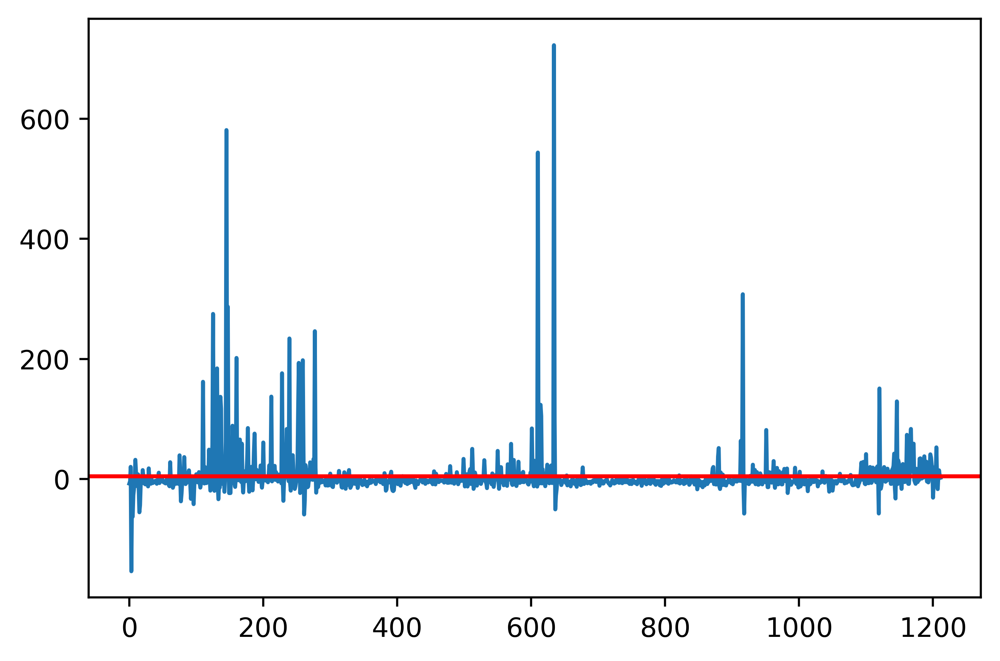

In [178]:
plt.plot(result)
plt.axhline(y=(np.average(result)), color='r', linestyle='-')
plt.xticks()
plt.show()

In [115]:
100:300, 500:650, 1100:1150

(29136, 174)

In [182]:
train1[12000:]

,pca_comp_0,pca_comp_1,pca_comp_2,pca_comp_3,pca_comp_4,pca_comp_5,pca_comp_6,pca_comp_7,pca_comp_8,pca_comp_9,...,b,c,d,e,h,n,q,u,v,hh
index,,,,,,,,,,,,,,,,,,,,,
2019-05-18 00:00:00,5.779422,-0.838742,-0.159701,2.223976,-0.648432,-0.252542,-1.469808,-0.068945,-0.107455,-0.609421,...,0.122969,0.113106,0.086225,0.095059,0.255670,0.225039,0.190696,0.079072,0.138466,0.284523
2019-05-18 01:00:00,4.959737,-0.569252,-0.661230,2.469404,-0.235368,-0.387015,0.490055,0.015893,-0.334642,-0.195027,...,0.119366,0.110540,0.082840,0.093698,0.252916,0.222666,0.186880,0.076190,0.135867,0.282108
2019-05-18 02:00:00,4.304665,-0.268203,-1.069676,2.751693,-0.360060,-0.388990,0.508209,-0.175244,-0.237177,0.038315,...,0.117791,0.109246,0.081350,0.093028,0.251764,0.221671,0.184960,0.074982,0.134673,0.280909
2019-05-18 03:00:00,4.150353,-0.182901,-1.124671,3.144668,-0.382792,-0.310267,0.533871,-0.109217,0.178902,-0.055257,...,0.116078,0.108151,0.079710,0.092436,0.250471,0.220500,0.183302,0.073660,0.133513,0.279885
2019-05-18 04:00:00,3.799932,0.345559,-1.270586,3.439513,-0.701601,-0.350249,-0.696590,-0.201550,-0.189080,-0.283197,...,0.114339,0.108350,0.080056,0.092548,0.250708,0.220676,0.183624,0.074269,0.133773,0.280092
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-28 19:00:00,3.570432,0.590207,-1.734915,-0.746854,-0.831876,1.137767,0.403261,-0.749733,-0.599016,0.065530,...,0.195142,0.143824,0.153817,0.110515,0.308111,0.272826,0.241700,0.135696,0.184577,0.312877
2021-10-28 20:00:00,3.540396,0.800554,-1.820957,-0.833127,-0.739232,0.976582,0.370490,-0.656219,-0.536743,0.014275,...,0.208609,0.144795,0.166790,0.114512,0.319293,0.282549,0.247305,0.146378,0.193499,0.313599
2021-10-28 21:00:00,3.598147,0.879951,-1.921609,-0.885446,-0.721115,0.780823,0.363433,-0.589216,-0.474360,-0.018498,...,0.173587,0.135841,0.133647,0.090180,0.292988,0.258907,0.224623,0.118556,0.169876,0.305833


In [181]:
train1[15981:16000]

,pca_comp_0,pca_comp_1,pca_comp_2,pca_comp_3,pca_comp_4,pca_comp_5,pca_comp_6,pca_comp_7,pca_comp_8,pca_comp_9,...,b,c,d,e,h,n,q,u,v,hh
index,,,,,,,,,,,,,,,,,,,,,
2019-10-30 21:00:00,-2.757576,1.525363,-0.334678,-0.056955,-0.387120,0.500521,-0.036571,1.197101,0.362915,0.450920,...,0.127857,0.108680,0.091481,0.093922,0.259250,0.228336,0.184948,0.081659,0.140535,0.279753
2019-10-30 22:00:00,-2.600622,1.730934,-0.161910,-0.009137,-0.509004,0.446552,0.036021,1.057623,0.421490,0.395294,...,0.125652,0.106203,0.089217,0.093313,0.257685,0.226919,0.182098,0.079966,0.138945,0.277493
2019-10-30 23:00:00,-2.624764,1.931415,0.109495,-0.062424,-0.695446,0.306157,0.132932,0.885685,0.476471,0.248126,...,0.124770,0.105542,0.088305,0.093153,0.257209,0.226417,0.181418,0.079329,0.138399,0.276948
2019-10-31 00:00:00,-2.859436,1.591403,-0.124120,-0.024640,-1.234170,-0.099589,-0.295823,0.633107,0.263578,0.217112,...,0.122666,0.105990,0.086352,0.092656,0.255670,0.225079,0.181394,0.077797,0.137129,0.277515
2019-10-31 01:00:00,-2.944216,1.781517,0.297410,0.136647,-1.354391,-0.052351,-0.258442,0.614400,0.578662,0.206741,...,0.120058,0.105505,0.083857,0.093032,0.253479,0.223303,0.180965,0.075819,0.135582,0.277125
2019-10-31 02:00:00,-3.038109,2.046942,0.685459,0.114190,-1.413259,-0.114887,-0.214060,0.538914,0.628979,0.228370,...,0.120525,0.104704,0.084319,0.093132,0.253875,0.223630,0.180273,0.076161,0.135817,0.276337
2019-10-31 03:00:00,-3.036209,2.318335,0.984705,0.148439,-1.602963,-0.100538,-0.615649,0.401422,0.660312,0.209254,...,0.121028,0.104233,0.084804,0.093235,0.254315,0.223964,0.179916,0.076561,0.136120,0.275866
2019-10-31 04:00:00,-2.969199,2.702303,1.398763,0.110389,-1.625362,-0.011450,-0.794480,0.238092,0.582194,0.279407,...,0.123044,0.104005,0.086722,0.093806,0.255934,0.225310,0.180238,0.078073,0.137432,0.275587
2019-10-31 05:00:00,-2.838032,3.001266,1.622176,0.069493,-1.567150,0.078385,-0.815671,0.189893,0.430145,0.338988,...,0.122641,0.104410,0.086387,0.093676,0.255503,0.225008,0.180548,0.077721,0.137188,0.275918


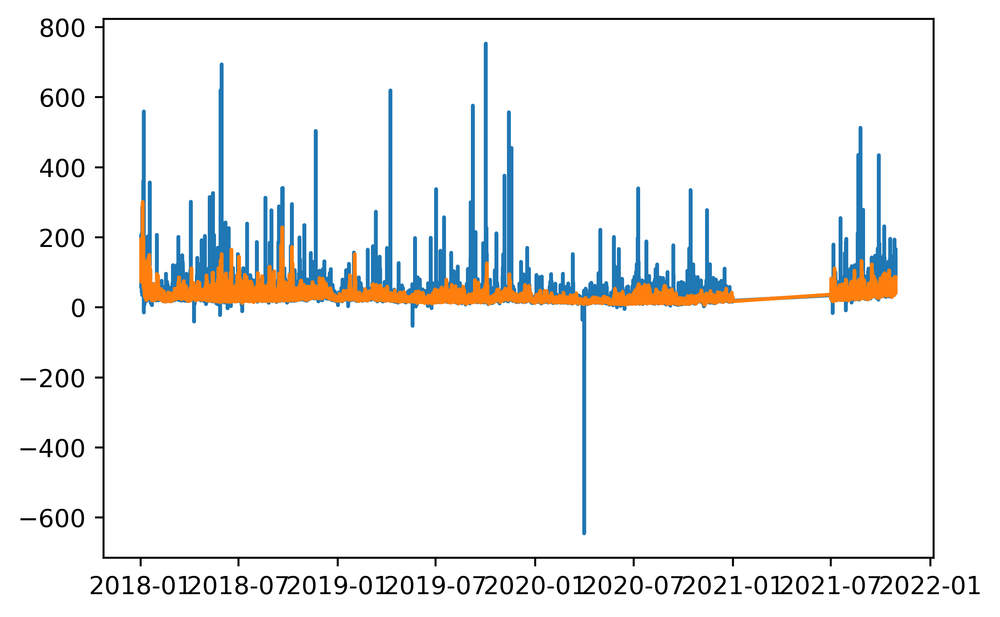

In [171]:
plt.plot(s1.target)
plt.plot(s2)
plt.show()

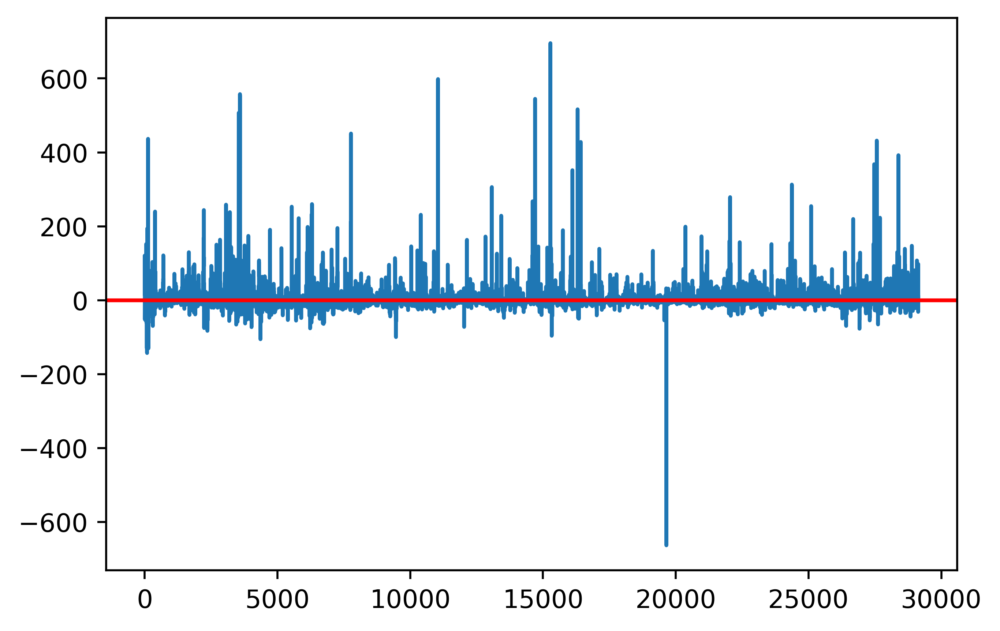

In [172]:
result = []
result1 = [] 
for i, j in zip(s1.target,s2):
    result.append(i - j)
plt.plot(result)
plt.axhline(y=(np.mean(result)), color='r', linestyle='-')
plt.xticks()
plt.show()

In [231]:
!pip install deepevolution[tf_gpu]

Defaulting to user installation because normal site-packages is not writeable
  Using cached tensorflow_gpu-2.8.0-cp38-cp38-manylinux2010_x86_64.whl (497.6 MB)
  Using cached keras-2.8.0-py2.py3-none-any.whl (1.4 MB)
  Using cached numpy-1.22.3-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (16.8 MB)


  Attempting uninstall: keras
    Found existing installation: keras 2.6.0
    Uninstalling keras-2.6.0:
      Successfully uninstalled keras-2.6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.6.2 requires flatbuffers~=1.12.0, but you have flatbuffers 20220121045812 which is incompatible.
tensorflow 2.6.2 requires gast==0.4.0, but you have gast 0.3.3 which is incompatible.
tensorflow 2.6.2 requires grpcio<2.0,>=1.37.0, but you have grpcio 1.32.0 which is incompatible.
tensorflow 2.6.2 requires h5py~=3.1.0, but you have h5py 2.10.0 which is incompatible.
tensorflow 2.6.2 requires keras<2.7,>=2.6.0, but you have keras 2.8.0 which is incompatible.
tensorflow 2.6.2 requires numpy~=1.19.2, but you have numpy 1.22.3 which is incompatible.
numba 0.55.1 requires numpy<1.22,>=1.18, but you have numpy 1.22.3 which is incompatible.
